# CS-2770 Computer Vision- Homework 1

#### Name:  Aishwarya Jakka, Email : aij12@pitt.edu

In [1]:
import os
import numpy as np
import cv2
from matplotlib import pyplot as plt
from imageio import imread, imsave
from PIL import Image
from scipy.spatial import distance
from scipy.ndimage import convolve
from scipy.io import loadmat
from scipy import ndimage
import math
import warnings
# warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning)
from scipy.ndimage import gaussian_filter

### Part A : Image Responses with Filters

In this problem, you will measure the responses of images to different filters. For each image, you will compute the response of each image pixel to the filters from a "filter bank" as discussed in class. In a later assignment, you will use these responses to filters to compute image representations.<br/>
1. Download these images: cardinal1, cardinal2, leopard1, leopard2, panda1, panda2.
2. Download the Leung-Malik filter bank from here (this is a Matlab file; in Python you can read it with loadmat). Each filter F(:, :, i) is of size 49x49, and there are 48 filters.
3. [5 pts] Read in all images, and convert all images to the same square size (e.g. 100x100), so that the visual map of responses can be more comparable across images. Also convert the images to grayscale. Then convolve your image with each of the 48 filters, e.g. using convolve.
4. [5 pts] For each filter, generate a 2x4 subplot showing the following subplot rows: (1) the filter and a blank subplot, (2) the responses to the cardinal images, (3) the responses to the leopard images, and (4) the responses to the panda images.
5. [5 pts] Choose and include in your submission (1) one filter where the responses of images of the same animal are similar, while the responses of images of different animals are quite distinct; and (2) one filter where responses of different animals look fairly similar. Name the files same_animal_similar.png and different_animals_similar.png. See an example for one filter below.

In [2]:
def ImageResponseWithFilters(Input_Img_List, Filter):
    """
    For each filter, generate a 2 * 4 subplots
    """
    for i in range(len(Input_Img_List)):
      
        Input_Img_List[i] = cv2.resize(Input_Img_List[i], (100, 100))

    if not os.path.exists("PartA_Subplots"):
        os.mkdir("PartA_Subplots")

    for i in range(48):
        f, ax = plt.subplots(2, 4)
        ax[0, 0].imshow(Filter[:, :, i])
        ax[0, 0].set_title("filter {}".format(i + 1))
        ax[0, 1].axis("off")
        ax[0, 2].imshow(ndimage.convolve(Input_Img_List[0], Filter[:, :, i]))
        ax[0, 2].set_title(storeImages[0])
        ax[0, 3].imshow(ndimage.convolve(Input_Img_List[1], Filter[:, :, i]))
        ax[0, 3].set_title(storeImages[1])
        ax[1, 0].imshow(ndimage.convolve(Input_Img_List[2], Filter[:, :, i]))
        ax[1, 0].set_title(storeImages[2])
        ax[1, 1].imshow(ndimage.convolve(Input_Img_List[3], Filter[:, :, i]))
        ax[1, 1].set_title(storeImages[3])
        ax[1, 2].imshow(ndimage.convolve(Input_Img_List[4], Filter[:, :, i]))
        ax[1, 2].set_title(storeImages[4])
        ax[1, 3].imshow(ndimage.convolve(Input_Img_List[5], Filter[:, :, i]))
        ax[1, 3].set_title(storeImages[5])
        filter_name = 'filter' + str(i + 1) + '.jpeg'
        f.savefig(os.path.abspath(os.path.join("PartA_Subplots", filter_name)))
        plt.close(f)


In [3]:
# Input_Img_Path is the path of the images
Input_Img_Path = os.path.abspath(os.path.join("PartA-Input-Img"))

# using a storeImages array to store the images
storeImages = []
imgs = os.listdir(Input_Img_Path)
imgs.sort()
for i in imgs:
    if os.path.isfile(os.path.abspath(os.path.join(Input_Img_Path, i))):
        storeImages.append(i)
        
Input_Img_List = []
for i in storeImages:
    img = cv2.imread(os.path.join(Input_Img_Path, i))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    Input_Img_List.append(img)

# load the filter matrix
temp = loadmat('filters.mat')
Filter = temp['F']

# x is the dict type, the last key is 'F' which store
# the whole 48 filter (49 * 49)

ImageResponseWithFilters(Input_Img_List, Filter)


### PART B : Image Description with Texture

In this problem, you will use texture to represent images. You will compute two image representations based on the filter responses. The first will simply be a concatenation of the filter responses for all pixels and all filters. The second will contain the mean of filter reponses (averaged across all pixels) for each image. <br/>

Write a function <b>computeTextureReprs</b> with inputs image, F where image is an RGB image and F is the 49x49x`num_filters` matrix of filters you used before. The function should output two arguments `texture_repr_concat`, `texture_repr_mean` defined below. <br/>
1. [1 pts] First, create a new variable `responses` of size `num_filters`x`num_rowsxnum_cols`, where `num_rowsxnum_cols` is the size of the image. Convert the input image to grayscale.
2. [2 pts] Compute the responses of the image to each of the filters, and store the results in `responses`.
3. [1 pts] Create the first image representation `texture_repr_concat` by simply converting `responses` to a vector, i.e. concatenating all pixels in the response images for all filters.
4. [1 pts] Now let's compute the image representation in a different way. This time, the representation `texture_repr_mean` will be of `size num_filters`x1. Compute each entry in `texture_repr_mean` as the mean response across all pixels to the corresponding filter. In other words, rather than keeping information about how each pixel responded to the filter, we are collapsing that information to a single value: the mean across all pixels.

In [4]:
def computeTextureReprs(Input_Img, Filter):
    num_filters = Filter.shape[2]
    grey_img = cv2.cvtColor(Input_Img, cv2.COLOR_RGB2GRAY)
    responses = [[[0 for col in range(Input_Img.shape[1])] for row in range(Input_Img.shape[0])] for fil in range(num_filters)]
    for fil in range(num_filters):
        responses[fil] = convolve(grey_img, Filter[:,:,fil])
    texture_repr_concat = np.squeeze(np.asarray(responses))
    texture_repr_mean = np.mean(responses,axis=(1,2))
    texture_repr_mean = texture_repr_mean.reshape((texture_repr_mean.shape[0],-1))
    #texture_repr_mean = [0 for fil in range(num_filters)]
    #for i in range(len(responses)):
        #texture_repr_mean[i] = responses[i].mean()
    return texture_repr_concat, texture_repr_mean

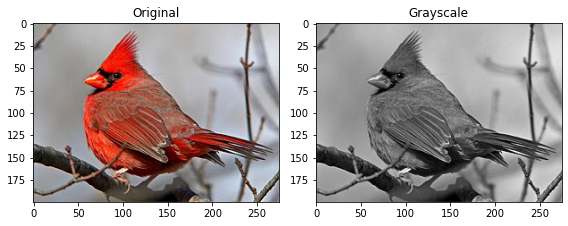

In [5]:
original = imread('PartA-Input-Img/cardinal1.jpg') #data.astronaut()
#resized = imresize(original, (100, 100))
grayscale = cv2.cvtColor(original, cv2.COLOR_RGB2GRAY)

fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

ax[0].imshow(original)
ax[0].set_title("Original")
ax[1].imshow(grayscale, cmap=plt.cm.gray)
ax[1].set_title("Grayscale")

fig.tight_layout()
plt.show()




In [6]:
texture_repr_concat, texture_repr_mean = computeTextureReprs(original, Filter)

In [7]:
texture_repr_concat.shape

(48, 200, 275)

In [8]:
len(texture_repr_mean)

48

### PART C: Hybrid Images

In this problem, you will create a hybrid image (which looks like one thing zoomed in and another zoomed out) like the one shown in class.
1. Download one pair of images:
    * woman_happy and woman_neutral, or
    * baby_happy and baby_weird.
2. [3 pts] Read in the first image in the pair as `im1` and the second as `im2`. Resize both images to the same square size (e.g. 512x512), and convert them to grayscale.
3. [2 pts] Create and apply a Gaussian filter; see gaussian_filter. Save the results as `im1_blur`, `im2_blur`.
4. [2 pts] Obtain the detail image by subtracting `im2_blur` from `im2`, and save the result as `im2_detail`.
5. [3 pts] Now add `im1_blur` and `im2_detail`, show the image, save it as '`hybrid.png`', and include it with your submission. Play with scaling it up and down to see the "hybrid" effect.

In [9]:
def HybridImage(img1, img2, sigma = 1):
    # resize the image to 512 * 512
    im1_resize = cv2.resize(img1, (512, 512), interpolation = cv2.INTER_AREA)
    im2_resize = cv2.resize(img2, (512, 512), interpolation = cv2.INTER_AREA)

    # convert color image to GrayScale
    im1_gray = cv2.cvtColor(im1_resize, cv2.COLOR_BGR2GRAY)
    im1_gray = cv2.cvtColor(im1_resize, cv2.COLOR_BGR2GRAY)
    im2_gray = cv2.cvtColor(im2_resize, cv2.COLOR_BGR2GRAY)

    # use Gaussian_filter to blur images
    im1_blur = ndimage.gaussian_filter(im1_gray, sigma)
    im2_blur = ndimage.gaussian_filter(im2_gray, sigma)

    # subtract the blur part to get the detail part
    im2_detail = im2_gray - im2_blur

    # get hybrid by combining img1_blur and img2_detail
    hybrid = im1_blur + im2_detail
    cv2.imshow('Hybrid', hybrid)
    cv2.waitKey(10)
    cv2.destroyAllWindows()
    cv2.imwrite(os.path.abspath(os.path.join("PartC-Input-Img", 'Hybrid_' +str(sigma)+ '.png')), hybrid)

In [10]:
partC__Input_Img_Path = os.path.abspath(os.path.join("PartC-Input-Img"))

img1 = cv2.imread(os.path.join(partC__Input_Img_Path, 'baby_happy.jpg'))
img2 = cv2.imread(os.path.join(partC__Input_Img_Path, 'baby_weird.jpg'))

#
HybridImage(img1, img2, sigma = 0.5)
HybridImage(img1, img2, sigma = 1)
HybridImage(img1, img2, sigma = 3)
HybridImage(img1, img2, sigma = 5)
HybridImage(img1, img2, sigma = 10)
#



### PART D: Feature Detection

In this problem, you will implement feature extraction using the Harris corner detector, as discussed in class. Write a function extract_keypoints with the following inputs/outputs: <br/>

##### Input: 
 * image is a color image which you should convert to grayscale in your function.
 
##### Outputs:

* Each of `x`,`y` is an `nx1` vector that denotes the x and y locations, respectively, of each of the n detected keypoints (i.e. points with "cornerness" R scores greater than a threshold who survive the non-maximum suppression). Keep in mind that x denotes the horizontal direction, hence columns of the image, and y denotes the vertical direction, hence rows, counting from the top-left of the image.
* `scores` is an nx1 vector that contains the R score for each detected keypoint.
* `Ix`,`Iy` are matrices with the same number of rows and columns as your input image, and store the gradients in the x and y directions at each pixel.

##### Step-by-step instructions:

1. [5 pts] Let's do some preprocessing. First, set some parameters for use in your functions, at the beginning of your function: set the value of k (from the "Harris Detector: Algorithm" slide) to 0.05, and use a window size of 5. Second, read in the image, and convert it to grayscale. Compute the horizontal image gradient Ix and the vertical image gradient Iy. Finally, initialize with zeros a matrix R of the same size as the image that will store the "cornerness" scores for each pixel.
2. [10 pts] Use a double loop to compute the cornerness score R(i, j) at each pixel i, j. This score depends on a 2x2 matrix M computed for each pixel, as shown in the slides. Use a window function of 1 inside, 0 outside, i.e. all neighbors of i, j that are less than half_window_size away from it have the same weight, and other neighbors don't contribute. Thus, the matrix M for a given pixel is a summation of window_size^2 matrices, each of size 2x2. Each of the 2x2 entries is the product of gradient image values at that particular pixel. After computing M, use the formula from class to compute the R(i, j) score for that pixel. If a pixel is less than 2 pixels from the top/left or 2 pixels from the bottom/right of the image, set its R score to 0.
3. [5 pts] After computing all R(i, j) scores, it is time to threshold them in order to find which pixels correspond to keypoints. You can set the threshold for the "cornerness" score R however you like, e.g. (a) you can set it to 5 times the average R score, or (b) you can output the top n keypoints (e.g. top 1%).
4. [5 pts] Perform non-maximum suppression by removing those keypoints whose R score is not larger than all of their 8 neighbors; if a keypoint does not have 8 neighbors, remove it. The scores/x/y that you output should correspond to the final set of keypoints, after non-max suppression.
5. [5 pts] Display the input image, and visualize the keypoints you have detected, for example by drawing circles over them. Use the scores variable and make keypoints with higher scores correspond to larger circles. Include the visualization for three images in your submission (named vis1.png, vis2.png, vis3.png).

In [11]:
def localMaxSup2d(mat,threshold):
   
   # return dict with key = tuple(y,x) and val = value
    
    r_mat = mat
    offset2 = 1
    height = r_mat.shape[0]
    width = r_mat.shape[1]
    r_val_dict = None
    r_val_dict = dict()
    for y in range(offset2,height-offset2):
        for x in range(offset2,width-offset2):
            if r_mat[y,x] < threshold or r_mat[y,x]==0:
                continue
                
            xmin = x-offset2
            xmax = x+offset2+1
            ymin = y-offset2
            ymax = y+offset2+1
            localMax = np.max(r_mat[ymin:ymax,xmin:xmax])
            if localMax > r_mat[y,x]:
                r_mat[y,x] = 0
            else:
                r_val_dict[(y,x)] = r_mat[y,x]
    return r_val_dict

In [12]:
def extract_keypoints(img,t_percentile=99):
    
    imgC = img.copy()
    image = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    img = image.copy()
    windowSize = 5
    k = 0.05
    #Ix,Iy = np.gradient(image)
    Ix = cv2.Sobel(image,cv2.CV_64F,1,0,ksize=windowSize)
    Iy = cv2.Sobel(image,cv2.CV_64F,0,1,ksize=windowSize)
    
    Ixx = Ix ** 2
    Iyy = Iy ** 2
    Ixy = Iy * Ix
    height = image.shape[0]
    width = image.shape[1]
    offset = windowSize//2
    r_mat = np.zeros_like(image,dtype=np.int64)
    r_val_dict = dict()
    for y in range(offset,height-offset):
        for x in range(offset,width-offset):
            m = np.zeros((2,2))
            xmin = x-offset
            xmax = x+offset+1
            ymin = y-offset
            ymax = y+offset+1

            local_Ixx = Ixx[ymin:ymax,xmin:xmax]
            local_Iyy = Iyy[ymin:ymax,xmin:xmax]
            local_Ixy = Ixy[ymin:ymax,xmin:xmax]
            Sxx = local_Ixx.sum()
            Sxy = local_Ixy.sum()
            Syy = local_Iyy.sum()

            det = (Sxx * Syy) - (Sxy**2)
            trace = Sxx + Syy
            R = det - k*(trace**2)
            #R_val_dict[(y,x)] = R
            r_mat[y,x] = R
            
    threshold = np.percentile(r_mat,t_percentile)
    #print('sum of all the vals',np.sum(r_mat))
    r_mat[r_mat<threshold]=0
    #print("Printing after removal of value sless than threhold",np.sum(r_mat))
    r_val_dict = localMaxSup2d(r_mat,threshold)
    #print(r_val_dict)
    for k,v in r_val_dict.items():
        p,q = k
        cv2.circle(img,(q,p),3,255,-1)
    #plt.imshow(img)
    intrestPt = np.asarray([list(x) for x in r_val_dict.keys()])

#     global temp 
#     temp = intrestPt.copy()
    scores = np.array(list(r_val_dict.values()))
    return img, r_val_dict, intrestPt[:,0], intrestPt[:,1], scores, Ix, Iy

In [13]:
def show_extracted_keypoints(pathVal,t_percentile=99,save = False):
    img1 = imread(pathVal)
    newimg,keypoints,a,b,c,d,e = extract_keypoints(img1,t_percentile)

    green = (0, 255,0)
    newimgC = img1.copy()
    for k,v in keypoints.items():
        a,b =k
        cv2.circle(newimgC,(b,a),3,green)
    plt.figure(figsize=(20,40))
    plt.subplot(1,3,1)
    plt.title('Orignal')
    plt.imshow(img1)
    plt.subplot(1,3,2)
    plt.title("Corner Gray Scale")
    plt.imshow(newimg,cmap='gray')
    plt.subplot(1,3,3)
    plt.title("Corner Blue")
    plt.imshow(newimgC)
    if save:
        name = pathVal.split('/')[-1].split('.')[0]
        outname = 'PartD_output/corner_'+name+'.jpg'
        plt.savefig(outname)
        

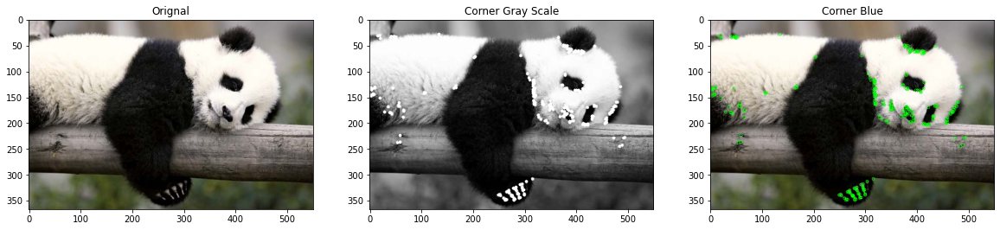

In [14]:
show_extracted_keypoints('./PartA-Input-Img/panda2.jpg', save = True)

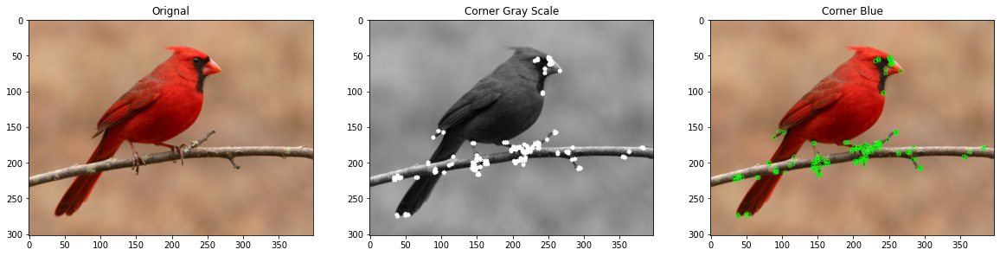

In [15]:
show_extracted_keypoints('./PartA-Input-Img/cardinal2.jpg', save = True)

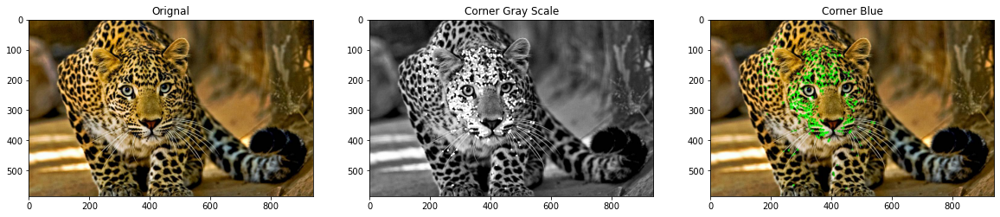

In [16]:
show_extracted_keypoints('./PartA-Input-Img/leopard1.jpg', save = True)

### Part E : Feature Description

In this problem, you will implement a feature description pipeline, as discussed in class. While you will not exactly implement that, the SIFT paper by David Lowe is a useful resource, in addition to Section 4.1 of the Szeliski textbook. <br/>

Write a function compute_features with inputs x, y, scores, Ix, Iy defined as above. The output features is an nxd matrix where each row contains the d-dimensional descriptor for the n-th keypoint. We'll simplify the histogram creation procedure a bit, compared to the original implementation presented in class. In particular, we'll compute a descriptor with dimensionality d=8 (rather than 4x4x8), which contains an 8-dimensional histogram of gradients computed from a 11x11 grid centered around each detected keypoint (i.e. -5:+5 neighborhood horizontally and vertically).<br/>
If any of your detected keypoints are less than 5 pixels from the top/left or 5 pixels from the bottom/right of the image, i.e. pixels lacking 5+5 neighbors in either the horizontal or vertical direction, set its descriptor to be a vector of zeros.
1. [5 pts] To compute the gradient magnitude m(x, y) and gradient angle θ(x, y) at point (x, y), take L to be the image and use the formula below shown. If the gradient magnitude is 0, then both the x and y gradients are 0, and you should ignore the orientation for that pixel (since it won't contribute to the histogram). 
<img src = 'gradients.png'/>

2. [5 pts] Quantize the gradient orientations in 8 bins (so put values between -90 and -67.5 degrees in one bin, the -67.5 to -45 degree angles in another bin, etc.). For example, you can have a variable with the same size as the image, that says to which bin (1 through 8) the gradient at that pixel belongs.
3. [5 pts] To populate the SIFT histogram, consider each of the 8 bins. To populate the first bin, sum the gradient magnitudes that are between -90 and -67.5 degrees. Repeat analogously for all bins.
4. [5 pts] Finally, you should clip all values to 0.2 as discussed in class, and normalize each descriptor to be of unit length. Normalize both before and after the clipping. You do not have to implement any more sophisticated detail from the Lowe paper.

In [17]:
def compute_features(keypoints_dict,PX,PY,RScore,Ix,Iy):
    
    features = dict()
    maxSize =  Iy.shape[1]
    bins = [[-90,-67.5],[-67.5,-45],[-45,-22.5],[-22.5,0],[0,22.5],[22.5,45],[45,67.5],[67.5,90]]
    for index,(key,val) in enumerate(keypoints_dict.items()):

        pointX,pointY = key

        if ((pointX - 5) < 0 or (pointX + 5) > (maxSize-2) or (pointY - 5) < 0 or (pointY + 5) > (maxSize-2)):
            continue

        a = Ix[pointX-5:pointX+6,pointY-5:pointY+6] # L[x+1][y] - L[x-1][y]
        b = Iy[pointX-5:pointX+6,pointY-5:pointY+6] # L[x][y+1] - L[x][y-1]

        m = np.sqrt(np.square(a)+np.square(b))
        tanInv = np.arctan(b/a)
        theta = tanInv * 180 / np.pi

        mflat = m.flatten()
        tflat = theta.flatten()

        
        singleNormalized = np.zeros((8))
        for ii in range(mflat.shape[0]):
            if mflat[ii] <0.01:
                continue
            for i, bin_val in enumerate(bins):
                    if (tflat[ii] >= bin_val[0]) and (tflat[ii] < bin_val[1]) and (tflat[ii] != 0):
                        singleNormalized[i]+=mflat[ii]

        clippedSingleNormalized = singleNormalized.copy()/np.sum(singleNormalized)
        clippedSingleNormalized = np.clip(clippedSingleNormalized,0,0.2)
        normClipNorm = clippedSingleNormalized.copy()/np.sum(clippedSingleNormalized)
        features[key] = normClipNorm.copy()

    return features

<ipython-input-17-1db5625ff2bc>:17: RuntimeWarning: divide by zero encountered in true_divide
  tanInv = np.arctan(b/a)
<ipython-input-17-1db5625ff2bc>:17: RuntimeWarning: invalid value encountered in true_divide
  tanInv = np.arctan(b/a)


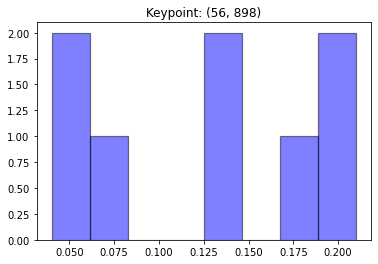

[0.20713874 0.12575807 0.17780901 0.13640934 0.04021012 0.04035677
 0.06232332 0.20999463]


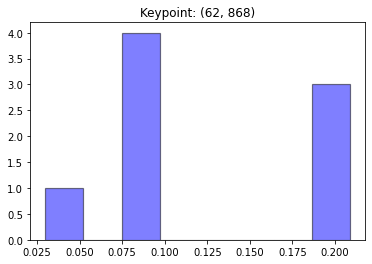

[0.20871022 0.20871022 0.09020225 0.08108937 0.09424626 0.09418355
 0.02993437 0.19292376]


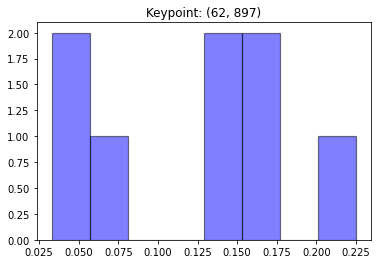

[0.03294976 0.13588959 0.17142934 0.16578933 0.06855274 0.05663191
 0.14364519 0.22511214]


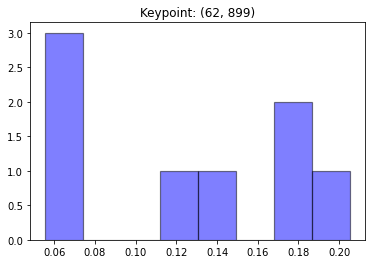

[0.05982435 0.119838   0.18609039 0.17079666 0.07062324 0.05562663
 0.13199884 0.2052019 ]


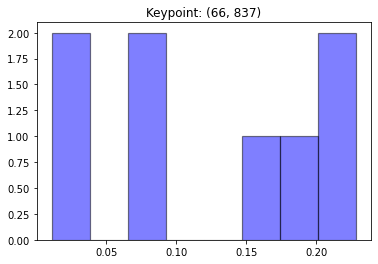

[0.22843795 0.0112187  0.01848511 0.07604781 0.18068045 0.08945249
 0.16723954 0.22843795]


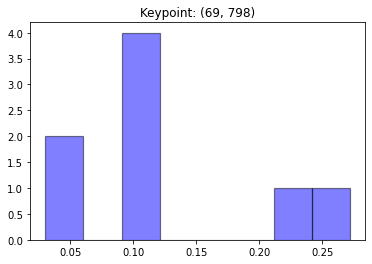

[0.23573424 0.09372732 0.09952402 0.10658958 0.05770228 0.03013662
 0.1046755  0.27191044]


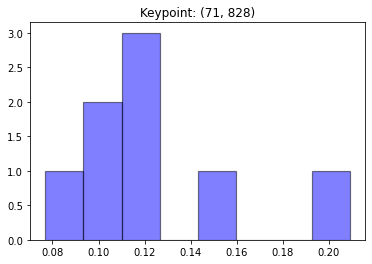

[0.12379597 0.12148402 0.12625769 0.10048671 0.07696442 0.14444132
 0.20901001 0.09755986]


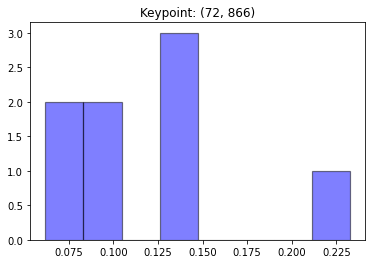

[0.14396777 0.09200938 0.06188332 0.10409213 0.08063394 0.14549001
 0.23256003 0.13936342]


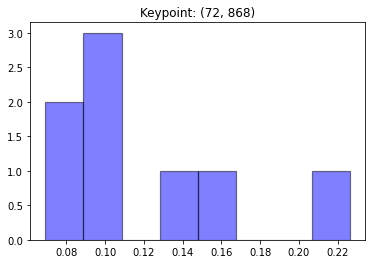

[0.10154714 0.08833844 0.06913871 0.10827543 0.09838187 0.16670605
 0.22629495 0.14131741]


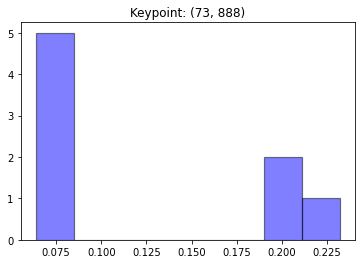

[0.06577738 0.23219011 0.21080786 0.06571632 0.06376205 0.08450224
 0.08134022 0.19590383]


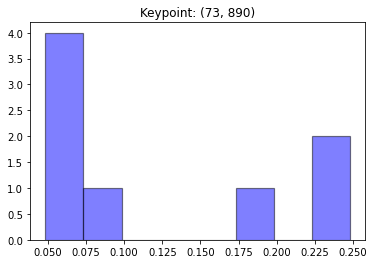

[0.06303853 0.24776009 0.19374615 0.05007298 0.04851875 0.06636678
 0.08273663 0.24776009]


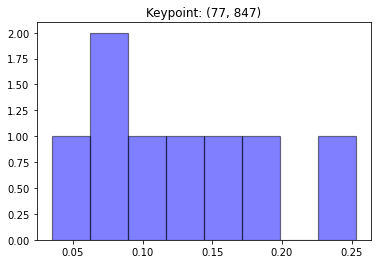

[0.14497116 0.1309583  0.0953747  0.0811719  0.17550447 0.08397171
 0.03492581 0.25312195]


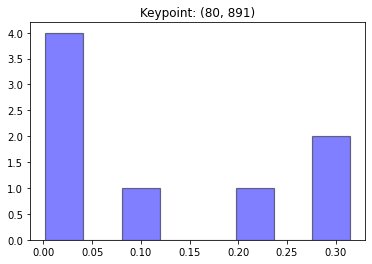

[0.10880141 0.31443391 0.21148941 0.00202225 0.00622285 0.03458605
 0.00801022 0.31443391]


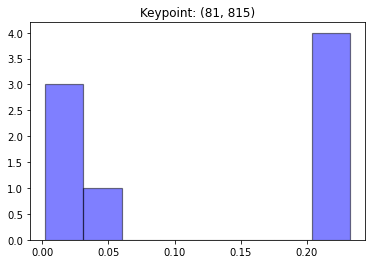

[0.23242213 0.0548761  0.00943814 0.00240042 0.02119694 0.21482203
 0.23242213 0.23242213]


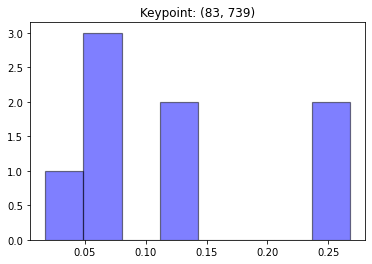

[0.01743893 0.13484681 0.05720718 0.05953992 0.0681461  0.12732903
 0.26774602 0.26774602]


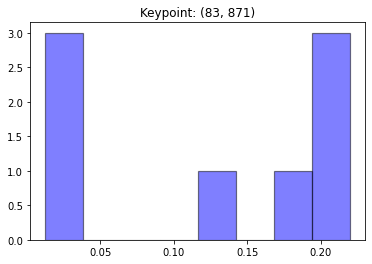

[0.20553009 0.21964228 0.13871931 0.01467401 0.01278795 0.0202269
 0.16877717 0.21964228]


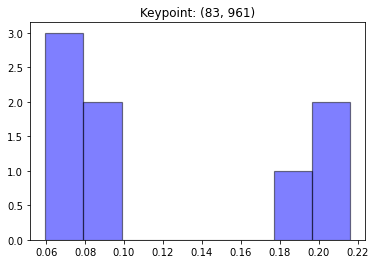

[0.19084974 0.215846   0.07474414 0.05964863 0.06356988 0.08591256
 0.09358304 0.215846  ]


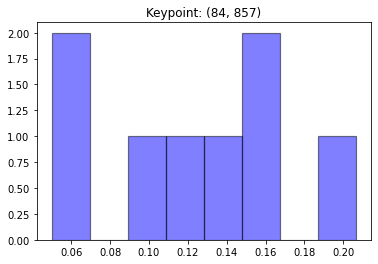

[0.1036184  0.12636906 0.04999752 0.05211001 0.16476838 0.13098043
 0.16550684 0.20664935]


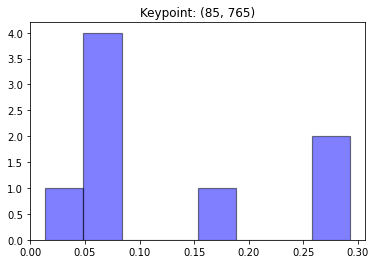

[0.0623096  0.05049346 0.01375797 0.05044906 0.081937   0.15599905
 0.29252693 0.29252693]


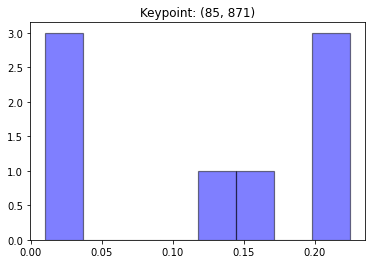

[0.20682614 0.22457847 0.14106237 0.01160628 0.0103186  0.01773079
 0.16329888 0.22457847]


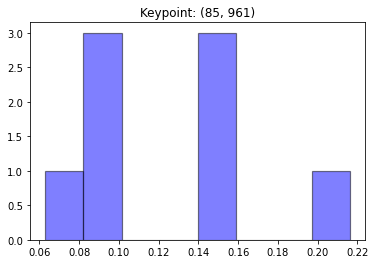

[0.14759508 0.21623053 0.15208196 0.09399978 0.06298951 0.08863113
 0.0854737  0.15299831]


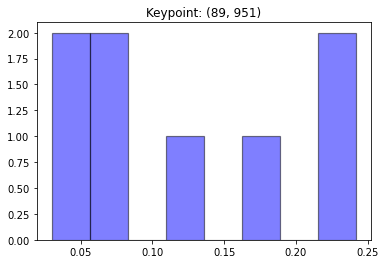

[0.24192367 0.24192367 0.04082864 0.06830677 0.02998977 0.07472116
 0.167589   0.13471731]


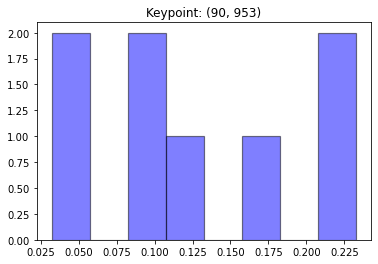

[0.12367199 0.23275128 0.04772343 0.09649398 0.03235203 0.0844748
 0.21164962 0.17088286]


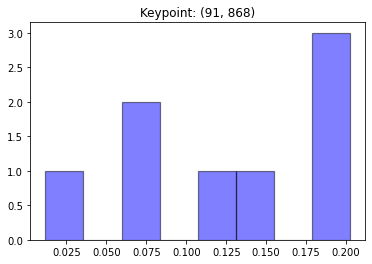

[0.13335015 0.19845688 0.06752442 0.01183801 0.07679021 0.11470117
 0.20227846 0.19506069]


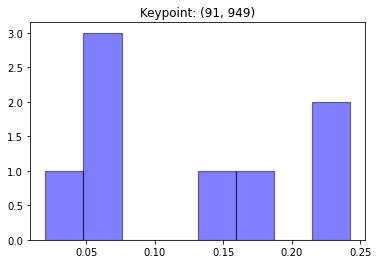

[0.24241975 0.24241975 0.06218256 0.05469972 0.02020451 0.05615429
 0.16743299 0.15448642]


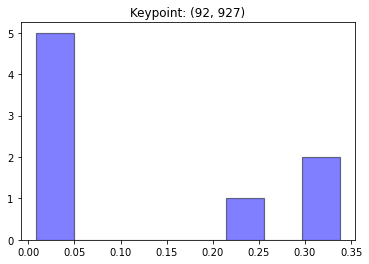

[0.3380551  0.3380551  0.04369944 0.00919788 0.00817934 0.00824234
 0.01012792 0.24444288]


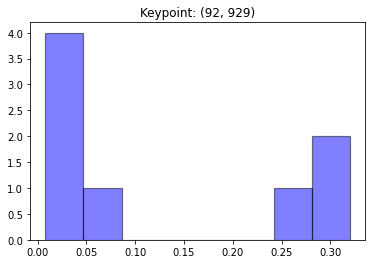

[0.31986054 0.31986054 0.0616915  0.00891104 0.01263638 0.0079853
 0.00981209 0.25924261]


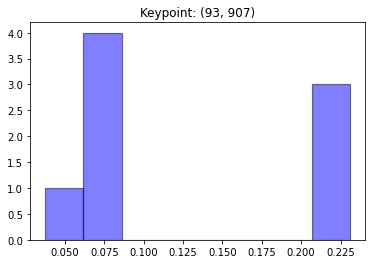

[0.23082146 0.23082146 0.0694069  0.03762725 0.0677151  0.07033351
 0.07955593 0.2137184 ]


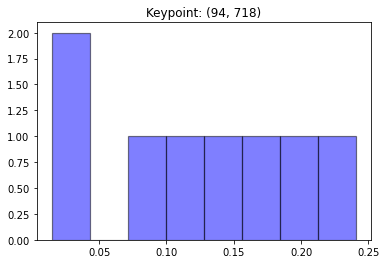

[0.03912842 0.01483874 0.07901437 0.11469542 0.13330875 0.17110463
 0.20699597 0.24091371]


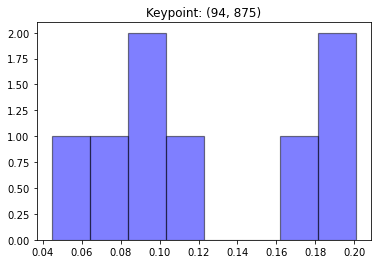

[0.09483272 0.20105062 0.08360045 0.04457117 0.11993356 0.1629059
 0.09369029 0.19941529]


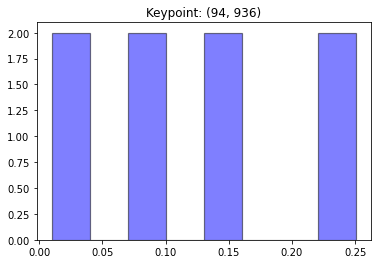

[0.25080593 0.13871771 0.09461445 0.07821216 0.14813312 0.00999136
 0.02871933 0.25080593]


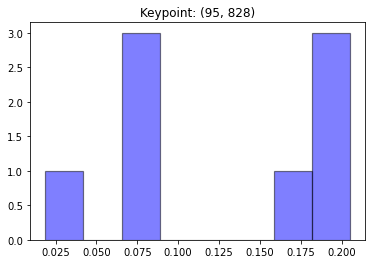

[0.07677014 0.01878091 0.181931   0.07944234 0.06628018 0.20494302
 0.20494302 0.16690941]


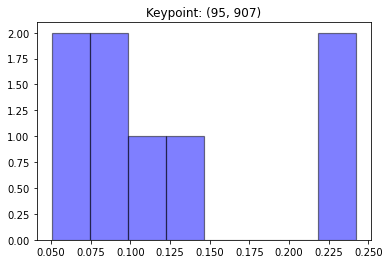

[0.24233718 0.24233718 0.11029288 0.05040193 0.06913214 0.07918217
 0.07723712 0.1290794 ]


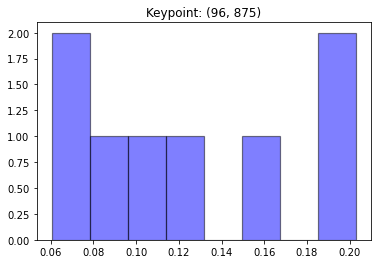

[0.08067877 0.19234755 0.06758639 0.06051318 0.12308436 0.16718564
 0.10560761 0.2029965 ]


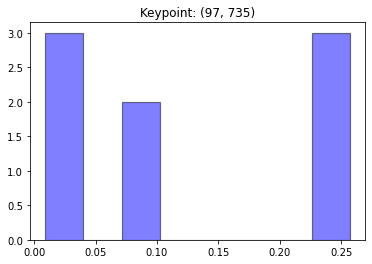

[0.07864697 0.03390796 0.00915819 0.03362955 0.0771035  0.25709642
 0.25336098 0.25709642]


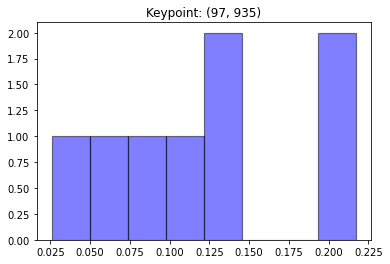

[0.21727804 0.14101369 0.09459092 0.13605117 0.21727804 0.05000949
 0.02581765 0.11796099]


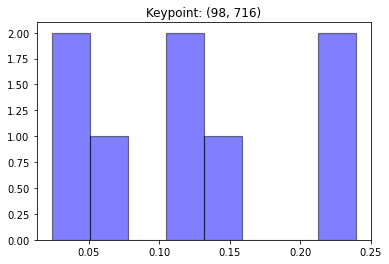

[0.02700227 0.02397544 0.07761133 0.10853752 0.15255494 0.23952908
 0.23952908 0.13126035]


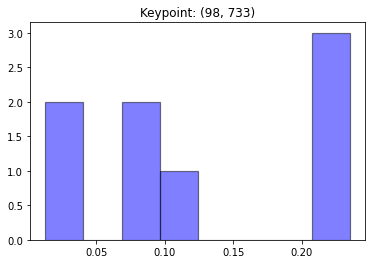

[0.09077097 0.03913563 0.01300577 0.06899901 0.0966796  0.23490452
 0.22159997 0.23490452]


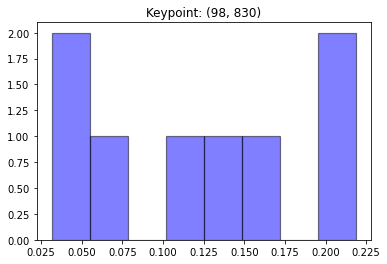

[0.03149993 0.04323259 0.16958689 0.13373411 0.12212084 0.21884197
 0.21884197 0.06214172]


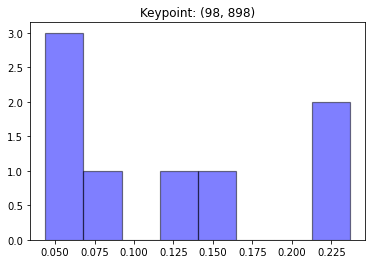

[0.23669594 0.1554802  0.13997959 0.23669594 0.06640921 0.04549012
 0.04386862 0.07538038]


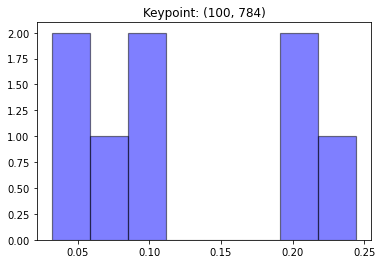

[0.21375337 0.21383765 0.05895126 0.04482989 0.03187655 0.08765717
 0.24440469 0.10468941]


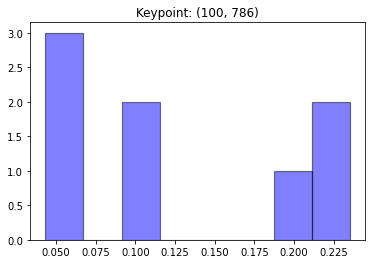

[0.21896902 0.19248458 0.06623123 0.05489077 0.04336541 0.09222249
 0.23508186 0.09675465]


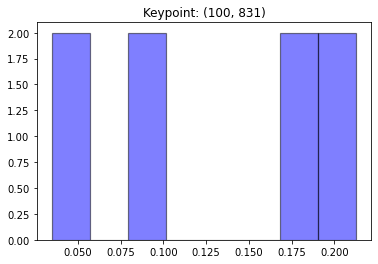

[0.03459168 0.03570121 0.17291816 0.192228   0.09331178 0.17711078
 0.21280944 0.08132896]


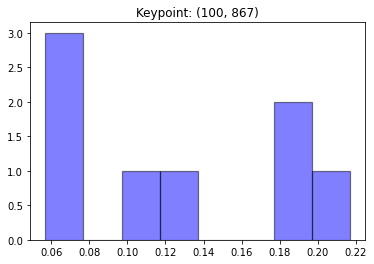

[0.18965135 0.17797775 0.11767133 0.05693788 0.06491868 0.10457745
 0.07148082 0.21678473]


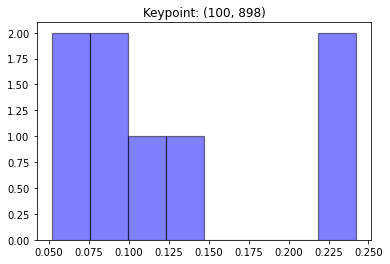

[0.2423057  0.14124682 0.10665582 0.2423057  0.07629528 0.05162794
 0.05487773 0.084685  ]


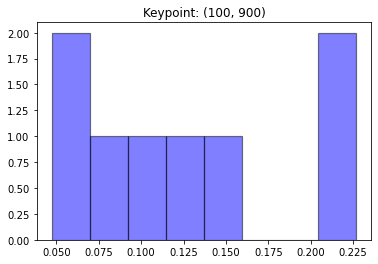

[0.2268049  0.13427911 0.14156995 0.2268049  0.0934363  0.07442262
 0.04733346 0.05534877]


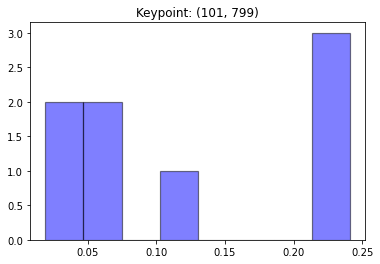

[0.22994294 0.24088805 0.10432521 0.01910154 0.02511421 0.07130338
 0.24088805 0.06843662]


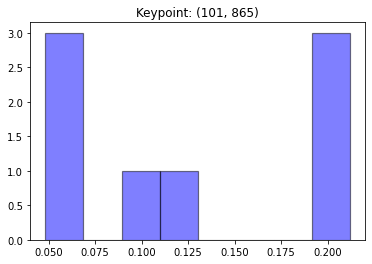

[0.21187087 0.19371313 0.11420225 0.04822682 0.05330777 0.10570814
 0.06110015 0.21187087]


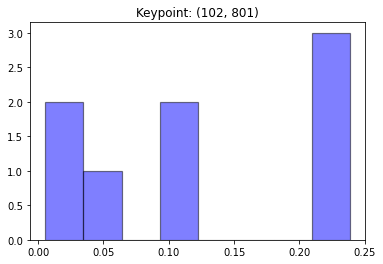

[0.23851402 0.23851402 0.10045392 0.00559113 0.01778114 0.05887456
 0.23851402 0.10175721]


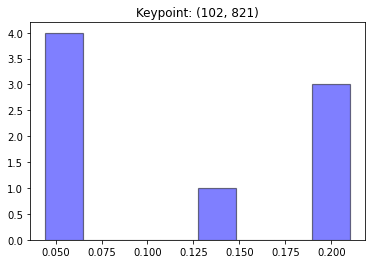

[0.2099815  0.2099815  0.05577954 0.06101869 0.04450023 0.06291272
 0.14584431 0.2099815 ]


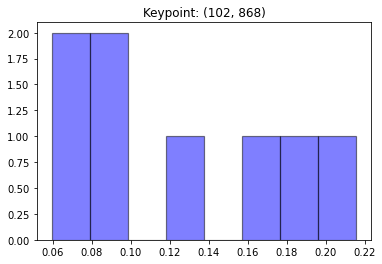

[0.16571467 0.18059475 0.09265926 0.05955056 0.08357072 0.13561817
 0.06661283 0.21567904]


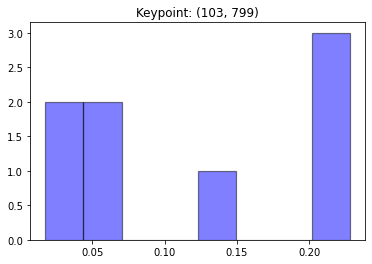

[0.22798168 0.22798168 0.14779032 0.01753391 0.02305314 0.06530763
 0.22798168 0.06236996]


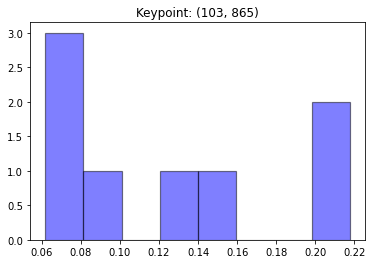

[0.21767184 0.14945373 0.09478176 0.06183767 0.06490723 0.12546233
 0.0682136  0.21767184]


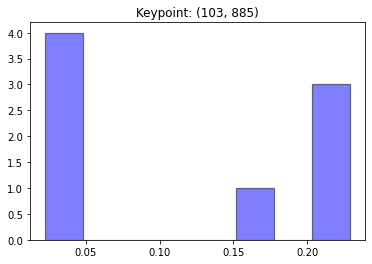

[0.22886181 0.15950065 0.04679035 0.04159657 0.02269515 0.04283185
 0.22886181 0.22886181]


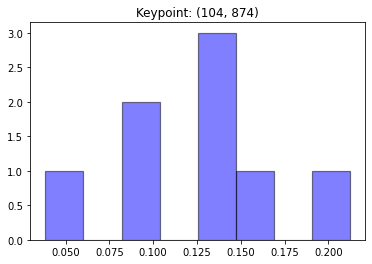

[0.14918514 0.13047962 0.08338362 0.03849241 0.09940038 0.21224347
 0.14679704 0.1400183 ]


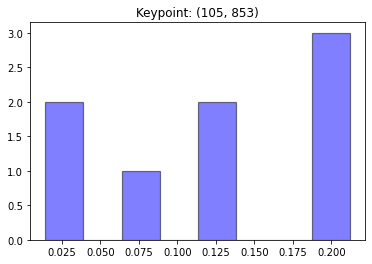

[0.08710807 0.11614663 0.01810411 0.01428445 0.21193588 0.13206164
 0.21193588 0.20842335]


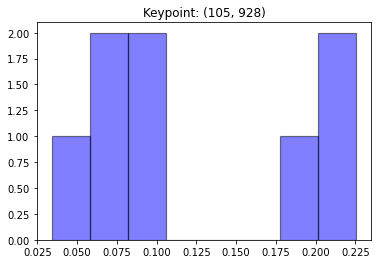

[0.09648621 0.22552904 0.22552904 0.0611356  0.03399865 0.06661407
 0.19977908 0.09092831]


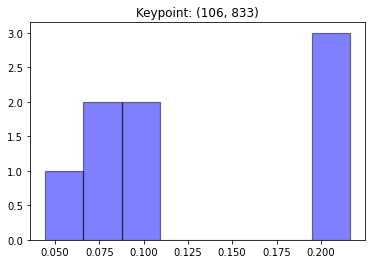

[0.06914937 0.04457132 0.0707205  0.19945151 0.0913613  0.10664484
 0.20173946 0.21636171]


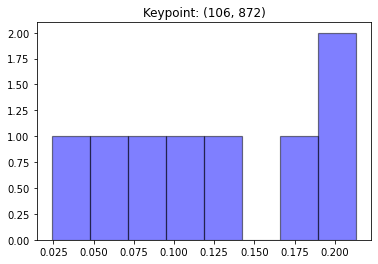

[0.1820571  0.10232136 0.05453959 0.02396695 0.0908585  0.2133398
 0.11957691 0.2133398 ]


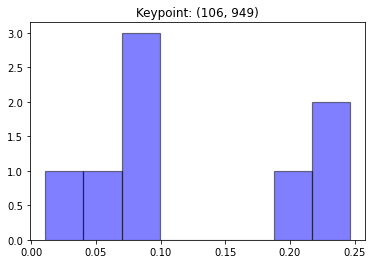

[0.01092476 0.06328016 0.24628412 0.18970686 0.09138987 0.24628412
 0.07628985 0.07584024]


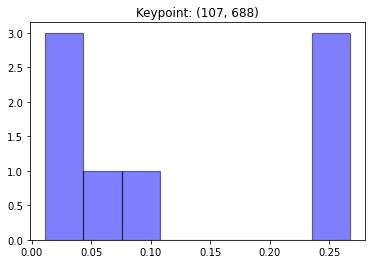

[0.05938092 0.01135094 0.02447044 0.0174506  0.09440449 0.26734212
 0.25825837 0.26734212]


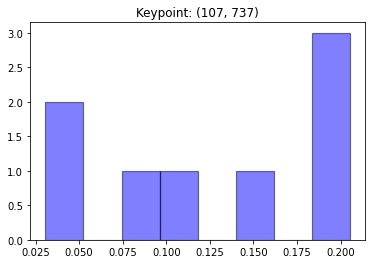

[0.04483781 0.03063709 0.20531714 0.18422666 0.14490019 0.1117959
 0.07533896 0.20294624]


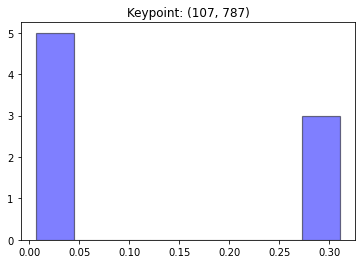

[0.31097126 0.01577402 0.0092576  0.00658744 0.00963499 0.02583216
 0.31097126 0.31097126]


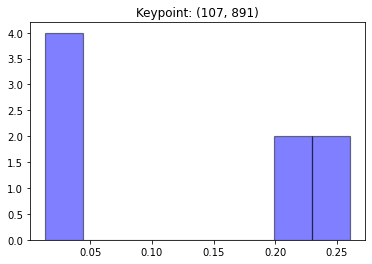

[0.26038764 0.20488381 0.26038764 0.20104478 0.0136188  0.02569858
 0.01732076 0.016658  ]


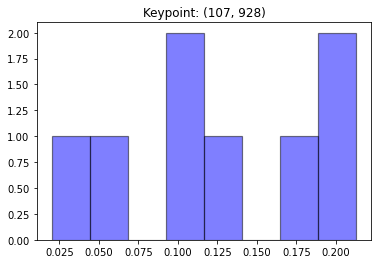

[0.13199557 0.21282151 0.21282151 0.10925056 0.02027241 0.05199779
 0.16722971 0.09361093]


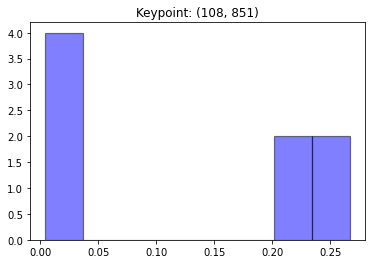

[0.01160708 0.0044499  0.00986502 0.0208421  0.26700329 0.2060987
 0.26700329 0.21313061]


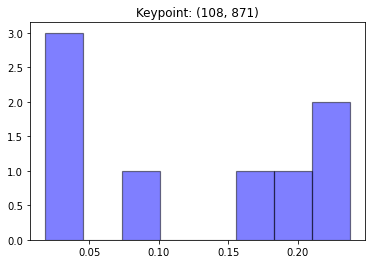

[0.16259042 0.03603691 0.03326683 0.0183572  0.07994114 0.23741182
 0.19498386 0.23741182]


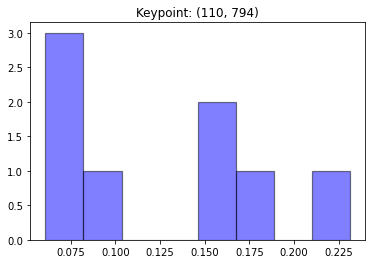

[0.23130445 0.06581678 0.07028026 0.06075632 0.15406009 0.15158937
 0.09696312 0.16922961]


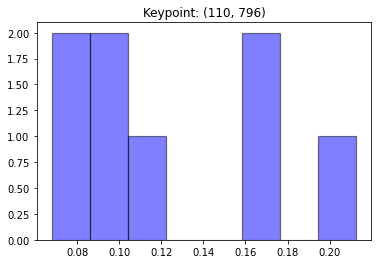

[0.21264126 0.11185052 0.07248269 0.06786941 0.16501292 0.16970421
 0.10305821 0.09738078]


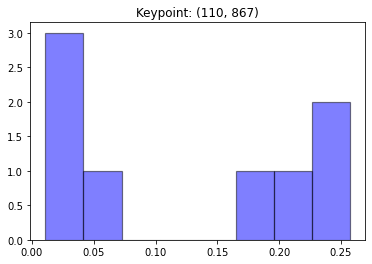

[0.19887612 0.01084986 0.01247179 0.01210524 0.05880379 0.25718332
 0.19252655 0.25718332]


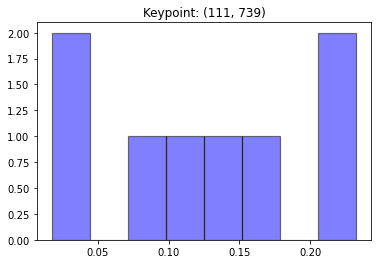

[0.02228682 0.01743811 0.22104519 0.09923934 0.15894194 0.23245757
 0.15068008 0.09791095]


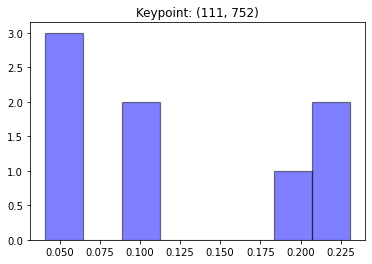

[0.10928098 0.04956134 0.04123539 0.04459194 0.09977334 0.23059267
 0.19437167 0.23059267]


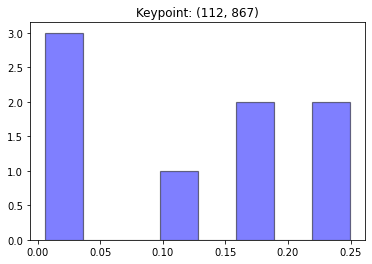

[0.11565606 0.01169317 0.00612715 0.00900642 0.17171921 0.24939063
 0.18701673 0.24939063]


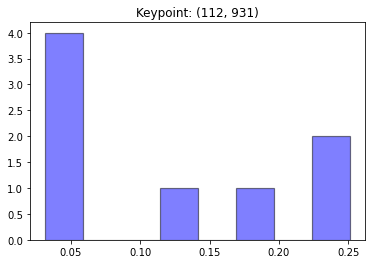

[0.25092497 0.12773776 0.25092497 0.1872658  0.03179302 0.04803433
 0.05041095 0.05290821]


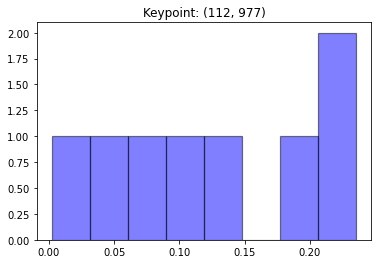

[0.00215337 0.23540524 0.23540524 0.14495403 0.06700035 0.1787681
 0.09934066 0.03697302]


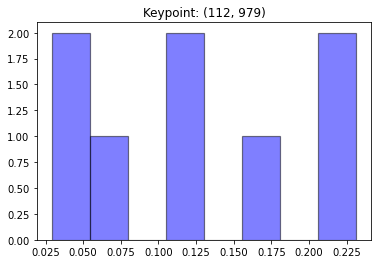

[0.02909881 0.23141423 0.23141423 0.12640458 0.05900322 0.16055468
 0.11208023 0.05003002]


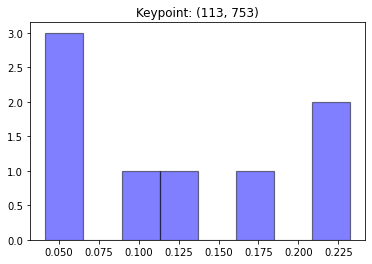

[0.12383506 0.05564055 0.04373228 0.0415799  0.10298165 0.21833565
 0.18168397 0.23221093]


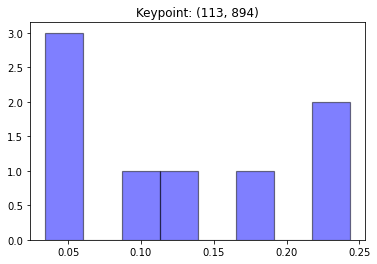

[0.0364327  0.0585382  0.24339639 0.11633817 0.09934378 0.24339639
 0.16813056 0.03442383]


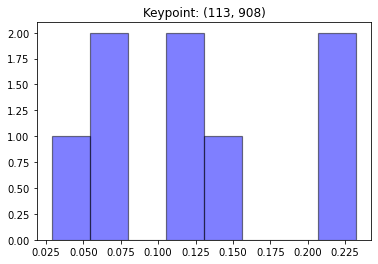

[0.14785792 0.11757241 0.23239653 0.02890415 0.10735937 0.06994672
 0.06356638 0.23239653]


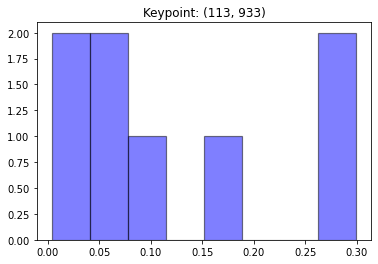

[0.2991635  0.15762712 0.2991635  0.11040537 0.03444449 0.05036089
 0.00378426 0.04505087]


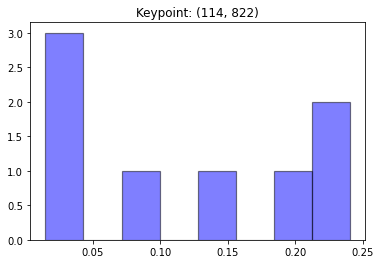

[0.02316101 0.01507547 0.03764917 0.2044948  0.2404974  0.08485626
 0.2404974  0.1537685 ]


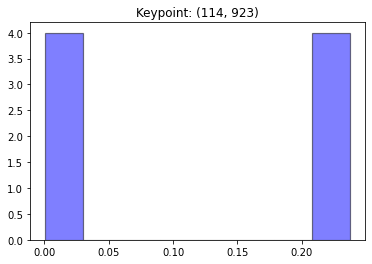

[0.23731145 0.23731145 0.23731145 0.23731145 0.02397849 0.00071938
 0.00322418 0.02283213]


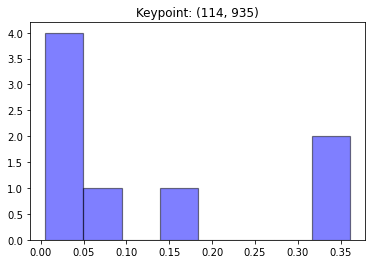

[0.360762   0.14586211 0.360762   0.03754855 0.01745536 0.01958733
 0.00537816 0.05264448]


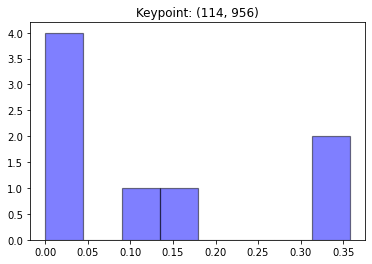

[0.17539711 0.3578877  0.3578877  0.10768197 0.         0.
 0.00114552 0.        ]


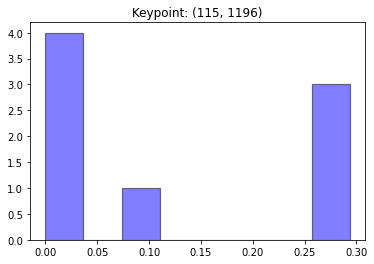

[0.         0.01001842 0.29362599 0.29362599 0.29362599 0.09653751
 0.01192461 0.00064148]


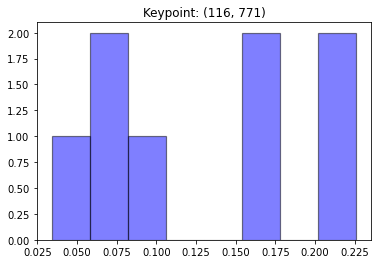

[0.0593283  0.15929896 0.20419642 0.03412965 0.08518832 0.06328067
 0.22598582 0.16859187]


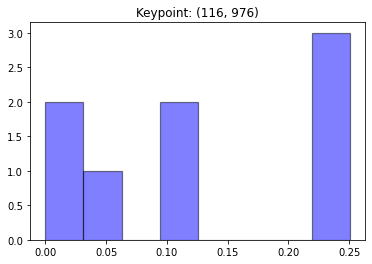

[0.         0.01487264 0.25043813 0.25043813 0.10789089 0.22045092
 0.11201366 0.04389563]


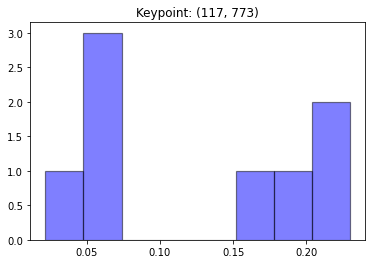

[0.05980949 0.18068719 0.17116773 0.0217572  0.05580755 0.05365624
 0.2296525  0.2274621 ]


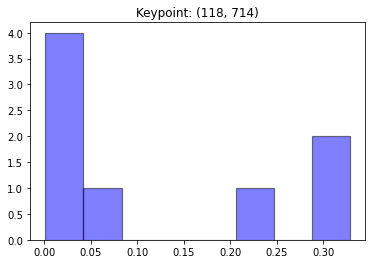

[0.01650009 0.01257524 0.00143386 0.03064464 0.04445984 0.32839613
 0.32839613 0.23759407]


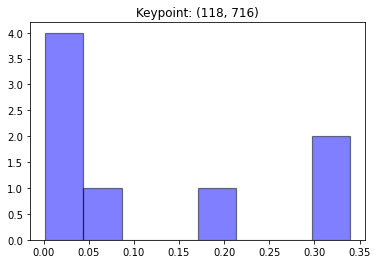

[0.01902297 0.01299733 0.00211273 0.03196862 0.04445841 0.33914553
 0.33914553 0.21114889]


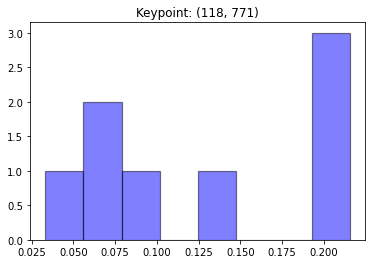

[0.06034622 0.21553045 0.20378107 0.03323847 0.08296392 0.06012607
 0.21553045 0.12848335]


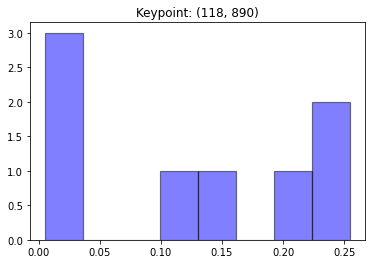

[0.14539256 0.02376697 0.01699098 0.00549724 0.10516724 0.25451233
 0.25451233 0.19416035]


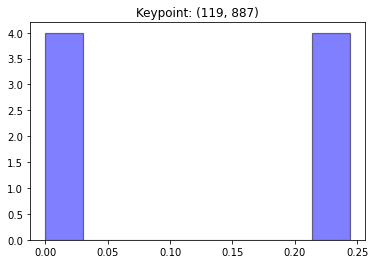

[0.23567726 0.02570132 0.00441501 0.         0.00207385 0.24404419
 0.24404419 0.24404419]


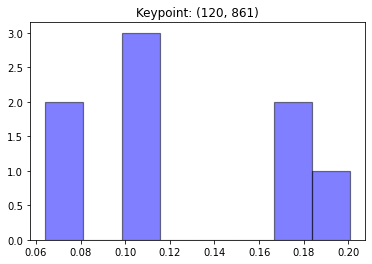

[0.07062125 0.09992916 0.18300756 0.11482433 0.20065929 0.06420073
 0.09971328 0.1670444 ]


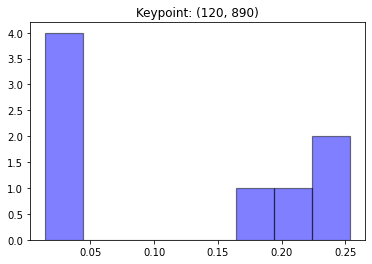

[0.17134764 0.03015923 0.02376677 0.01465997 0.03087356 0.2535175
 0.2535175  0.22215783]


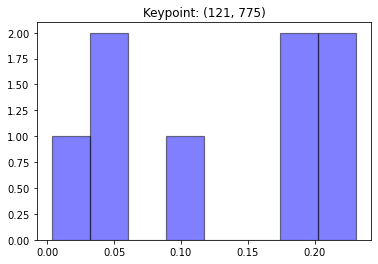

[0.10692053 0.23110026 0.17683047 0.00329889 0.0388228  0.03341521
 0.23110026 0.17851158]


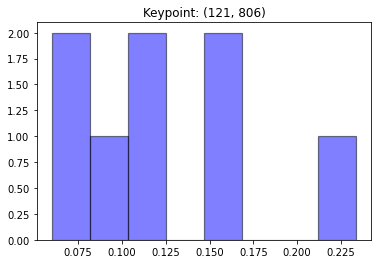

[0.15018943 0.10729466 0.09629726 0.06008597 0.11554367 0.2335991
 0.15935136 0.07763853]


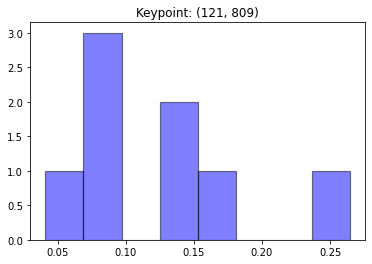

[0.16402609 0.08477553 0.09067857 0.0410939  0.06973649 0.26436179
 0.14765578 0.13767185]


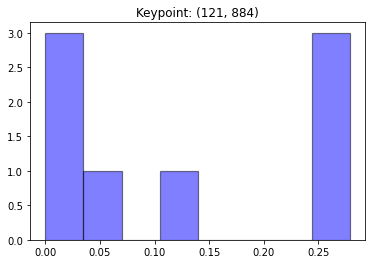

[0.27879961 0.03830879 0.0056442  0.         0.00395159 0.11569659
 0.27879961 0.27879961]


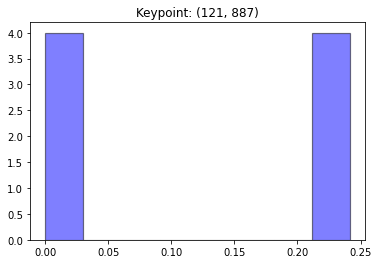

[0.24149173 0.02890167 0.00433162 0.         0.00203468 0.24025683
 0.24149173 0.24149173]


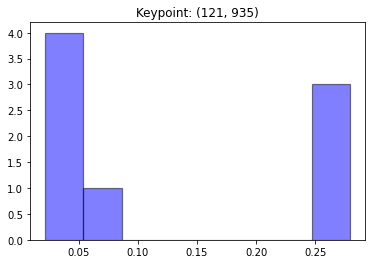

[0.26213077 0.27914286 0.27914286 0.06934103 0.02235696 0.02179925
 0.02619905 0.03988723]


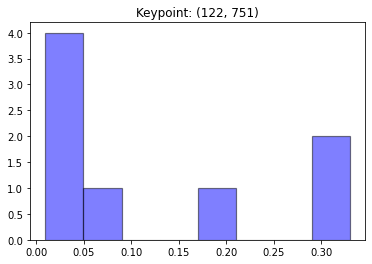

[0.17520974 0.33002621 0.08972832 0.0116017  0.00968624 0.0190156
 0.03470598 0.33002621]


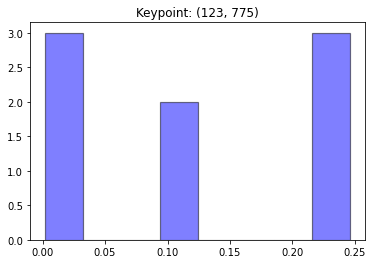

[0.12225517 0.24583429 0.12201839 0.00229817 0.00414564 0.01177975
 0.24583429 0.24583429]


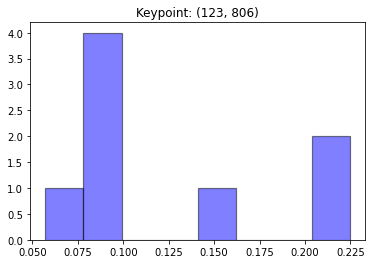

[0.20402566 0.09534325 0.08527951 0.05711959 0.14968162 0.22466843
 0.09584585 0.08803609]


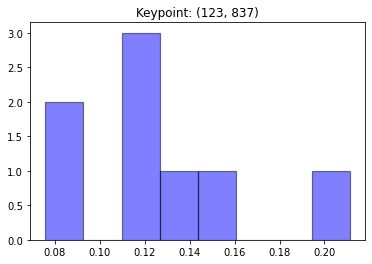

[0.08493379 0.14981779 0.11813671 0.0757239  0.11476227 0.12941444
 0.21129825 0.11591286]


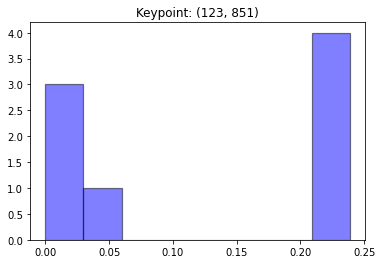

[0.23875129 0.04042508 0.00601965 0.         0.01461208 0.23875129
 0.23875129 0.22268933]


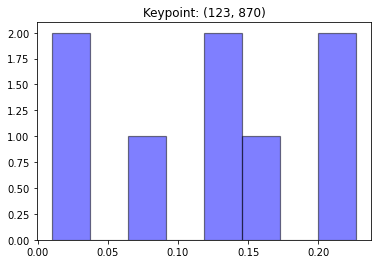

[0.13202448 0.1621394  0.13119793 0.07889465 0.0100244  0.03167219
 0.22702347 0.22702347]


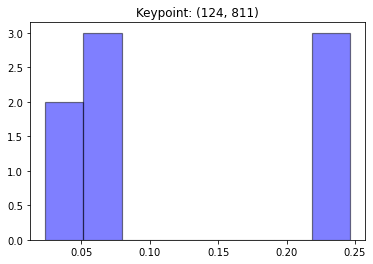

[0.24621347 0.07330162 0.05552492 0.02386322 0.04401693 0.24621347
 0.0794409  0.23142547]


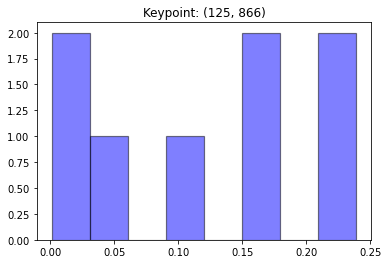

[0.17779907 0.23887909 0.23887909 0.1117029  0.02996827 0.00103614
 0.03651669 0.16521876]


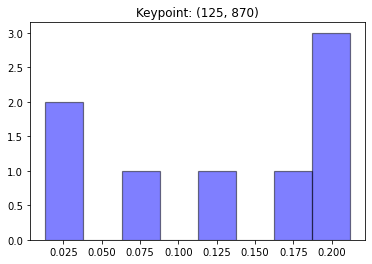

[0.11331901 0.16712155 0.1874361  0.06818931 0.0132323  0.02693087
 0.21188543 0.21188543]


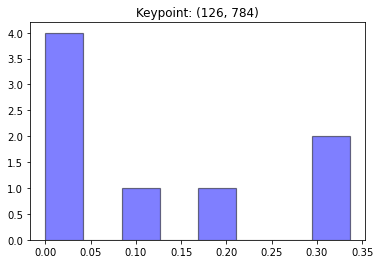

[0.10681844 0.00335075 0.00411514 0.         0.00336705 0.20979548
 0.33627657 0.33627657]


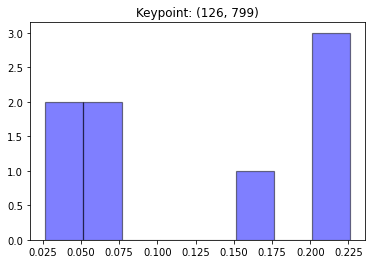

[0.22584029 0.05710196 0.02680238 0.05948292 0.16575338 0.22584029
 0.03561592 0.20356286]


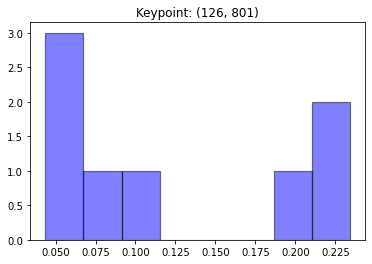

[0.23398556 0.08070617 0.04367719 0.06534341 0.19665533 0.23398556
 0.04503336 0.10061343]


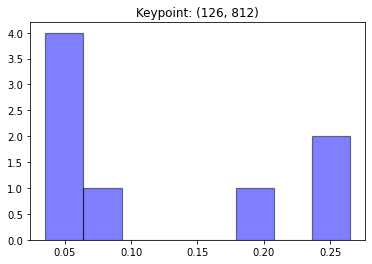

[0.2647779  0.08314525 0.05249461 0.03537639 0.05335192 0.19986521
 0.04621081 0.2647779 ]


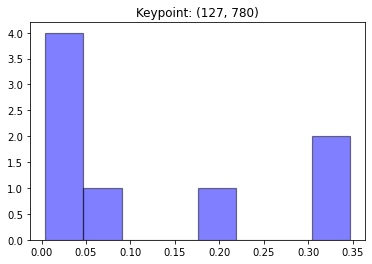

[0.08103219 0.00520819 0.00442936 0.02661698 0.00437969 0.18502798
 0.3466528  0.3466528 ]


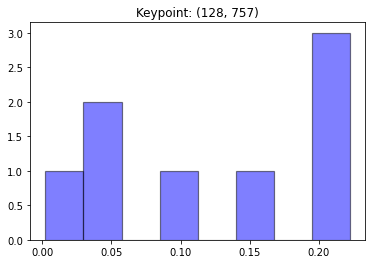

[0.00230143 0.22220439 0.14845529 0.05722429 0.09390437 0.22220439
 0.2176774  0.03602846]


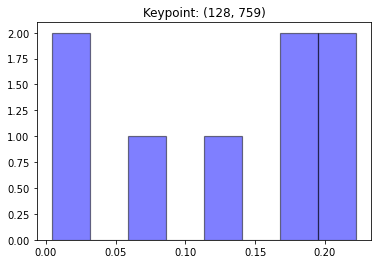

[0.00432972 0.22228595 0.1705911  0.06284955 0.1133516  0.22228595
 0.17346276 0.03084337]


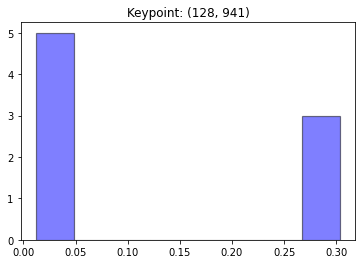

[0.04729503 0.30368787 0.30368787 0.27659877 0.02479199 0.01552373
 0.01659802 0.01181672]


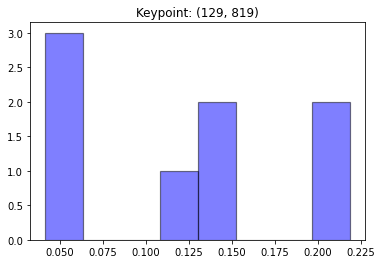

[0.21849444 0.1413942  0.04148844 0.06175579 0.11484475 0.21849444
 0.06011352 0.14341443]


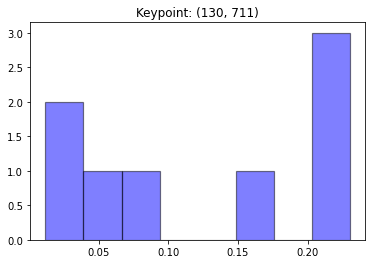

[0.15325641 0.06743316 0.05934832 0.0370707  0.21037375 0.23035968
 0.01179831 0.23035968]


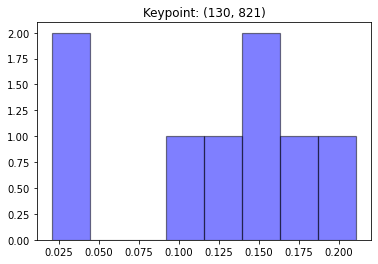

[0.16279223 0.16190128 0.10966999 0.17509382 0.11843289 0.21101384
 0.04055035 0.02054561]


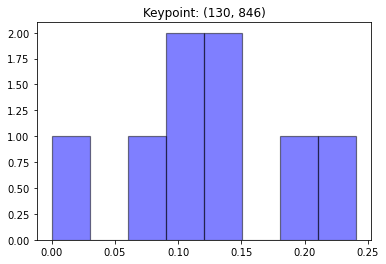

[0.11391537 0.2408642  0.14269889 0.10203022 0.13106162 0.18800731
 0.08142239 0.        ]


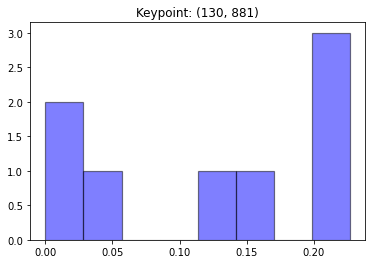

[0.15539538 0.01066507 0.         0.03197578 0.12099651 0.22698909
 0.22698909 0.22698909]


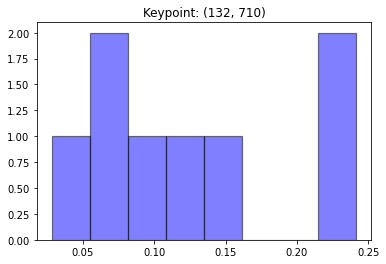

[0.11856161 0.09451129 0.06846599 0.05955647 0.24153341 0.14772132
 0.0281165  0.24153341]


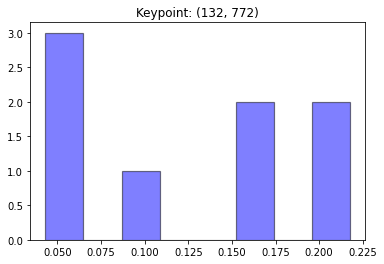

[0.2174985  0.16979131 0.04487541 0.0431091  0.09637333 0.05381785
 0.2174985  0.15703599]


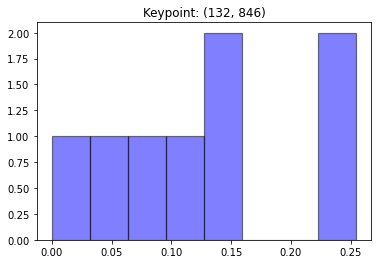

[0.13033687 0.25460838 0.25460838 0.14727082 0.11096471 0.07034847
 0.03186237 0.        ]


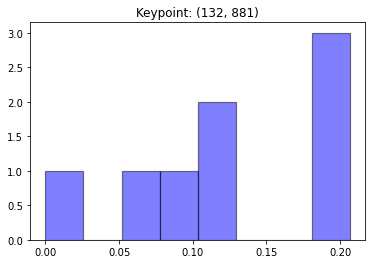

[0.104613   0.         0.11092142 0.07113732 0.09992562 0.20659445
 0.20659445 0.20021375]


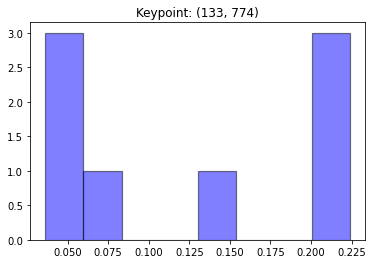

[0.22387411 0.15314388 0.03758922 0.03638074 0.06543321 0.0409679
 0.21873685 0.22387411]


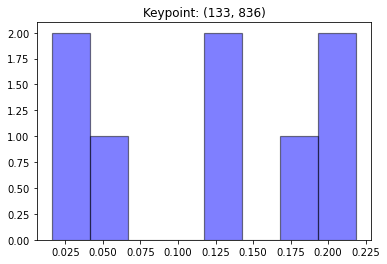

[0.19322698 0.21861713 0.13023578 0.13903185 0.21861713 0.04559333
 0.01595159 0.0387262 ]


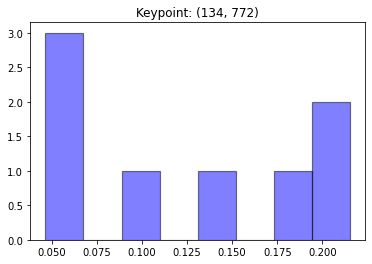

[0.21512102 0.18321649 0.04842365 0.04651768 0.09909507 0.05027936
 0.2093333  0.14801341]


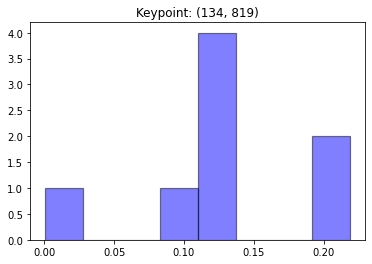

[0.11598693 0.21857596 0.11855041 0.11347423 0.09902586 0.21857596
 0.00085456 0.11495609]


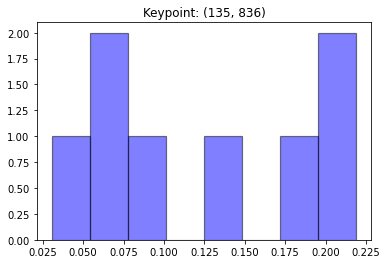

[0.17719196 0.21896056 0.09784553 0.12630073 0.21896056 0.06545265
 0.03052989 0.06475812]


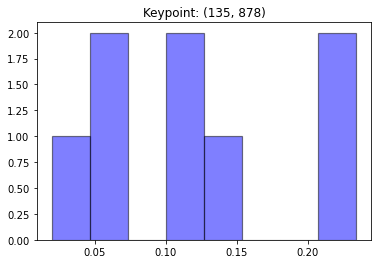

[0.01965635 0.06467926 0.23418857 0.12659848 0.15363918 0.21837381
 0.12304474 0.05981961]


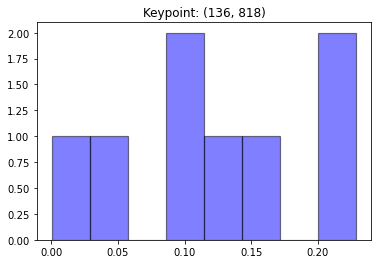

[0.13942907 0.22865552 0.15418401 0.10595761 0.09148413 0.22865552
 0.00030928 0.05132487]


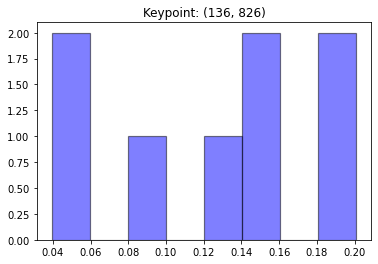

[0.03940337 0.15429552 0.05866079 0.19188004 0.12638259 0.1482866
 0.08022773 0.20086337]


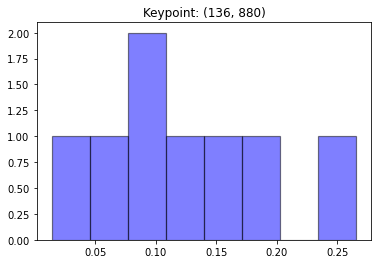

[0.01387536 0.08362283 0.26544715 0.12449536 0.14865679 0.20198899
 0.09162756 0.07028596]


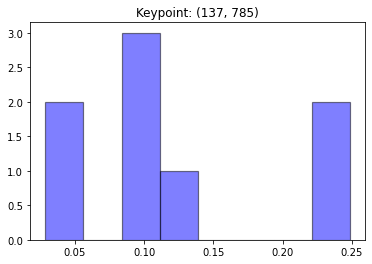

[0.24845464 0.09435756 0.03498074 0.02879784 0.10619289 0.13573991
 0.10302178 0.24845464]


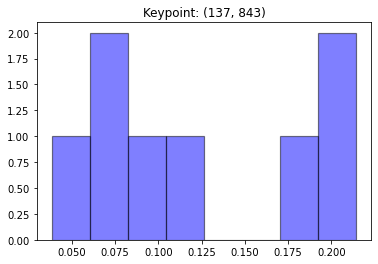

[0.11384714 0.21438363 0.19007675 0.03828905 0.06166095 0.21438363
 0.0800948  0.08726406]


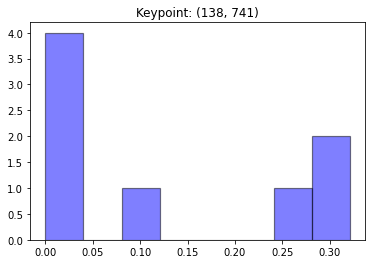

[0.25099622 0.00717977 0.         0.0032538  0.00699825 0.08946933
 0.32105132 0.32105132]


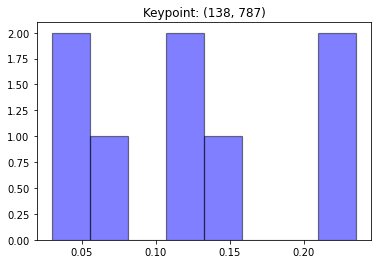

[0.23541286 0.06608759 0.02985154 0.05379803 0.11154304 0.12040078
 0.14749328 0.23541286]


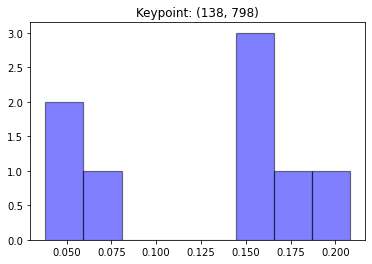

[0.15118766 0.03810857 0.0781249  0.04471766 0.14772141 0.14802078
 0.20808525 0.18403377]


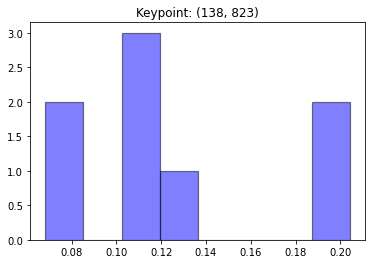

[0.10998103 0.20422863 0.1039128  0.1253916  0.06931128 0.1162079
 0.06830492 0.20266184]


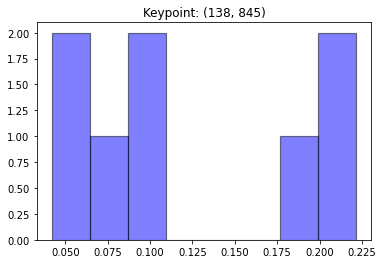

[0.05099952 0.22155711 0.1906297  0.04206206 0.08543638 0.22155711
 0.09069199 0.09706611]


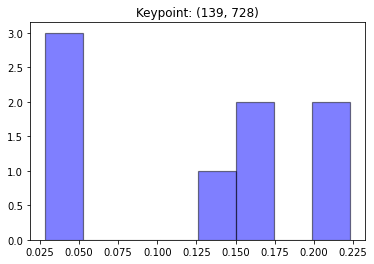

[0.22304114 0.03103393 0.04147396 0.16010805 0.22304114 0.14036944
 0.02846141 0.15247093]


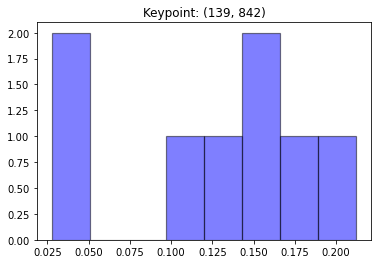

[0.02763695 0.16947355 0.1515403  0.04143645 0.16442902 0.2122744
 0.10945316 0.12375617]


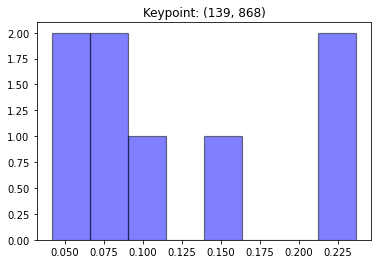

[0.23649789 0.05772491 0.16026342 0.23649789 0.11363353 0.04165224
 0.07171096 0.08201915]


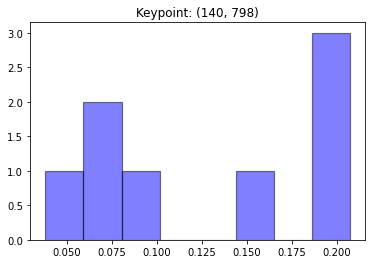

[0.19225598 0.03806657 0.06988457 0.07031737 0.15116886 0.08065374
 0.20723601 0.19041689]


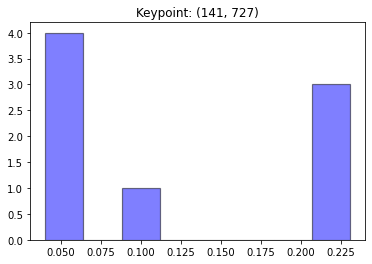

[0.23077093 0.05681061 0.05383707 0.23077093 0.23077093 0.0532353
 0.0402706  0.10353363]


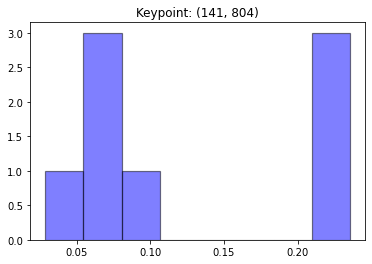

[0.0777308  0.05539309 0.21203268 0.23551715 0.23551715 0.06282925
 0.09243173 0.02854816]


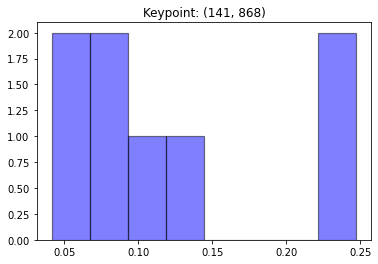

[0.24720185 0.07769195 0.04170911 0.24720185 0.1360274  0.05226831
 0.09282361 0.10507592]


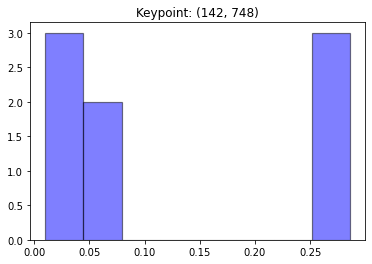

[0.28590498 0.04900984 0.01188497 0.01241996 0.01012194 0.05884834
 0.28590498 0.28590498]


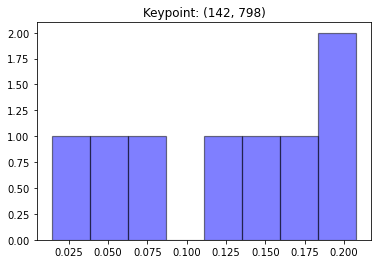

[0.17478314 0.01418833 0.07175201 0.11593162 0.14660683 0.06107407
 0.20783644 0.20782756]


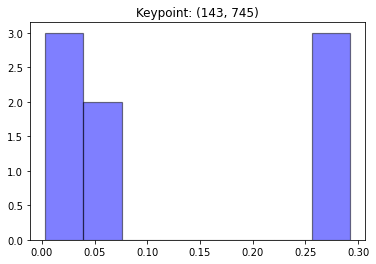

[0.29210059 0.04107072 0.00335633 0.01456111 0.00635011 0.05835997
 0.29210059 0.29210059]


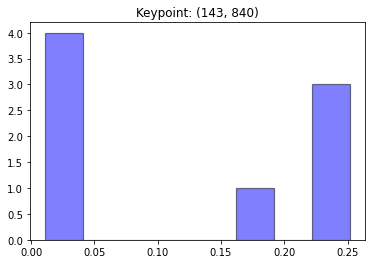

[0.01498024 0.01123285 0.01818684 0.03444644 0.25048202 0.25172373
 0.25172373 0.16722414]


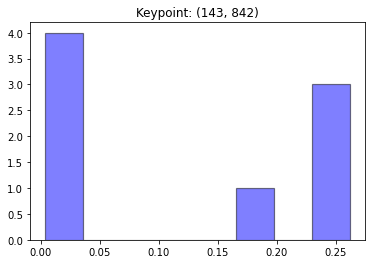

[0.01985113 0.01182392 0.00980123 0.00388602 0.26170518 0.26170518
 0.26170518 0.16952217]


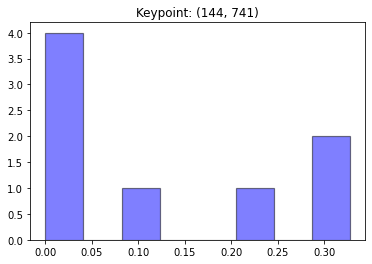

[0.24227169 0.00698107 0.         0.00396194 0.00680458 0.08536565
 0.32730753 0.32730753]


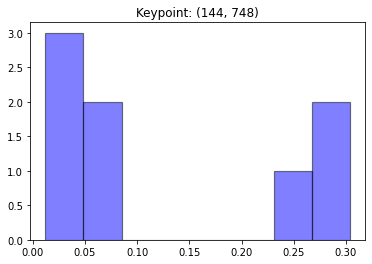

[0.30362349 0.05856583 0.01420232 0.01707088 0.01209553 0.05844206
 0.23237641 0.30362349]


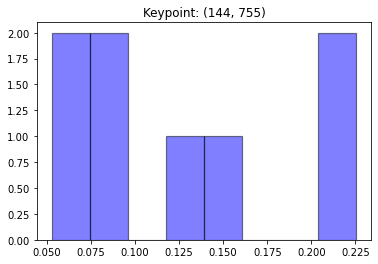

[0.22542104 0.06273338 0.0911575  0.08175488 0.21884636 0.14057983
 0.05278625 0.12672077]


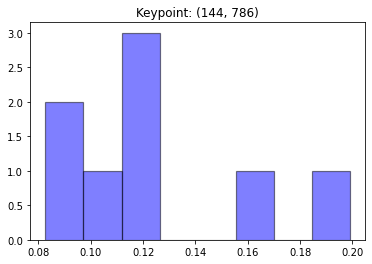

[0.16562565 0.08266107 0.12361269 0.08674526 0.1034799  0.12356489
 0.11530789 0.19900265]


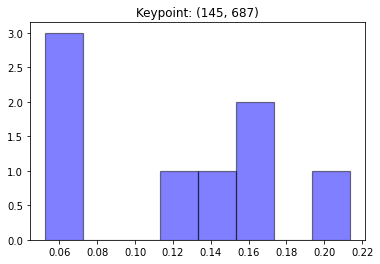

[0.06580632 0.05257392 0.06605929 0.13232817 0.17223805 0.21348287
 0.13791545 0.15959593]


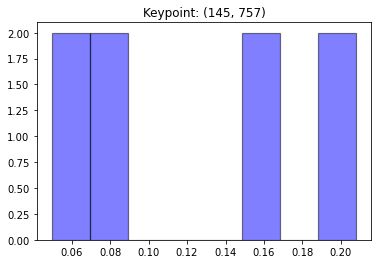

[0.19434149 0.04964904 0.08246661 0.07604245 0.20795881 0.16162516
 0.06370646 0.16420998]


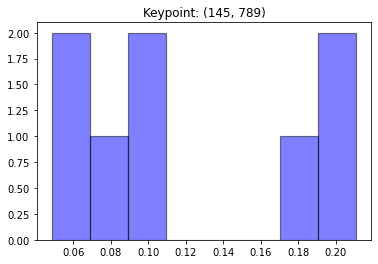

[0.21086972 0.10139959 0.06485026 0.04844894 0.0743183  0.10137745
 0.18786601 0.21086972]


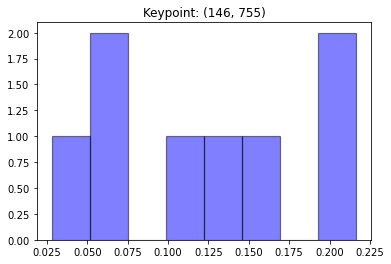

[0.21649788 0.02793519 0.07126197 0.06502252 0.21649788 0.14350416
 0.10608294 0.15319745]


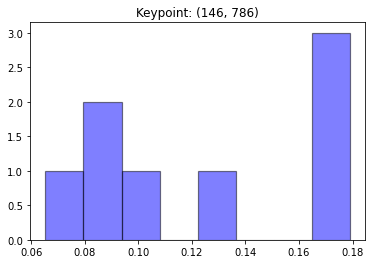

[0.17159696 0.08472128 0.12943327 0.09131741 0.10575984 0.06524758
 0.17897983 0.17294383]


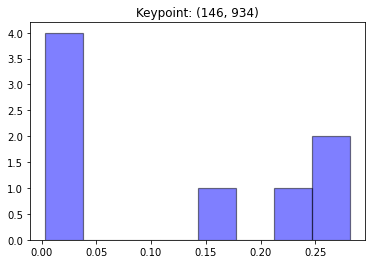

[0.2815597  0.22744238 0.01110268 0.00450936 0.00348753 0.03801717
 0.2815597  0.15232149]


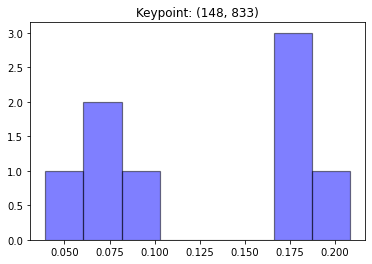

[0.07501294 0.07442249 0.03944197 0.09423067 0.16660734 0.17279702
 0.20828953 0.16919803]


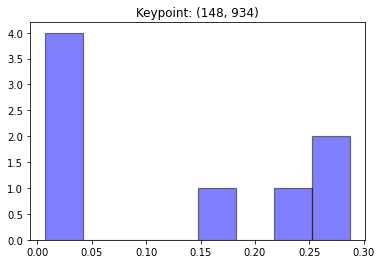

[0.28701861 0.22448917 0.01592315 0.0074004  0.0088126  0.01291365
 0.28701861 0.15642381]


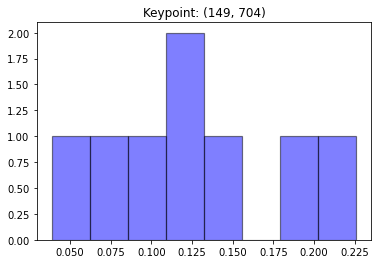

[0.08969513 0.19458282 0.11862297 0.06955929 0.03866861 0.22593547
 0.13463296 0.12830276]


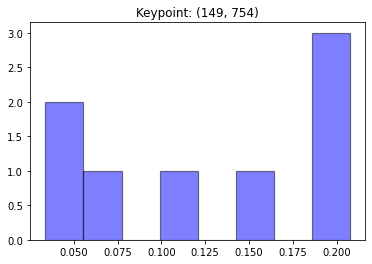

[0.14465889 0.03383102 0.03973626 0.06449866 0.20749956 0.20749956
 0.1964597  0.10581635]


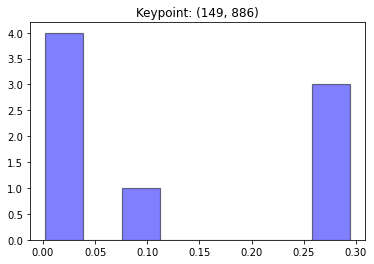

[0.08979798 0.29408735 0.29408735 0.29408735 0.00227301 0.00913021
 0.00654005 0.00999671]


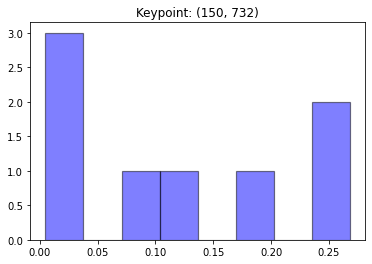

[0.08727696 0.0208049  0.00489437 0.02734772 0.26802685 0.1350106
 0.26802685 0.18861174]


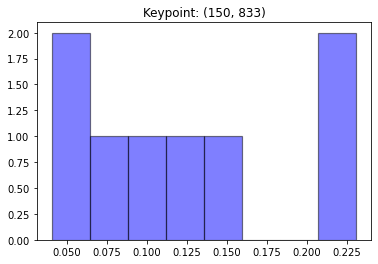

[0.13968854 0.07491757 0.04036731 0.09349568 0.06231401 0.12723413
 0.23099138 0.23099138]


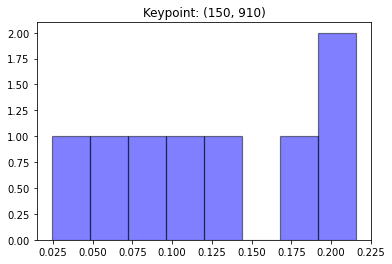

[0.09697756 0.05626902 0.20020455 0.21573053 0.08854265 0.18565865
 0.13221137 0.02440567]


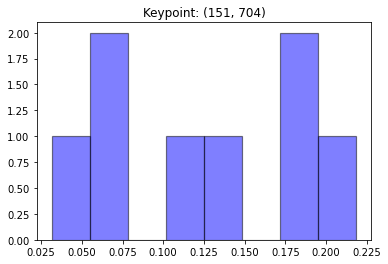

[0.11067129 0.19021555 0.14008423 0.06994375 0.03159525 0.21843324
 0.18395079 0.05510589]


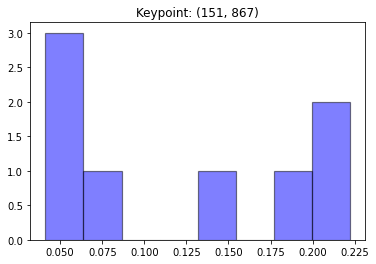

[0.22209186 0.05240769 0.04654542 0.04121856 0.1355209  0.08355698
 0.22209186 0.19656674]


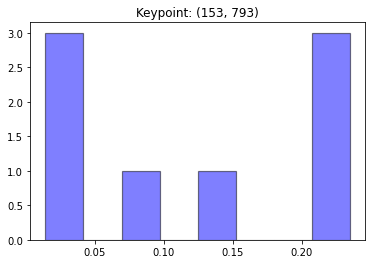

[0.01425587 0.02733501 0.07813075 0.22817898 0.23453987 0.03906127
 0.23453987 0.14395838]


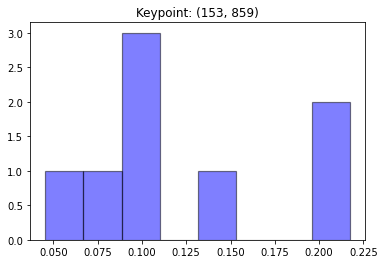

[0.15086044 0.09705003 0.10044117 0.10753906 0.06842847 0.04552759
 0.21285386 0.2172994 ]


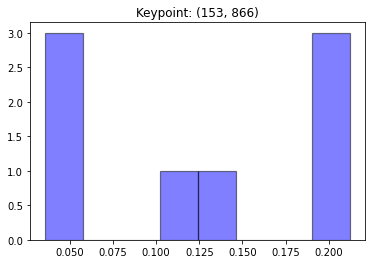

[0.2122325  0.04926227 0.04487334 0.03579471 0.12419999 0.11650909
 0.2122325  0.20489561]


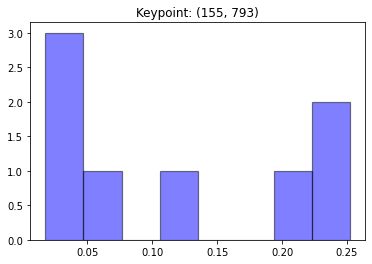

[0.01759896 0.0282529  0.06185954 0.2169303  0.25218699 0.03797512
 0.25218699 0.13300921]


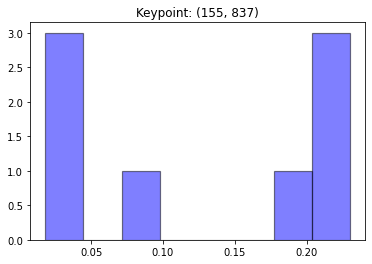

[0.20934232 0.21406604 0.0403535  0.03159898 0.01813526 0.07386978
 0.18266176 0.22997237]


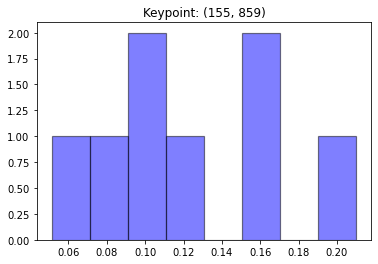

[0.16080597 0.10695091 0.10798274 0.12060927 0.07330802 0.05129334
 0.16900929 0.21004046]


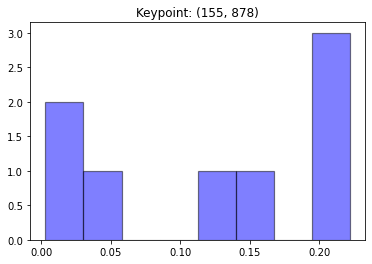

[0.22187303 0.22187303 0.05601408 0.00703153 0.00305349 0.15328027
 0.22187303 0.11500153]


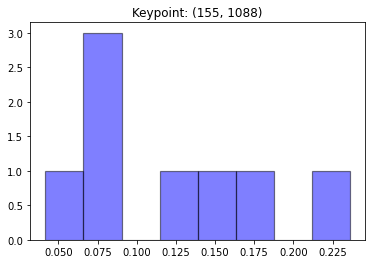

[0.1462283  0.23598201 0.08199246 0.08846742 0.04174806 0.08930288
 0.18008732 0.13619154]


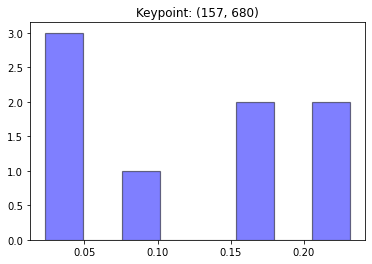

[0.09558618 0.03317749 0.02331793 0.04033003 0.23139361 0.23139361
 0.17544646 0.16935468]


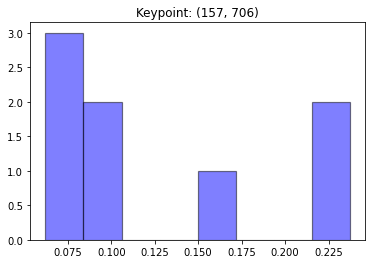

[0.06202031 0.08666472 0.0674516  0.07044318 0.21739566 0.16158043
 0.23724752 0.09719658]


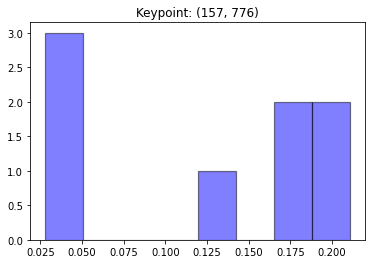

[0.16610184 0.03808446 0.04858921 0.02802722 0.19622897 0.21065853
 0.12721296 0.18509681]


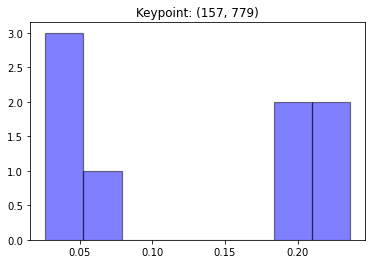

[0.18768866 0.04289875 0.05473142 0.02659248 0.0265285  0.18962654
 0.23596683 0.23596683]


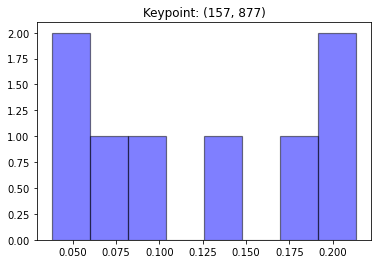

[0.14686563 0.19850764 0.03804295 0.06900498 0.04426954 0.18761847
 0.21352952 0.10216128]


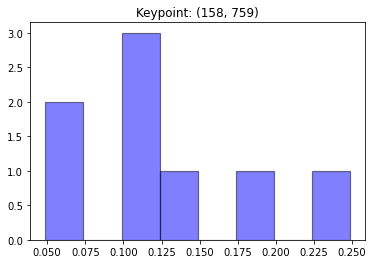

[0.04883262 0.10620334 0.17989619 0.04977761 0.14689785 0.12009909
 0.24842603 0.09986727]


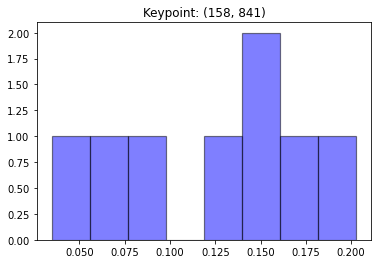

[0.16028256 0.17333887 0.06350285 0.07785405 0.03470507 0.20278855
 0.15145357 0.13607449]


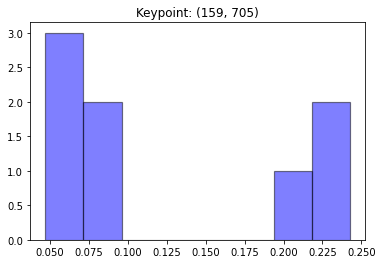

[0.07739314 0.04742228 0.04702507 0.05709035 0.21963561 0.21312113
 0.24253327 0.09577917]


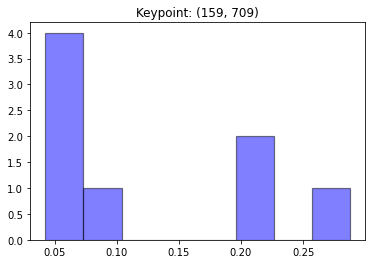

[0.04892367 0.0520823  0.04262523 0.06507147 0.19664023 0.20519673
 0.28757755 0.10188279]


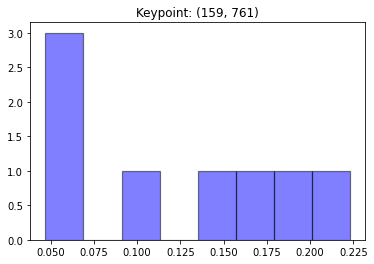

[0.04702229 0.1072848  0.17417499 0.05718109 0.18017809 0.14541112
 0.22295173 0.0657959 ]


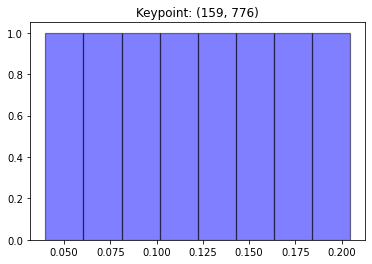

[0.13895669 0.03991406 0.11531305 0.07762431 0.16979569 0.20446238
 0.09305666 0.16087715]


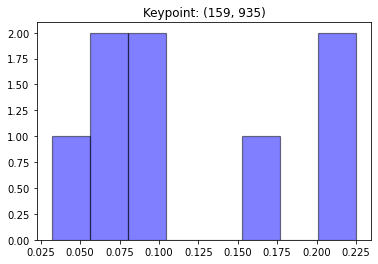

[0.22507108 0.22507108 0.06655147 0.03195315 0.17549926 0.07544227
 0.09707743 0.10333426]


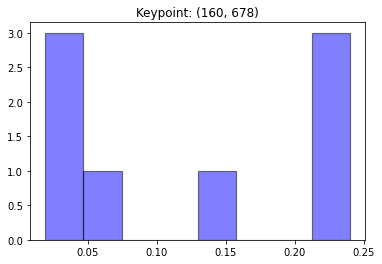

[0.04965913 0.02142782 0.01917915 0.03680398 0.2397545  0.2397545
 0.2397545  0.15366641]


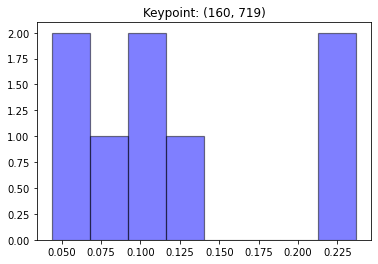

[0.1140396  0.11162847 0.04423951 0.04374086 0.08791975 0.23684466
 0.23684466 0.12474248]


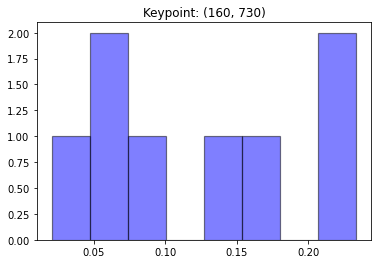

[0.09567231 0.04953692 0.1507059  0.16968262 0.22382101 0.02043353
 0.05649834 0.23364937]


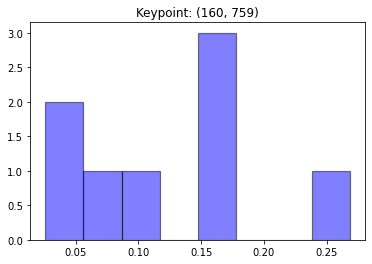

[0.02602687 0.06824238 0.15599514 0.05329649 0.17011224 0.14804972
 0.26839461 0.10988255]


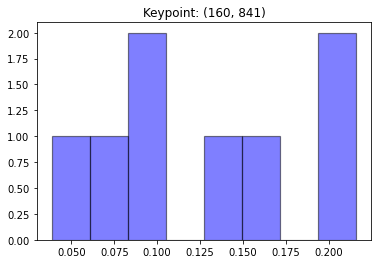

[0.10170046 0.1429318  0.06648392 0.08343336 0.03850741 0.21608588
 0.19531106 0.15554611]


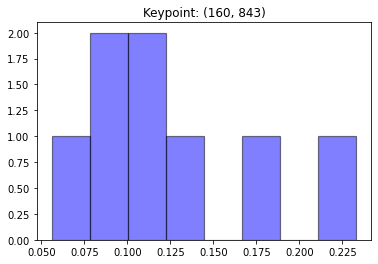

[0.09211376 0.18494385 0.08797443 0.1116096  0.05605685 0.23298295
 0.12441835 0.1099002 ]


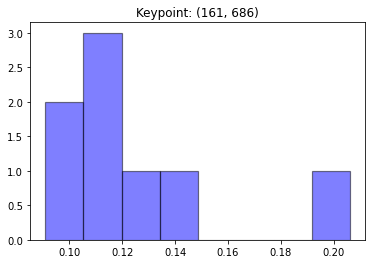

[0.09093062 0.11671308 0.12044898 0.13609345 0.20606812 0.11399263
 0.10323232 0.1125208 ]


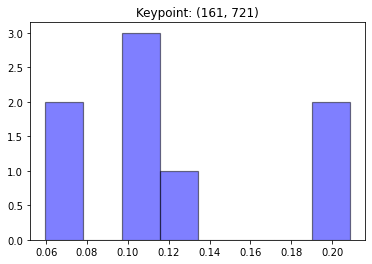

[0.10784516 0.11226775 0.07373334 0.05968095 0.11753961 0.20862416
 0.20862416 0.11168487]


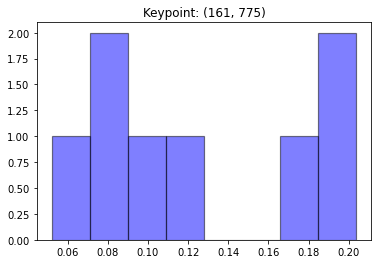

[0.09311367 0.08217143 0.20373894 0.08033068 0.17068174 0.19828288
 0.05204526 0.11963541]


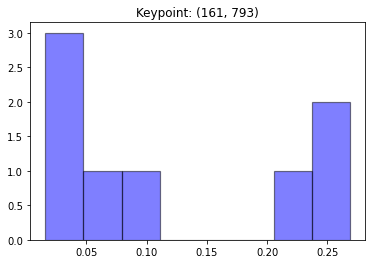

[0.06606338 0.04059428 0.01607441 0.02024933 0.26850883 0.26850883
 0.21546625 0.10453469]


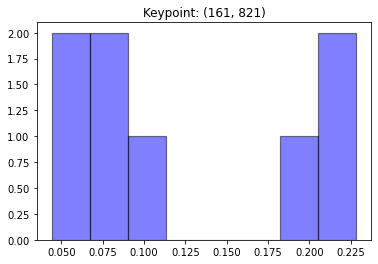

[0.09093626 0.07412783 0.08486885 0.06530445 0.1838249  0.22833198
 0.22833198 0.04427374]


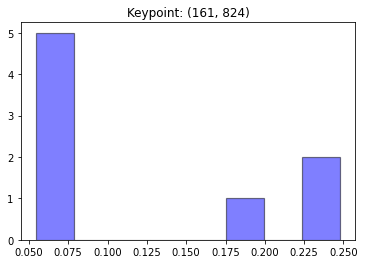

[0.07679086 0.06580091 0.07184159 0.05818023 0.1772532  0.24788464
 0.24788464 0.05436393]


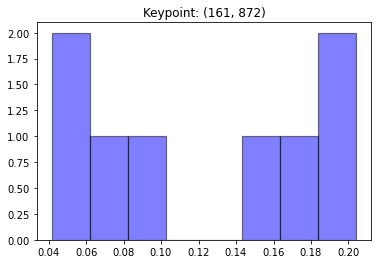

[0.05450468 0.0813948  0.17709654 0.1984308  0.09839379 0.20409335
 0.14437056 0.04171548]


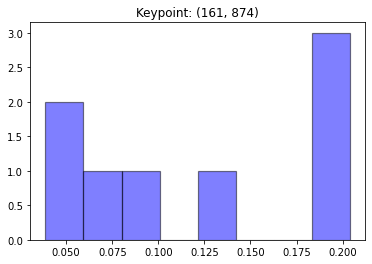

[0.05488713 0.07133    0.18825689 0.20391583 0.10051675 0.20391583
 0.13847606 0.03870151]


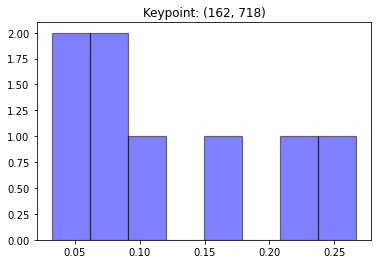

[0.09240772 0.09060447 0.03246419 0.04452324 0.08332547 0.23653417
 0.26671792 0.15342282]


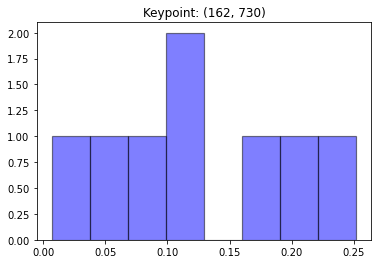

[0.11781413 0.06460303 0.17623276 0.19238288 0.09016537 0.00699835
 0.09993843 0.25186504]


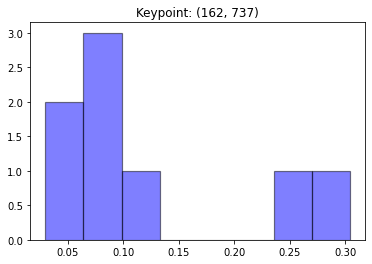

[0.12764469 0.0796271  0.09675193 0.08029993 0.04627913 0.02964845
 0.23561222 0.30413656]


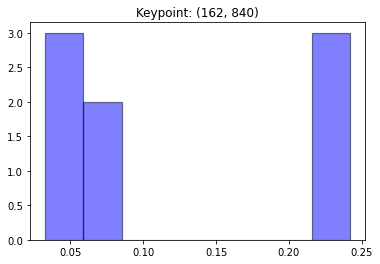

[0.05130832 0.03283203 0.06184118 0.0788555  0.04982617 0.24177893
 0.24177893 0.24177893]


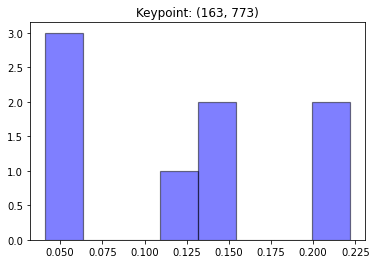

[0.05921971 0.11489077 0.2217293  0.14592296 0.21443845 0.15065134
 0.04121475 0.05193272]


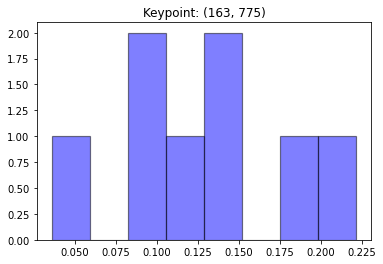

[0.0901932  0.11321626 0.22164471 0.13002186 0.19193222 0.13096616
 0.03605937 0.08596622]


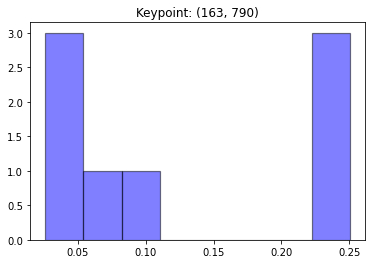

[0.05623067 0.02840309 0.02927179 0.02611626 0.25039937 0.25039937
 0.25039937 0.10878008]


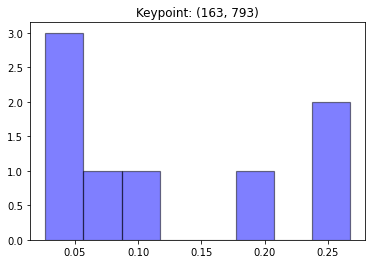

[0.06403295 0.03816317 0.03543314 0.02674827 0.26715627 0.26715627
 0.20014224 0.1011677 ]


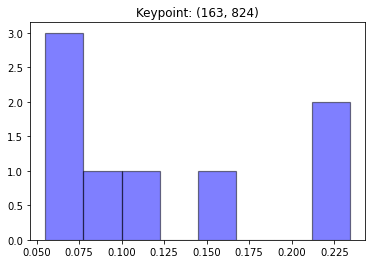

[0.0808492  0.05516903 0.10099873 0.07531076 0.16338725 0.23411977
 0.23411977 0.05604549]


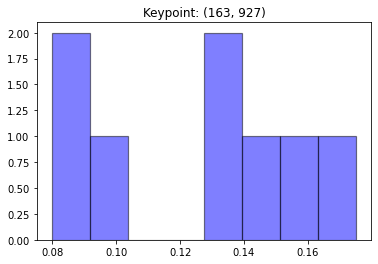

[0.12809166 0.12957783 0.16170486 0.07979462 0.17513563 0.10362471
 0.08042328 0.14164741]


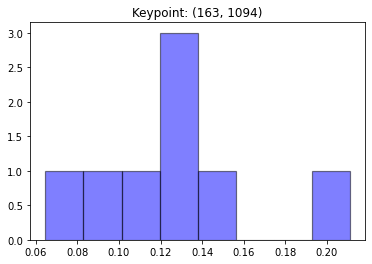

[0.15160985 0.21095809 0.10168201 0.1268172  0.09104581 0.06458796
 0.12462856 0.12867052]


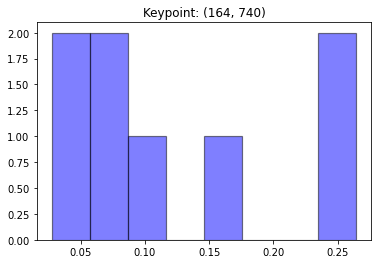

[0.23820772 0.09293358 0.0862894  0.07418621 0.05057229 0.02739113
 0.16605286 0.2643668 ]


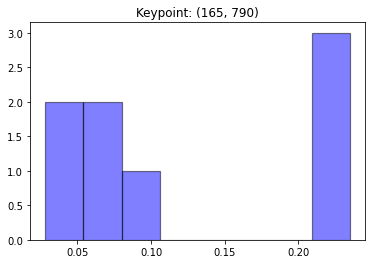

[0.06917736 0.02821544 0.05202448 0.05882402 0.23499618 0.23499618
 0.21855329 0.10321306]


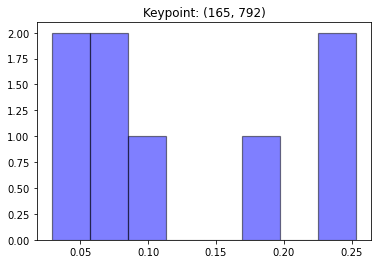

[0.0767154  0.0289779  0.04757388 0.06002939 0.25336983 0.25336983
 0.17910791 0.10085587]


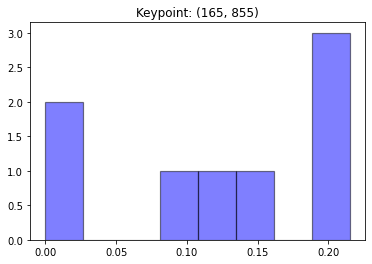

[0.21513141 0.         0.         0.08429537 0.14786388 0.21431346
 0.12326447 0.21513141]


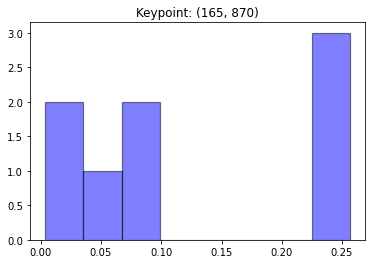

[0.07343645 0.25643248 0.25643248 0.24785748 0.09027115 0.05564598
 0.00386668 0.01605731]


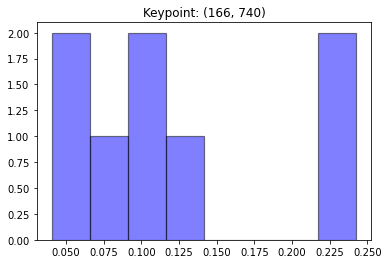

[0.24250354 0.11467755 0.09961683 0.08095048 0.0594224  0.04065645
 0.1196692  0.24250354]


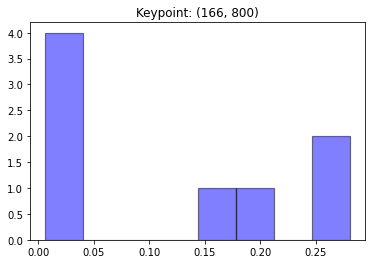

[0.00642565 0.02009128 0.02386116 0.20348895 0.28067806 0.28067806
 0.14513352 0.03964332]


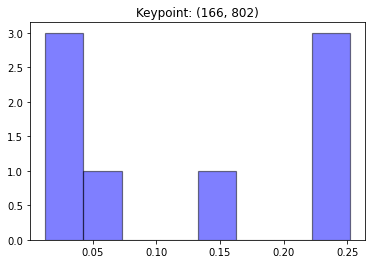

[0.0129528  0.02415441 0.02557205 0.23196733 0.25180548 0.25180548
 0.15790257 0.04383987]


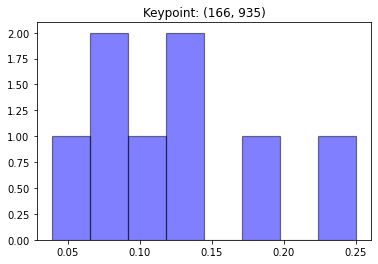

[0.12913753 0.25014564 0.12191572 0.03884575 0.07569913 0.19440239
 0.09899005 0.09086379]


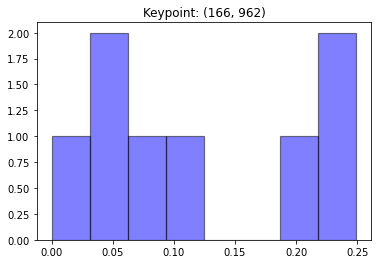

[0.24911493 0.         0.1975075  0.24911493 0.0609309  0.05355589
 0.07711463 0.11266123]


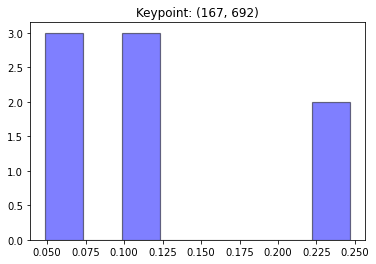

[0.05120518 0.04882446 0.07041328 0.1050437  0.11101316 0.2466546
 0.2466546  0.12019103]


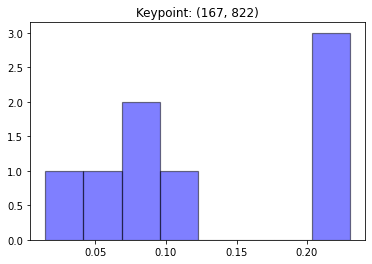

[0.04530636 0.01453168 0.07024201 0.09488768 0.23031099 0.23031099
 0.20359557 0.11081472]


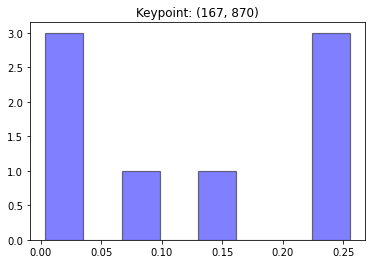

[0.07028759 0.25536837 0.25536837 0.25277115 0.13431925 0.01433308
 0.00383769 0.01371447]


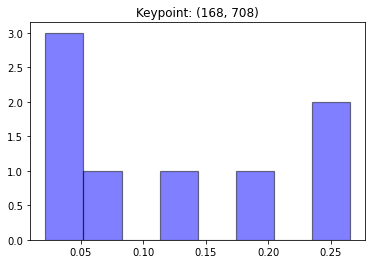

[0.11685521 0.04563665 0.0252128  0.02179437 0.07668004 0.18369181
 0.26506456 0.26506456]


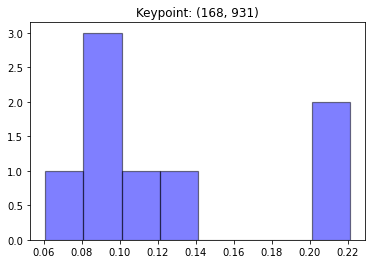

[0.10239202 0.22098186 0.13940657 0.06081502 0.08105536 0.21094385
 0.09322654 0.09117878]


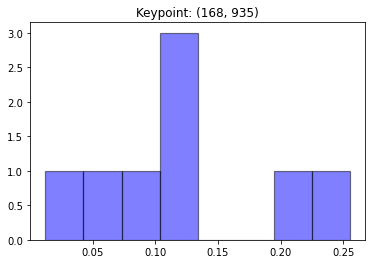

[0.12271449 0.25525907 0.1268859  0.01230454 0.06351793 0.21987914
 0.10552064 0.0939183 ]


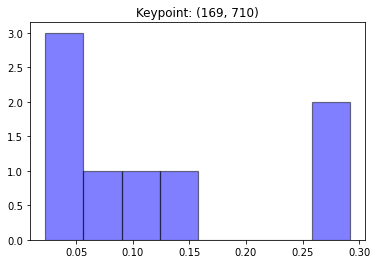

[0.10594213 0.0413613  0.02274809 0.02446487 0.06821859 0.15390999
 0.29167751 0.29167751]


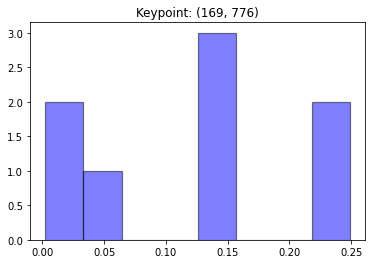

[0.00245564 0.15421695 0.24885349 0.15028558 0.1323219  0.24885349
 0.05316253 0.00985043]


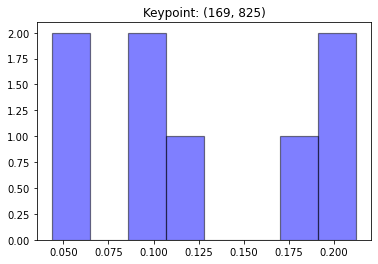

[0.04892502 0.04361302 0.17427318 0.09295513 0.1162515  0.21228879
 0.21228879 0.09940456]


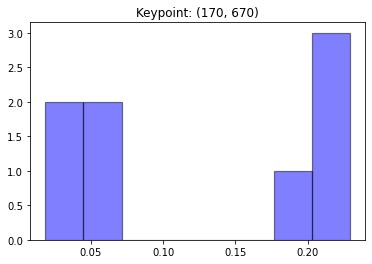

[0.04564768 0.01867444 0.03513222 0.05044573 0.22063615 0.22905926
 0.18016828 0.22023625]


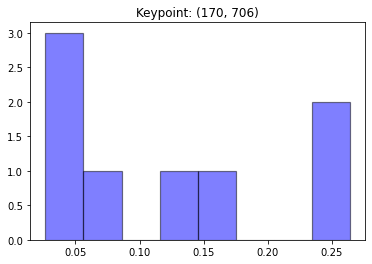

[0.13702459 0.0382478  0.0266472  0.03191982 0.08309562 0.16734397
 0.26387839 0.2518426 ]


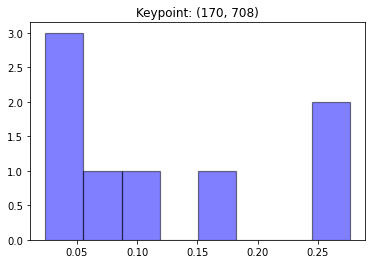

[0.11810733 0.03855129 0.02404174 0.02671761 0.07040397 0.16959717
 0.27629044 0.27629044]


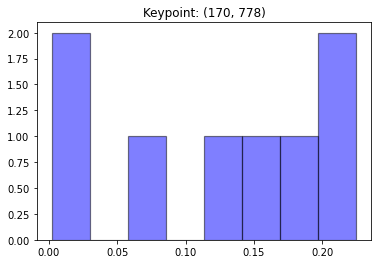

[0.00204649 0.14978989 0.22472414 0.12662312 0.18839524 0.22472414
 0.06206233 0.02163467]


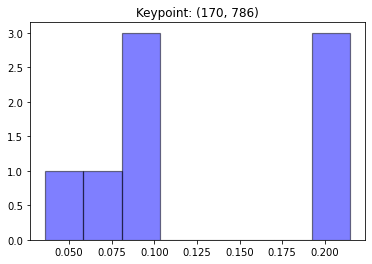

[0.08511134 0.06656725 0.10020757 0.21230296 0.21470508 0.19396318
 0.09106883 0.03607378]


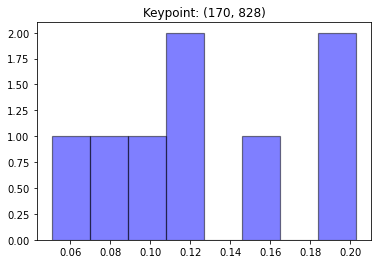

[0.08032443 0.11803925 0.19257006 0.09624699 0.1128272  0.20297534
 0.14630363 0.0507131 ]


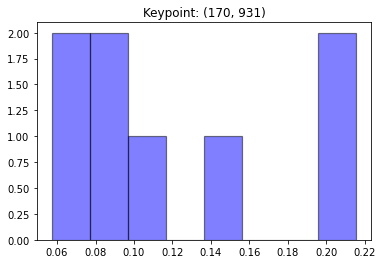

[0.09622135 0.21544195 0.14774104 0.05727669 0.06217967 0.21544195
 0.11409305 0.09160431]


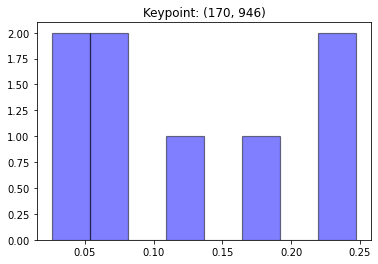

[0.07123306 0.24734223 0.18257925 0.24734223 0.12577768 0.0579764
 0.02596139 0.04178776]


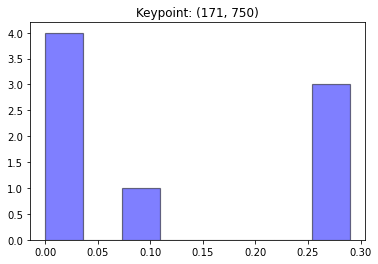

[0.28976958 0.09750077 0.00214027 0.00029051 0.00401792 0.02674179
 0.28976958 0.28976958]


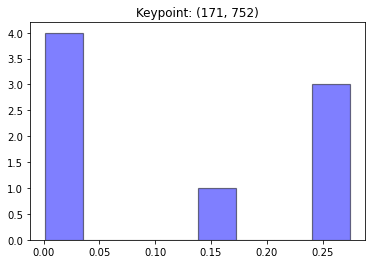

[0.2743061  0.13938811 0.02441747 0.0081315  0.00165609 0.00348852
 0.2743061  0.2743061 ]


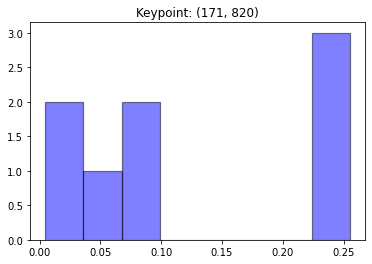

[0.00484994 0.01234192 0.05788731 0.08710615 0.25516129 0.25516129
 0.25516129 0.07233079]


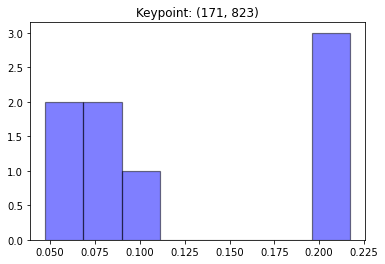

[0.05541662 0.04731378 0.07363765 0.08117852 0.2170479  0.2170479
 0.2170479  0.09130973]


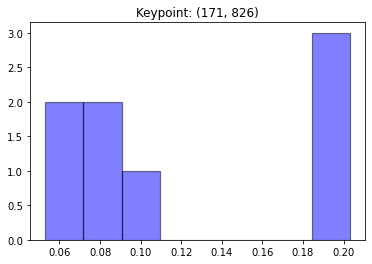

[0.0530763  0.08025275 0.20302701 0.10518041 0.06856621 0.20302701
 0.20302701 0.08384329]


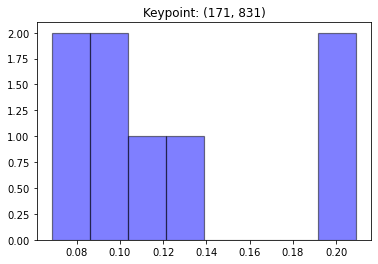

[0.08961747 0.20926593 0.20926593 0.13400544 0.0826323  0.11451102
 0.09222044 0.06848148]


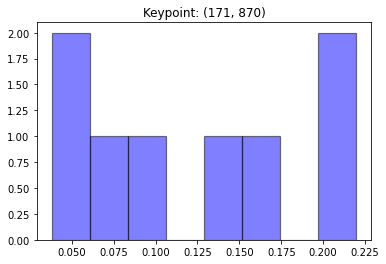

[0.04960999 0.21967497 0.15771842 0.06980886 0.10510085 0.21967497
 0.14030145 0.03811049]


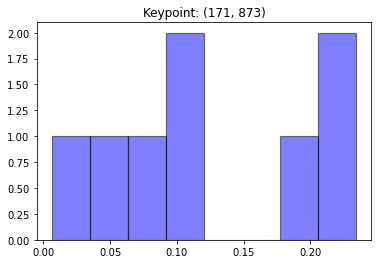

[0.05054489 0.23433675 0.23433675 0.06847819 0.09928137 0.19549994
 0.11125055 0.00627157]


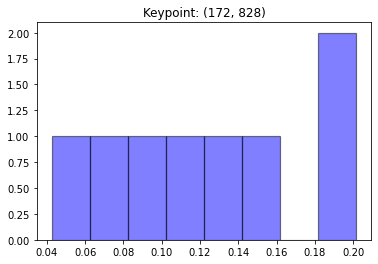

[0.07731929 0.14379838 0.20147457 0.11625159 0.08897454 0.2001347
 0.12942833 0.0426186 ]


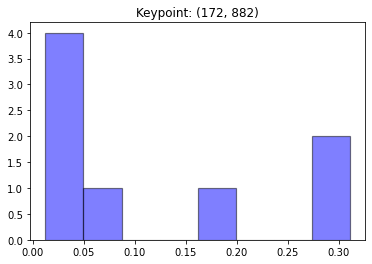

[0.08220352 0.3110567  0.3110567  0.19215253 0.04770334 0.01228166
 0.0164649  0.02708066]


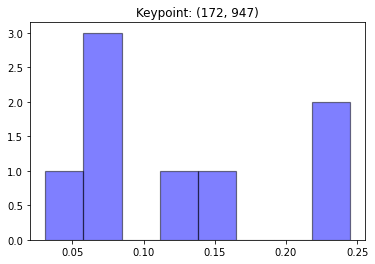

[0.11209328 0.24478972 0.07381036 0.24478972 0.14580718 0.07369376
 0.0310124  0.07400357]


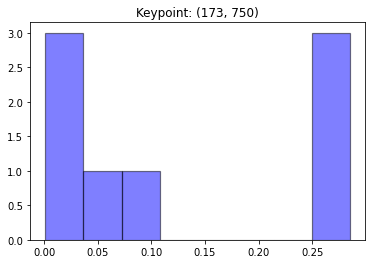

[0.2842557  0.08790677 0.00313774 0.00092869 0.008793   0.04455415
 0.28521198 0.28521198]


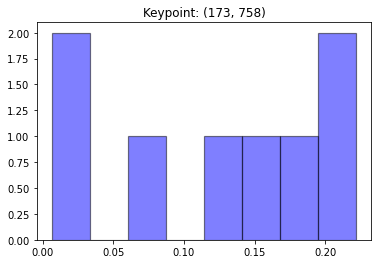

[0.22176182 0.16113046 0.12020421 0.22176182 0.07650445 0.02024527
 0.00643003 0.17196194]


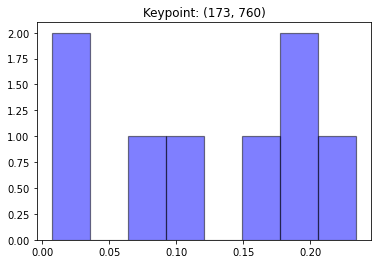

[0.19425042 0.19371292 0.16249132 0.23419529 0.09732176 0.02943941
 0.00710318 0.08148568]


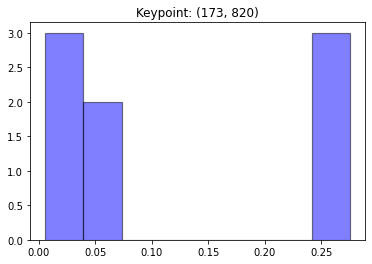

[0.00570226 0.01809285 0.03126786 0.06883814 0.27506725 0.27506725
 0.27506725 0.05089716]


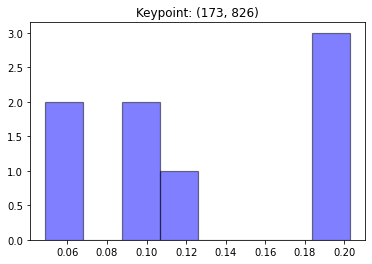

[0.04883451 0.08988563 0.19885021 0.11195033 0.08789914 0.19866141
 0.20274325 0.06117552]


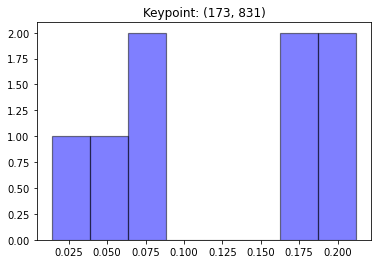

[0.08176907 0.21210506 0.21210506 0.18356145 0.17070371 0.07669745
 0.01396598 0.04909223]


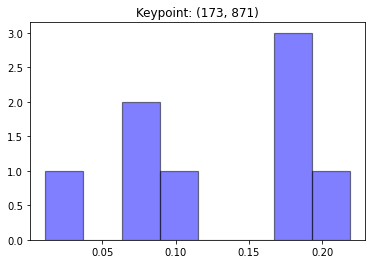

[0.0110485  0.17290763 0.17643927 0.06498885 0.11359305 0.21887848
 0.17421872 0.0679255 ]


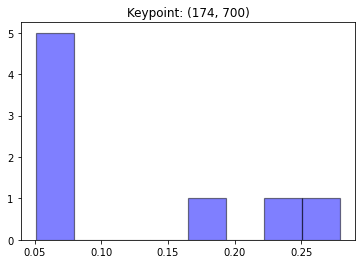

[0.05086104 0.06768114 0.07284062 0.05423806 0.05556728 0.2393745
 0.27900891 0.18042844]


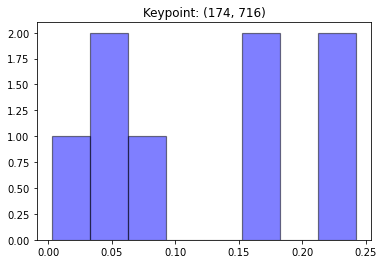

[0.07966328 0.16952567 0.05938435 0.05000683 0.00262464 0.15372455
 0.24253534 0.24253534]


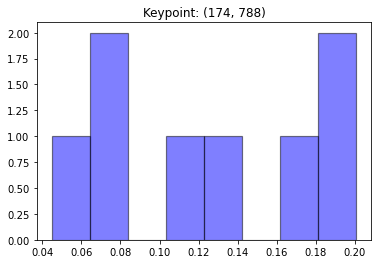

[0.07278182 0.04485418 0.06857022 0.18734159 0.20059357 0.17483943
 0.11184216 0.13917703]


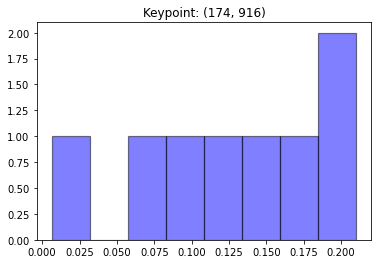

[0.05969562 0.21004503 0.17308953 0.00640719 0.13880486 0.18514972
 0.13011813 0.09668993]


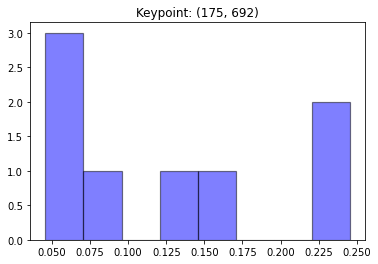

[0.04566252 0.05187412 0.06285704 0.07307301 0.12892699 0.24541599
 0.24541599 0.14677434]


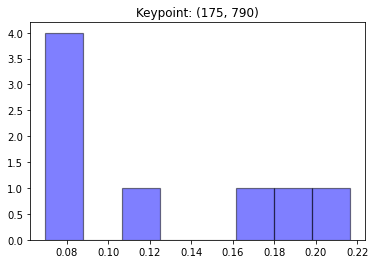

[0.06980593 0.07107854 0.07432939 0.18205851 0.21647752 0.17897964
 0.12167346 0.08559701]


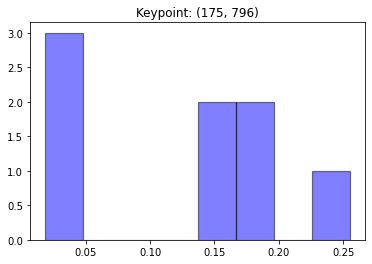

[0.04558004 0.15617534 0.14181875 0.18958261 0.25520728 0.16729246
 0.01865356 0.02568995]


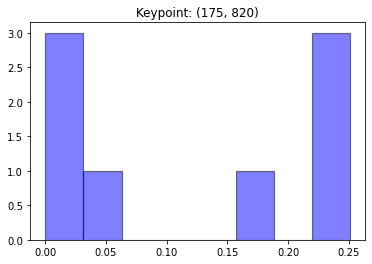

[1.92413694e-04 1.38857008e-02 3.38896663e-03 1.87270420e-01
 2.50662655e-01 2.50662655e-01 2.50662655e-01 4.32745337e-02]


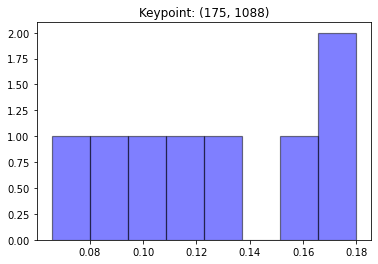

[0.11517331 0.12607836 0.17988886 0.06575362 0.09446103 0.1747462
 0.15698432 0.08691429]


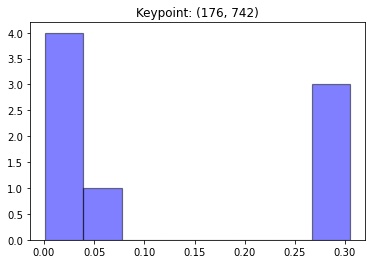

[0.00495663 0.00205835 0.00135908 0.03778142 0.30478941 0.30478941
 0.30478941 0.03947631]


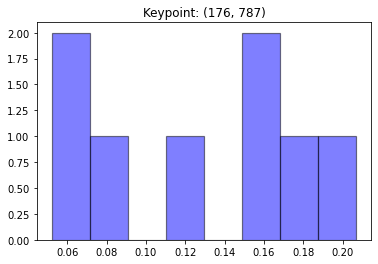

[0.07431969 0.05209078 0.05284743 0.16308336 0.12206633 0.1773353
 0.15136176 0.20689534]


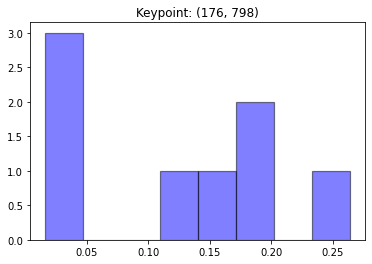

[0.03815827 0.15378876 0.18179272 0.18234558 0.26406601 0.13306001
 0.01628362 0.03050503]


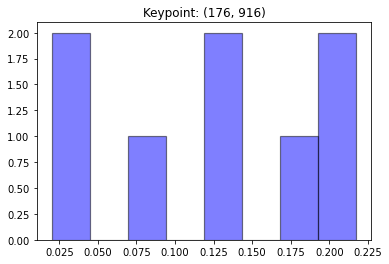

[0.04291701 0.21734169 0.21734169 0.02014016 0.11953834 0.17708901
 0.12051552 0.08511659]


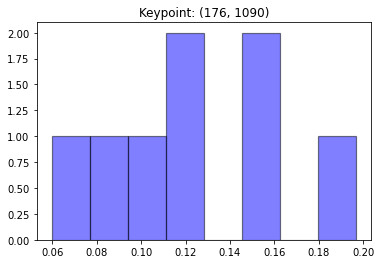

[0.12184963 0.15709061 0.15302513 0.05978111 0.09125742 0.1180993
 0.19681829 0.10207851]


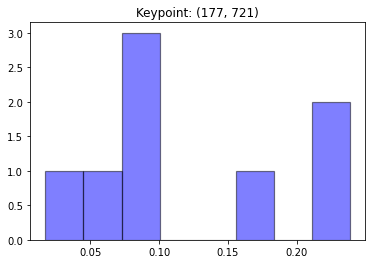

[0.07351771 0.17155401 0.09308787 0.23864313 0.23864313 0.0701937
 0.01722889 0.09713156]


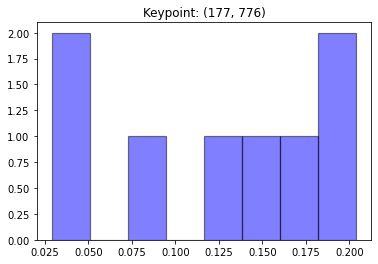

[0.20386233 0.20386233 0.04709205 0.12596514 0.16679052 0.14706692
 0.02897857 0.07638213]


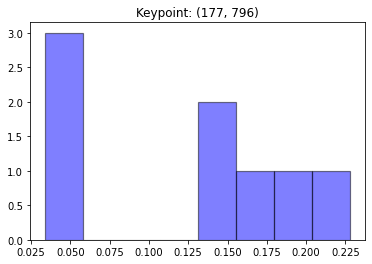

[0.05108415 0.14765791 0.13892248 0.17805322 0.22781281 0.1822244
 0.04015073 0.03409429]


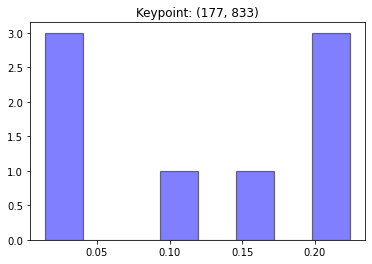

[0.03154973 0.15700855 0.22398053 0.22398053 0.22398053 0.09334695
 0.03158895 0.01456422]


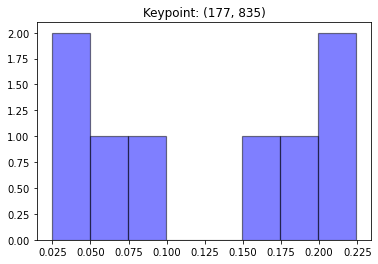

[0.0347558  0.16142671 0.18001765 0.22426611 0.22426611 0.09256365
 0.05802315 0.02468081]


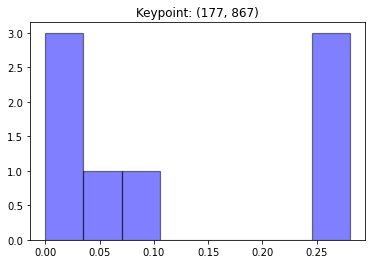

[0.06567961 0.00567862 0.00214445 0.         0.08516597 0.28044379
 0.28044379 0.28044379]


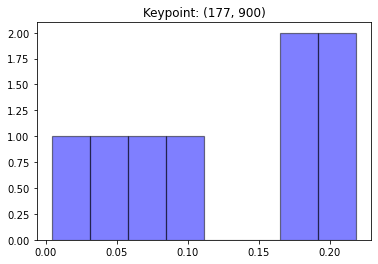

[0.21859528 0.17458536 0.1107075  0.18323754 0.20992188 0.06368714
 0.03509329 0.00417202]


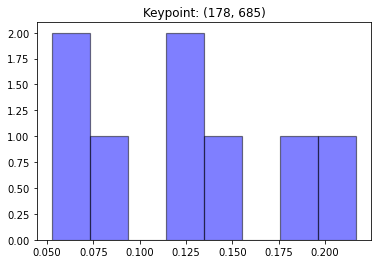

[0.13758387 0.08882737 0.06374721 0.05260508 0.12993095 0.18097
 0.21678601 0.12954952]


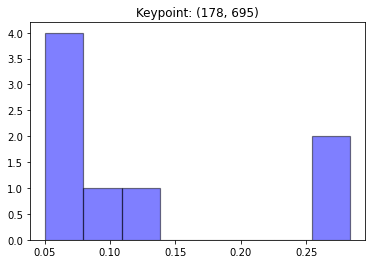

[0.05986743 0.06338305 0.06999853 0.05061238 0.11599017 0.09480356
 0.28340288 0.26194198]


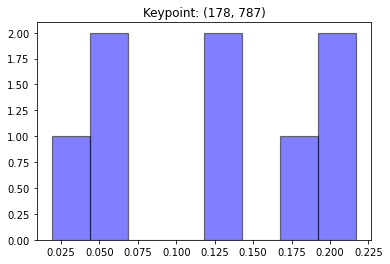

[0.04469808 0.05428329 0.01899856 0.12192631 0.13438355 0.21701453
 0.19168115 0.21701453]


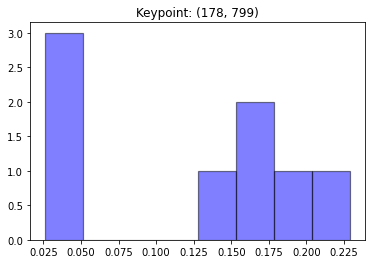

[0.03936452 0.13144116 0.19125667 0.16542097 0.22883629 0.17423346
 0.04313705 0.02630989]


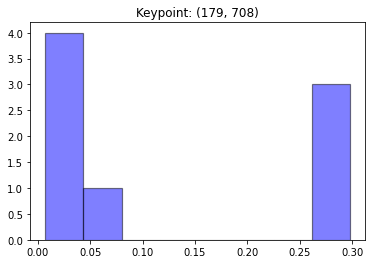

[0.03091241 0.01147021 0.00726323 0.01985619 0.06859862 0.29773236
 0.29773236 0.26643463]


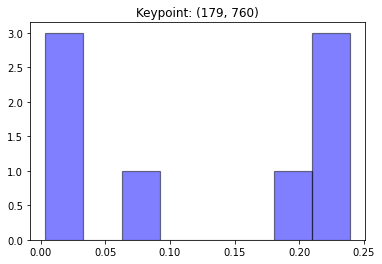

[0.003525   0.0042739  0.07608522 0.23914745 0.19389355 0.23914745
 0.23914745 0.00477999]


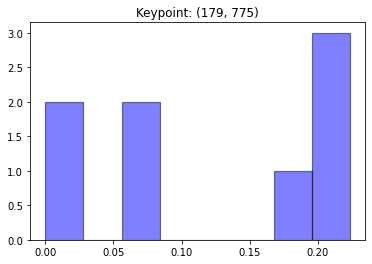

[2.23326651e-01 2.23326651e-01 7.35813559e-02 1.89236931e-01
 2.23326651e-01 9.52090955e-03 1.82393689e-04 5.74984556e-02]


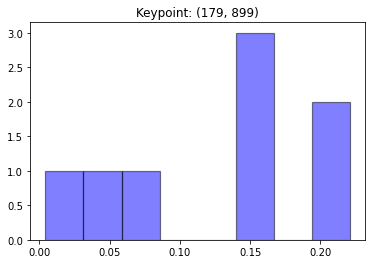

[0.22097753 0.14850059 0.14327548 0.21080468 0.16623956 0.04650903
 0.05943426 0.00425887]


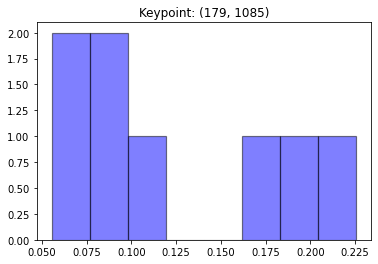

[0.1734746  0.1115888  0.08967638 0.05998602 0.05559651 0.08475357
 0.19941677 0.22550736]


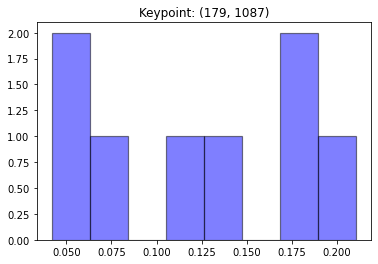

[0.18136879 0.11838272 0.13267917 0.06204467 0.04188606 0.0803357
 0.17257965 0.21072323]


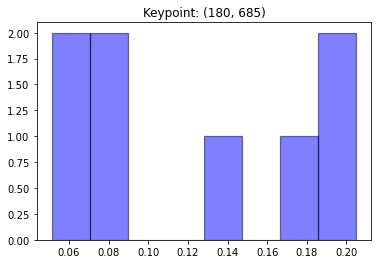

[0.17846509 0.08775646 0.0638734  0.05128417 0.07893214 0.12980151
 0.20494362 0.20494362]


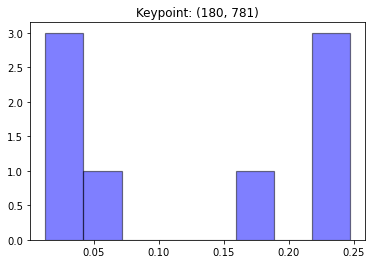

[0.24698205 0.21812451 0.01271189 0.02849697 0.01637866 0.04618645
 0.18413743 0.24698205]


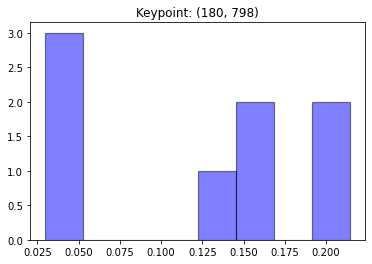

[0.03470776 0.1313152  0.15903977 0.16377926 0.21426965 0.21426965
 0.05274196 0.02987675]


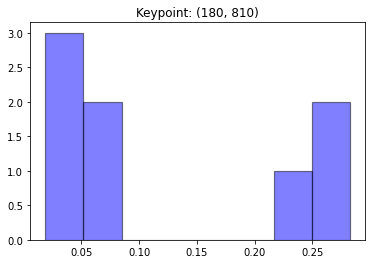

[0.02764211 0.02622577 0.01885577 0.06523554 0.28234894 0.25853689
 0.24114305 0.08001192]


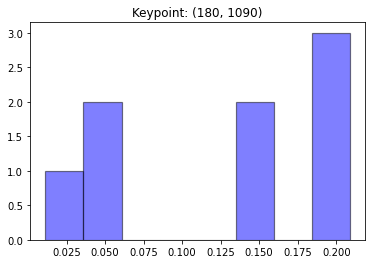

[0.20409676 0.20874854 0.14026703 0.05568532 0.01130827 0.03679857
 0.15893888 0.18415662]


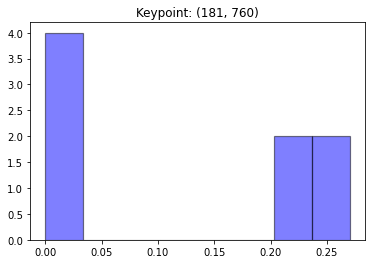

[8.79383783e-04 2.26111886e-04 1.04102821e-02 2.07264152e-01
 2.35401323e-01 2.70251055e-01 2.70251055e-01 5.31663633e-03]


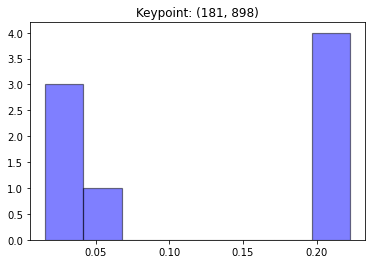

[0.22243487 0.21056279 0.2013511  0.22243487 0.06669519 0.03148009
 0.02918705 0.01585405]


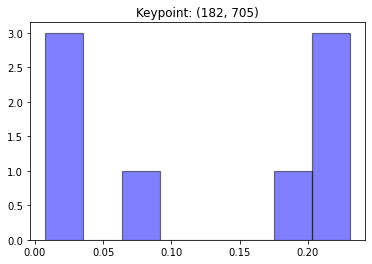

[0.08308542 0.0076698  0.03472381 0.01076684 0.18095875 0.23062422
 0.23062422 0.22154694]


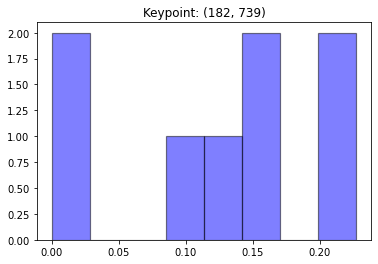

[0.16172236 0.09013032 0.1263577  0.22696518 0.22696518 0.16785927
 0.         0.        ]


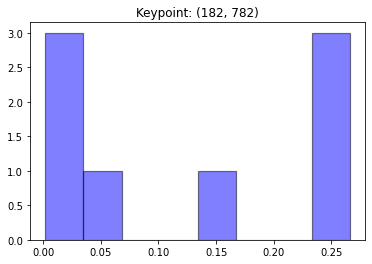

[0.26593587 0.13711207 0.01732427 0.00841638 0.00202282 0.03731684
 0.26593587 0.26593587]


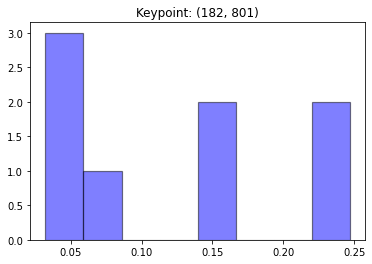

[0.03751932 0.0533296  0.16378575 0.15002443 0.24685194 0.24685194
 0.06938649 0.03225054]


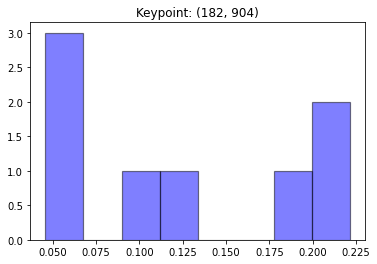

[0.22132555 0.18642629 0.10315932 0.0638106  0.20514651 0.11770764
 0.05660202 0.04582208]


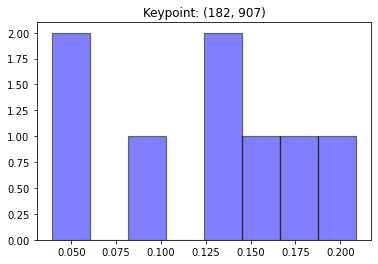

[0.162362   0.17409369 0.14364523 0.0818815  0.20882369 0.14171489
 0.04835781 0.0391212 ]


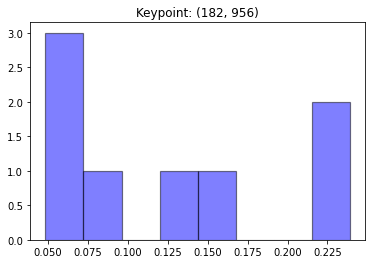

[0.05244766 0.04835098 0.23895694 0.15328984 0.08065598 0.06225558
 0.23895694 0.12508609]


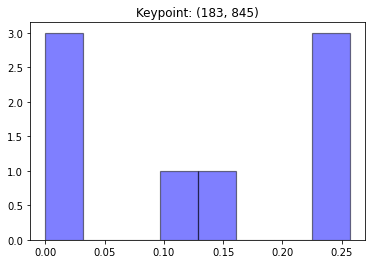

[0.25680388 0.12956529 0.00309793 0.         0.         0.09692514
 0.25680388 0.25680388]


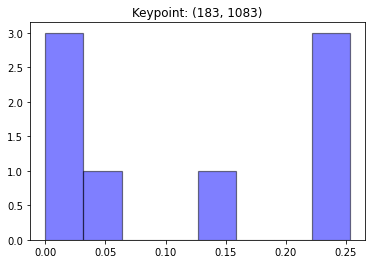

[0.14403593 0.04260301 0.03162317 0.0214312  0.         0.25343556
 0.25343556 0.25343556]


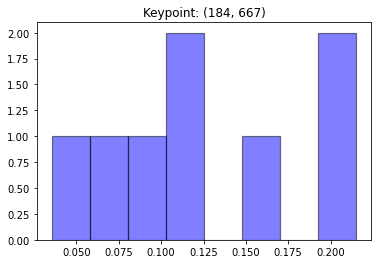

[0.10734289 0.0799973  0.10762386 0.20987963 0.21513213 0.08125218
 0.03542828 0.16334374]


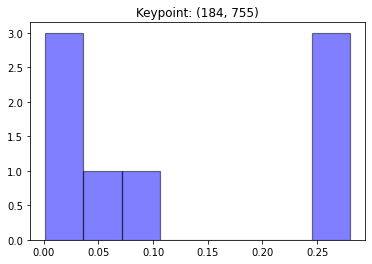

[0.10024347 0.01651663 0.00148776 0.0020369  0.04208447 0.27780487
 0.27991295 0.27991295]


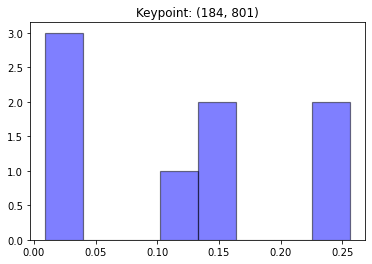

[0.02480864 0.00937745 0.15943278 0.15555093 0.2560726  0.2560726
 0.10380941 0.0348756 ]


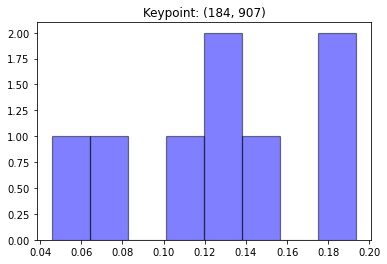

[0.12606473 0.18254911 0.13377057 0.11309462 0.19355724 0.14013538
 0.06514017 0.04568817]


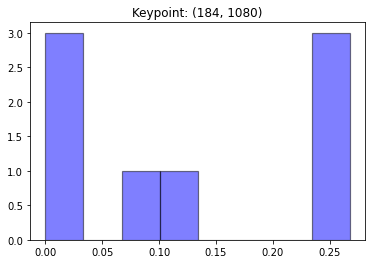

[0.11163132 0.01811151 0.         0.02238096 0.0684609  0.26758707
 0.26758707 0.24424119]


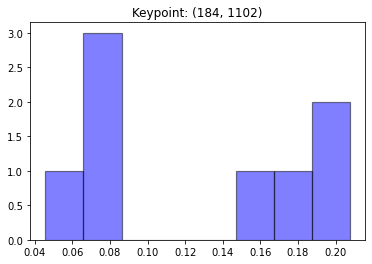

[0.20755205 0.17019752 0.19269793 0.15282705 0.08566753 0.06654944
 0.04567332 0.07883516]


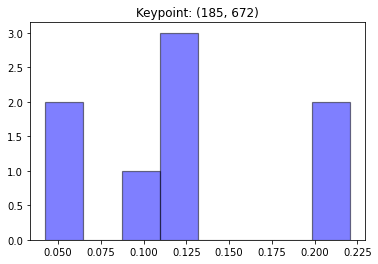

[0.12407921 0.06382789 0.04266049 0.11475661 0.12516562 0.22054297
 0.09315545 0.21581176]


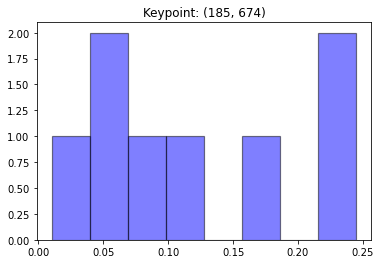

[0.11474039 0.01049953 0.0618913  0.04984167 0.09660608 0.24471477
 0.17699149 0.24471477]


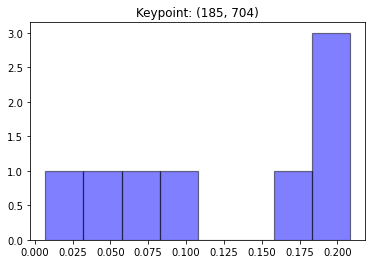

[0.06319209 0.00708797 0.04263798 0.09280199 0.20813132 0.20813132
 0.20084745 0.17716987]


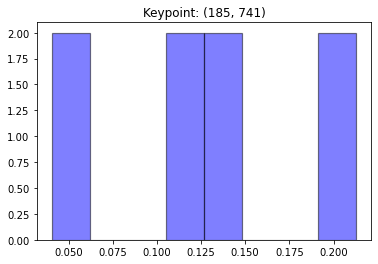

[0.21280766 0.10756997 0.14684831 0.21280766 0.1287414  0.04241857
 0.0405386  0.10826783]


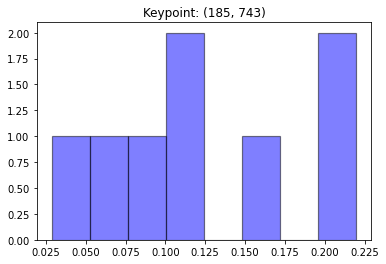

[0.219707   0.11131966 0.12296221 0.20370642 0.09989504 0.02875794
 0.05515149 0.15850023]


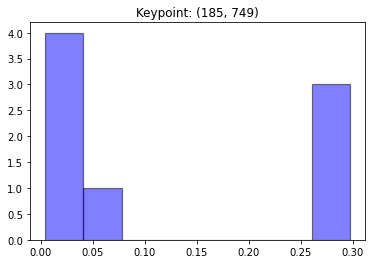

[0.29724704 0.07577548 0.0051212  0.01378669 0.00441711 0.00915841
 0.29724704 0.29724704]


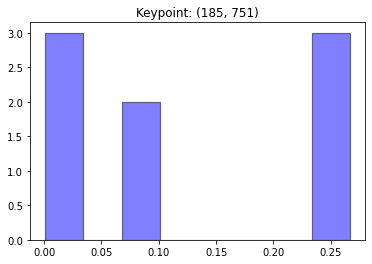

[0.26659222 0.08376569 0.00109519 0.00866351 0.0095565  0.09714246
 0.26659222 0.26659222]


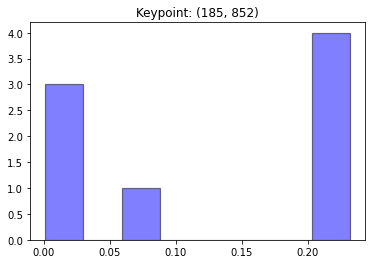

[0.23167469 0.23167469 0.2294711  0.23167469 0.06966652 0.00163098
 0.0010524  0.00315493]


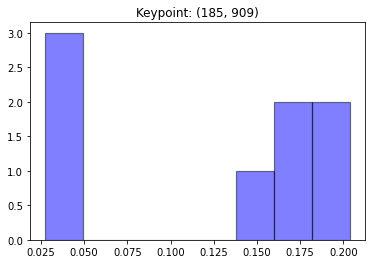

[0.04683932 0.16377354 0.20377364 0.19811502 0.16687328 0.14440255
 0.04862936 0.02759328]


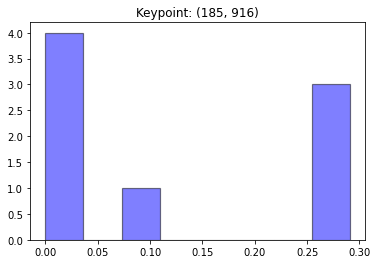

[0.09114129 0.29074877 0.29074877 0.29074877 0.01737956 0.00928755
 0.         0.00994529]


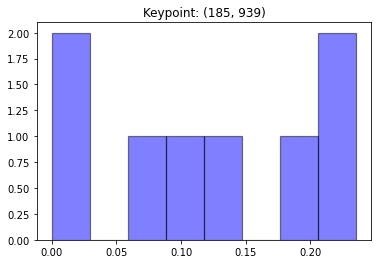

[0.13987808 0.07378326 0.         0.02429155 0.23535244 0.18572849
 0.10561373 0.23535244]


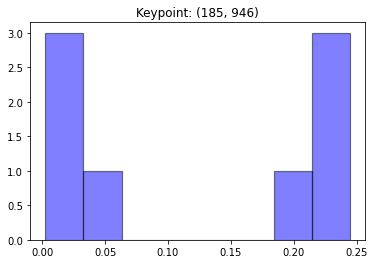

[0.24463981 0.24463981 0.24463981 0.03551813 0.00643115 0.00248809
 0.02683699 0.1948062 ]


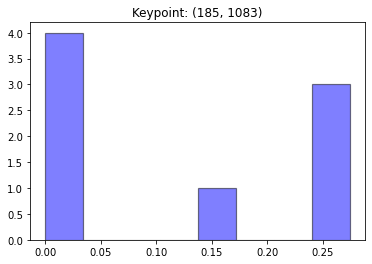

[0.14176888 0.02065268 0.         0.00333743 0.01081438 0.27447555
 0.27447555 0.27447555]


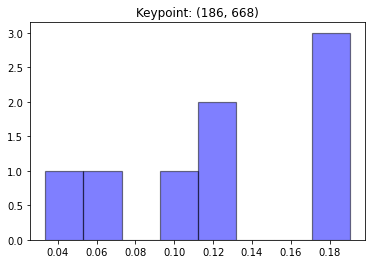

[0.13055452 0.07227709 0.09439834 0.19030359 0.18080452 0.11648446
 0.03365034 0.18152714]


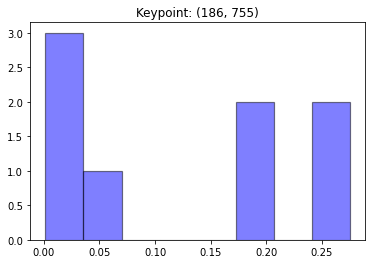

[0.20313281 0.05271382 0.00138599 0.00189756 0.00926772 0.18161666
 0.27499272 0.27499272]


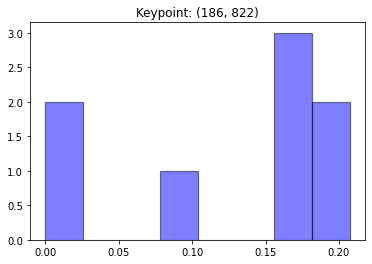

[0.16127555 0.17409103 0.19480274 0.20734979 0.         0.00064225
 0.08464324 0.1771954 ]


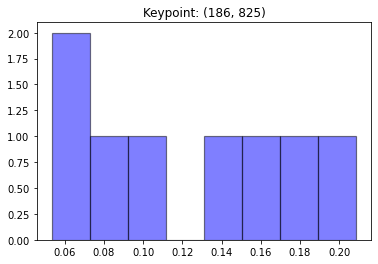

[0.20863762 0.14020463 0.10357696 0.15135141 0.05333187 0.07215805
 0.08831493 0.18242454]


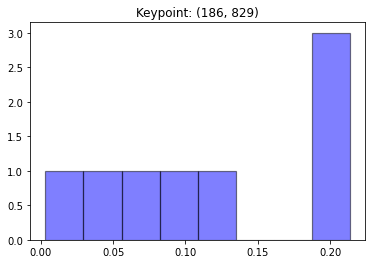

[0.21362623 0.12519831 0.00322663 0.04465277 0.21362623 0.21362623
 0.07894273 0.10710086]


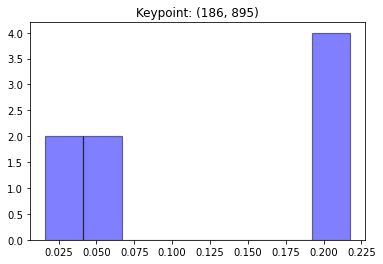

[0.21726704 0.21726704 0.21726704 0.21726704 0.01628296 0.04448093
 0.02345114 0.04671682]


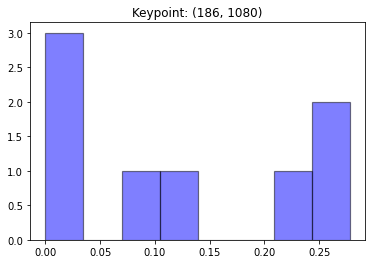

[0.11695496 0.01897524 0.         0.00237378 0.0936244  0.27800529
 0.27800529 0.21206105]


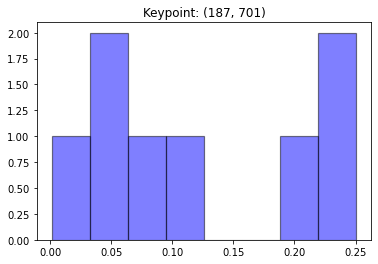

[0.06938072 0.00137912 0.05300867 0.10363984 0.25045852 0.25045852
 0.2151113  0.05656332]


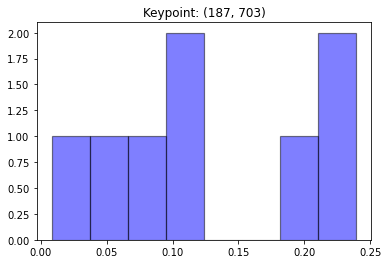

[0.07679881 0.00844817 0.04331877 0.10033457 0.23922847 0.23922847
 0.18748005 0.10516269]


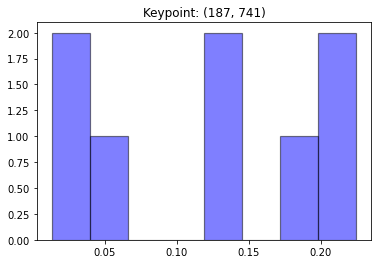

[0.22475864 0.13480177 0.19201438 0.22475864 0.02127457 0.0132055
 0.04960728 0.13957923]


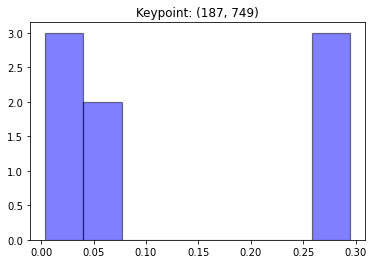

[0.29418768 0.06101195 0.00411092 0.00840665 0.01217645 0.04425265
 0.28166601 0.29418768]


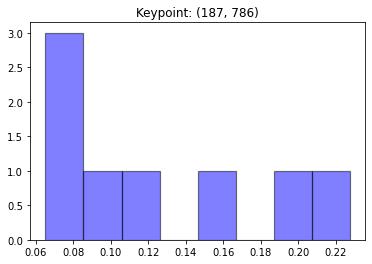

[0.09960609 0.06888066 0.06514656 0.15652228 0.18773828 0.1247678
 0.22733423 0.07000411]


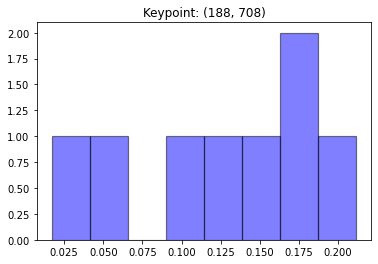

[0.10406241 0.01709134 0.16969515 0.21145212 0.16402129 0.13319695
 0.04986828 0.15061247]


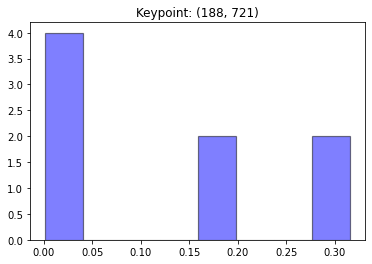

[0.01156905 0.00180078 0.17990466 0.31556431 0.31556431 0.16313631
 0.00594425 0.00651633]


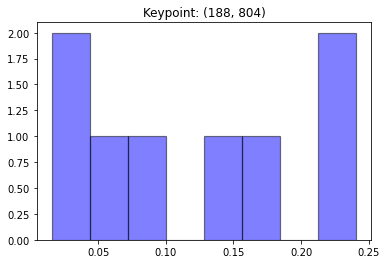

[0.03397518 0.01577946 0.15486718 0.08287959 0.24070395 0.24070395
 0.17751543 0.05357527]


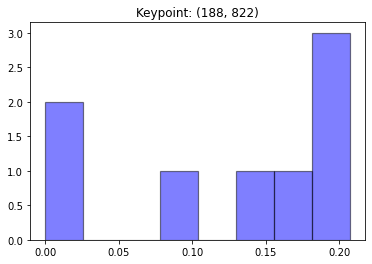

[0.18137902 0.20728582 0.178405   0.14902225 0.         0.00113842
 0.09145854 0.19131096]


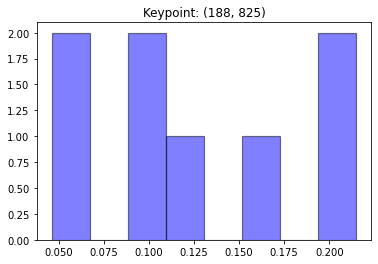

[0.21485614 0.16919576 0.11252381 0.09371113 0.04619821 0.06321446
 0.09732826 0.20297222]


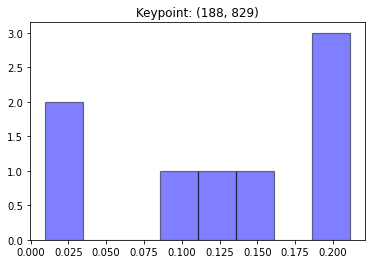

[0.21115499 0.15031254 0.01809658 0.0098284  0.19128547 0.20476928
 0.08602433 0.12852842]


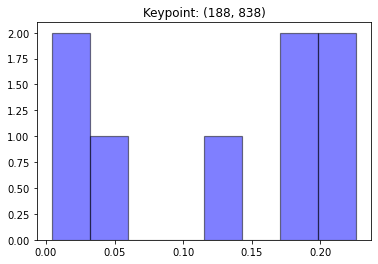

[0.00424752 0.01902362 0.05568983 0.22611796 0.17421726 0.17192259
 0.22611796 0.12266326]


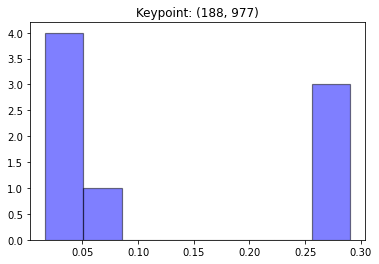

[0.27019529 0.29012058 0.29012058 0.02417556 0.03770024 0.05390871
 0.01700172 0.01677733]


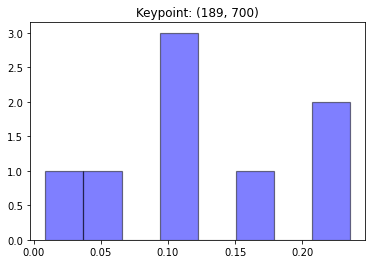

[0.10741886 0.00870361 0.05279946 0.10507856 0.23540219 0.23540219
 0.15473891 0.10045623]


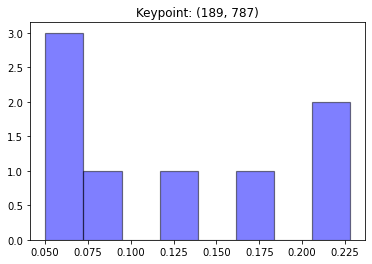

[0.08132468 0.05365145 0.0614904  0.16471537 0.2277979  0.13299483
 0.2277979  0.05022746]


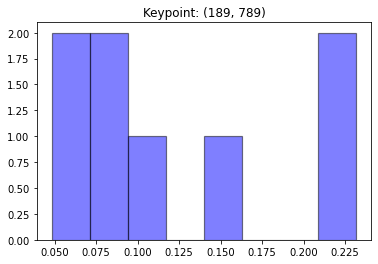

[0.08852791 0.06309252 0.09350644 0.2316498  0.2316498  0.1454657
 0.09781054 0.0482973 ]


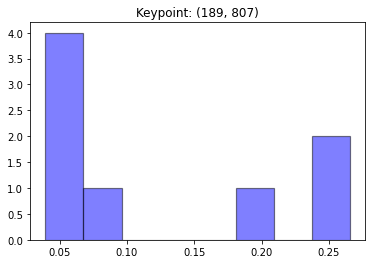

[0.06713132 0.03934586 0.18607687 0.07535459 0.26555861 0.26555861
 0.04920543 0.0517687 ]


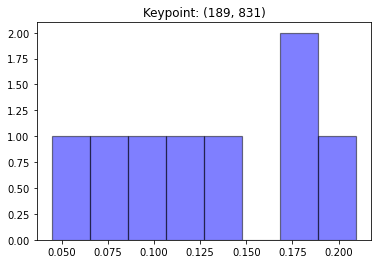

[0.17663501 0.12838878 0.06820381 0.114411   0.20949172 0.172114
 0.04470557 0.08605013]


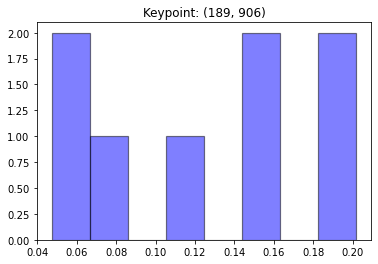

[0.12240983 0.19282086 0.20178919 0.08453303 0.15200345 0.15053173
 0.04863845 0.04727346]


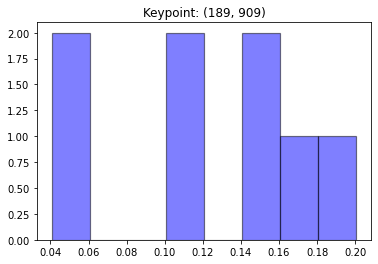

[0.11598746 0.16504158 0.20050103 0.11749618 0.14611092 0.15626726
 0.04068051 0.05791506]


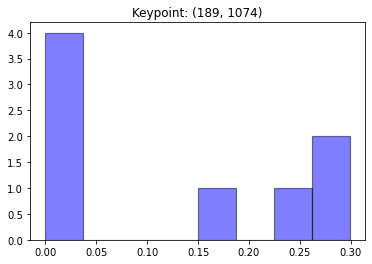

[0.01299333 0.         0.         0.         0.15113327 0.2989334
 0.2989334  0.23800659]


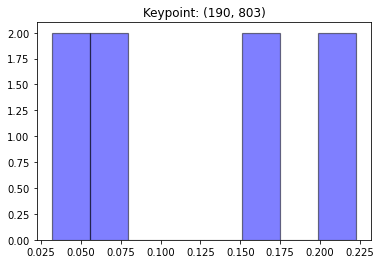

[0.05609767 0.03175613 0.17344599 0.04914909 0.1748628  0.22263864
 0.22263864 0.06941105]


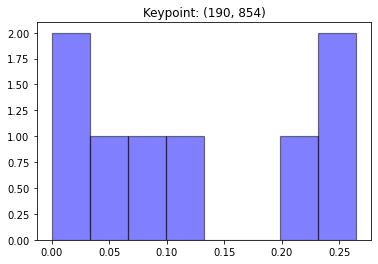

[0.         0.07626249 0.2207398  0.26461982 0.26461982 0.13151466
 0.04224341 0.        ]


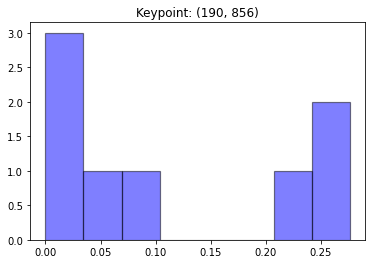

[0.         0.03198663 0.24124629 0.27617078 0.27617078 0.10330681
 0.06215467 0.00896405]


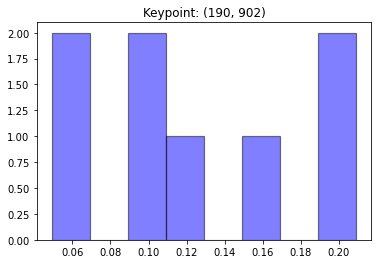

[0.09392805 0.20902039 0.20902039 0.12017028 0.10305834 0.15982295
 0.05579756 0.04918205]


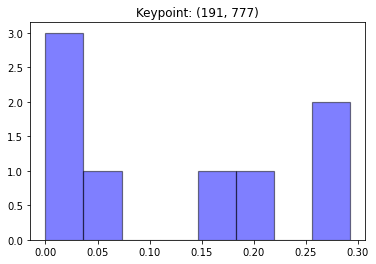

[0.00179313 0.003038   0.         0.05242642 0.29210829 0.19080257
 0.29210829 0.16772329]


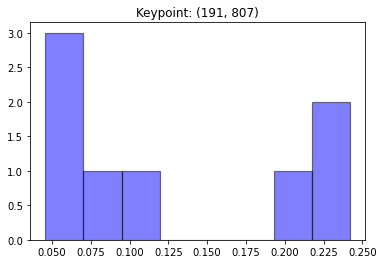

[0.09592042 0.04995634 0.19607857 0.04580796 0.24192755 0.24192755
 0.07290335 0.05547825]


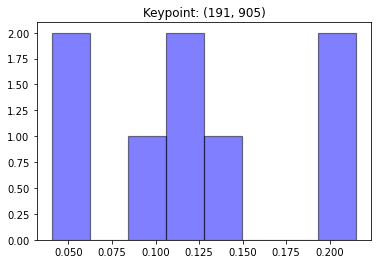

[0.11149276 0.21527654 0.21527654 0.13137714 0.09818747 0.12732156
 0.06064874 0.04041926]


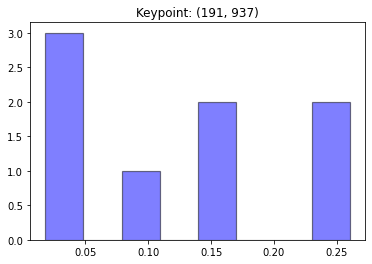

[0.01813026 0.09911015 0.26040057 0.16274198 0.25354122 0.14904158
 0.03231688 0.02471736]


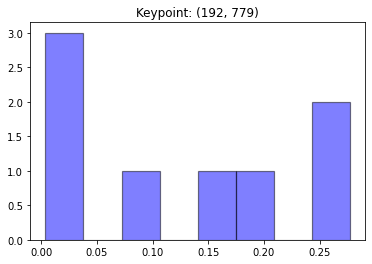

[0.00594626 0.00361958 0.00532904 0.09996904 0.27720358 0.18072768
 0.27720358 0.15000124]


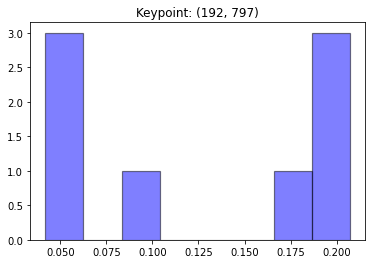

[0.05861769 0.04193066 0.09219884 0.18750506 0.19408837 0.16936439
 0.20713993 0.04915506]


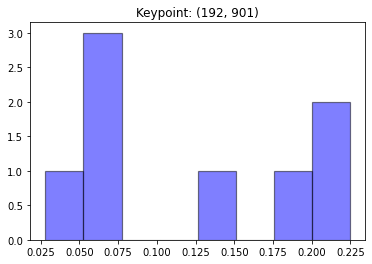

[0.07567526 0.22460025 0.22460025 0.19097728 0.0280363  0.13834932
 0.05628054 0.06148078]


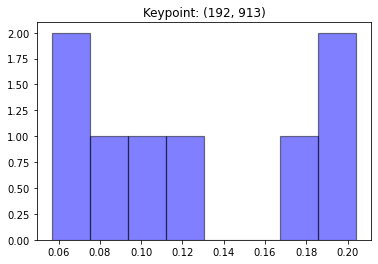

[0.20411309 0.20290385 0.18073178 0.05845772 0.05674295 0.0950403
 0.12353016 0.07848017]


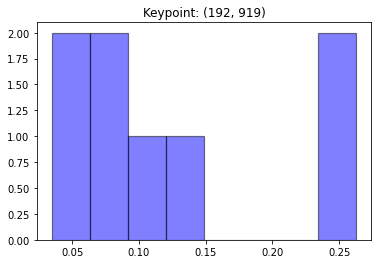

[0.07035457 0.26280336 0.26280336 0.07432687 0.04175899 0.10532152
 0.14796824 0.03466308]


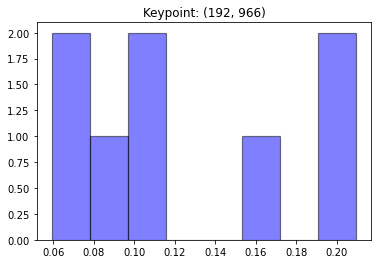

[0.19587182 0.20962465 0.07349335 0.16623406 0.05933846 0.09048326
 0.09775182 0.10720258]


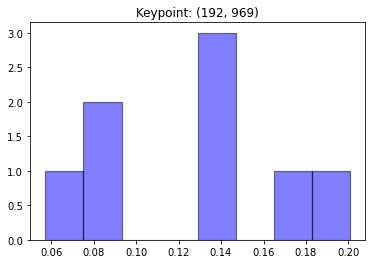

[0.20061312 0.08203206 0.05729605 0.16961427 0.08838956 0.13883324
 0.1305002  0.13272149]


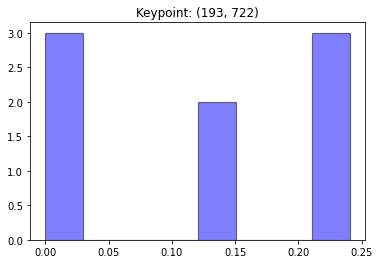

[0.         0.         0.13749511 0.24057308 0.24057308 0.24057308
 0.12129582 0.01948984]


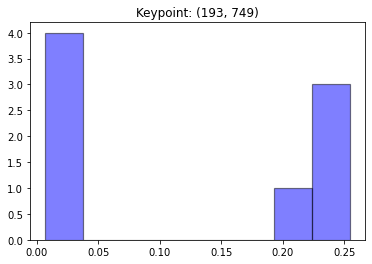

[0.19392263 0.01801462 0.00688659 0.00904934 0.01053554 0.25435402
 0.25288322 0.25435402]


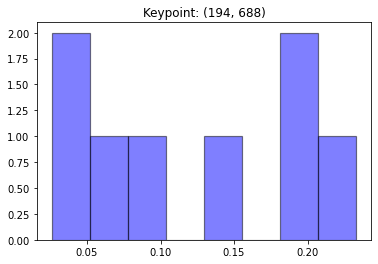

[0.09570593 0.02603626 0.06161427 0.04090924 0.13074265 0.23310223
 0.20671662 0.2051728 ]


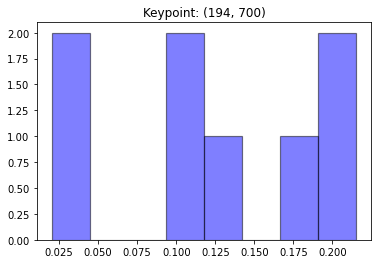

[0.04302419 0.02030575 0.13303787 0.2131921  0.21515698 0.18241917
 0.0964274  0.09643655]


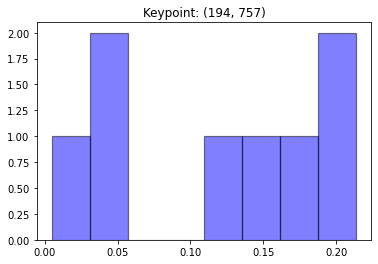

[0.17967834 0.15733905 0.0491033  0.12785995 0.21372654 0.05377012
 0.00479616 0.21372654]


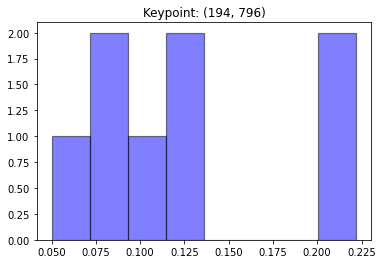

[0.07959761 0.05014    0.10946974 0.22103092 0.12485116 0.11822276
 0.22197982 0.074708  ]


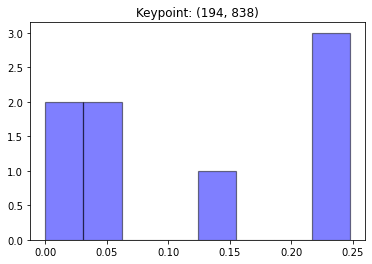

[0.06124778 0.24778172 0.24778172 0.24778172 0.14373856 0.0402024
 0.01146611 0.        ]


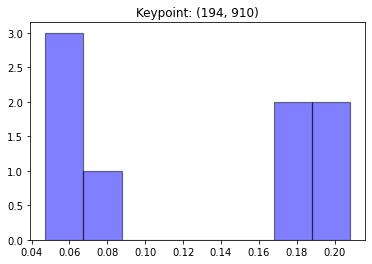

[0.20803511 0.17653786 0.17531011 0.20803511 0.04731226 0.05441287
 0.05961596 0.07074071]


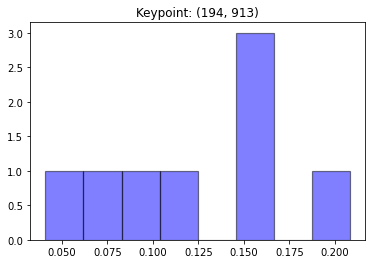

[0.20815825 0.1583435  0.16242583 0.06436712 0.04098393 0.12097702
 0.14848484 0.0962595 ]


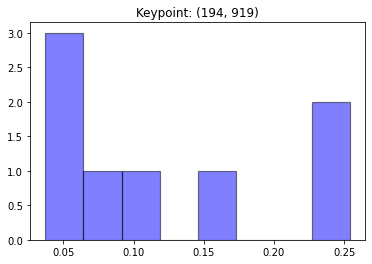

[0.06200413 0.25399779 0.25399779 0.07130475 0.03717234 0.11796599
 0.16255739 0.04099982]


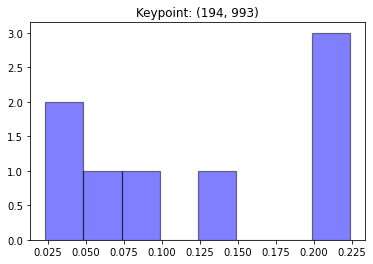

[0.22358593 0.02359586 0.02945577 0.22358593 0.1345863  0.06200788
 0.09163325 0.21154906]


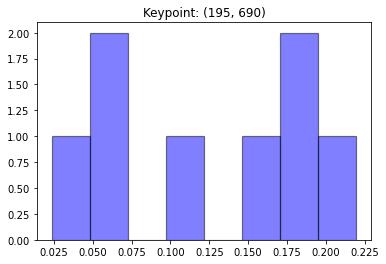

[0.10330624 0.02359977 0.06390796 0.06594786 0.18147845 0.21953551
 0.15809806 0.18412614]


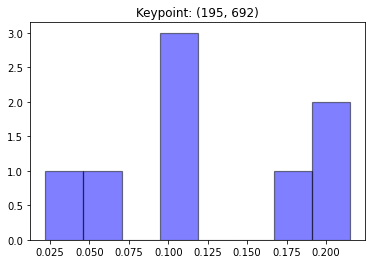

[0.09944852 0.02205664 0.06924368 0.10767532 0.2150641  0.2150641
 0.10133164 0.17011599]


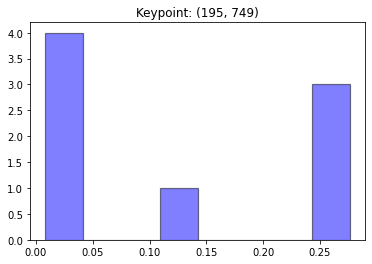

[0.13542678 0.00835475 0.00830307 0.01231416 0.0142779  0.27636012
 0.26860309 0.27636012]


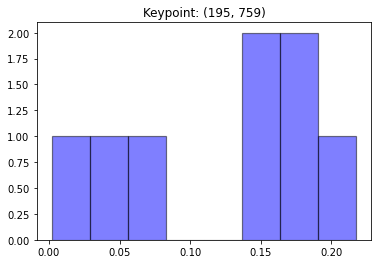

[0.17867719 0.15459863 0.0545078  0.14189787 0.21747969 0.17266936
 0.00197854 0.07819092]


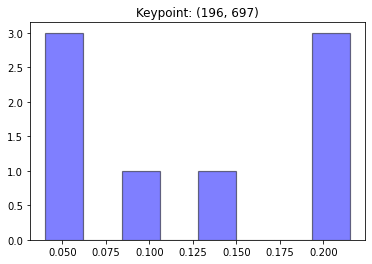

[0.04664528 0.04030562 0.13716336 0.21035762 0.21516178 0.21516178
 0.08509527 0.05010929]


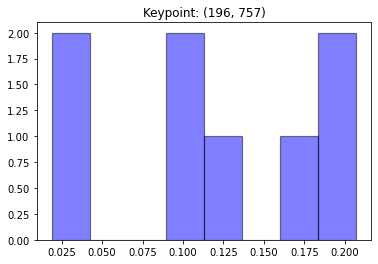

[0.12899678 0.11182975 0.0421336  0.11016855 0.20707688 0.20566541
 0.01887483 0.1752542 ]


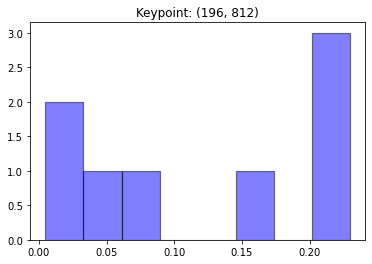

[0.22973102 0.05708262 0.02539463 0.0047215  0.22973102 0.22370024
 0.07154502 0.15809394]


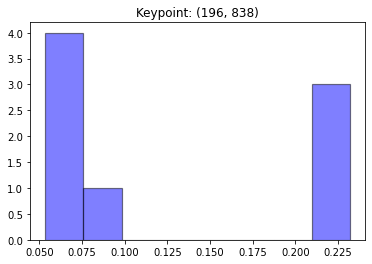

[0.05777504 0.23186191 0.23186191 0.21373584 0.08005421 0.07472769
 0.05642941 0.053554  ]


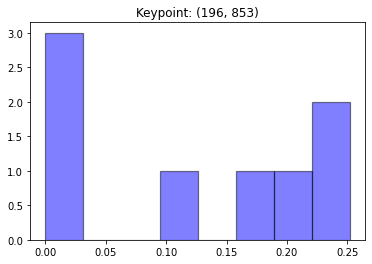

[0.01676818 0.         0.         0.1106904  0.25209581 0.25209581
 0.16852375 0.19982605]


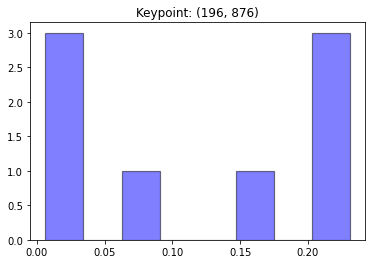

[0.00619884 0.01964562 0.0772746  0.23101272 0.23101272 0.23101272
 0.17348491 0.03035789]


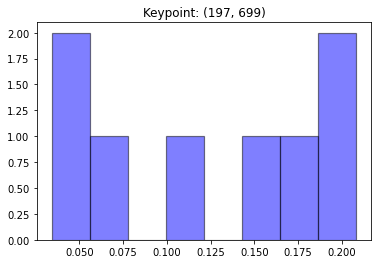

[0.0375721  0.0341607  0.16115678 0.20816026 0.2075931  0.17737308
 0.10427448 0.06970951]


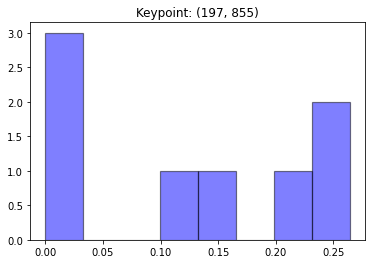

[0.         0.         0.0027832  0.14626919 0.26430473 0.26430473
 0.20880089 0.11353725]


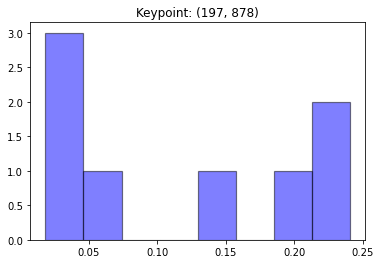

[0.03121891 0.01814964 0.0639716  0.24069627 0.24069627 0.20352794
 0.15666864 0.04507071]


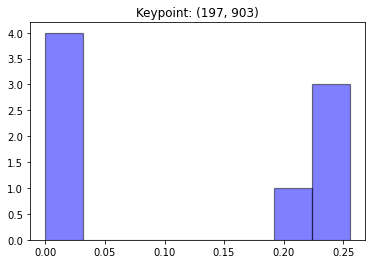

[0.02213742 0.25059086 0.25557476 0.25557476 0.19467655 0.00590778
 0.         0.01553788]


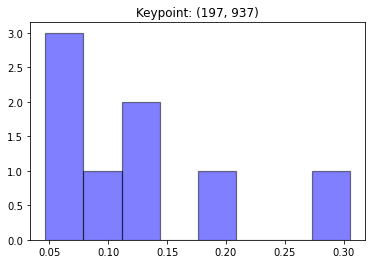

[0.08169274 0.13064636 0.30494387 0.19995675 0.12506807 0.05638953
 0.04683386 0.05446883]


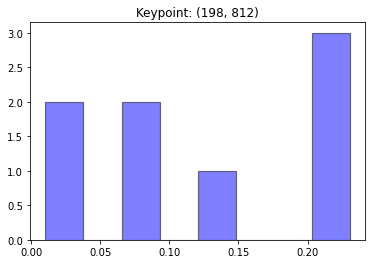

[0.22336406 0.03366356 0.01030379 0.07199112 0.23057844 0.21928093
 0.06715581 0.14366229]


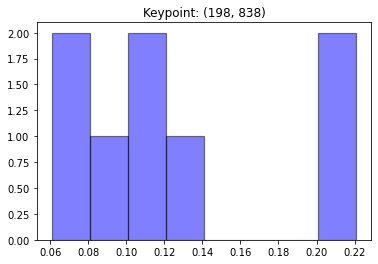

[0.09051736 0.22081185 0.22081185 0.10323046 0.0608911  0.1217966
 0.1046769  0.07726387]


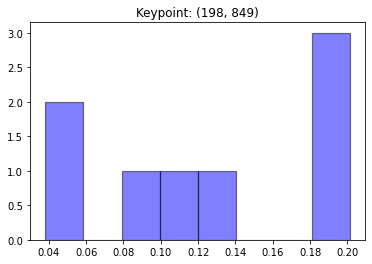

[0.19521501 0.03817693 0.09455887 0.05386388 0.10472829 0.20123709
 0.12895897 0.18326096]


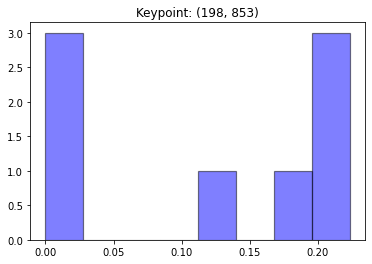

[0.01644526 0.         0.01815274 0.12430827 0.22347056 0.22347056
 0.18295338 0.21119923]


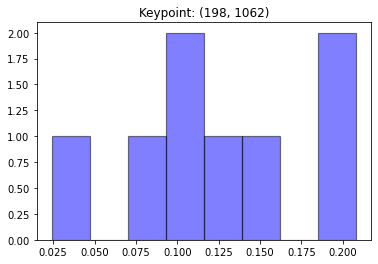

[0.10163213 0.20803097 0.14741456 0.07278392 0.02412574 0.13632955
 0.20803097 0.10165216]


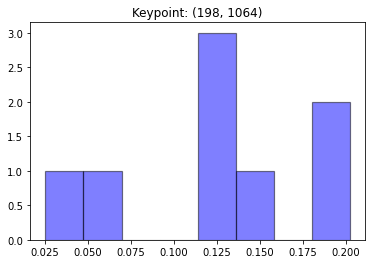

[0.14549467 0.20239738 0.11770098 0.05830124 0.02539907 0.13145813
 0.20171081 0.11753771]


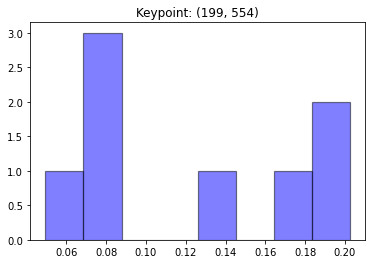

[0.04942773 0.07689118 0.16749342 0.14349463 0.20239405 0.1970602
 0.08608447 0.07715432]


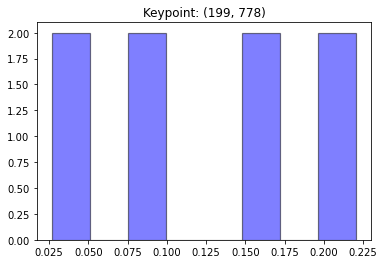

[0.08365859 0.02731875 0.02668097 0.16051254 0.22059829 0.09486498
 0.22059829 0.16576759]


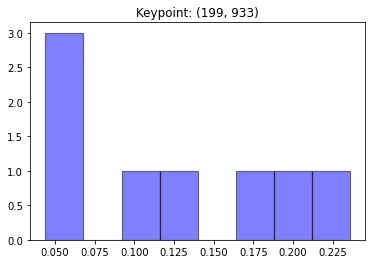

[0.12623088 0.2357962  0.1938949  0.18416369 0.11557038 0.04969442
 0.04382323 0.05082629]


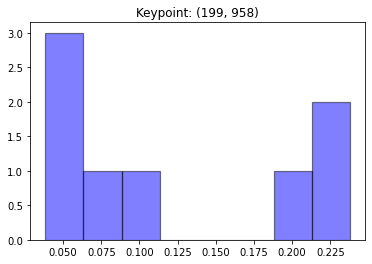

[0.09287959 0.19910935 0.23779744 0.06135508 0.0852425  0.03837481
 0.0474438  0.23779744]


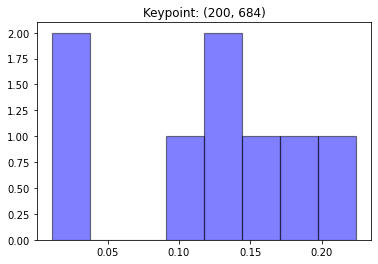

[0.16939067 0.13817048 0.03572486 0.01082776 0.09914849 0.22408885
 0.18872262 0.13392626]


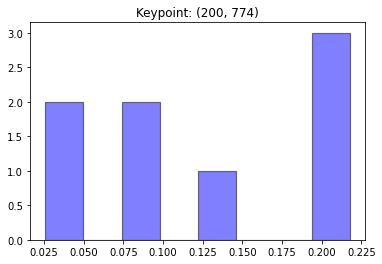

[0.07816897 0.03971661 0.02589107 0.19866759 0.21776963 0.12606471
 0.21776963 0.0959518 ]


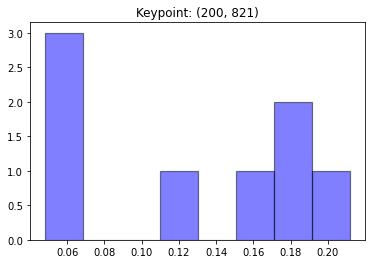

[0.1202117  0.18271361 0.16424332 0.21175312 0.17213556 0.05231458
 0.0482988  0.04832932]


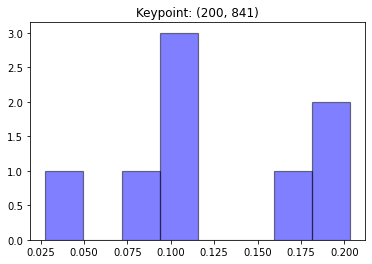

[0.20148768 0.20314726 0.17456084 0.02774947 0.10231639 0.11044521
 0.09519465 0.08509851]


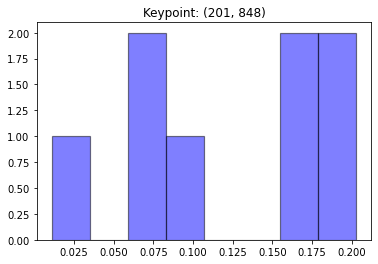

[0.20282123 0.0773436  0.20282123 0.09556469 0.01105418 0.16267036
 0.08170295 0.16602176]


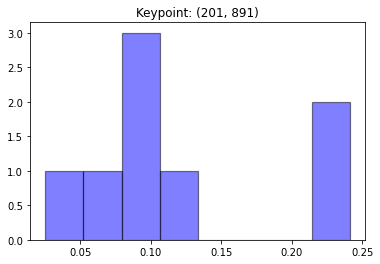

[0.07219645 0.02529282 0.12586731 0.24117886 0.1042286  0.24117886
 0.09680738 0.09324971]


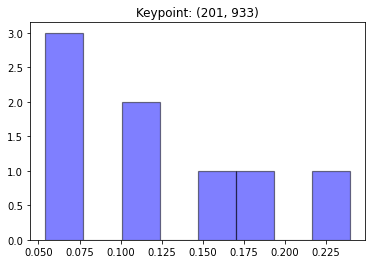

[0.16444012 0.23956036 0.10344812 0.184891   0.11830601 0.06258872
 0.05423182 0.07253384]


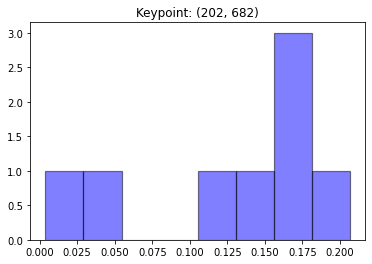

[0.15730955 0.16312167 0.0334709  0.00382092 0.14504963 0.20653021
 0.177222   0.11347512]


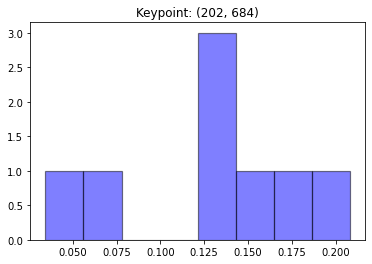

[0.14641443 0.17093525 0.05702114 0.03446035 0.13199595 0.20796163
 0.12989836 0.12131289]


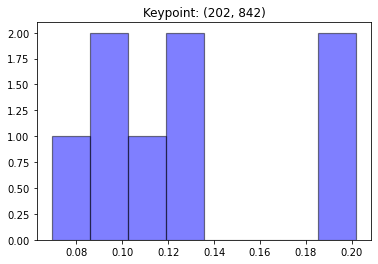

[0.20188533 0.12584175 0.18647869 0.12348974 0.06931843 0.11569774
 0.09065267 0.08663564]


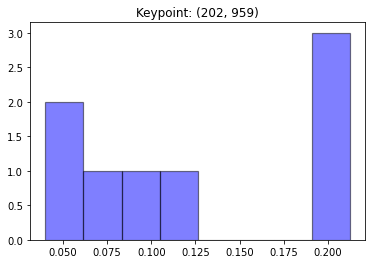

[0.1105854  0.07465972 0.209534   0.10042909 0.20827302 0.04011907
 0.04409105 0.21230864]


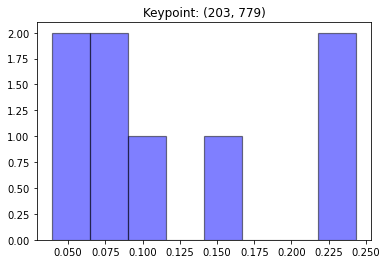

[0.09859855 0.05853079 0.03903454 0.2434247  0.07948797 0.08243439
 0.2434247  0.15506436]


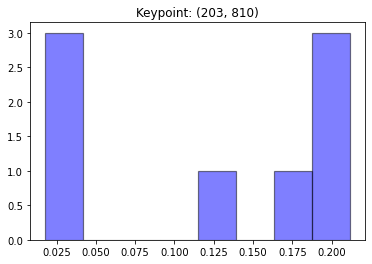

[0.01794034 0.21147686 0.17465752 0.19622702 0.21147686 0.13835119
 0.02178843 0.0280818 ]


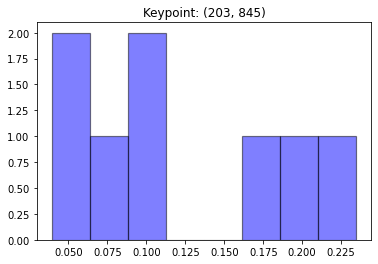

[0.19390601 0.07253994 0.23459732 0.10989633 0.03929313 0.10890226
 0.06318584 0.17767917]


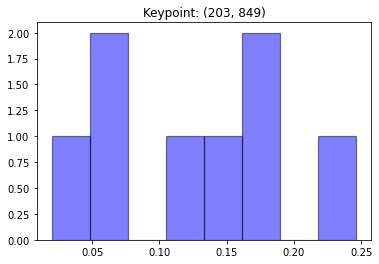

[0.17118972 0.05900008 0.24629632 0.12656653 0.01991369 0.13532778
 0.06600092 0.17570496]


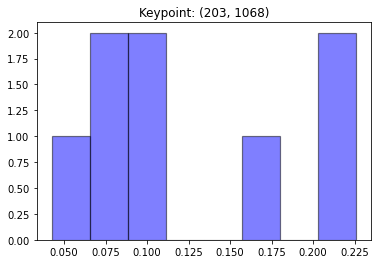

[0.22585727 0.22585727 0.17883525 0.08967931 0.07046127 0.08940397
 0.07727794 0.04262773]


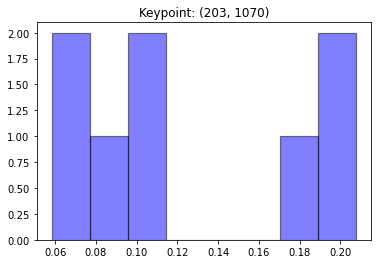

[0.20298339 0.20782544 0.17317332 0.07793246 0.10649271 0.1039436
 0.06936631 0.05828277]


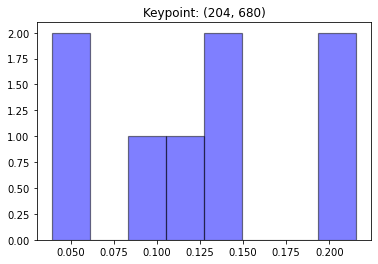

[0.13028482 0.10970664 0.03874929 0.05796747 0.21562889 0.21439464
 0.14045746 0.09281078]


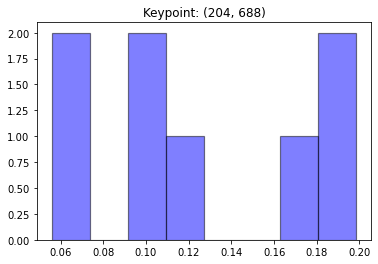

[0.10530221 0.17282942 0.10526038 0.06132525 0.1908857  0.19845169
 0.11011086 0.05583449]


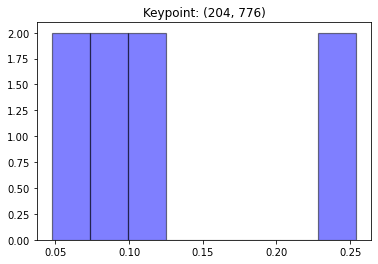

[0.09284423 0.05153511 0.04756743 0.25407257 0.08148064 0.11416765
 0.25407257 0.1042598 ]


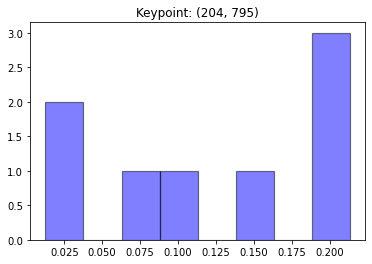

[0.06445347 0.01256875 0.03756704 0.21313415 0.21313415 0.10276882
 0.19816762 0.15820601]


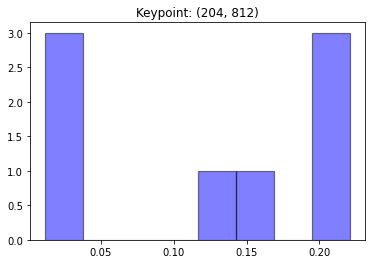

[0.0251781  0.22087382 0.22087382 0.15324378 0.21289495 0.14207266
 0.01286435 0.01199852]


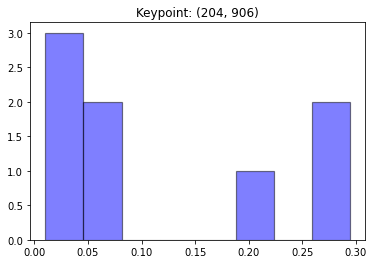

[0.08059057 0.03260984 0.21160152 0.29432179 0.29432179 0.01026209
 0.02047705 0.05581536]


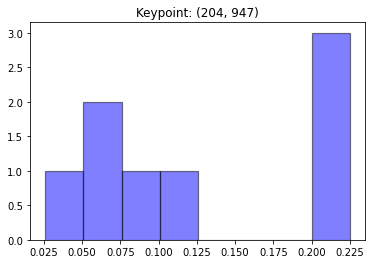

[0.05917518 0.22484438 0.20762603 0.10217218 0.09685357 0.05843687
 0.02604742 0.22484438]


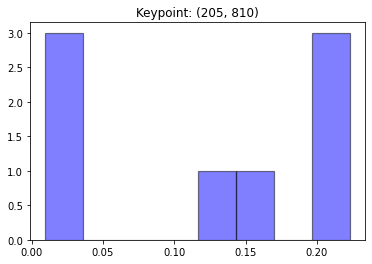

[0.01896571 0.22312698 0.22312698 0.22312698 0.16705483 0.12509355
 0.00987947 0.00962551]


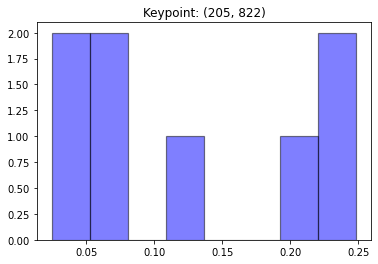

[0.02464927 0.24847237 0.11569896 0.24847237 0.20968033 0.0686286
 0.05761622 0.02678188]


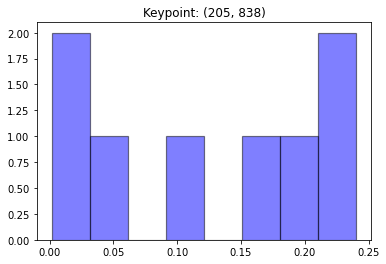

[0.05443661 0.00165939 0.0256983  0.24026176 0.24026176 0.18646698
 0.15112472 0.10009049]


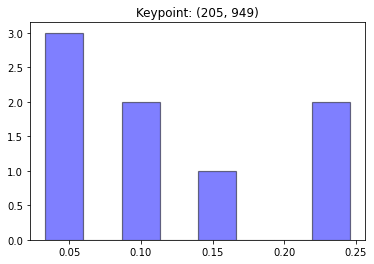

[0.05412939 0.24565644 0.15778189 0.10474184 0.10302301 0.05566366
 0.03334734 0.24565644]


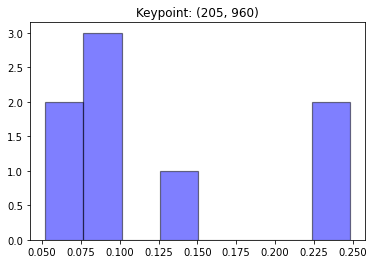

[0.13024163 0.06302116 0.09518974 0.07845044 0.24811692 0.08473226
 0.05213094 0.24811692]


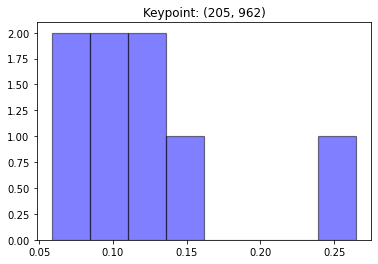

[0.12190599 0.07604615 0.11984627 0.09766223 0.2648734  0.10090015
 0.05854039 0.16022541]


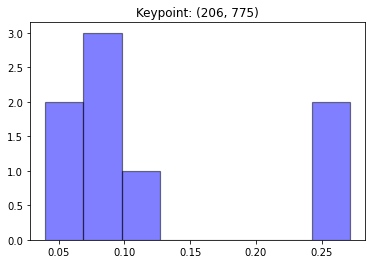

[0.08400674 0.04694518 0.04003095 0.2711899  0.11225338 0.08012063
 0.2711899  0.09426331]


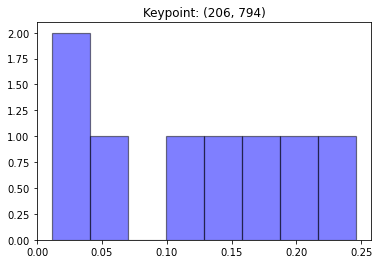

[0.05366722 0.01135113 0.02851168 0.20827634 0.24610884 0.17372796
 0.15363591 0.12472092]


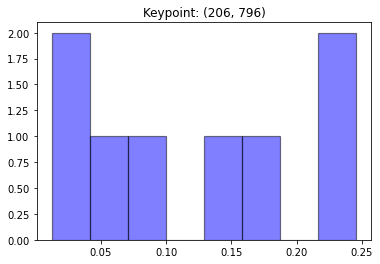

[0.05772866 0.01221017 0.03246613 0.23183807 0.24568376 0.098677
 0.18723663 0.13415958]


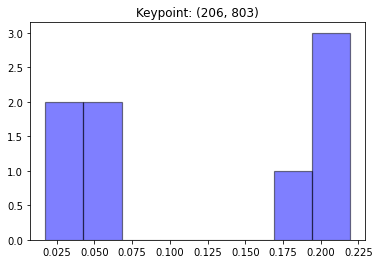

[0.03913546 0.06177476 0.05186815 0.21929103 0.21929103 0.21929103
 0.17186745 0.01748108]


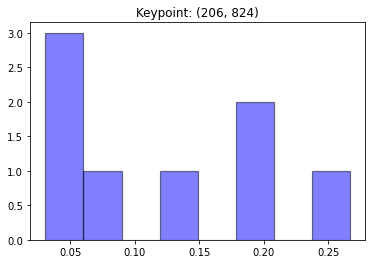

[0.0369274  0.2665354  0.13339163 0.20415152 0.20423487 0.06455227
 0.0595524  0.03065451]


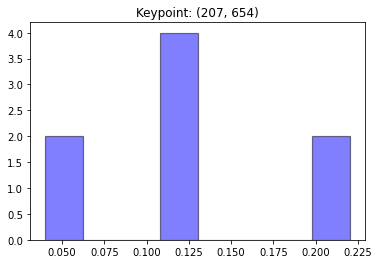

[0.04018541 0.11304454 0.12496642 0.11109882 0.11207817 0.2202289
 0.2202289  0.05816883]


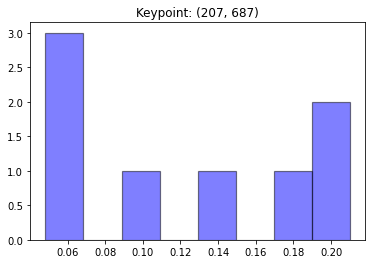

[0.13884945 0.17290601 0.06702171 0.04826818 0.10342324 0.20992005
 0.19809443 0.06151692]


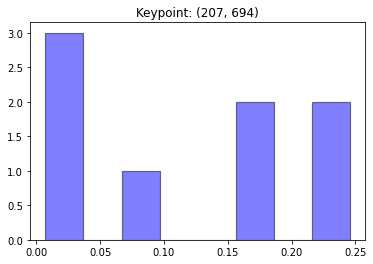

[0.03455342 0.03202139 0.17710946 0.24562168 0.24562168 0.16611865
 0.09186928 0.00708443]


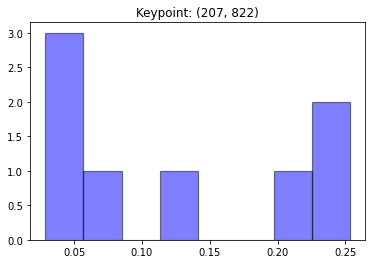

[0.02876879 0.2532416  0.13398704 0.22568785 0.21432621 0.06794201
 0.04614738 0.02989913]


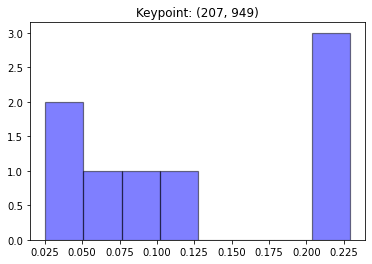

[0.04275902 0.22909984 0.22204432 0.10229437 0.09693895 0.05237642
 0.02538725 0.22909984]


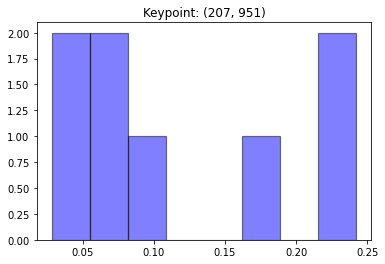

[0.07697547 0.24228839 0.18701395 0.10545588 0.07508511 0.04284871
 0.0280441  0.24228839]


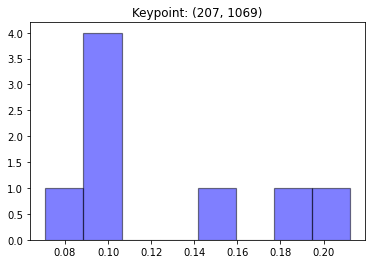

[0.18197935 0.21218021 0.15455069 0.09395611 0.10027535 0.09649597
 0.07088905 0.08967326]


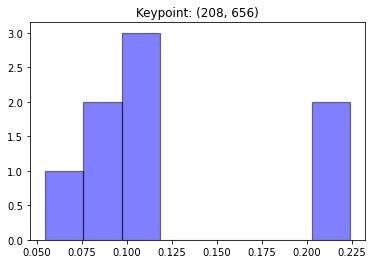

[0.05478043 0.09237815 0.10755174 0.10177059 0.11008318 0.22363578
 0.22363578 0.08616435]


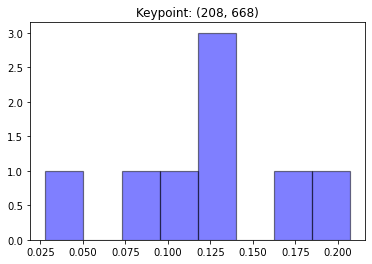

[0.13230831 0.07661923 0.02790332 0.11183571 0.13240875 0.20696665
 0.13623942 0.17571862]


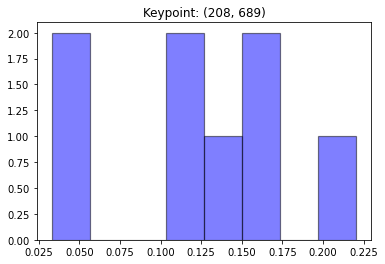

[0.03297987 0.16640383 0.11708516 0.14859116 0.10825392 0.22045259
 0.16021429 0.04601918]


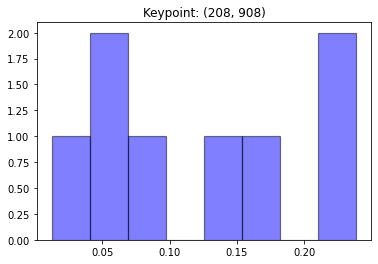

[0.14851913 0.06533753 0.1715426  0.23865564 0.23865564 0.04646459
 0.01247424 0.07835063]


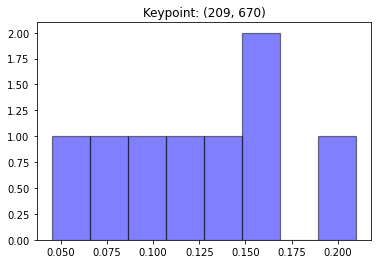

[0.10931451 0.08379994 0.04513057 0.16464746 0.15955694 0.20995834
 0.13355948 0.09403276]


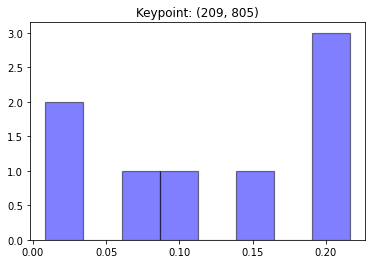

[0.03226864 0.06478927 0.10757769 0.21644367 0.21644367 0.1940444
 0.15996221 0.00847046]


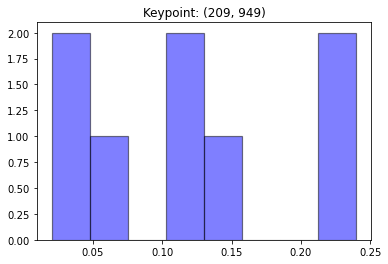

[0.02056379 0.23969163 0.23969163 0.12698374 0.12033576 0.06501779
 0.03151462 0.15620105]


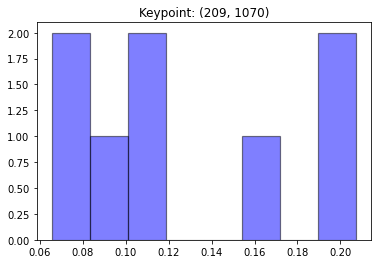

[0.2073602  0.2073602  0.10377586 0.0654767  0.10714962 0.08353915
 0.06734383 0.15799444]


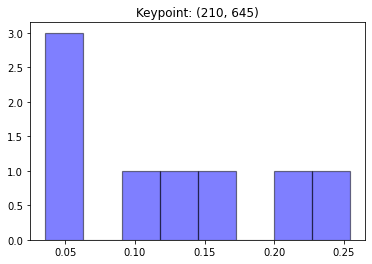

[0.03984781 0.03575842 0.03816462 0.1531491  0.11597277 0.21989183
 0.25421302 0.14300242]


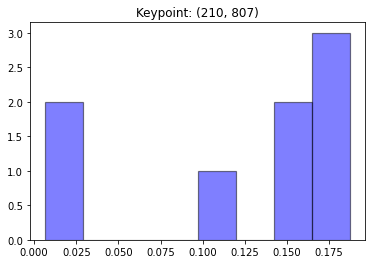

[0.0248208  0.15072325 0.18723577 0.18497881 0.16128256 0.17274157
 0.11152422 0.00669302]


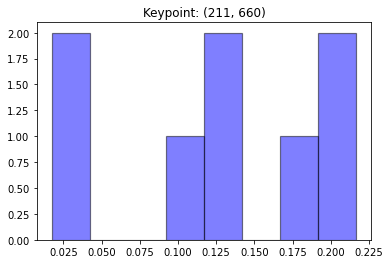

[0.09913772 0.01742515 0.01831622 0.16947053 0.12703804 0.21655096
 0.21655096 0.13551042]


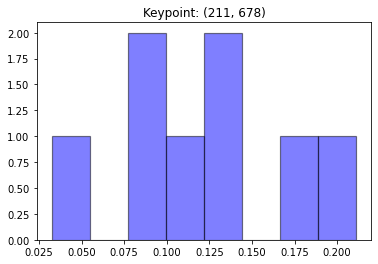

[0.13553135 0.17887959 0.09674233 0.12179649 0.21114269 0.03256354
 0.09275947 0.13058453]


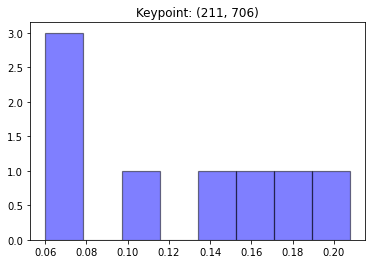

[0.15142763 0.06978849 0.06013887 0.17950336 0.15530477 0.07667754
 0.09953066 0.20762868]


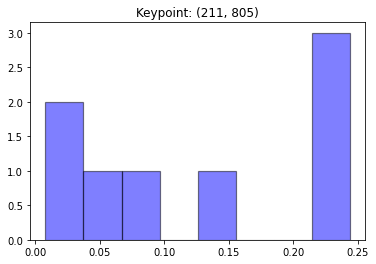

[0.01936115 0.06249752 0.06910615 0.22050085 0.2438671  0.2438671
 0.13283754 0.00796259]


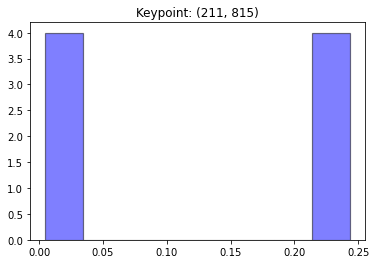

[0.01112782 0.2434393  0.2434393  0.23658741 0.2434393  0.01019362
 0.0068782  0.00489504]


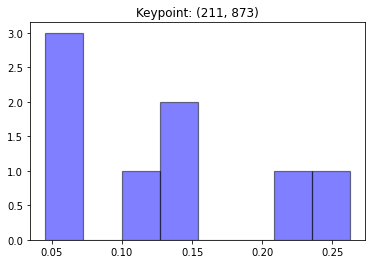

[0.04535547 0.09976164 0.13284881 0.21439818 0.26240993 0.14319859
 0.04667294 0.05535444]


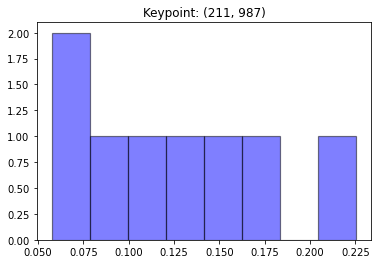

[0.07142302 0.10197315 0.22538282 0.13935457 0.14302553 0.0790729
 0.05757724 0.18219077]


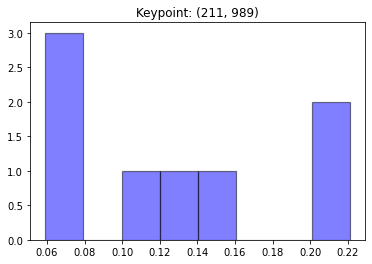

[0.0606808  0.14049096 0.22104976 0.11163836 0.12101079 0.06494189
 0.05913767 0.22104976]


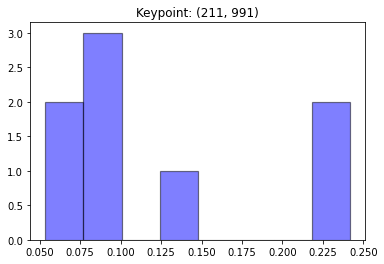

[0.081276   0.14586293 0.24158708 0.08748369 0.08423835 0.05350184
 0.06446303 0.24158708]


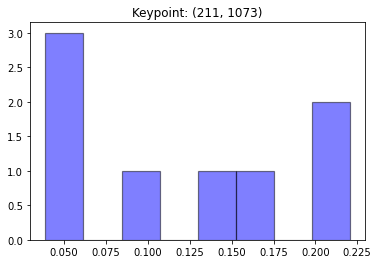

[0.22054342 0.15235494 0.0388176  0.04448262 0.10633663 0.04952279
 0.16739857 0.22054342]


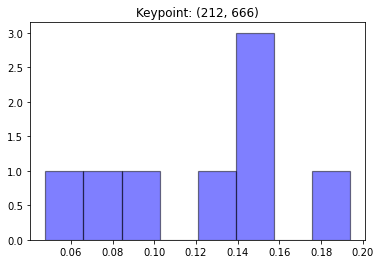

[0.15364687 0.07353316 0.04773558 0.15154572 0.15199909 0.19374984
 0.10157193 0.12621782]


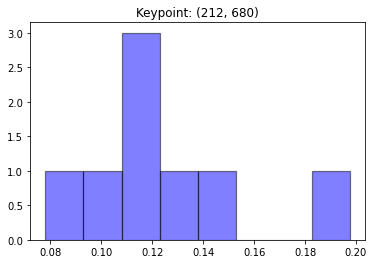

[0.14084083 0.13709779 0.07806577 0.09429106 0.19754532 0.11209922
 0.11739971 0.1226603 ]


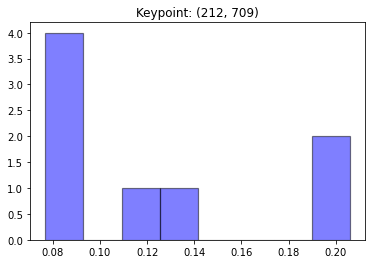

[0.19695033 0.07906124 0.07687254 0.12490384 0.13631839 0.0907817
 0.08919891 0.20591305]


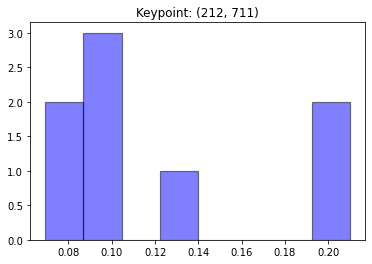

[0.20900341 0.09944378 0.09857209 0.13543604 0.07927336 0.06936363
 0.09900299 0.2099047 ]


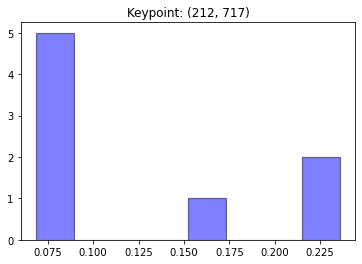

[0.07219857 0.07103963 0.06846948 0.23596836 0.23596836 0.15942649
 0.08226474 0.07466439]


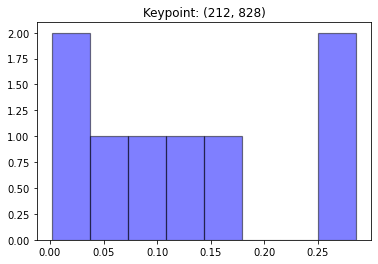

[0.02507577 0.28554878 0.11347325 0.28554878 0.14589114 0.0967721
 0.04600874 0.00168144]


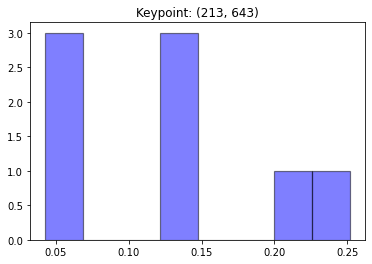

[0.04772573 0.04270165 0.05221402 0.20937505 0.1461016  0.12228943
 0.25177444 0.12781808]


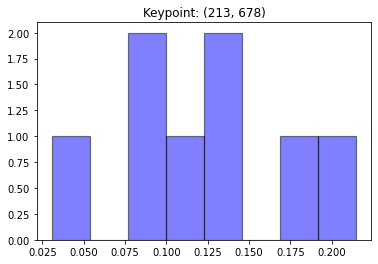

[0.13815022 0.21473563 0.11368776 0.09754881 0.1711796  0.03075293
 0.092124   0.14182105]


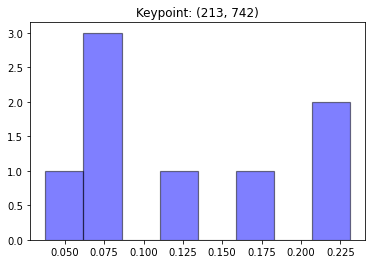

[0.08055981 0.07105913 0.12278901 0.16925264 0.23104545 0.07366569
 0.03767647 0.2139518 ]


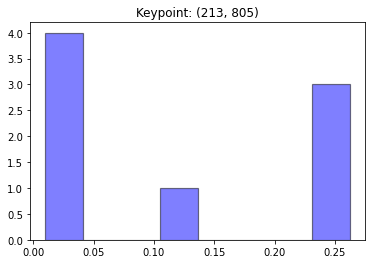

[0.0229952  0.03300073 0.03124772 0.26231378 0.26231378 0.26231378
 0.11568092 0.01013408]


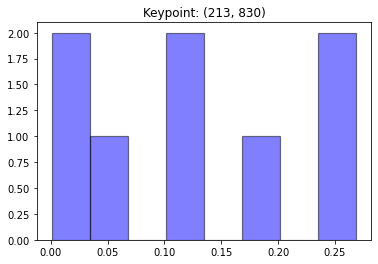

[0.00392149 0.26866386 0.11513992 0.26866386 0.1841462  0.10710962
 0.05151516 0.0008399 ]


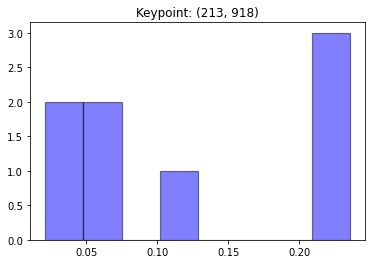

[0.22898062 0.23537953 0.11237824 0.06247805 0.03616612 0.0212469
 0.067991   0.23537953]


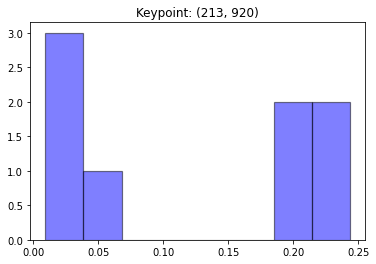

[0.20708418 0.24330517 0.20971159 0.06612467 0.03108051 0.00937016
 0.01829834 0.21502538]


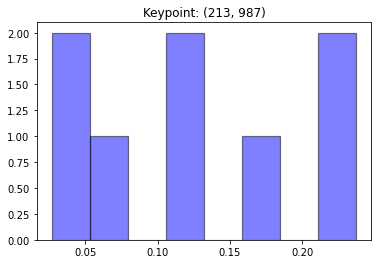

[0.06831054 0.12494297 0.23710845 0.22265724 0.16236747 0.03806945
 0.02687462 0.11966926]


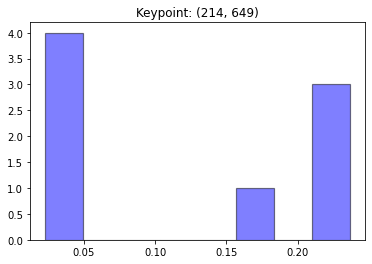

[0.02304494 0.02812025 0.04250692 0.16735283 0.23663852 0.23663852
 0.2168197  0.04887832]


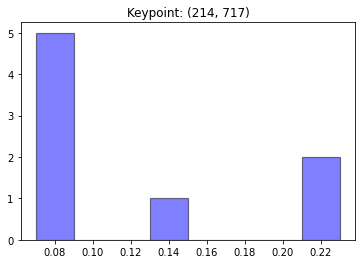

[0.08003226 0.07722356 0.0804419  0.23027164 0.23027164 0.14599594
 0.0859155  0.06984755]


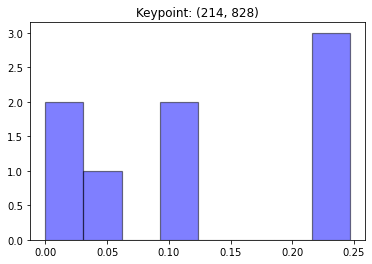

[0.01987672 0.24659293 0.09652406 0.24659293 0.24214102 0.09485627
 0.05341607 0.        ]


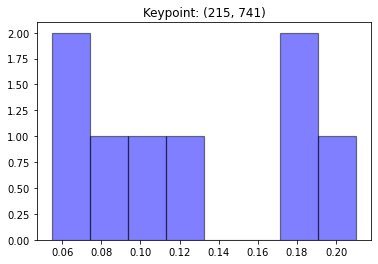

[0.08250397 0.07192724 0.12928264 0.17678655 0.21026417 0.05472541
 0.09377629 0.18073372]


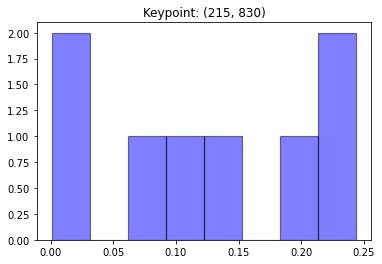

[0.01698459 0.20285564 0.12420009 0.24399623 0.24399623 0.09226028
 0.07497182 0.00073512]


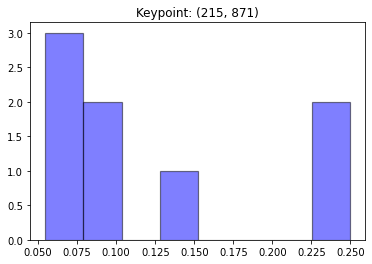

[0.05466439 0.07514385 0.13823991 0.22636721 0.24955978 0.08326372
 0.07166398 0.10109717]


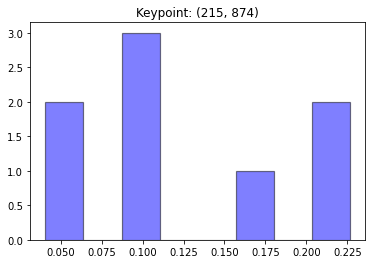

[0.08843625 0.10509228 0.15902396 0.22650766 0.22650766 0.04064704
 0.05917661 0.09460854]


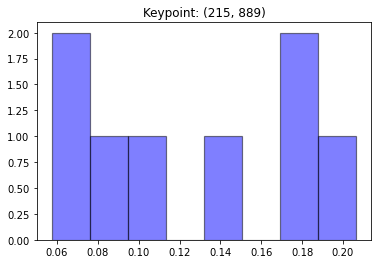

[0.05747943 0.18168446 0.08031702 0.13537567 0.20645364 0.06148129
 0.09896873 0.17823977]


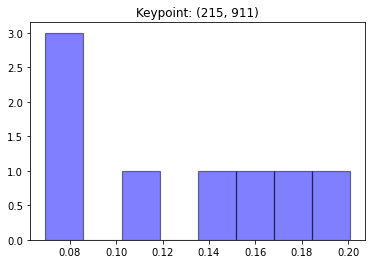

[0.07196617 0.0695387  0.0744831  0.13890411 0.16975622 0.16362815
 0.11105345 0.20067011]


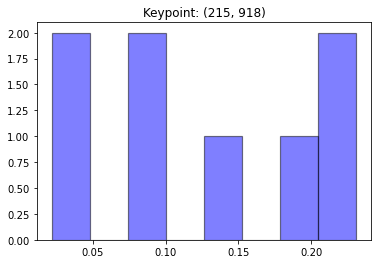

[0.1792386  0.23072565 0.13486159 0.08823807 0.03977428 0.02195059
 0.07448557 0.23072565]


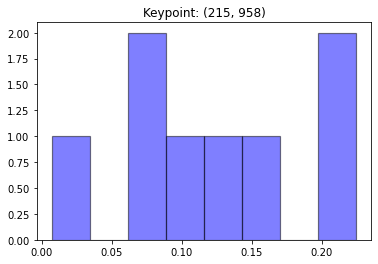

[0.07845405 0.22445812 0.15374455 0.00700056 0.22445812 0.12843568
 0.09604195 0.08740699]


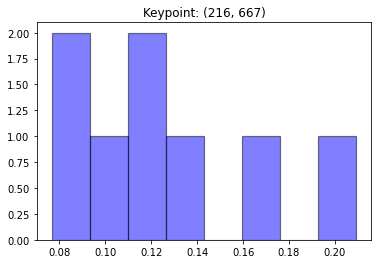

[0.20922378 0.0960073  0.08318835 0.16795612 0.12012153 0.13252605
 0.07670364 0.11427323]


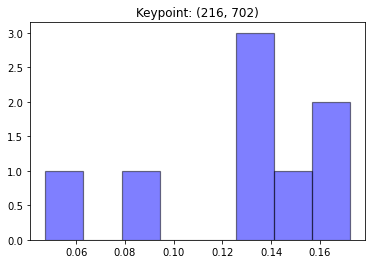

[0.0855073  0.04742191 0.12564643 0.17223354 0.15072768 0.13147166
 0.1601752  0.12681628]


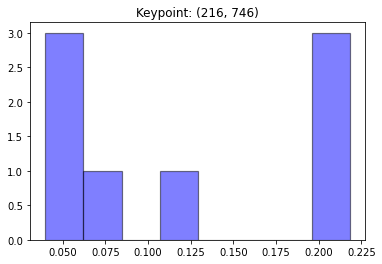

[0.07278604 0.05529052 0.03992843 0.05503923 0.12226844 0.21822911
 0.21822911 0.21822911]


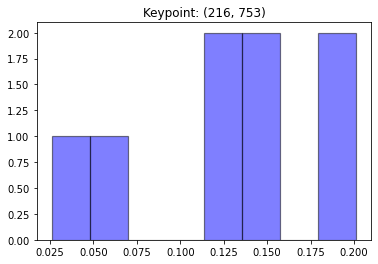

[0.02605904 0.06586526 0.14582326 0.18992827 0.20118266 0.11444781
 0.12017632 0.13651738]


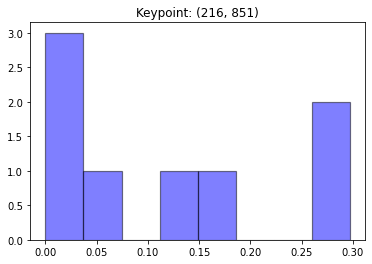

[0.00590543 0.         0.13374968 0.29701701 0.29391916 0.16908541
 0.07354882 0.0267745 ]


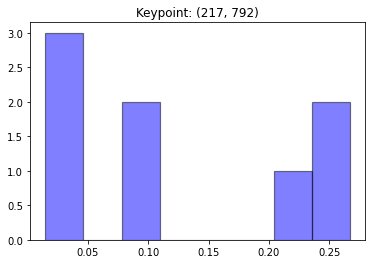

[0.02435902 0.01483299 0.08765465 0.01931419 0.22984052 0.26708775
 0.26708775 0.08982314]


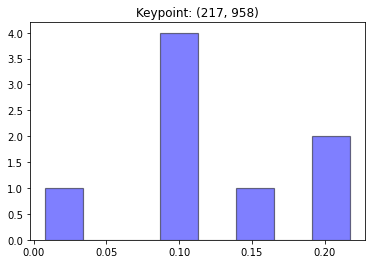

[0.10340725 0.21731017 0.14701247 0.00816229 0.21522261 0.10607059
 0.10478724 0.09802737]


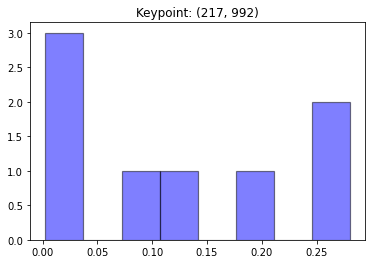

[0.12801844 0.28027968 0.28027968 0.19328896 0.02144616 0.00253942
 0.00552994 0.08861772]


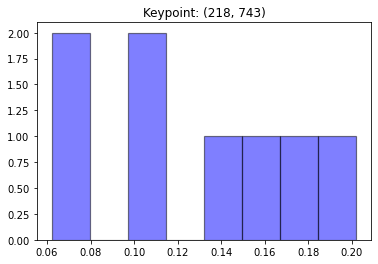

[0.06608041 0.0621878  0.10377358 0.09829333 0.20206034 0.17389526
 0.13373226 0.15997703]


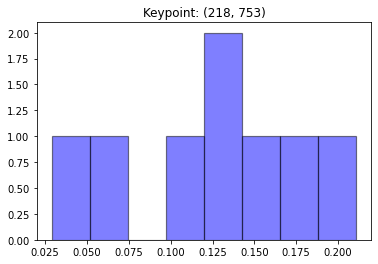

[0.02903126 0.05319824 0.14021299 0.17711311 0.21078684 0.13695996
 0.10739107 0.14530653]


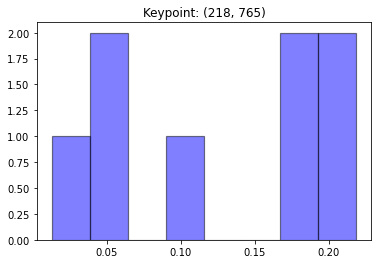

[0.20124888 0.18262574 0.10386959 0.16897796 0.21837296 0.0127635
 0.05792404 0.05421733]


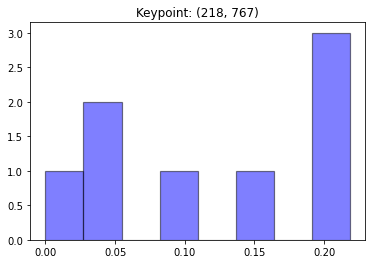

[0.21839298 0.21839298 0.10737628 0.13992314 0.21839298 0.
 0.05073003 0.04679159]


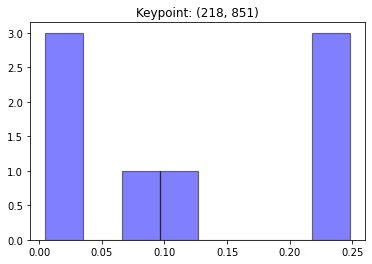

[0.00493131 0.02172534 0.11343139 0.24793053 0.24793053 0.24793053
 0.09376238 0.02235797]


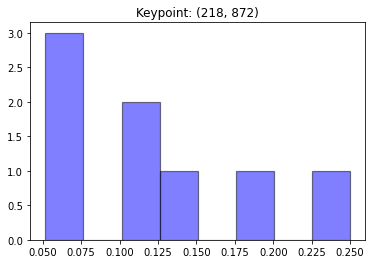

[0.05173759 0.10669238 0.14535942 0.19650403 0.24976576 0.071472
 0.06944893 0.10901989]


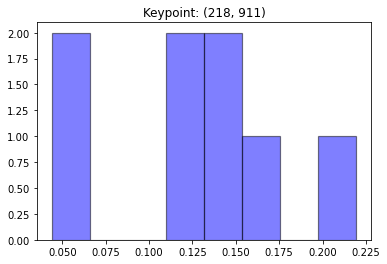

[0.04385842 0.06103573 0.11441966 0.2193814  0.13869893 0.13393682
 0.11447254 0.1741965 ]


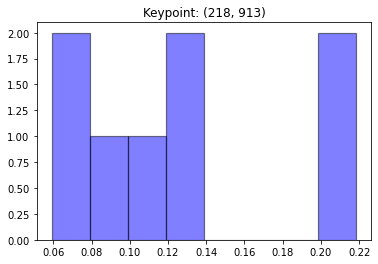

[0.08297729 0.05920284 0.11964258 0.21845729 0.10042747 0.12241679
 0.07841845 0.21845729]


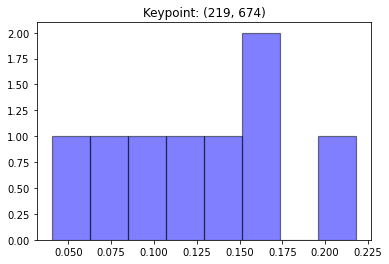

[0.15963395 0.21807167 0.11140549 0.04030033 0.15305197 0.09478641
 0.07291064 0.14983954]


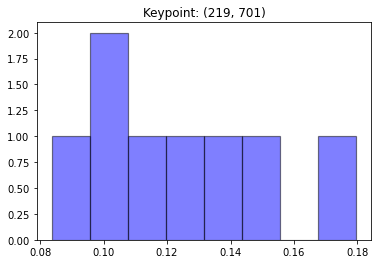

[0.10144395 0.10532654 0.1531345  0.1795878  0.13329592 0.11823813
 0.1252839  0.08368926]


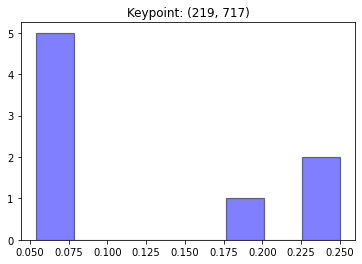

[0.07208576 0.07113931 0.05910261 0.25026497 0.25026497 0.17754083
 0.06588809 0.05371346]


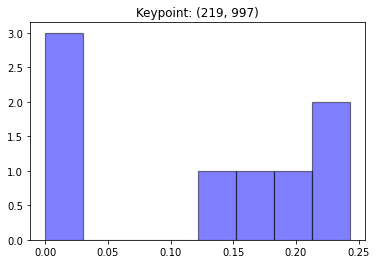

[0.19019849 0.24302533 0.24302533 0.14408638 0.01039831 0.
 0.01251266 0.1567535 ]


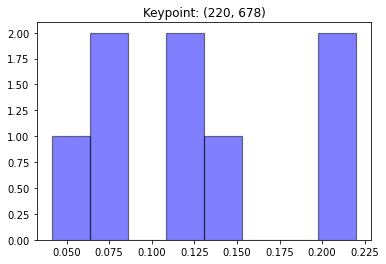

[0.13411028 0.21991085 0.12245827 0.04128671 0.06390987 0.07890289
 0.13042923 0.2089919 ]


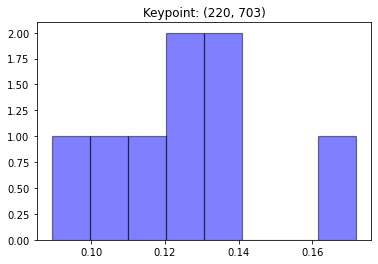

[0.12402562 0.1202237  0.17188671 0.13650509 0.1203028  0.08926765
 0.13194286 0.10584558]


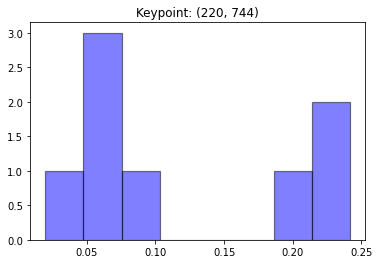

[0.07056542 0.06790313 0.07907211 0.01992156 0.24150554 0.24150554
 0.20814147 0.07138523]


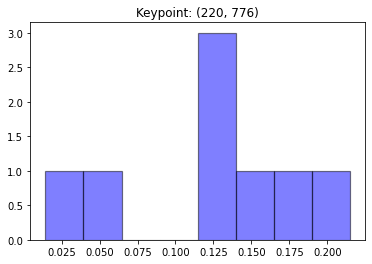

[0.13602748 0.11973721 0.04865543 0.01437056 0.21475433 0.17112115
 0.13475986 0.16057397]


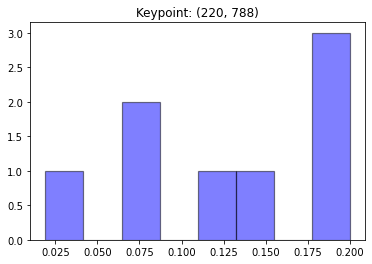

[0.01905417 0.07258614 0.19584834 0.11576225 0.20005092 0.18625953
 0.13953553 0.07090314]


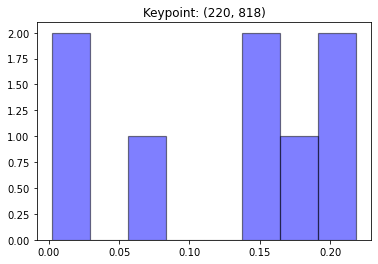

[0.15446665 0.21852421 0.14916521 0.21852421 0.1855252  0.0020837
 0.00217354 0.06953728]


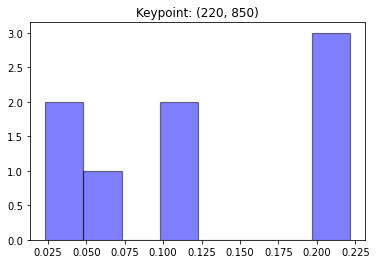

[0.02342937 0.0999634  0.06646593 0.22141553 0.22141553 0.22141553
 0.1128542  0.03304051]


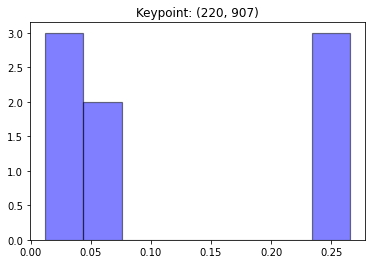

[0.02058187 0.04359106 0.05927972 0.26541018 0.26541018 0.26541018
 0.06811897 0.01219784]


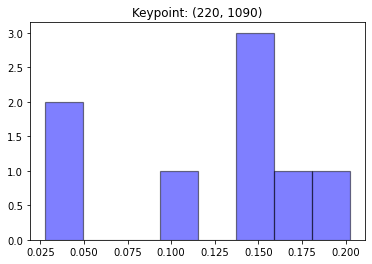

[0.02794588 0.15535167 0.1067223  0.15096767 0.16908299 0.20240875
 0.14798215 0.03953859]


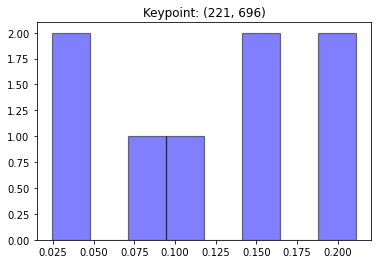

[0.02430932 0.09124127 0.21139908 0.21139908 0.15974214 0.14802698
 0.10850231 0.04537983]


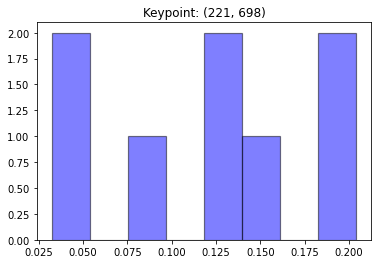

[0.03232355 0.1294915  0.20408258 0.20408258 0.13811058 0.14727018
 0.09433754 0.05030149]


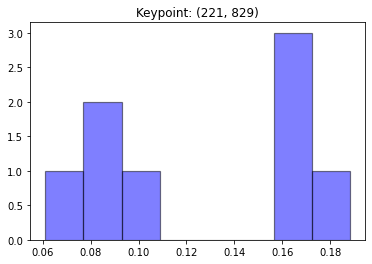

[0.17022436 0.07959577 0.06108956 0.16497333 0.18822187 0.08424478
 0.09435701 0.15729332]


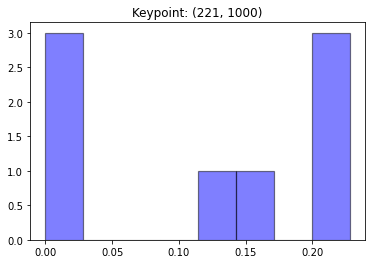

[0.22794594 0.22794594 0.22794594 0.1578901  0.0015508  0.
 0.0237726  0.13294869]


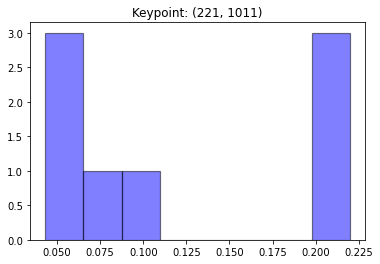

[0.05468031 0.10163948 0.21976461 0.21976461 0.21976461 0.04324576
 0.05713387 0.08400675]


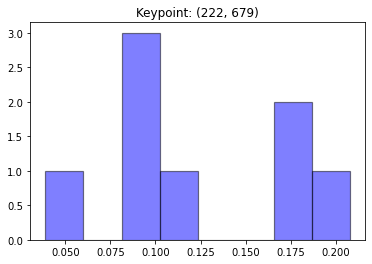

[0.17844524 0.20781936 0.10723933 0.09624246 0.03892057 0.08590379
 0.10067754 0.18475171]


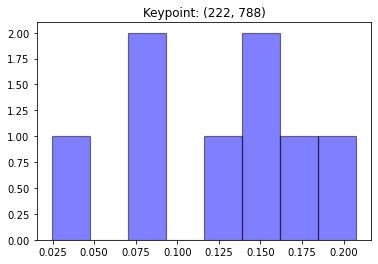

[0.02455694 0.08522423 0.20757116 0.14668296 0.11806405 0.17858777
 0.1603956  0.0789173 ]


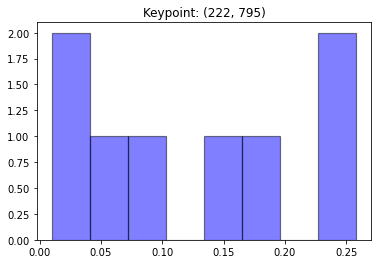

[0.01473828 0.00994295 0.05260932 0.1348685  0.2580932  0.2580932
 0.19151922 0.08013535]


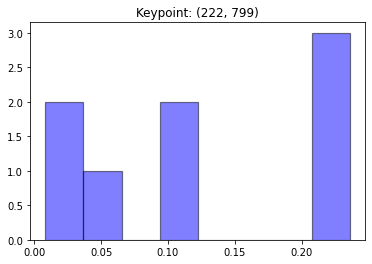

[0.00825861 0.02078579 0.11507009 0.23610219 0.23610219 0.23610219
 0.10886394 0.03871498]


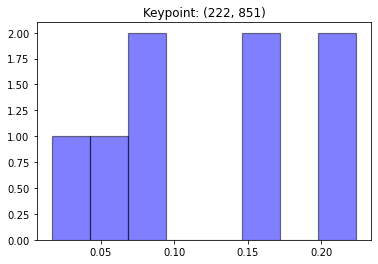

[0.0818044  0.07401929 0.01661037 0.16441643 0.22381751 0.22381751
 0.1613066  0.0542079 ]


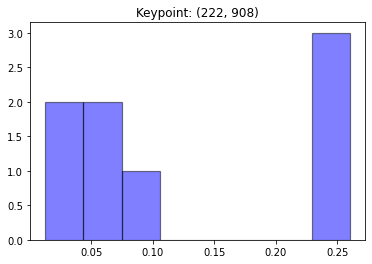

[0.0283504  0.0683272  0.07601577 0.26031333 0.25012588 0.26031333
 0.04399635 0.01255774]


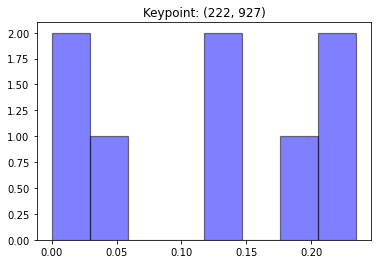

[0.         0.05366969 0.23472602 0.14067017 0.12699581 0.20397631
 0.21929527 0.02066674]


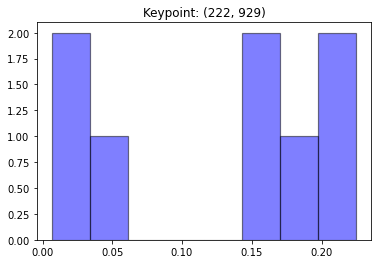

[0.00664513 0.05655834 0.22482092 0.14556104 0.17570261 0.21964924
 0.15424254 0.01682018]


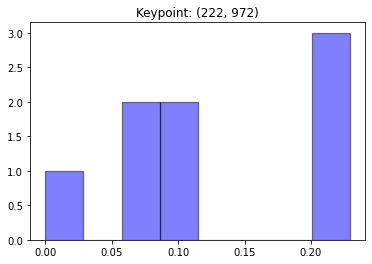

[0.22916346 0.08268845 0.         0.22916346 0.21407426 0.08950551
 0.08781088 0.06759398]


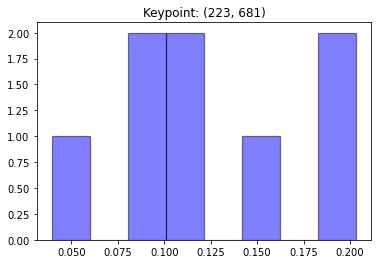

[0.20335376 0.19862739 0.11665602 0.08643056 0.03938803 0.10817912
 0.09689015 0.15047497]


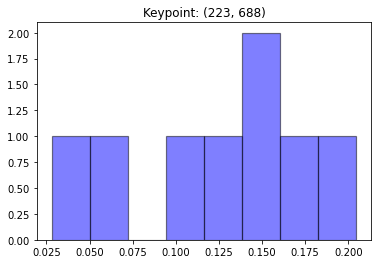

[0.17509377 0.2045454  0.13822149 0.09506592 0.02813466 0.14391035
 0.15543326 0.05959515]


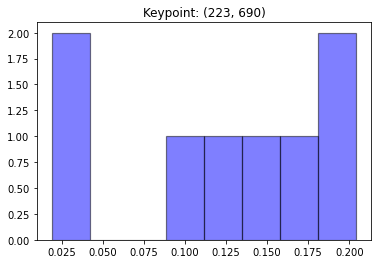

[0.09583771 0.20416615 0.18100948 0.13439338 0.0315859  0.18825375
 0.14577656 0.01897707]


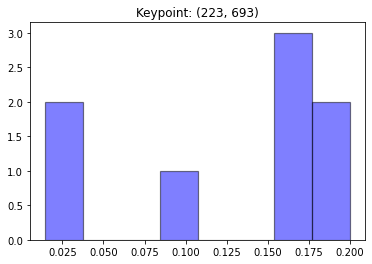

[0.01469105 0.17883461 0.17304622 0.19984581 0.16027608 0.15532856
 0.09962353 0.01835414]


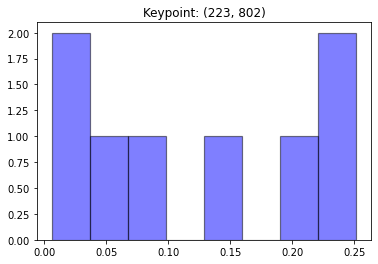

[0.00590388 0.03032574 0.15267036 0.25139639 0.19423207 0.24692388
 0.07133449 0.0472132 ]


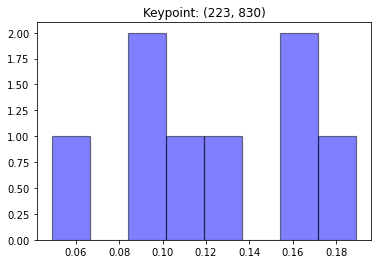

[0.16911918 0.13068677 0.1004941  0.15839784 0.18916649 0.04897518
 0.08870012 0.11446032]


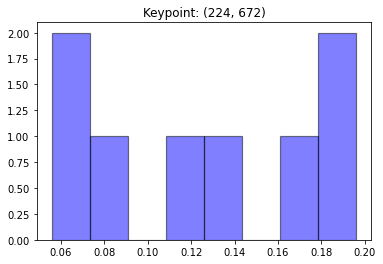

[0.05799348 0.19124609 0.17146968 0.1139346  0.19602627 0.12821842
 0.08535776 0.05575369]


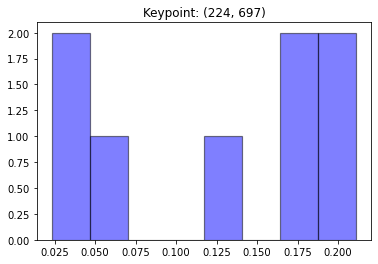

[0.02945802 0.12916331 0.21117567 0.1791159  0.21117567 0.16736242
 0.04937132 0.02317768]


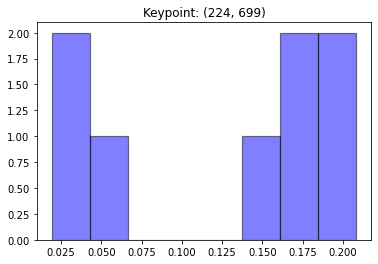

[0.06153017 0.16813612 0.20814399 0.16372835 0.20814399 0.14206725
 0.01920926 0.02904086]


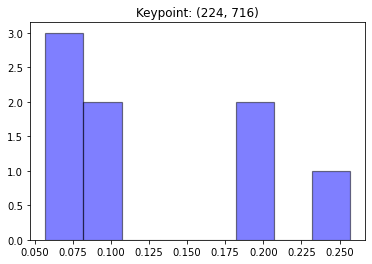

[0.05704436 0.06479777 0.08287529 0.18400102 0.25670974 0.19659915
 0.09794075 0.06003191]


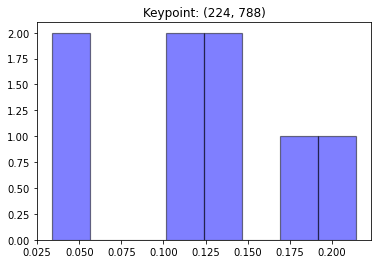

[0.03364314 0.11777787 0.21449472 0.12075038 0.14583841 0.17253796
 0.14172978 0.05322774]


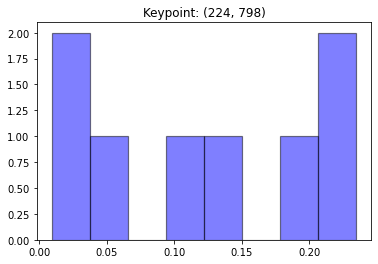

[0.00937864 0.02788724 0.12140509 0.23463495 0.23463495 0.18790452
 0.12562564 0.05852897]


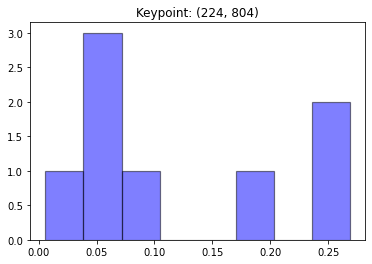

[0.00584158 0.0403662  0.20273079 0.26859886 0.26859886 0.06742007
 0.08337058 0.06307305]


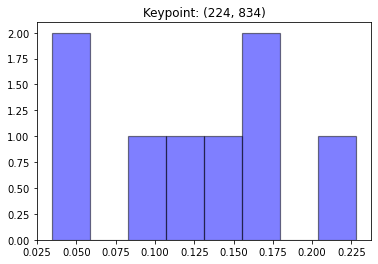

[0.17139723 0.14454288 0.22797065 0.16884199 0.04779468 0.03428529
 0.08703043 0.11813685]


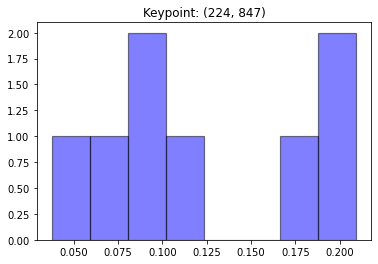

[0.08289764 0.20919785 0.18758208 0.07987893 0.1033678  0.19934562
 0.10012187 0.03760821]


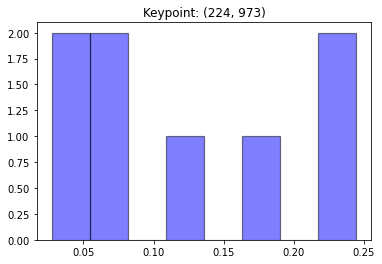

[0.24447031 0.11374484 0.02748205 0.24447031 0.18804946 0.06202071
 0.06654985 0.05321247]


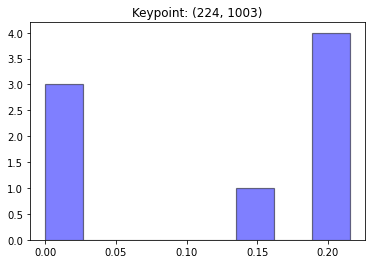

[0.21544274 0.20914922 0.21544274 0.20507023 0.01060617 0.
 0.00604147 0.13824743]


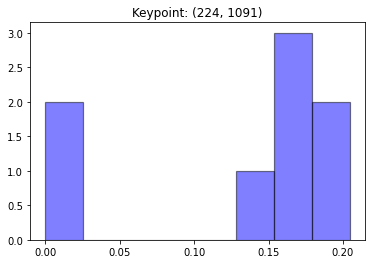

[0.         0.15350454 0.16000289 0.20458036 0.16438959 0.13029668
 0.18722594 0.        ]


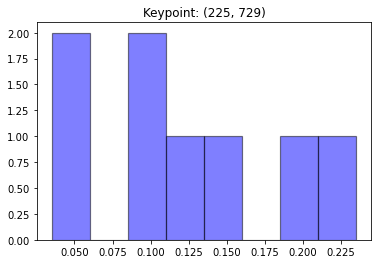

[0.03508431 0.0491437  0.10612068 0.19179145 0.23505889 0.14324082
 0.12967953 0.10988064]


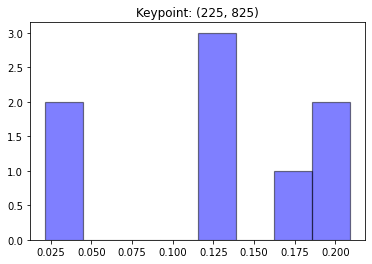

[0.20879661 0.12120718 0.11593608 0.19539963 0.16852122 0.04244036
 0.02179683 0.1259021 ]


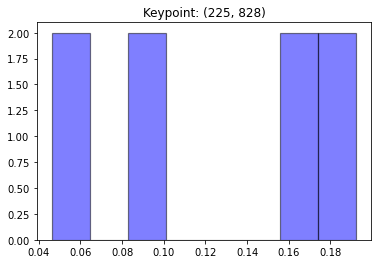

[0.16288152 0.05997522 0.09411699 0.19231817 0.16739374 0.04623501
 0.08506746 0.1920119 ]


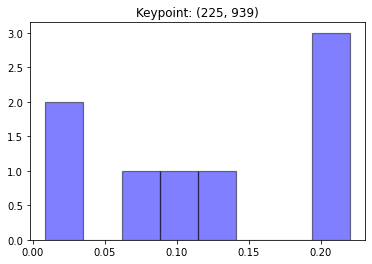

[0.22029596 0.22029596 0.00871599 0.01696259 0.22029596 0.13851816
 0.10476037 0.07015502]


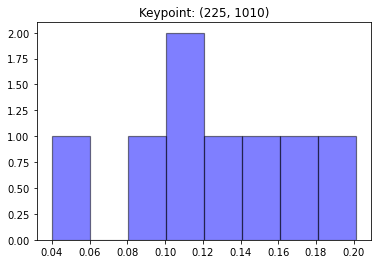

[0.15581628 0.10545335 0.08784218 0.12978463 0.1664648  0.03988284
 0.11339763 0.20135829]


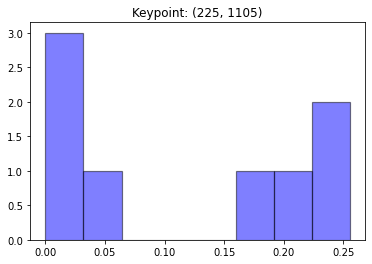

[0.05300489 0.01251841 0.         0.02694126 0.25529986 0.21493163
 0.1820041  0.25529986]


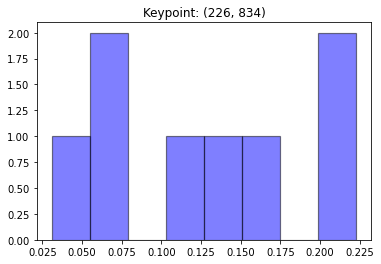

[0.15456015 0.12728521 0.22271524 0.21339037 0.06978687 0.03094565
 0.06735728 0.11395922]


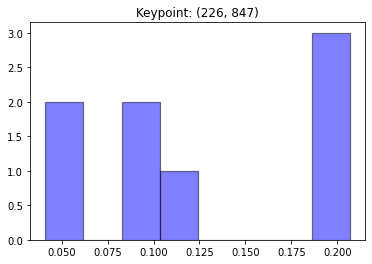

[0.10142227 0.20679263 0.20003679 0.04116785 0.08525166 0.20269948
 0.11947218 0.04315714]


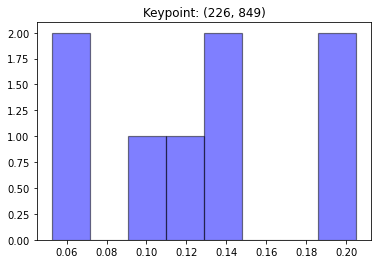

[0.10045938 0.19700798 0.13869855 0.0538212  0.12260391 0.20498028
 0.12981915 0.05260955]


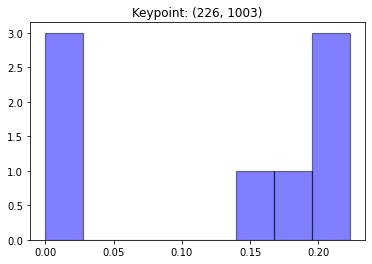

[0.2230502  0.19756056 0.2230502  0.17604194 0.01101578 0.
 0.00854326 0.16073807]


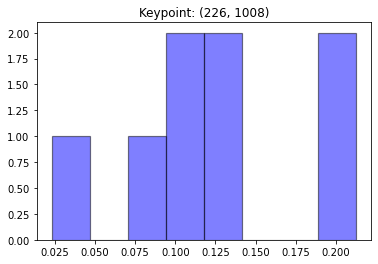

[0.21258065 0.10786722 0.1207536  0.10242133 0.13337272 0.02312805
 0.08729578 0.21258065]


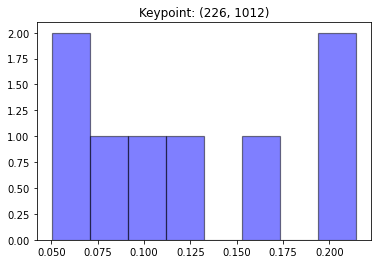

[0.1039887  0.05304878 0.05023869 0.12762665 0.21439151 0.07235043
 0.16396372 0.21439151]


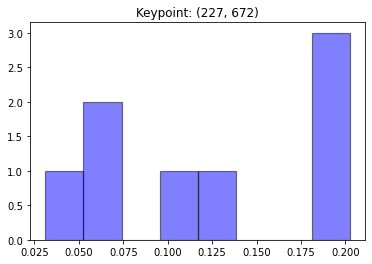

[0.03120787 0.20119067 0.202032   0.13618391 0.20242913 0.10448405
 0.06956653 0.05290584]


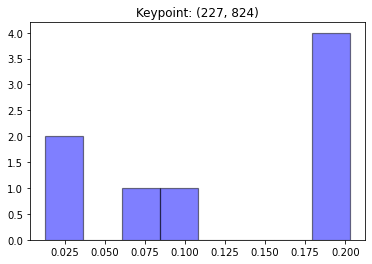

[0.17977267 0.19336731 0.10413604 0.2028189  0.20090071 0.02549754
 0.01269238 0.08081444]


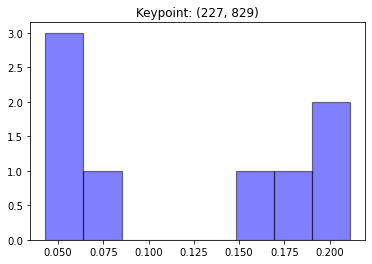

[0.17493157 0.07900124 0.05934881 0.21110903 0.21110903 0.04302598
 0.0585616  0.16291274]


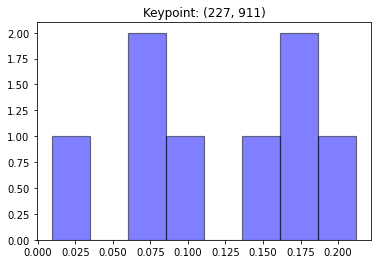

[0.21205592 0.1524698  0.08467101 0.18368065 0.10662061 0.18245105
 0.00934861 0.06870235]


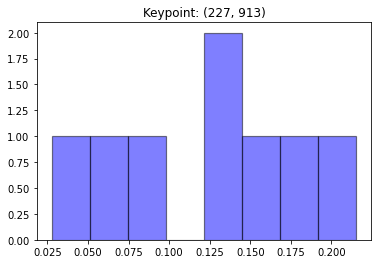

[0.21520537 0.13259656 0.07336723 0.17227023 0.09469347 0.12835866
 0.02767876 0.15582973]


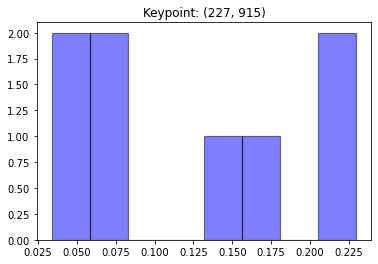

[0.22970057 0.15340423 0.06813631 0.16606594 0.08081078 0.03826182
 0.03391977 0.22970057]


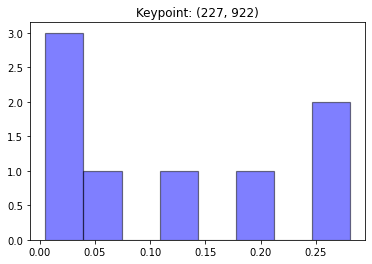

[0.18880745 0.02969179 0.0052775  0.03739944 0.0504958  0.12718672
 0.28057065 0.28057065]


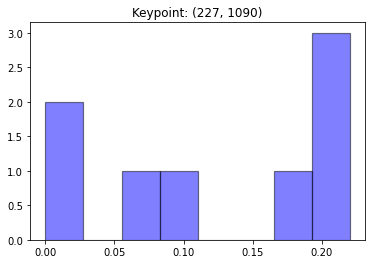

[0.         0.06206726 0.22031036 0.22031036 0.216139   0.09757277
 0.18360024 0.        ]


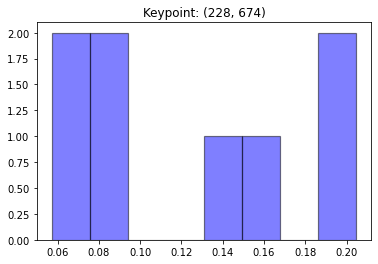

[0.08120283 0.20464059 0.19948259 0.15976703 0.14206507 0.08624695
 0.05714667 0.06944827]


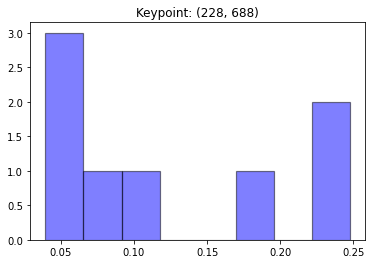

[0.04972106 0.03943014 0.11507865 0.08180471 0.04300636 0.17582302
 0.24756803 0.24756803]


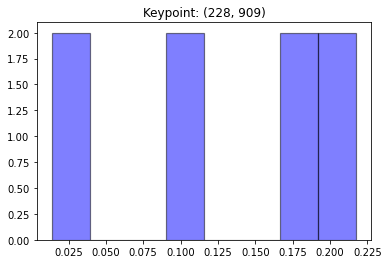

[0.21747106 0.17543379 0.09039803 0.17547858 0.0953034  0.21747106
 0.01381446 0.01462963]


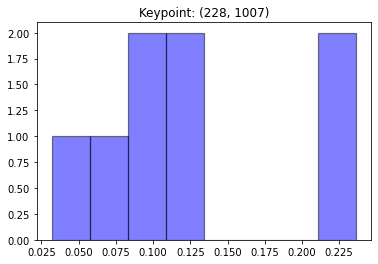

[0.23639129 0.1244198  0.09684297 0.08372711 0.10951298 0.03201401
 0.08070054 0.23639129]


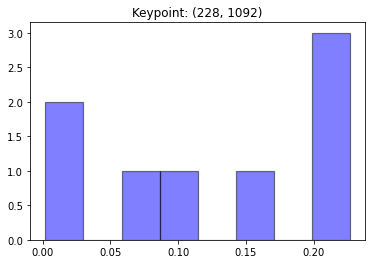

[0.00200335 0.05879782 0.22667867 0.22667867 0.16714603 0.10558564
 0.20288203 0.01022778]


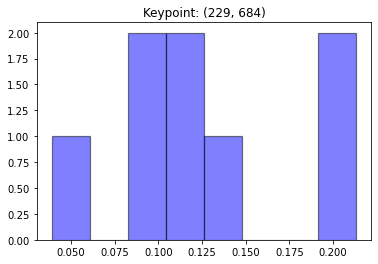

[0.08316607 0.1333013  0.11282656 0.08484582 0.03908852 0.12031006
 0.21323084 0.21323084]


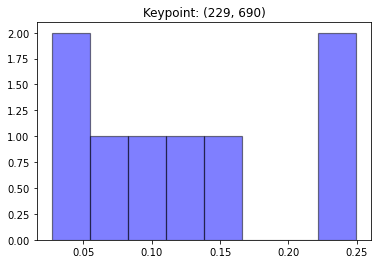

[0.02681909 0.05531937 0.15174466 0.10677869 0.0333828  0.1305472
 0.24957788 0.24583031]


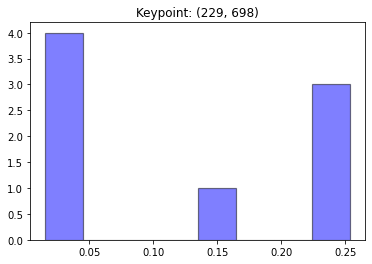

[0.0336606  0.25352265 0.25352265 0.14229038 0.25352265 0.01587942
 0.0252716  0.02233005]


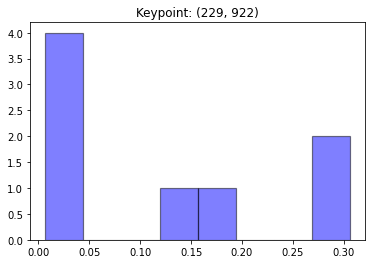

[0.18514567 0.02731982 0.00841923 0.00694755 0.01634746 0.1441369
 0.30584169 0.30584169]


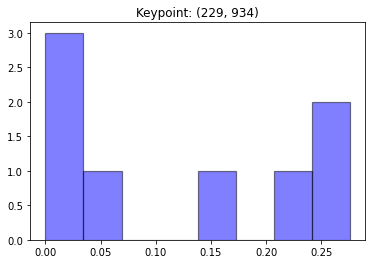

[0.05136546 0.         0.00165559 0.02147934 0.27575671 0.22425094
 0.14973526 0.27575671]


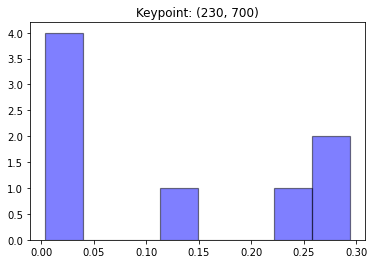

[0.00814755 0.29366475 0.29366475 0.11986756 0.25618149 0.01625326
 0.00377304 0.0084476 ]


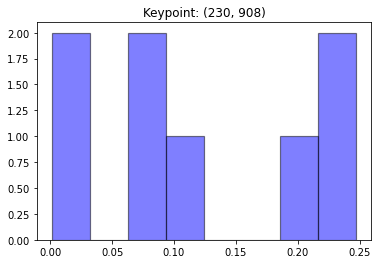

[0.24727715 0.21353988 0.11271014 0.07784364 0.09202567 0.24727715
 0.00808595 0.00124043]


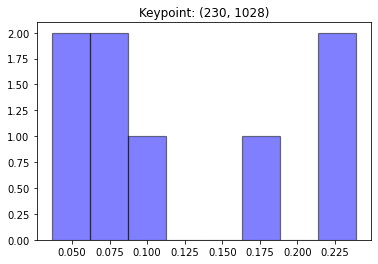

[0.08008189 0.2390193  0.09565007 0.17524262 0.2390193  0.08521417
 0.03660438 0.04916826]


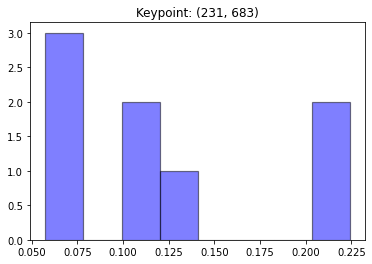

[0.07357628 0.11148811 0.13425051 0.07322711 0.05748142 0.10165535
 0.22416061 0.22416061]


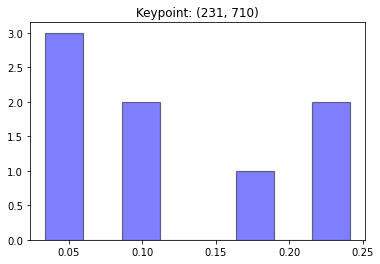

[0.04786478 0.24129104 0.17615812 0.10432942 0.24129104 0.09525407
 0.05981658 0.03399496]


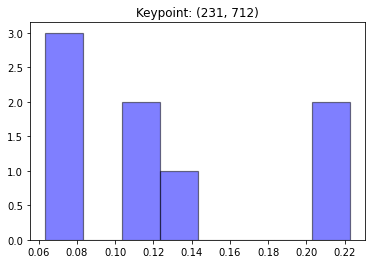

[0.06439569 0.22275345 0.13664034 0.10934143 0.22275345 0.10918079
 0.07145049 0.06348436]


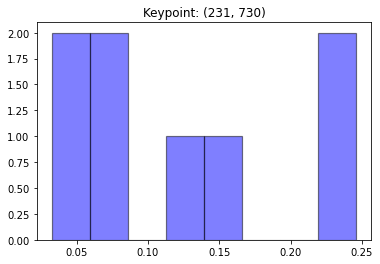

[0.03248534 0.05222146 0.0674981  0.24370677 0.24596815 0.14552549
 0.13222883 0.08036586]


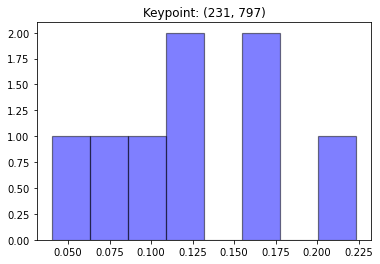

[0.15939898 0.17384491 0.06899744 0.22344141 0.12024037 0.04019511
 0.11828221 0.09559957]


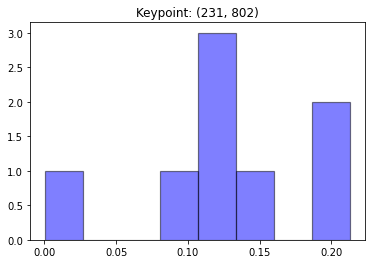

[0.12506335 0.11389202 0.00076549 0.21283139 0.21283139 0.08478885
 0.1372693  0.11255822]


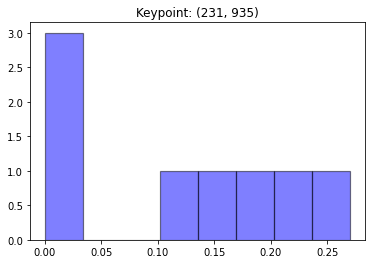

[0.12894195 0.01073868 0.00070988 0.02493905 0.22843797 0.18048306
 0.15572437 0.27002503]


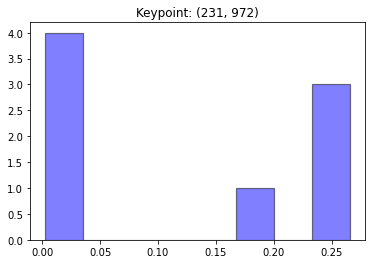

[0.03017436 0.18008477 0.26549741 0.26549741 0.2406319  0.00988806
 0.00539417 0.00283192]


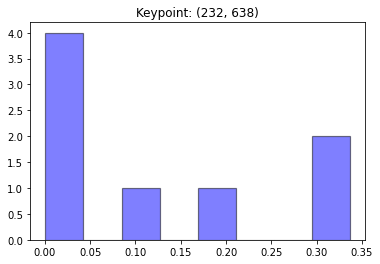

[0.00918793 0.00574096 0.00068826 0.02109479 0.175968   0.3365007
 0.3365007  0.11431866]


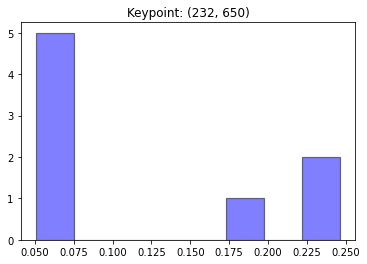

[0.07184457 0.06980671 0.05051365 0.05857396 0.07143441 0.18481456
 0.24650607 0.24650607]


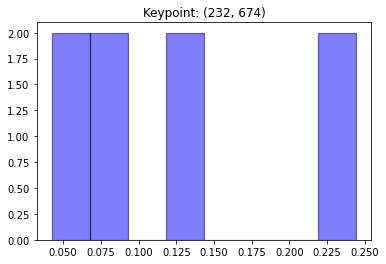

[0.24425341 0.04242587 0.1258289  0.14154519 0.0478063  0.08396904
 0.06991789 0.24425341]


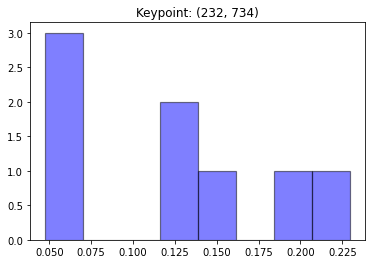

[0.04766339 0.05415495 0.06405774 0.19186277 0.2294601  0.13214125
 0.1436632  0.1369966 ]


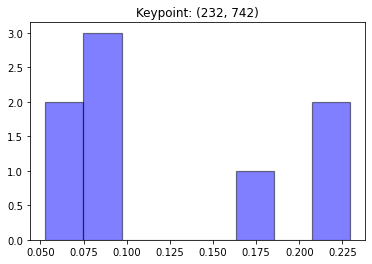

[0.22923079 0.07964846 0.05286622 0.16847194 0.22923079 0.06895204
 0.08632015 0.08527961]


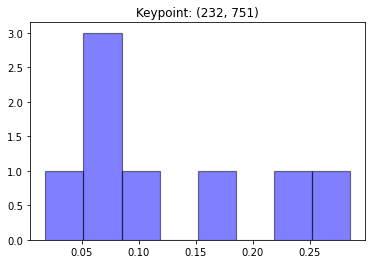

[0.05222746 0.01824619 0.07028332 0.09789095 0.1716271  0.28525002
 0.22891146 0.0755635 ]


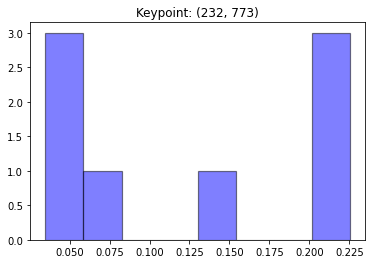

[0.03489357 0.04487092 0.14648407 0.22527829 0.07776352 0.20927939
 0.22527829 0.03615194]


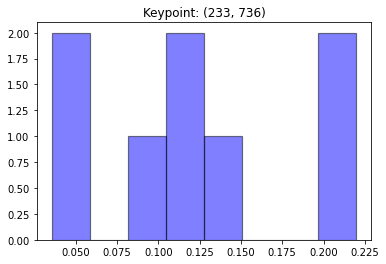

[0.03557829 0.04866092 0.09522442 0.21646755 0.2197301  0.12302648
 0.14453568 0.11677656]


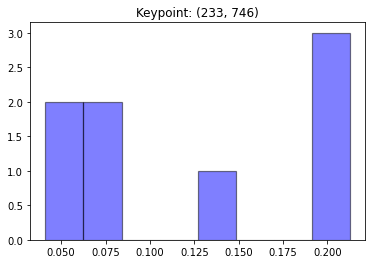

[0.20830132 0.06315833 0.04108627 0.07463124 0.212654   0.212654
 0.13713629 0.05037854]


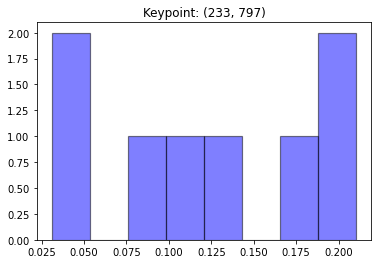

[0.18008292 0.20289221 0.08385422 0.21031611 0.03104736 0.04451363
 0.13482827 0.11246528]


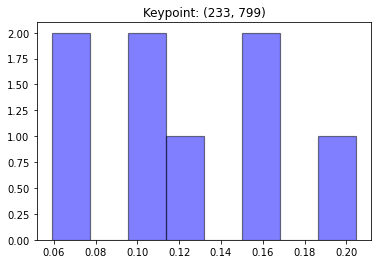

[0.15291965 0.16470794 0.05906407 0.20464583 0.11310834 0.07606633
 0.1256766  0.10381124]


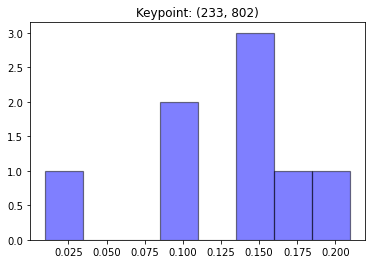

[0.15271102 0.13736412 0.00998123 0.09349256 0.20937047 0.09761881
 0.16120841 0.13825336]


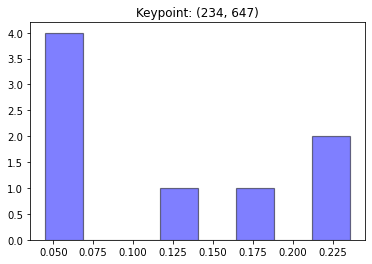

[0.06675092 0.06663624 0.0450801  0.05556864 0.17535026 0.23565503
 0.23565503 0.11930378]


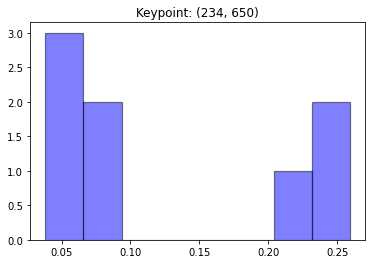

[0.06855797 0.06826797 0.04767765 0.03829416 0.04560629 0.21327331
 0.25916133 0.25916133]


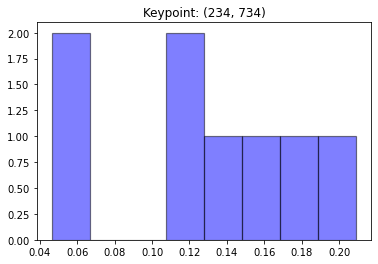

[0.05000685 0.04640681 0.11824902 0.15290544 0.20907255 0.13886831
 0.17105743 0.11343359]


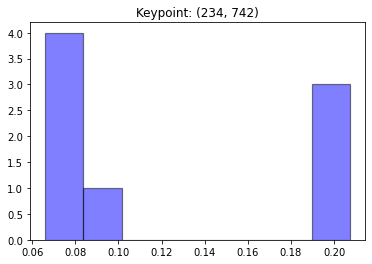

[0.20720797 0.07550313 0.07858072 0.19243964 0.20720797 0.06618673
 0.09145977 0.08141405]


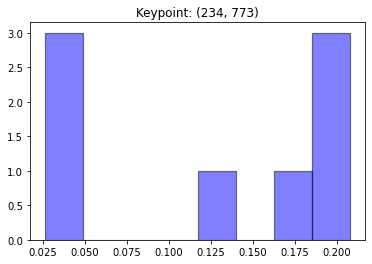

[0.02672539 0.03746291 0.11944567 0.20771796 0.18389124 0.18726175
 0.20771796 0.02977712]


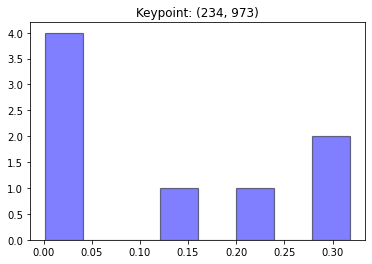

[0.00862081 0.21091337 0.31787271 0.31787271 0.13549595 0.00460274
 0.00266658 0.00195513]


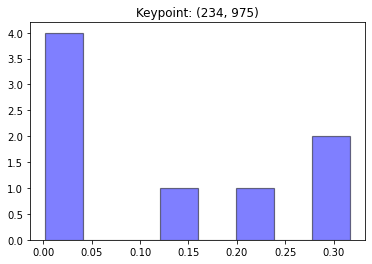

[0.00717452 0.20944117 0.31680921 0.31680921 0.14001449 0.00486568
 0.00281891 0.00206682]


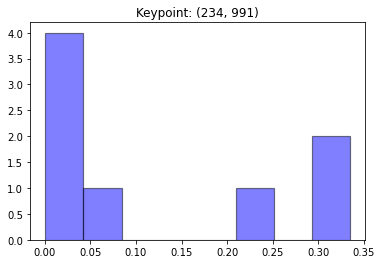

[0.07338019 0.33452057 0.33452057 0.24088123 0.01140899 0.00315414
 0.00148451 0.0006498 ]


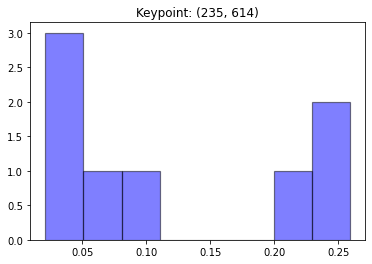

[0.04871007 0.02919792 0.02118272 0.09576156 0.07111813 0.2588773
 0.2588773  0.216275  ]


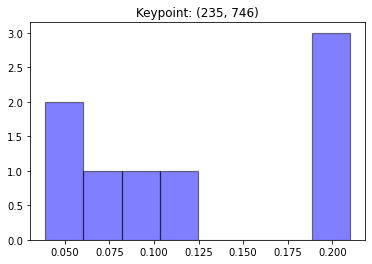

[0.20764547 0.06518823 0.04655464 0.10273596 0.20974065 0.20974065
 0.11921718 0.03917721]


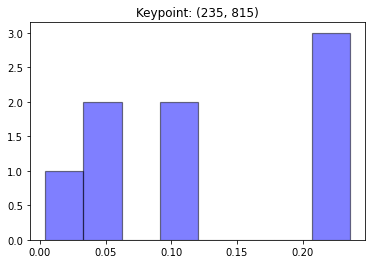

[0.2358054  0.05791253 0.00421755 0.10514754 0.03912899 0.09176769
 0.2358054  0.23021492]


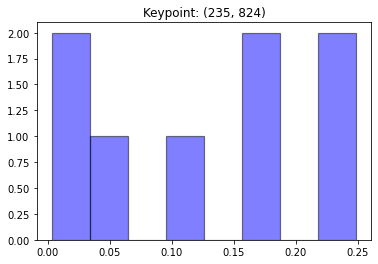

[0.09691418 0.17014322 0.24883298 0.24883298 0.18208679 0.01373285
 0.00305044 0.03640657]


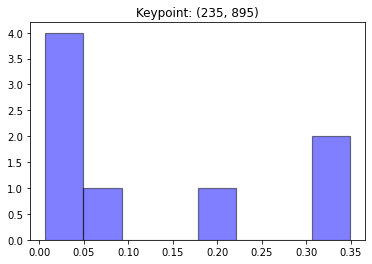

[0.00704028 0.01061281 0.01395101 0.18521321 0.349013   0.349013
 0.07351212 0.01164458]


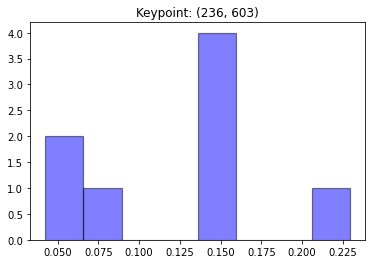

[0.0431132  0.04255037 0.14830542 0.15523394 0.15348175 0.14929382
 0.22931664 0.07870486]


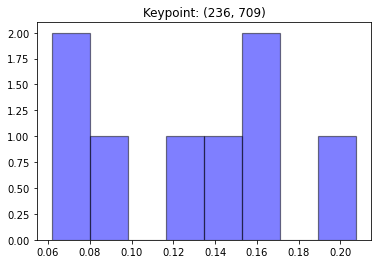

[0.06366078 0.15536606 0.08959572 0.12321592 0.20750091 0.16284401
 0.06180394 0.13601266]


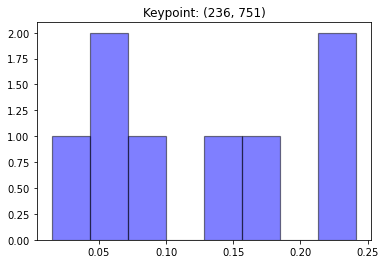

[0.04578543 0.01492892 0.08212261 0.16776847 0.24146078 0.24146078
 0.15267867 0.05379434]


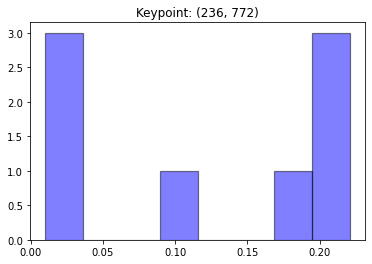

[0.01485586 0.02208035 0.09697693 0.19315979 0.22087591 0.22087591
 0.22087591 0.01029933]


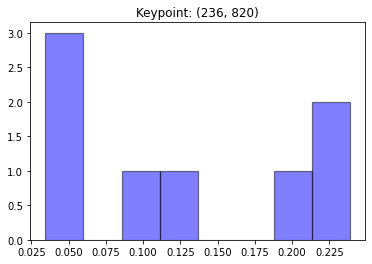

[0.23876222 0.19333789 0.23876222 0.09057005 0.04162203 0.03444257
 0.04643007 0.11607294]


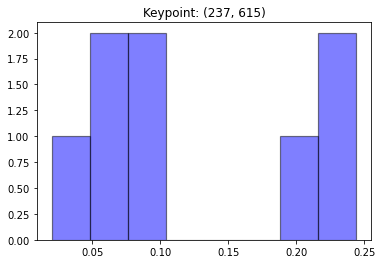

[0.04831319 0.07825802 0.02025056 0.07332097 0.08562742 0.24397976
 0.24397976 0.2062703 ]


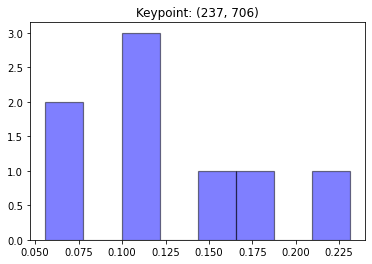

[0.06578548 0.23107943 0.10969292 0.18420029 0.10937701 0.10019104
 0.05586699 0.14380684]


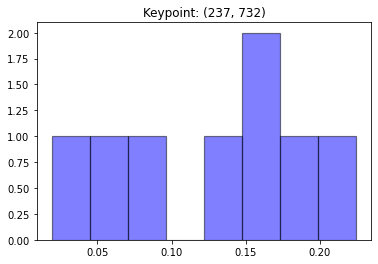

[0.01918933 0.05980527 0.1511712  0.13234852 0.22462699 0.17764899
 0.15499819 0.08021151]


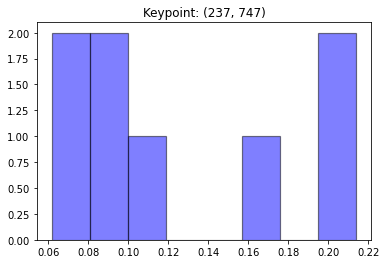

[0.20318764 0.0711404  0.0815544  0.09504449 0.21390721 0.15723249
 0.11623142 0.06170194]


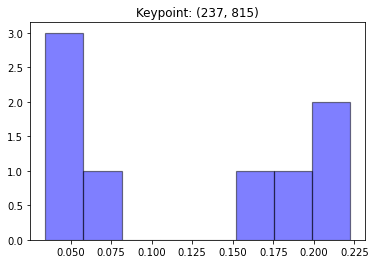

[0.22210602 0.05197135 0.05372332 0.16280086 0.03449136 0.07662577
 0.21138572 0.18689561]


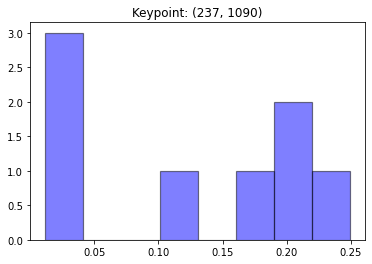

[0.01208872 0.11417539 0.24906212 0.21301415 0.19108363 0.1709906
 0.02392095 0.02566443]


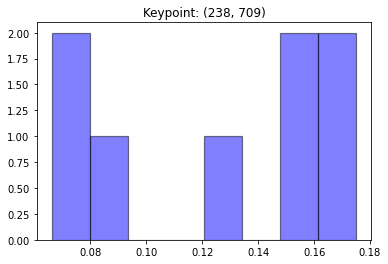

[0.0662502  0.15188643 0.08133119 0.13390498 0.17174894 0.17504097
 0.0682049  0.15163238]


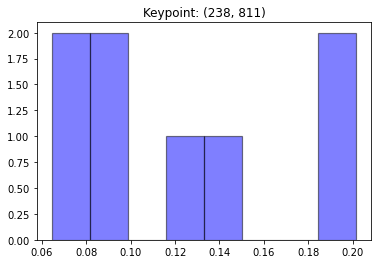

[0.14940407 0.06442732 0.09807308 0.20159129 0.0942428  0.07283099
 0.20159129 0.11783918]


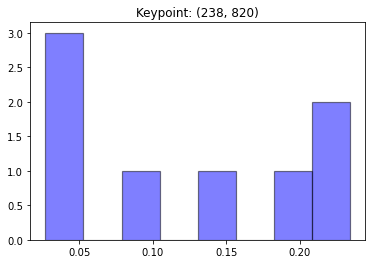

[0.23385349 0.19395712 0.23385349 0.14505308 0.0290175  0.02695706
 0.0348895  0.10241875]


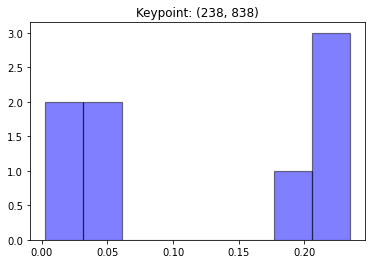

[0.00273563 0.00318348 0.0437956  0.23457384 0.23457384 0.22784972
 0.2010968  0.0521911 ]


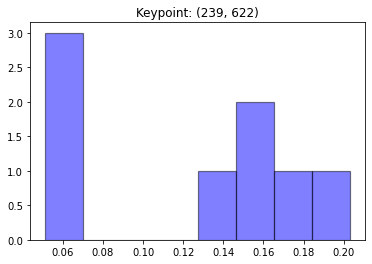

[0.06787819 0.1546821  0.20303421 0.17358495 0.15478165 0.05127898
 0.0518211  0.14293882]


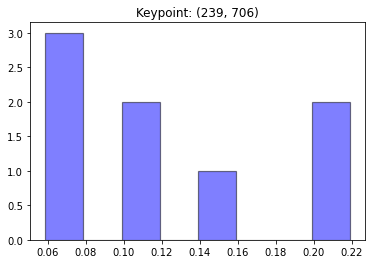

[0.06924426 0.21901986 0.10531756 0.21901986 0.05884561 0.10805833
 0.06537971 0.15511481]


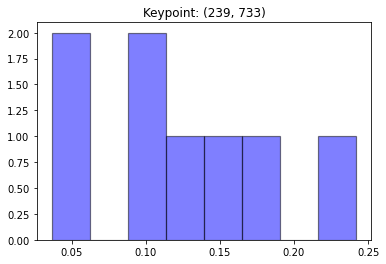

[0.04582588 0.03661217 0.15624883 0.13436122 0.24193864 0.17432823
 0.11064301 0.10004201]


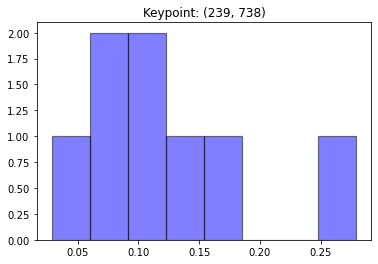

[0.09385042 0.02873566 0.06781708 0.14745547 0.27925171 0.17860105
 0.11505537 0.08923324]


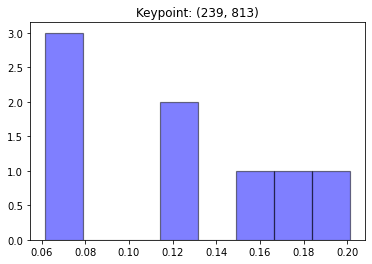

[0.20120182 0.07409449 0.12800139 0.17318869 0.0739802  0.0616519
 0.15796192 0.1299196 ]


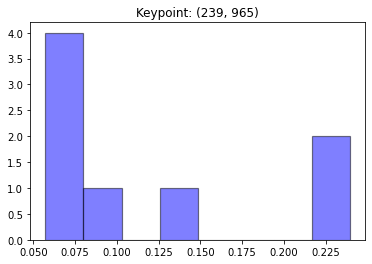

[0.14135331 0.10105383 0.23952635 0.23952635 0.07453325 0.05725786
 0.06920559 0.07754347]


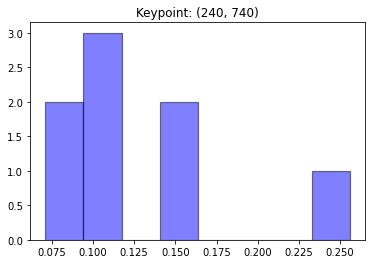

[0.0972604  0.0711952  0.08755273 0.1496785  0.25580781 0.14370774
 0.09443754 0.10036008]


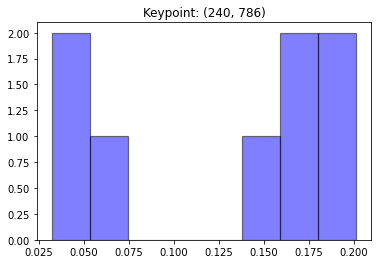

[0.03208369 0.03528551 0.20139344 0.15087539 0.17910498 0.16228079
 0.18102296 0.05795324]


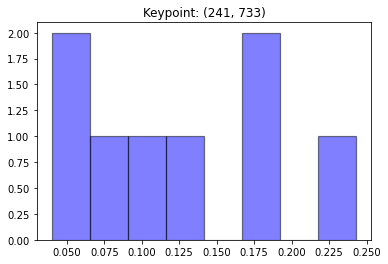

[0.04662738 0.03997481 0.16776942 0.14109831 0.24303024 0.17010779
 0.10931802 0.08207404]


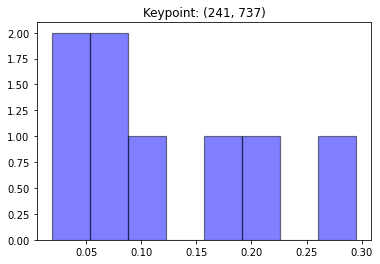

[0.04372109 0.0187762  0.06888351 0.17713153 0.29503541 0.20789345
 0.10775941 0.0807994 ]


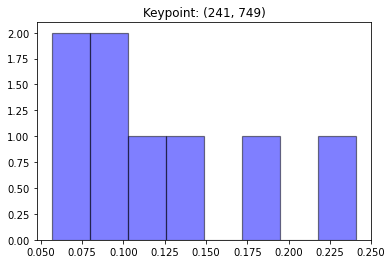

[0.05670595 0.08733531 0.08590952 0.14497333 0.24087326 0.18754762
 0.11717377 0.07948124]


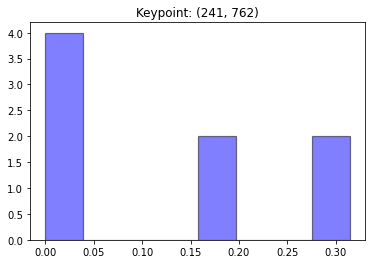

[0.00374575 0.         0.0036498  0.01610637 0.18425677 0.31459975
 0.31459975 0.16304181]


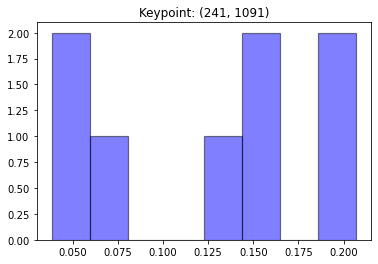

[0.03840654 0.20694638 0.13784915 0.14837543 0.15319953 0.20694638
 0.06196292 0.04631366]


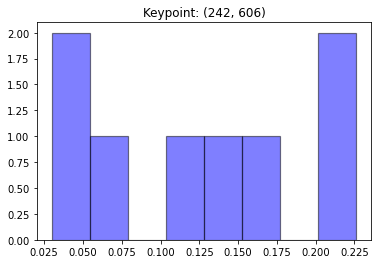

[0.02992435 0.03918301 0.13912711 0.16556784 0.06712437 0.22612569
 0.22612569 0.10682194]


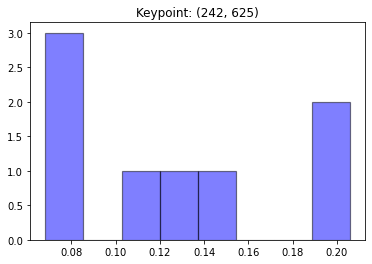

[0.0682905  0.19353867 0.14424375 0.1054916  0.12104521 0.20582308
 0.07651756 0.08504962]


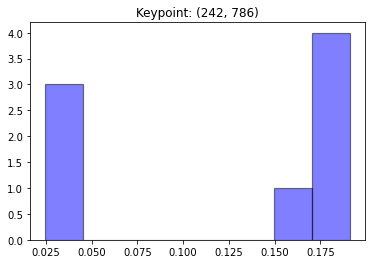

[0.02471552 0.02848909 0.18959116 0.18924063 0.16058878 0.17747229
 0.19114482 0.0387577 ]


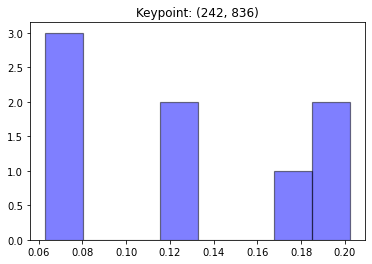

[0.06308491 0.11688489 0.064231   0.06856489 0.16747035 0.190068
 0.20218034 0.12751561]


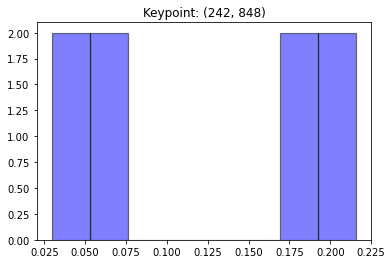

[0.07094348 0.18817628 0.2157842  0.2157842  0.19213138 0.05601463
 0.02959453 0.03157128]


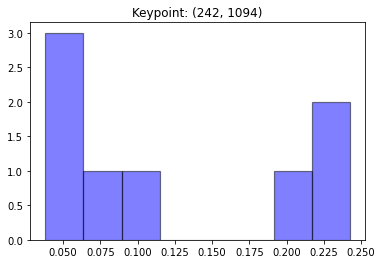

[0.03806339 0.23673155 0.11429429 0.06610873 0.21323971 0.24242732
 0.04930612 0.03982888]


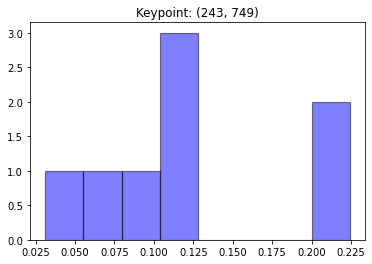

[0.03123823 0.07125538 0.09503908 0.1275477  0.22414642 0.1146961
 0.22414642 0.11193067]


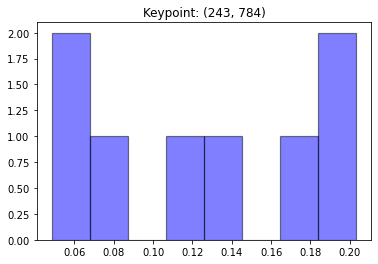

[0.04849432 0.05249929 0.13770468 0.11661129 0.18967077 0.17963991
 0.2032122  0.07216753]


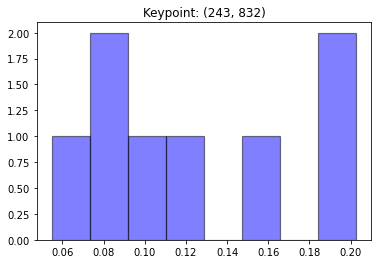

[0.05480498 0.12730578 0.20268914 0.20268914 0.0993537  0.08077111
 0.15358176 0.07880439]


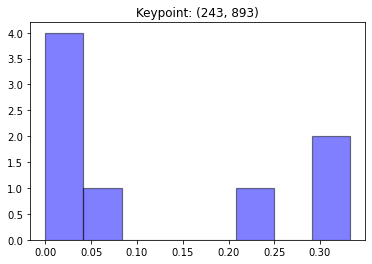

[0.00084264 0.         0.01988576 0.06780239 0.33246419 0.24374453
 0.33246419 0.00279631]


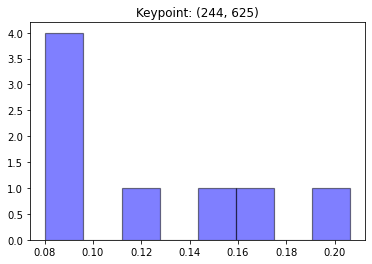

[0.0900007  0.16065967 0.09095463 0.124942   0.15398083 0.2063006
 0.08033007 0.0928315 ]


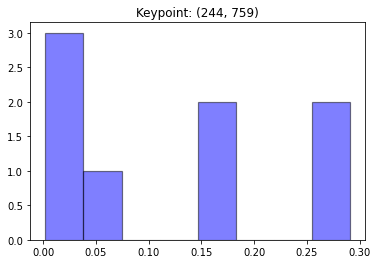

[0.0119931  0.05206004 0.00202506 0.031845   0.16844109 0.29076735
 0.29076735 0.15210103]


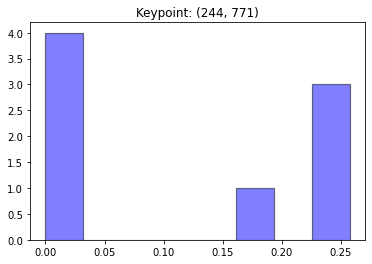

[0.02579351 0.01292519 0.00544202 0.         0.2575572  0.2575572
 0.2575572  0.1831677 ]


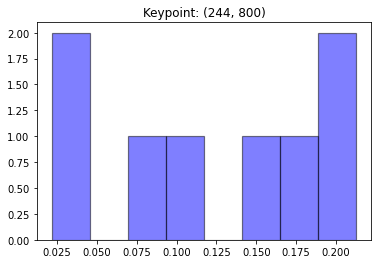

[0.21252847 0.02188628 0.17370713 0.15105587 0.04253722 0.11240151
 0.07335505 0.21252847]


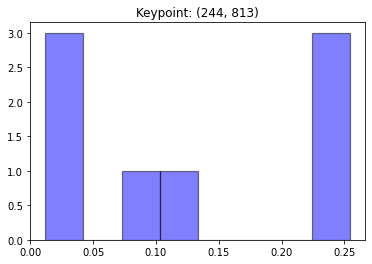

[0.12318232 0.23665237 0.25426236 0.25282745 0.07820742 0.01193529
 0.03017993 0.01275286]


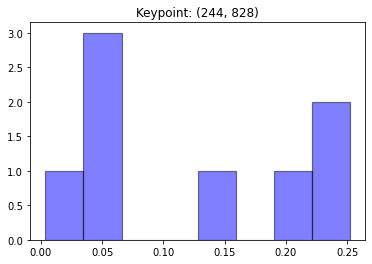

[0.05819476 0.15389708 0.25210328 0.25210328 0.19723044 0.00377483
 0.04388291 0.03881342]


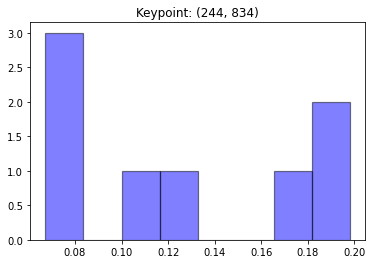

[0.0684359  0.16994156 0.19797563 0.08240977 0.06734373 0.11968484
 0.18457424 0.10963434]


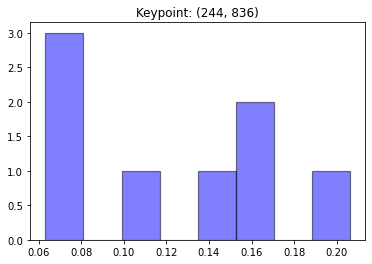

[0.07475962 0.16590066 0.07923686 0.06310523 0.10508838 0.160005
 0.20614729 0.14575696]


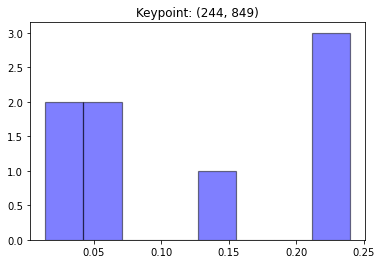

[0.04629895 0.14224531 0.23950019 0.23950019 0.23950019 0.04735279
 0.03149882 0.01410357]


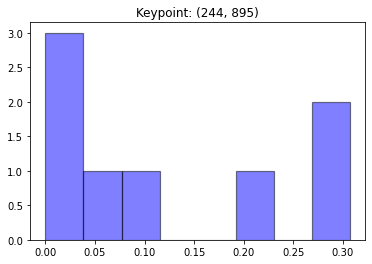

[0.         0.01097853 0.06767313 0.08461525 0.30688842 0.21932248
 0.30688842 0.00363377]


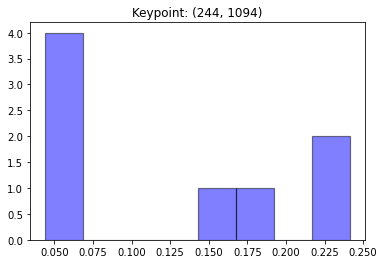

[0.05158377 0.24137871 0.16766919 0.0593494  0.14850841 0.24137871
 0.04416883 0.04596299]


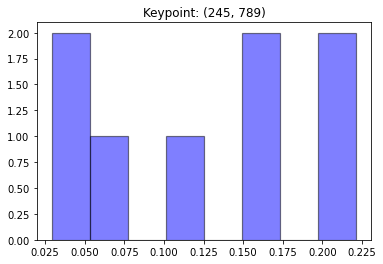

[0.06244549 0.02919379 0.22134892 0.10680538 0.04650908 0.15608269
 0.22134892 0.15626573]


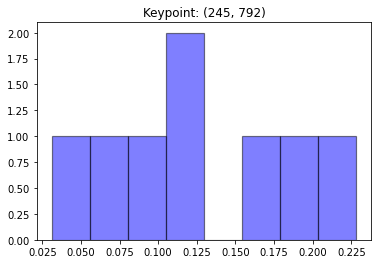

[0.09914407 0.0310876  0.22811675 0.12019015 0.06252822 0.18726918
 0.1075298  0.16413424]


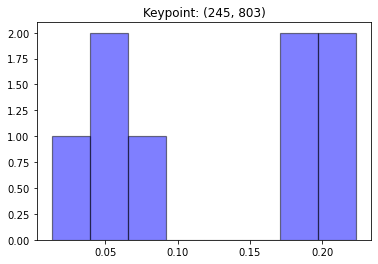

[0.19636389 0.01286477 0.22347903 0.22347903 0.041802   0.06661153
 0.0485013  0.18689845]


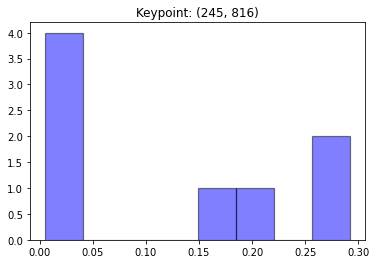

[0.18823459 0.29183057 0.29183057 0.17485774 0.02573013 0.01192446
 0.00545513 0.01013681]


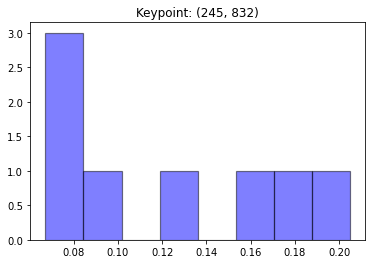

[0.08338241 0.18155618 0.20474574 0.13036848 0.06728025 0.07704287
 0.15452941 0.10109466]


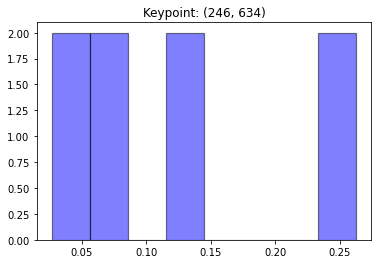

[0.06566982 0.02699955 0.04926222 0.14162205 0.26247179 0.26247179
 0.07433079 0.11717199]


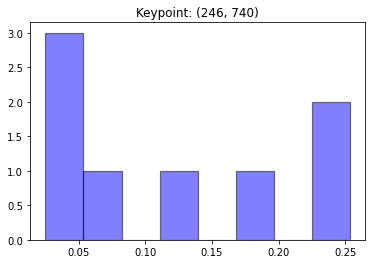

[0.05949931 0.04938572 0.02485225 0.0529607  0.25353966 0.25353966
 0.12920678 0.17701592]


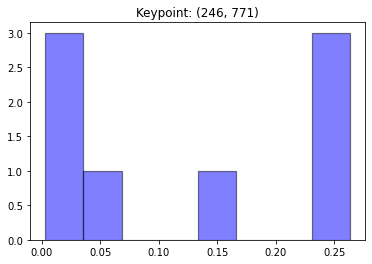

[0.04072984 0.0129456  0.00545061 0.00295807 0.14831071 0.26320172
 0.26320172 0.26320172]


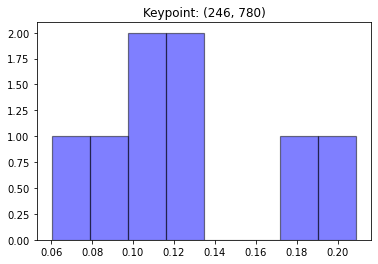

[0.08783673 0.12223076 0.06034706 0.11030779 0.20886485 0.11671822
 0.18283083 0.11086376]


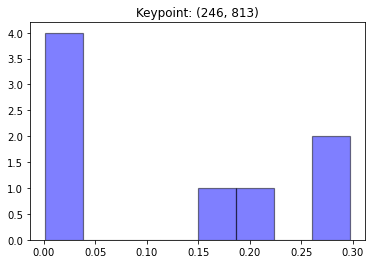

[0.15654452 0.29730382 0.29730382 0.21022237 0.03095442 0.0042385
 0.00135947 0.00207308]


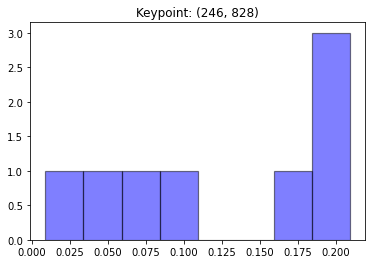

[0.08686828 0.17398063 0.20609179 0.20894926 0.19064394 0.00901005
 0.0584647  0.06599136]


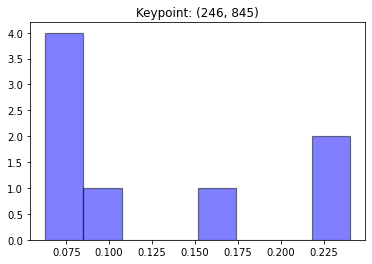

[0.07419533 0.09261826 0.15538304 0.2403142  0.2403142  0.06478641
 0.06953506 0.0628535 ]


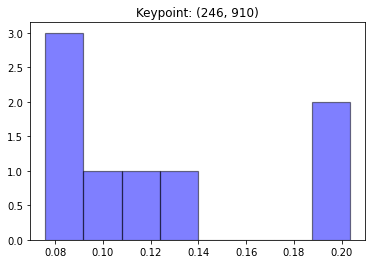

[0.20336713 0.07589111 0.07866687 0.1201771  0.08233371 0.13237241
 0.10382455 0.20336713]


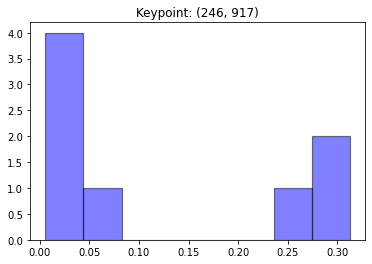

[0.31245793 0.06363967 0.01353588 0.00577218 0.01220173 0.04061035
 0.23932432 0.31245793]


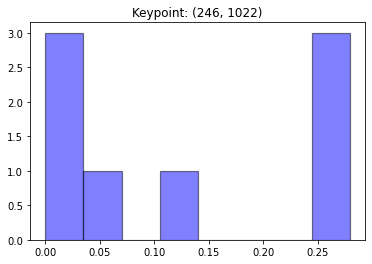

[0.         0.00193677 0.11953884 0.27919215 0.27919215 0.27919215
 0.03754654 0.00340141]


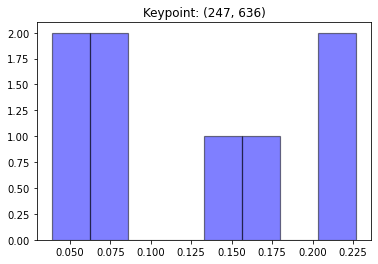

[0.07255309 0.04134042 0.03885849 0.15485423 0.22686346 0.16495415
 0.08033568 0.22024049]


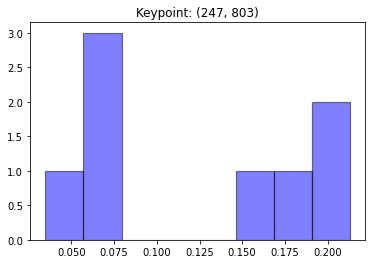

[0.16675029 0.03474244 0.21299938 0.21299938 0.06293355 0.07722839
 0.06289188 0.1694547 ]


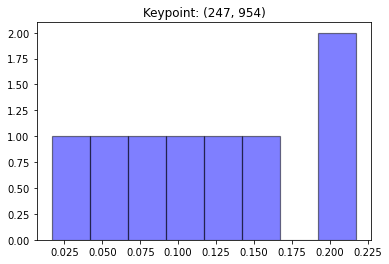

[0.21737409 0.01665804 0.12228174 0.16161119 0.11648069 0.08461828
 0.06360189 0.21737409]


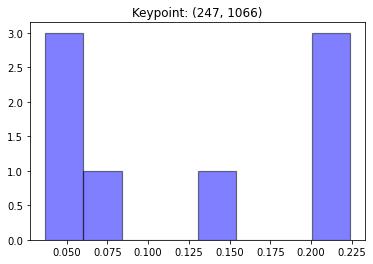

[0.06508499 0.21036222 0.22380961 0.22380961 0.13883067 0.05438972
 0.04682913 0.03688405]


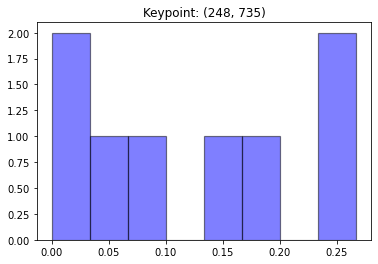

[0.03682753 0.02239371 0.14348087 0.18723501 0.26722508 0.26722508
 0.07561272 0.        ]


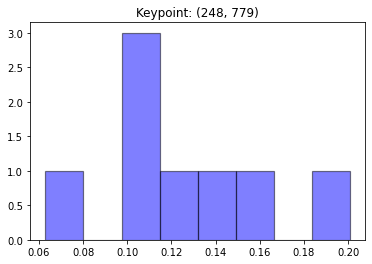

[0.11600747 0.13337153 0.06292977 0.11027382 0.20074235 0.15217534
 0.11183216 0.11266757]


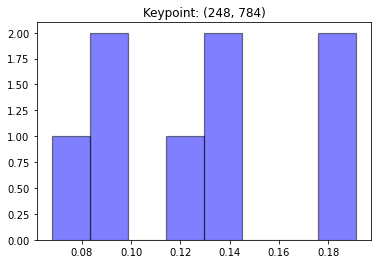

[0.08323468 0.08348193 0.06771358 0.11664184 0.19137643 0.18059587
 0.13949409 0.13746157]


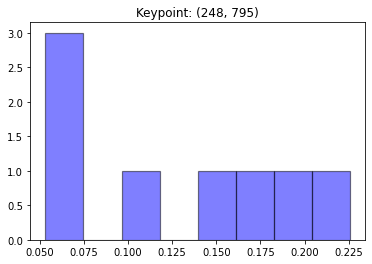

[0.16688619 0.09991747 0.22558589 0.07371257 0.05475865 0.14230254
 0.05317158 0.1836651 ]


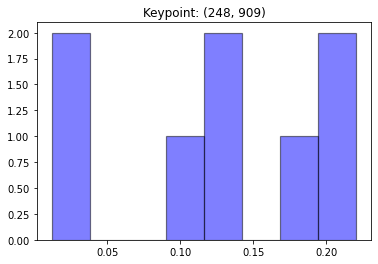

[0.22040168 0.11729325 0.11830565 0.18470524 0.1135273  0.01342137
 0.01194384 0.22040168]


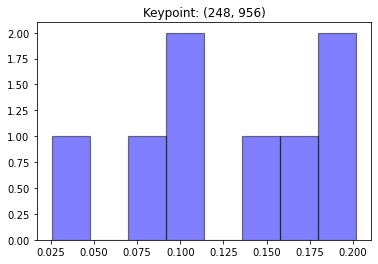

[0.19517131 0.02552698 0.06973268 0.16269346 0.14937539 0.09831724
 0.097269   0.20191394]


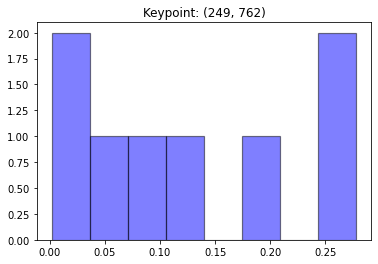

[0.10718422 0.05134965 0.00197853 0.01134741 0.08055421 0.27779647
 0.27779647 0.19199303]


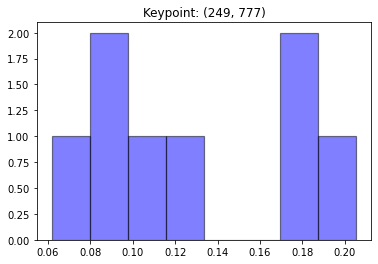

[0.08883322 0.08187656 0.06190431 0.09917436 0.17349028 0.20534441
 0.17069347 0.11868339]


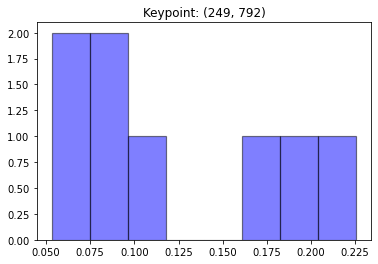

[0.08803388 0.05324298 0.22551431 0.09360132 0.07316709 0.19656995
 0.10284619 0.16702428]


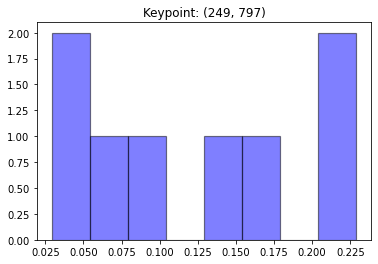

[0.16733179 0.14066995 0.22880151 0.03166452 0.02923583 0.09844035
 0.07505454 0.22880151]


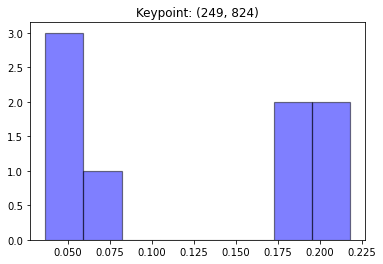

[0.18887771 0.21795041 0.03674629 0.17487487 0.21795041 0.04827169
 0.04430281 0.07102581]


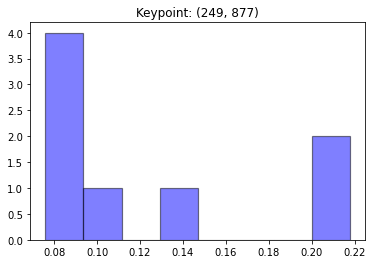

[0.2177202  0.13198008 0.10879564 0.08457642 0.08857019 0.07803129
 0.07591062 0.21441557]


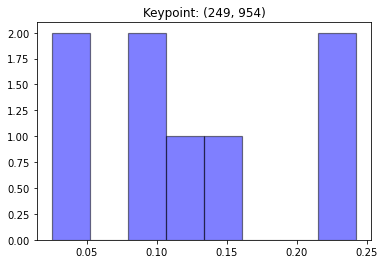

[0.2422423  0.02970323 0.02493324 0.12421637 0.14422254 0.10509723
 0.08734278 0.2422423 ]


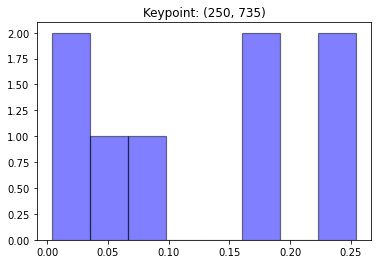

[0.03894422 0.02503395 0.16057279 0.17807273 0.25424343 0.25424343
 0.08502478 0.00386468]


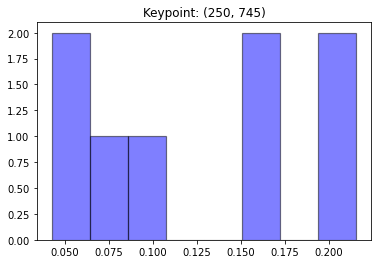

[0.04260983 0.04361225 0.15217368 0.09252767 0.21527051 0.21527051
 0.07135873 0.16717683]


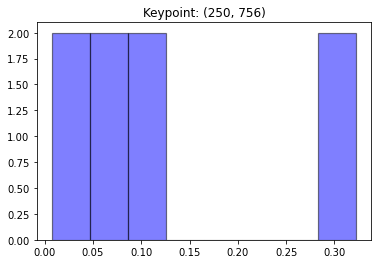

[0.10598651 0.051593   0.00736611 0.02069868 0.10718981 0.32250966
 0.32250966 0.06214658]


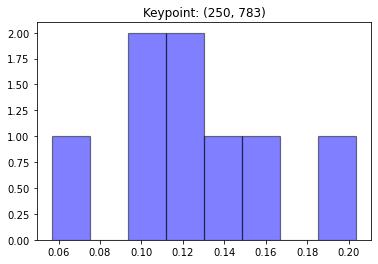

[0.0952972  0.13217166 0.05672539 0.11175532 0.11247042 0.20367952
 0.15890901 0.12899147]


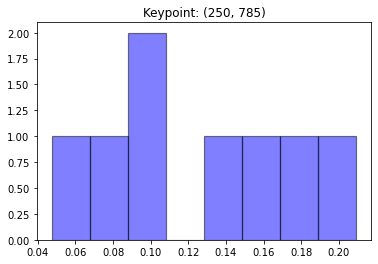

[0.09070746 0.07679513 0.04744001 0.10292662 0.14756845 0.20917898
 0.17646508 0.14891826]


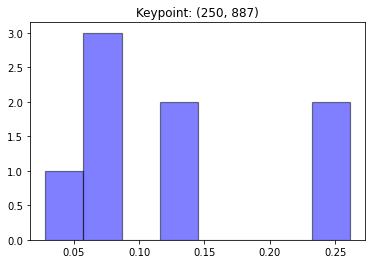

[0.06383921 0.0282422  0.07873035 0.13448472 0.0780337  0.12038584
 0.26126561 0.23501838]


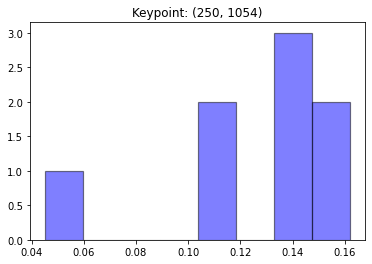

[0.1361109  0.15274773 0.13635848 0.11449826 0.16188038 0.04529719
 0.10955813 0.14354894]


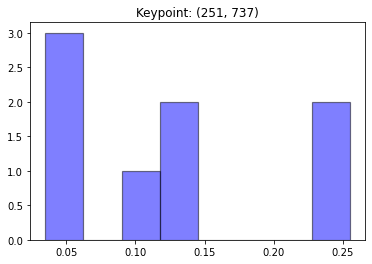

[0.03937055 0.03899691 0.12100944 0.14206765 0.2549781  0.2549781
 0.11372813 0.03487111]


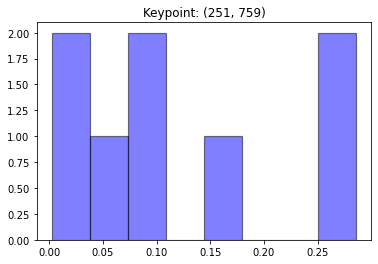

[0.10476095 0.0536201  0.00239995 0.01637148 0.07691098 0.28574809
 0.28574809 0.17444035]


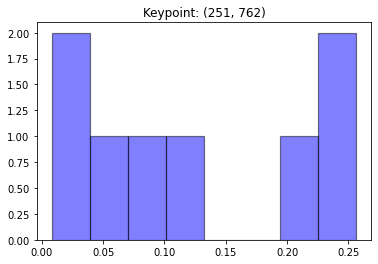

[0.11352899 0.05783805 0.00814059 0.01528486 0.08617303 0.25627972
 0.25627972 0.20647505]


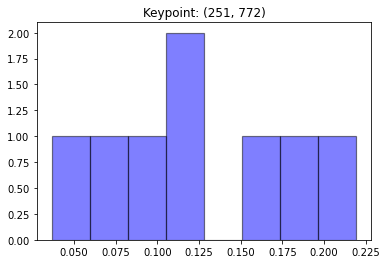

[0.10148452 0.03657075 0.06899231 0.11006684 0.11125642 0.18171415
 0.2193658  0.17054921]


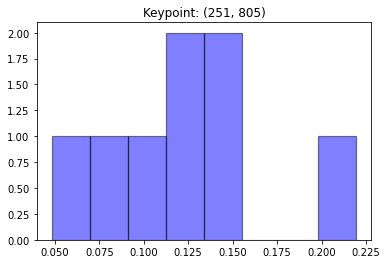

[0.10918927 0.04827169 0.14704056 0.2194554  0.08586746 0.12575062
 0.11469117 0.14973384]


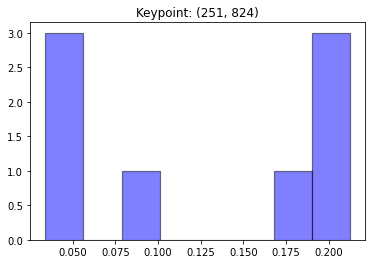

[0.19158988 0.21238368 0.0339722  0.18387382 0.21238368 0.04058418
 0.04456439 0.08064817]


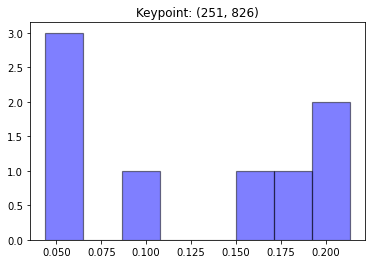

[0.21347588 0.15416636 0.04387476 0.18129533 0.21347588 0.0507057
 0.05204903 0.09095706]


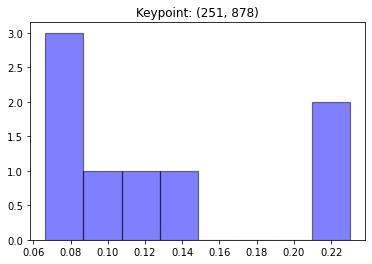

[0.23004518 0.1312543  0.10995408 0.07737275 0.08810382 0.06671364
 0.06651105 0.23004518]


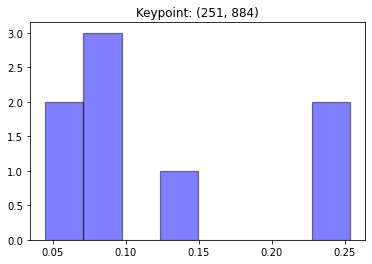

[0.13108551 0.04483441 0.05856518 0.09466494 0.08188791 0.08189494
 0.25353355 0.25353355]


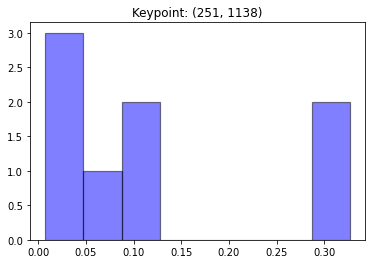

[0.02383573 0.06218687 0.0076653  0.0376664  0.09983715 0.32662432
 0.32662432 0.11555991]


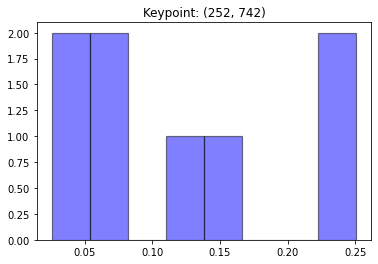

[0.0347136  0.02558851 0.12894796 0.07587    0.25079818 0.25079818
 0.07478318 0.15850038]


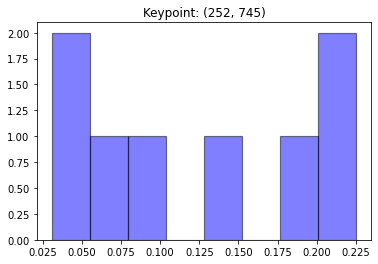

[0.03077516 0.03540912 0.1812523  0.08828732 0.22520554 0.22520554
 0.07067181 0.14319322]


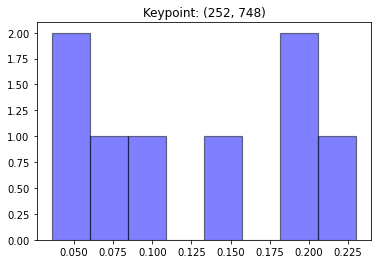

[0.0417884  0.0358425  0.18413957 0.08902398 0.0751583  0.23018348
 0.15189931 0.19196446]


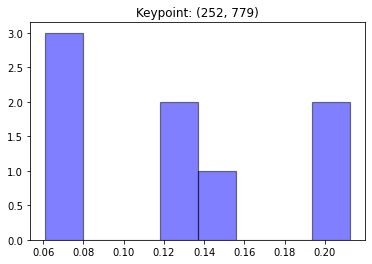

[0.1404877  0.13021278 0.06115729 0.06220372 0.06245741 0.21228169
 0.21228169 0.1189177 ]


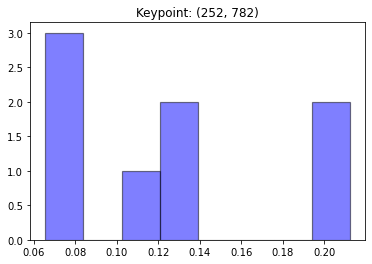

[0.10389224 0.1387565  0.06560876 0.06773184 0.06625289 0.21234966
 0.20798621 0.13742191]


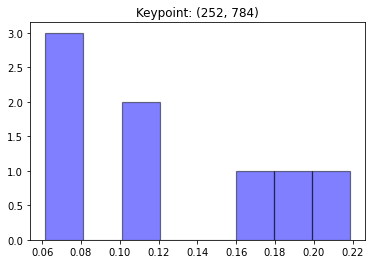

[0.11404147 0.10745402 0.0616932  0.07295035 0.07514906 0.21858713
 0.18091272 0.16921204]


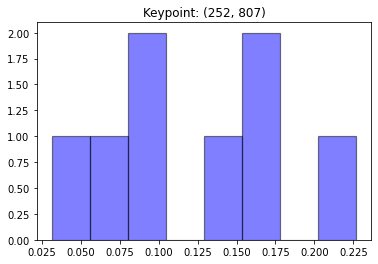

[0.03121977 0.07368956 0.1535352  0.22686667 0.10322515 0.15752661
 0.15040745 0.1035296 ]


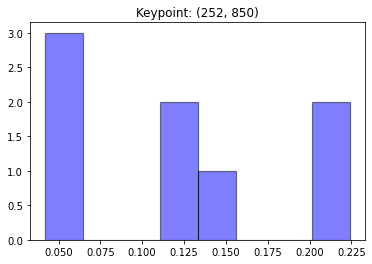

[0.14964447 0.05590323 0.11900814 0.22406901 0.22406901 0.12722253
 0.05792171 0.04216191]


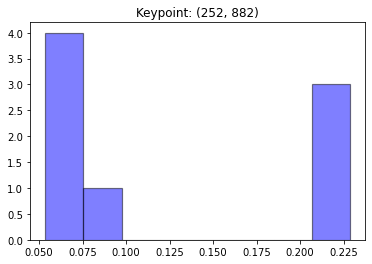

[0.22860125 0.05368754 0.06603391 0.07820855 0.06085446 0.05541179
 0.22860125 0.22860125]


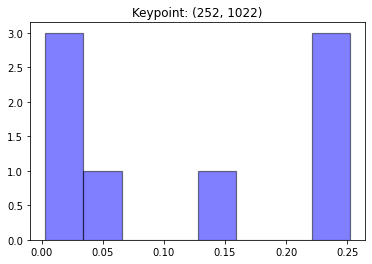

[0.01914467 0.1560631  0.24352101 0.25211015 0.25211015 0.04596215
 0.02812376 0.002965  ]


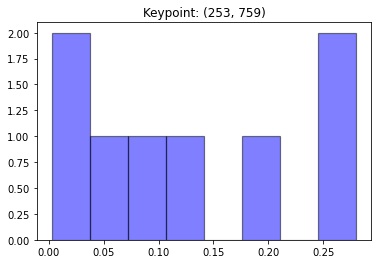

[0.11187962 0.05431918 0.00258115 0.00986134 0.07620797 0.28005553
 0.28005553 0.18503967]


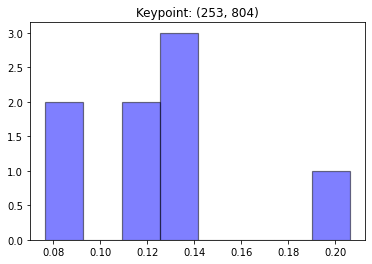

[0.07660454 0.11025885 0.12714235 0.20612894 0.09148865 0.14130302
 0.13445526 0.1126184 ]


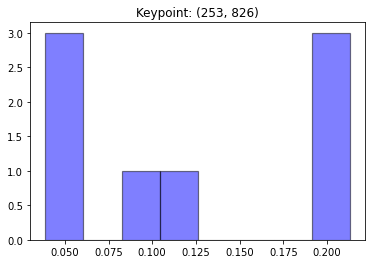

[0.2130717  0.12277914 0.03888275 0.2130717  0.2130717  0.0532847
 0.0534255  0.09241281]


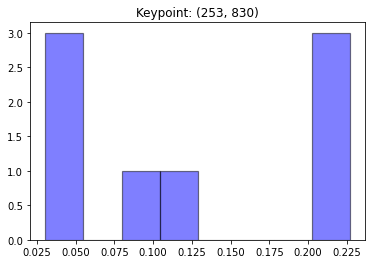

[0.09390779 0.22696553 0.12669599 0.22696553 0.21052611 0.05399433
 0.03055716 0.03038757]


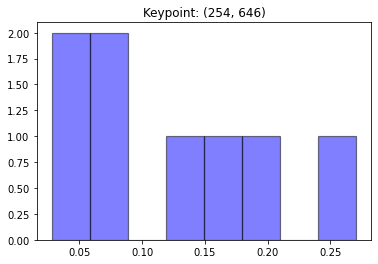

[0.1465783  0.02802598 0.06853901 0.04343741 0.07732929 0.17560485
 0.18994363 0.27054152]


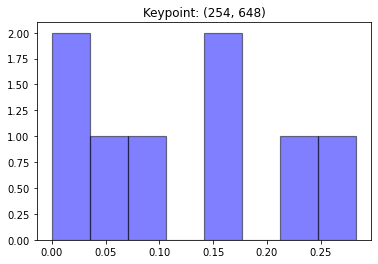

[0.14250777 0.         0.06208534 0.02879344 0.07826059 0.16818091
 0.23714405 0.28302789]


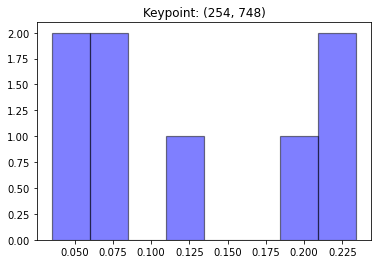

[0.04607873 0.03499386 0.19096227 0.07719995 0.12727454 0.23396269
 0.06852574 0.22100222]


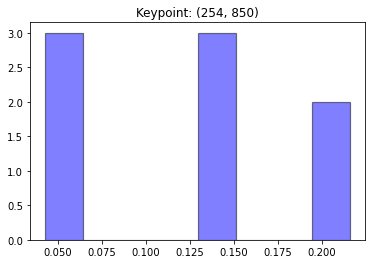

[0.14029849 0.06181934 0.14383777 0.21083195 0.21594856 0.13864106
 0.04572476 0.04289807]


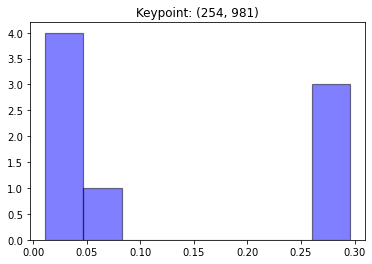

[0.01643941 0.29552493 0.29552493 0.29552493 0.05583562 0.0159633
 0.01132201 0.01386487]


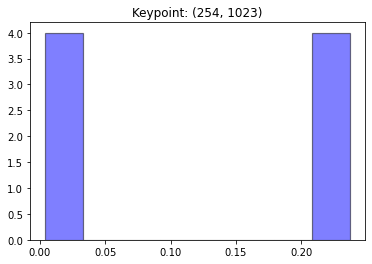

[0.033015   0.23705592 0.22298671 0.23705592 0.22454638 0.02972595
 0.01145051 0.00416361]


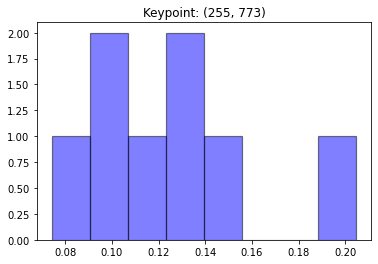

[0.12483999 0.07415238 0.09721653 0.11862596 0.10194302 0.15221382
 0.20472451 0.1262838 ]


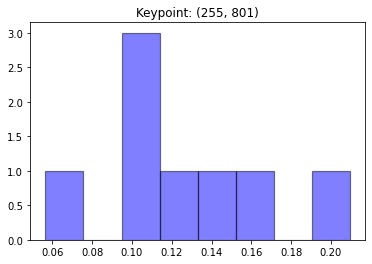

[0.05645921 0.15728679 0.20949985 0.09713704 0.10008656 0.12748968
 0.10310348 0.1489374 ]


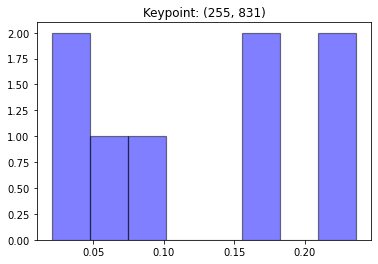

[0.08105609 0.23647535 0.17256398 0.23647535 0.16348776 0.05510624
 0.02058894 0.03424628]


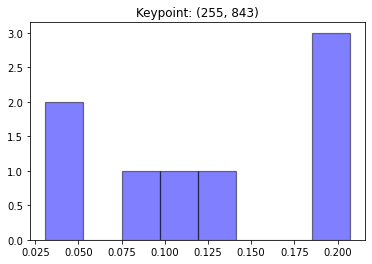

[0.1011616  0.0488863  0.20703097 0.20703097 0.19883316 0.12154128
 0.08463346 0.03088226]


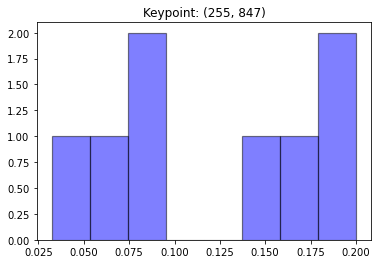

[0.1556585  0.0712085  0.20011498 0.17761733 0.1874862  0.08941869
 0.08613484 0.03236097]


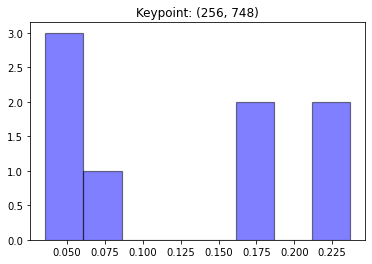

[0.04103405 0.04677055 0.18243521 0.0628778  0.17530542 0.23657445
 0.03568852 0.219314  ]


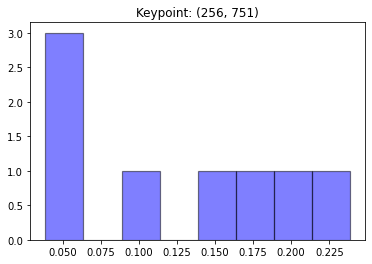

[0.03857448 0.03910589 0.1812345  0.06090757 0.09376925 0.23848445
 0.14865921 0.19926465]


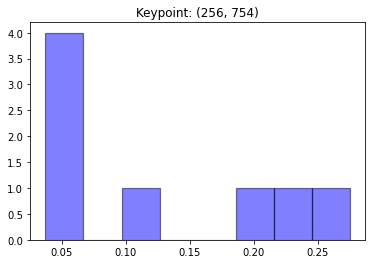

[0.04692981 0.03723608 0.05908126 0.04041664 0.12103843 0.27508844
 0.19603665 0.22417269]


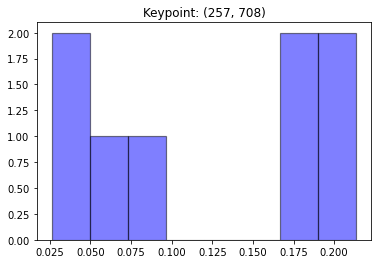

[0.17347997 0.18751138 0.21353193 0.21211413 0.02624688 0.05664026
 0.04897301 0.08150244]


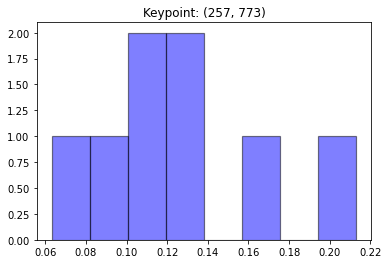

[0.15935109 0.09006955 0.11641215 0.12926674 0.12342837 0.06322745
 0.21296476 0.1052799 ]


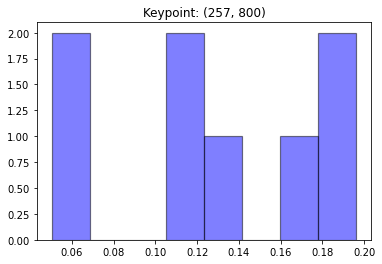

[0.0504598  0.16408288 0.18057713 0.05683862 0.12688494 0.1071879
 0.11781952 0.19614922]


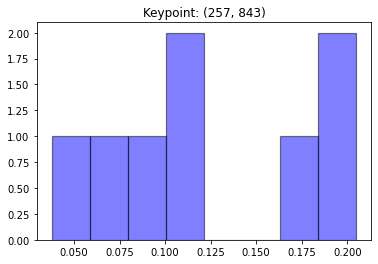

[0.11421002 0.07183131 0.20483511 0.17639035 0.20483511 0.10342735
 0.08664415 0.03782659]


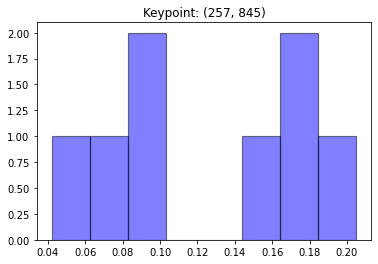

[0.15970688 0.07482694 0.20486509 0.16861443 0.16885137 0.09596848
 0.08507036 0.04209646]


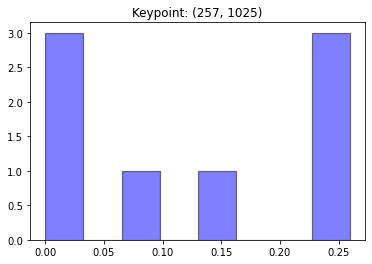

[0.07214223 0.25958901 0.25958901 0.25958901 0.13570855 0.0133822
 0.         0.        ]


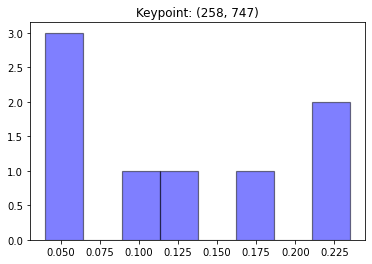

[0.04113408 0.04034053 0.12551497 0.0980215  0.23281865 0.23481092
 0.06285178 0.16450757]


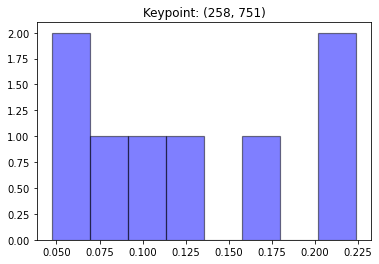

[0.04822421 0.047278   0.11991855 0.07653107 0.09602832 0.22397633
 0.16406718 0.22397633]


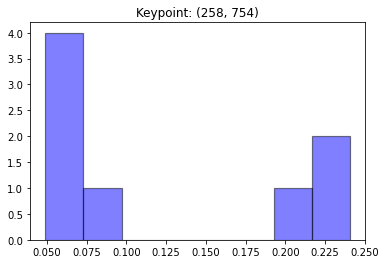

[0.055646   0.05768937 0.06904456 0.04897221 0.08026799 0.24052388
 0.20733211 0.24052388]


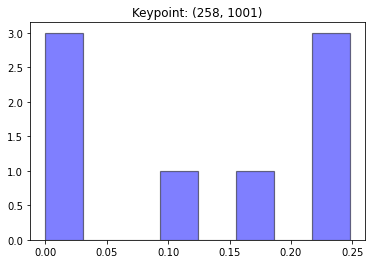

[0.         0.         0.         0.24783455 0.16155295 0.24783455
 0.24783455 0.09494338]


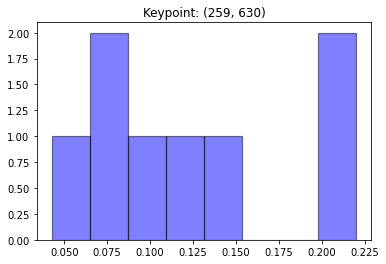

[0.04272602 0.12476792 0.06876145 0.07902857 0.21992867 0.21992867
 0.14257713 0.10228157]


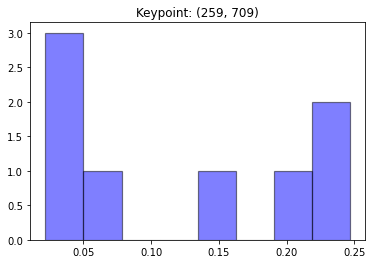

[0.14196054 0.20479044 0.24654309 0.24654309 0.02196056 0.03369882
 0.03100301 0.07350045]


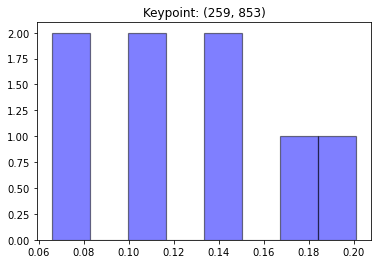

[0.2009322  0.10190818 0.10679132 0.13719428 0.17796245 0.14052118
 0.06893359 0.0657568 ]


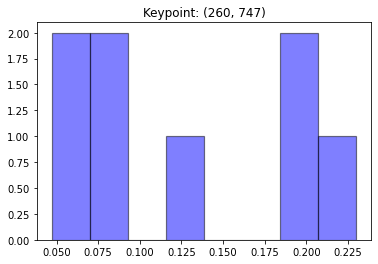

[0.04937642 0.04712587 0.1336727  0.09195825 0.18616064 0.2299748
 0.07540141 0.1863299 ]


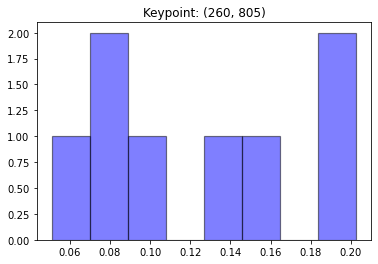

[0.13559493 0.1484028  0.08729768 0.07325913 0.05101104 0.09977397
 0.20266408 0.20199637]


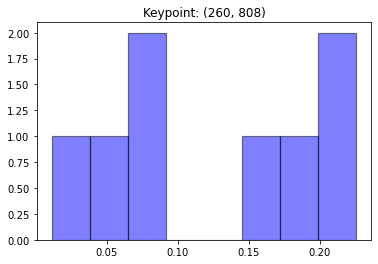

[0.16340795 0.22577827 0.08327986 0.05506487 0.0114241  0.0697807
 0.20898785 0.18227639]


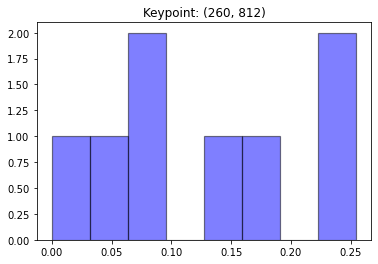

[0.15281745 0.25447121 0.25447121 0.07141939 0.         0.03947717
 0.15984766 0.0674959 ]


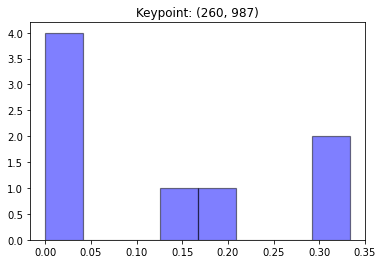

[0.20038768 0.33341562 0.33341562 0.13194429 0.         0.
 0.         0.00083678]


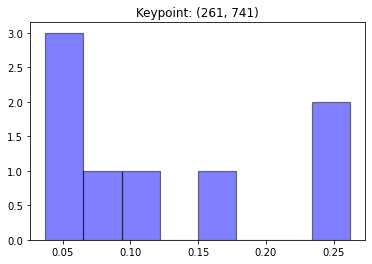

[0.05379505 0.06266383 0.10514252 0.15000683 0.26179743 0.26179743
 0.06741436 0.03738256]


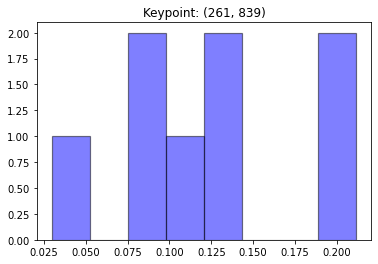

[0.09038391 0.0980977  0.21163998 0.13364197 0.21163998 0.13228289
 0.09269622 0.02961734]


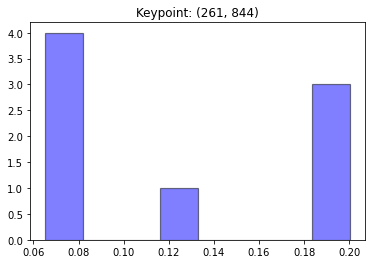

[0.11915646 0.08122827 0.19697007 0.20024012 0.19726133 0.06533144
 0.06718399 0.07262832]


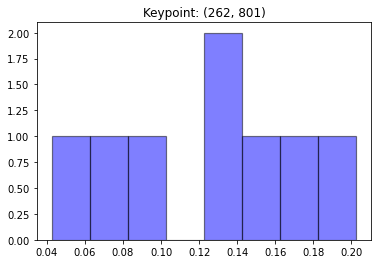

[0.04259769 0.08136625 0.13447726 0.14659231 0.20245766 0.1256952
 0.09696827 0.16984536]


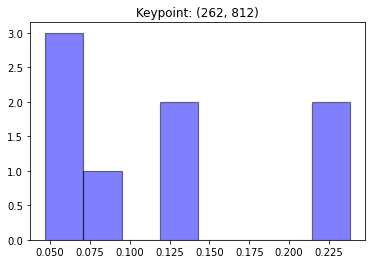

[0.1249925  0.23803027 0.23803027 0.08763176 0.07065145 0.06283038
 0.13078997 0.0470434 ]


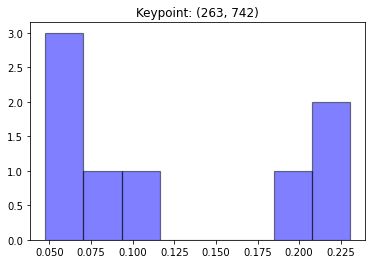

[0.06018773 0.04759119 0.09699546 0.19170494 0.23038731 0.23038731
 0.09096376 0.05178229]


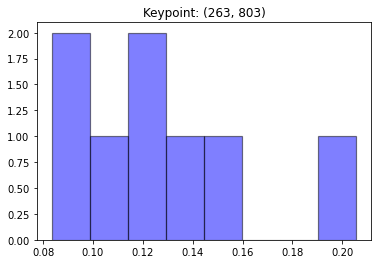

[0.11493247 0.12408621 0.08347016 0.10196031 0.20555652 0.12958354
 0.0880778  0.15233298]


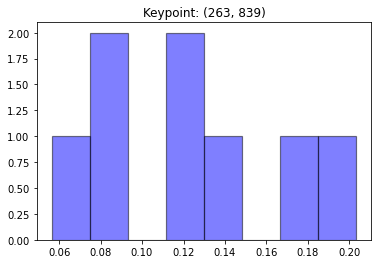

[0.09245163 0.08041118 0.17858338 0.12527653 0.20327085 0.11536874
 0.14817956 0.05645814]


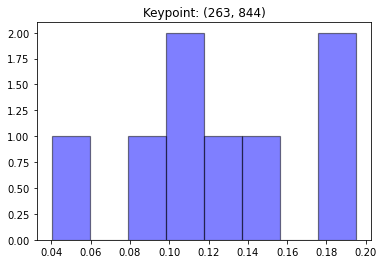

[0.12502584 0.10558485 0.19120216 0.14992853 0.19508296 0.04031386
 0.10331275 0.08954905]


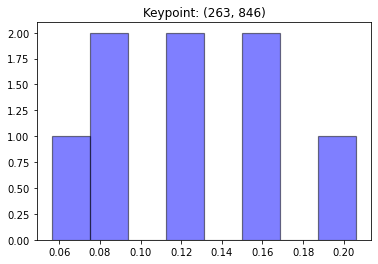

[0.12442928 0.12742003 0.16507916 0.15525518 0.20609757 0.05634847
 0.082167   0.08320331]


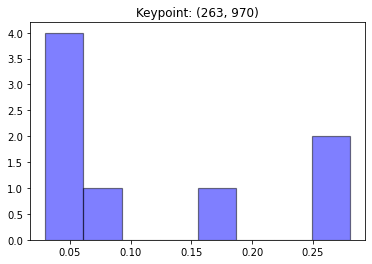

[0.04594414 0.08904087 0.28027758 0.28027758 0.18564696 0.05716963
 0.03172797 0.02991527]


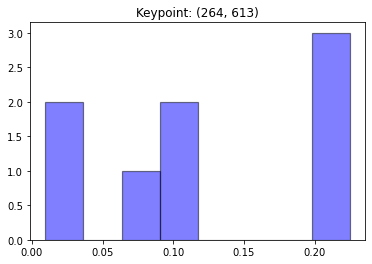

[0.11659557 0.02134368 0.00953055 0.08668909 0.09130648 0.22484487
 0.22484487 0.22484487]


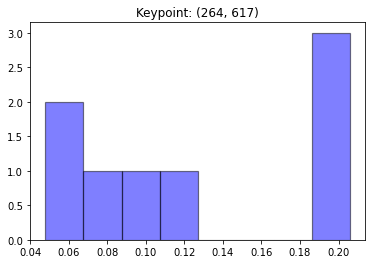

[0.12618597 0.05952649 0.04787965 0.19445693 0.18957942 0.08539699
 0.09116445 0.2058101 ]


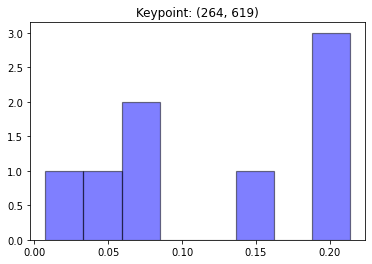

[0.15501727 0.07388381 0.05868575 0.21353215 0.21353215 0.0074264
 0.06439032 0.21353215]


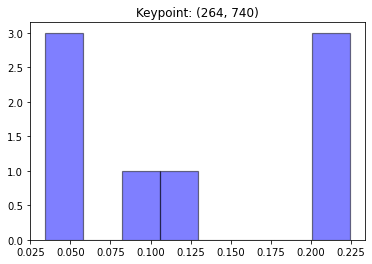

[0.05385106 0.03444261 0.08603723 0.21397953 0.22412536 0.22412536
 0.12248546 0.04095341]


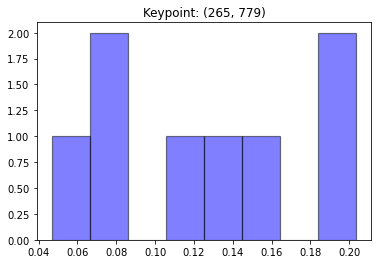

[0.11721982 0.14173933 0.20360302 0.19665438 0.04678209 0.07096377
 0.06641528 0.15662232]


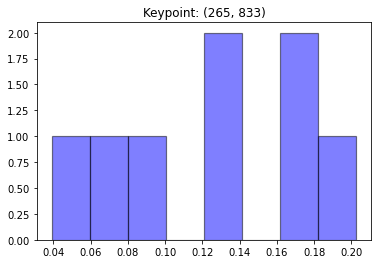

[0.07441101 0.1669873  0.08665013 0.16973027 0.20250141 0.13079582
 0.12983965 0.0390844 ]


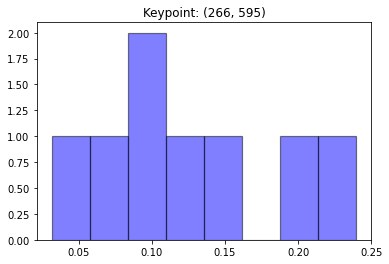

[0.06927611 0.03150286 0.08698665 0.08798207 0.13108273 0.23974239
 0.14705092 0.20637628]


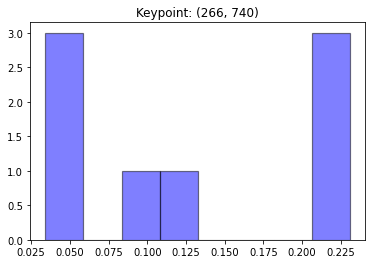

[0.05777581 0.03415676 0.08414208 0.21554336 0.22214967 0.23075041
 0.11278128 0.04270063]


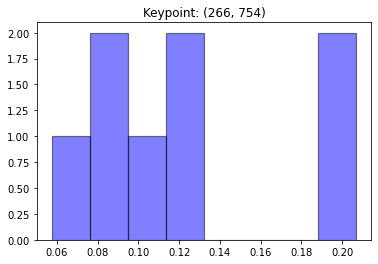

[0.0574811  0.08933998 0.07816724 0.11793313 0.1314575  0.2068421
 0.2068421  0.11193686]


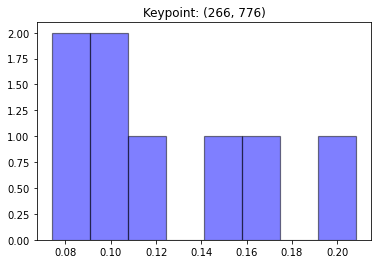

[0.12339871 0.10576361 0.14346893 0.20834686 0.07989387 0.0739553
 0.09469723 0.17047549]


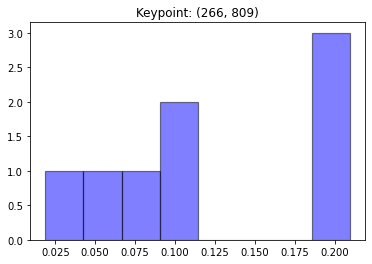

[0.20923242 0.20923242 0.20923242 0.01882662 0.06241914 0.08208292
 0.10508154 0.10389253]


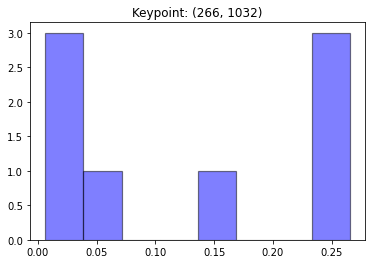

[0.14333572 0.26531615 0.26531615 0.26531615 0.03984287 0.00778994
 0.00668543 0.00639758]


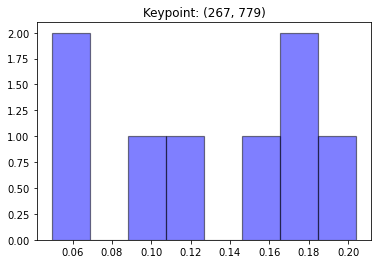

[0.11292996 0.16576089 0.20407518 0.17589698 0.04947259 0.05556829
 0.08983965 0.14645644]


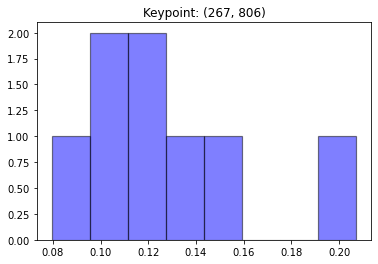

[0.20713601 0.13204045 0.14526074 0.07950359 0.09949928 0.11753854
 0.11342464 0.10559676]


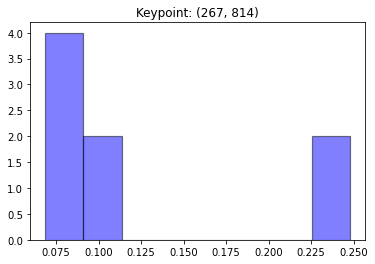

[0.07360254 0.2363368  0.24766087 0.11196234 0.11004002 0.07995913
 0.06877752 0.07166078]


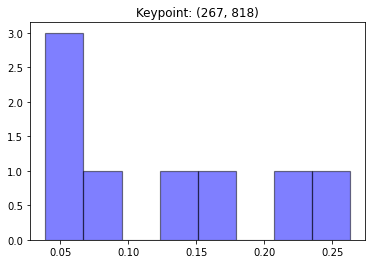

[0.05599425 0.21606167 0.26292586 0.15342747 0.12763578 0.08852391
 0.03907156 0.0563595 ]


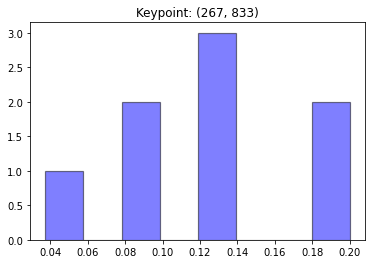

[0.0838214  0.19961635 0.12467428 0.09824634 0.20014035 0.12692666
 0.12926557 0.03730905]


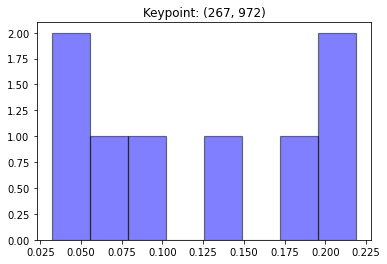

[0.09903829 0.13820832 0.21886386 0.21886386 0.18696987 0.06737846
 0.03206796 0.03860937]


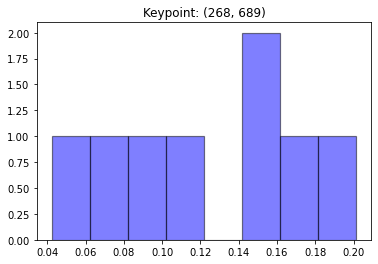

[0.16870129 0.15136884 0.11430258 0.06814243 0.04233193 0.09488719
 0.1589166  0.20134915]


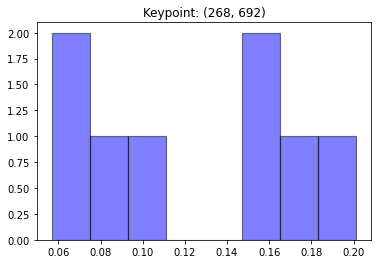

[0.17971717 0.15232508 0.09246451 0.05704012 0.05689865 0.10509456
 0.15521261 0.20124731]


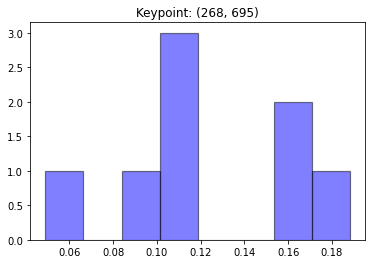

[0.18811113 0.11686089 0.04903563 0.11644764 0.09800237 0.11231857
 0.1569944  0.16222936]


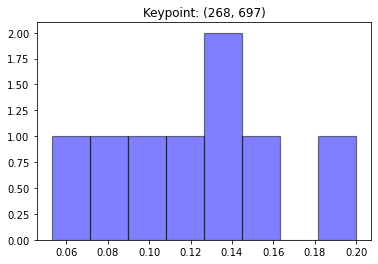

[0.20000284 0.11591688 0.05297772 0.1078321  0.13829637 0.08930143
 0.14042607 0.15524659]


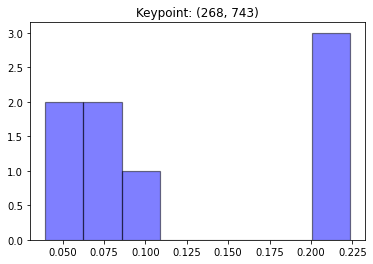

[0.05193213 0.06342992 0.08143355 0.22345955 0.22345955 0.22345955
 0.09323334 0.0395924 ]


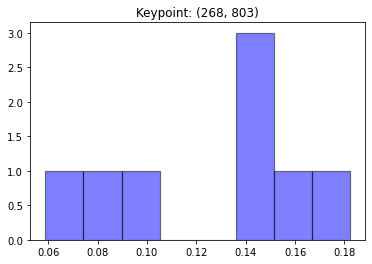

[0.18215778 0.07708037 0.14146357 0.14488783 0.15610217 0.14256827
 0.09689313 0.05884688]


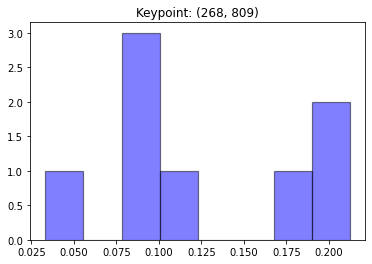

[0.19582774 0.18689138 0.21232529 0.03326848 0.0837229  0.11530419
 0.08855971 0.08410031]


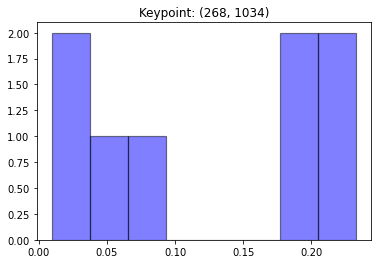

[0.18132441 0.23280541 0.23280541 0.19473579 0.07173621 0.00949152
 0.0136638  0.06343744]


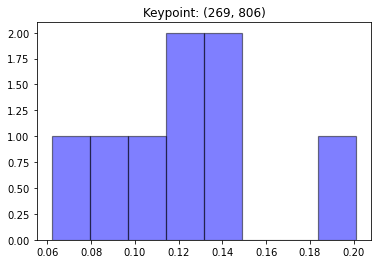

[0.20113195 0.12560717 0.14423648 0.06200366 0.10592974 0.14168957
 0.12323488 0.09616655]


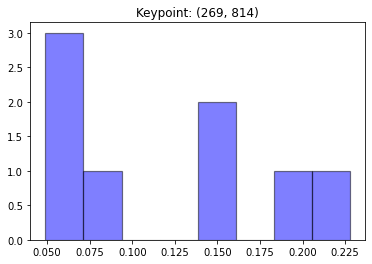

[0.07097199 0.19019608 0.22769966 0.146368   0.15883282 0.08703955
 0.04894973 0.06994218]


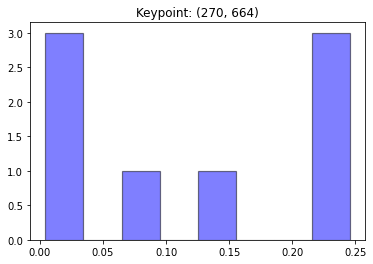

[0.00761628 0.00433319 0.01230577 0.08520685 0.24549209 0.15406164
 0.24549209 0.24549209]


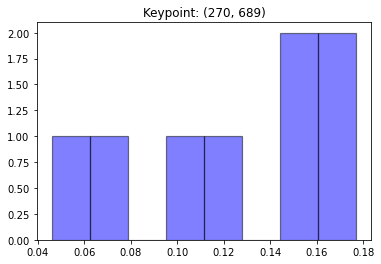

[0.17603454 0.15309639 0.1158581  0.07313672 0.04598691 0.10003714
 0.15886944 0.17698075]


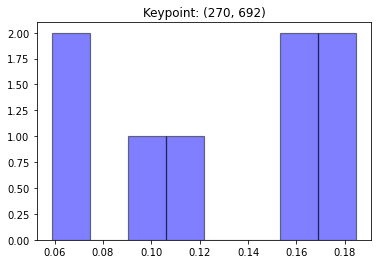

[0.1847111  0.15652489 0.09476842 0.063082   0.05880694 0.10861926
 0.15332381 0.18016359]


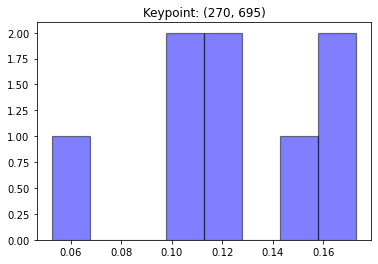

[0.1665886  0.12558241 0.05247996 0.17305324 0.09838174 0.11275336
 0.14991934 0.12124136]


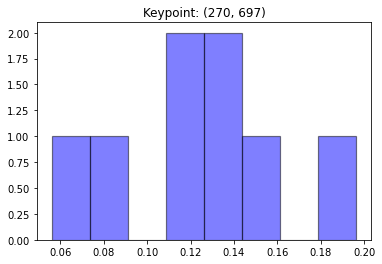

[0.15865042 0.1171877  0.05601423 0.19633442 0.13715512 0.08856449
 0.13106705 0.11502657]


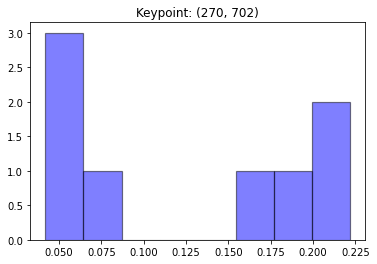

[0.07017913 0.2216284  0.18042406 0.2216284  0.17248273 0.04199511
 0.0427986  0.04886357]


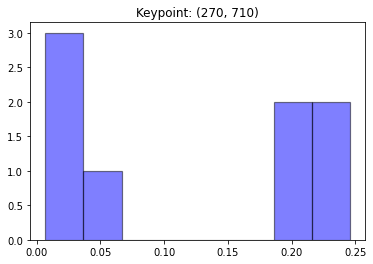

[0.02694482 0.19680338 0.195099   0.2456051  0.2456051  0.05159244
 0.00680404 0.03154611]


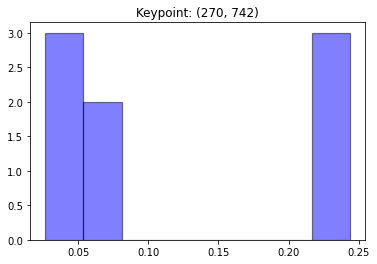

[0.02672934 0.05376935 0.06141531 0.24356012 0.24356012 0.24356012
 0.07934929 0.04805636]


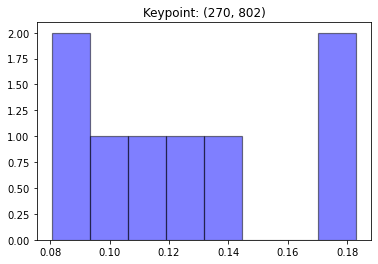

[0.18300409 0.08052808 0.13435146 0.12417297 0.10447356 0.1827671
 0.10656772 0.08413501]


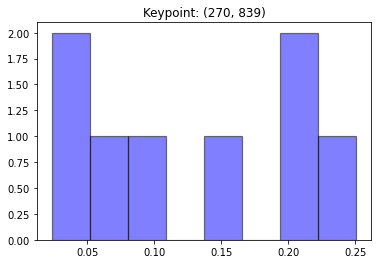

[0.0262716  0.02346237 0.19502781 0.25050782 0.21701819 0.09518609
 0.14008991 0.0524362 ]


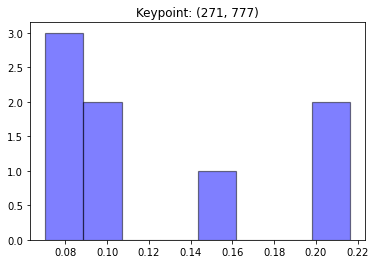

[0.07658007 0.1526528  0.21624299 0.21624299 0.07046024 0.07486442
 0.09934113 0.09361538]


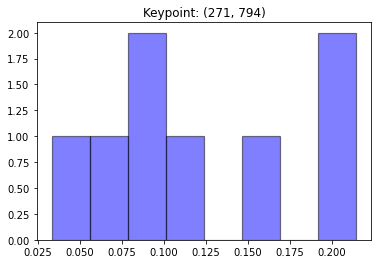

[0.1229791  0.07826785 0.08925973 0.15986013 0.03314539 0.08795563
 0.21426609 0.21426609]


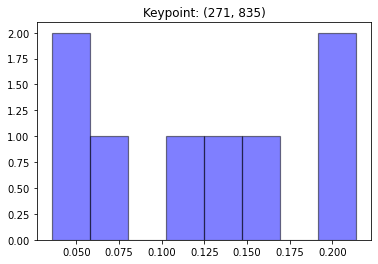

[0.06693105 0.14691181 0.21393623 0.21393623 0.15818994 0.04807733
 0.11642711 0.03559029]


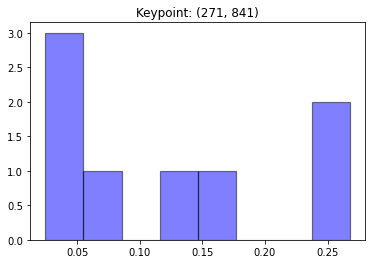

[0.02760955 0.02931335 0.17354964 0.26768372 0.26768372 0.06899865
 0.14063354 0.02452783]


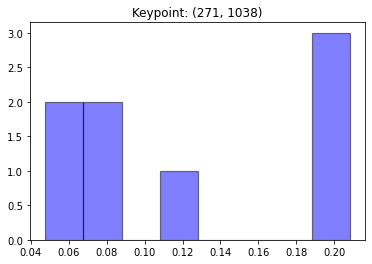

[0.20149417 0.20365503 0.06441699 0.08251431 0.20815014 0.04776162
 0.07539145 0.11661629]


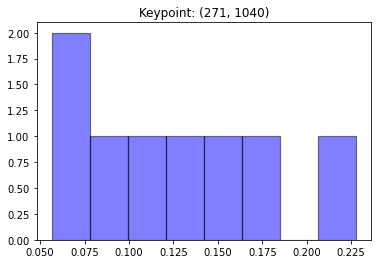

[0.14301527 0.16412216 0.05652929 0.09176657 0.22778307 0.06713453
 0.11162534 0.13802377]


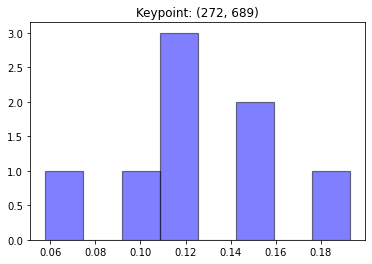

[0.15551215 0.19287024 0.14494516 0.09509745 0.05780918 0.11978022
 0.11155182 0.12243377]


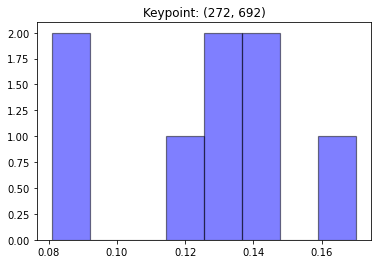

[0.12774322 0.17012493 0.1202015  0.08804689 0.0809452  0.13908836
 0.12627911 0.14757079]


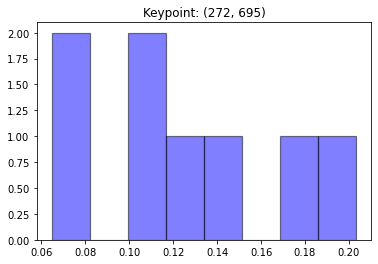

[0.09997861 0.11976208 0.06475708 0.20326021 0.18304868 0.13544549
 0.11502935 0.07871849]


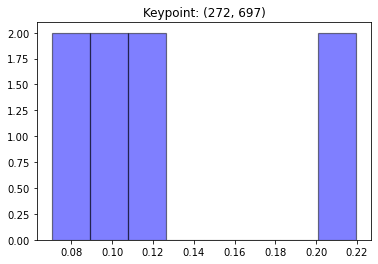

[0.10402251 0.1121081  0.07199248 0.21961227 0.21961227 0.11054842
 0.09174735 0.07035659]


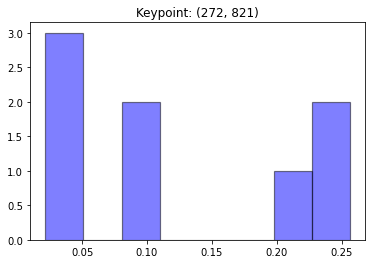

[0.03526371 0.08796723 0.25625915 0.21892349 0.25625915 0.09195052
 0.02172775 0.03164902]


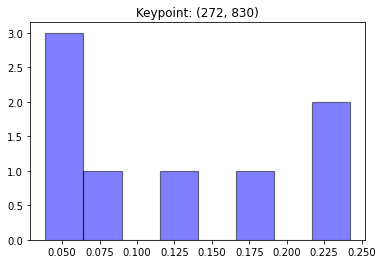

[0.07429677 0.13590058 0.1676013  0.24212182 0.24212182 0.05755575
 0.03883249 0.04156948]


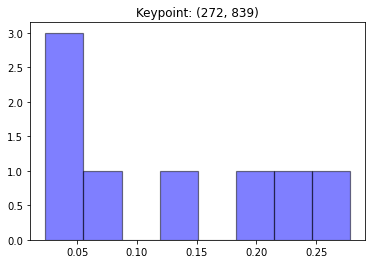

[0.02406272 0.0233306  0.21125809 0.27820026 0.23193007 0.07059799
 0.12137529 0.039245  ]


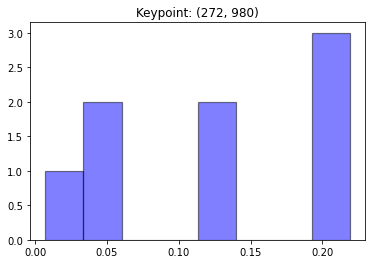

[0.04041151 0.13496558 0.21913048 0.21913048 0.19454885 0.13243905
 0.05227388 0.00710019]


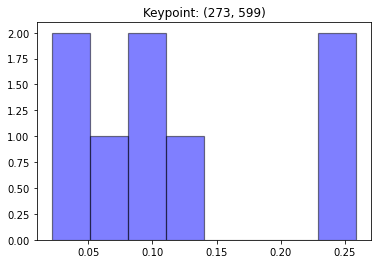

[0.07204211 0.04655675 0.0216787  0.10127121 0.10268307 0.25866822
 0.25866822 0.13843171]


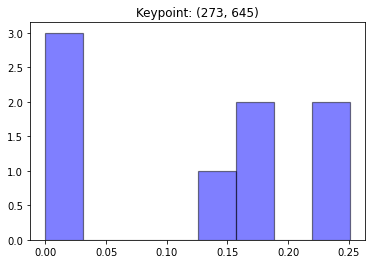

[0.25081507 0.15284721 0.16316337 0.25081507 0.         0.
 0.01329936 0.16905991]


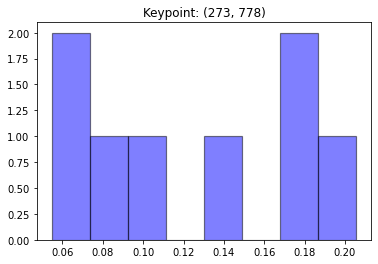

[0.0885208  0.16973155 0.17192308 0.2055128  0.07277386 0.0547604
 0.10004729 0.13673022]


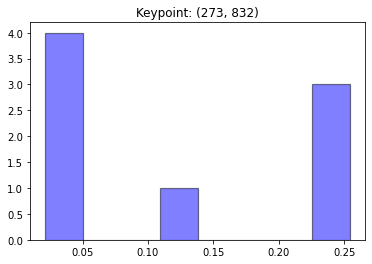

[0.0439241  0.113663   0.2270926  0.25417071 0.25417071 0.04340701
 0.04199996 0.02157191]


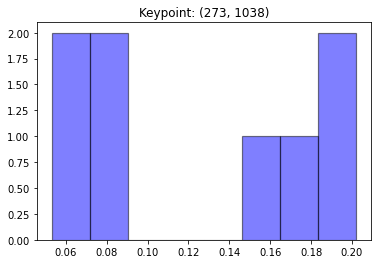

[0.18642464 0.20203224 0.07166323 0.08268615 0.17591304 0.0531343
 0.08077566 0.14737075]


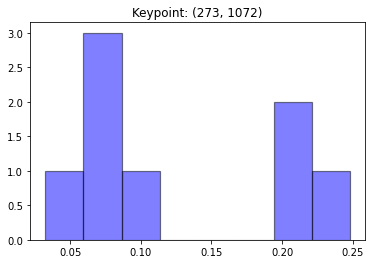

[0.0888523  0.2134976  0.24788238 0.21339839 0.06747398 0.07208074
 0.03252044 0.06429417]


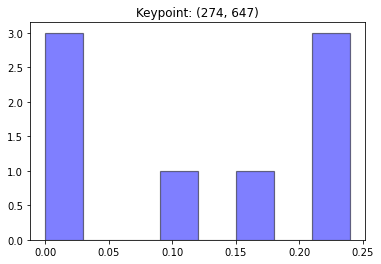

[0.2397357  0.16678656 0.2397357  0.2397357  0.         0.00418981
 0.         0.10981653]


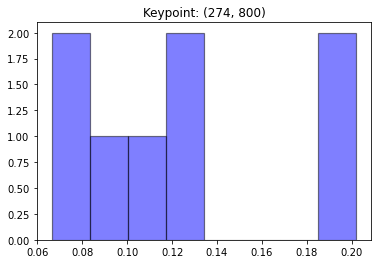

[0.1154452  0.06640662 0.11725941 0.12851923 0.08260482 0.20199261
 0.20199261 0.08577951]


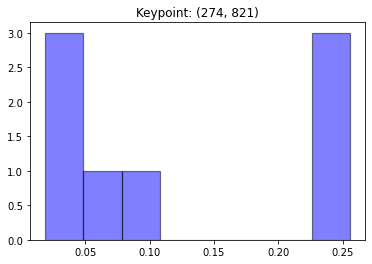

[0.01921204 0.06670788 0.25530312 0.25530312 0.25530312 0.08718239
 0.02783246 0.03315586]


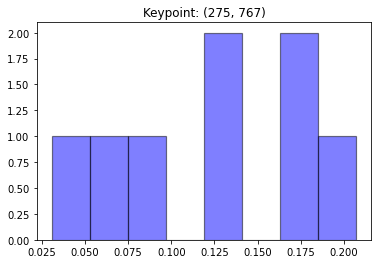

[0.09181452 0.12940464 0.17893879 0.1665665  0.2069748  0.12454761
 0.07088374 0.0308694 ]


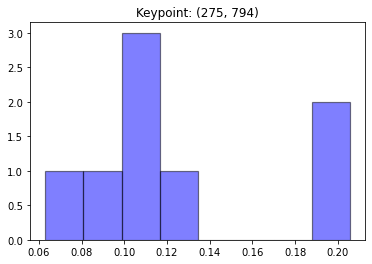

[0.10581857 0.06307676 0.10760976 0.19189256 0.0913794  0.12080255
 0.20554419 0.1138762 ]


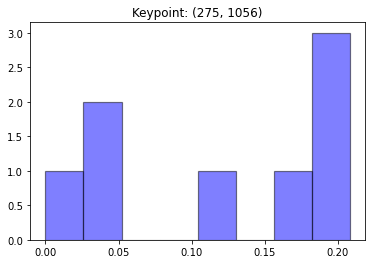

[0.04978332 0.         0.03330335 0.20814988 0.20814988 0.11705552
 0.20208359 0.18147445]


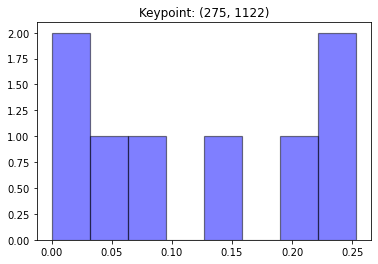

[0.00262235 0.         0.13474359 0.206566   0.09168193 0.25329921
 0.25329921 0.05778771]


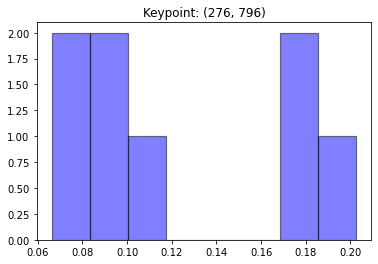

[0.09417727 0.06625793 0.11106909 0.18352431 0.0948815  0.17252756
 0.20253371 0.07502863]


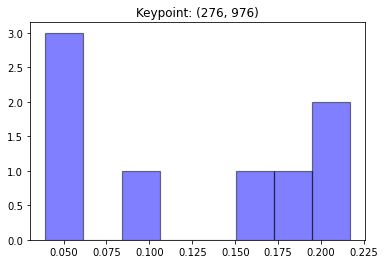

[0.03943669 0.09740267 0.21666751 0.15039267 0.17666167 0.21666751
 0.05058505 0.05218623]


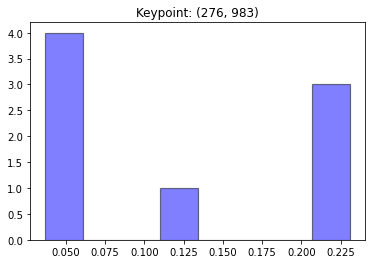

[0.03691564 0.03746978 0.23090938 0.23090938 0.23090938 0.13112829
 0.052908   0.04885015]


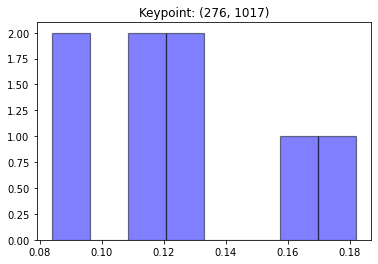

[0.18205632 0.15816645 0.11979248 0.08381304 0.1216242  0.13138927
 0.11250914 0.0906491 ]


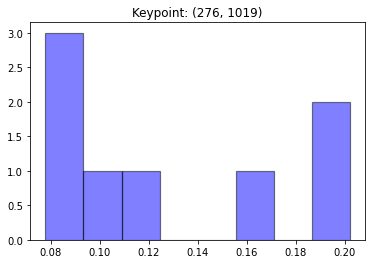

[0.16177129 0.20210152 0.18964161 0.08098505 0.11020208 0.08374693
 0.09364689 0.07790463]


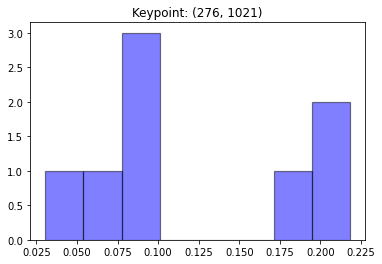

[0.18521031 0.21810474 0.21810474 0.09627622 0.09332108 0.03051889
 0.07516463 0.08329941]


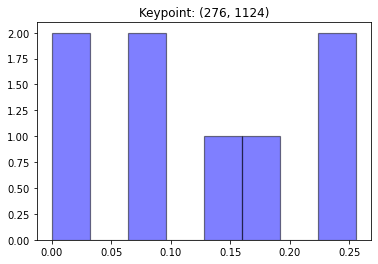

[0.         0.00147574 0.14625362 0.18137163 0.08209263 0.25580431
 0.25580431 0.07719776]


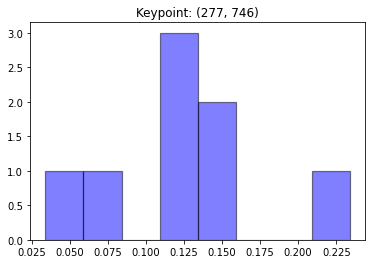

[0.03402507 0.06345098 0.11733582 0.14520625 0.23383491 0.15025909
 0.1333314  0.12255647]


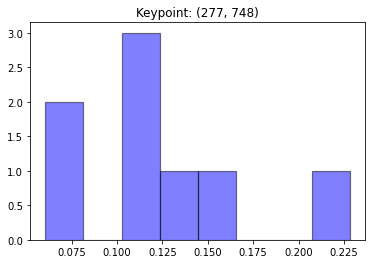

[0.06060623 0.07652351 0.1211061  0.12233942 0.22820511 0.13627876
 0.10321361 0.15172726]


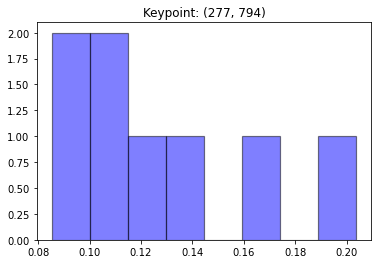

[0.13153719 0.08532253 0.10830843 0.16049722 0.09101308 0.10294403
 0.20371833 0.11665919]


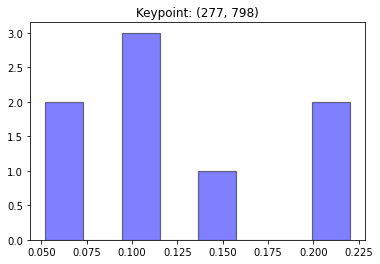

[0.05577758 0.05217643 0.11025521 0.14050305 0.09992328 0.2172101
 0.22010175 0.1040526 ]


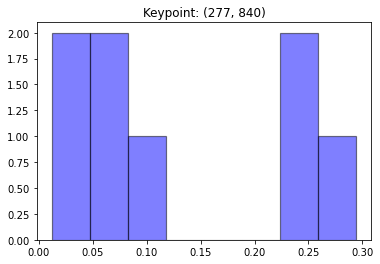

[0.08943414 0.05783899 0.22595495 0.29429074 0.23136204 0.04850475
 0.01184646 0.04076794]


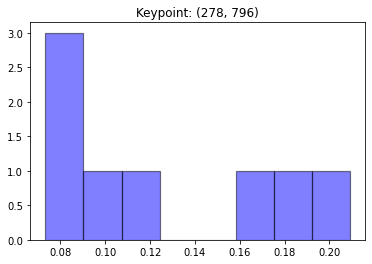

[0.11586038 0.07327317 0.0747687  0.16059251 0.09930001 0.17779965
 0.20911961 0.08928597]


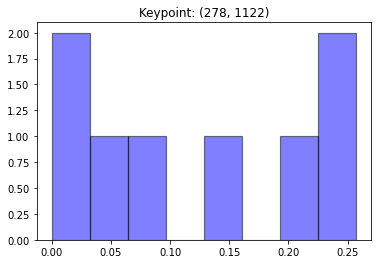

[0.         0.         0.1350993  0.20644985 0.08050618 0.25723434
 0.25723434 0.06347598]


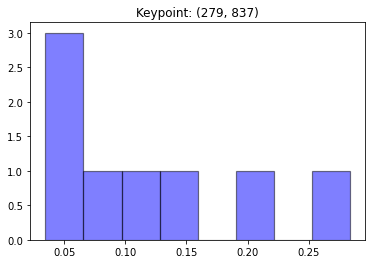

[0.13907751 0.05324226 0.12159037 0.2835937  0.21137831 0.09165996
 0.03464174 0.06481615]


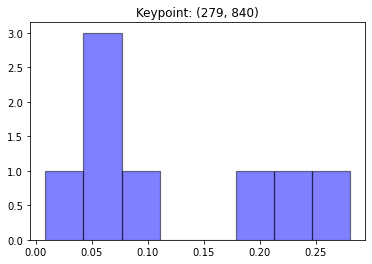

[0.09294311 0.07329735 0.23165499 0.28063012 0.19652678 0.06451054
 0.00864094 0.05179617]


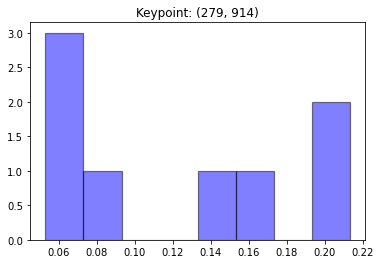

[0.20786692 0.14625332 0.05284169 0.06277333 0.06471499 0.08730944
 0.16517637 0.21306393]


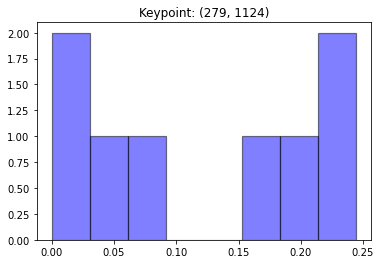

[0.         0.00473642 0.17129851 0.21154773 0.08215932 0.2444802
 0.2444802  0.04129763]


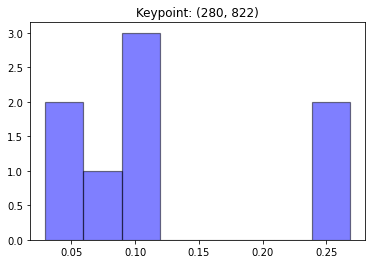

[0.05303116 0.0296925  0.11675694 0.26839267 0.26839267 0.0642076
 0.09013591 0.10939055]


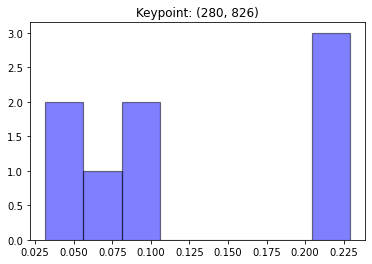

[0.03160653 0.08339545 0.22890804 0.22890804 0.22890804 0.03957483
 0.07407299 0.08462609]


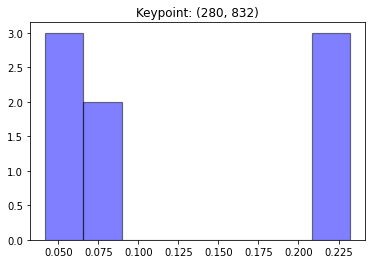

[0.05748744 0.0771354  0.23204455 0.23204455 0.23204455 0.07794887
 0.04931372 0.04198094]


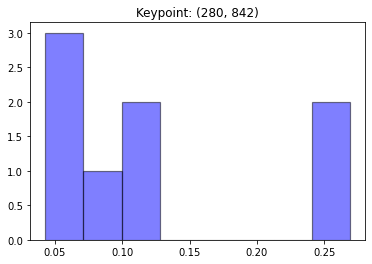

[0.10686663 0.0900532  0.253329   0.26874862 0.12318665 0.05783509
 0.04315279 0.05682804]


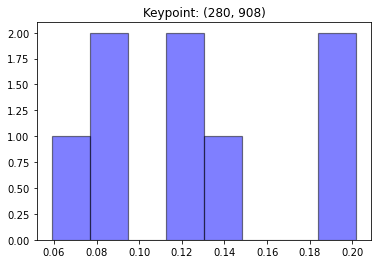

[0.20181298 0.13259345 0.05895233 0.12030966 0.08335345 0.08523993
 0.11742439 0.20031381]


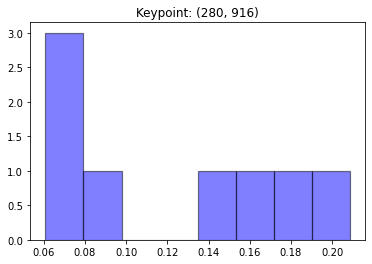

[0.17497511 0.14969345 0.06084608 0.07145821 0.07470477 0.09763664
 0.16214516 0.20854058]


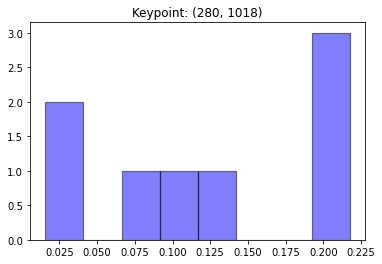

[0.21752735 0.21752735 0.19505933 0.10072746 0.13277096 0.08803102
 0.0157061  0.03265042]


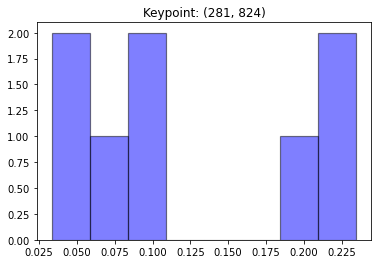

[0.05467956 0.03336639 0.19080403 0.23459926 0.23459926 0.06357814
 0.08516659 0.10320677]


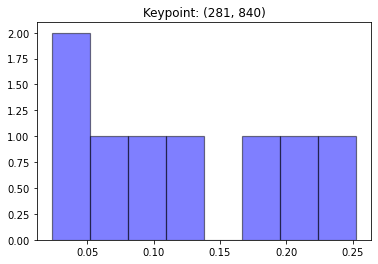

[0.10215364 0.11851812 0.19058481 0.25266809 0.19557189 0.06728456
 0.02320903 0.05000985]


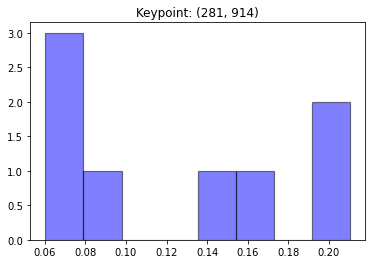

[0.196298   0.14638689 0.06027844 0.06758984 0.07719923 0.08407272
 0.15779632 0.21037855]


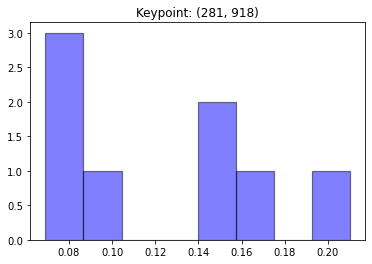

[0.14840823 0.1499336  0.08064648 0.06910297 0.09438265 0.08665335
 0.16071958 0.21015315]


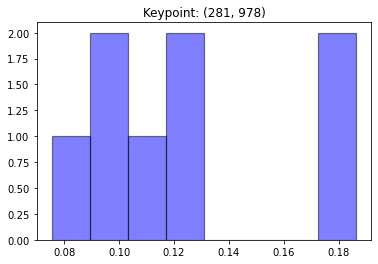

[0.09284884 0.12942149 0.17860312 0.12914101 0.18642419 0.07544202
 0.09259436 0.11552497]


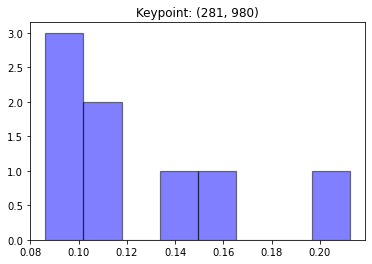

[0.08646037 0.09073774 0.15282334 0.14767459 0.21240532 0.11609895
 0.08622341 0.10757627]


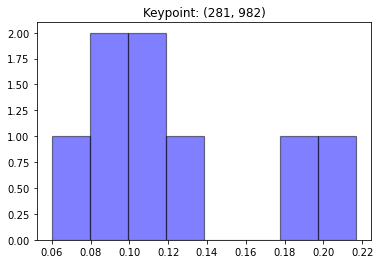

[0.0936103  0.05998885 0.10626398 0.18477359 0.21690156 0.12863556
 0.09335374 0.11647241]


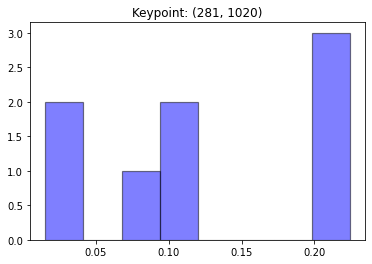

[0.22422177 0.22422177 0.22150106 0.10523877 0.11602671 0.02146541
 0.0154964  0.07182812]


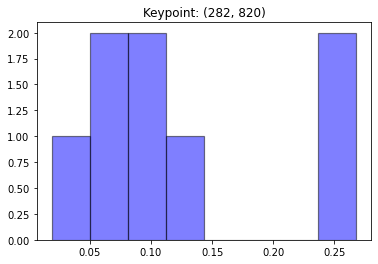

[0.05828311 0.01874274 0.10844108 0.26790429 0.26790429 0.09322524
 0.06717336 0.11832588]


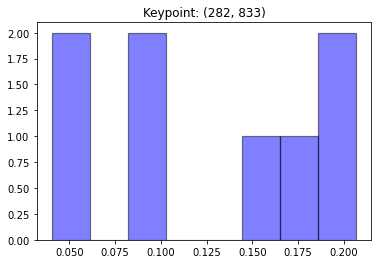

[0.08237673 0.16993272 0.20664147 0.20664147 0.16444149 0.08567419
 0.040355   0.04393693]


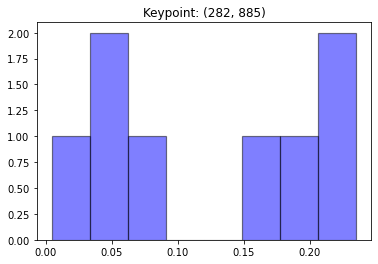

[0.08435192 0.03356191 0.00473551 0.03634574 0.23524115 0.17439551
 0.19612712 0.23524115]


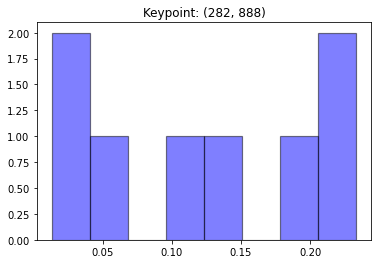

[0.20513826 0.04377514 0.01310144 0.03638798 0.2332514  0.10269678
 0.13239761 0.2332514 ]


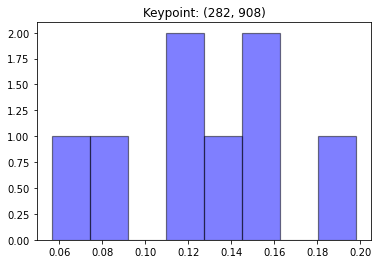

[0.19803565 0.12779546 0.05655146 0.1479148  0.11500356 0.08259509
 0.1134701  0.15863389]


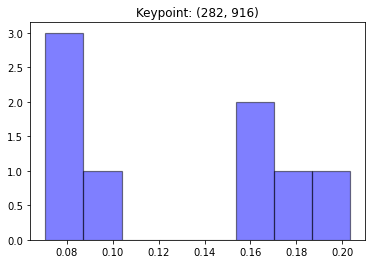

[0.1549108  0.1751162  0.07070754 0.07629477 0.07140395 0.09332258
 0.15498081 0.20326337]


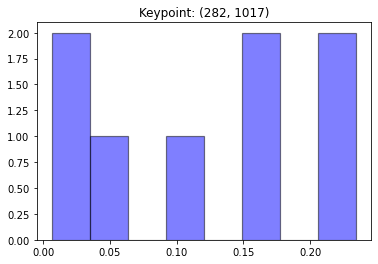

[0.23443333 0.23443333 0.17491026 0.10471467 0.15555488 0.05924272
 0.0064774  0.03023341]


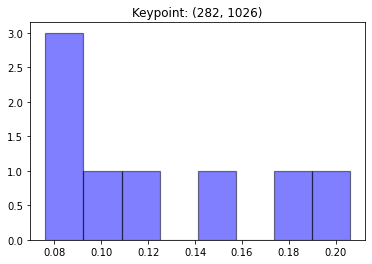

[0.14243273 0.18907611 0.20601809 0.11235561 0.10081851 0.09116661
 0.08199548 0.07613687]


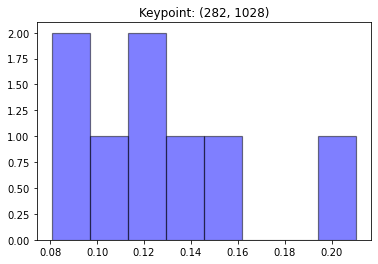

[0.08067668 0.13099935 0.2104061  0.14866574 0.12904528 0.1150673
 0.1007686  0.08437096]


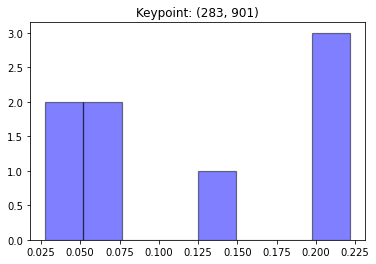

[0.22159605 0.07175476 0.06155875 0.22159605 0.21476532 0.04035679
 0.0278281  0.14054417]


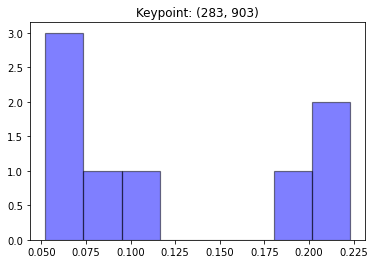

[0.2228332  0.10549976 0.07938052 0.2228332  0.1946397  0.05913455
 0.06339632 0.05228275]


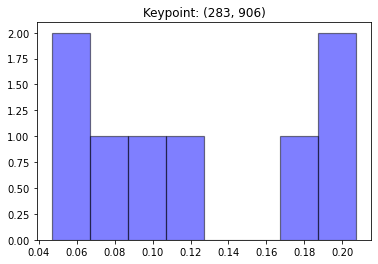

[0.20451044 0.10033469 0.06610302 0.20740515 0.18214825 0.04677844
 0.07694029 0.11577972]


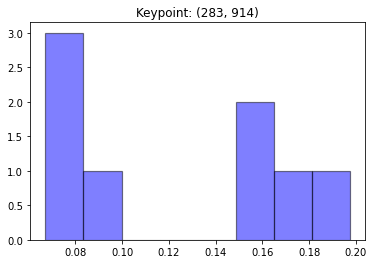

[0.1570995  0.16351257 0.06716875 0.07240946 0.08295789 0.09006767
 0.1694446  0.19733956]


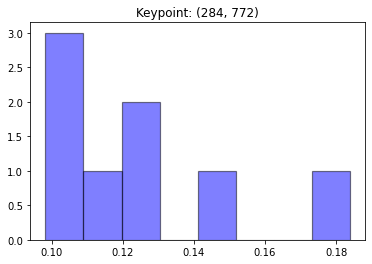

[0.18384205 0.12861142 0.09960091 0.11394122 0.10222477 0.15140066
 0.09820877 0.1221702 ]


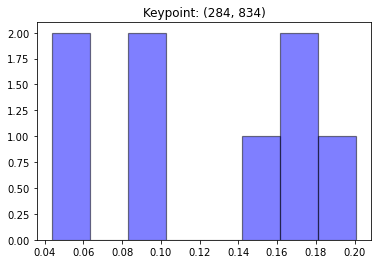

[0.09598991 0.20084884 0.18109721 0.15140288 0.17977663 0.08973888
 0.04368212 0.05746354]


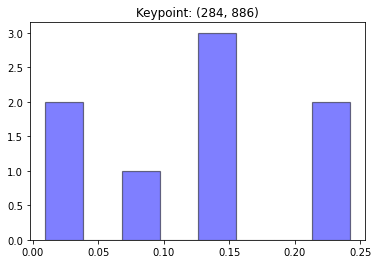

[0.07206981 0.03332982 0.00948158 0.13167228 0.24213127 0.12742504
 0.14175892 0.24213127]


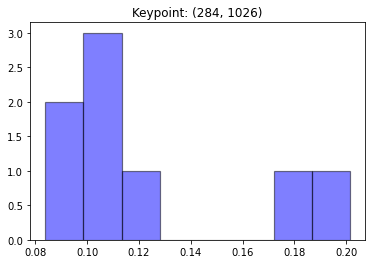

[0.17376666 0.11688582 0.20135871 0.08385654 0.11161639 0.11292687
 0.09825756 0.10133145]


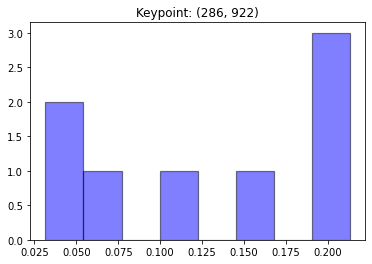

[0.19204446 0.06241479 0.03152125 0.0378564  0.10910363 0.21309079
 0.15642432 0.19754436]


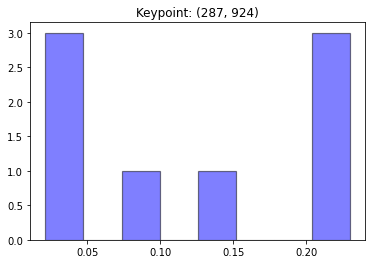

[0.2297076  0.04512259 0.02347081 0.02142319 0.07591441 0.2297076
 0.14494619 0.2297076 ]


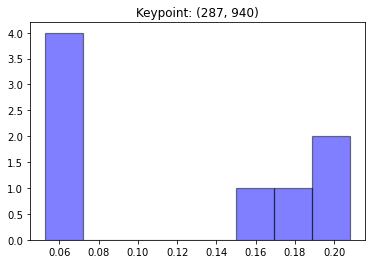

[0.05291709 0.20800825 0.070258   0.06300476 0.1625482  0.06932527
 0.17411583 0.1998226 ]


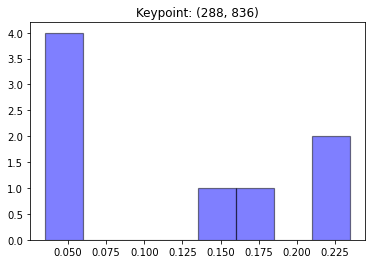

[0.05793118 0.2346052  0.17681167 0.2346052  0.15584511 0.05748682
 0.03525047 0.04746436]


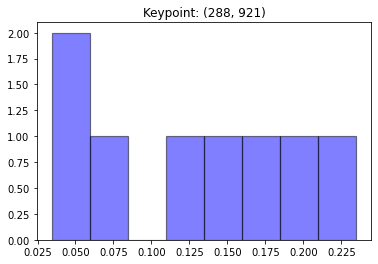

[0.15118772 0.0685772  0.03440174 0.03811135 0.11271574 0.23477213
 0.19975202 0.1604821 ]


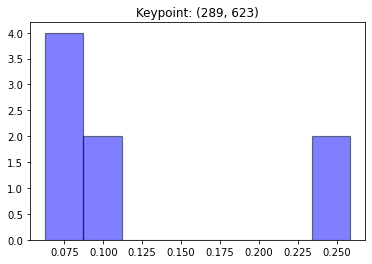

[0.06282841 0.10281778 0.0674223  0.06866853 0.11017816 0.2583516
 0.2583516  0.07138161]


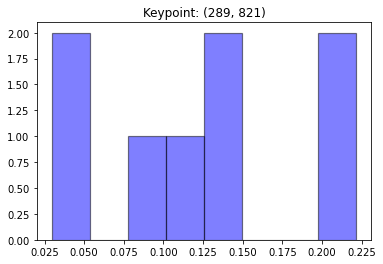

[0.04254775 0.13471414 0.11397838 0.2215407  0.2215407  0.14354774
 0.02955254 0.09257806]


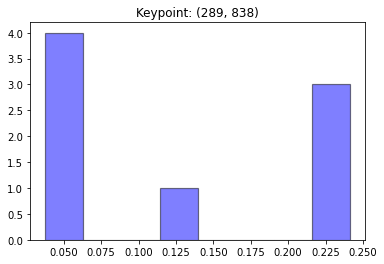

[0.04019214 0.24118405 0.22886416 0.24118405 0.12734335 0.0398514
 0.0376757  0.04370514]


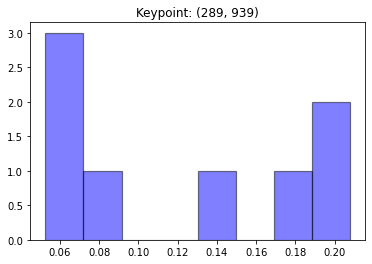

[0.06597599 0.1420556  0.05982437 0.05254085 0.20775784 0.08661487
 0.17857029 0.20666019]


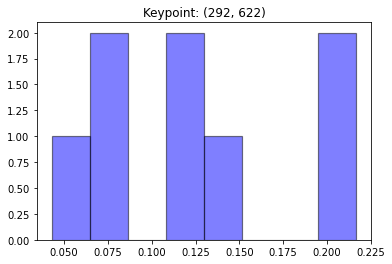

[0.07470107 0.11053102 0.075129   0.12041394 0.14287273 0.21673226
 0.21673226 0.04288774]


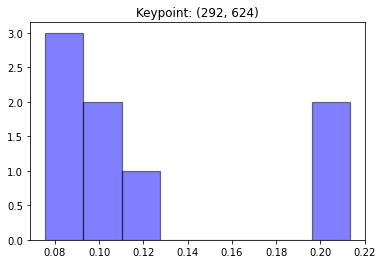

[0.09181806 0.10979675 0.07575681 0.09404066 0.12478324 0.21326338
 0.21326338 0.07727773]


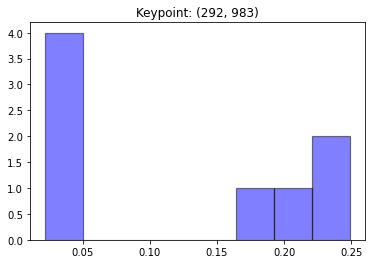

[0.24875255 0.20200213 0.24875255 0.1751361  0.03624472 0.02238376
 0.03014556 0.03658263]


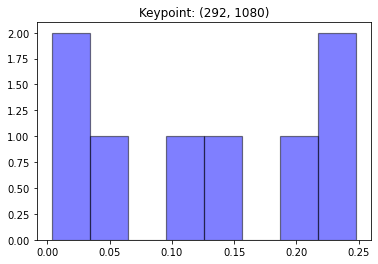

[0.03673999 0.02432057 0.24801087 0.24801087 0.13312986 0.20024402
 0.1058832  0.00366062]


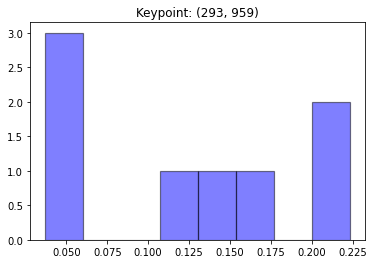

[0.22319116 0.17635786 0.05420547 0.04031932 0.03719652 0.11458523
 0.13095329 0.22319116]


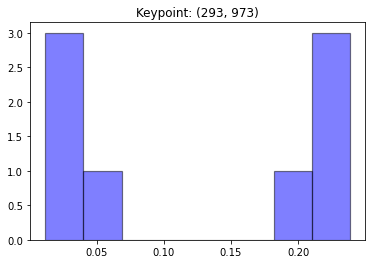

[0.23848163 0.23848163 0.23331649 0.04100974 0.01938485 0.0117958
 0.02099459 0.19653528]


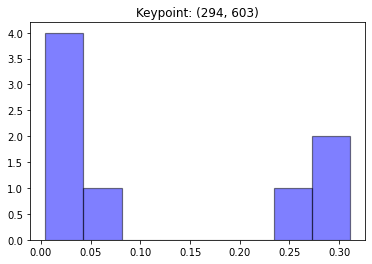

[0.00450205 0.00443612 0.02558422 0.04665186 0.31072619 0.27022349
 0.31072619 0.02714988]


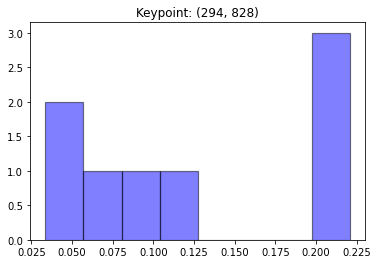

[0.05080394 0.08059628 0.22071894 0.22071894 0.22071894 0.10582755
 0.06703426 0.03358115]


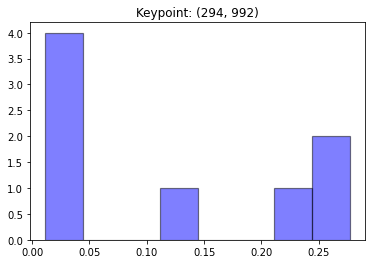

[0.02518824 0.02714514 0.01589124 0.27699853 0.23871806 0.27699853
 0.1274196  0.01164066]


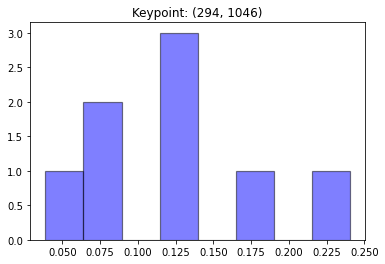

[0.11462589 0.03884436 0.07270018 0.24041092 0.12903085 0.17780856
 0.13847966 0.08809959]


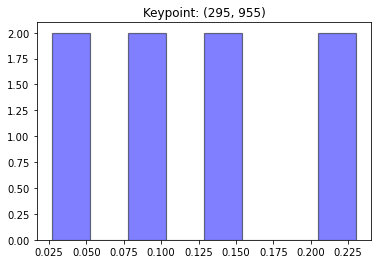

[0.23028543 0.15334058 0.03391978 0.0269679  0.15371046 0.23028543
 0.09020715 0.08128326]


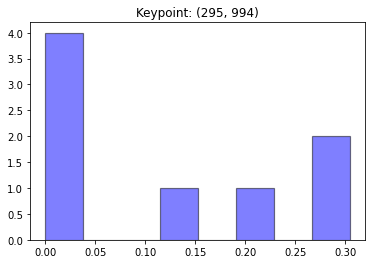

[0.         0.00937845 0.01549097 0.30467446 0.21938413 0.30467446
 0.13859814 0.00779939]


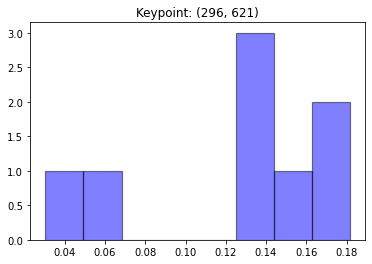

[0.05305165 0.16013415 0.1282028  0.18160199 0.13948601 0.13752508
 0.16963087 0.03036745]


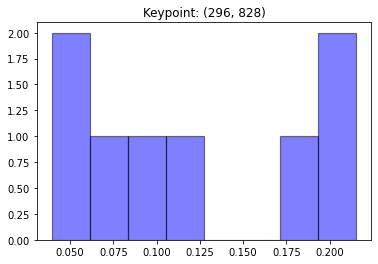

[0.04342259 0.09232611 0.21541274 0.21541274 0.1924371  0.11933174
 0.08225711 0.03939988]


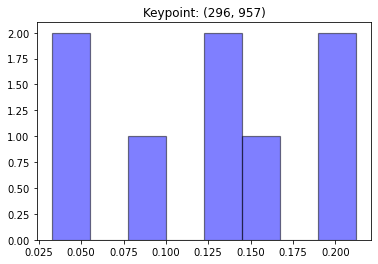

[0.21232555 0.15218681 0.03266147 0.04668062 0.12417538 0.21232555
 0.08265374 0.13699089]


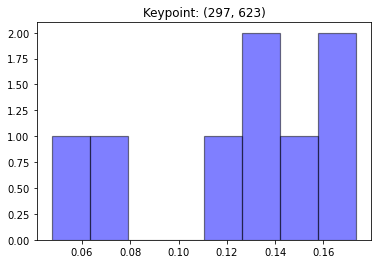

[0.06757032 0.13394506 0.13594422 0.15513799 0.16265637 0.12370338
 0.17354411 0.04749856]


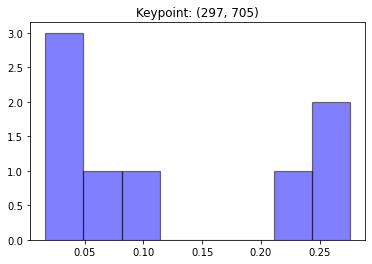

[0.01660006 0.01986306 0.037026   0.08844069 0.27546115 0.27546115
 0.21564323 0.07150465]


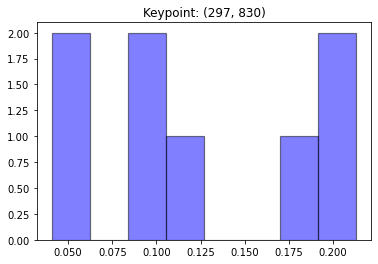

[0.04074763 0.09264375 0.21316576 0.21316576 0.17236217 0.11399143
 0.09707272 0.05685078]


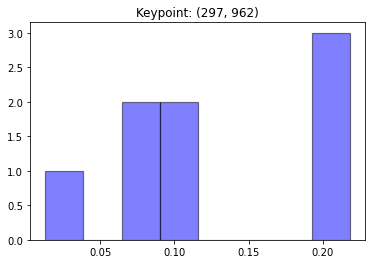

[0.21803688 0.21803688 0.07215973 0.10705725 0.01310615 0.07363305
 0.09168761 0.20628245]


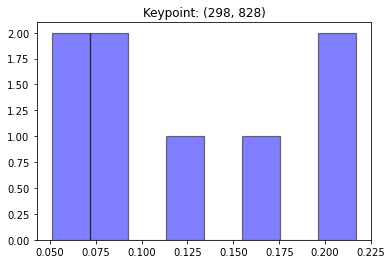

[0.05733455 0.08137114 0.21684117 0.21684117 0.16744085 0.11682048
 0.0921971  0.05115354]


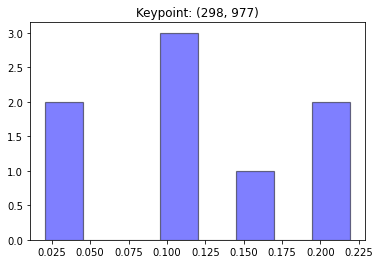

[0.11855722 0.21909971 0.21909971 0.11350519 0.16939158 0.10291692
 0.03655238 0.0208773 ]


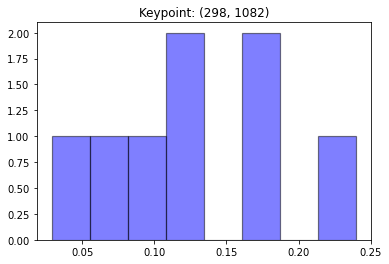

[0.11683683 0.02894081 0.16872238 0.23996569 0.1668022  0.11461634
 0.07092975 0.093186  ]


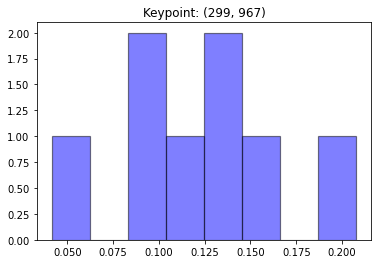

[0.1430933  0.20768865 0.11841056 0.16362588 0.04152693 0.0923484
 0.09568189 0.13762441]


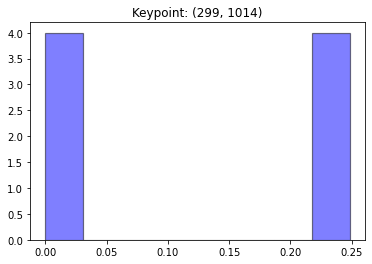

[0.24851699 0.24851699 0.24851699 0.24851699 0.00593205 0.
 0.         0.        ]


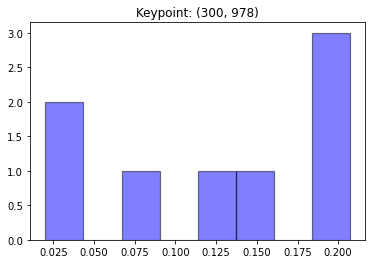

[0.07420418 0.13866133 0.20710799 0.11696002 0.20127027 0.20416151
 0.03754376 0.02009094]


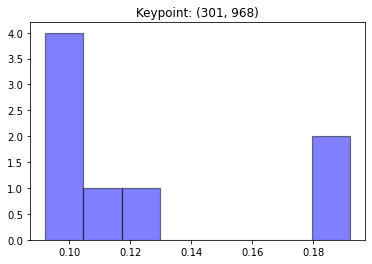

[0.11293432 0.19195269 0.12755291 0.18349829 0.09216352 0.09245463
 0.10361126 0.09583239]


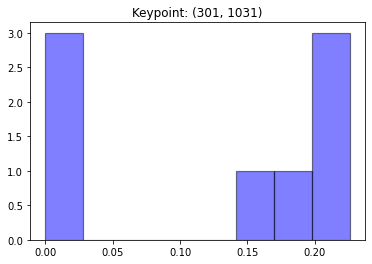

[0.20057973 0.22603651 0.18184114 0.         0.         0.
 0.22603651 0.16550611]


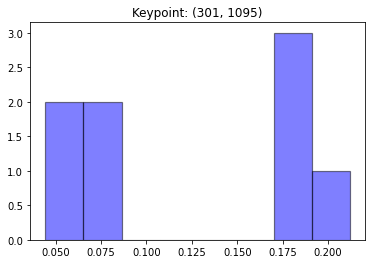

[0.07336607 0.17960164 0.17700931 0.21195004 0.18603436 0.05426962
 0.07340303 0.04436591]


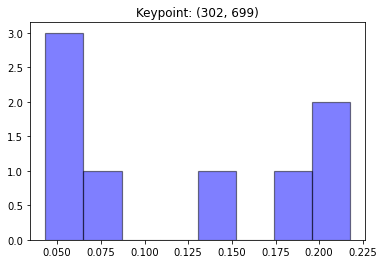

[0.05096737 0.04322623 0.05873469 0.14134261 0.08659533 0.2175349
 0.18406396 0.2175349 ]


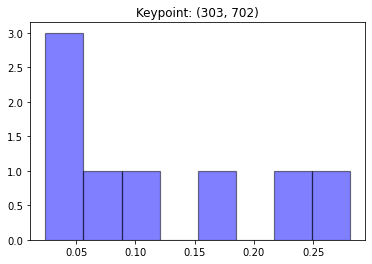

[0.03917677 0.02414923 0.04979137 0.11890153 0.23646265 0.28075754
 0.18448244 0.06627847]


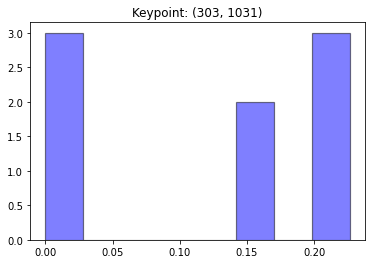

[0.15669316 0.22651481 0.22585888 0.         0.         0.00860479
 0.22651481 0.15581355]


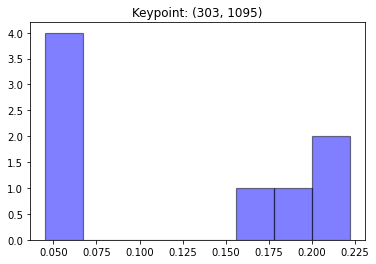

[0.04535068 0.16732914 0.2220335  0.2220335  0.17934147 0.05624697
 0.0496243  0.05804044]


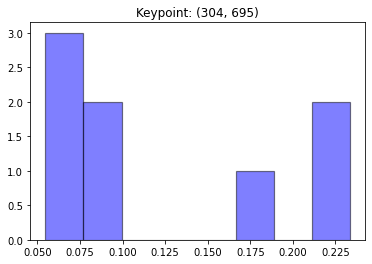

[0.07118799 0.05469731 0.06505689 0.17843205 0.21567059 0.08945087
 0.09206802 0.23343627]


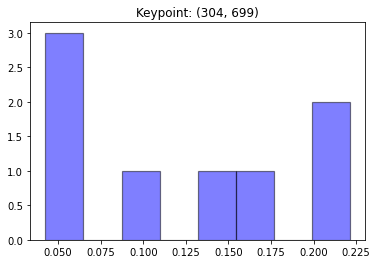

[0.04881835 0.0424959  0.06160679 0.16317474 0.21836258 0.22126283
 0.10907637 0.13520243]


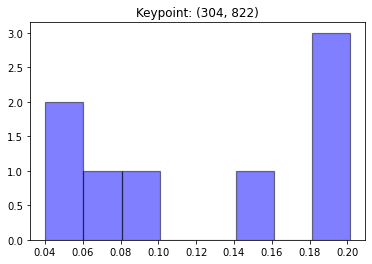

[0.07475575 0.14378791 0.20122025 0.19757357 0.20122025 0.09273335
 0.04846117 0.04024774]


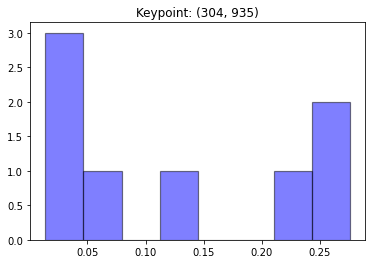

[0.02802487 0.01385199 0.02370705 0.05715011 0.11234314 0.27564061
 0.27564061 0.21364161]


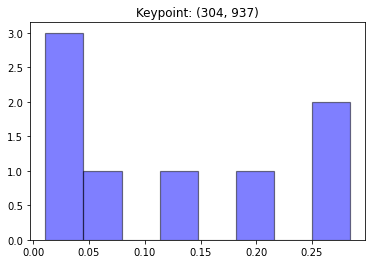

[0.02435597 0.01094224 0.02279195 0.05860988 0.11406899 0.28383594
 0.28383594 0.2015591 ]


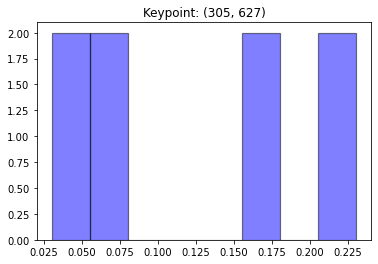

[0.17759961 0.17537937 0.23048472 0.06329599 0.06254385 0.03016081
 0.03005093 0.23048472]


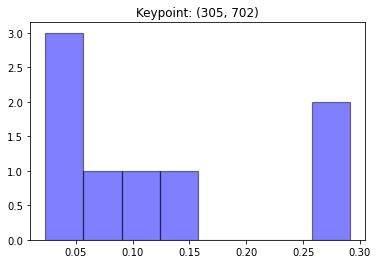

[0.03762154 0.02321527 0.05681555 0.12219911 0.29109441 0.29109441
 0.1244497  0.05351001]


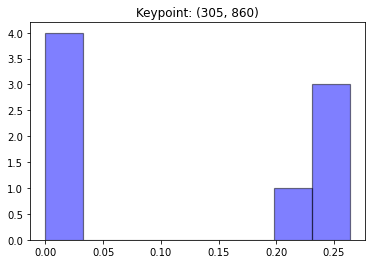

[0.         0.         0.         0.         0.20872322 0.26375893
 0.26375893 0.26375893]


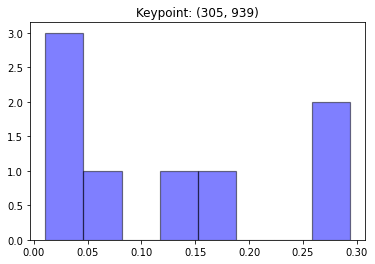

[0.03408344 0.01082651 0.02269805 0.05623156 0.12018749 0.29342818
 0.29342818 0.16911658]


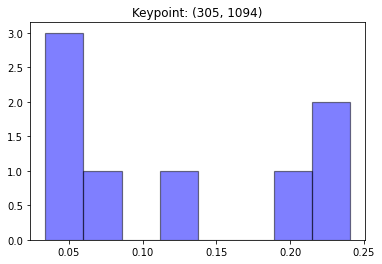

[0.0488609  0.12964953 0.24049983 0.24049983 0.20203751 0.06513295
 0.03924527 0.03407418]


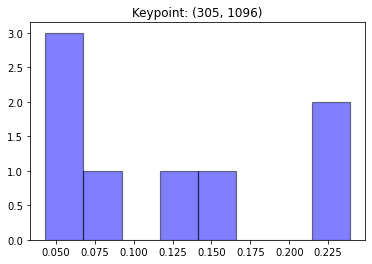

[0.05700764 0.12952489 0.23883606 0.23883606 0.16044354 0.04334146
 0.07350846 0.05850189]


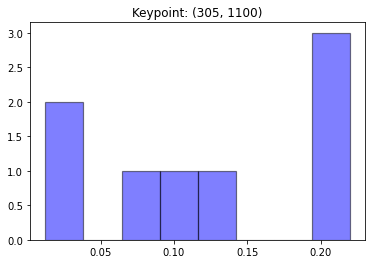

[0.10689512 0.19409256 0.21985471 0.21985471 0.01232365 0.02796737
 0.1298126  0.08919926]


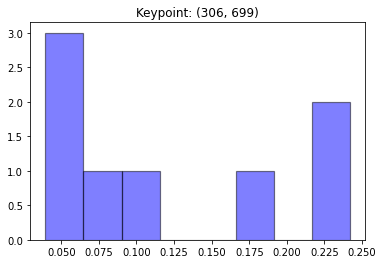

[0.05143723 0.03944535 0.06370353 0.17291441 0.24182169 0.24182169
 0.0815238  0.1073323 ]


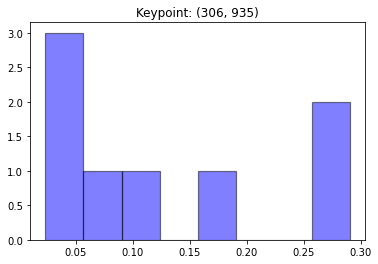

[0.02737931 0.0235507  0.02307661 0.06479803 0.10937002 0.17075248
 0.29053643 0.29053643]


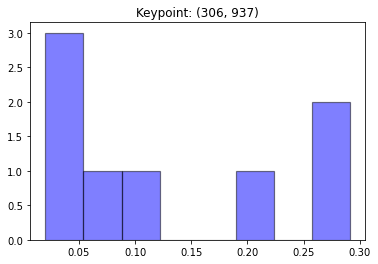

[0.0268906  0.02017796 0.02266471 0.06476337 0.10741782 0.20237979
 0.2911884  0.26451735]


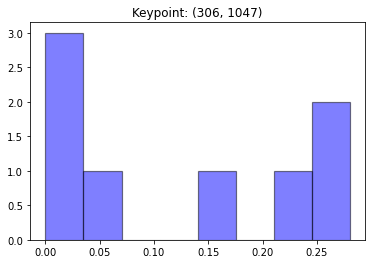

[0.01172951 0.14979219 0.28017673 0.28017673 0.21553187 0.05482964
 0.00776332 0.        ]


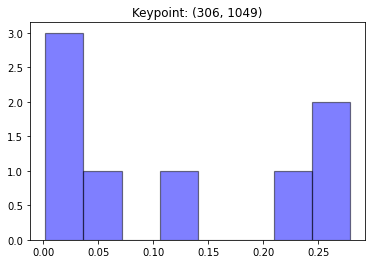

[0.01256202 0.12580583 0.27883255 0.27883255 0.23676474 0.05705646
 0.00837921 0.00176663]


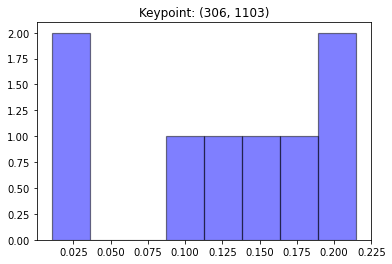

[0.11682647 0.17092549 0.21483029 0.21483029 0.03128025 0.01052355
 0.14932585 0.09145782]


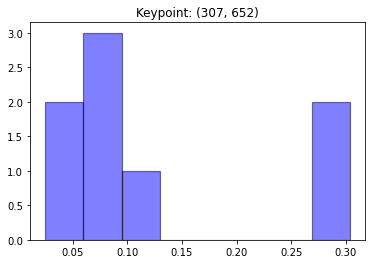

[0.0964387  0.30347125 0.28000002 0.079411   0.09187338 0.07594748
 0.04788519 0.02497298]


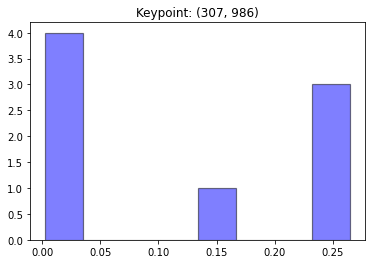

[0.01042085 0.26473459 0.26473459 0.26473459 0.15665913 0.02963831
 0.00636559 0.00271236]


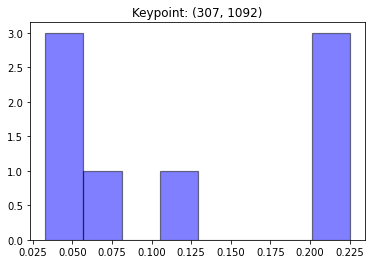

[0.04697834 0.11472921 0.2250296  0.2250296  0.2250296  0.07990719
 0.05021915 0.03307732]


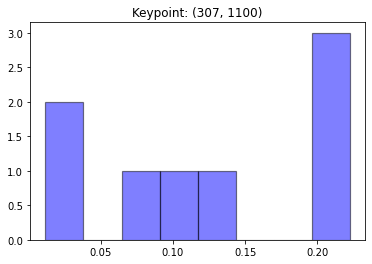

[0.10500549 0.22140168 0.22246479 0.22246479 0.01163827 0.02641195
 0.12343174 0.06718129]


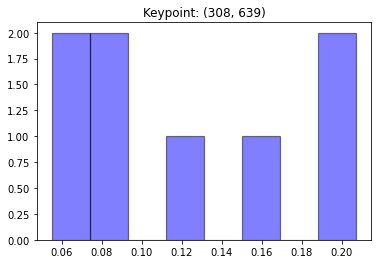

[0.20723456 0.05513613 0.07291205 0.08849016 0.12775912 0.0804684
 0.20723456 0.16076501]


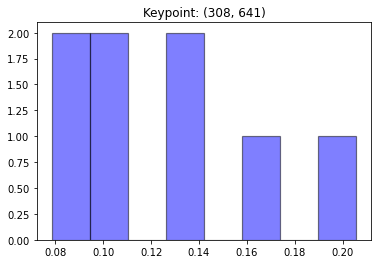

[0.13152916 0.07858484 0.08837559 0.09978321 0.12715105 0.09871304
 0.20552071 0.17034241]


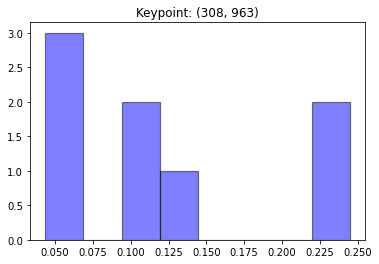

[0.0995576  0.04356126 0.05624522 0.06811659 0.13466287 0.24481685
 0.24481685 0.10822276]


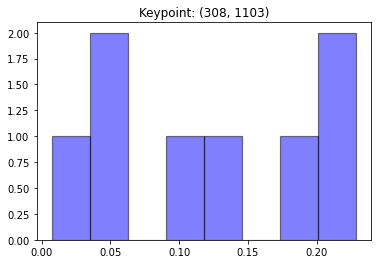

[0.10317935 0.188285   0.2287217  0.2287217  0.0473512  0.00735612
 0.13661184 0.05977308]


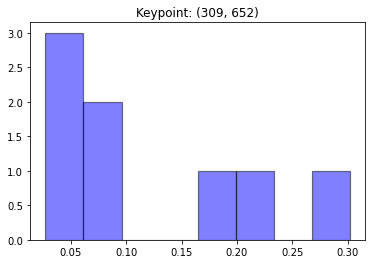

[0.18264654 0.30169589 0.22797182 0.07974951 0.08454265 0.06152317
 0.03458396 0.02728646]


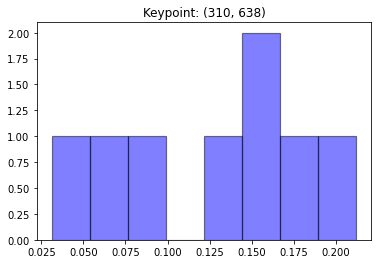

[0.13051703 0.03122285 0.07404125 0.09125922 0.16724215 0.14519508
 0.2121203  0.14840212]


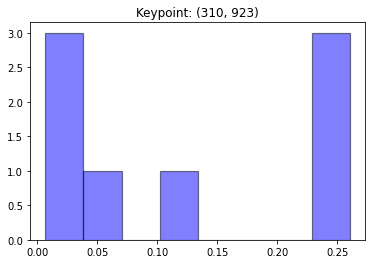

[0.2605103  0.0337439  0.01015727 0.00695299 0.0403764  0.12723853
 0.2605103  0.2605103 ]


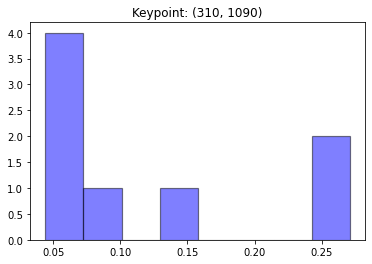

[0.05957824 0.0762371  0.27095055 0.27095055 0.13820007 0.07207919
 0.06775064 0.04425366]


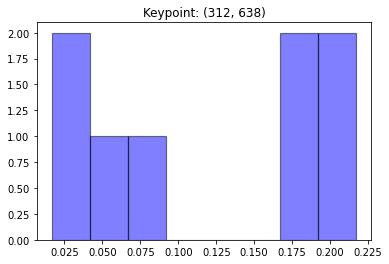

[0.05971658 0.01667958 0.0388945  0.07602854 0.18392111 0.19049971
 0.21712999 0.21712999]


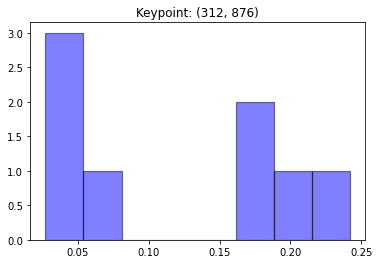

[0.21024139 0.17529975 0.24195771 0.17677873 0.0516353  0.04638336
 0.02706063 0.07064313]


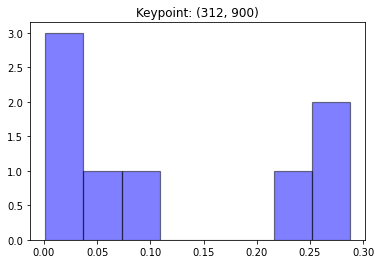

[0.28735638 0.28735638 0.04999204 0.03266066 0.0013086  0.02698869
 0.09311928 0.22121798]


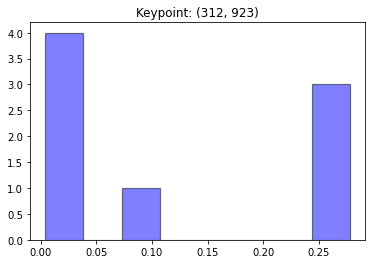

[0.27764545 0.0253384  0.00799212 0.0042797  0.03176965 0.09768377
 0.27764545 0.27764545]


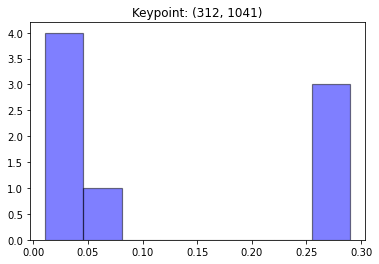

[0.02129594 0.06259631 0.28962439 0.28962439 0.28962439 0.01696822
 0.0111744  0.01909198]


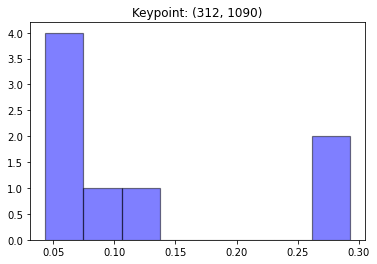

[0.06114451 0.07952514 0.29273346 0.29273346 0.12717752 0.05139759
 0.05182236 0.04346596]


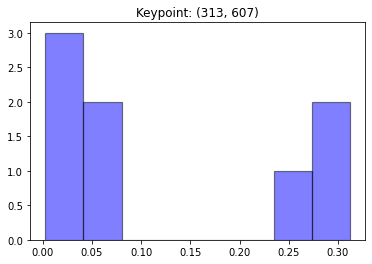

[0.00272551 0.05616205 0.31196573 0.23656365 0.31196573 0.05752011
 0.01406589 0.00903134]


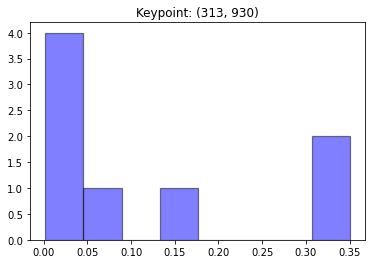

[0.14593404 0.04086788 0.00200585 0.02162483 0.01799854 0.07106084
 0.35025402 0.35025402]


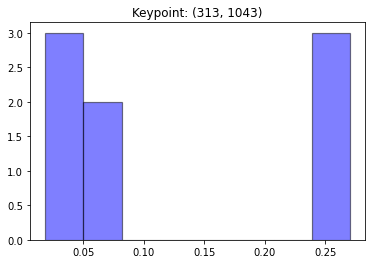

[0.01860743 0.06163833 0.27039015 0.27039015 0.27039015 0.06941627
 0.01880822 0.02035928]


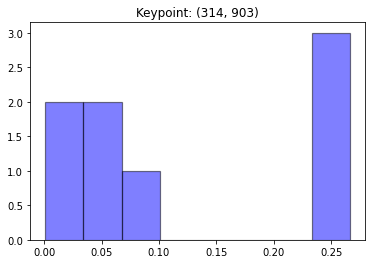

[0.26621727 0.24804073 0.06201942 0.02872391 0.00115087 0.03503914
 0.09259139 0.26621727]


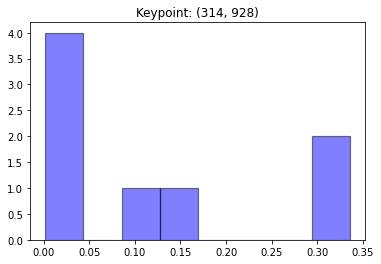

[0.14094098 0.04315767 0.00197487 0.02129091 0.02179418 0.09979379
 0.3355238  0.3355238 ]


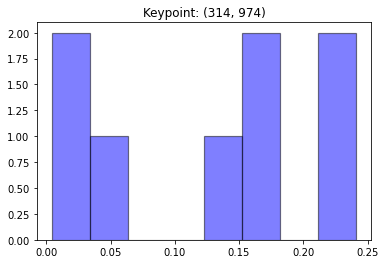

[0.03732515 0.17465242 0.24114203 0.16030997 0.24114203 0.13251852
 0.00431047 0.0085994 ]


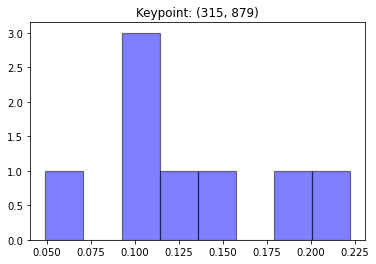

[0.18300021 0.13819401 0.22207483 0.10487133 0.09361969 0.09286065
 0.0492987  0.11608059]


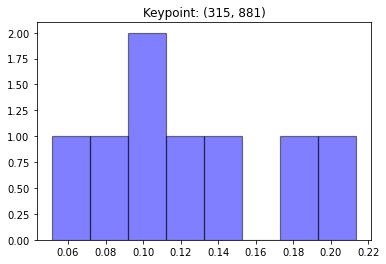

[0.21346114 0.14857309 0.18503068 0.08289429 0.09668645 0.09247523
 0.05135866 0.12952047]


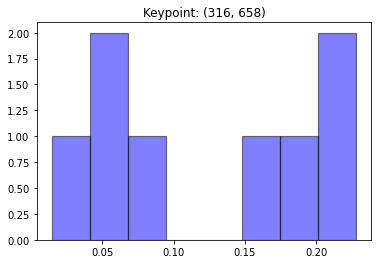

[0.22790369 0.22790369 0.05981756 0.01472708 0.08484986 0.0491911
 0.15935504 0.17625199]


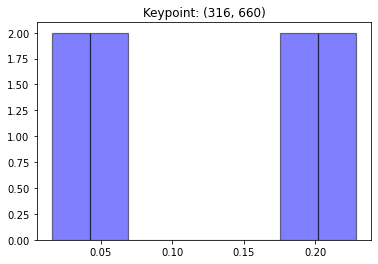

[0.22872173 0.22872173 0.05713857 0.01551655 0.06854241 0.02486192
 0.18100156 0.19549553]


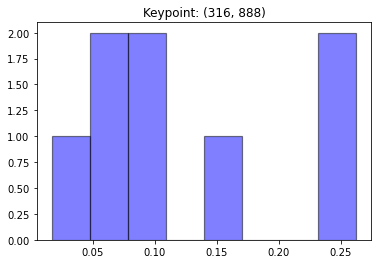

[0.26221272 0.07350916 0.01716451 0.05134501 0.08387684 0.14940212
 0.10027694 0.26221272]


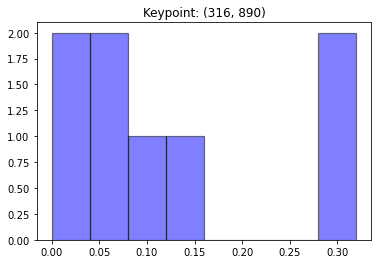

[0.31970059 0.0581111  0.         0.01784036 0.04420472 0.13176164
 0.10868101 0.31970059]


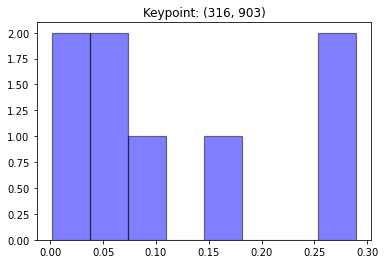

[0.28954526 0.17056863 0.06899192 0.03307222 0.00132509 0.04034347
 0.10660815 0.28954526]


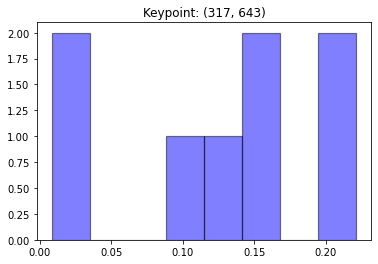

[0.11995231 0.2214589  0.15768781 0.15949383 0.01730616 0.0082966
 0.09434548 0.2214589 ]


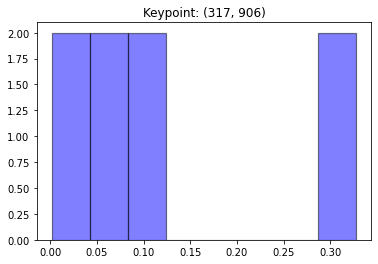

[0.3277224  0.10985405 0.09392642 0.04039401 0.00156607 0.04768033
 0.05113433 0.3277224 ]


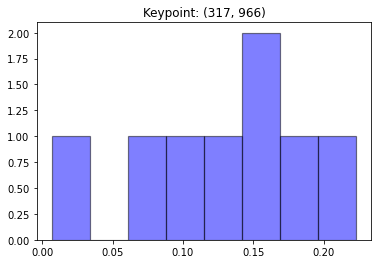

[0.14223547 0.22313687 0.00665573 0.13074844 0.17977061 0.15017031
 0.08971427 0.07756831]


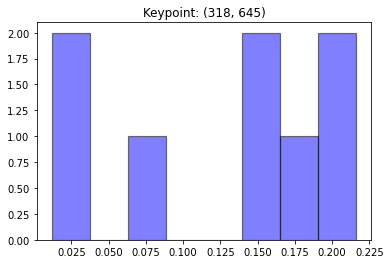

[0.14628363 0.21617467 0.16740068 0.14980112 0.0765853  0.01181851
 0.02241384 0.20952226]


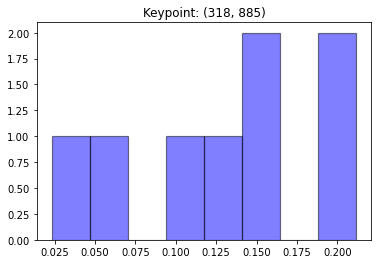

[0.21168704 0.02328492 0.04712269 0.12283529 0.09569327 0.14536124
 0.14232852 0.21168704]


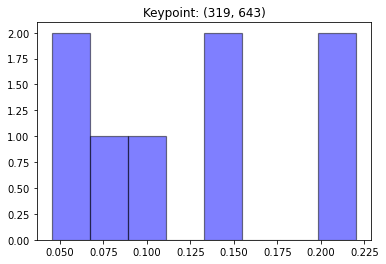

[0.0816738  0.22021634 0.15119146 0.14033309 0.04797117 0.04540261
 0.09299518 0.22021634]


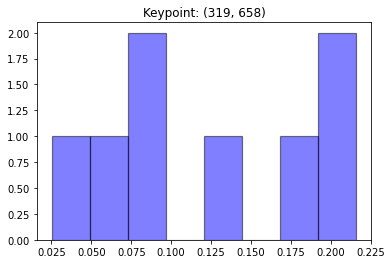

[0.13249632 0.21583924 0.08257993 0.02519576 0.08643203 0.05229512
 0.18932236 0.21583924]


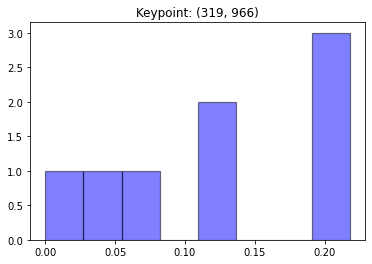

[0.1286132  0.21810823 0.         0.21810823 0.19456018 0.12842677
 0.04532647 0.06685692]


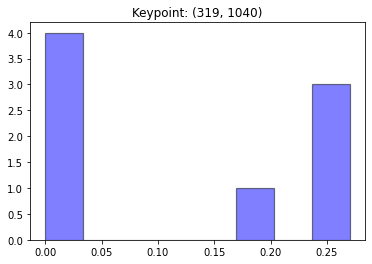

[1.93785156e-04 0.00000000e+00 1.57133635e-02 1.72992761e-01
 2.70366697e-01 2.70366697e-01 2.70366697e-01 0.00000000e+00]


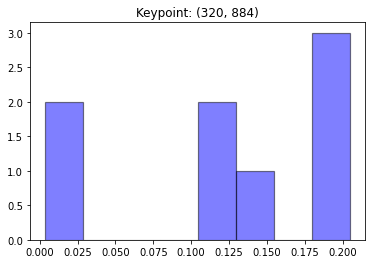

[0.20476793 0.00488642 0.00372759 0.11918806 0.20476793 0.14860524
 0.10928891 0.20476793]


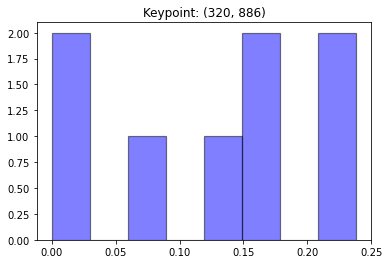

[0.23830744 0.00076635 0.         0.071217   0.17031028 0.15924503
 0.12184646 0.23830744]


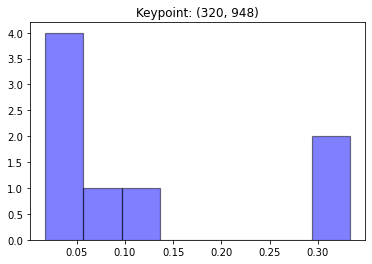

[0.11045659 0.04198446 0.01740904 0.03632021 0.03904437 0.08829872
 0.33324331 0.33324331]


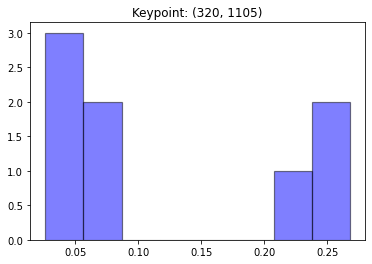

[0.02838195 0.07258683 0.26796009 0.26796009 0.23126386 0.07622189
 0.02611491 0.02951039]


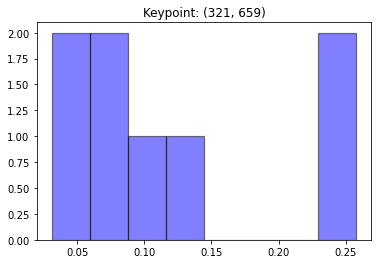

[0.07961043 0.13061567 0.08240545 0.03117223 0.11016269 0.05049162
 0.25777094 0.25777094]


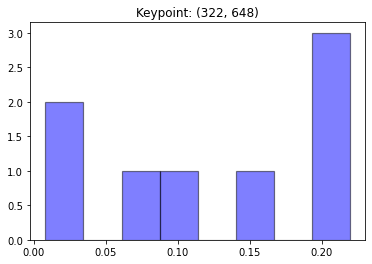

[0.09488617 0.21960218 0.14463933 0.21960218 0.21960218 0.08437486
 0.00816269 0.00913042]


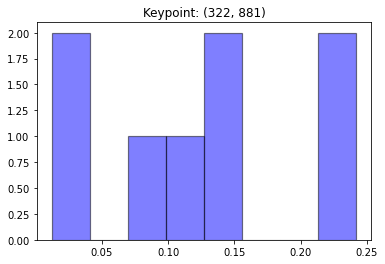

[0.11622044 0.03493327 0.01214134 0.24199935 0.24199935 0.12850026
 0.09097913 0.13322684]


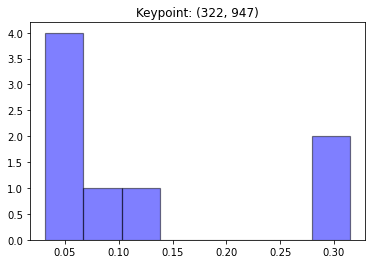

[0.10947105 0.04080434 0.03185683 0.05032437 0.04441779 0.09371221
 0.3147067  0.3147067 ]


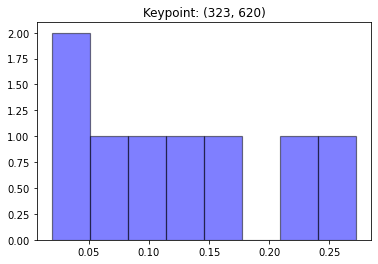

[0.23244041 0.14945533 0.02670927 0.01926936 0.05299501 0.27218759
 0.13804164 0.10890138]


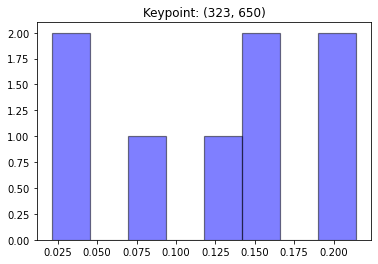

[0.12177269 0.21428375 0.15363162 0.15073593 0.21428375 0.08630325
 0.03776699 0.02122202]


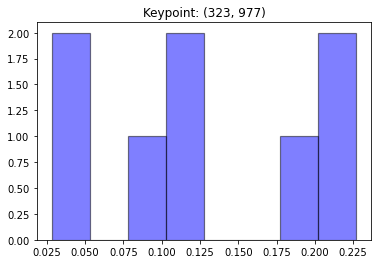

[0.092142   0.22699084 0.18659083 0.21737502 0.10400886 0.10527884
 0.03942348 0.02819013]


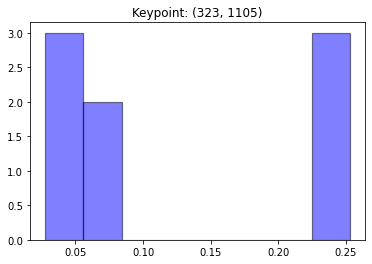

[0.0326752  0.06824421 0.2527792  0.2527792  0.2527792  0.08115182
 0.0278161  0.03177508]


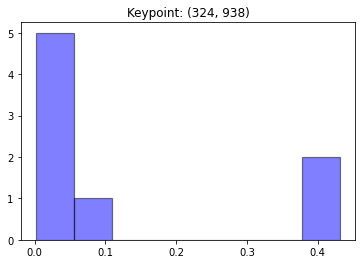

[0.0123556  0.00167707 0.00534353 0.00577474 0.00513677 0.10615559
 0.43177836 0.43177836]


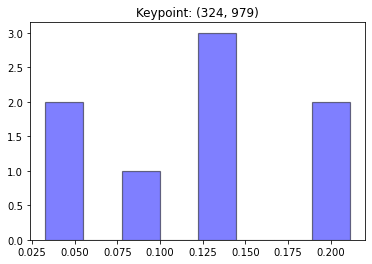

[0.09292502 0.21110142 0.14099239 0.21110142 0.13121759 0.13046069
 0.04942692 0.03277456]


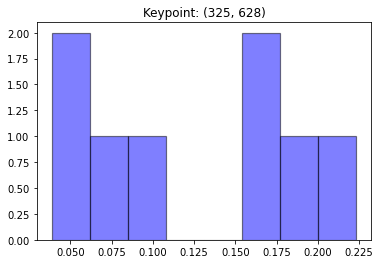

[0.19552637 0.0949233  0.04700533 0.03872003 0.1651381  0.22325789
 0.07465839 0.16077058]


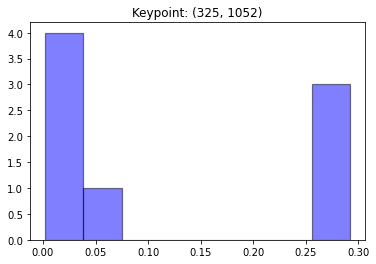

[0.02235416 0.05154609 0.29171195 0.29171195 0.29171195 0.03357755
 0.01512856 0.00225778]


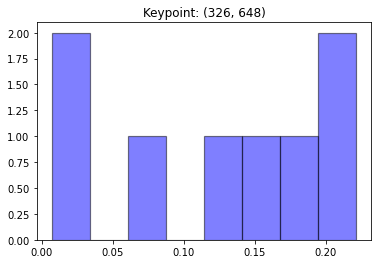

[0.13060451 0.22146889 0.15074473 0.17951269 0.22146889 0.07594708
 0.00706159 0.01319162]


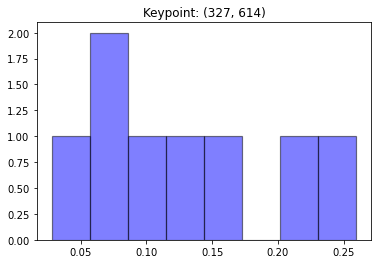

[0.05853254 0.02798938 0.127021   0.20745804 0.15653977 0.25953729
 0.06773206 0.09518993]


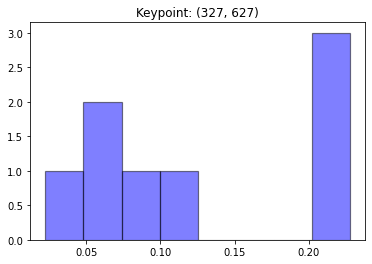

[0.20671254 0.06761094 0.04893556 0.07776096 0.22755338 0.22755338
 0.0225228  0.12135044]


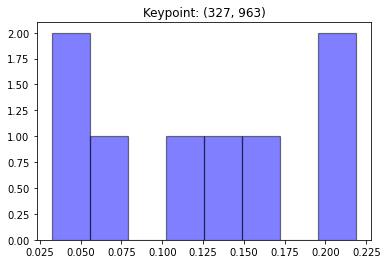

[0.07054587 0.03231902 0.16556773 0.21879973 0.21879973 0.1102582
 0.04992727 0.13378245]


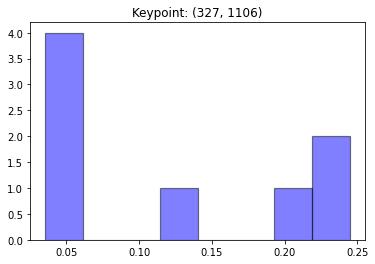

[0.03562594 0.12034485 0.21696148 0.24479589 0.24479589 0.05654229
 0.0432012  0.03773247]


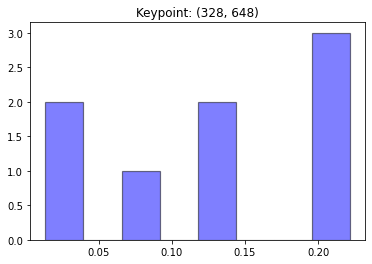

[0.1298291  0.19680178 0.12795807 0.20878247 0.22157682 0.08737918
 0.01362725 0.01404532]


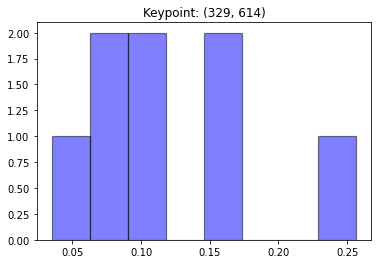

[0.08053907 0.03496079 0.15904773 0.15156847 0.11410655 0.25656474
 0.08648094 0.11673172]


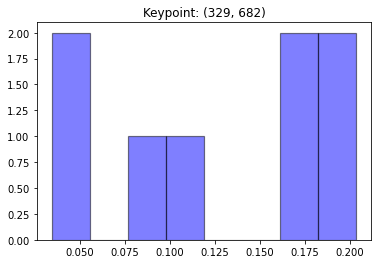

[0.20330151 0.11322299 0.03565711 0.03433881 0.0856606  0.16547226
 0.16981305 0.19253368]


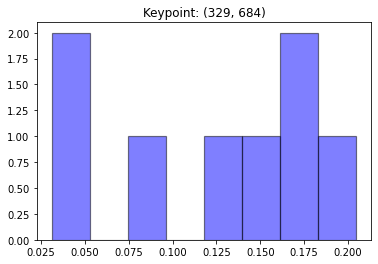

[0.17266593 0.08647018 0.0311587  0.04807036 0.14478639 0.20462681
 0.18050634 0.13171528]


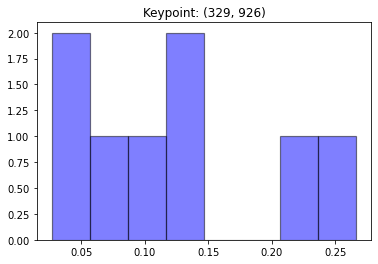

[0.13707513 0.08116948 0.1273701  0.11210661 0.02660218 0.03722756
 0.21181832 0.26663062]


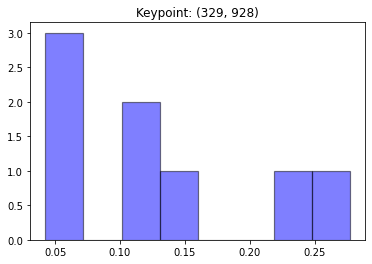

[0.11783224 0.04250216 0.10587692 0.13193318 0.04382168 0.05018515
 0.23086178 0.27698688]


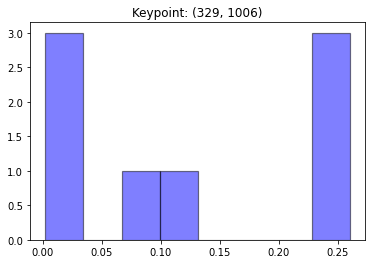

[0.01324517 0.07350037 0.26019312 0.26019312 0.26019312 0.12765355
 0.00292832 0.00209321]


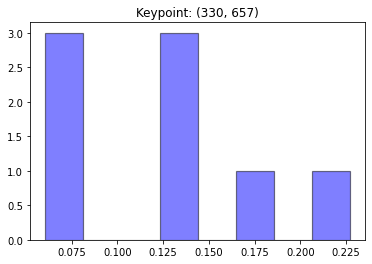

[0.14193365 0.07385042 0.06074461 0.13222395 0.06380783 0.12830105
 0.22701362 0.17212486]


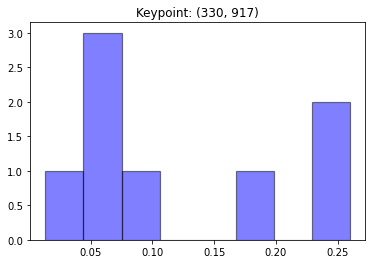

[0.1964629  0.10302348 0.05501134 0.05951241 0.01340747 0.06133465
 0.25132961 0.25991813]


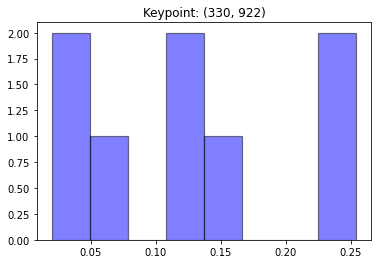

[0.25328261 0.13996515 0.11033523 0.05955978 0.02026201 0.03529253
 0.12725484 0.25404785]


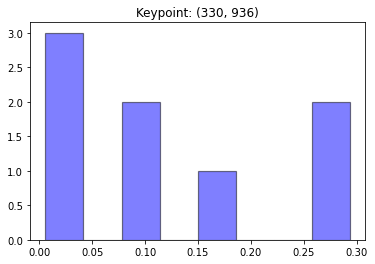

[0.00766967 0.0058     0.02122865 0.09841839 0.17340045 0.10664796
 0.29341744 0.29341744]


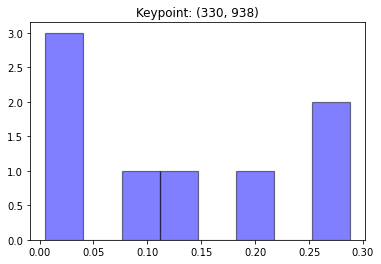

[0.00858453 0.00649185 0.00546373 0.08932677 0.18367937 0.13091885
 0.28776745 0.28776745]


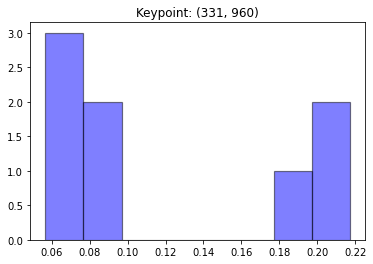

[0.20545633 0.09450046 0.07516352 0.07161473 0.08443731 0.0566582
 0.19499761 0.21717185]


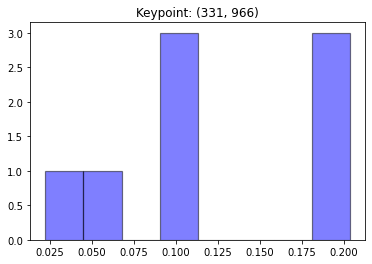

[0.10918085 0.02238968 0.20328826 0.20328826 0.10124898 0.06615929
 0.10615327 0.18829142]


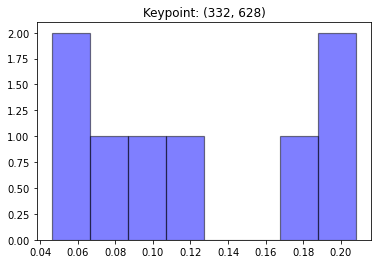

[0.04616163 0.18183191 0.12009605 0.09973154 0.20818661 0.20818661
 0.08526548 0.05054018]


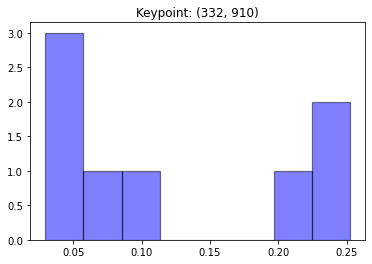

[0.08182753 0.03422036 0.02967862 0.0409417  0.10871306 0.2000173
 0.25230071 0.25230071]


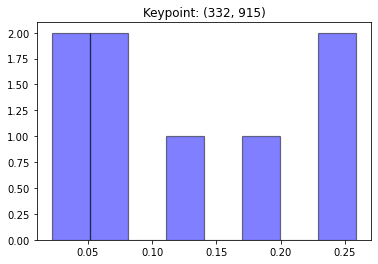

[0.2587696  0.11186115 0.03757513 0.05716864 0.02177233 0.06787956
 0.18620397 0.2587696 ]


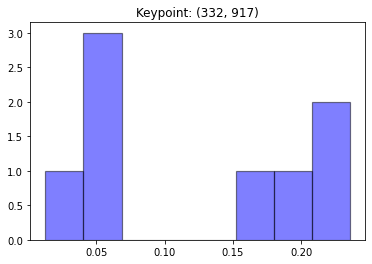

[0.23547708 0.17367506 0.0517095  0.04815131 0.01278471 0.05041139
 0.19231386 0.23547708]


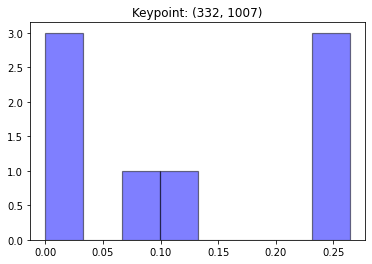

[0.00471721 0.06800978 0.26424452 0.26424452 0.26424452 0.13163144
 0.00290802 0.        ]


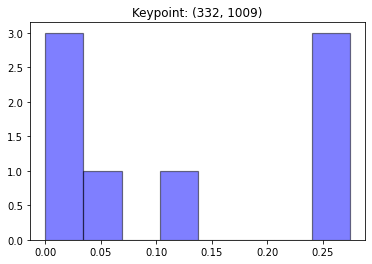

[0.         0.0537425  0.27424473 0.27424473 0.27424473 0.1235233
 0.         0.        ]


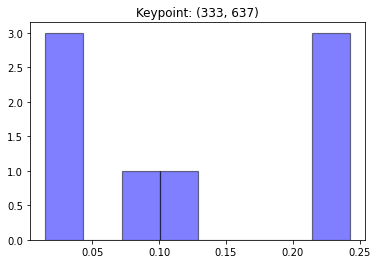

[0.08654052 0.01769988 0.01507855 0.02699961 0.12626495 0.24247216
 0.24247216 0.24247216]


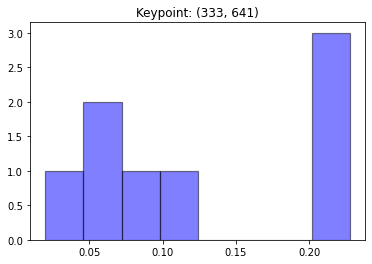

[0.09640009 0.02011492 0.05556612 0.05023811 0.21331496 0.22767209
 0.10902162 0.22767209]


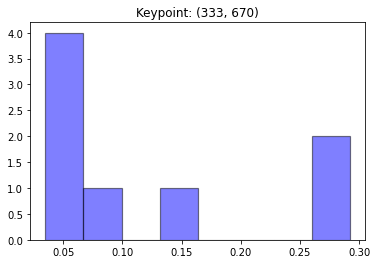

[0.05275363 0.04268183 0.03495202 0.06382538 0.08053185 0.29204284
 0.29204284 0.14116962]


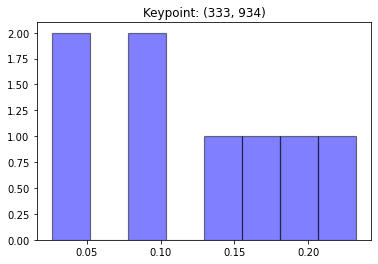

[0.20163846 0.02632679 0.03942016 0.10219797 0.1573405  0.09264895
 0.23246805 0.14795912]


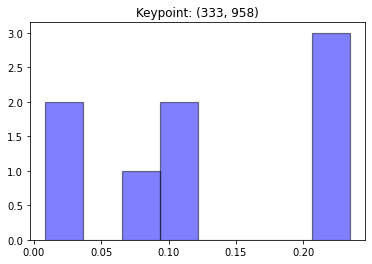

[0.23451628 0.10467142 0.01361513 0.00850016 0.09817784 0.07148661
 0.23451628 0.23451628]


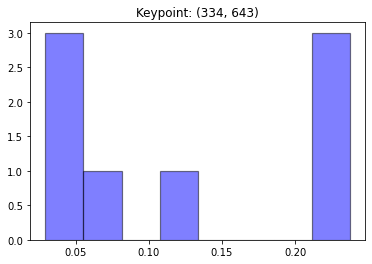

[0.11000066 0.06019328 0.04600839 0.04746305 0.2372037  0.2372037
 0.02942152 0.2325057 ]


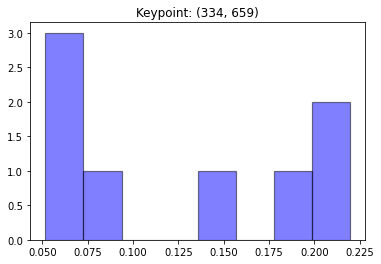

[0.17869279 0.07677396 0.05167792 0.13734724 0.0556639  0.21075637
 0.21959856 0.06948926]


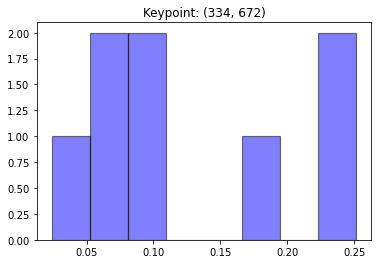

[0.08346631 0.0579561  0.0240465  0.05598553 0.10610553 0.25153764
 0.25153764 0.16936475]


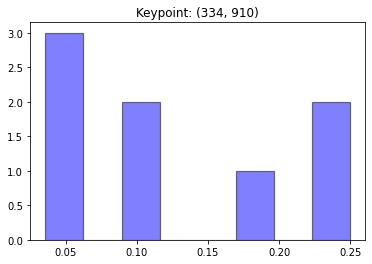

[0.10806908 0.05149808 0.03800251 0.03575183 0.09493231 0.17262007
 0.24956306 0.24956306]


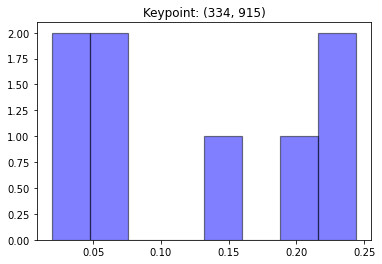

[0.24407596 0.21221044 0.03374898 0.05134735 0.01955533 0.06096762
 0.13401837 0.24407596]


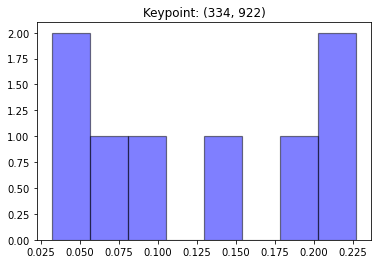

[0.22715248 0.22715248 0.18587177 0.05944289 0.03204281 0.04916411
 0.08345011 0.13572335]


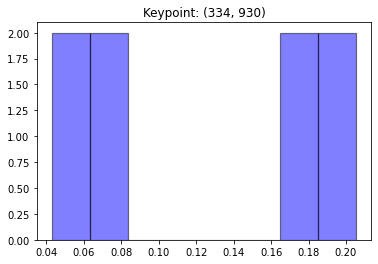

[0.20541512 0.06048949 0.16714636 0.16613202 0.07558086 0.07686549
 0.20541512 0.04295554]


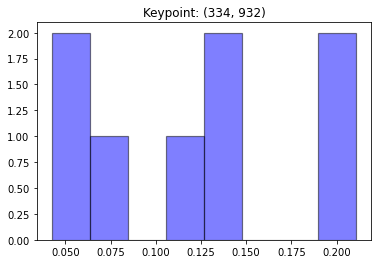

[0.20284635 0.05503115 0.11447959 0.14589905 0.14686417 0.0815719
 0.21083457 0.04247322]


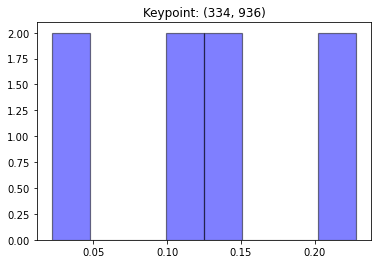

[0.14494244 0.02191829 0.0355499  0.11583156 0.20370767 0.11154192
 0.22797045 0.13853778]


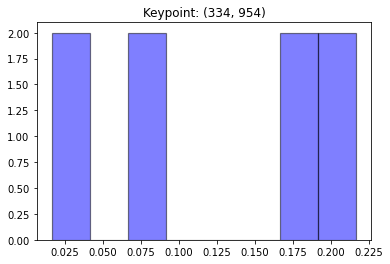

[0.18298382 0.07688482 0.02363797 0.01638566 0.08924136 0.21657659
 0.21657659 0.17771319]


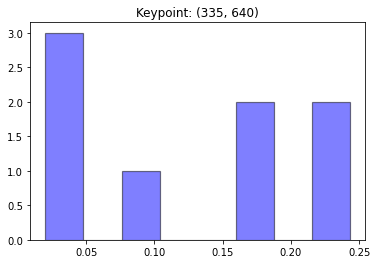

[0.08575152 0.02017825 0.02888576 0.03983982 0.17826911 0.24314133
 0.16079288 0.24314133]


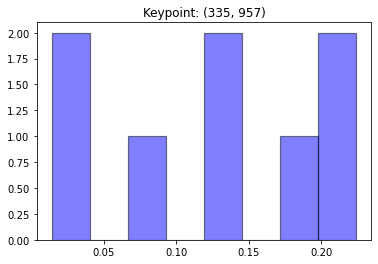

[0.21800607 0.08631639 0.01403164 0.01494006 0.12615059 0.17345602
 0.22400488 0.14309434]


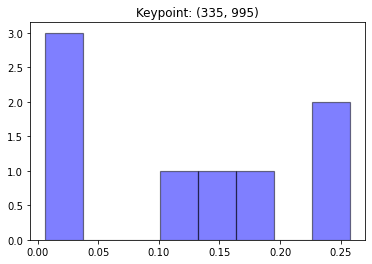

[0.02586235 0.00641586 0.01906847 0.18290646 0.25747352 0.25747352
 0.11572954 0.13507029]


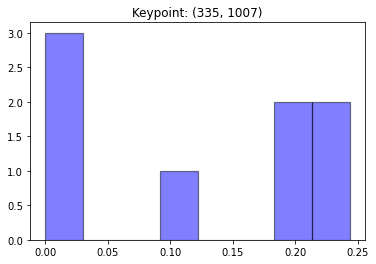

[0.00423889 0.19160936 0.24349417 0.19140001 0.24349417 0.11917884
 0.00658457 0.        ]


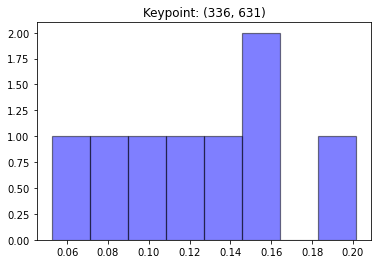

[0.05250222 0.16232051 0.1151638  0.07908388 0.1008219  0.12799137
 0.20156905 0.16054727]


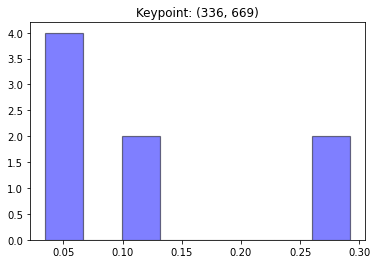

[0.05465402 0.04048323 0.03472225 0.06096167 0.11666705 0.29192073
 0.29192073 0.10867033]


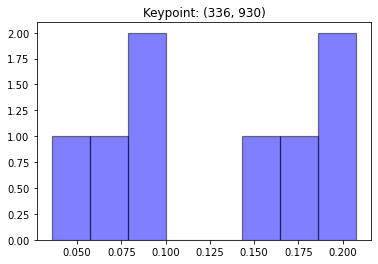

[0.20755903 0.07940481 0.18049306 0.15232329 0.03570408 0.06378442
 0.19409829 0.08663302]


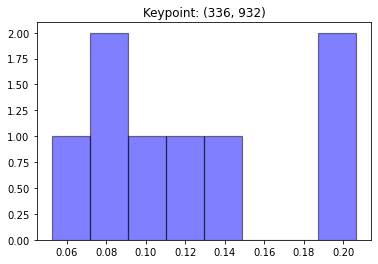

[0.20657627 0.08620336 0.12852055 0.14598422 0.09771043 0.0772363
 0.20537638 0.0523925 ]


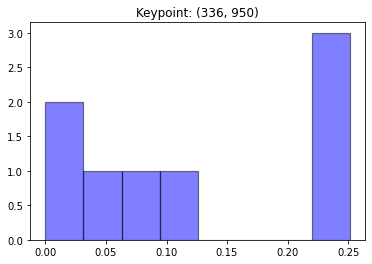

[0.11581892 0.05939449 0.         0.         0.07074069 0.25134864
 0.25134864 0.25134864]


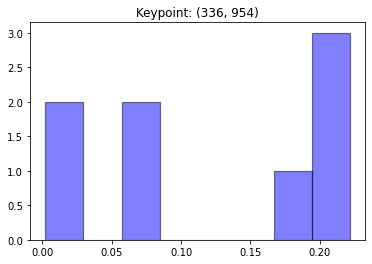

[0.20562069 0.07760909 0.01261618 0.00210697 0.07043692 0.22176091
 0.22176091 0.18808834]


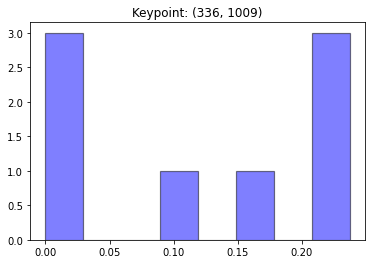

[0.01823363 0.23554792 0.23734954 0.16938686 0.23734954 0.10213251
 0.         0.        ]


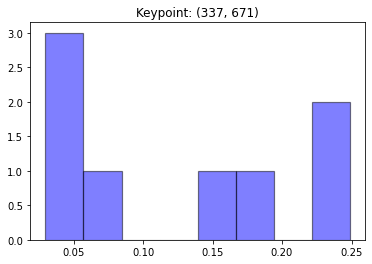

[0.04561268 0.04476348 0.02966985 0.06338003 0.17316436 0.24876256
 0.24876256 0.14588448]


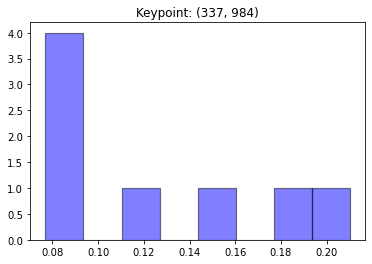

[0.21006447 0.14668155 0.08063197 0.0837998  0.12526901 0.18321893
 0.09339816 0.0769361 ]


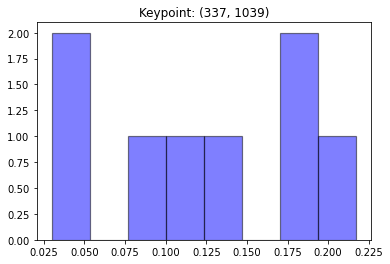

[0.17336337 0.09424737 0.11755447 0.21725051 0.1460562  0.03251893
 0.02987608 0.18913307]


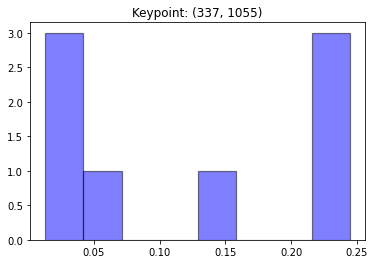

[0.01324741 0.04116426 0.24456841 0.24456841 0.24456841 0.13998214
 0.04849042 0.02341053]


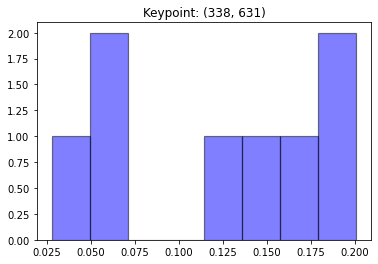

[0.05864898 0.20086436 0.15593977 0.06357862 0.02794491 0.12358147
 0.19898255 0.17045933]


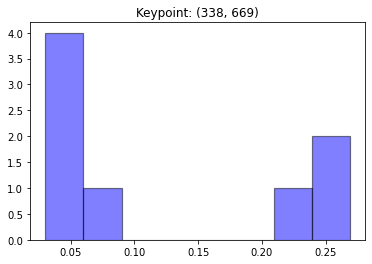

[0.0474393  0.0391364  0.03024755 0.05843432 0.24306109 0.26886145
 0.23421005 0.07860984]


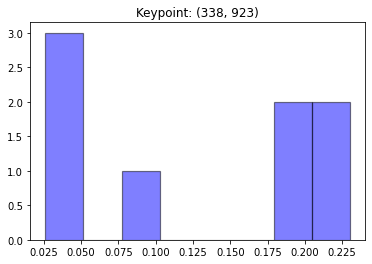

[0.21780321 0.23013255 0.18758511 0.04640381 0.03225381 0.02598231
 0.07789832 0.18194088]


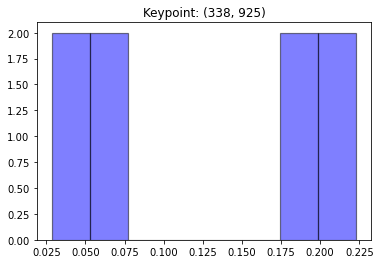

[0.22294278 0.22294278 0.18591157 0.05529783 0.03224769 0.02849544
 0.07287432 0.17928759]


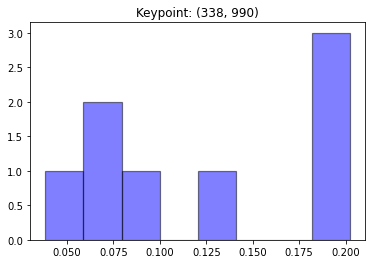

[0.19706043 0.12773222 0.07434273 0.05988811 0.03834409 0.20225417
 0.09812409 0.20225417]


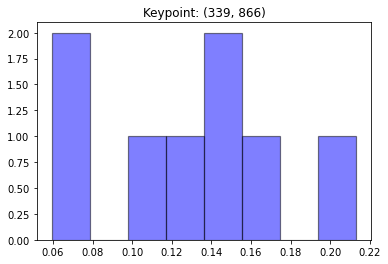

[0.14135725 0.10431962 0.06102402 0.05937567 0.11979303 0.16284325
 0.21315847 0.13812869]


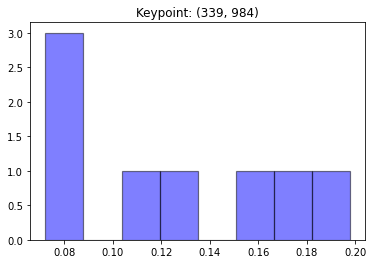

[0.17583124 0.12139219 0.0722978  0.0751382  0.10930159 0.16427938
 0.19764559 0.08411401]


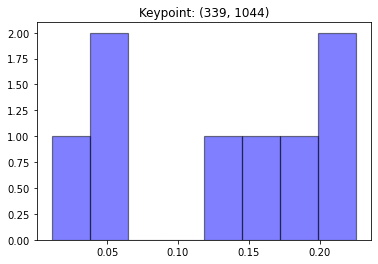

[0.17594094 0.14135584 0.22588183 0.15049031 0.04482951 0.0108581
 0.04639288 0.20425058]


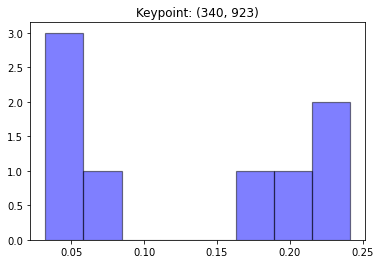

[0.23874996 0.24110341 0.16769928 0.03219141 0.0375147  0.03256505
 0.06054955 0.18962664]


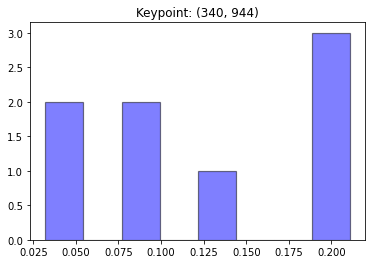

[0.08833695 0.03212282 0.03362203 0.14061472 0.21075621 0.07700987
 0.20678118 0.21075621]


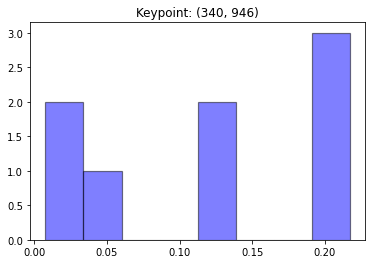

[0.05217132 0.00755849 0.03294226 0.13258751 0.21728189 0.12289474
 0.21728189 0.21728189]


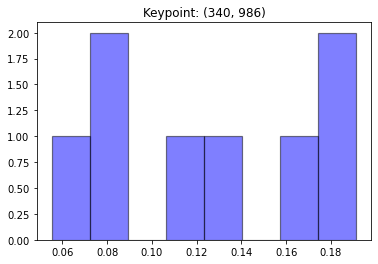

[0.16383337 0.11510214 0.078339   0.05527694 0.07985165 0.127389
 0.18895887 0.19124904]


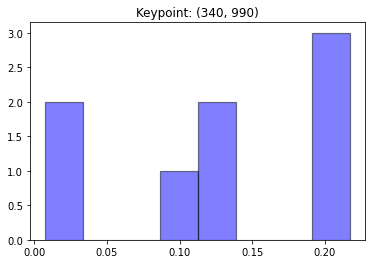

[0.1948761  0.13639221 0.09314124 0.0075818  0.0164959  0.2171189
 0.11727495 0.2171189 ]


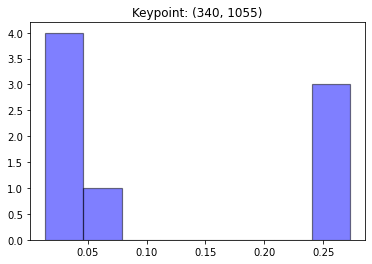

[0.01388622 0.04603154 0.2727099  0.2727099  0.2727099  0.07499941
 0.027111   0.01984213]


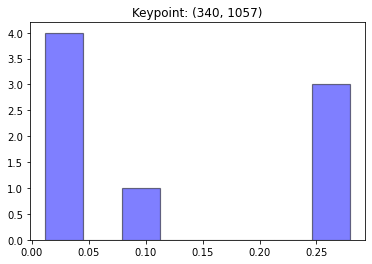

[0.01193457 0.03160799 0.27922995 0.27922995 0.27922995 0.07880185
 0.02291234 0.0170534 ]


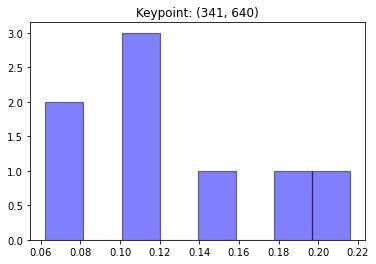

[0.07391045 0.19099377 0.10568328 0.06231    0.10448004 0.21588317
 0.1456304  0.10110891]


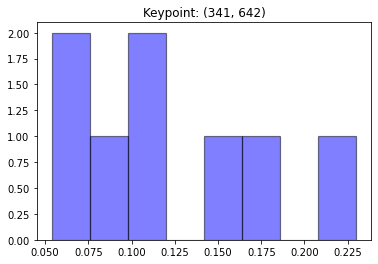

[0.06619961 0.17065583 0.0910305  0.05382075 0.11455149 0.22989703
 0.15500313 0.11884167]


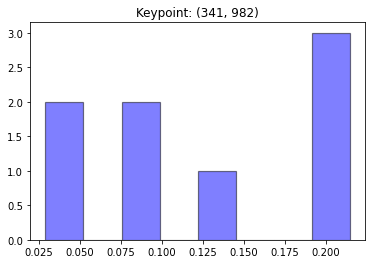

[0.08570851 0.04030593 0.0291262  0.09313016 0.12731062 0.19572489
 0.21434685 0.21434685]


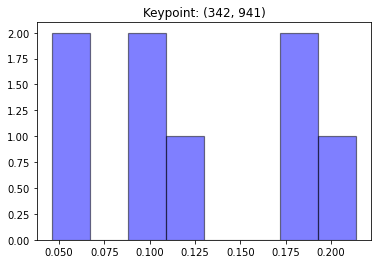

[0.11117671 0.05603793 0.04593099 0.18919868 0.21397079 0.09929
 0.18739807 0.09699683]


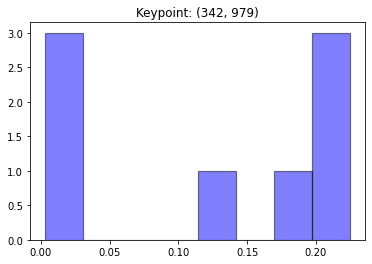

[0.02911334 0.00327142 0.01880999 0.17091536 0.12442266 0.20433444
 0.2245664  0.2245664 ]


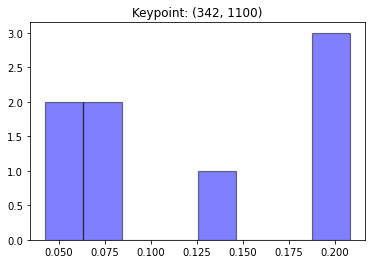

[0.06042001 0.07186218 0.07190892 0.20791038 0.20791038 0.20791038
 0.12944693 0.04263083]


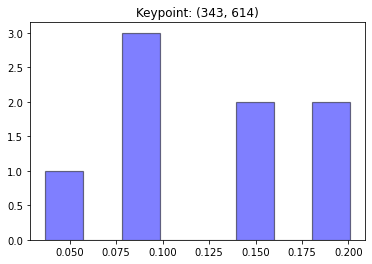

[0.08613011 0.18604873 0.20073958 0.09485558 0.03691672 0.09219026
 0.15362578 0.14949325]


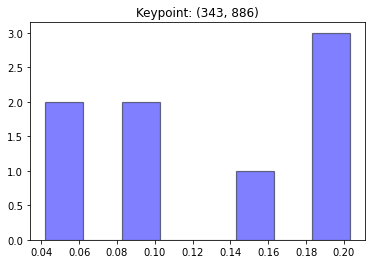

[0.18423139 0.20309384 0.20008418 0.04218056 0.08758236 0.04784503
 0.08434104 0.15064158]


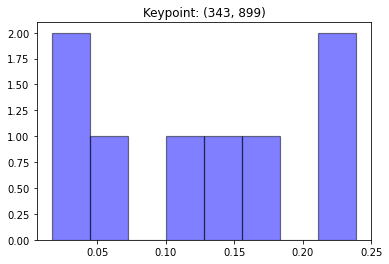

[0.14691487 0.23903241 0.23903241 0.16784397 0.03544043 0.0168789
 0.04577728 0.10907973]


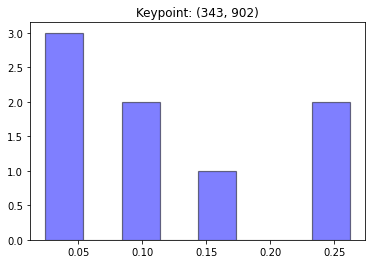

[0.14861492 0.26216585 0.26216585 0.1109823  0.04756189 0.02419924
 0.03125138 0.11305858]


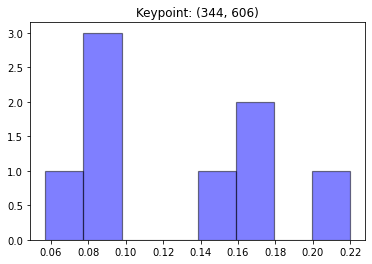

[0.0780855  0.21979869 0.17900749 0.16768164 0.14092916 0.08000753
 0.07742154 0.05706845]


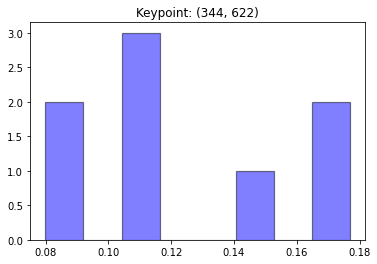

[0.11033526 0.11466626 0.14871882 0.07991719 0.08551874 0.17687037
 0.16924442 0.11472893]


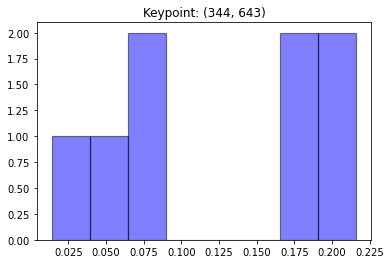

[0.0779978  0.17724937 0.08434341 0.05418739 0.01394935 0.2160682
 0.20281838 0.1733861 ]


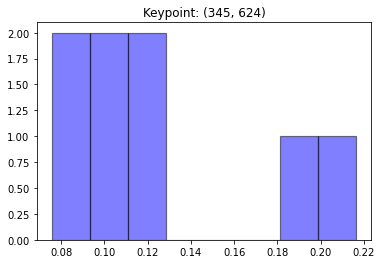

[0.10778975 0.10705095 0.11088318 0.07568002 0.07595119 0.18297262
 0.21645295 0.12321933]


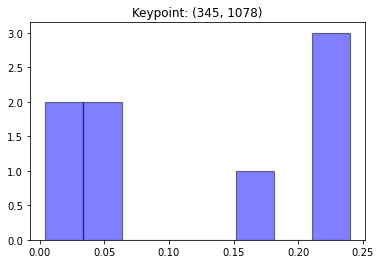

[0.1542162  0.23402921 0.23980117 0.23980117 0.04549387 0.06315469
 0.00452542 0.01897827]


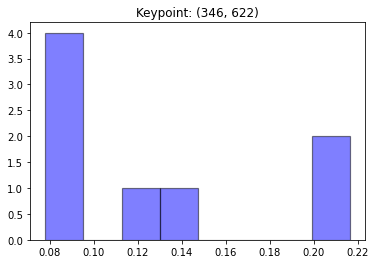

[0.07791286 0.08680174 0.13491293 0.07833016 0.09160562 0.20125851
 0.21627197 0.11290622]


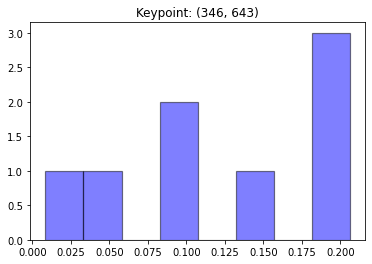

[0.09010229 0.20169016 0.09814295 0.05634518 0.00854908 0.14164676
 0.20617346 0.19735012]


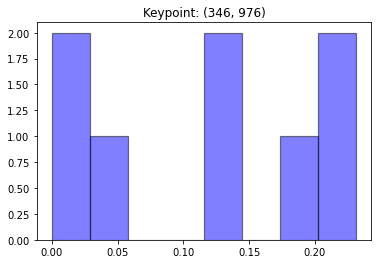

[0.02347994 0.         0.13465873 0.23135037 0.05150376 0.12644707
 0.20120976 0.23135037]


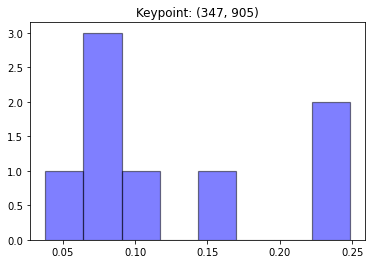

[0.1500817  0.24827162 0.24827162 0.10720501 0.06999137 0.06937016
 0.0380702  0.06873834]


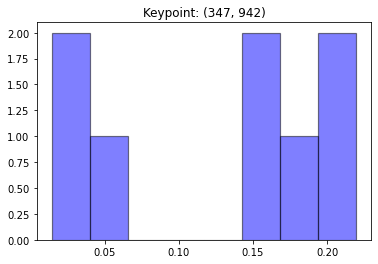

[0.04345547 0.01816783 0.01445771 0.18905455 0.2194746  0.14387478
 0.2194746  0.15204045]


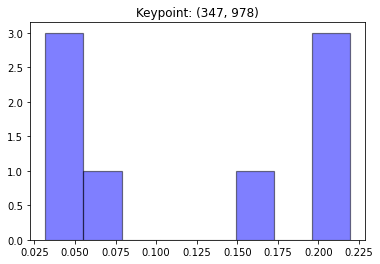

[0.03181047 0.0354683  0.15174492 0.21927716 0.04671474 0.07645831
 0.21927716 0.21924896]


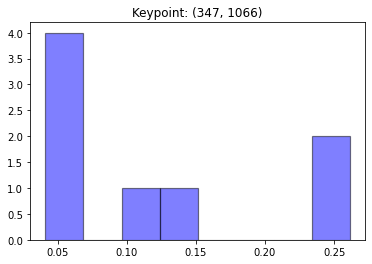

[0.10038542 0.06361719 0.26134506 0.26134506 0.0412301  0.0581919
 0.06378523 0.15010004]


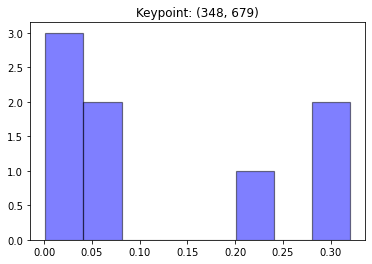

[0.0186489  0.00125797 0.02653628 0.05097597 0.21691833 0.32011601
 0.32011601 0.04543054]


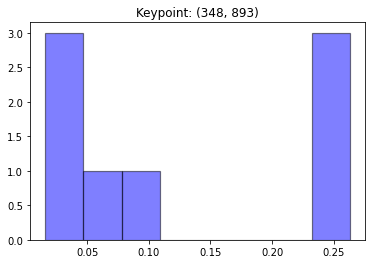

[0.08422041 0.26296759 0.26296759 0.26296759 0.05101552 0.03242855
 0.01622995 0.0272028 ]


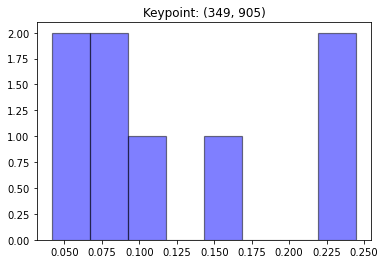

[0.15833415 0.24462717 0.24462717 0.11286158 0.07588881 0.07333981
 0.04163685 0.04868446]


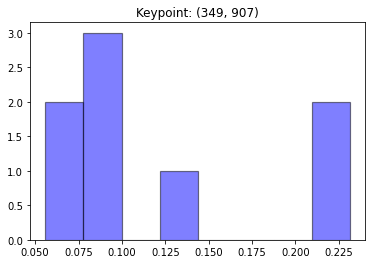

[0.1379665  0.23128278 0.23128278 0.09863933 0.09649938 0.0876964
 0.06070254 0.05593029]


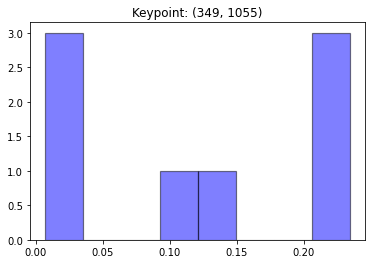

[0.01748522 0.13487185 0.23233833 0.23452284 0.23452284 0.10951336
 0.02952519 0.00722036]


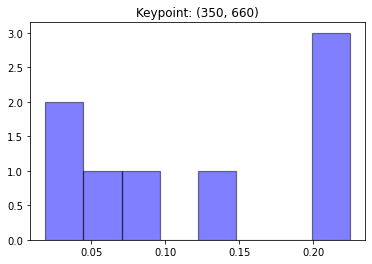

[0.09415033 0.01907139 0.02250413 0.05120702 0.22175678 0.22464297
 0.22464297 0.14202442]


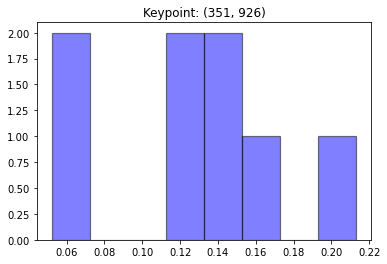

[0.2130486  0.05221413 0.05663543 0.13920915 0.12149475 0.16054402
 0.12085869 0.13599524]


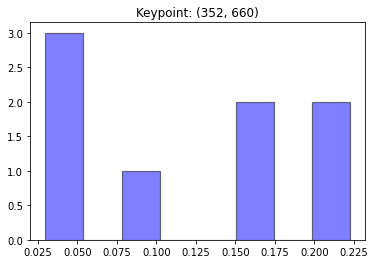

[0.10056061 0.04850441 0.02985469 0.04723568 0.17174616 0.22231118
 0.22231118 0.15747609]


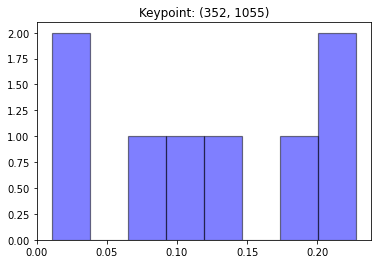

[0.02062742 0.11377259 0.22764431 0.22764431 0.18365478 0.13005116
 0.08583845 0.01076698]


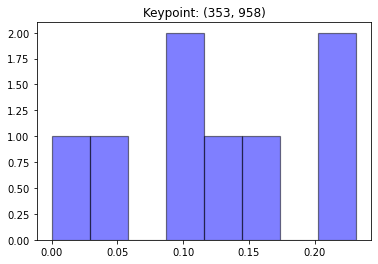

[0.23164484 0.12854967 0.         0.03728304 0.09506054 0.23164484
 0.17017313 0.10564394]


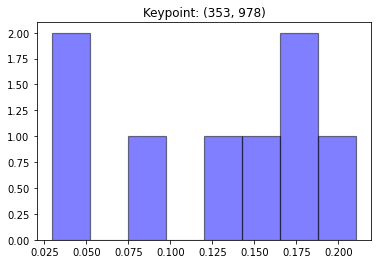

[0.02942711 0.0749989  0.17595029 0.21063983 0.14710205 0.1366582
 0.18229518 0.04292844]


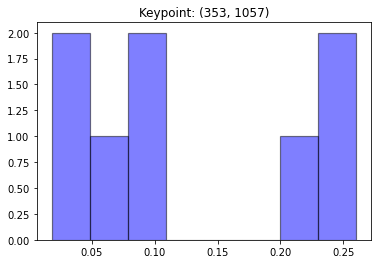

[0.02866459 0.08712887 0.20232747 0.26025486 0.26025486 0.08517628
 0.05817325 0.01801984]


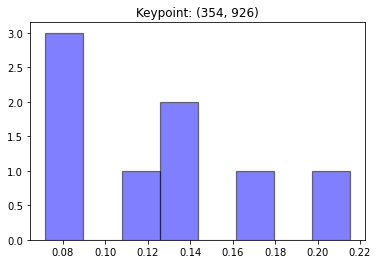

[0.11510168 0.0832645  0.16244433 0.21520783 0.13166825 0.13391854
 0.08664878 0.07174609]


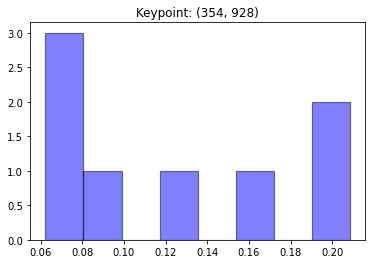

[0.20847363 0.06225081 0.16170725 0.20847363 0.09015727 0.12655343
 0.07614087 0.06624311]


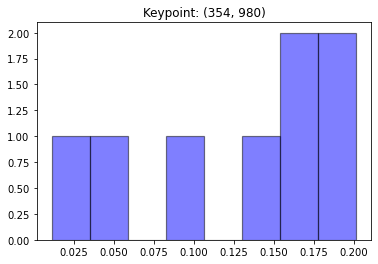

[0.03662372 0.08551095 0.18942256 0.16817248 0.16345407 0.14420497
 0.20143963 0.01117163]


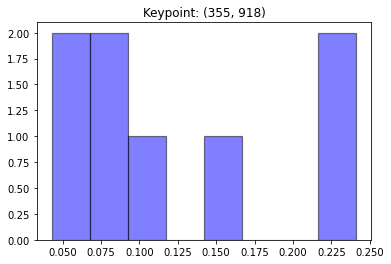

[0.16284363 0.24116797 0.24116797 0.1123715  0.07640995 0.07089597
 0.05228471 0.04285829]


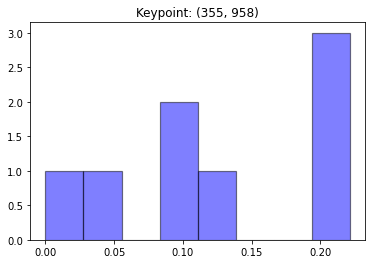

[0.2214323  0.09862695 0.         0.03407247 0.11584875 0.2214323
 0.20356909 0.10501813]


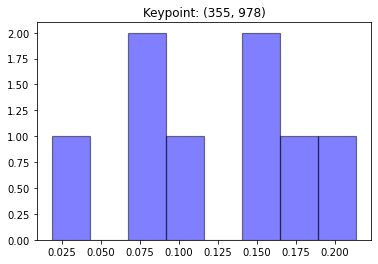

[0.01844614 0.07965064 0.18686346 0.11308741 0.15044031 0.14743119
 0.21362439 0.09045646]


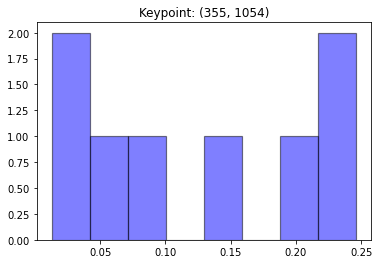

[0.02040228 0.0656952  0.07840524 0.24609186 0.24609186 0.19795791
 0.1324834  0.01287225]


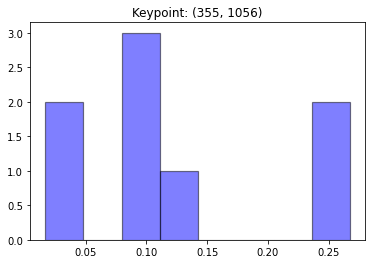

[0.02661517 0.08808399 0.10813456 0.26741534 0.26741534 0.12886648
 0.09667703 0.01679209]


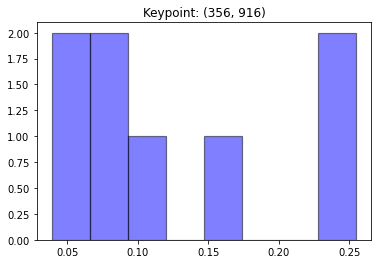

[0.15296452 0.25475577 0.25475577 0.10339286 0.08426924 0.06897909
 0.03908705 0.0417957 ]


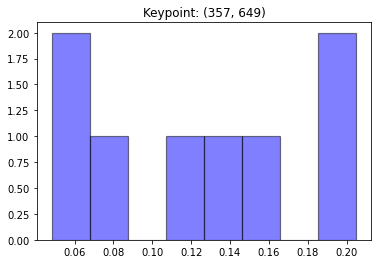

[0.07329581 0.04829579 0.05132194 0.11887733 0.20486479 0.13553099
 0.20486479 0.16294856]


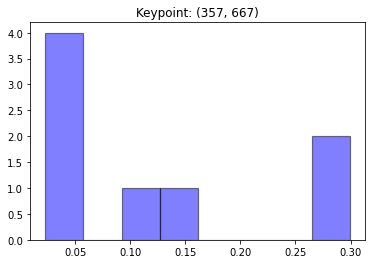

[0.03147281 0.02274076 0.04122763 0.05706721 0.13262858 0.29933119
 0.29933119 0.11620064]


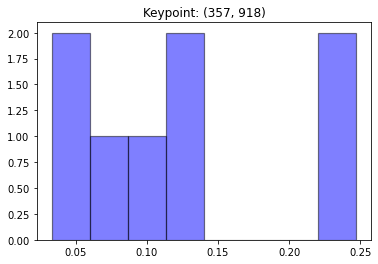

[0.13514739 0.24698011 0.24698011 0.13431224 0.08984784 0.0690788
 0.03323732 0.0444162 ]


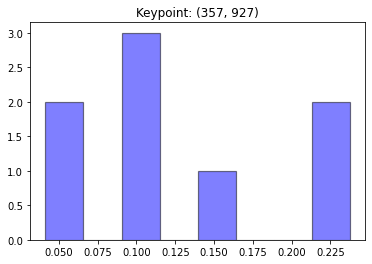

[0.09289103 0.13958149 0.23758288 0.23758288 0.09805763 0.09397239
 0.04124662 0.05908508]


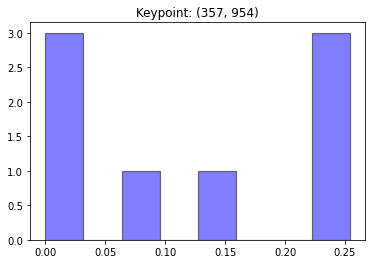

[0.01860986 0.         0.         0.13700255 0.24776139 0.25395084
 0.25395084 0.08872453]


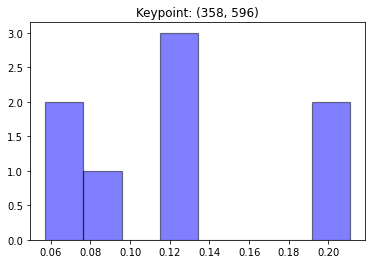

[0.12710568 0.08128186 0.1174967  0.21076835 0.20655904 0.06898568
 0.05731544 0.13048725]


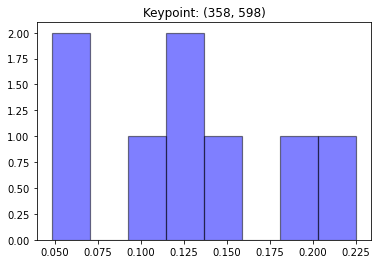

[0.12084717 0.0953749  0.14044195 0.22528081 0.19011005 0.04832538
 0.05625491 0.12336482]


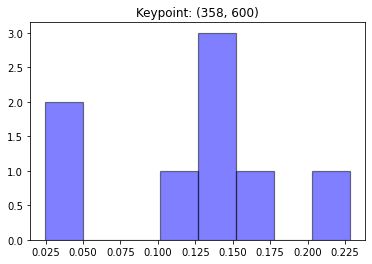

[0.14210129 0.11594358 0.17066742 0.22810418 0.14836184 0.02492931
 0.04253517 0.12735721]


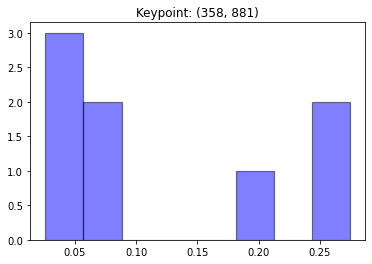

[0.02577561 0.06205637 0.198028   0.27451751 0.27451751 0.05288548
 0.05938726 0.05283225]


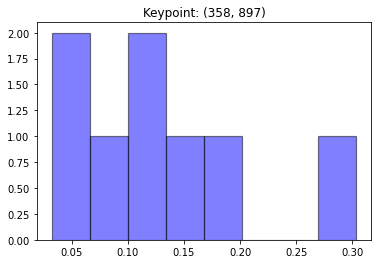

[0.10926787 0.14628022 0.30356334 0.17692572 0.06309718 0.06829149
 0.0320395  0.10053469]


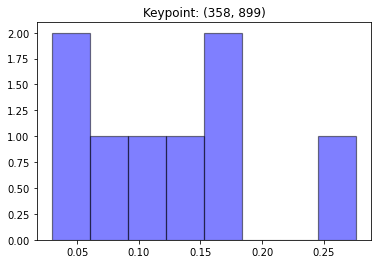

[0.16726971 0.16869398 0.27617931 0.1324336  0.05847482 0.06749207
 0.02948089 0.09997562]


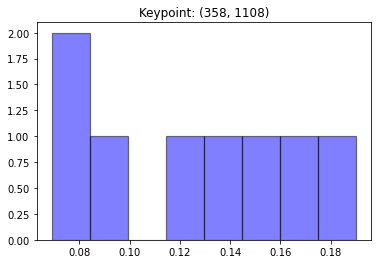

[0.06903162 0.12019486 0.19010272 0.14755955 0.16137412 0.13457361
 0.09441526 0.08274826]


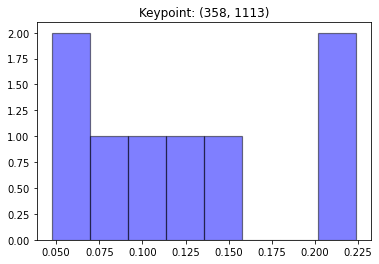

[0.04746912 0.13039896 0.10257221 0.22387688 0.22387688 0.13586619
 0.07050249 0.06543727]


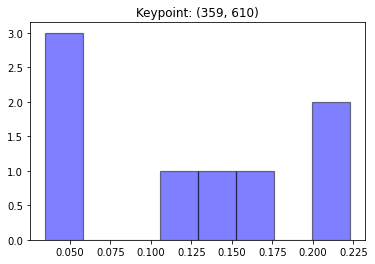

[0.05055411 0.1419568  0.22270972 0.22270972 0.16696782 0.11097293
 0.04923562 0.03489327]


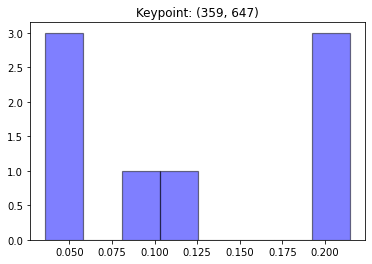

[0.0427876  0.03590916 0.05417901 0.1248316  0.2146045  0.2146045
 0.2146045  0.09847913]


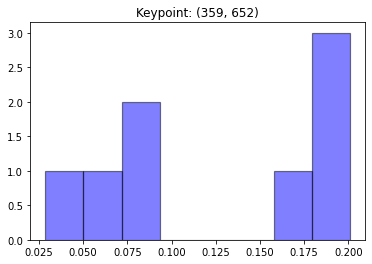

[0.08038929 0.05296107 0.08776374 0.20082347 0.17315398 0.02863811
 0.19505712 0.18121322]


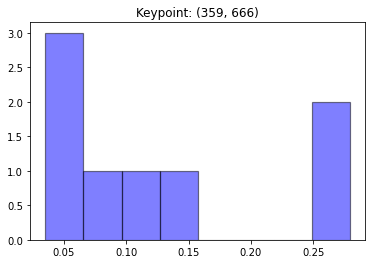

[0.03526967 0.0365063  0.05102463 0.06581666 0.13711892 0.27921178
 0.27921178 0.11584027]


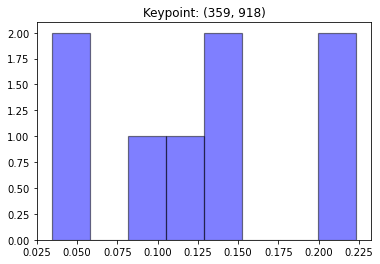

[0.10882115 0.21290705 0.22329296 0.15006767 0.13374482 0.09559032
 0.03436489 0.04121113]


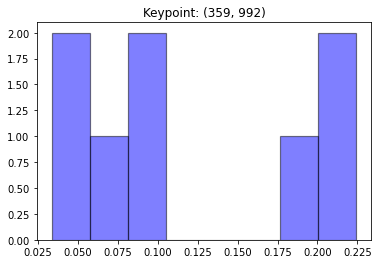

[0.10364419 0.05337269 0.03351112 0.07710907 0.22422579 0.22422579
 0.08662473 0.19728661]


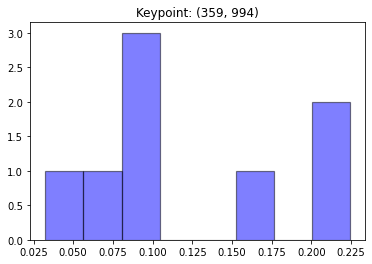

[0.08355181 0.10115068 0.0324923  0.09893245 0.22410786 0.22410786
 0.07160587 0.16405118]


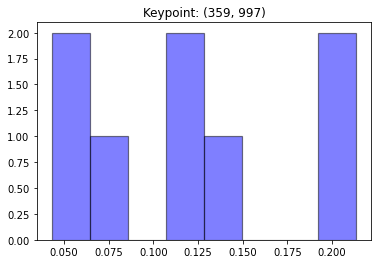

[0.07395646 0.12119519 0.04327267 0.12749016 0.21337013 0.21337013
 0.061771   0.14557427]


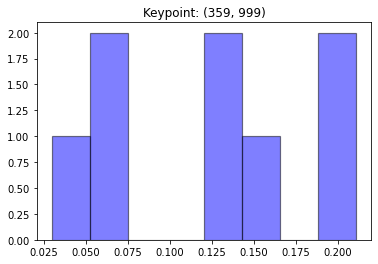

[0.07250085 0.12734063 0.05343801 0.16339049 0.21088501 0.20539536
 0.0297258  0.13732387]


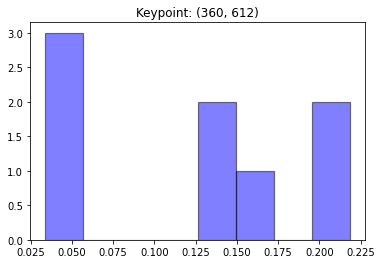

[0.0462158  0.14965839 0.21847375 0.21847375 0.14892599 0.13102383
 0.05330483 0.03392365]


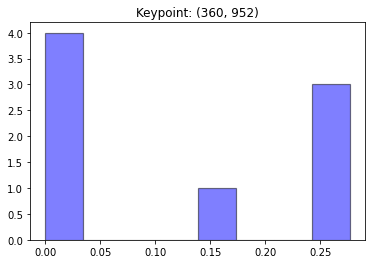

[0.00283674 0.         0.00151867 0.14327704 0.27666124 0.27666124
 0.27666124 0.02238382]


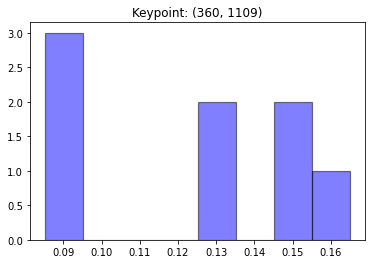

[0.09069381 0.12649778 0.08533282 0.13329107 0.16492895 0.15092322
 0.15458583 0.09374654]


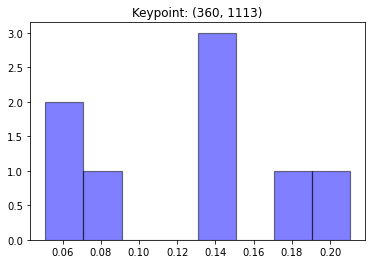

[0.0510473  0.14300432 0.14589468 0.17167695 0.21024402 0.13803775
 0.0766377  0.06345728]


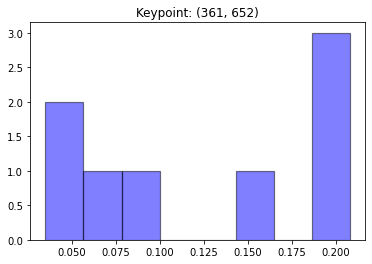

[0.05360757 0.03484066 0.08192559 0.19055015 0.20778772 0.06720819
 0.20778772 0.15629239]


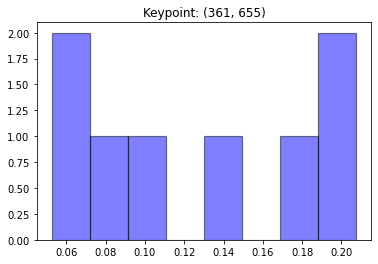

[0.05253488 0.05554532 0.09612413 0.20749038 0.20749038 0.07691537
 0.17382707 0.13007248]


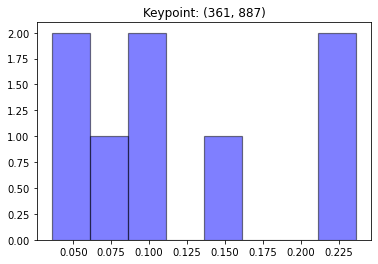

[0.08159835 0.23664113 0.23664113 0.15488531 0.10756608 0.03580448
 0.0564005  0.09046302]


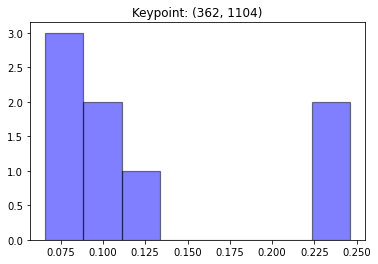

[0.07308659 0.07933637 0.24595162 0.22348801 0.06597003 0.10351667
 0.11393471 0.09471599]


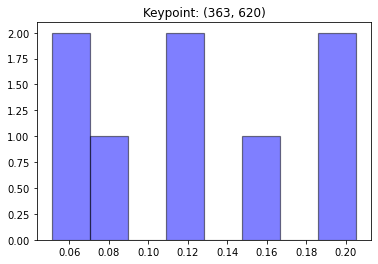

[0.20518626 0.20518626 0.15898155 0.12811641 0.05119352 0.06388705
 0.07572191 0.11172705]


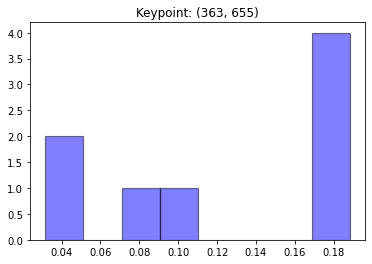

[0.04621816 0.0317253  0.07994298 0.17682136 0.18093002 0.10882981
 0.18730604 0.18822633]


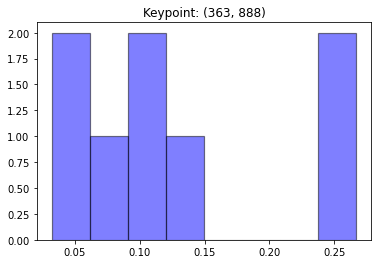

[0.09241155 0.26703264 0.26703264 0.12852709 0.09462738 0.0357156
 0.03204398 0.08260913]


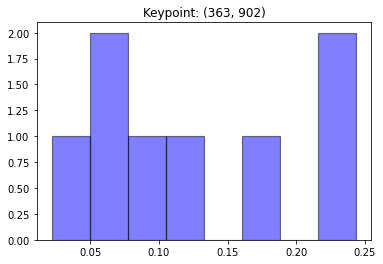

[0.12305185 0.24363064 0.24363064 0.16339372 0.06366905 0.05254192
 0.02207397 0.08800821]


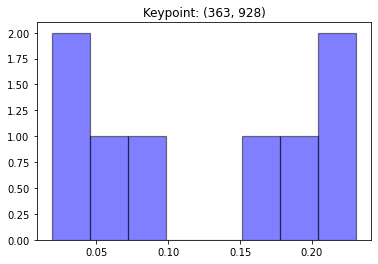

[0.18604641 0.20751639 0.2307248  0.15908946 0.04359069 0.06422088
 0.01896532 0.08984605]


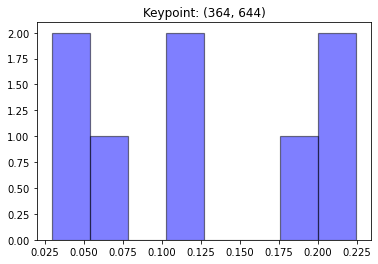

[0.02948103 0.06307914 0.03825822 0.11335207 0.22454606 0.22454606
 0.18868868 0.11804873]


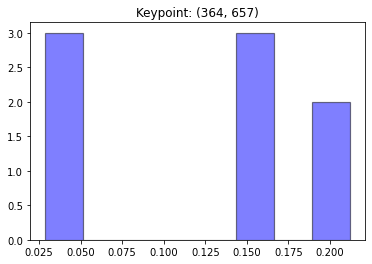

[0.03793947 0.02880021 0.0448571  0.15683738 0.14524138 0.16257916
 0.21187264 0.21187264]


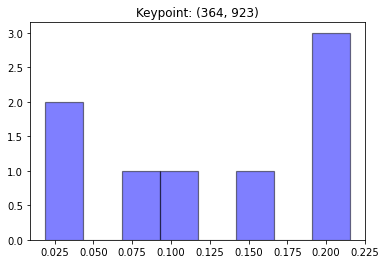

[0.0936802  0.19676273 0.21531401 0.15056331 0.08647909 0.21018325
 0.01900806 0.02800934]


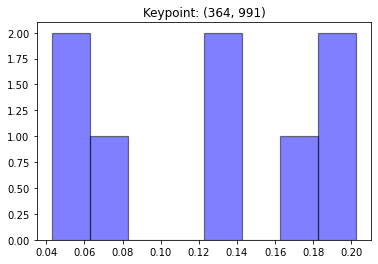

[0.16257683 0.12933895 0.05199167 0.04288886 0.1420189  0.20244509
 0.07757545 0.19116426]


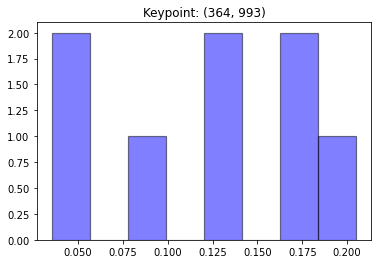

[0.13080117 0.09558637 0.03541262 0.05235339 0.18166646 0.20500995
 0.12246761 0.17670243]


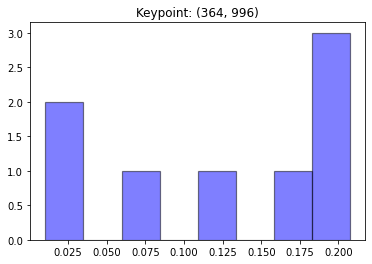

[0.1304672  0.01782018 0.01023481 0.06467861 0.20731895 0.20731895
 0.16118097 0.20098031]


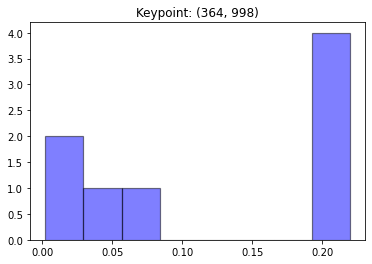

[0.04725734 0.00476183 0.00234949 0.07873555 0.21966478 0.21966478
 0.20790146 0.21966478]


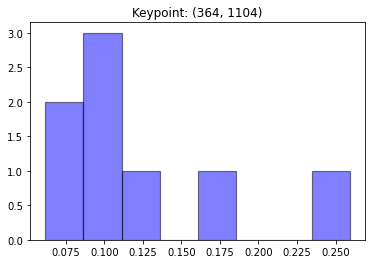

[0.11356977 0.10530537 0.25927011 0.17031276 0.08325458 0.06169118
 0.10842087 0.09817537]


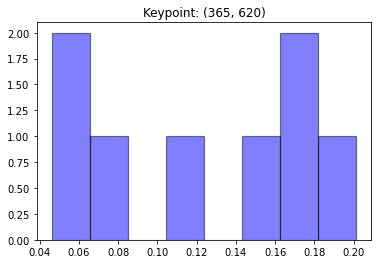

[0.20125651 0.15314511 0.17612239 0.17832507 0.04622038 0.05583844
 0.06829502 0.12079709]


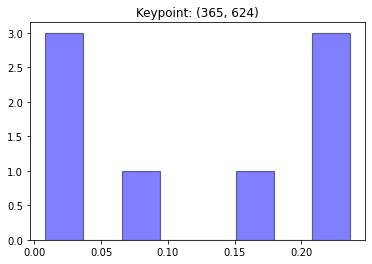

[0.23641552 0.23641552 0.22765357 0.17599884 0.02171342 0.00822663
 0.01887925 0.07469724]


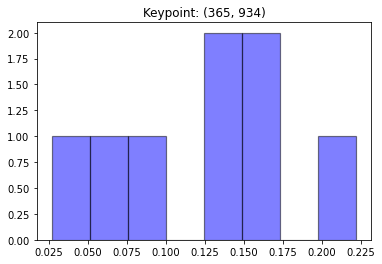

[0.16192953 0.02696092 0.15471812 0.12956082 0.09101428 0.07000049
 0.14384599 0.22196985]


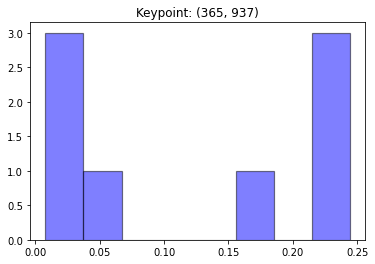

[0.24418098 0.22401607 0.0230688  0.00785277 0.02746727 0.05247845
 0.17675469 0.24418098]


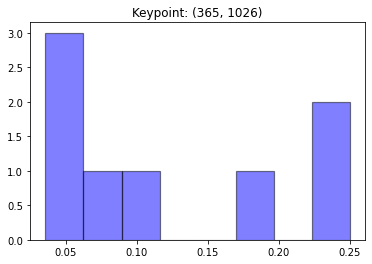

[0.07219463 0.05879751 0.1815286  0.25014935 0.25014935 0.08996402
 0.06168457 0.03553196]


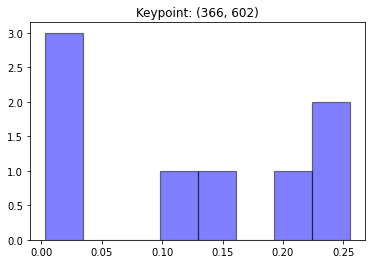

[0.00952184 0.14844315 0.20516979 0.25533805 0.25533805 0.11638828
 0.00637804 0.00342279]


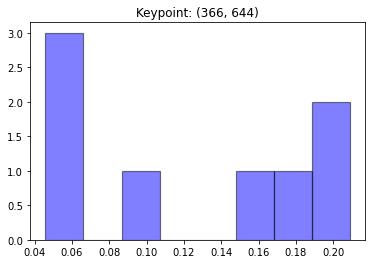

[0.04581665 0.05940543 0.05100126 0.10486696 0.20886101 0.17901944
 0.20313555 0.14789369]


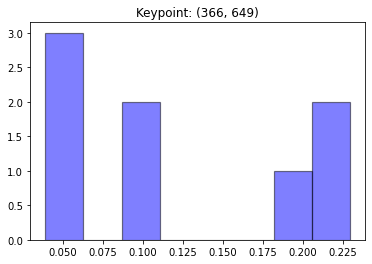

[0.06004986 0.05783262 0.03929813 0.09267865 0.20368446 0.08794192
 0.22925718 0.22925718]


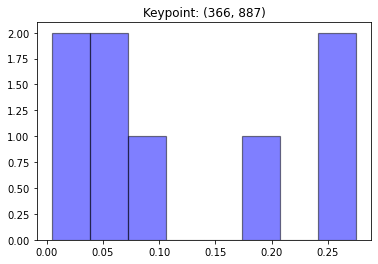

[0.0632294  0.2752363  0.2752363  0.2065452  0.08370175 0.00448301
 0.0294871  0.06208093]


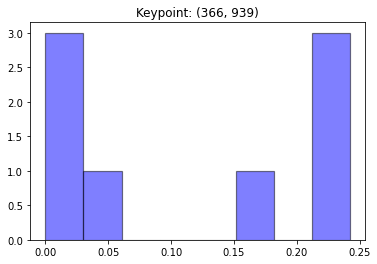

[0.24220992 0.24220992 0.02657092 0.         0.02636006 0.05524556
 0.1651937  0.24220992]


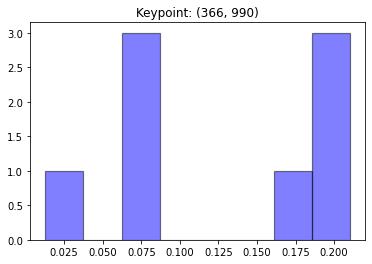

[0.2101953  0.16489156 0.0650328  0.01280704 0.0726665  0.2101953
 0.06402298 0.20018851]


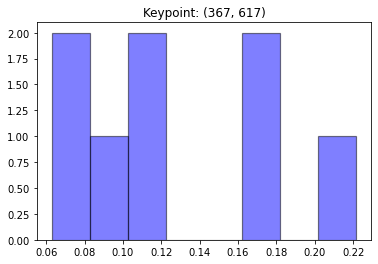

[0.12173969 0.16879489 0.22156947 0.17419595 0.08386687 0.06407514
 0.06292623 0.10283177]


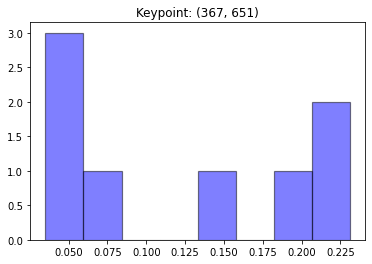

[0.0582778  0.03507875 0.05510802 0.06429489 0.18417058 0.14105169
 0.23100913 0.23100913]


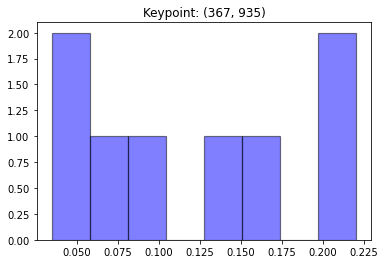

[0.20364653 0.03457448 0.05706144 0.16873962 0.0995553  0.0727732
 0.14319867 0.22045075]


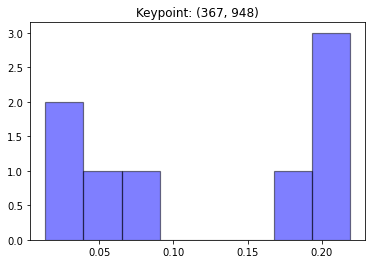

[0.21869431 0.21869431 0.01377246 0.04126808 0.17529725 0.21869431
 0.03541032 0.07816894]


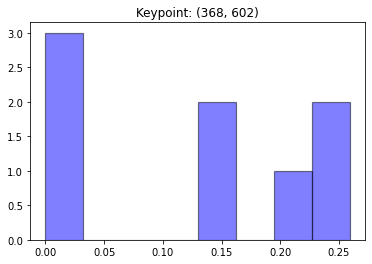

[0.01880157 0.14332176 0.20605644 0.23804007 0.25916327 0.13156353
 0.00305337 0.        ]


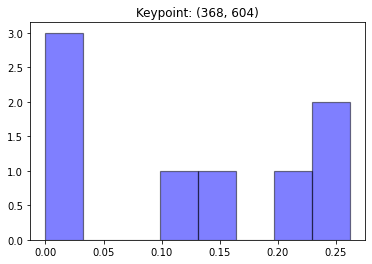

[0.02155151 0.14651493 0.24839633 0.19926432 0.26194087 0.12125571
 0.         0.00107634]


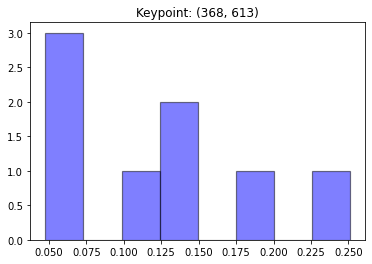

[0.12770482 0.19228835 0.25091928 0.14567987 0.06096393 0.06148388
 0.04772196 0.11323792]


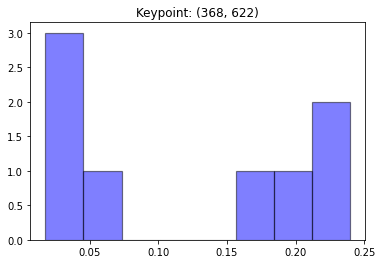

[0.23945921 0.2049895  0.23945921 0.16531379 0.04146416 0.05228056
 0.01763951 0.03939405]


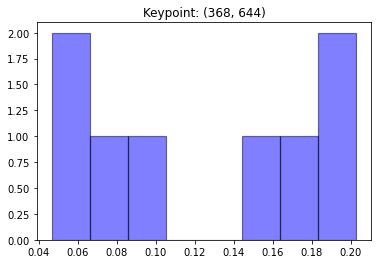

[0.04666031 0.06752463 0.05866965 0.17255441 0.19202932 0.09934503
 0.20276118 0.16045547]


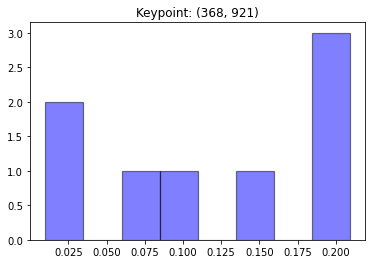

[0.07464118 0.20612891 0.20915802 0.15505713 0.10124842 0.20915802
 0.01000064 0.03460769]


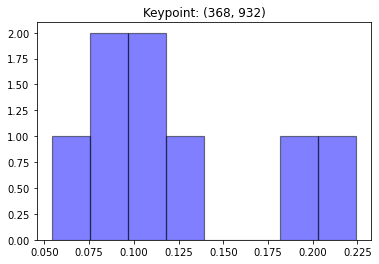

[0.10571993 0.0905591  0.05411817 0.22427753 0.11383687 0.07860009
 0.13353067 0.19935764]


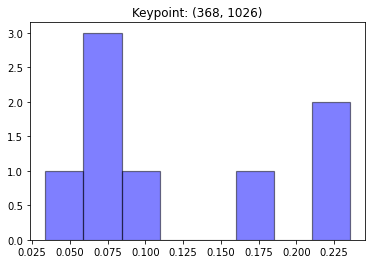

[0.07658871 0.06383831 0.1767462  0.23546669 0.23546669 0.08331911
 0.0947711  0.03380319]


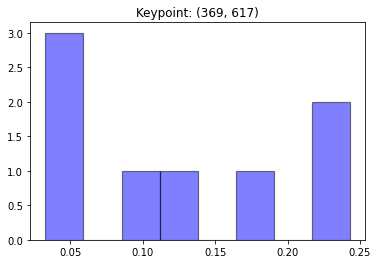

[0.12059735 0.22485452 0.24293787 0.18371868 0.05706468 0.03280109
 0.04121742 0.09680839]


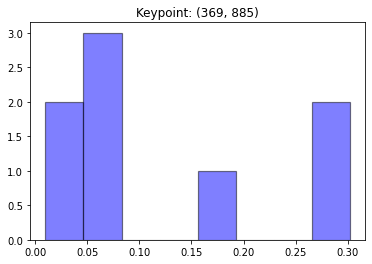

[0.0734551  0.16650313 0.30190327 0.30190327 0.05697292 0.00989876
 0.02535053 0.06401302]


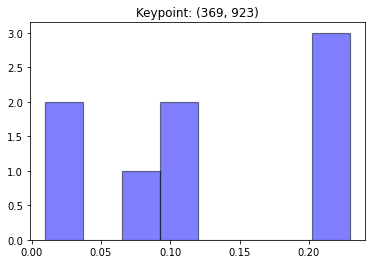

[0.08658937 0.22951678 0.22951678 0.11024735 0.0934853  0.20975157
 0.0098466  0.03104626]


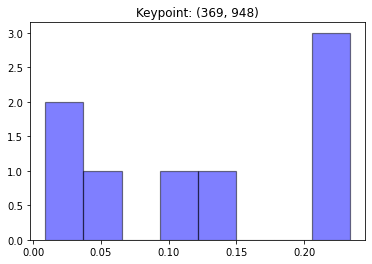

[0.23372656 0.23372656 0.00907692 0.01498118 0.13217257 0.23372656
 0.03822146 0.10436817]


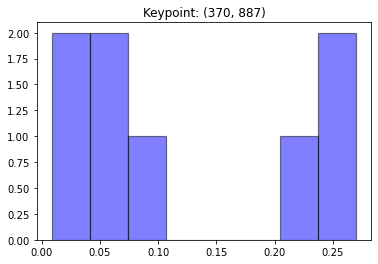

[0.08387973 0.23551934 0.26985659 0.26985659 0.04250689 0.00878816
 0.02250631 0.06708639]


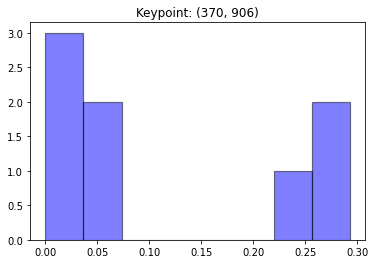

[0.07245721 0.29283068 0.29283068 0.239092   0.02507602 0.
 0.02107579 0.05663763]


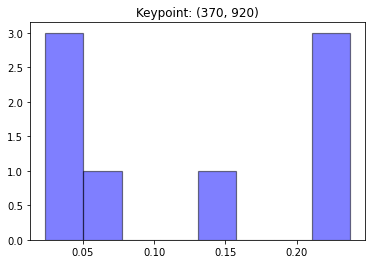

[0.0311768  0.23713111 0.23713111 0.13357313 0.06508307 0.23713111
 0.02381521 0.03495846]


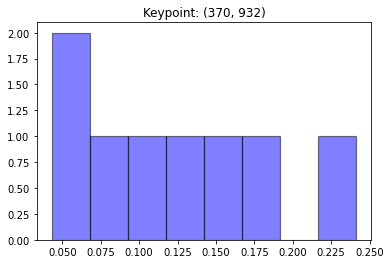

[0.08575752 0.12321414 0.04305578 0.24123194 0.17988472 0.06253005
 0.10402012 0.16030572]


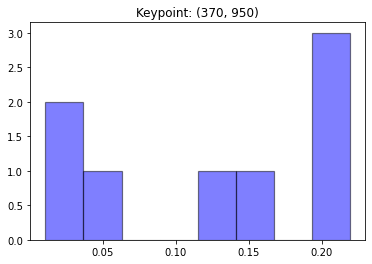

[0.21934059 0.20639443 0.01046748 0.01620851 0.15062094 0.21934059
 0.05751955 0.12010791]


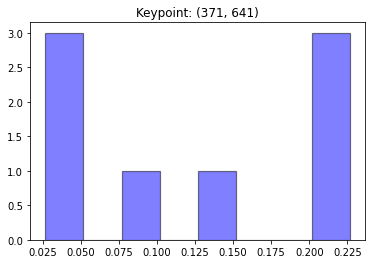

[0.02751176 0.02686147 0.04230075 0.15167553 0.22658502 0.22658502
 0.20844215 0.09003831]


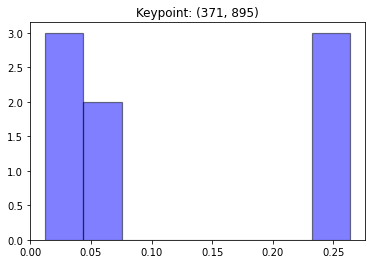

[0.07501454 0.26358125 0.26358125 0.26358125 0.06168664 0.03131672
 0.01239436 0.02884399]


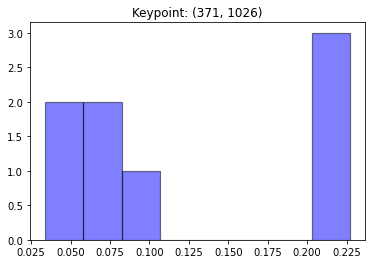

[0.07744301 0.04910503 0.06450914 0.22703532 0.22703532 0.22703532
 0.09381518 0.03402169]


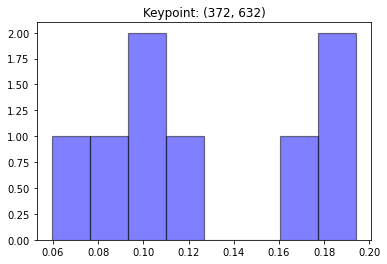

[0.05948286 0.18446027 0.19415855 0.09830522 0.09337644 0.11684535
 0.16523451 0.0881368 ]


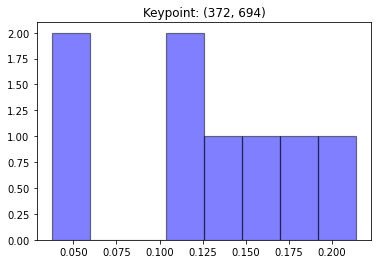

[0.11924462 0.05288064 0.03749632 0.10565676 0.17912611 0.13332739
 0.15823304 0.21403512]


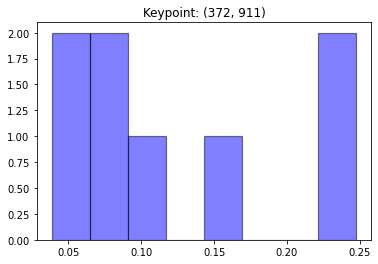

[0.08988238 0.24743371 0.24743371 0.09432736 0.05448771 0.03854963
 0.07557341 0.15231208]


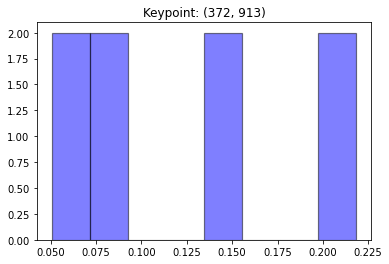

[0.08241323 0.21835003 0.21835003 0.13456088 0.06919101 0.0505597
 0.0769877  0.14958741]


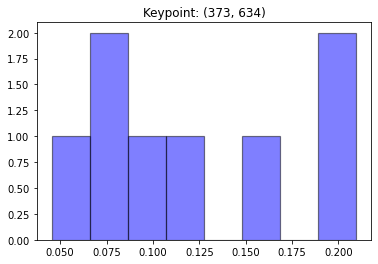

[0.04544193 0.08045511 0.20484892 0.10108066 0.12733408 0.14899086
 0.20957806 0.08227038]


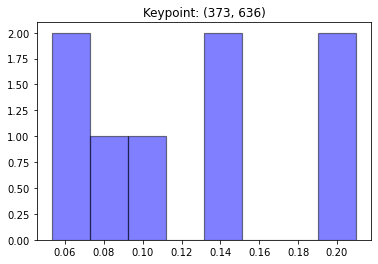

[0.05319437 0.07448444 0.15022344 0.10610437 0.13323006 0.20983428
 0.20983428 0.06309474]


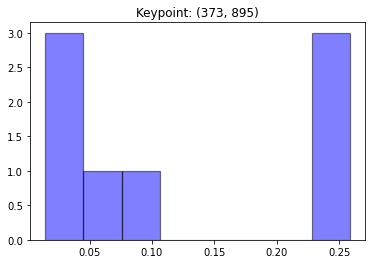

[0.06081001 0.25830786 0.25830786 0.25830786 0.0994368  0.03331835
 0.01685183 0.01465941]


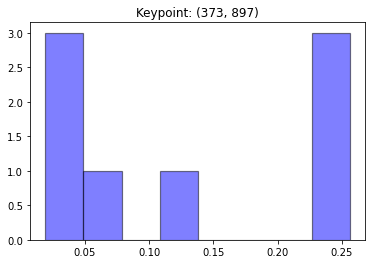

[0.05289734 0.24194813 0.25615836 0.25615836 0.11810865 0.03597966
 0.0192106  0.0195389 ]


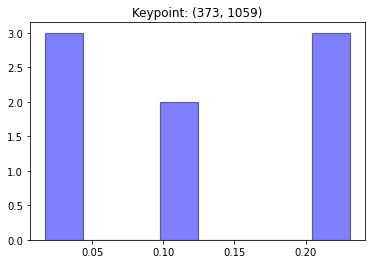

[0.01718461 0.23109726 0.23109726 0.23109726 0.1057507  0.11655619
 0.04235395 0.02486276]


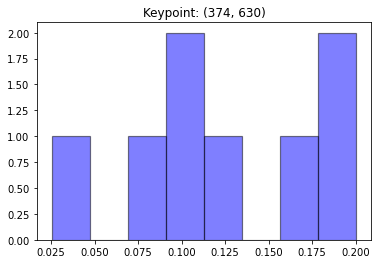

[0.11240414 0.16002252 0.20024848 0.0830538  0.02537209 0.10642209
 0.18708015 0.12539674]


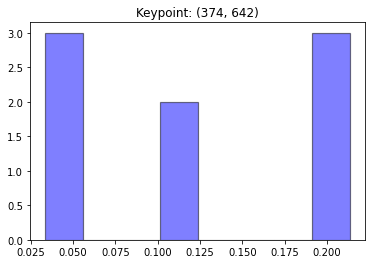

[0.05433949 0.03362844 0.05526174 0.1195484  0.2106669  0.21357379
 0.2090592  0.10392204]


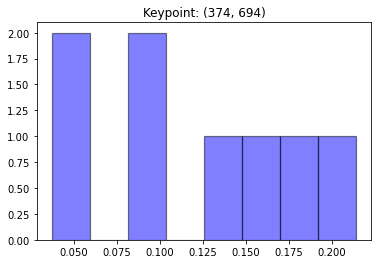

[0.10229864 0.05738257 0.03722857 0.14240523 0.18606453 0.09073961
 0.16965176 0.21422908]


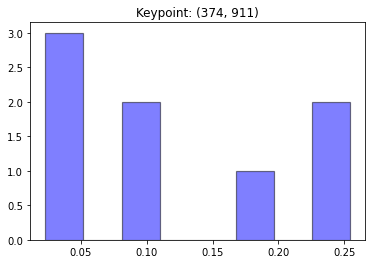

[0.10954103 0.25421924 0.25421924 0.03427311 0.02312228 0.04615198
 0.09938617 0.17908695]


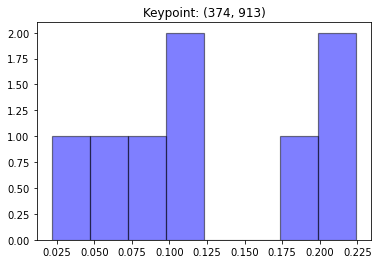

[0.10356648 0.2242185  0.2242185  0.07274897 0.02167321 0.06180635
 0.10916205 0.18260594]


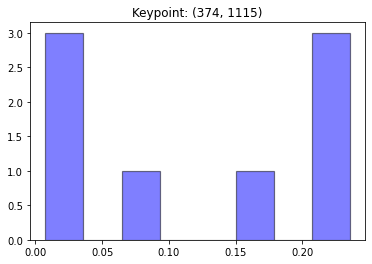

[0.07106716 0.16710451 0.23567379 0.23567379 0.23063815 0.01815824
 0.00745887 0.03422548]


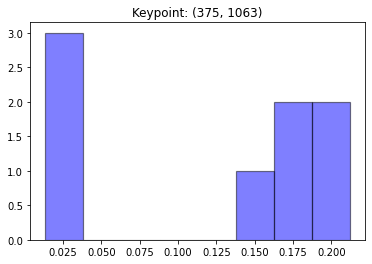

[0.01350693 0.18638358 0.2120664  0.2120664  0.16174572 0.17692665
 0.01986228 0.01744203]


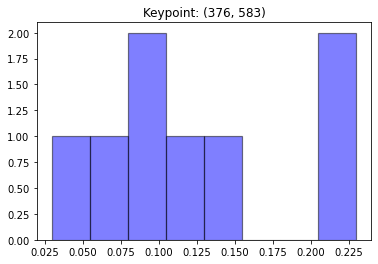

[0.12601445 0.07242908 0.02950061 0.13363557 0.22966765 0.22966765
 0.09911053 0.07997446]


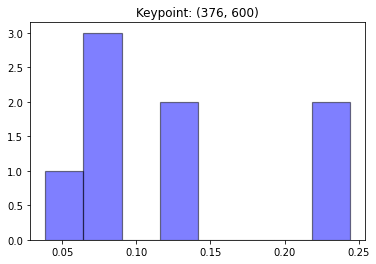

[0.06914318 0.06610228 0.24406863 0.11789074 0.24406863 0.13099646
 0.08920871 0.03852138]


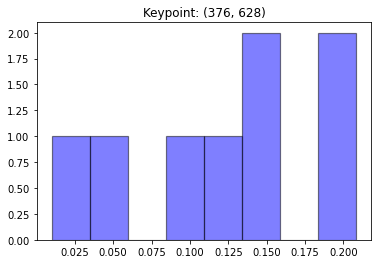

[0.14504779 0.2082468  0.104384   0.04634637 0.00997193 0.13091737
 0.2082468  0.14683893]


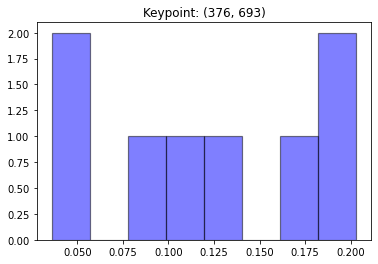

[0.09361267 0.05682198 0.03602012 0.12721341 0.20299088 0.11880044
 0.17258199 0.19195851]


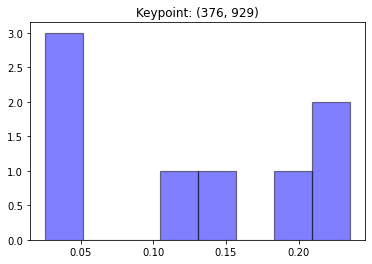

[0.02572117 0.23520502 0.19770526 0.23520502 0.10660998 0.03224693
 0.03050387 0.13680275]


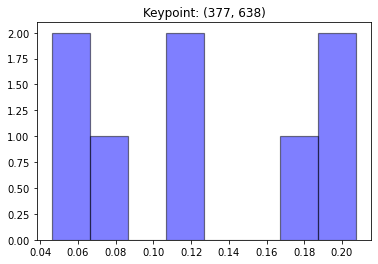

[0.06397601 0.04617731 0.07874788 0.1237718  0.19885913 0.20750937
 0.17034013 0.11061836]


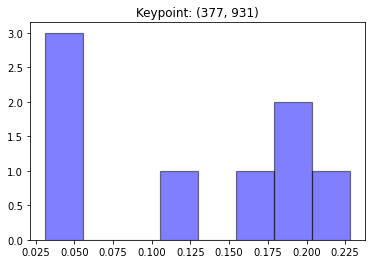

[0.03125248 0.18197975 0.19402902 0.22796405 0.12071214 0.04117736
 0.03779616 0.16508904]


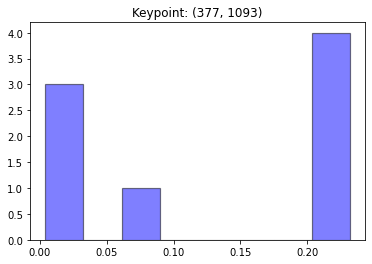

[0.06360188 0.00670721 0.0041386  0.21510895 0.23174441 0.23174441
 0.23174441 0.01521012]


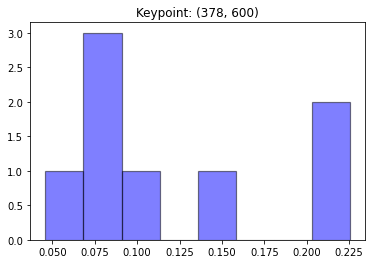

[0.07570876 0.07922237 0.22548032 0.08921707 0.22548032 0.14822606
 0.11082396 0.04584113]


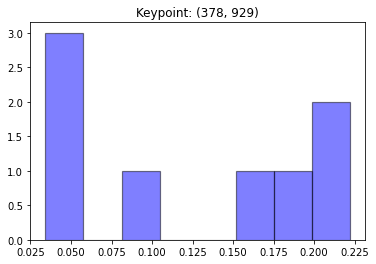

[0.0399944  0.22193375 0.1975978  0.22193375 0.09649396 0.03502751
 0.03420918 0.15280965]


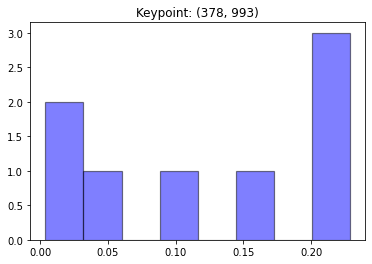

[0.16515675 0.04527613 0.00373986 0.00552123 0.09449664 0.22860313
 0.22860313 0.22860313]


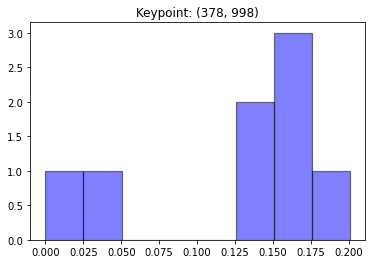

[0.1650891  0.15398589 0.20061334 0.13183556 0.         0.04647489
 0.13303893 0.16896228]


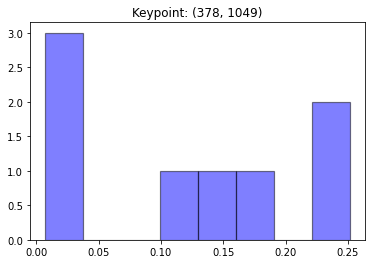

[0.01166588 0.0073447  0.15103718 0.25144735 0.12731789 0.17004144
 0.25144735 0.02969819]


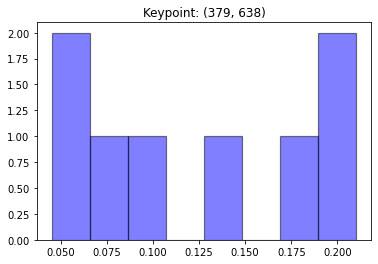

[0.07240782 0.04830964 0.09409563 0.04505345 0.21016746 0.21016746
 0.18501135 0.13478716]


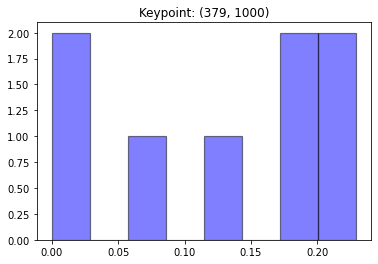

[0.18213649 0.17769254 0.22931328 0.21061636 0.         0.
 0.05887554 0.14136578]


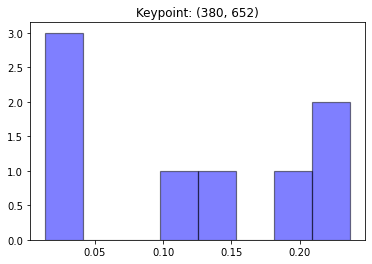

[0.02430911 0.03292045 0.10670446 0.20377217 0.14530688 0.23660742
 0.23660742 0.01377209]


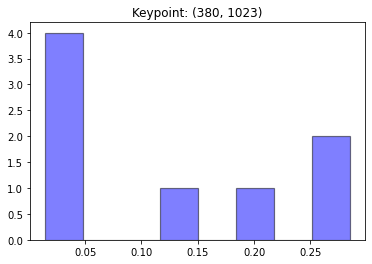

[0.01477549 0.01754993 0.01672813 0.1444289  0.28496093 0.28496093
 0.20164095 0.03495473]


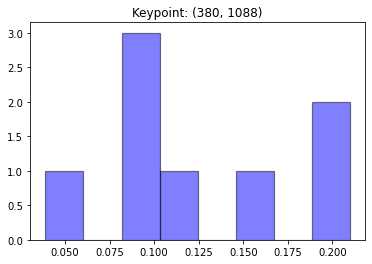

[0.08950528 0.08739711 0.08887364 0.20971902 0.11350196 0.1622137
 0.20971902 0.03907026]


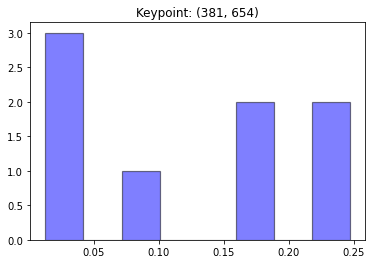

[0.02326759 0.03004854 0.09104676 0.17728319 0.17188537 0.24671753
 0.24671753 0.0130335 ]


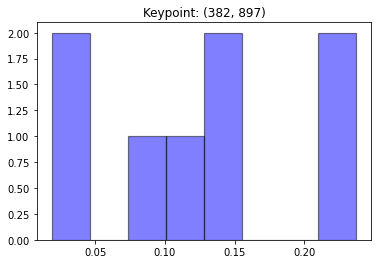

[0.12315543 0.15486395 0.23744268 0.21684626 0.14757103 0.02675496
 0.01861871 0.07474698]


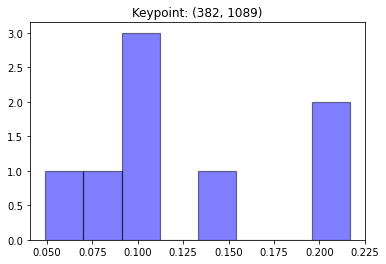

[0.10457933 0.09630224 0.09362563 0.15355095 0.08439979 0.20157273
 0.21678391 0.04918542]


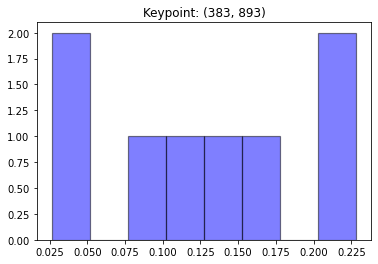

[0.13516773 0.15673938 0.22818544 0.22818544 0.10710866 0.0264732
 0.03210966 0.08603048]


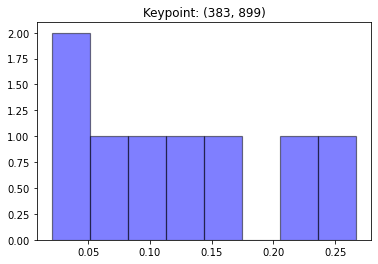

[0.08289681 0.23127416 0.26693559 0.17254109 0.13372987 0.03906709
 0.02046326 0.05309213]


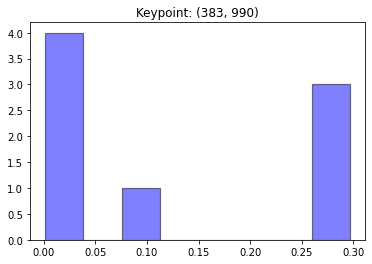

[0.00551457 0.0034177  0.0015614  0.09338047 0.29668757 0.29668757
 0.29668757 0.00606316]


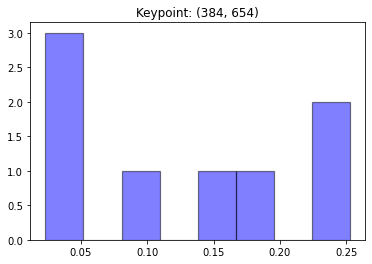

[0.02332923 0.02959559 0.08818428 0.17461084 0.15941901 0.25259636
 0.24706509 0.0251996 ]


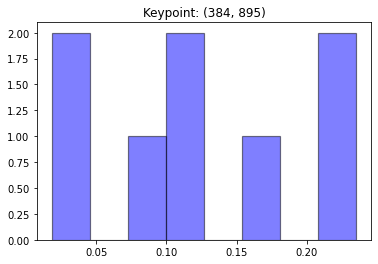

[0.12471604 0.17555262 0.23492514 0.22987193 0.10656009 0.01846249
 0.02851014 0.08140154]


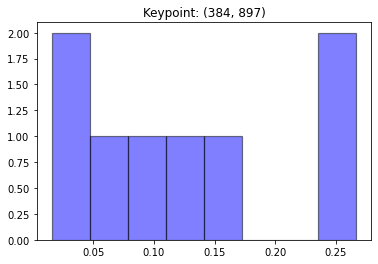

[0.11930175 0.153437   0.26685705 0.23604177 0.10844908 0.02499883
 0.0157117  0.07520282]


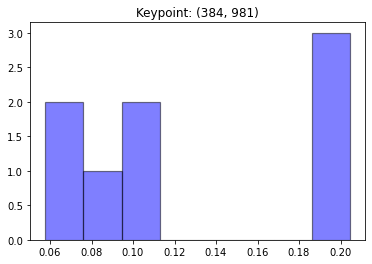

[0.07033286 0.09690704 0.08076511 0.05776719 0.20282812 0.20444695
 0.09945616 0.18749658]


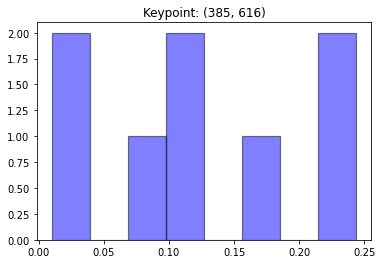

[0.08692362 0.02159538 0.00990807 0.10038113 0.24383127 0.12278602
 0.17074324 0.24383127]


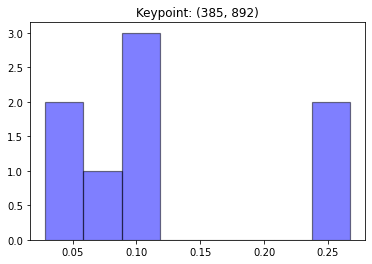

[0.08695163 0.11672653 0.26708096 0.26708096 0.10542547 0.02878897
 0.03256399 0.09538149]


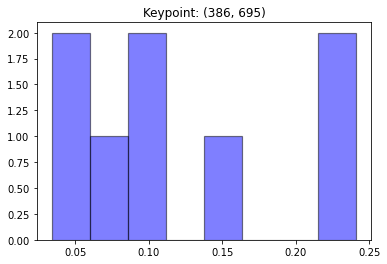

[0.10970105 0.03400091 0.08006293 0.05031534 0.09641838 0.24114802
 0.24114802 0.14720536]


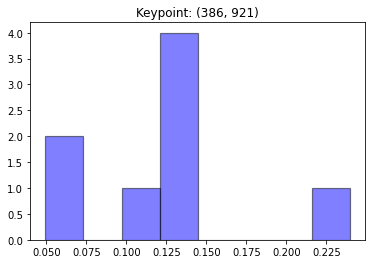

[0.04946481 0.13061467 0.23964524 0.14058843 0.13835054 0.10669967
 0.14281029 0.05182636]


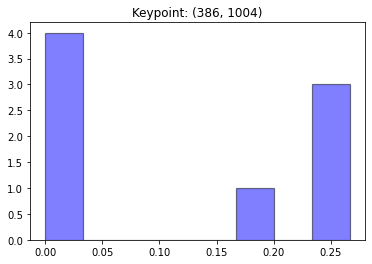

[0.         0.         0.26680639 0.26680639 0.26680639 0.19958083
 0.         0.        ]


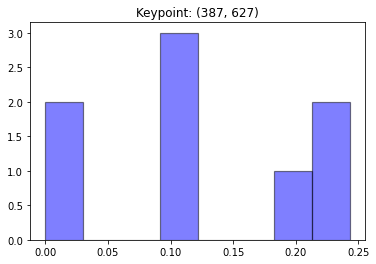

[0.24305696 0.24305696 0.10120769 0.09729699 0.19570785 0.11080505
 0.         0.0088685 ]


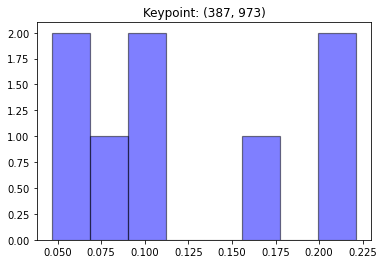

[0.09425057 0.06650094 0.04667134 0.17137428 0.09548677 0.08334853
 0.22118378 0.22118378]


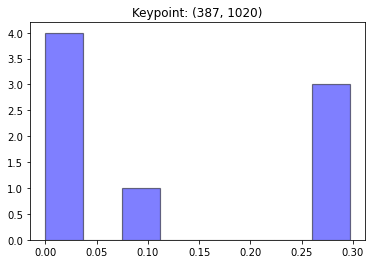

[0.         0.0172476  0.07886634 0.29699201 0.29699201 0.29699201
 0.01291003 0.        ]


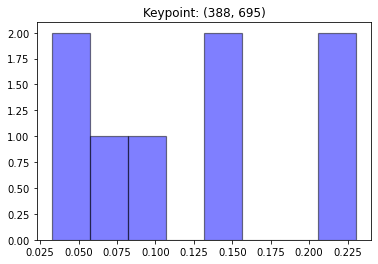

[0.10496259 0.03257291 0.0783693  0.04602071 0.13814213 0.23060498
 0.23060498 0.13872239]


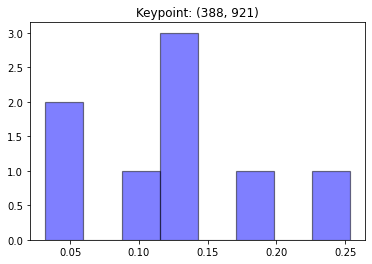

[0.03202692 0.12616386 0.25338922 0.1925462  0.12084232 0.09679978
 0.12961468 0.04861704]


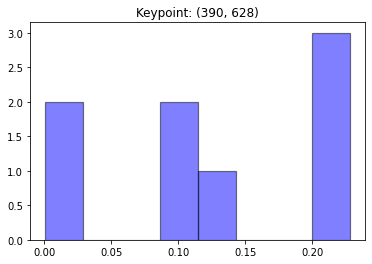

[0.22787995 0.22787995 0.09207076 0.09692644 0.22787995 0.11782081
 0.00870004 0.0008421 ]


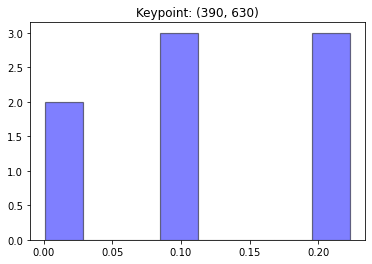

[0.22288421 0.22288421 0.09034634 0.10265813 0.22288421 0.10941014
 0.02759469 0.00133807]


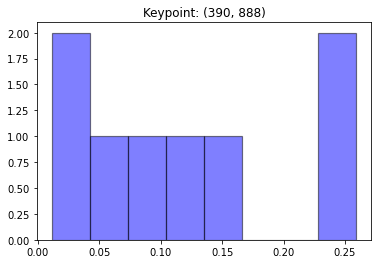

[0.01131904 0.12589154 0.25914985 0.25914985 0.1661646  0.10100481
 0.04925332 0.02806698]


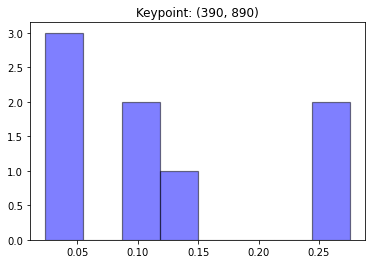

[0.02362166 0.09868676 0.27543376 0.27543376 0.14310896 0.10437502
 0.04853323 0.03080686]


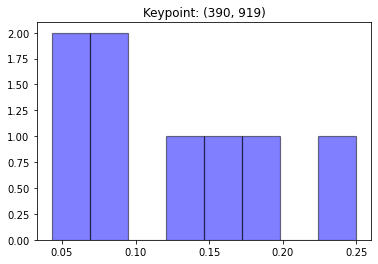

[0.04309644 0.16890933 0.24984565 0.17510264 0.12986898 0.087024
 0.09361766 0.0525353 ]


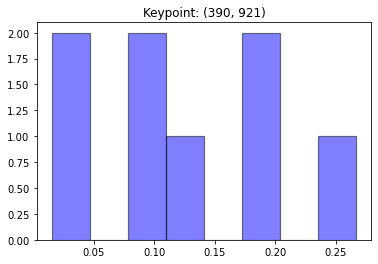

[0.01534414 0.18998685 0.26687657 0.19539399 0.12141234 0.08370926
 0.0867452  0.04053165]


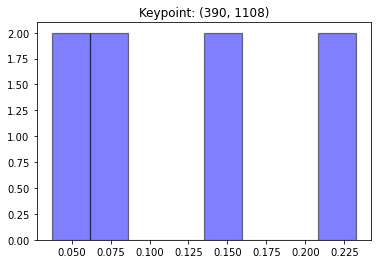

[0.08447678 0.06904022 0.15725032 0.23257324 0.23257324 0.13708362
 0.03730655 0.04969602]


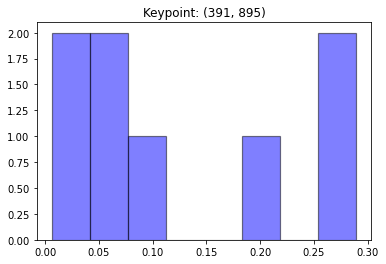

[0.05111913 0.28922704 0.28922704 0.21679164 0.09510799 0.04496974
 0.00624789 0.00730953]


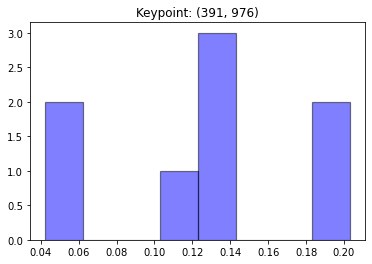

[0.13658292 0.05538299 0.04243206 0.12291945 0.12607619 0.12267203
 0.20307368 0.19086067]


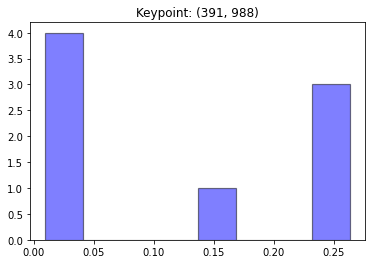

[0.01953333 0.02269278 0.14386159 0.25726877 0.26311879 0.26311879
 0.00951268 0.02089327]


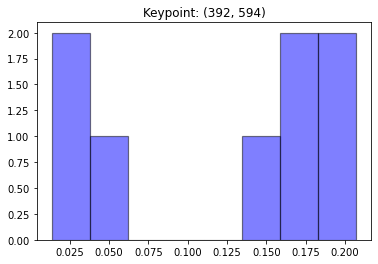

[0.20716402 0.04825654 0.02930659 0.0134892  0.14225659 0.17128573
 0.20716402 0.1810773 ]


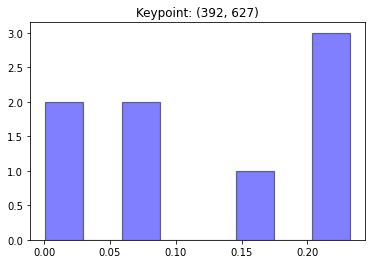

[0.23233838 0.21962129 0.08196936 0.1542238  0.23233838 0.075146
 0.00087769 0.0034851 ]


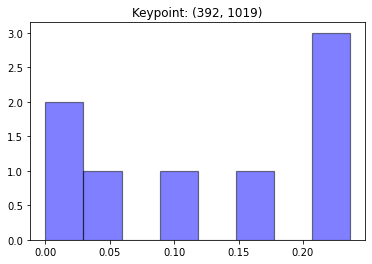

[0.03101808 0.10182717 0.23641187 0.23641187 0.23641187 0.14817365
 0.00974548 0.        ]


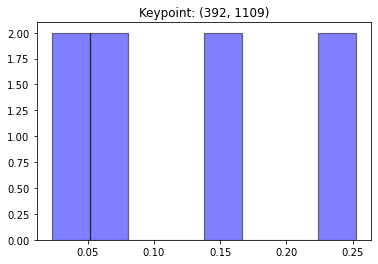

[0.06875733 0.05666389 0.15520016 0.25273515 0.25273515 0.15388432
 0.02275805 0.03726595]


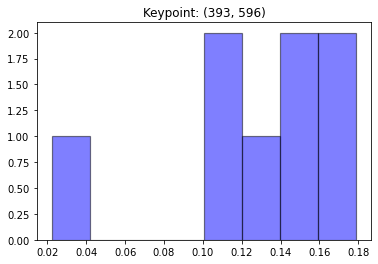

[0.17080397 0.14090879 0.10068221 0.02228696 0.126242   0.15172528
 0.17890617 0.10844462]


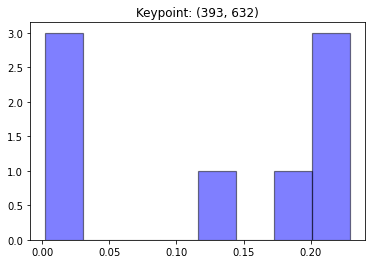

[0.21018117 0.22630394 0.12843547 0.19340892 0.22916302 0.00243963
 0.00556219 0.00450565]


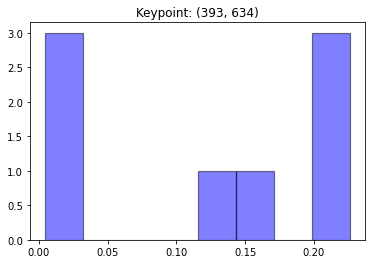

[0.16395406 0.22620493 0.14122642 0.20162865 0.22620493 0.02268797
 0.01340044 0.00469259]


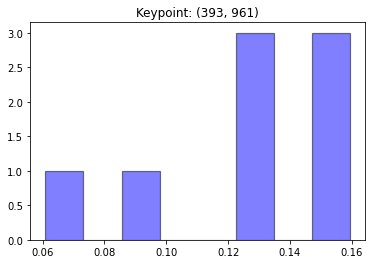

[0.12875139 0.09456138 0.06089376 0.12596881 0.1339652  0.1488284
 0.15936326 0.14766779]


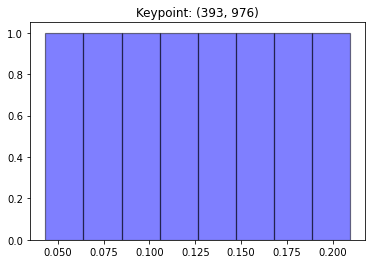

[0.14919854 0.07358173 0.04324782 0.11106357 0.09502734 0.13650768
 0.20921477 0.18215856]


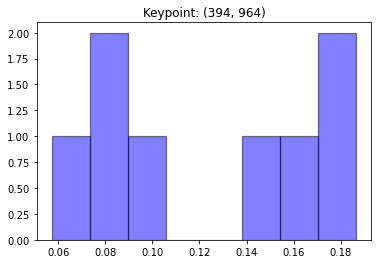

[0.16334612 0.0843451  0.05724202 0.07823754 0.10045902 0.18209016
 0.14768724 0.1865928 ]


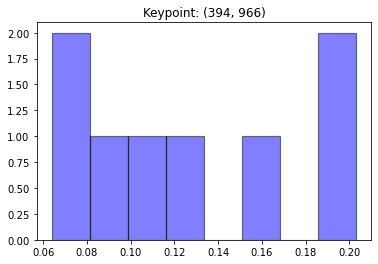

[0.15430409 0.08392786 0.07402547 0.06391175 0.10757519 0.19093256
 0.12220032 0.20312276]


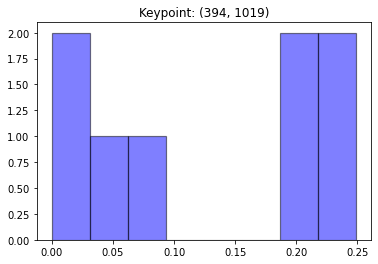

[0.03248545 0.19019521 0.24890471 0.24890471 0.19546073 0.0840492
 0.         0.        ]


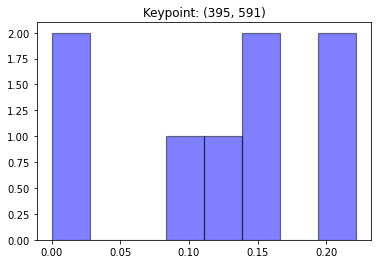

[0.22179861 0.08733581 0.         0.01288107 0.16123273 0.22179861
 0.15766794 0.13728524]


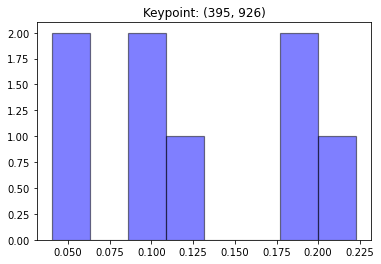

[0.10777634 0.19429727 0.22278897 0.11234979 0.04018549 0.09144257
 0.05255899 0.17860057]


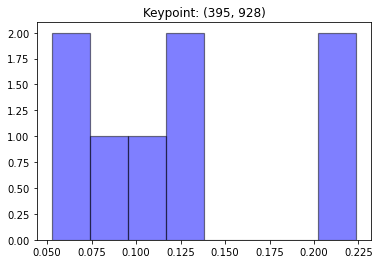

[0.12219905 0.1134415  0.2237209  0.08982761 0.05259793 0.1178054
 0.06593506 0.21447256]


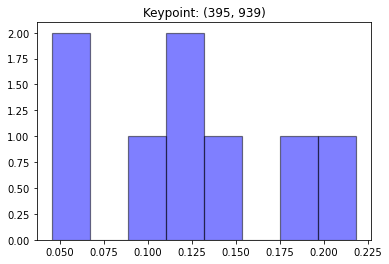

[0.11184185 0.13186973 0.21832961 0.14402188 0.04547806 0.0498831
 0.1063776  0.19219817]


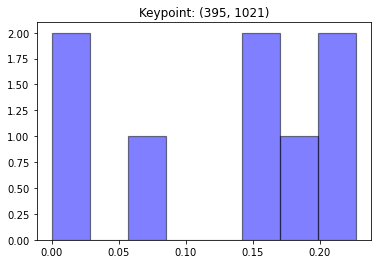

[0.14950643 0.2226834  0.22691458 0.18455824 0.14664324 0.06969412
 0.         0.        ]


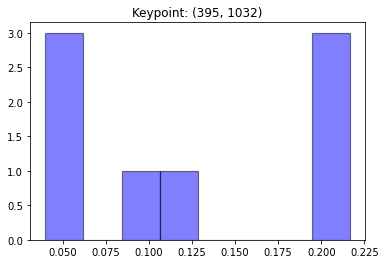

[0.09147614 0.04723593 0.0399851  0.11115511 0.21653934 0.06052971
 0.21653934 0.21653934]


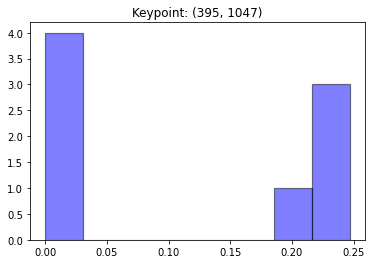

[0.2423372  0.20441887 0.24693053 0.24693053 0.02934389 0.
 0.00702576 0.02301321]


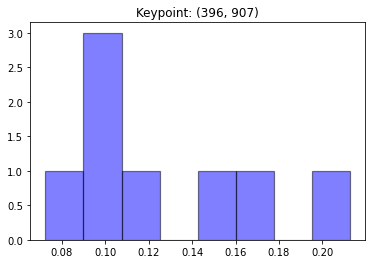

[0.09424415 0.07236465 0.21257981 0.16341132 0.11227115 0.09362304
 0.1486104  0.10289548]


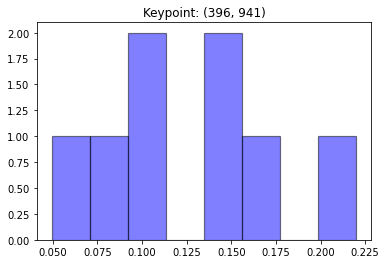

[0.09684594 0.17028117 0.21996462 0.1369563  0.09245131 0.04942068
 0.08294027 0.15113971]


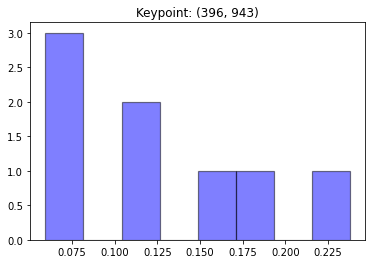

[0.10996968 0.18649523 0.23775357 0.12556348 0.06273808 0.05935675
 0.06123743 0.15688578]


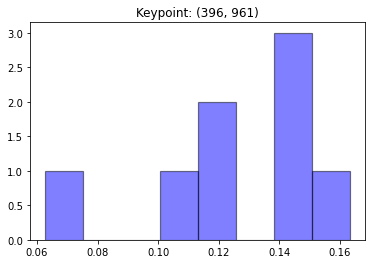

[0.16333563 0.10750886 0.06277959 0.1131804  0.12462578 0.14574231
 0.14400592 0.13882152]


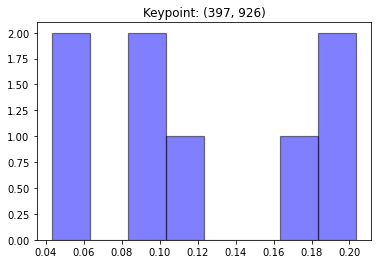

[0.12066498 0.1709527  0.2035216  0.10258891 0.04308819 0.09804769
 0.05761433 0.2035216 ]


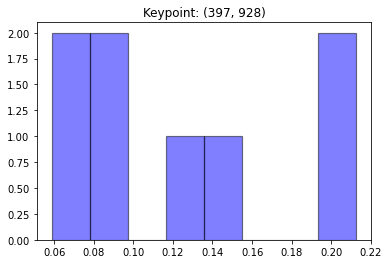

[0.13996138 0.08274673 0.21258279 0.08883938 0.05881406 0.12917592
 0.07529694 0.21258279]


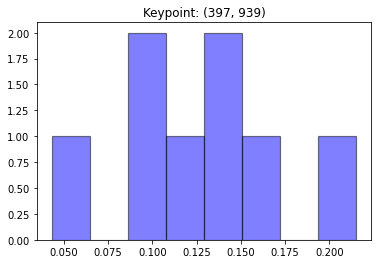

[0.08676545 0.11337969 0.21515985 0.16056532 0.13278981 0.04309853
 0.09972855 0.14851282]


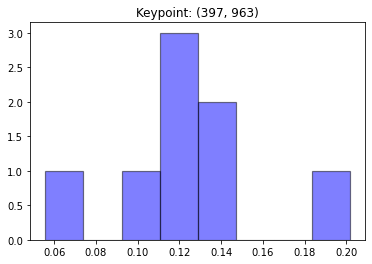

[0.14337467 0.11161716 0.0558401  0.09358797 0.12273782 0.2015752
 0.12807473 0.14319234]


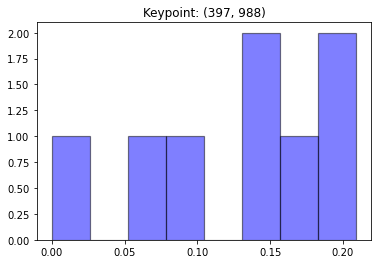

[0.14912046 0.18850158 0.16469891 0.20913109 0.13295919 0.
 0.07320431 0.08238446]


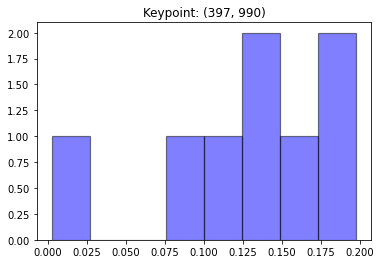

[0.12887678 0.15806159 0.13185538 0.17742301 0.09861257 0.0025952
 0.19750989 0.10506558]


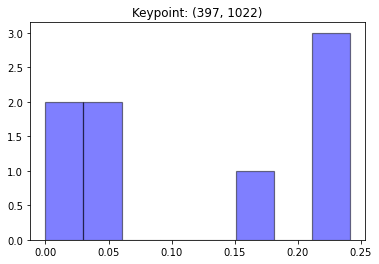

[0.24110708 0.24110708 0.24110708 0.17672153 0.06014981 0.
 0.00058153 0.03922589]


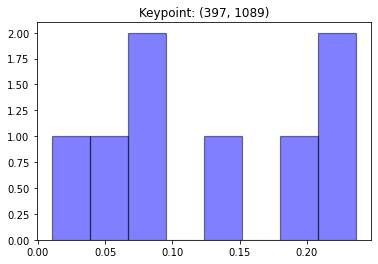

[0.08108151 0.21858246 0.23652428 0.01039262 0.0395663  0.18723612
 0.14392375 0.08269294]


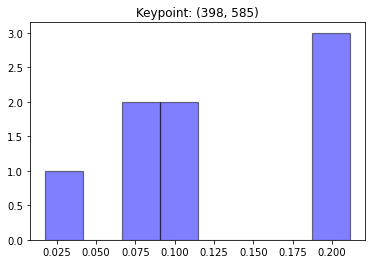

[0.21129336 0.09397959 0.01779907 0.08419936 0.21129336 0.19509955
 0.09643125 0.08990446]


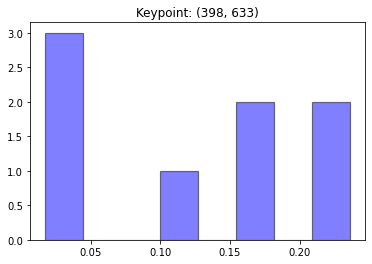

[0.01917925 0.02723407 0.16284709 0.2360436  0.2360436  0.17774708
 0.12346167 0.01744364]


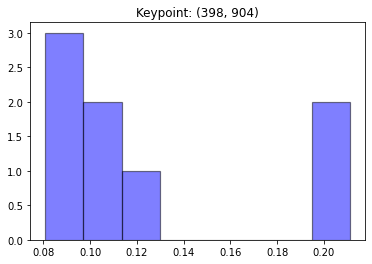

[0.10689621 0.20900856 0.21110937 0.10249427 0.08832184 0.08088816
 0.11634685 0.08493473]


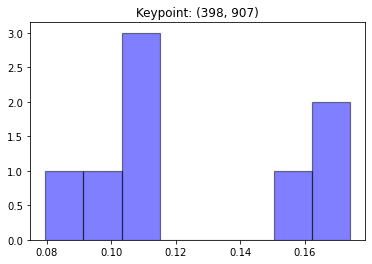

[0.10862449 0.07959616 0.17388869 0.15505468 0.11106552 0.09948839
 0.16497579 0.10730628]


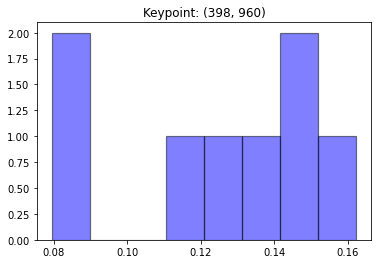

[0.12793382 0.11495443 0.07948551 0.14777873 0.14281897 0.13966752
 0.08508913 0.1622719 ]


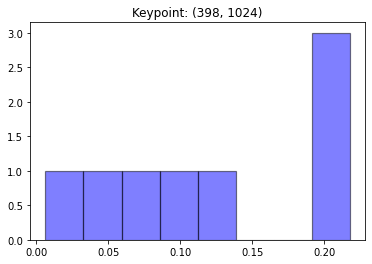

[0.21777553 0.21777553 0.21777553 0.12635176 0.04190321 0.00629778
 0.0825387  0.08958195]


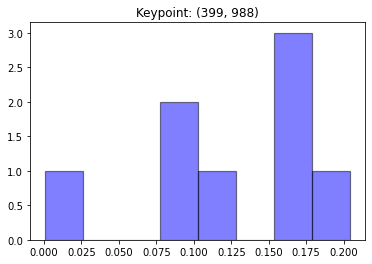

[0.17611641 0.20409563 0.11192233 0.16402087 0.15556578 0.00092263
 0.08773006 0.0996263 ]


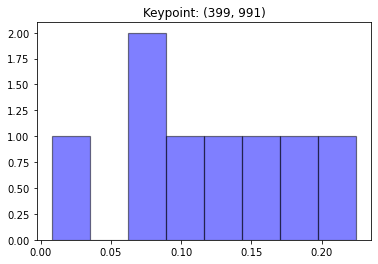

[0.16360859 0.19733647 0.08336003 0.08800611 0.10306472 0.00777518
 0.22467879 0.13217011]


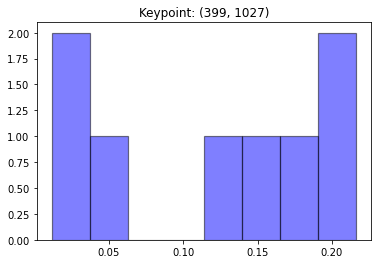

[0.21621844 0.21621844 0.15494763 0.06213319 0.03611166 0.01156326
 0.13541412 0.16739326]


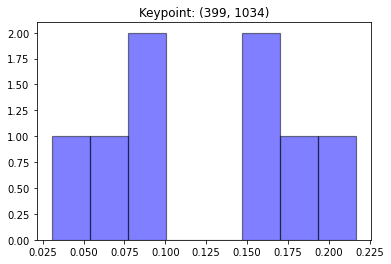

[0.07794968 0.09362372 0.07210403 0.2166386  0.14887482 0.03060256
 0.19218951 0.16801707]


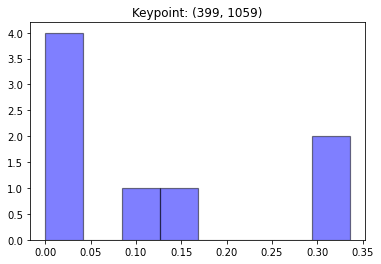

[0.         0.03257366 0.16156558 0.33578138 0.33578138 0.1215773
 0.01272071 0.        ]


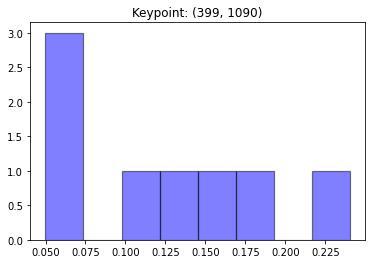

[0.05449809 0.15604129 0.24034145 0.13450711 0.04992877 0.18097067
 0.11729938 0.06641324]


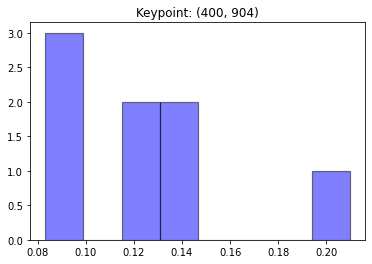

[0.14259999 0.20983999 0.12675364 0.08686355 0.09347068 0.08310411
 0.13469598 0.12267207]


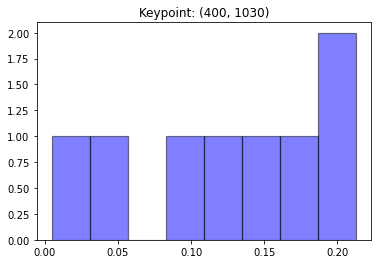

[0.21279427 0.12305993 0.10023281 0.17097581 0.0414231  0.00473973
 0.15114778 0.19562657]


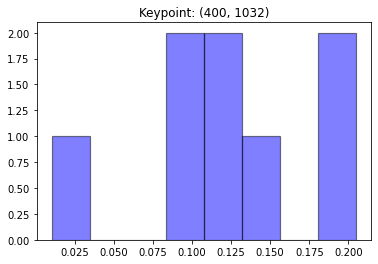

[0.12596789 0.09303604 0.11603076 0.20498934 0.09349539 0.01031679
 0.15575648 0.20040731]


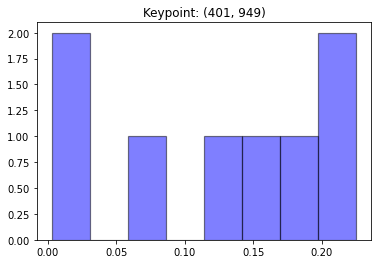

[0.00283251 0.00353932 0.22528266 0.16053269 0.07391093 0.22528266
 0.12066654 0.1879527 ]


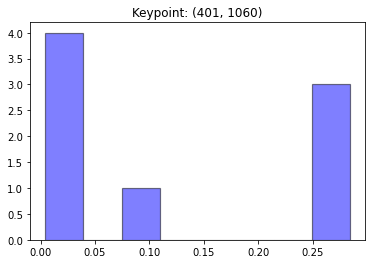

[0.00444226 0.03519185 0.2802015  0.28418406 0.28418406 0.09449869
 0.00991852 0.00737907]


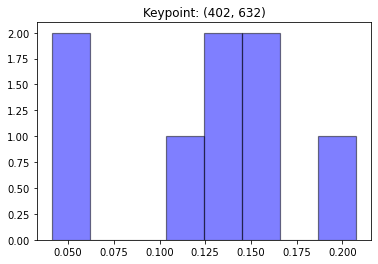

[0.04108923 0.06019961 0.14972833 0.11760264 0.20755542 0.14405878
 0.12557437 0.15419162]


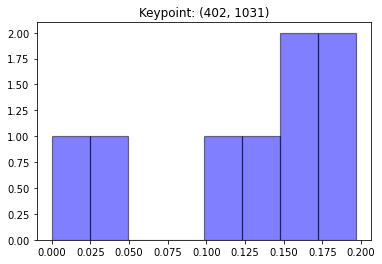

[0.18457481 0.14431351 0.16575921 0.19689151 0.04385305 0.
 0.10349743 0.16111048]


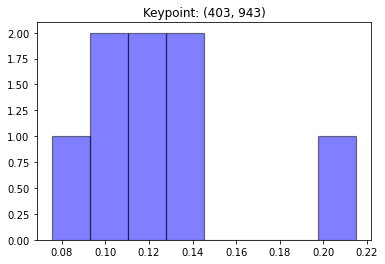

[0.11308977 0.13226891 0.21505661 0.10782825 0.09385896 0.13980233
 0.07541241 0.12268276]


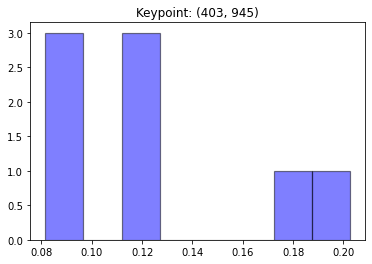

[0.11345091 0.09500442 0.20250136 0.12018074 0.08694843 0.17786947
 0.08156577 0.1224789 ]


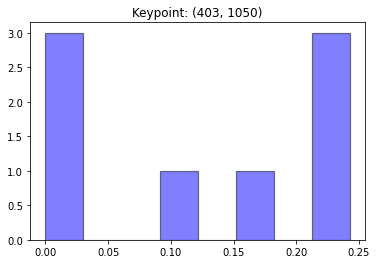

[0.         0.01778464 0.15742624 0.24270906 0.09430776 0.24270906
 0.24270906 0.00235419]


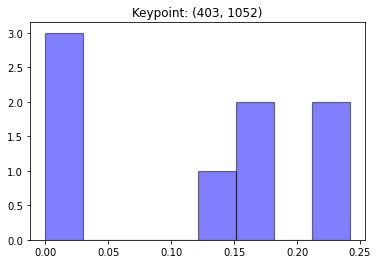

[0.         0.01826948 0.16747892 0.24188067 0.14882321 0.24188067
 0.17924869 0.00241837]


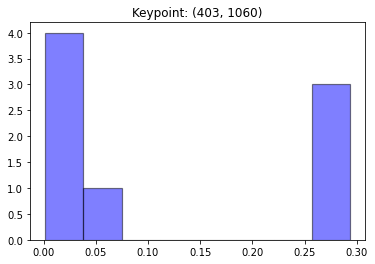

[0.00177498 0.03799744 0.29323407 0.29323407 0.29323407 0.06928049
 0.00665065 0.00459424]


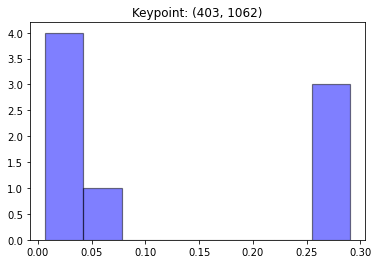

[0.00711351 0.03259202 0.29010276 0.29010276 0.29010276 0.07114141
 0.00934809 0.00949671]


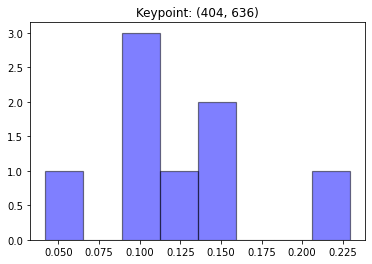

[0.13802563 0.09798995 0.10293759 0.0420088  0.12759182 0.22932632
 0.15492938 0.1071905 ]


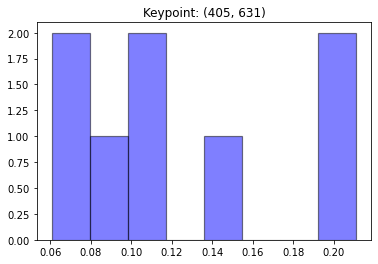

[0.21104602 0.09942364 0.14018685 0.0944561  0.06081411 0.06700897
 0.11601828 0.21104602]


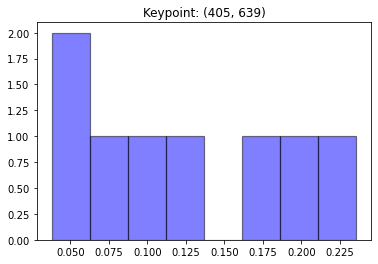

[0.11609728 0.09251547 0.0578689  0.03791361 0.2093873  0.23561574
 0.16526643 0.08533527]


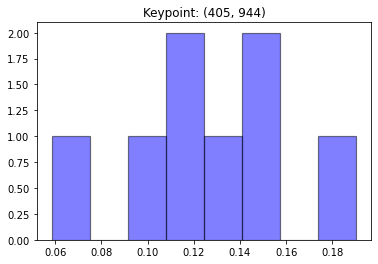

[0.13508696 0.14910092 0.1233409  0.0585657  0.11007461 0.19031958
 0.09231714 0.1411942 ]


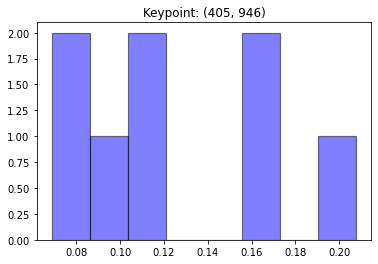

[0.157278   0.09743386 0.06873913 0.08453845 0.10773505 0.20780862
 0.11207841 0.16438848]


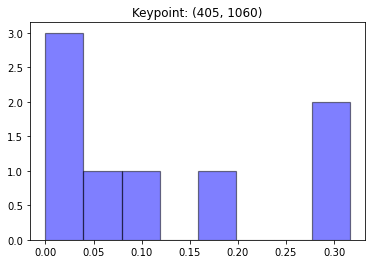

[2.52011752e-02 9.55282939e-02 3.16290846e-01 3.16290846e-01
 1.77638533e-01 6.88739999e-02 0.00000000e+00 1.76306398e-04]


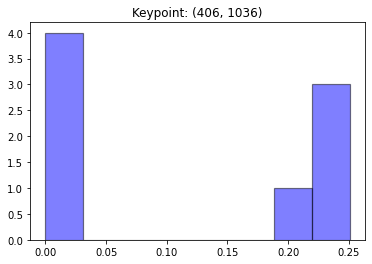

[0.25082128 0.25082128 0.21204575 0.25082128 0.0302484  0.00195851
 0.         0.00328351]


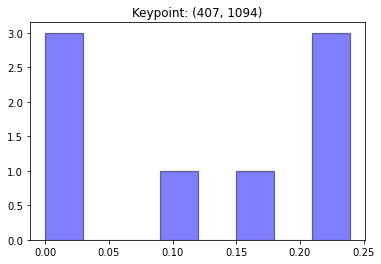

[0.         0.00211741 0.09905489 0.239188   0.239188   0.239188
 0.17368904 0.00757467]


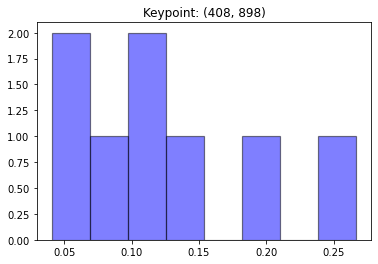

[0.11485435 0.20671255 0.26669362 0.14458036 0.10515841 0.04069949
 0.05072926 0.07057196]


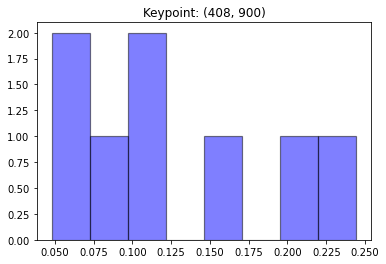

[0.10166351 0.15621074 0.24428602 0.19671336 0.09552378 0.04797672
 0.05761685 0.10000903]


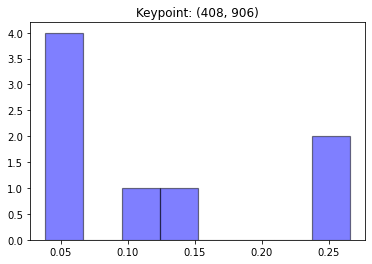

[0.26543109 0.26543109 0.11431267 0.15171142 0.05198538 0.03876172
 0.04885511 0.06351151]


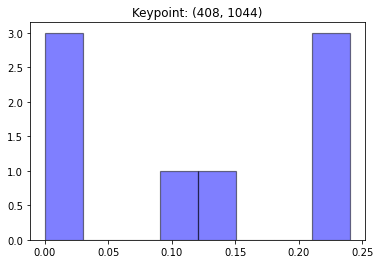

[0.24005504 0.14796888 0.01002129 0.01028552 0.00052022 0.24005504
 0.24005504 0.11103896]


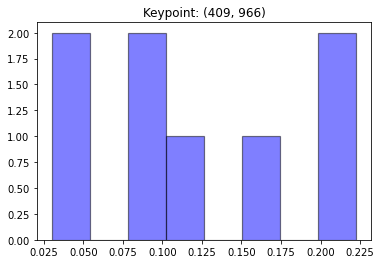

[0.2224626  0.04896246 0.03010688 0.09834523 0.12413607 0.17286198
 0.08066218 0.2224626 ]


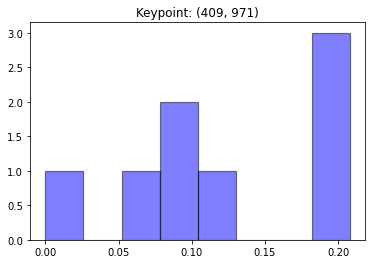

[0.20800766 0.0972961  0.09835148 0.20800766 0.1945467  0.06753441
 0.         0.12625597]


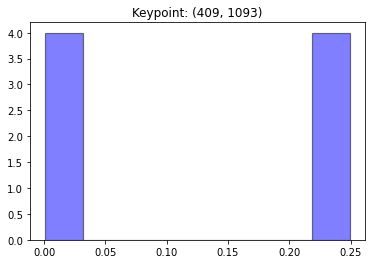

[0.00099981 0.00215548 0.00317512 0.22716168 0.2493731  0.2493731
 0.2493731  0.01838861]


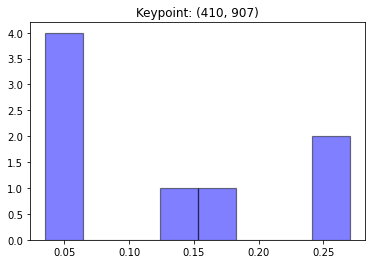

[0.24647844 0.27032557 0.17055845 0.14985246 0.05077464 0.03703707
 0.03543607 0.03953729]


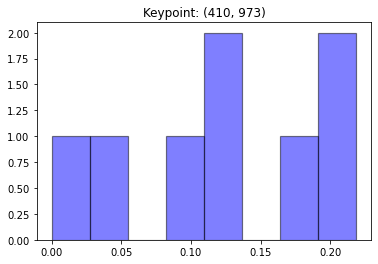

[0.17947632 0.10937103 0.12855205 0.2186956  0.2186956  0.10665119
 0.         0.03855822]


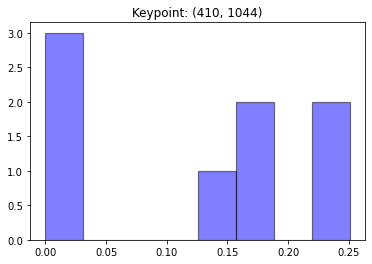

[0.25076938 0.16500257 0.006361   0.         0.         0.18223242
 0.25076938 0.14486524]


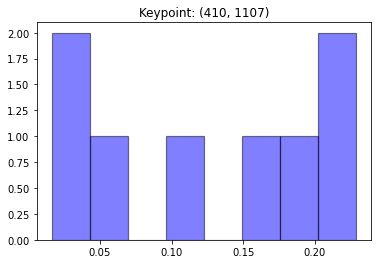

[0.01638968 0.10811092 0.18289367 0.22866786 0.22866786 0.16670652
 0.0490599  0.0195036 ]


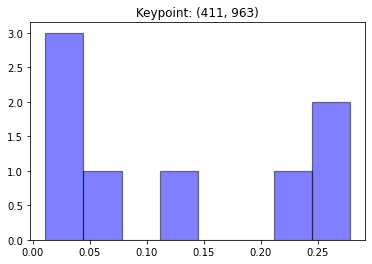

[0.23127905 0.01116234 0.01255753 0.04175746 0.06015465 0.2528713
 0.11222896 0.27798871]


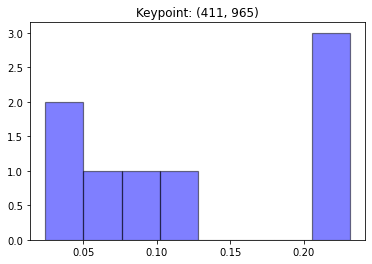

[0.22224769 0.024385   0.02543247 0.07384132 0.1061782  0.23140977
 0.08509578 0.23140977]


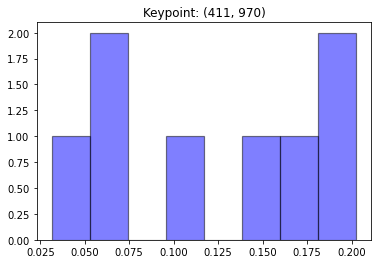

[0.14302732 0.07414685 0.07339572 0.20248707 0.20248707 0.16129367
 0.03148387 0.11167844]


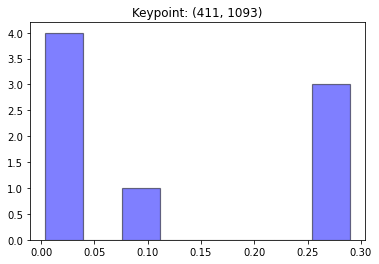

[0.00534775 0.00602484 0.00406769 0.08726251 0.28957492 0.28957492
 0.28957492 0.02857244]


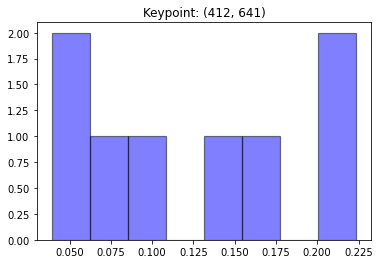

[0.07976778 0.03913026 0.04417127 0.16221428 0.22351546 0.22357895
 0.1317986  0.09582339]


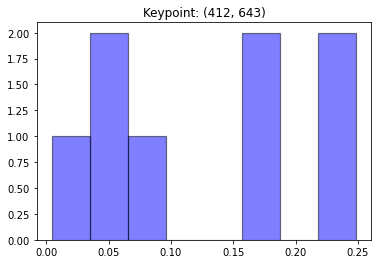

[0.04091024 0.00439964 0.04315722 0.17824597 0.24865929 0.24865929
 0.15761752 0.07835084]


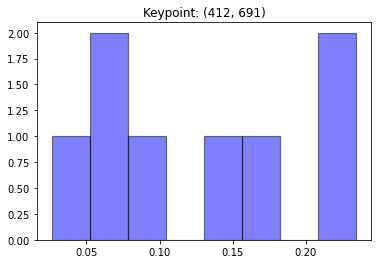

[0.02631542 0.06022986 0.21093916 0.17624964 0.23449574 0.13484273
 0.07174514 0.08518232]


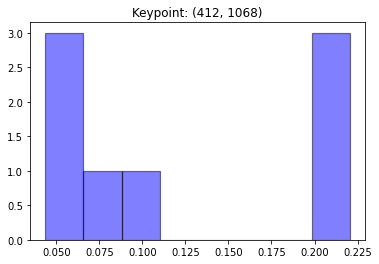

[0.22048374 0.22048374 0.10011808 0.04369802 0.0780243  0.22048374
 0.06095169 0.05575668]


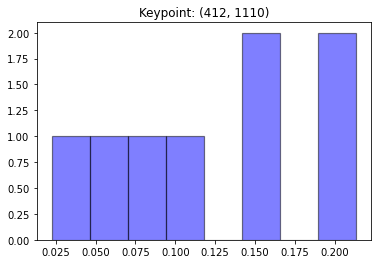

[0.02253112 0.10969483 0.1483235  0.21212868 0.21341453 0.15579799
 0.08149856 0.05661079]


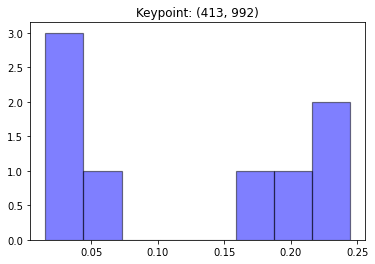

[0.19801382 0.03046211 0.02588522 0.0155691  0.05552745 0.18599108
 0.24427561 0.24427561]


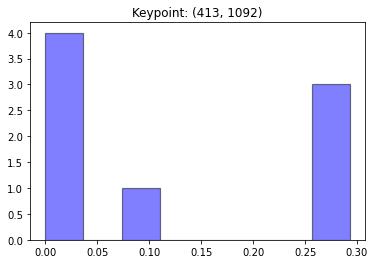

[0.00499832 0.00254082 0.         0.08449427 0.29302802 0.29302802
 0.29302802 0.02888253]


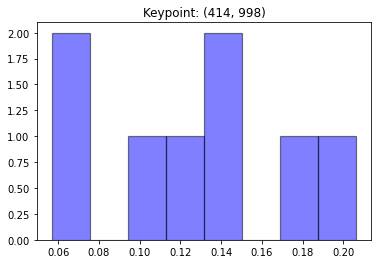

[0.17423138 0.05683613 0.10106852 0.1187189  0.14069589 0.20624499
 0.06624368 0.13596051]


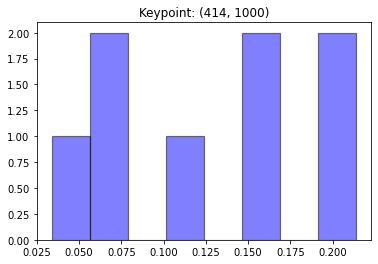

[0.20126551 0.05731666 0.11525526 0.15211348 0.15732568 0.21391231
 0.06894085 0.03387025]


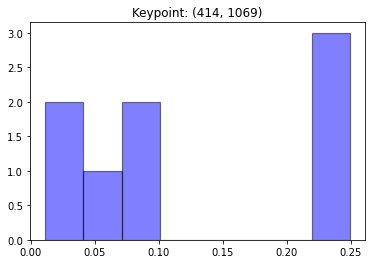

[0.24908398 0.24908398 0.01234758 0.01137097 0.07974074 0.24908398
 0.06352648 0.0857623 ]


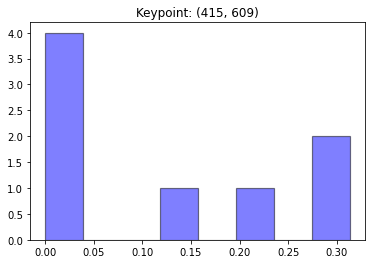

[0.         0.01520248 0.13490084 0.31352137 0.31352137 0.22285394
 0.         0.        ]


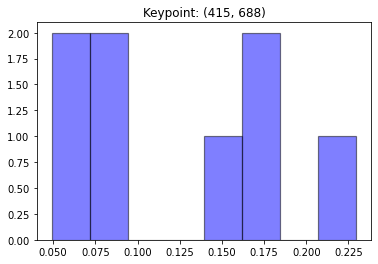

[0.08984107 0.04919708 0.17253174 0.05630215 0.22955989 0.15406085
 0.08432504 0.16418217]


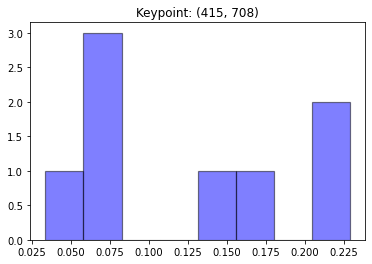

[0.06867928 0.13746939 0.06075899 0.03388184 0.16332638 0.07876152
 0.2285613  0.2285613 ]


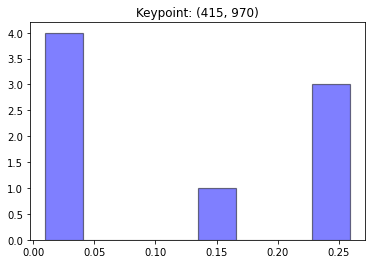

[0.02123686 0.0099721  0.03382322 0.23584472 0.25896594 0.25896594
 0.15412215 0.02706907]


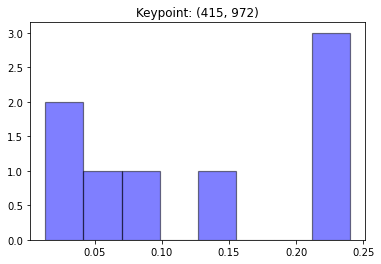

[0.01339258 0.01476446 0.04427254 0.2288519  0.23985451 0.23985451
 0.14810904 0.07090045]


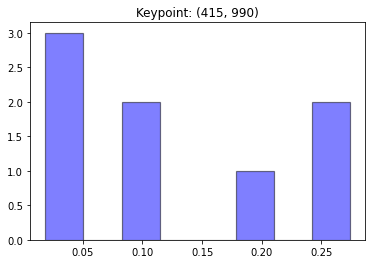

[0.09062078 0.01864882 0.02260896 0.02106394 0.11212097 0.1874336
 0.27375146 0.27375146]


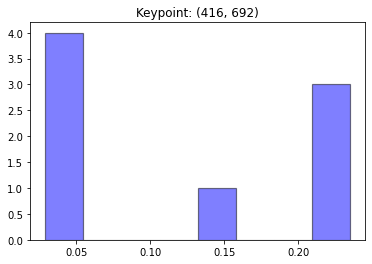

[0.02921184 0.03772274 0.23479085 0.22498534 0.23479085 0.15468492
 0.03919909 0.04461435]


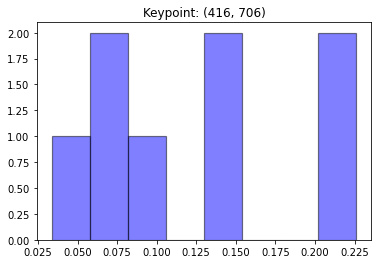

[0.0745192  0.13738276 0.06605109 0.03376002 0.14679445 0.08942402
 0.22603423 0.22603423]


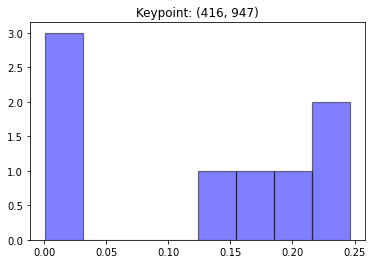

[0.00103881 0.00107758 0.00988757 0.12970104 0.24617883 0.1544754
 0.24617883 0.21146194]


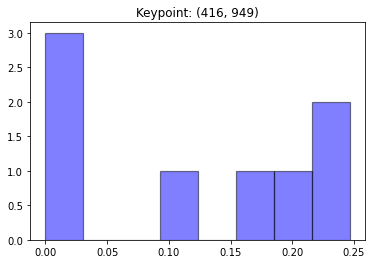

[0.         0.         0.0150148  0.11615722 0.24658408 0.17133562
 0.24658408 0.20432419]


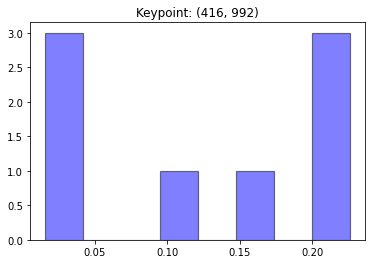

[0.11844097 0.02713449 0.02305756 0.01594991 0.14817698 0.21544835
 0.22589587 0.22589587]


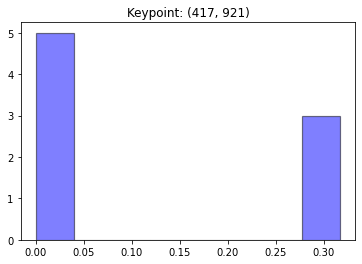

[0.31717079 0.31717079 0.31717079 0.0320381  0.         0.00604009
 0.00245542 0.00795401]


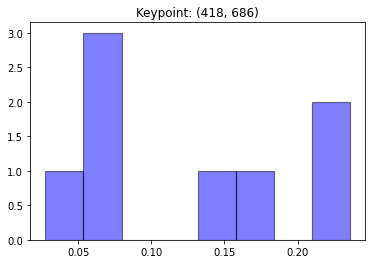

[0.06708921 0.02754853 0.05770085 0.05482827 0.2356852  0.2356852
 0.14775115 0.17371159]


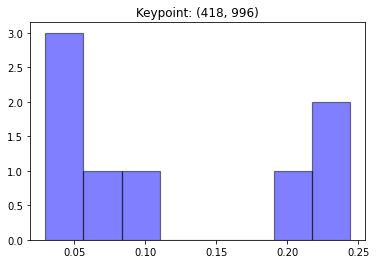

[0.03785438 0.02978336 0.05585878 0.07602974 0.2439946  0.2439946
 0.21146338 0.10102114]


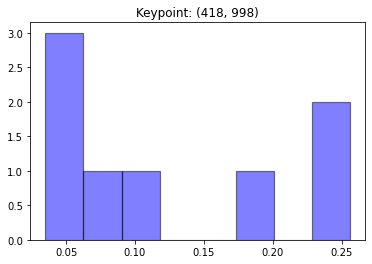

[0.03836403 0.03500235 0.06173102 0.10415654 0.25591271 0.25591271
 0.17834832 0.07057233]


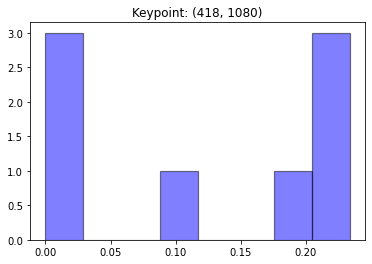

[0.         0.01185909 0.08760057 0.23358008 0.23358008 0.22902841
 0.19789844 0.00645333]


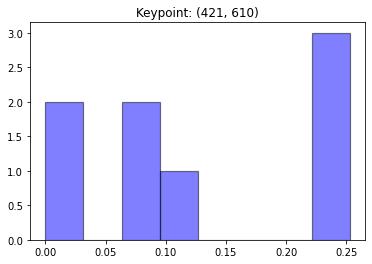

[0.07041965 0.10053964 0.25294333 0.25294333 0.25294333 0.07021073
 0.         0.        ]


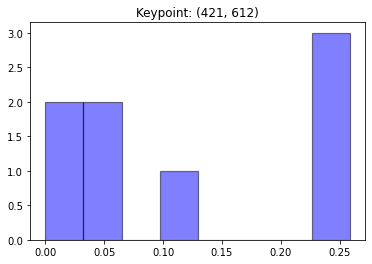

[0.05280439 0.11633118 0.25871041 0.25871041 0.25871041 0.0527343
 0.00199891 0.        ]


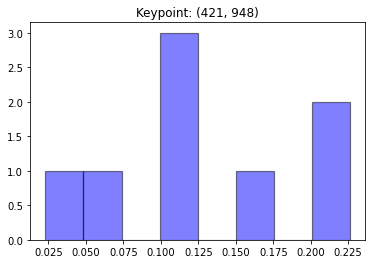

[0.10896808 0.1597292  0.11726944 0.20473191 0.22606195 0.10939391
 0.05086805 0.02297746]


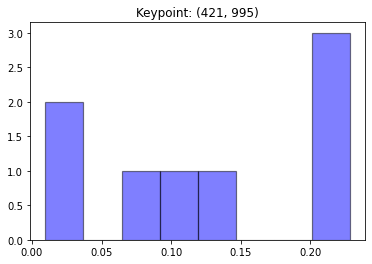

[0.00961156 0.01072149 0.08454758 0.1029566  0.22829392 0.22829392
 0.20924908 0.12632586]


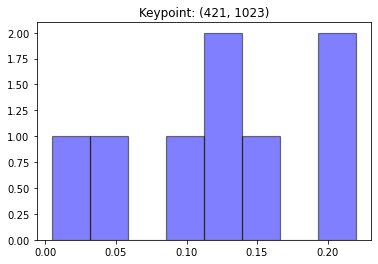

[0.12250768 0.13060535 0.22025948 0.10151488 0.03698455 0.00449373
 0.22025948 0.16337486]


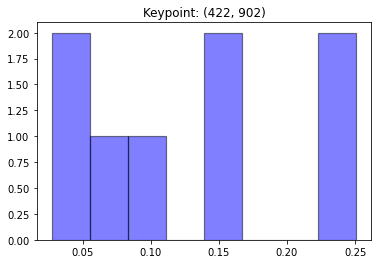

[0.08984233 0.13919504 0.25073193 0.25073193 0.15582169 0.05648521
 0.02973602 0.02745586]


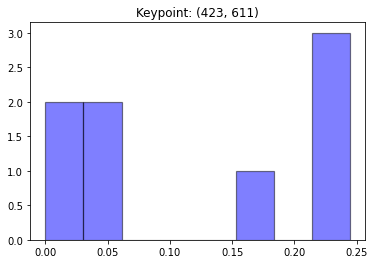

[0.05922384 0.15927577 0.24457911 0.24457911 0.24457911 0.04776305
 0.         0.        ]


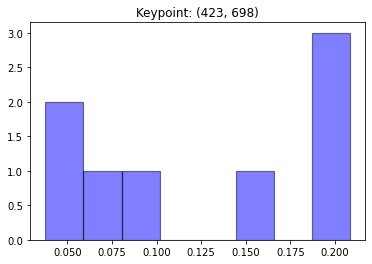

[0.0377608  0.05401075 0.19707266 0.20822197 0.15779448 0.18883381
 0.09306934 0.06323619]


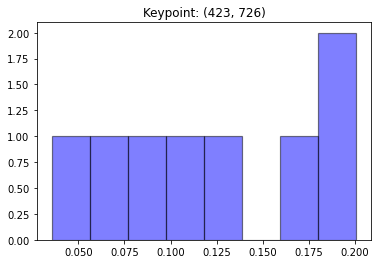

[0.20056471 0.19967561 0.16543355 0.08216404 0.07309288 0.13173444
 0.11173101 0.03560375]


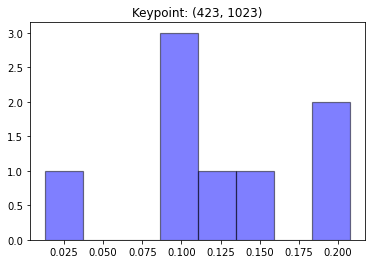

[0.09614919 0.10049273 0.205655   0.09218783 0.15576506 0.01312535
 0.20743246 0.12919237]


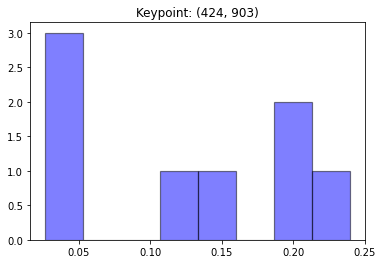

[0.12942807 0.20244863 0.18712866 0.23946031 0.14306187 0.044062
 0.02768442 0.02672605]


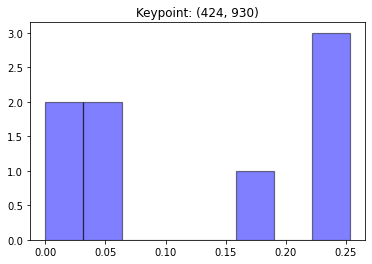

[0.2281704  0.16314243 0.25331151 0.25331151 0.03724393 0.
 0.02423529 0.04058494]


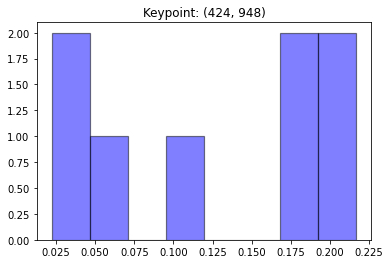

[0.21667011 0.17049702 0.11487823 0.16926343 0.19684346 0.04094466
 0.02228951 0.06861359]


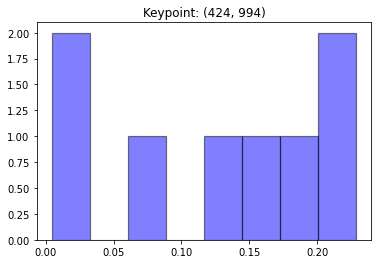

[0.01296554 0.00447512 0.12356236 0.1787189  0.22869235 0.22784753
 0.1485345  0.07520369]


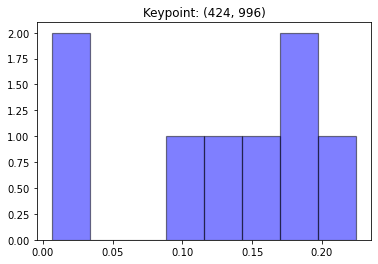

[0.01351273 0.00638665 0.13510698 0.17902621 0.22453318 0.18825719
 0.14342333 0.10975375]


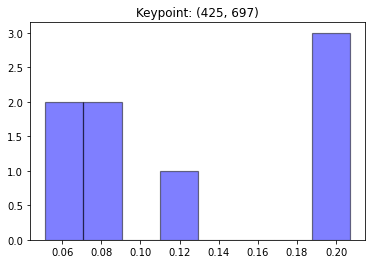

[0.05146135 0.08332451 0.11366781 0.20693169 0.20448722 0.19745131
 0.07378569 0.06889042]


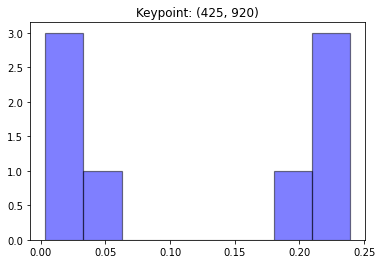

[0.23892588 0.23892588 0.23892588 0.00360374 0.01922726 0.00460594
 0.05204751 0.20373791]


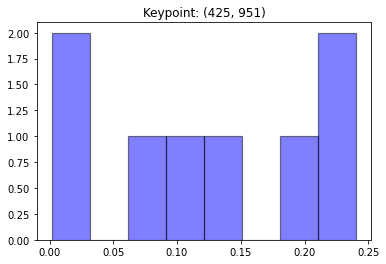

[0.24050535 0.18253819 0.10943344 0.13044611 0.07903217 0.01575223
 0.00178715 0.24050535]


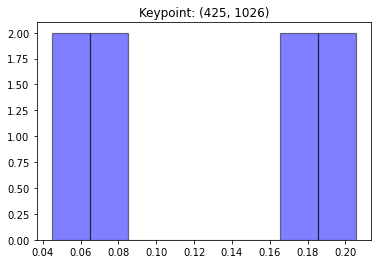

[0.06749768 0.07638611 0.1993169  0.17738234 0.20563336 0.16668369
 0.06229737 0.04480256]


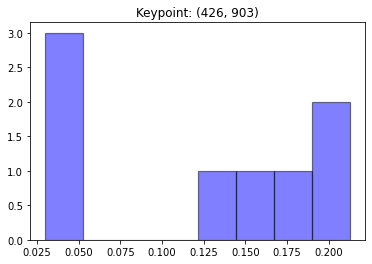

[0.17376638 0.2127463  0.13822781 0.2127463  0.15278952 0.04051047
 0.02992248 0.03929075]


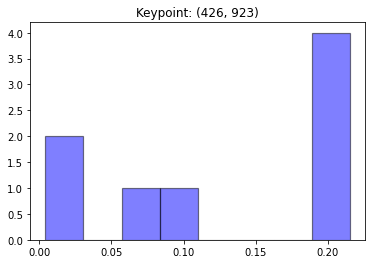

[0.21509613 0.21509613 0.18990247 0.09655763 0.01626664 0.00437985
 0.0627633  0.19993784]


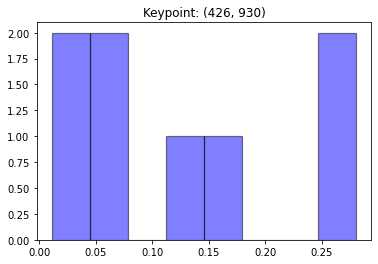

[0.16104421 0.13669701 0.28032347 0.28032347 0.05183399 0.01104984
 0.02706792 0.05166008]


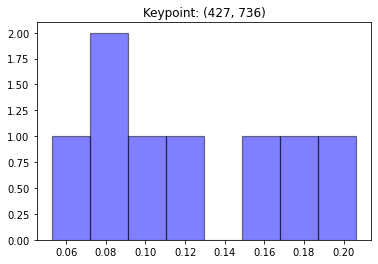

[0.1083282  0.15233861 0.18231148 0.08292398 0.08573892 0.12927574
 0.05275481 0.20632826]


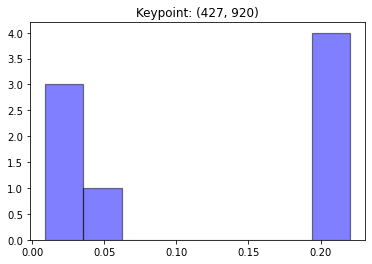

[0.22029706 0.22029706 0.22029706 0.03112667 0.01968365 0.00919161
 0.06154207 0.21756481]


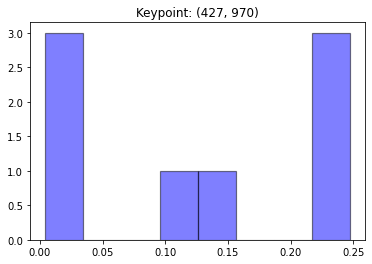

[0.00440859 0.00752249 0.01176168 0.13765248 0.24719706 0.24719706
 0.24719706 0.09706359]


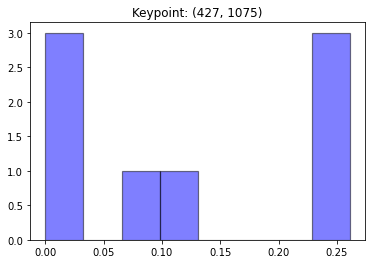

[0.00507928 0.00409635 0.11241009 0.26107078 0.26107078 0.26107078
 0.09520197 0.        ]


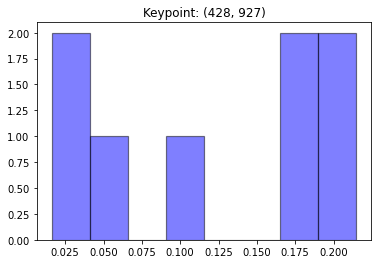

[0.17542136 0.17793768 0.21472943 0.21472943 0.05249251 0.01624631
 0.03774861 0.11069468]


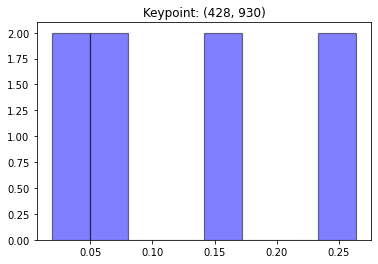

[0.14897199 0.14888331 0.263832   0.263832   0.07311837 0.01900342
 0.03233959 0.05001933]


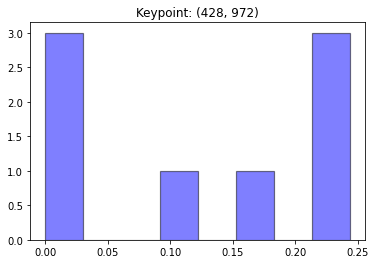

[0.0004947  0.         0.01383144 0.15793171 0.24341722 0.24341722
 0.24341722 0.09749049]


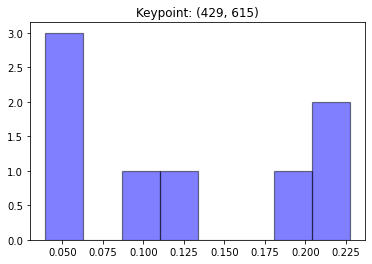

[0.03969956 0.19345854 0.12887947 0.2274001  0.2274001  0.08913436
 0.05445937 0.03956849]


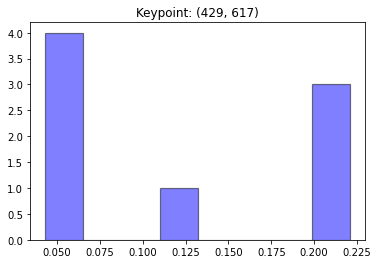

[0.05156948 0.22074912 0.12300292 0.22074912 0.22074912 0.0623755
 0.05756744 0.04323729]


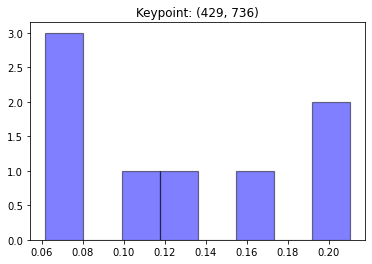

[0.10997027 0.15823041 0.19216904 0.06823662 0.06724394 0.13237281
 0.06164943 0.21012748]


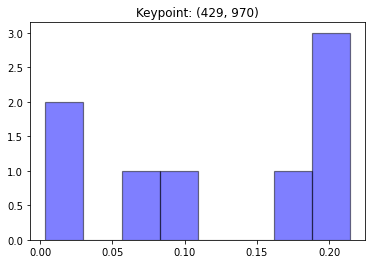

[0.00367172 0.00626515 0.09669106 0.19880254 0.21431008 0.21431008
 0.18677418 0.07917519]


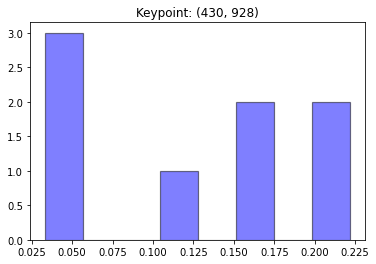

[0.16943647 0.15475863 0.22166866 0.22166866 0.1068166  0.04623731
 0.03343036 0.04598332]


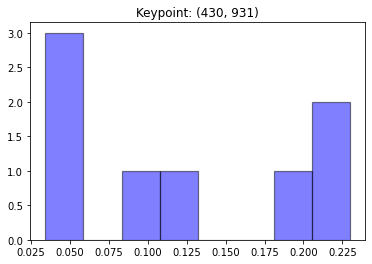

[0.19647404 0.1264531  0.22979037 0.22979037 0.08882054 0.04734883
 0.03423401 0.04708874]


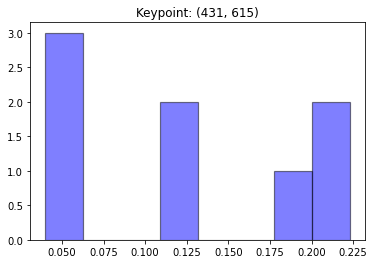

[0.04377764 0.20133833 0.12526876 0.18251374 0.22293188 0.12900175
 0.05511966 0.04004824]


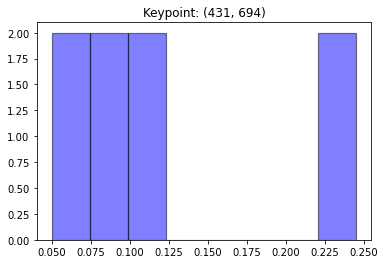

[0.04991999 0.07846367 0.12196179 0.24523571 0.24523571 0.09157307
 0.05842761 0.10918246]


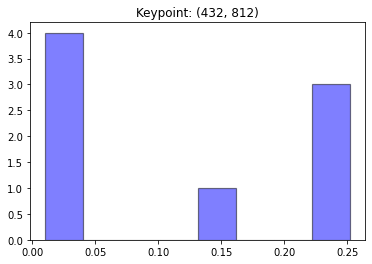

[0.02489696 0.01034248 0.03058807 0.15186431 0.25191278 0.25191278
 0.25191278 0.02656984]


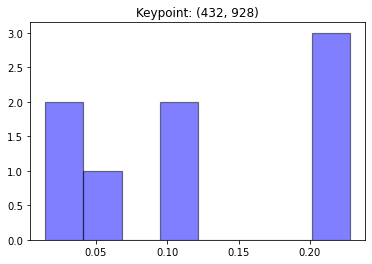

[0.10939176 0.22731005 0.22789265 0.22789265 0.10008729 0.05389758
 0.03896887 0.01455913]


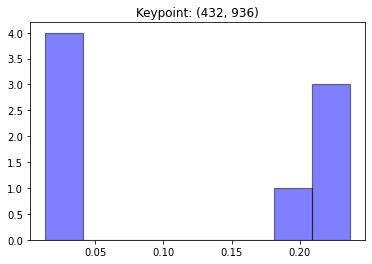

[0.23657006 0.23657006 0.23657006 0.20206035 0.03370222 0.02397169
 0.01347679 0.01707878]


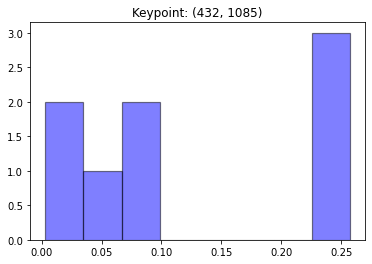

[0.07857976 0.00762308 0.00318913 0.05941658 0.25722804 0.25722804
 0.25722804 0.07950732]


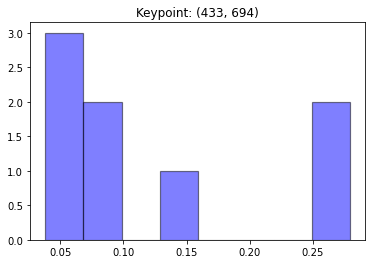

[0.03818123 0.07672381 0.13111412 0.27916247 0.27916247 0.05764448
 0.05432365 0.08368777]


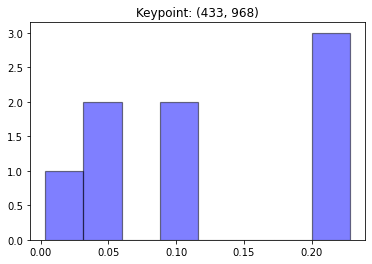

[0.05600666 0.11571756 0.22819548 0.22289057 0.21786509 0.10777325
 0.04807661 0.00347478]


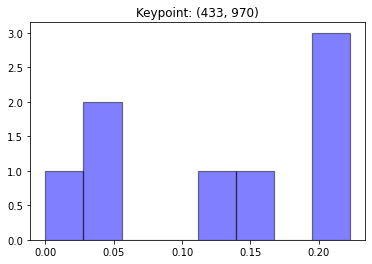

[0.0477737  0.15175004 0.22267279 0.19900445 0.21218987 0.121818
 0.04479115 0.        ]


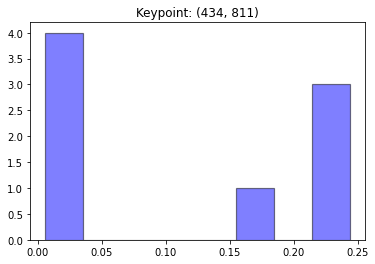

[0.01565383 0.00617573 0.03552142 0.18180433 0.24393412 0.24393412
 0.24393412 0.02904234]


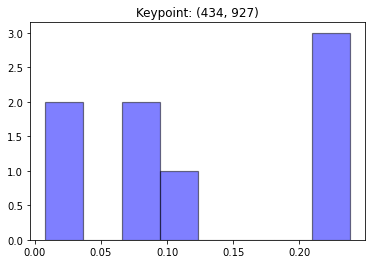

[0.09506599 0.23799682 0.23799682 0.23799682 0.09019585 0.06865939
 0.02399378 0.00809452]


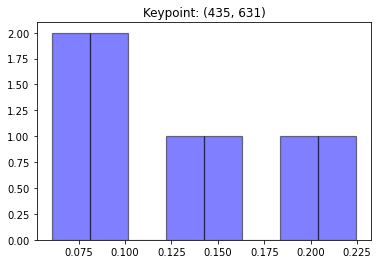

[0.14277192 0.06054701 0.18751283 0.09013656 0.09832144 0.22450748
 0.12317514 0.07302762]


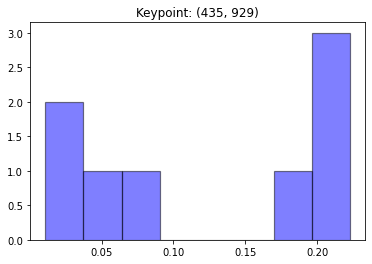

[0.17694052 0.22259221 0.22259221 0.22259221 0.07499696 0.05423166
 0.01095117 0.01510305]


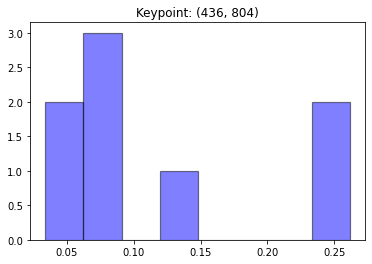

[0.07560657 0.05827852 0.26159299 0.13259154 0.03394189 0.0908124
 0.26159299 0.08558308]


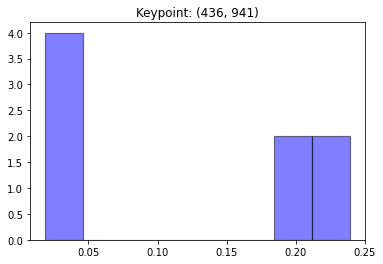

[0.23915797 0.20963542 0.21155826 0.23915797 0.03443533 0.01884955
 0.02031698 0.02688853]


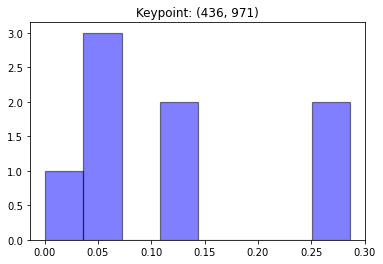

[0.06023668 0.28606271 0.28606271 0.13502213 0.13261519 0.06225779
 0.03702286 0.00071993]


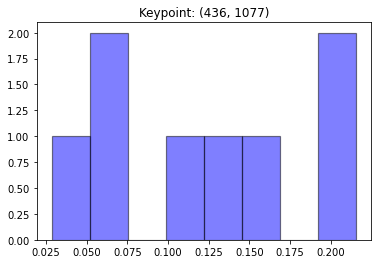

[0.21544177 0.12039617 0.14720349 0.21544177 0.06558844 0.02869399
 0.06521657 0.14201778]


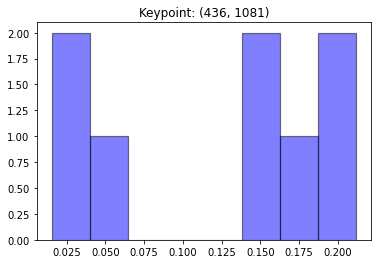

[0.21172643 0.0564259  0.03778043 0.13874724 0.01545409 0.14160112
 0.21172643 0.18653836]


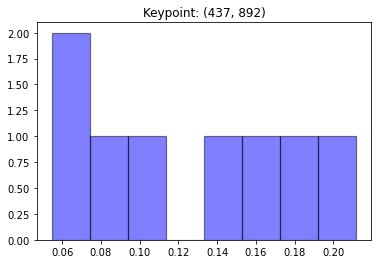

[0.09687151 0.21176069 0.16985587 0.0632463  0.0775901  0.0545678
 0.17566881 0.15043894]


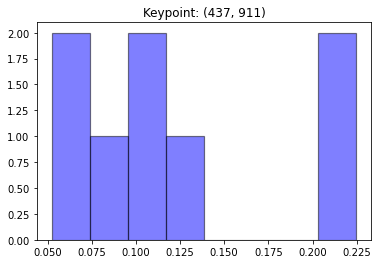

[0.11096169 0.2247234  0.2247234  0.08462311 0.07384348 0.05232792
 0.1271081  0.1016889 ]


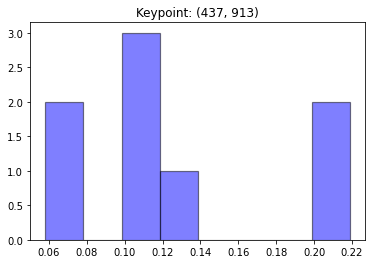

[0.10320595 0.21884089 0.21884089 0.09988579 0.06823734 0.05816791
 0.13330328 0.09951795]


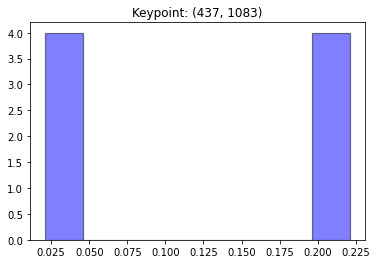

[0.22107962 0.03238439 0.03812887 0.02119657 0.02397168 0.22107962
 0.22107962 0.22107962]


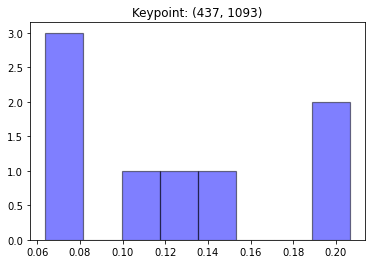

[0.20645868 0.07751181 0.06706091 0.19928556 0.11841544 0.15233923
 0.06380548 0.11512289]


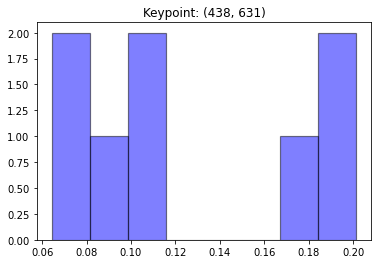

[0.10100735 0.07020225 0.17139523 0.09849821 0.18844363 0.20138864
 0.10473007 0.06433464]


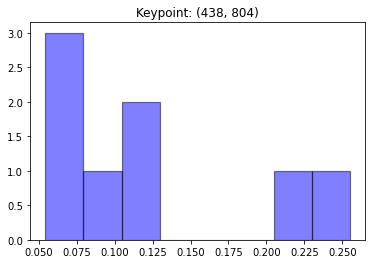

[0.07927848 0.05444241 0.22855256 0.09609911 0.06024294 0.11516101
 0.25489372 0.11132977]


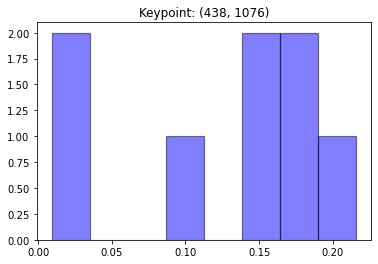

[0.21587109 0.17980272 0.15489851 0.17007039 0.09306529 0.00929824
 0.02052412 0.15646964]


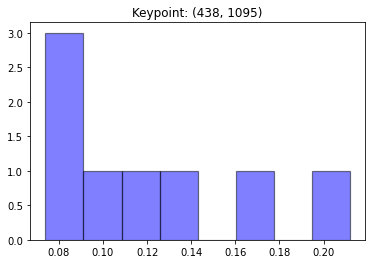

[0.21190899 0.10758944 0.08317964 0.17641517 0.08807837 0.12029851
 0.07391263 0.13861725]


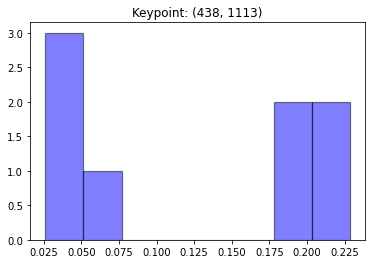

[0.02616327 0.03627433 0.19691881 0.22833129 0.06089753 0.20228723
 0.21952039 0.02960716]


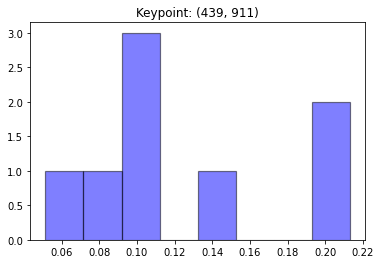

[0.10306086 0.20104298 0.21302718 0.1054091  0.08204294 0.05139684
 0.13835699 0.10566311]


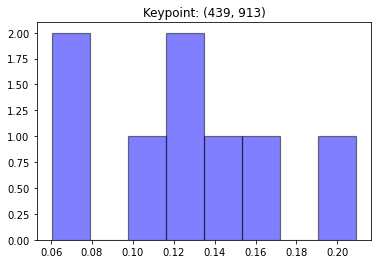

[0.1078543  0.16230299 0.20921719 0.12340111 0.07476651 0.06034606
 0.14516475 0.11694709]


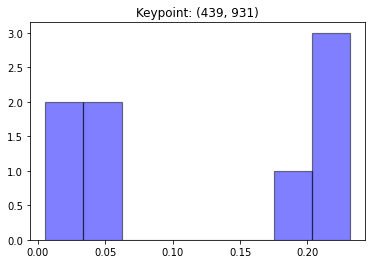

[0.23145435 0.23145435 0.23145435 0.18500842 0.04353917 0.03860449
 0.00548405 0.03300081]


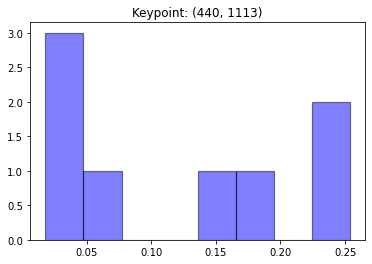

[0.02965882 0.02306735 0.16232013 0.25364945 0.07275757 0.25364945
 0.18691304 0.0179842 ]


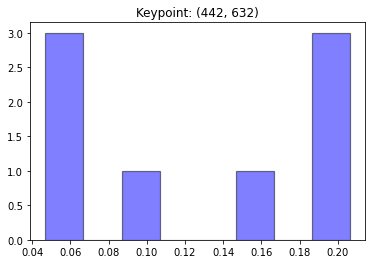

[0.04686051 0.05157674 0.16290567 0.18792442 0.20633839 0.20633839
 0.09044565 0.04761022]


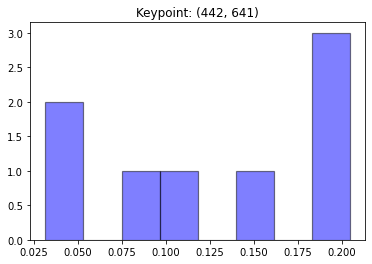

[0.03299931 0.03146063 0.10382169 0.20440539 0.20440539 0.19105718
 0.14723764 0.08461277]


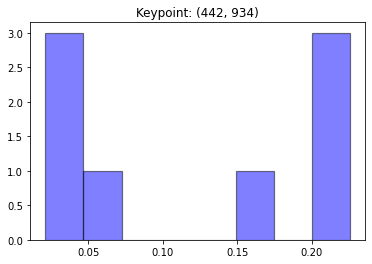

[0.22562849 0.16745749 0.22562849 0.22562849 0.06598062 0.0391408
 0.02105036 0.02948526]


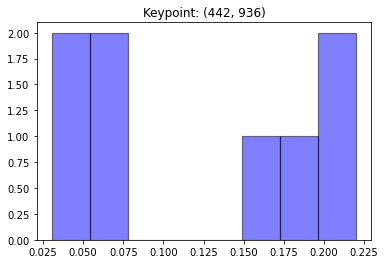

[0.22008203 0.16408706 0.19241971 0.22008203 0.06927292 0.0470167
 0.03047665 0.05656289]


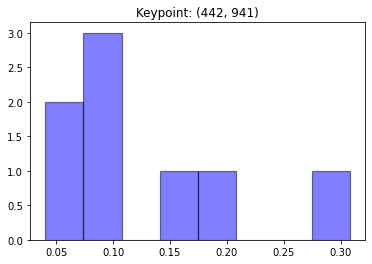

[0.08563632 0.09634842 0.17324952 0.3080355  0.17448087 0.0768399
 0.04492028 0.0404892 ]


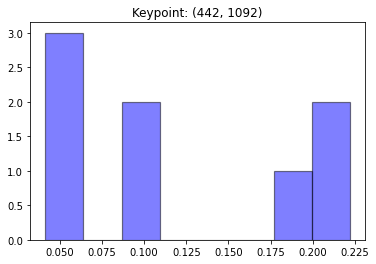

[0.04151478 0.05605343 0.06378142 0.22188358 0.22188358 0.19574887
 0.10206265 0.0970717 ]


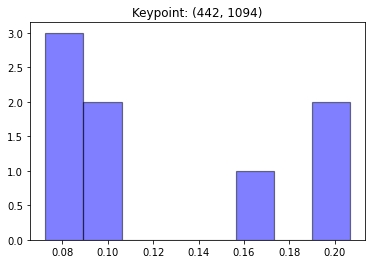

[0.09442055 0.08491581 0.0725145  0.20657972 0.19080745 0.17241528
 0.09245273 0.08589395]


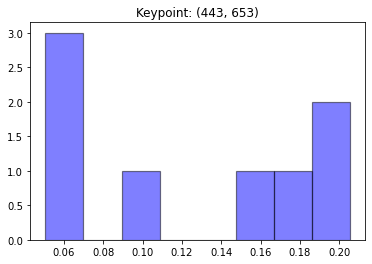

[0.05069093 0.05323148 0.10293997 0.20526961 0.19392213 0.1738487
 0.15540211 0.06469506]


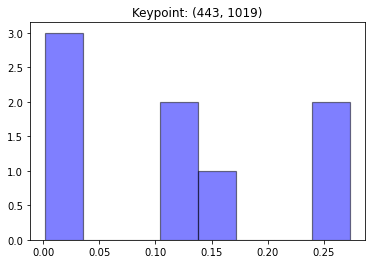

[0.00180495 0.03131635 0.27338219 0.14548636 0.13449598 0.27338219
 0.11243429 0.02769771]


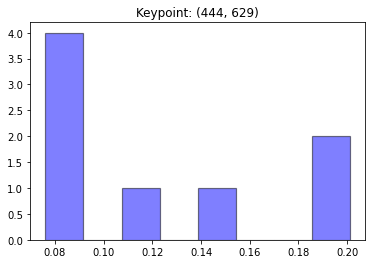

[0.12243231 0.07603924 0.08890712 0.19379102 0.20110918 0.15335567
 0.08436315 0.08000231]


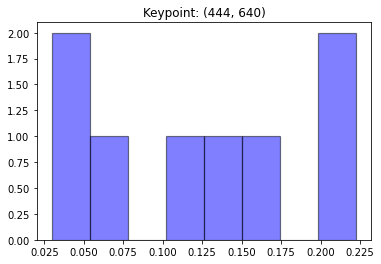

[0.02977423 0.03155558 0.12529971 0.22254938 0.22254938 0.16737197
 0.13348645 0.0674133 ]


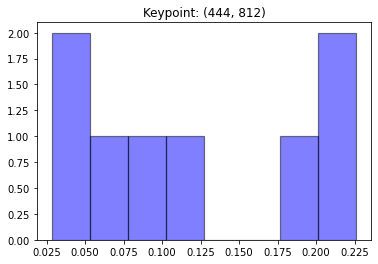

[0.08811204 0.04471936 0.02830099 0.11740758 0.22605261 0.22605261
 0.19661932 0.07273548]


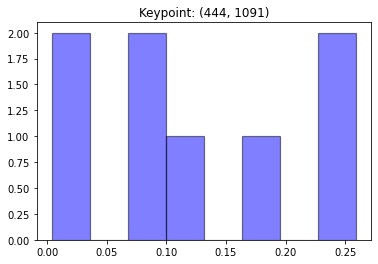

[0.00493574 0.00383548 0.06800001 0.25927041 0.25927041 0.19483043
 0.1135433  0.09631424]


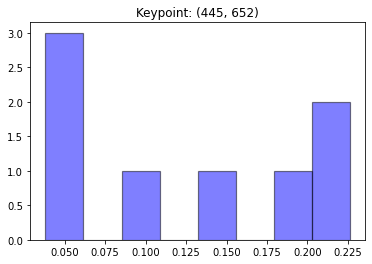

[0.04086627 0.03915336 0.09822525 0.20927577 0.22617923 0.19932233
 0.14891673 0.03806106]


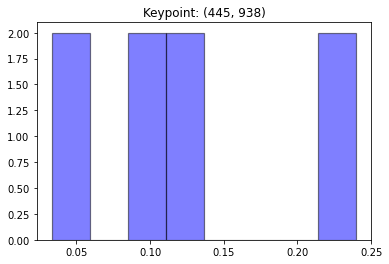

[0.0964334  0.13595555 0.23981516 0.23981516 0.11087069 0.08838535
 0.03331256 0.05541213]


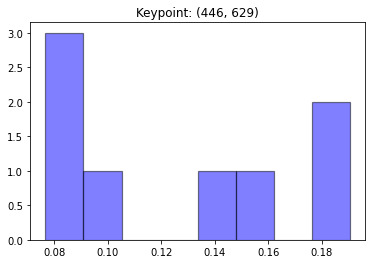

[0.14180771 0.07730441 0.15002082 0.18504672 0.19046349 0.0825734
 0.07673401 0.09604944]


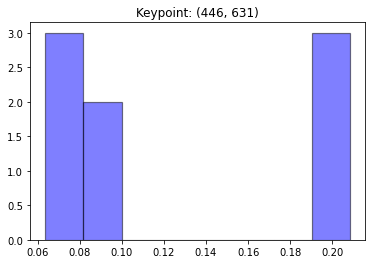

[0.08727088 0.06375644 0.19929338 0.20826502 0.20433146 0.09225012
 0.06790367 0.07692903]


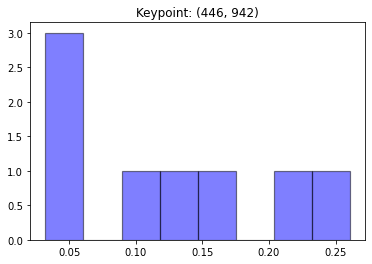

[0.05398832 0.1196941  0.16918841 0.26070756 0.2072297  0.10816973
 0.03219525 0.04882693]


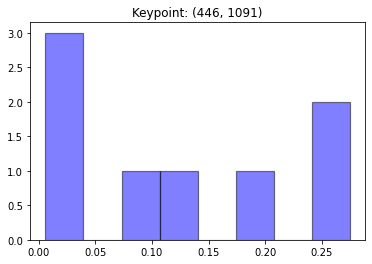

[0.00599032 0.01220257 0.01491771 0.27466673 0.27466673 0.19720568
 0.11744858 0.10290169]


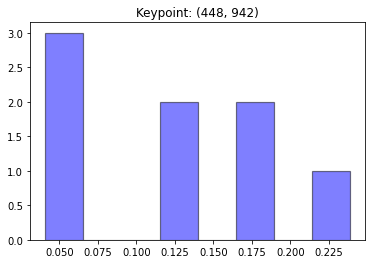

[0.06213731 0.12281261 0.18803894 0.23849922 0.17994481 0.12321694
 0.04099148 0.0443587 ]


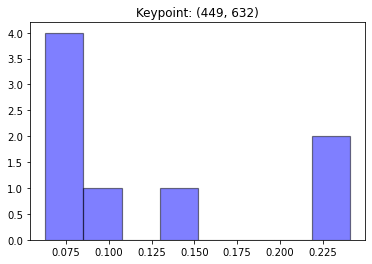

[0.08517788 0.07115142 0.24076839 0.24076839 0.08089257 0.14641002
 0.07194421 0.06288713]


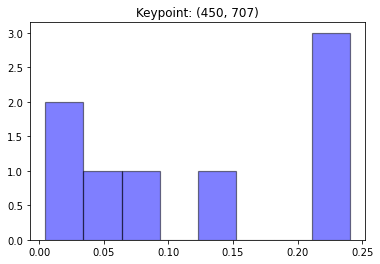

[0.24041616 0.24041616 0.22388128 0.00476799 0.02914727 0.0342562
 0.0849897  0.14212522]


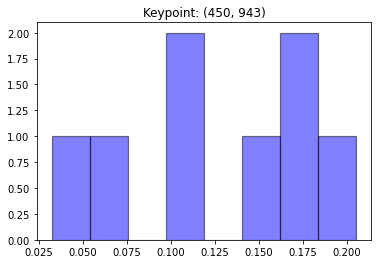

[0.16236334 0.18219605 0.11770164 0.20525309 0.14626696 0.09756392
 0.05623117 0.03242384]


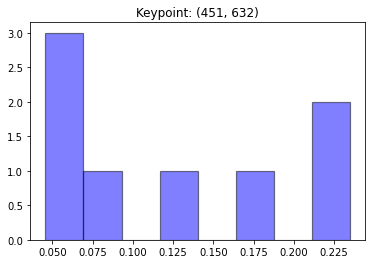

[0.13719769 0.1639729  0.23472707 0.23472707 0.04890229 0.08102653
 0.05369304 0.0457534 ]


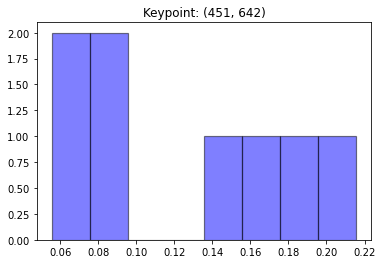

[0.05563589 0.08978244 0.07820288 0.16808562 0.21559249 0.1466501
 0.18164092 0.06440967]


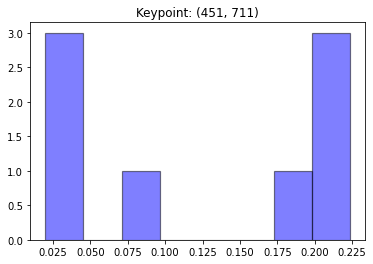

[0.22340127 0.17337545 0.20505678 0.02002575 0.02959702 0.03478479
 0.09035766 0.22340127]


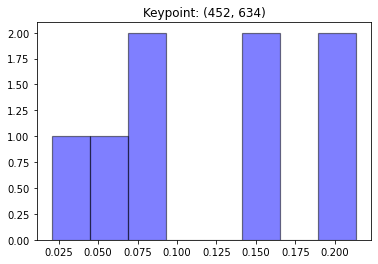

[0.16201029 0.16373496 0.21355175 0.21355175 0.02061623 0.0602052
 0.0891841  0.07714572]


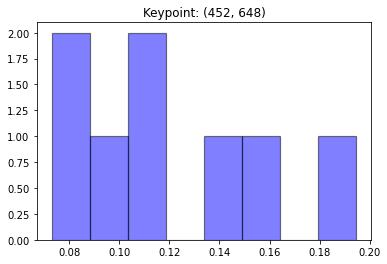

[0.16340703 0.10309572 0.07293709 0.11716094 0.19465187 0.14362213
 0.11768682 0.0874384 ]


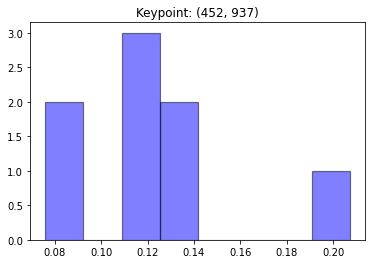

[0.1182256  0.12103971 0.14004765 0.13402185 0.08513365 0.0759779
 0.11840866 0.20714498]


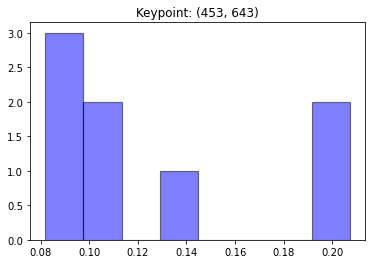

[0.09925069 0.1005198  0.08337938 0.14076622 0.20712877 0.09367463
 0.19326596 0.08201456]


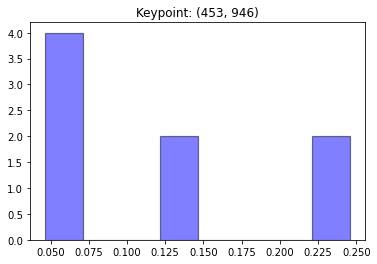

[0.24567896 0.14015629 0.06936678 0.1396115  0.0633717  0.04663846
 0.04949734 0.24567896]


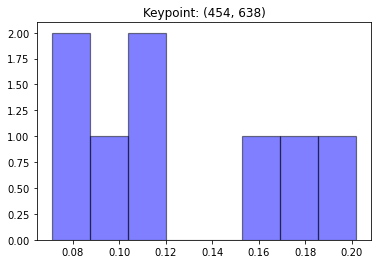

[0.10663214 0.15738567 0.08705569 0.177303   0.07104717 0.08758843
 0.20184545 0.11114246]


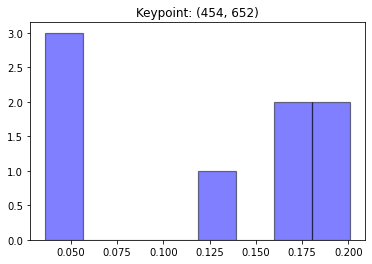

[0.18053639 0.03615927 0.05010106 0.04017181 0.17764589 0.20076037
 0.1790637  0.13556151]


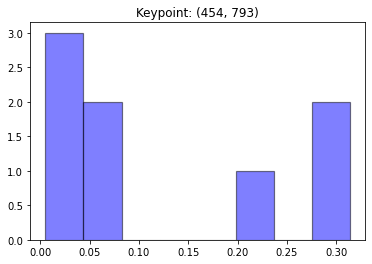

[0.31382968 0.04954377 0.02755044 0.00515971 0.00645435 0.05394283
 0.22968955 0.31382968]


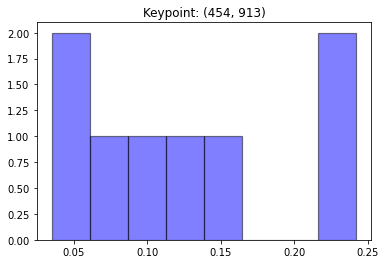

[0.06448535 0.24207234 0.24207234 0.03504483 0.03563132 0.09939461
 0.12561116 0.15568807]


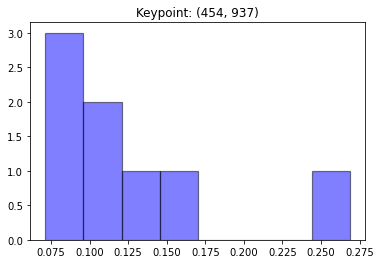

[0.15318504 0.07133437 0.11246767 0.07584205 0.10268165 0.08717628
 0.1286485  0.26866444]


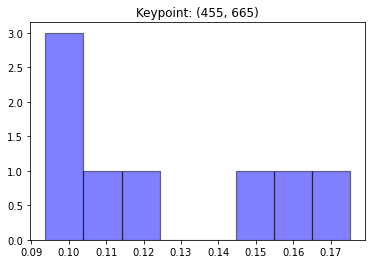

[0.11783296 0.10232856 0.09374623 0.09440711 0.14876362 0.10672588
 0.16108765 0.17510797]


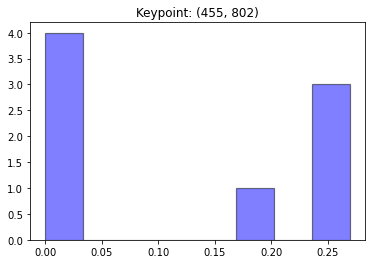

[0.17903333 0.         0.00486954 0.01371102 0.01982309 0.24345918
 0.26955192 0.26955192]


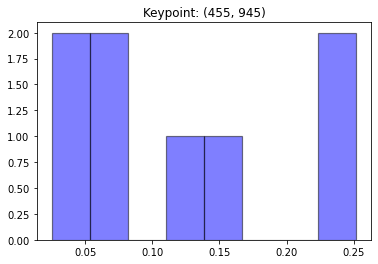

[0.25177938 0.15627706 0.08099195 0.12926862 0.02519593 0.06308686
 0.04162083 0.25177938]


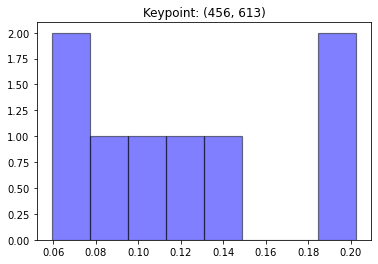

[0.08924168 0.19105605 0.12525398 0.07376723 0.1475456  0.20260182
 0.05921717 0.11131647]


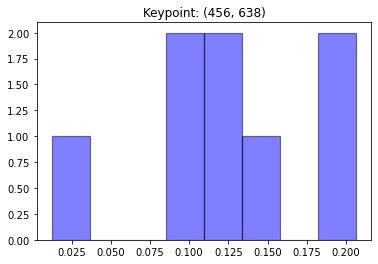

[0.1330916  0.19591696 0.0907508  0.14578232 0.01242726 0.09015232
 0.20651046 0.12536827]


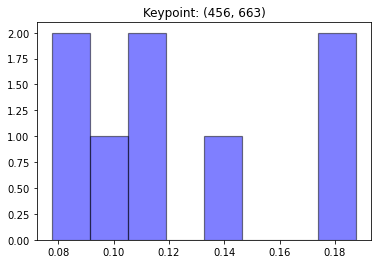

[0.11691965 0.14122738 0.08879234 0.0776221  0.09323441 0.10937926
 0.18516886 0.187656  ]


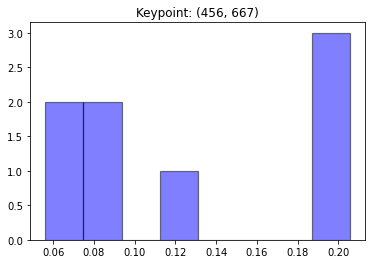

[0.11735146 0.05616628 0.06467796 0.07884136 0.20554092 0.08443983
 0.20554092 0.1874413 ]


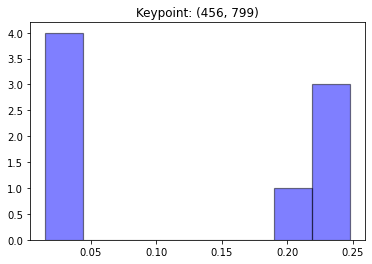

[0.24791441 0.03190645 0.01515726 0.01652676 0.02303208 0.19058252
 0.22696611 0.24791441]


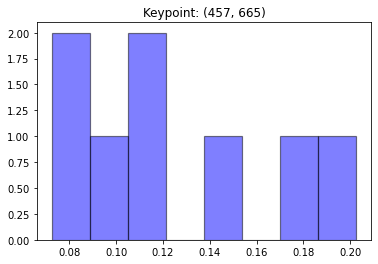

[0.10965899 0.09637665 0.07249425 0.07728528 0.15070371 0.1167078
 0.20259202 0.17418129]


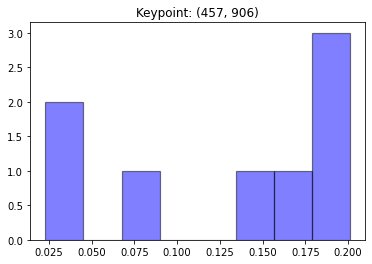

[0.07160746 0.02592131 0.02301232 0.14600041 0.20099575 0.1566472
 0.1942866  0.18152895]


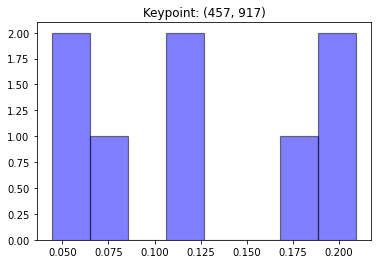

[0.12614098 0.20934052 0.20934052 0.10886721 0.06921462 0.06257941
 0.04429662 0.17022011]


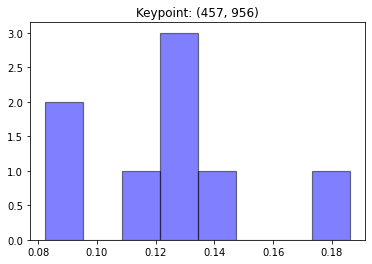

[0.12828667 0.18608782 0.12524765 0.08244423 0.11900123 0.08316462
 0.13208173 0.14368606]


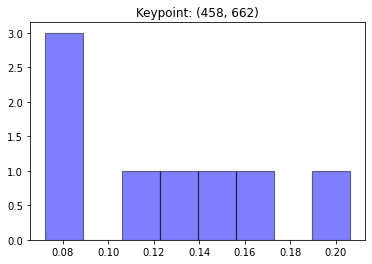

[0.11272764 0.15571288 0.07232192 0.076782   0.08041891 0.12565919
 0.20610078 0.17027668]


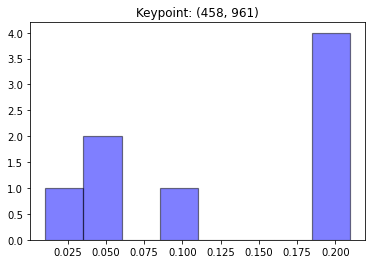

[0.20935436 0.20935436 0.20935436 0.18875391 0.03712107 0.01048122
 0.04478401 0.0907967 ]


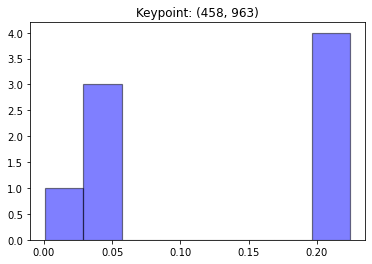

[0.22412878 0.22412878 0.22412878 0.21622599 0.03208167 0.00101169
 0.02980879 0.04848552]


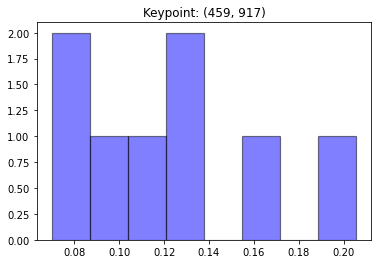

[0.13460462 0.1301173  0.16186313 0.09791903 0.08131985 0.07003782
 0.11866553 0.20547272]


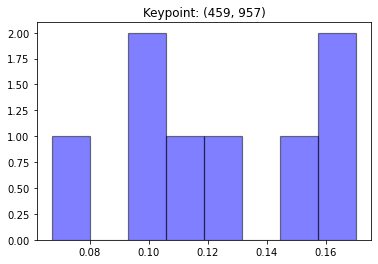

[0.10371124 0.16658633 0.12818221 0.1527481  0.17030699 0.06706549
 0.10302173 0.10837792]


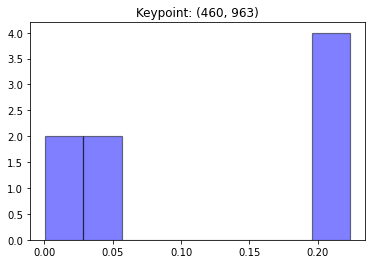

[0.2232793  0.2232793  0.2232793  0.2232793  0.03745983 0.00088561
 0.02609405 0.04244331]


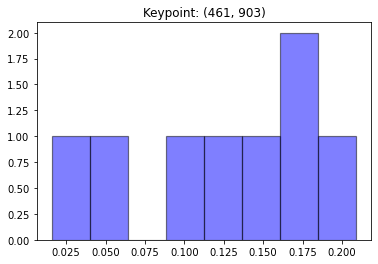

[0.1577745  0.05599886 0.01587512 0.1274026  0.18011059 0.09203112
 0.16182216 0.20898506]


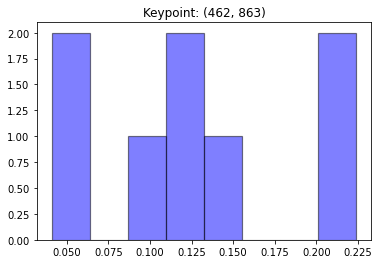

[0.11473103 0.12142705 0.04103055 0.04532261 0.09193009 0.22396105
 0.22396105 0.13763657]


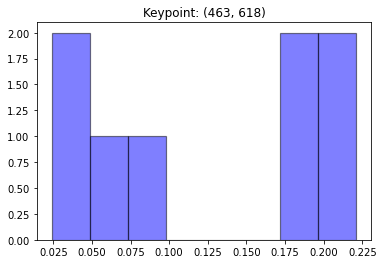

[0.18149334 0.22095588 0.22095588 0.07253933 0.07907161 0.17441933
 0.02654635 0.02401828]


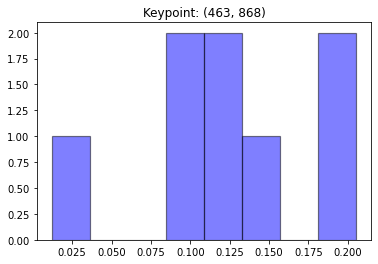

[0.13225643 0.20540799 0.14638676 0.20301795 0.10962825 0.01202336
 0.08868427 0.10259498]


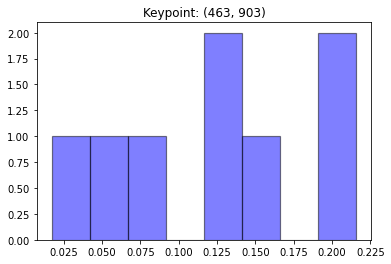

[0.1477066  0.0609735  0.01712025 0.13080666 0.12030695 0.09155741
 0.21576432 0.21576432]


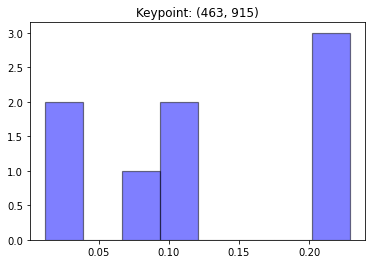

[0.08353336 0.01199364 0.01355497 0.09720021 0.10698155 0.22891209
 0.22891209 0.22891209]


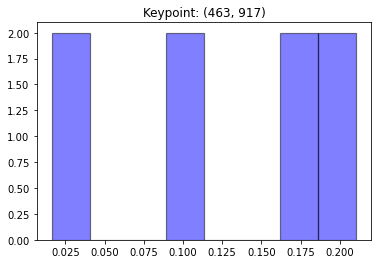

[0.16764501 0.03096819 0.01630321 0.10365832 0.09310351 0.16749801
 0.21041188 0.21041188]


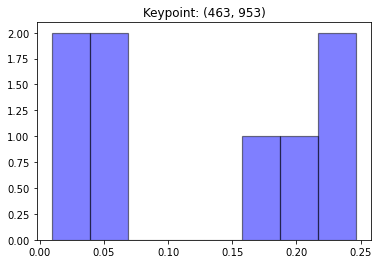

[0.04594445 0.04573258 0.02867334 0.1712594  0.24655657 0.24655657
 0.20594797 0.00932911]


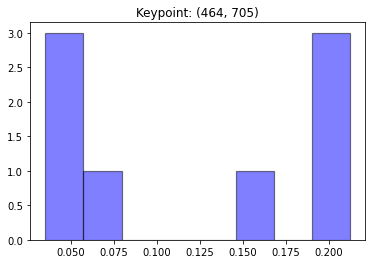

[0.21221146 0.20994473 0.21221146 0.05154273 0.04233772 0.03496146
 0.07497107 0.16181937]


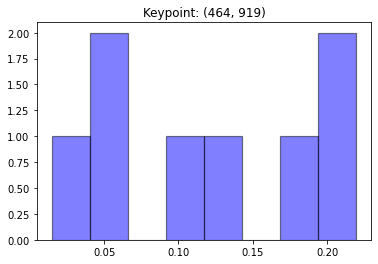

[0.21951568 0.06099887 0.01476106 0.12394784 0.11472717 0.06250247
 0.18403124 0.21951568]


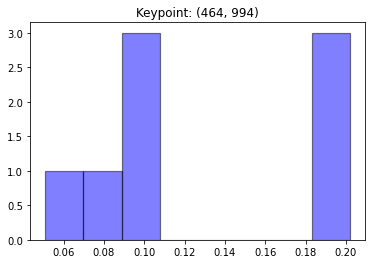

[0.18887066 0.20191327 0.08932606 0.18757251 0.10479995 0.09870723
 0.0510131  0.07779722]


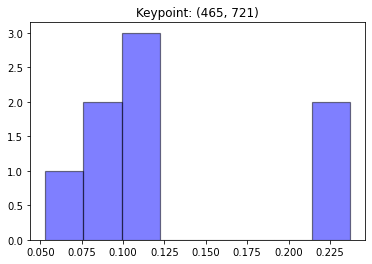

[0.07664952 0.05307175 0.23694566 0.23694566 0.11432468 0.10331035
 0.10247108 0.07628129]


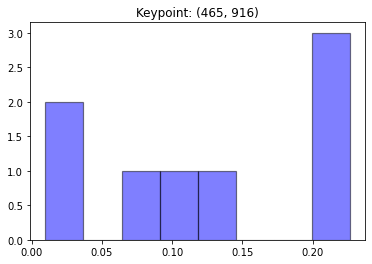

[0.12403975 0.01799101 0.00989909 0.09266805 0.07610913 0.22643099
 0.22643099 0.22643099]


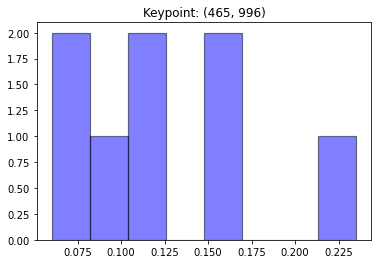

[0.15427057 0.23504836 0.10850637 0.16303179 0.07772834 0.09689305
 0.06017313 0.10434837]


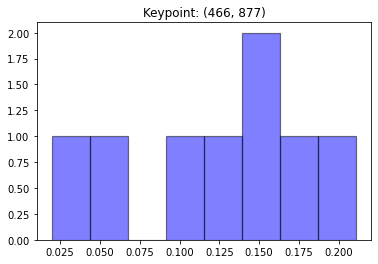

[0.01979309 0.10715572 0.15596631 0.1172715  0.17762609 0.15200543
 0.21088893 0.05929293]


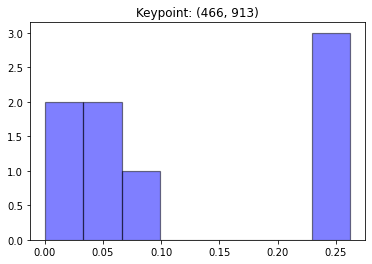

[0.06268201 0.00223241 0.0006928  0.05638929 0.09213287 0.26195687
 0.26195687 0.26195687]


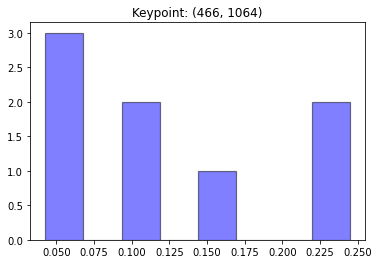

[0.24483077 0.1004151  0.24483077 0.10341647 0.04271698 0.05324017
 0.04603673 0.16451301]


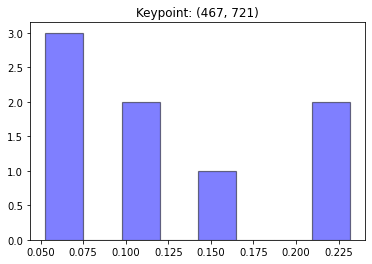

[0.06718358 0.05280426 0.2316248  0.2316248  0.14546867 0.10496235
 0.09774382 0.06858771]


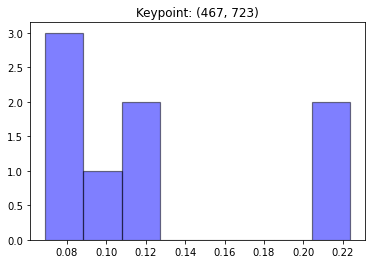

[0.07672802 0.06920638 0.22348953 0.22348953 0.10763605 0.1108374
 0.11135725 0.07725583]


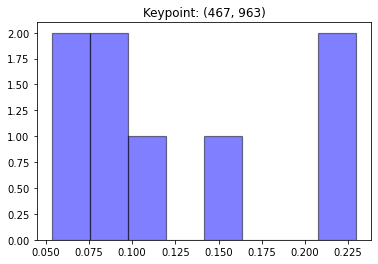

[0.05350114 0.14975205 0.21279978 0.22966905 0.11766122 0.09022434
 0.06020573 0.0861867 ]


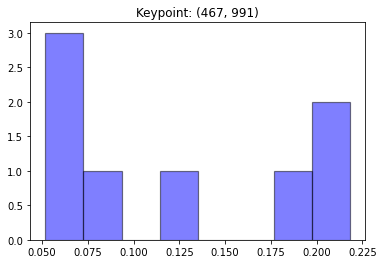

[0.19977452 0.06211717 0.06817725 0.21815877 0.17835473 0.13116073
 0.05180853 0.0904483 ]


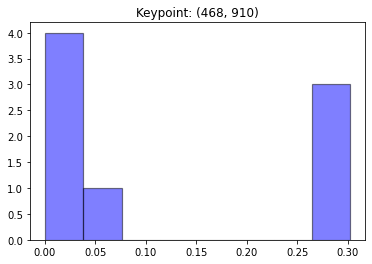

[0.06858186 0.0034956  0.0007903  0.00331495 0.01856753 0.30174992
 0.30174992 0.30174992]


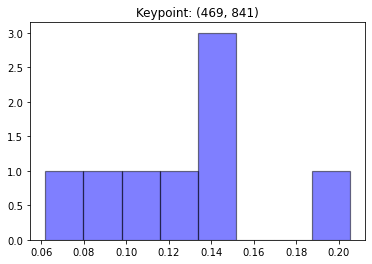

[0.1100418  0.08728458 0.14508498 0.13599193 0.06195424 0.11595581
 0.20514408 0.13854258]


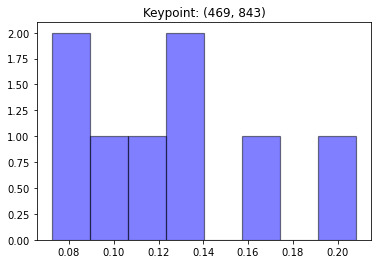

[0.12903498 0.10145958 0.13885271 0.11395098 0.07231891 0.07438526
 0.20829709 0.16170049]


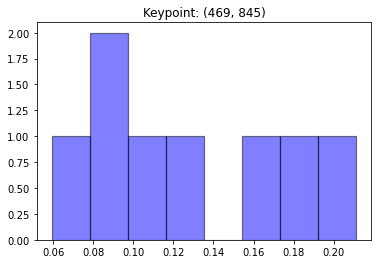

[0.15452057 0.10221393 0.12132821 0.08651443 0.05920838 0.08704114
 0.21127406 0.17789929]


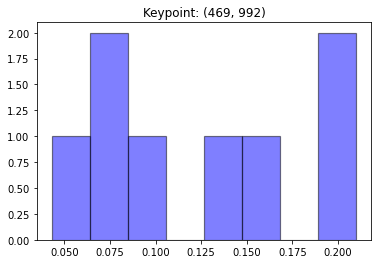

[0.14832906 0.09937463 0.0663054  0.2099471  0.2099471  0.14281363
 0.0431242  0.08015888]


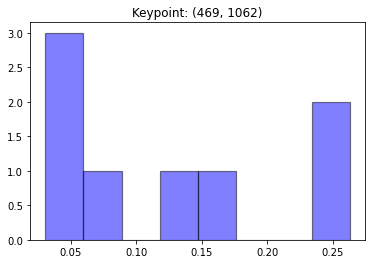

[0.26299942 0.15431237 0.24533431 0.08398806 0.04189044 0.04603507
 0.03077571 0.13466462]


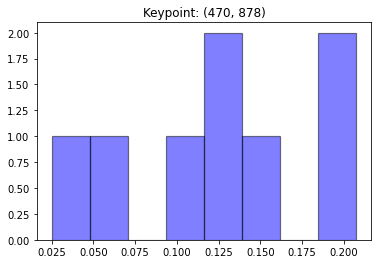

[0.13577333 0.20750138 0.20750138 0.10298905 0.145889   0.12737687
 0.04795893 0.02501005]


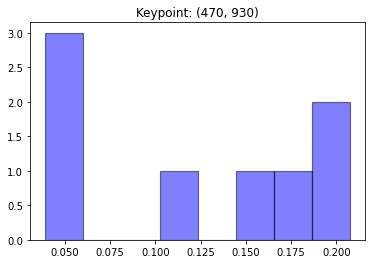

[0.11407117 0.03933563 0.04661383 0.14656815 0.20738123 0.18292011
 0.20661292 0.05649695]


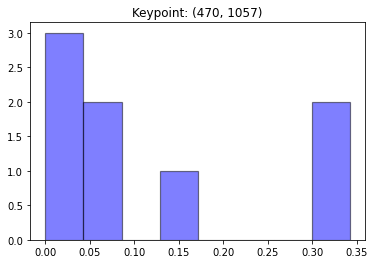

[0.3421023  0.         0.02513791 0.07099327 0.04898574 0.
 0.17067848 0.3421023 ]


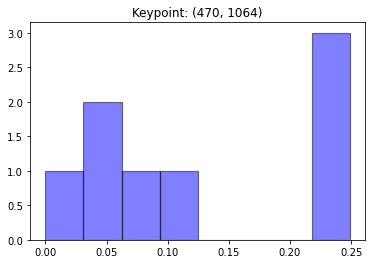

[0.24894809 0.24894809 0.24894809 0.11367297 0.04057288 0.03393435
 0.         0.06497555]


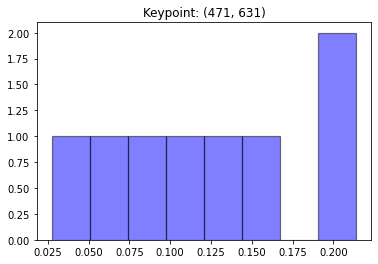

[0.21399273 0.21399273 0.1534881  0.09335229 0.0555977  0.02741736
 0.11564554 0.12651355]


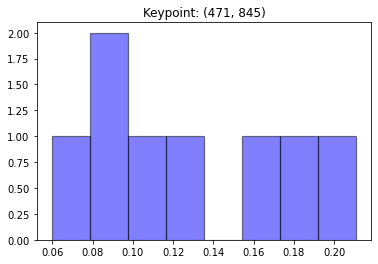

[0.18064002 0.10241358 0.12233523 0.0872325  0.05969981 0.08199164
 0.21086654 0.15482069]


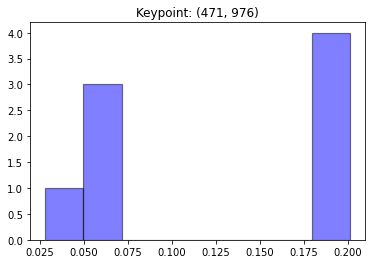

[0.18552283 0.06964258 0.02819554 0.06708174 0.20089871 0.18961074
 0.06321371 0.19583417]


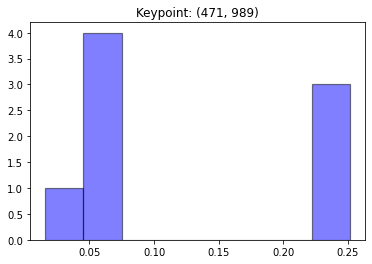

[0.07079185 0.01593993 0.04694718 0.25142072 0.25142072 0.25062878
 0.05339645 0.05945437]


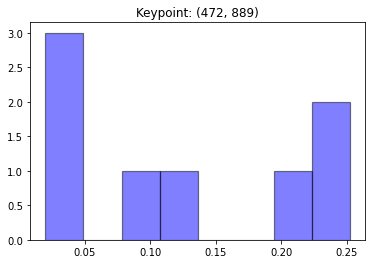

[0.11867701 0.01977369 0.02325763 0.04696791 0.20606712 0.08037326
 0.25244169 0.25244169]


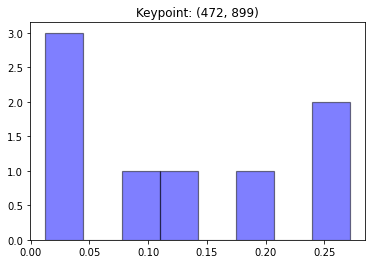

[0.27155121 0.12323137 0.01259776 0.02383668 0.08655788 0.01458033
 0.19609356 0.27155121]


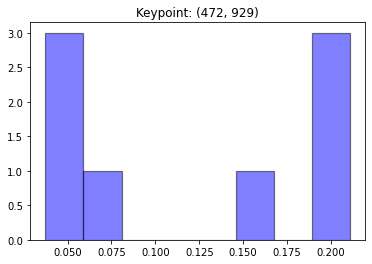

[0.0567229  0.05076201 0.03741786 0.15102707 0.21067699 0.21067699
 0.21067699 0.07203918]


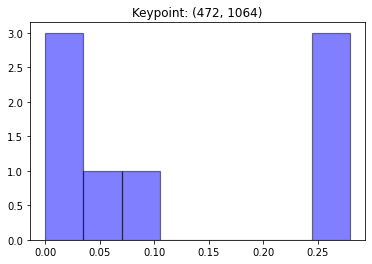

[0.27954375 0.2577238  0.27954375 0.07461779 0.02654344 0.01398677
 0.         0.0680407 ]


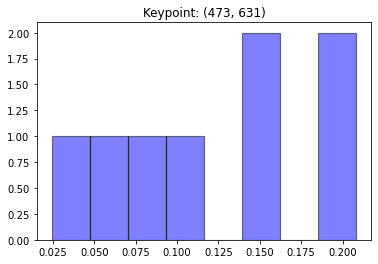

[0.20817125 0.20817125 0.15675735 0.09243748 0.05609383 0.02430092
 0.10250048 0.15156744]


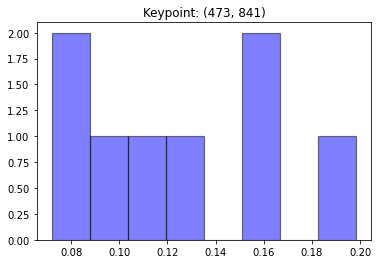

[0.09097212 0.1163349  0.19830046 0.15531279 0.07198488 0.07273478
 0.16426706 0.130093  ]


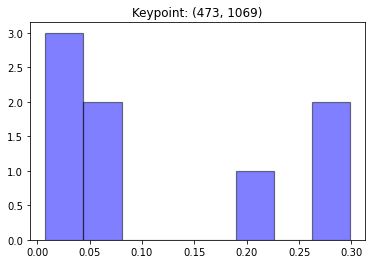

[0.06134326 0.2083429  0.29836492 0.29836492 0.02747399 0.03680512
 0.00779901 0.06150588]


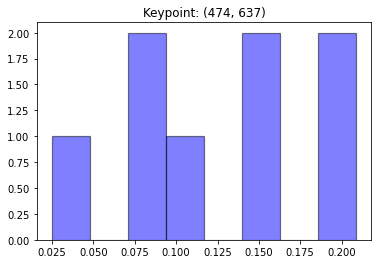

[0.15004443 0.20886135 0.20886135 0.15056509 0.09974944 0.02477833
 0.07494818 0.08219183]


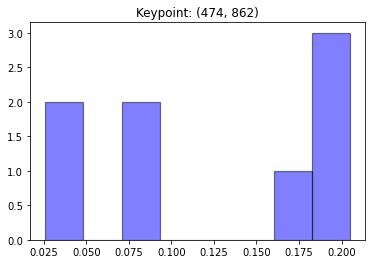

[0.16538126 0.20480289 0.07910112 0.02600675 0.04777212 0.08579237
 0.1863406  0.20480289]


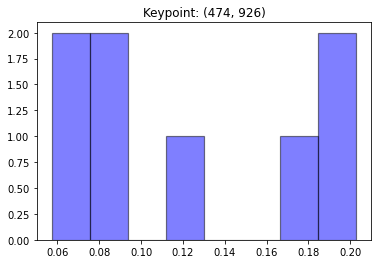

[0.08926657 0.05731156 0.06927364 0.1178166  0.19304213 0.1801459
 0.2028558  0.0902878 ]


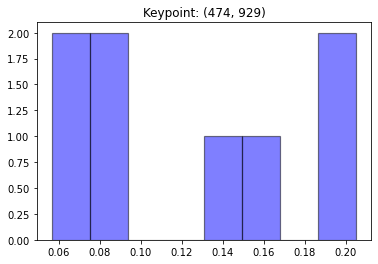

[0.08793981 0.05645974 0.08354315 0.14634184 0.20501896 0.19860889
 0.15413349 0.06795411]


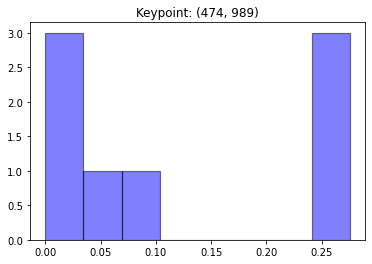

[0.         0.02042873 0.05711861 0.27554839 0.27554839 0.27554839
 0.07325597 0.02255151]


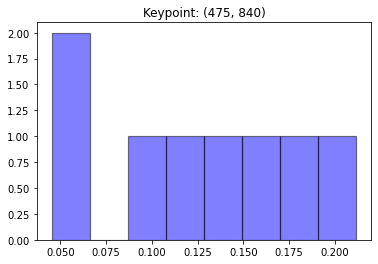

[0.1148536  0.16238262 0.21171741 0.10548214 0.05924884 0.04534317
 0.12943707 0.17153515]


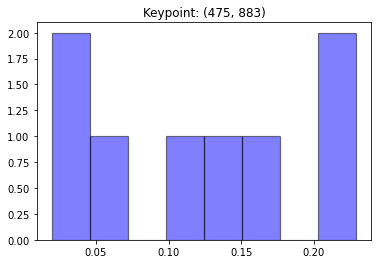

[0.22916962 0.11395295 0.12820898 0.0195487  0.0718593  0.0414698
 0.22916962 0.16662103]


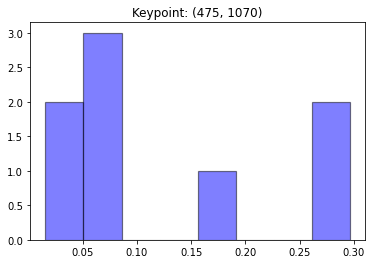

[0.05202755 0.16199199 0.29633653 0.29633653 0.06165568 0.0484037
 0.0154927  0.06775532]


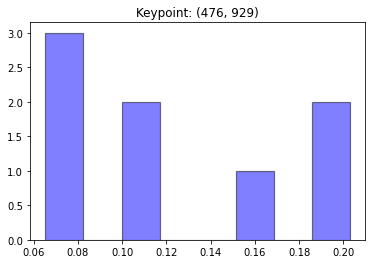

[0.11400559 0.06534459 0.07962725 0.11549906 0.20285831 0.1976164
 0.1525786  0.07247019]


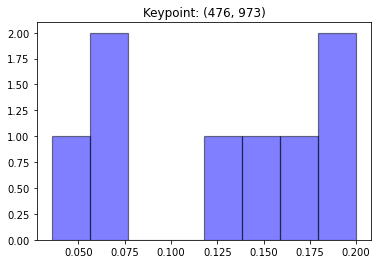

[0.20000774 0.06444585 0.06102306 0.03565034 0.1668816  0.19209104
 0.14867889 0.13122147]


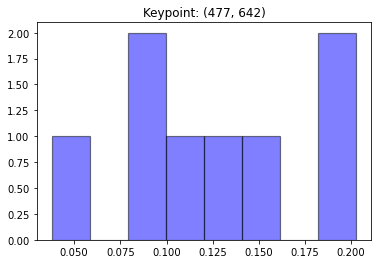

[0.03783571 0.08867173 0.20270205 0.20270205 0.14140322 0.11072663
 0.12049973 0.09545888]


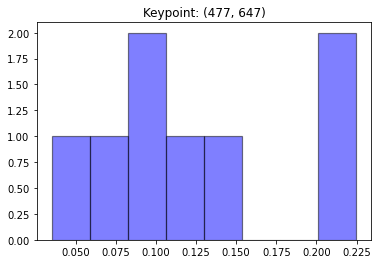

[0.03515075 0.22476336 0.22476336 0.06244843 0.09595004 0.09122999
 0.14027455 0.12541953]


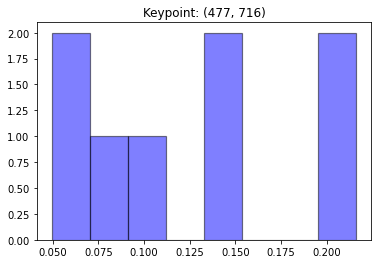

[0.07728088 0.1486122  0.19589357 0.21607227 0.13533162 0.04943571
 0.10773505 0.06963871]


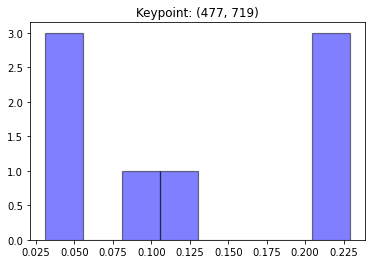

[0.05046998 0.22899362 0.22899362 0.22899362 0.10774439 0.03111336
 0.08342412 0.04026727]


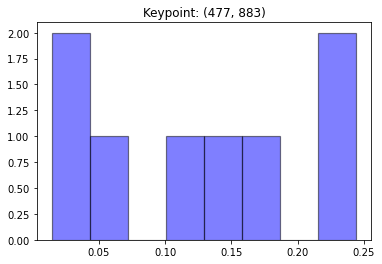

[0.24421558 0.13537017 0.10155061 0.01448427 0.02696435 0.0495442
 0.24421558 0.18365523]


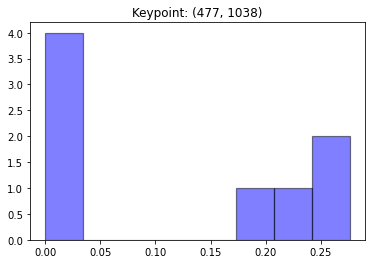

[0.00745993 0.         0.         0.00190469 0.20337076 0.2764964
 0.2764964  0.23427181]


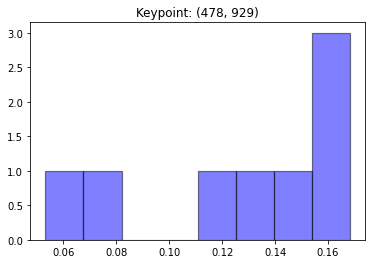

[0.15745667 0.11232005 0.07102662 0.05320154 0.14486332 0.16822521
 0.16424641 0.12866019]


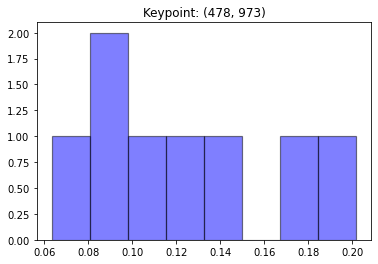

[0.20169269 0.06346511 0.08108936 0.0897894  0.14093105 0.18206577
 0.12599674 0.11496988]


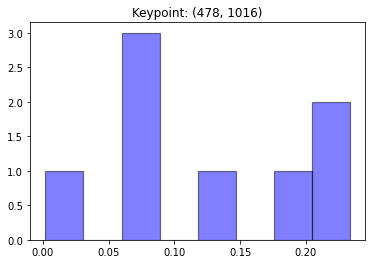

[0.06195761 0.19697117 0.0620729  0.00196389 0.12463745 0.23336213
 0.23336213 0.08567271]


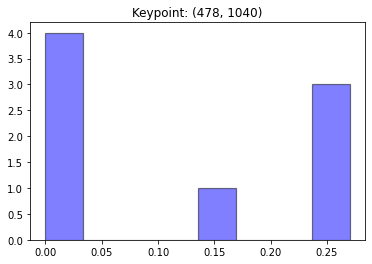

[0.02550617 0.         0.         0.         0.16391654 0.27019243
 0.27019243 0.27019243]


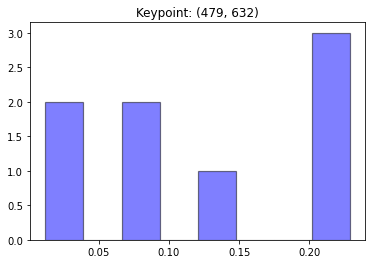

[0.22886419 0.22886419 0.21742316 0.07770767 0.06954045 0.01187579
 0.0276077  0.13811683]


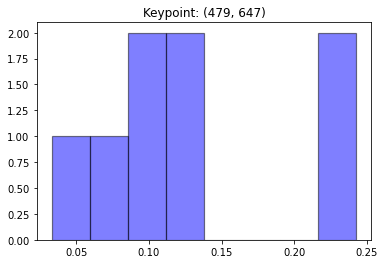

[0.03298263 0.2427634  0.2427634  0.06091626 0.08563852 0.08560287
 0.1324035  0.11692942]


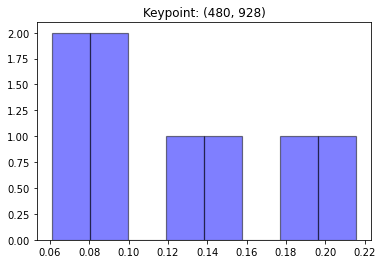

[0.21569095 0.18274875 0.07580803 0.06090413 0.08033762 0.09635712
 0.15112435 0.13702906]


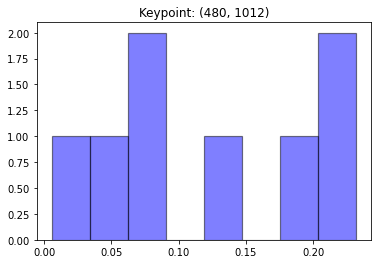

[0.07823778 0.23183165 0.07700367 0.00567134 0.05065831 0.13505426
 0.23183165 0.18971134]


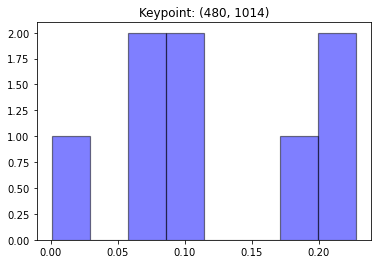

[0.06979651 0.22788532 0.08009771 0.0006088  0.10536047 0.18512512
 0.22788532 0.10324075]


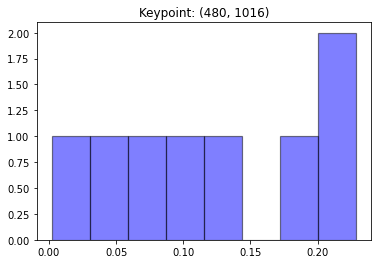

[0.06673649 0.19464937 0.05443138 0.00213926 0.12996278 0.22877632
 0.22877632 0.09452809]


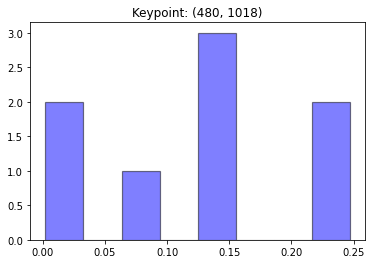

[0.09134197 0.13760044 0.00210764 0.0034844  0.1413863  0.24694509
 0.24694509 0.13018907]


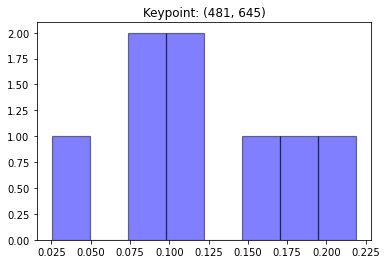

[0.02519657 0.11573672 0.21887564 0.15837411 0.18580962 0.09148625
 0.11356126 0.09095983]


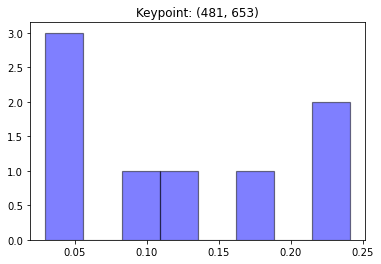

[0.16745327 0.24079843 0.24079843 0.04657137 0.05371034 0.02973387
 0.09213413 0.12880016]


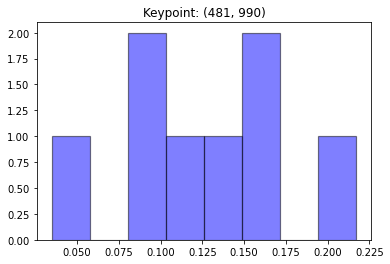

[0.21709335 0.15836054 0.10247026 0.09215315 0.15278524 0.13438503
 0.03484882 0.1079036 ]


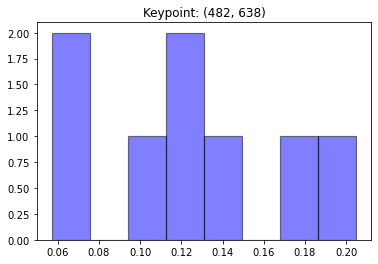

[0.14493623 0.20486058 0.1032216  0.17250883 0.12602683 0.05713577
 0.06474433 0.12656582]


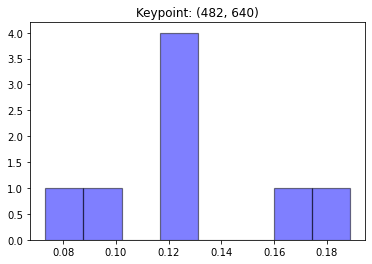

[0.12280277 0.11723169 0.12688462 0.18866851 0.16630606 0.08777272
 0.07321789 0.11711575]


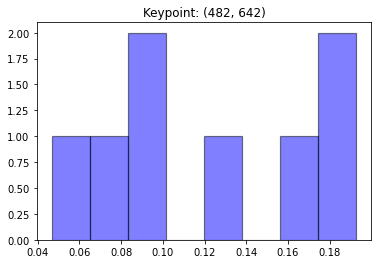

[0.08172976 0.04676995 0.15904886 0.18955282 0.19267963 0.09893571
 0.09494704 0.13633623]


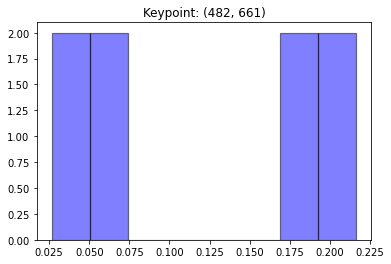

[0.2163564  0.18147512 0.19127037 0.2163564  0.02664456 0.06477688
 0.04620112 0.05691916]


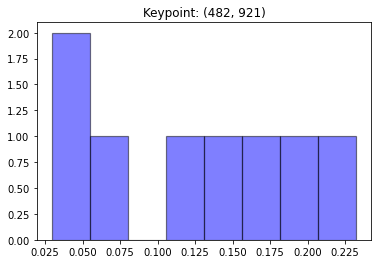

[0.17937615 0.13884599 0.03973589 0.06054847 0.02939837 0.19159015
 0.23237578 0.12812921]


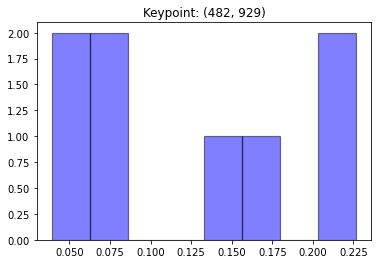

[0.22664979 0.13439531 0.07340608 0.03917939 0.04244007 0.0776311
 0.17964847 0.22664979]


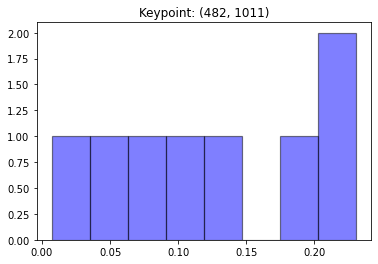

[0.12231541 0.17758503 0.08813127 0.0071753  0.04220816 0.1008996
 0.23084261 0.23084261]


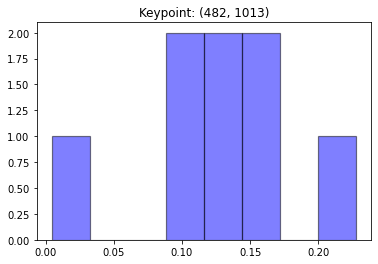

[0.12796932 0.1586416  0.09158653 0.00444996 0.09313225 0.13504917
 0.22781373 0.16135744]


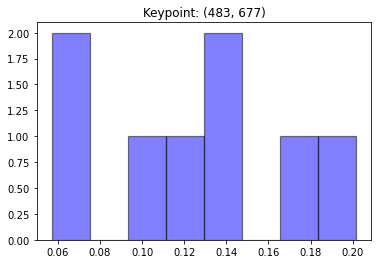

[0.20164201 0.06639593 0.05710852 0.13245118 0.18001192 0.12266899
 0.13632818 0.10339328]


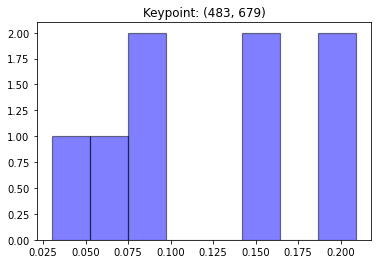

[0.2090991  0.07784795 0.06499412 0.16103521 0.2090991  0.1568041
 0.03005579 0.09106462]


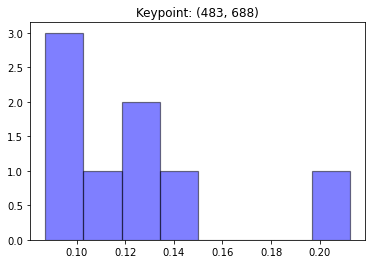

[0.21239244 0.11332418 0.09556277 0.14028317 0.08711901 0.0929997
 0.12447078 0.13384795]


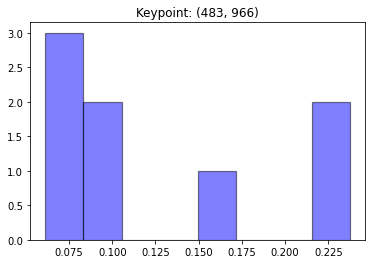

[0.23737133 0.06808596 0.08638544 0.07453455 0.06133086 0.08549899
 0.14942154 0.23737133]


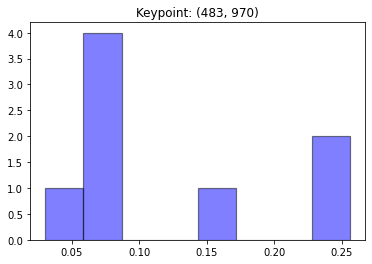

[0.25589116 0.06541353 0.07991606 0.08385694 0.03068902 0.07144467
 0.15689747 0.25589116]


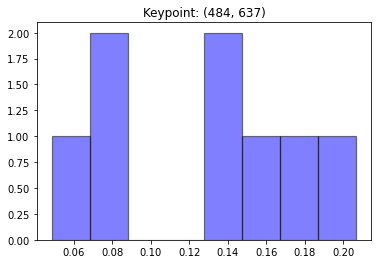

[0.17749869 0.20677441 0.13252292 0.13601471 0.0787755  0.04863113
 0.06929573 0.15048692]


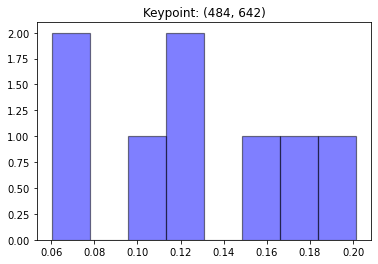

[0.10532719 0.12536999 0.2013652  0.150625   0.17012052 0.06031592
 0.06037946 0.12649672]


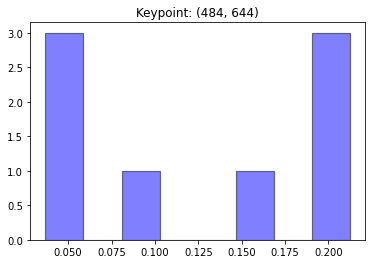

[0.03688179 0.20013566 0.2123321  0.15677872 0.1993676  0.05809062
 0.05412645 0.08228706]


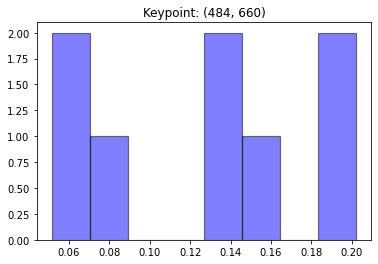

[0.1966194  0.13372684 0.15845295 0.20226058 0.05203276 0.13141636
 0.07404712 0.051444  ]


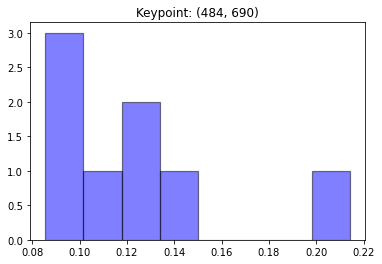

[0.21410318 0.11688432 0.08957055 0.14176448 0.09735823 0.08552645
 0.12319279 0.13160001]


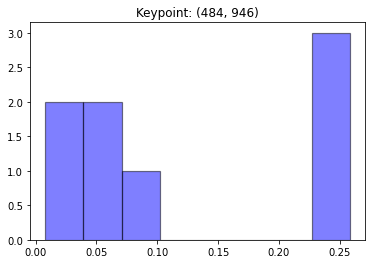

[0.25818585 0.25818585 0.06097447 0.0083514  0.00803238 0.05352547
 0.09455872 0.25818585]


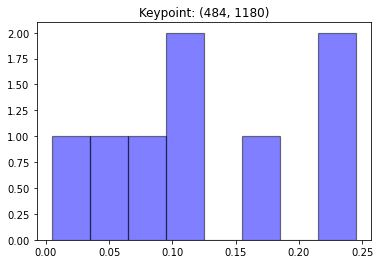

[0.10741074 0.24514137 0.1713927  0.04148238 0.00466946 0.08980516
 0.24514137 0.09495684]


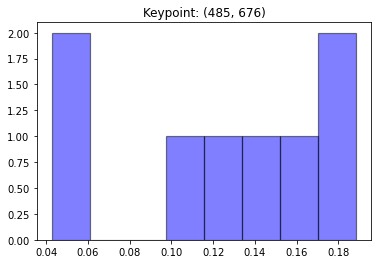

[0.16539042 0.04264558 0.05065506 0.11706217 0.14352758 0.18676602
 0.18850131 0.10545186]


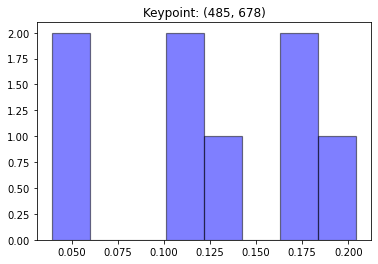

[0.17108281 0.0527517  0.03916028 0.12722517 0.17527836 0.20427531
 0.11743782 0.11278854]


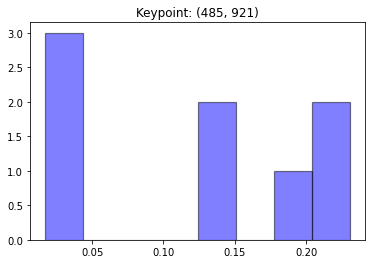

[0.23052675 0.14431522 0.03879223 0.01731751 0.02107846 0.1901111
 0.23052675 0.12733199]


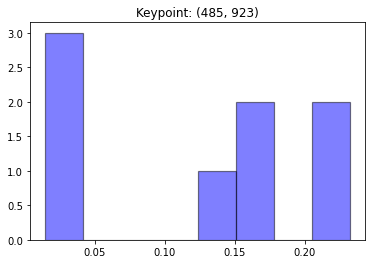

[0.23204977 0.16009034 0.03679525 0.0147088  0.0243319  0.16609624
 0.23204977 0.13387792]


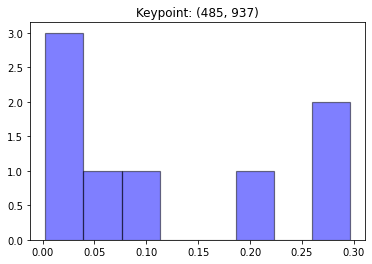

[0.29604015 0.06823423 0.03039695 0.00276318 0.00624163 0.09611002
 0.20417368 0.29604015]


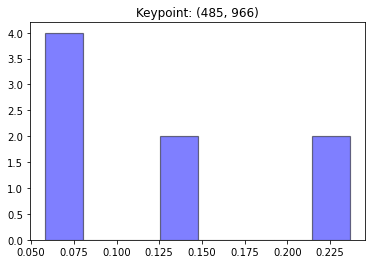

[0.23651569 0.06003149 0.07412745 0.05837845 0.06150952 0.13679077
 0.13613094 0.23651569]


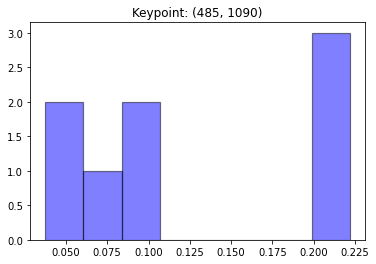

[0.10230027 0.09032966 0.22187707 0.22187707 0.22187707 0.0417635
 0.03757597 0.06239938]


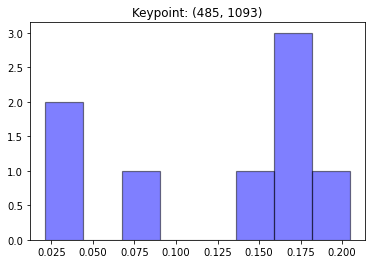

[0.17113092 0.1654383  0.20456555 0.17079962 0.15821605 0.02147698
 0.02788288 0.0804897 ]


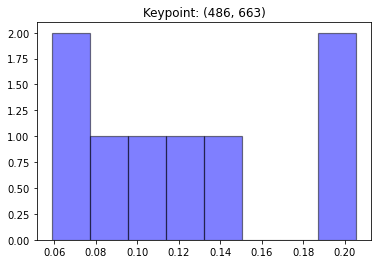

[0.09766144 0.12639799 0.14599407 0.20548245 0.08801937 0.20137097
 0.07620861 0.0588651 ]


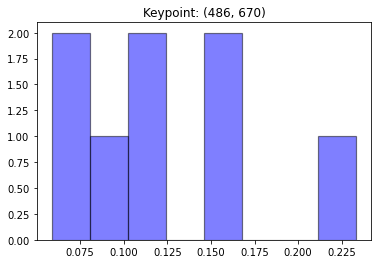

[0.14832005 0.06058753 0.12175713 0.12051743 0.0588398  0.09427985
 0.233232   0.16246622]


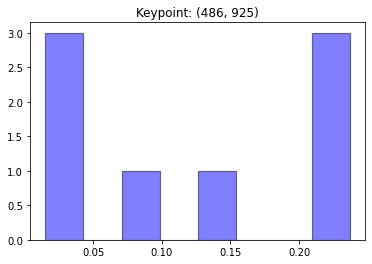

[0.2368979  0.13803774 0.02275491 0.01528383 0.02459192 0.09154828
 0.23398752 0.2368979 ]


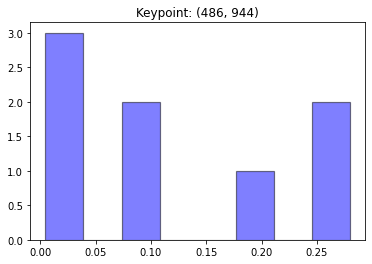

[0.27977686 0.20696014 0.08761175 0.00588862 0.00464964 0.03413308
 0.10120305 0.27977686]


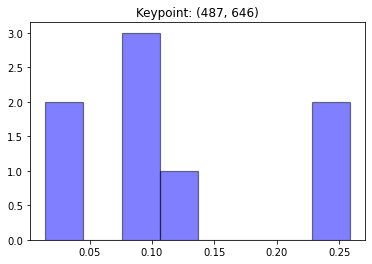

[0.10600856 0.25824019 0.25824019 0.08747488 0.13542872 0.01472088
 0.03545586 0.10443073]


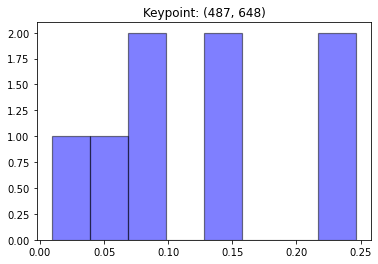

[0.08059575 0.2465583  0.2465583  0.07574307 0.13119489 0.00916944
 0.14804171 0.06213855]


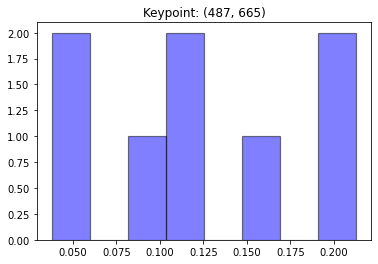

[0.05453379 0.08925513 0.12040742 0.21282717 0.11368463 0.21282717
 0.15858838 0.03787631]


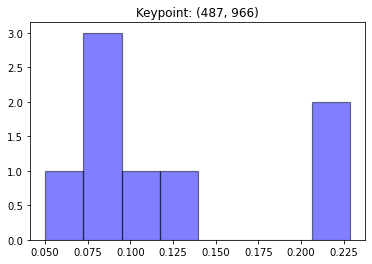

[0.22861897 0.05029632 0.10197965 0.09263822 0.07511295 0.13504548
 0.08768945 0.22861897]


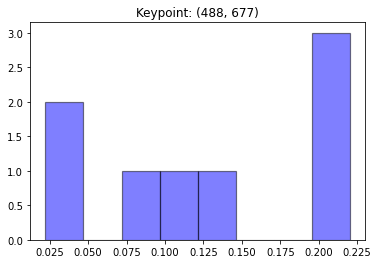

[0.08155574 0.02216508 0.03139292 0.10667515 0.19832476 0.2201749
 0.21348207 0.12622938]


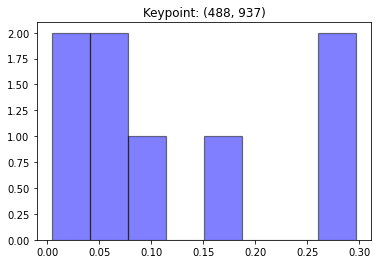

[0.29717347 0.06623995 0.08418919 0.00418013 0.02648942 0.06088421
 0.16367015 0.29717347]


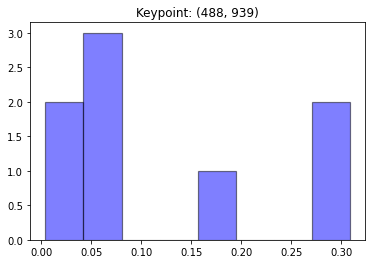

[0.3083345  0.05876683 0.05997141 0.00413338 0.01668095 0.06820883
 0.17556959 0.3083345 ]


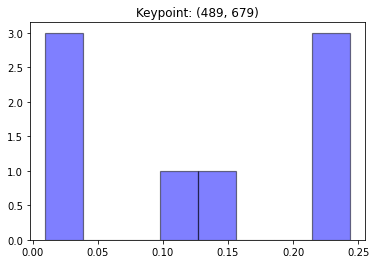

[0.0114963  0.00989018 0.01798896 0.1147431  0.24354111 0.24354111
 0.23203935 0.12675989]


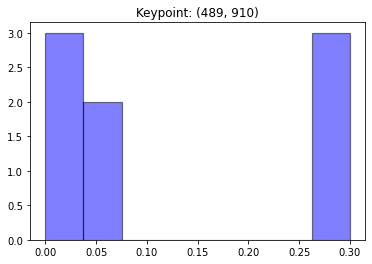

[0.29988527 0.04797907 0.00873966 0.         0.00632223 0.04189212
 0.29529637 0.29988527]


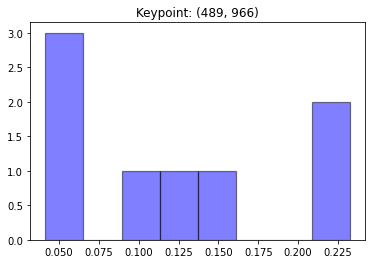

[0.23239566 0.06414136 0.09241249 0.04493192 0.04142577 0.15934755
 0.13294959 0.23239566]


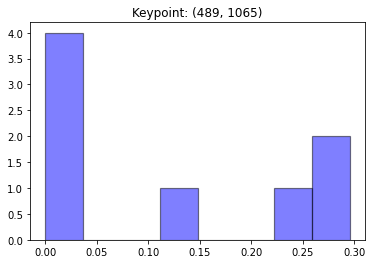

[0.01177997 0.         0.         0.01467238 0.12388865 0.29565192
 0.29565192 0.25835516]


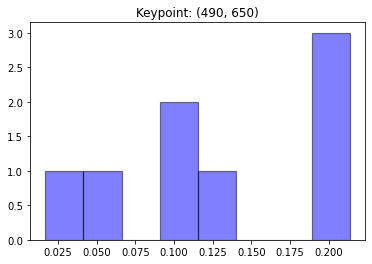

[0.13619574 0.21358406 0.19006917 0.05522863 0.09465439 0.01678302
 0.20118529 0.0922997 ]


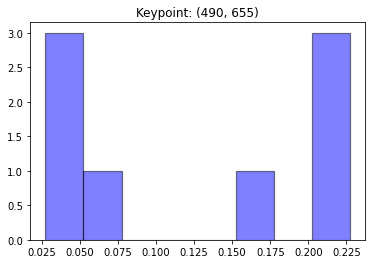

[0.22718628 0.22718628 0.05792605 0.04786031 0.03265138 0.02738917
 0.22718628 0.15261424]


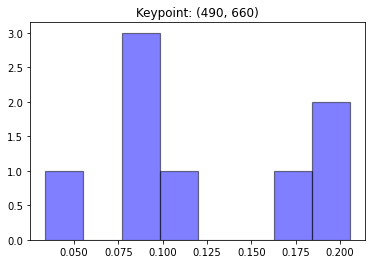

[0.17601344 0.20114528 0.08574816 0.09618494 0.08448357 0.20555156
 0.11702543 0.03384762]


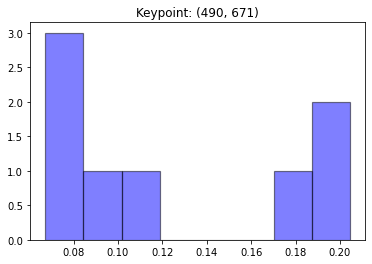

[0.17580284 0.06725071 0.08899949 0.10652002 0.08224462 0.07790978
 0.1968025  0.20447005]


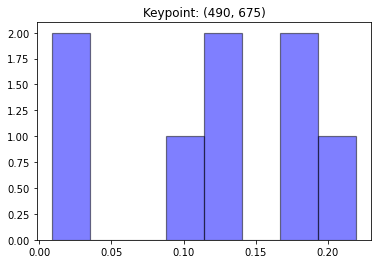

[0.13302335 0.00876001 0.03411116 0.10985171 0.12542253 0.21953603
 0.17824622 0.191049  ]


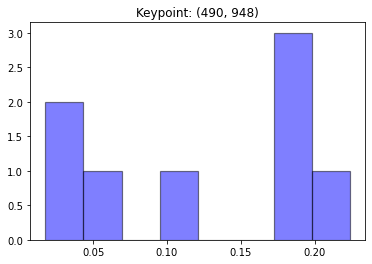

[0.22375533 0.18459447 0.19666951 0.11744157 0.02260095 0.01773918
 0.04558169 0.19161729]


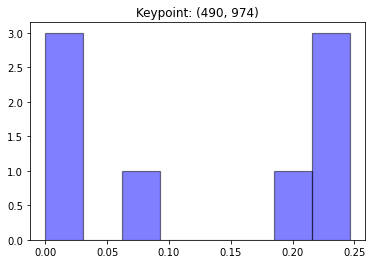

[0.24625794 0.06841784 0.         0.00257577 0.00688433 0.23992877
 0.23311923 0.20281611]


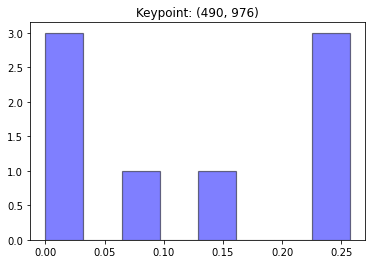

[0.25717324 0.08811022 0.         0.00281186 0.00751533 0.25200959
 0.23663745 0.15574231]


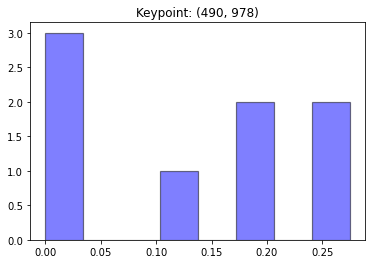

[0.27470652 0.106766   0.         0.         0.00879189 0.18294658
 0.24253647 0.18425253]


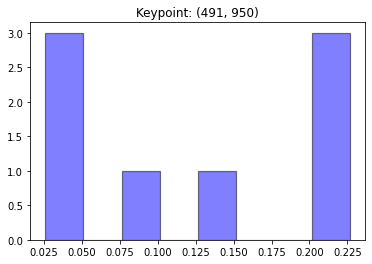

[0.22659441 0.22659441 0.22293306 0.1310416  0.02593463 0.04164011
 0.02834995 0.09691183]


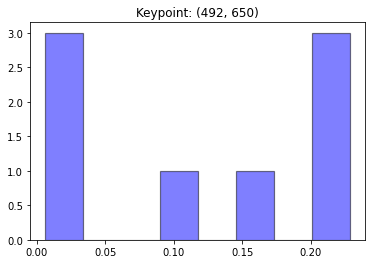

[0.1693003  0.22832267 0.22832267 0.01381728 0.00626912 0.01694786
 0.22832267 0.10869742]


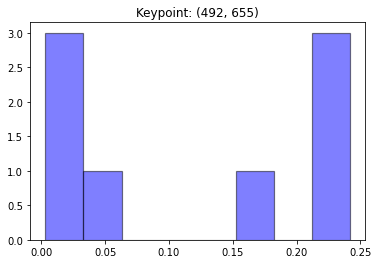

[0.24163304 0.24163304 0.05937448 0.00327882 0.00708541 0.02657058
 0.24163304 0.1787916 ]


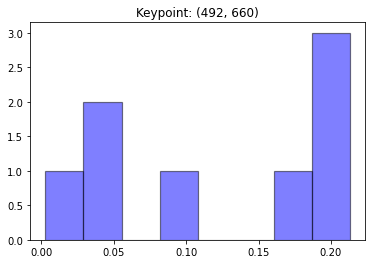

[0.21300109 0.21300109 0.0476895  0.00276812 0.09303789 0.21300109
 0.16486913 0.05263208]


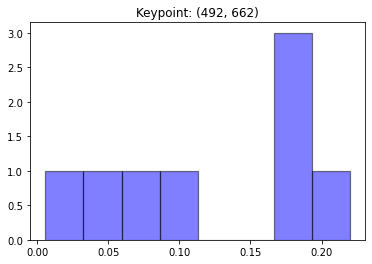

[0.18219984 0.18004153 0.0469151  0.00581401 0.10643203 0.21982017
 0.19029883 0.06847849]


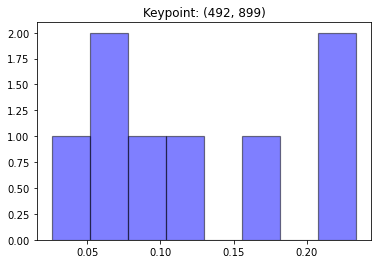

[0.12722731 0.06587824 0.05890724 0.02589039 0.08947616 0.16524712
 0.23368677 0.23368677]


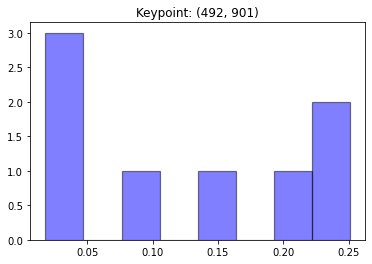

[0.14174008 0.02364441 0.01800373 0.02684569 0.09072035 0.19759443
 0.25072566 0.25072566]


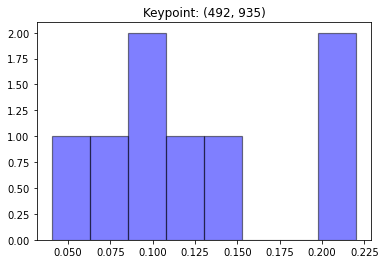

[0.21557474 0.13262257 0.1300736  0.07903216 0.08983048 0.04036134
 0.09233894 0.22016617]


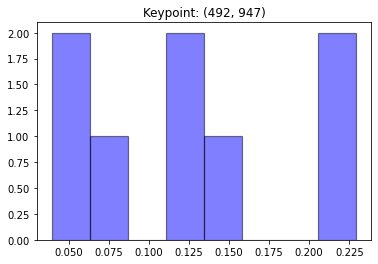

[0.22926442 0.14163059 0.21741756 0.1276151  0.03950341 0.06355256
 0.05295832 0.12805805]


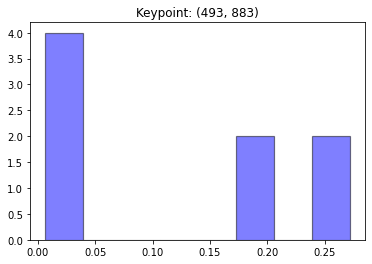

[0.19742783 0.01910099 0.01362151 0.00659528 0.03938559 0.2717216
 0.18042559 0.2717216 ]


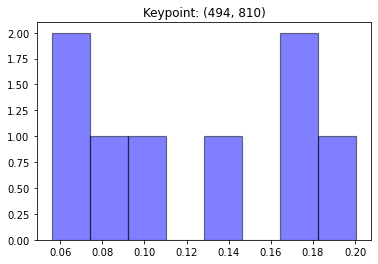

[0.20047511 0.17440031 0.16522581 0.10653615 0.08968617 0.05603076
 0.13713361 0.07051206]


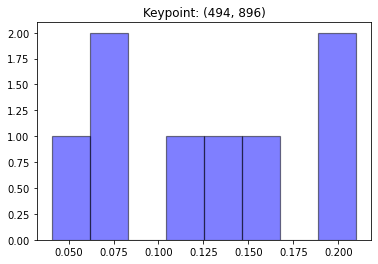

[0.20993281 0.12740596 0.06802956 0.04065625 0.07450887 0.15560986
 0.11392387 0.20993281]


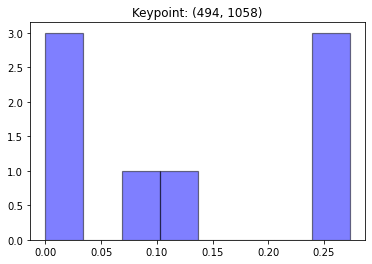

[0.         0.         0.         0.07865411 0.27313032 0.24803666
 0.27313032 0.1270486 ]


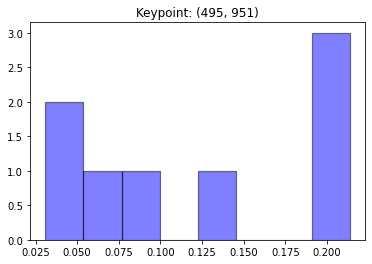

[0.06581991 0.2136932  0.2136932  0.19157638 0.14307383 0.09487345
 0.04636692 0.03090311]


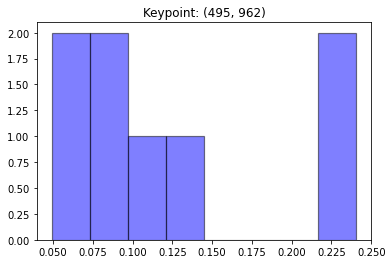

[0.24050891 0.24050891 0.06961267 0.04925276 0.08712743 0.11002061
 0.12511049 0.07785822]


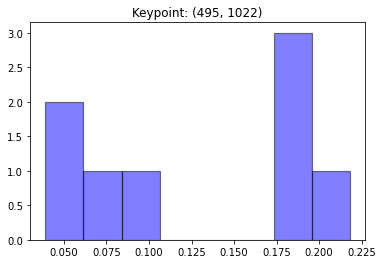

[0.1839315  0.21803355 0.17820157 0.06368778 0.04526477 0.085514
 0.18627037 0.03909647]


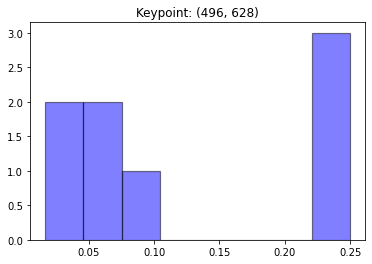

[0.09641222 0.24972822 0.24972822 0.24972822 0.02800148 0.01683475
 0.06295083 0.04661606]


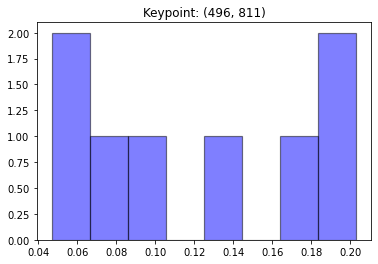

[0.20311423 0.20311423 0.17517912 0.09730664 0.08484099 0.04694164
 0.12605625 0.06344691]


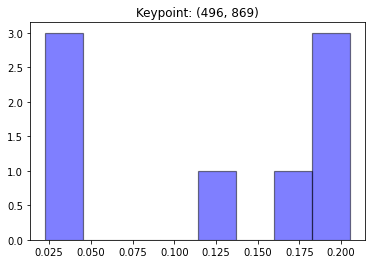

[0.20517217 0.17620091 0.11488125 0.0441874  0.02280119 0.03685565
 0.20517217 0.19472926]


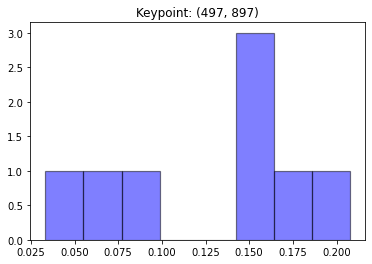

[0.14892333 0.15406947 0.08216116 0.03328973 0.06660455 0.1649662
 0.20759863 0.14238692]


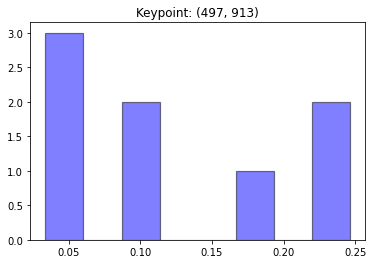

[0.24629899 0.09672919 0.05727317 0.03569936 0.0336696  0.09610703
 0.18792366 0.24629899]


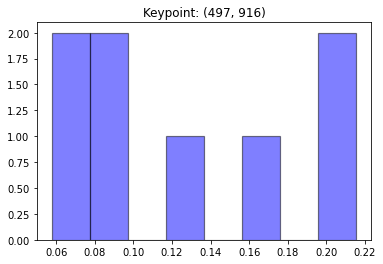

[0.15683361 0.08534567 0.06928836 0.05770322 0.08059131 0.11923608
 0.21550088 0.21550088]


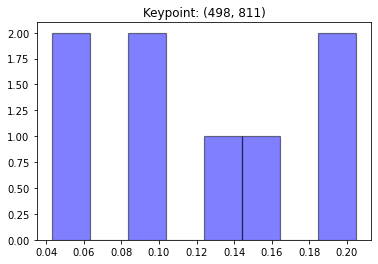

[0.16411212 0.20495982 0.20400608 0.12520303 0.1017243  0.05798715
 0.09906061 0.04294689]


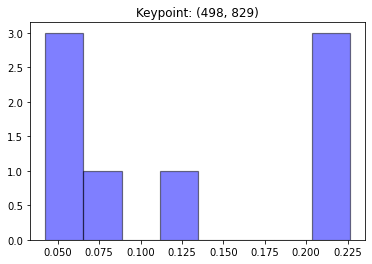

[0.2263633  0.2263633  0.07300766 0.04274666 0.04722552 0.04248047
 0.1154498  0.2263633 ]


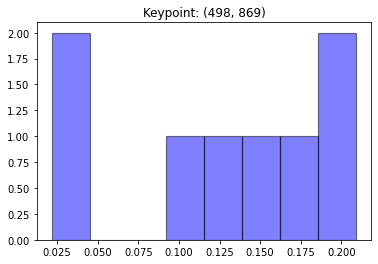

[0.19552667 0.15346797 0.10025244 0.03759651 0.0217616  0.11813954
 0.20903781 0.16421746]


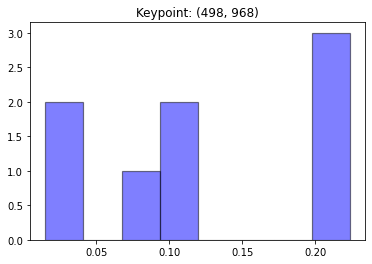

[0.22375996 0.11221923 0.07446866 0.01498886 0.03181886 0.22375996
 0.21116356 0.10782092]


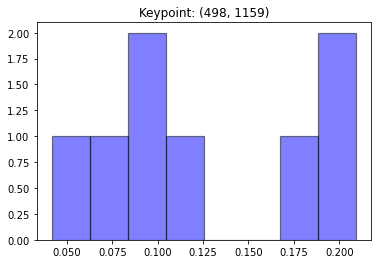

[0.04167041 0.08015493 0.1767904  0.19274745 0.08678298 0.0893826
 0.20930742 0.12316382]


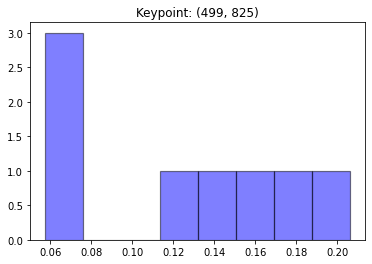

[0.18098304 0.14469647 0.05769415 0.07537899 0.06707791 0.11440146
 0.15360761 0.20616037]


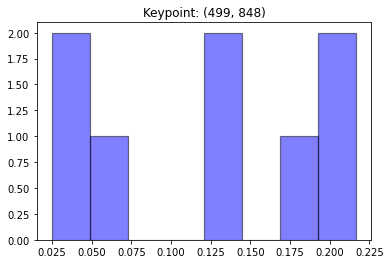

[0.19214094 0.14368161 0.05061596 0.03234382 0.02492277 0.12280562
 0.21674463 0.21674463]


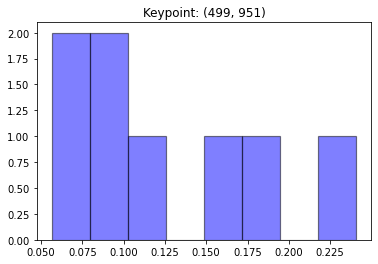

[0.10020045 0.17504402 0.05656133 0.09949219 0.15167337 0.1044403
 0.0718352  0.24075313]


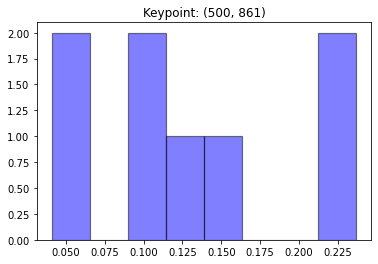

[0.11917071 0.04089939 0.04136955 0.1539955  0.09530322 0.10011716
 0.23674591 0.21239856]


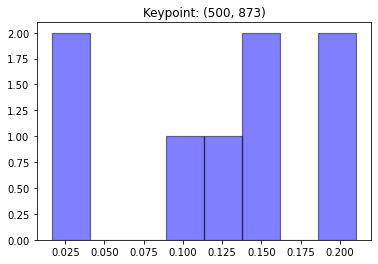

[0.21035183 0.15227395 0.0895711  0.03423928 0.01642316 0.15710829
 0.21035183 0.12968056]


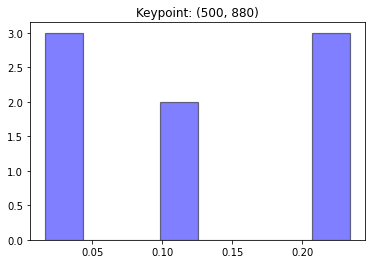

[0.23406466 0.23406466 0.01660614 0.01833178 0.03619265 0.23406466
 0.11041432 0.11626113]


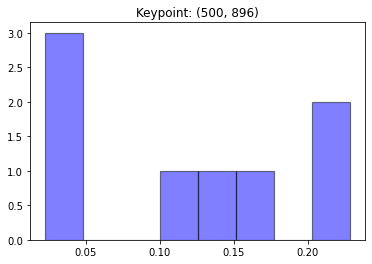

[0.17331609 0.14660937 0.04450411 0.03908161 0.02275566 0.11667081
 0.22853117 0.22853117]


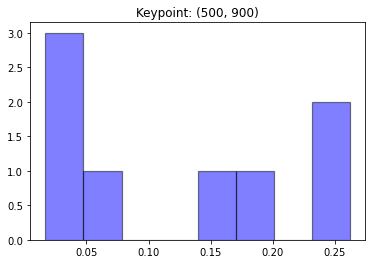

[0.19577778 0.14012741 0.026409   0.01692398 0.0204492  0.07604659
 0.26213302 0.26213302]


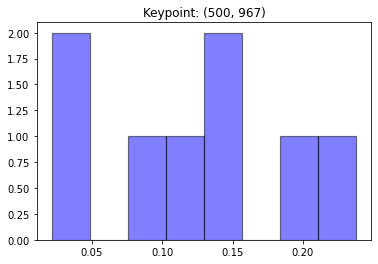

[0.23786458 0.14562087 0.09172037 0.02146999 0.04826168 0.1487301
 0.1953253  0.11100711]


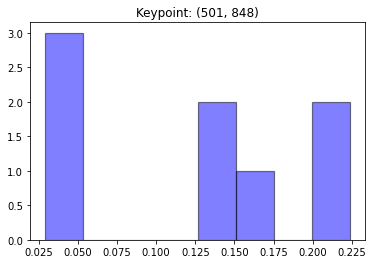

[0.17097576 0.14205246 0.05116576 0.03392899 0.02918441 0.14856523
 0.22374226 0.20038513]


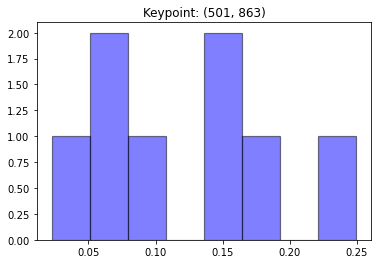

[0.07795054 0.02278575 0.07156648 0.14279124 0.08952051 0.15582097
 0.24939044 0.19017408]


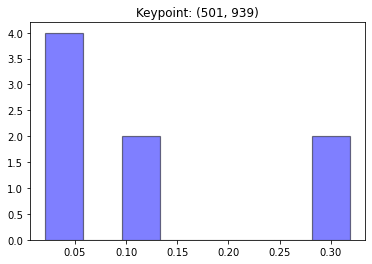

[0.31866227 0.10997223 0.03752586 0.02103964 0.0378009  0.04851181
 0.10782503 0.31866227]


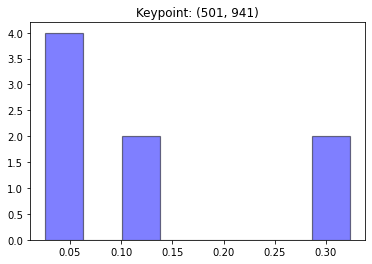

[0.32319709 0.10343007 0.03166583 0.0259587  0.0319114  0.05249355
 0.10814625 0.32319709]


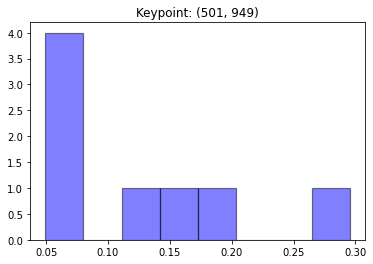

[0.20206408 0.05784746 0.04936861 0.06289446 0.15814196 0.11264925
 0.06163147 0.2954027 ]


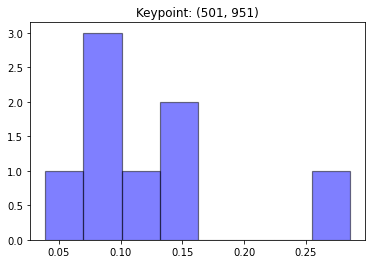

[0.13750753 0.08268488 0.03920196 0.07651525 0.15524807 0.12495442
 0.098364   0.28552388]


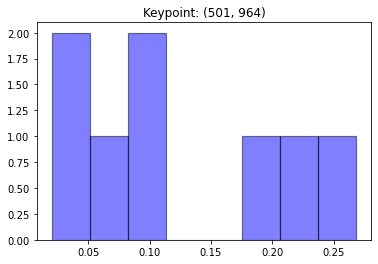

[0.26836735 0.20662535 0.09016812 0.02035282 0.03896289 0.090353
 0.07941902 0.20575146]


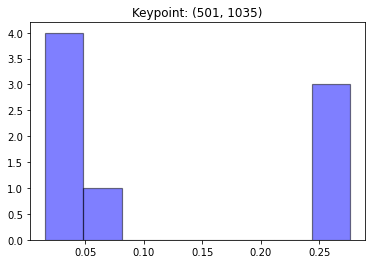

[0.05715855 0.27584675 0.27584675 0.27584675 0.04713306 0.01670552
 0.01611353 0.03534911]


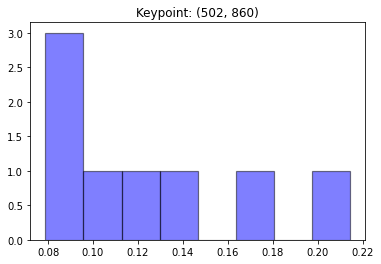

[0.11564825 0.11127987 0.08788418 0.13406991 0.07880987 0.08974453
 0.21428487 0.16827851]


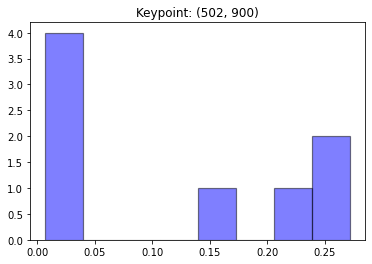

[0.20615902 0.16183793 0.03233846 0.02245367 0.00696032 0.02689596
 0.27167732 0.27167732]


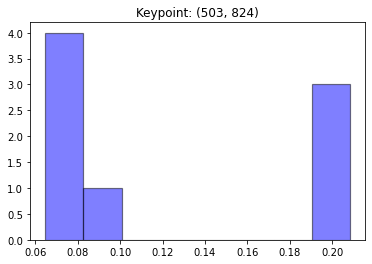

[0.20834331 0.20573288 0.07817848 0.07283575 0.06470303 0.09933026
 0.07962727 0.19124903]


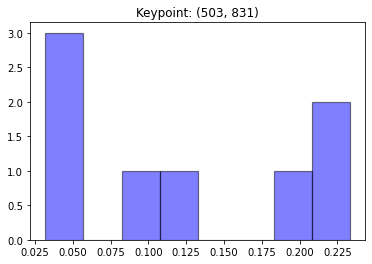

[0.20626107 0.2331735  0.08471231 0.03192461 0.05706232 0.03882859
 0.11486411 0.2331735 ]


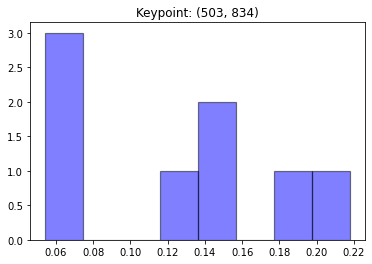

[0.13943582 0.21785101 0.13969044 0.05643221 0.0543046  0.06774889
 0.12728377 0.19725328]


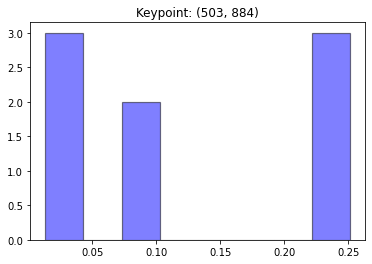

[0.25106823 0.25106823 0.01343664 0.01979641 0.03908428 0.07989776
 0.09458022 0.25106823]


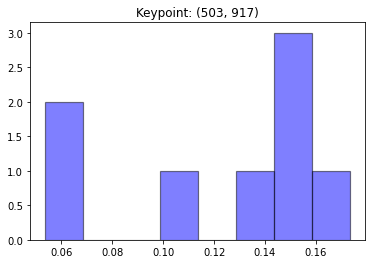

[0.0657558  0.0537567  0.15793567 0.17328253 0.14397115 0.14317638
 0.14937251 0.11274926]


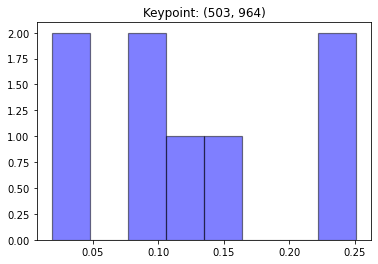

[0.25110775 0.14239701 0.08501741 0.01854392 0.03302799 0.10423781
 0.11456036 0.25110775]


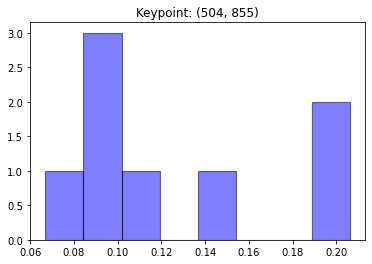

[0.06692001 0.20619688 0.14116812 0.10703818 0.09093784 0.09482755
 0.19203746 0.10087395]


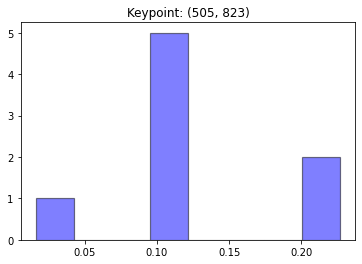

[0.22682662 0.22682662 0.10566498 0.09649288 0.11386716 0.10160142
 0.01602981 0.11269051]


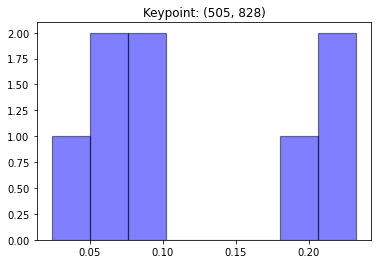

[0.23265509 0.23265509 0.06654047 0.02377276 0.06341062 0.08999307
 0.09794352 0.19302937]


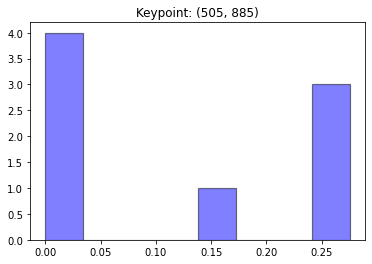

[0.27547507 0.25560777 0.01172954 0.0123672  0.         0.
 0.16934535 0.27547507]


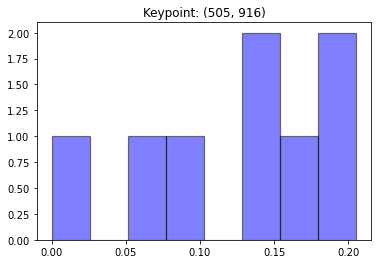

[0.         0.05448129 0.14915898 0.17194592 0.14133737 0.18075838
 0.20532833 0.09698973]


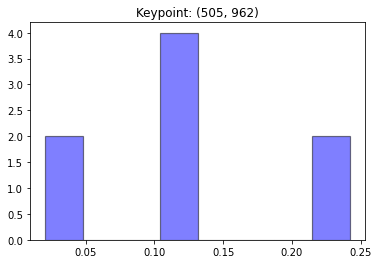

[0.24202369 0.10524795 0.10538397 0.02069195 0.04086066 0.12015858
 0.12360951 0.24202369]


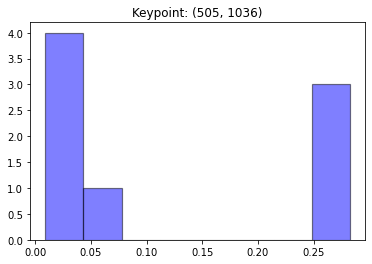

[0.27749488 0.28240326 0.28240326 0.06612255 0.03614638 0.01851401
 0.00906473 0.02785092]


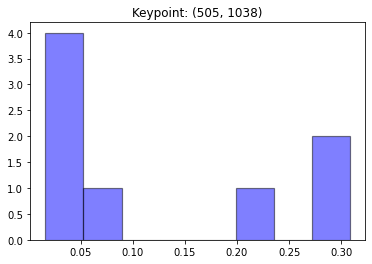

[0.22999678 0.30827844 0.28695627 0.07329279 0.03797049 0.02402361
 0.0160064  0.02347523]


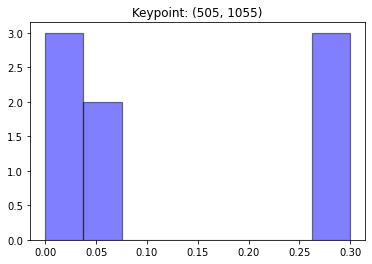

[0.         0.01094596 0.         0.04715116 0.29950536 0.29645137
 0.29950536 0.04644078]


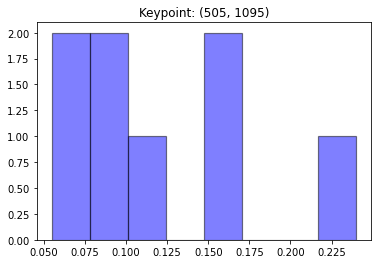

[0.12002701 0.17008023 0.10041169 0.23999826 0.16943479 0.05473858
 0.05533456 0.08997487]


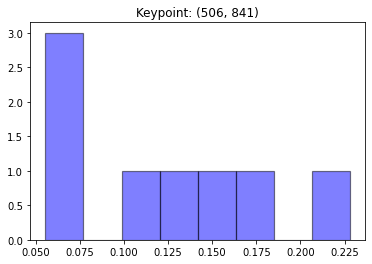

[0.13146463 0.22790788 0.05558437 0.06365335 0.07348659 0.15901682
 0.12002684 0.16885952]


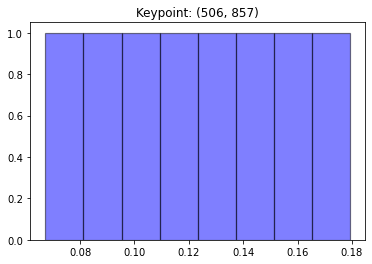

[0.15562406 0.17922357 0.11491105 0.1497197  0.1091406  0.09431401
 0.129832   0.06723501]


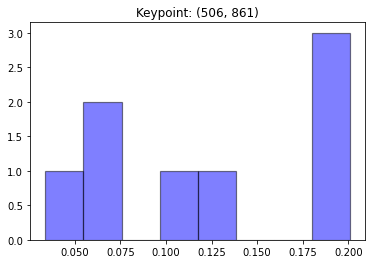

[0.20079241 0.19173317 0.06508805 0.11645228 0.07089946 0.03393694
 0.12697479 0.19412289]


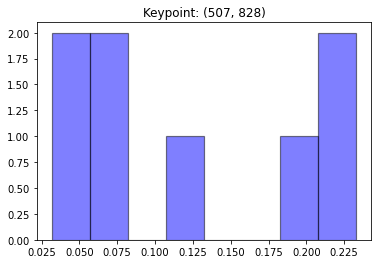

[0.23287346 0.23287346 0.06891971 0.03176869 0.07505743 0.04132424
 0.11376551 0.2034175 ]


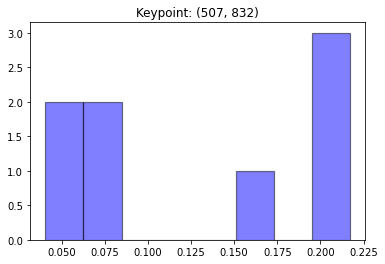

[0.16708342 0.19821353 0.04055919 0.04426575 0.07220252 0.06360299
 0.19708116 0.21699144]


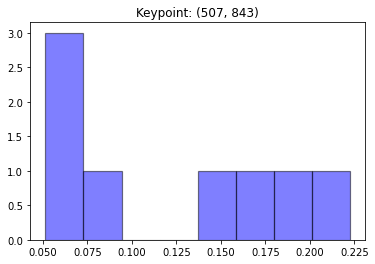

[0.18714075 0.22239753 0.05137845 0.06442133 0.07251898 0.16670271
 0.0786013  0.15683894]


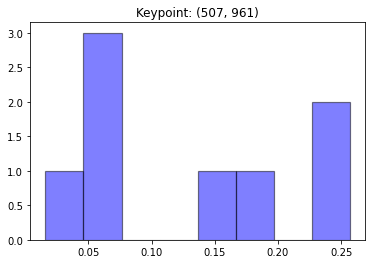

[0.25682546 0.04715316 0.05358042 0.0160912  0.04699911 0.14272297
 0.17980223 0.25682546]


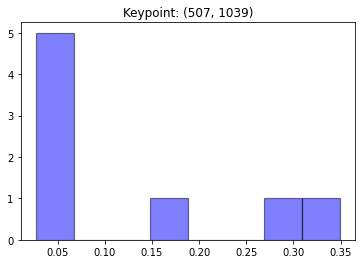

[0.29311581 0.34947409 0.17352984 0.03213504 0.0448812  0.02989857
 0.02683911 0.05012633]


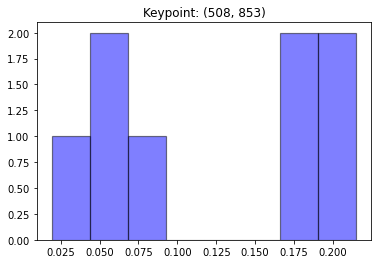

[0.17894309 0.05791527 0.01928593 0.06031504 0.07841895 0.17528929
 0.21491622 0.21491622]


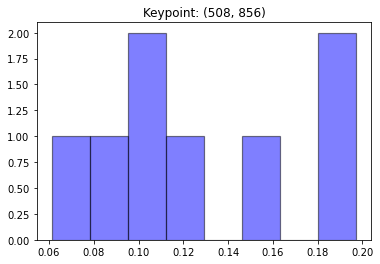

[0.1468022  0.19719797 0.06123834 0.07974167 0.0988172  0.12453873
 0.18414158 0.10752231]


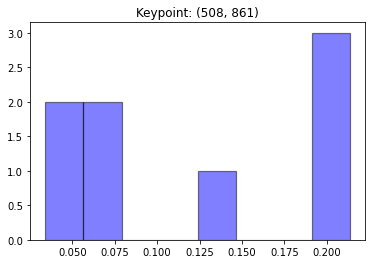

[0.21359188 0.21359188 0.0663957  0.05162714 0.06185246 0.03408193
 0.14526714 0.21359188]


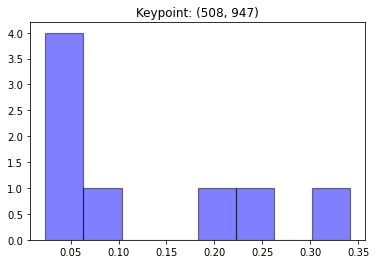

[0.21611461 0.0291659  0.07223808 0.02363554 0.05612747 0.0389078
 0.22245543 0.34135517]


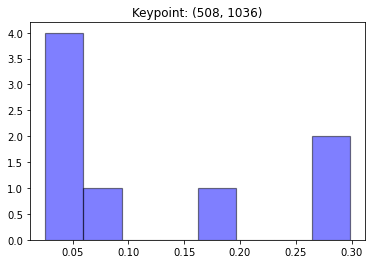

[0.29830958 0.29830958 0.19535014 0.03332939 0.06254971 0.02564914
 0.03010865 0.0563938 ]


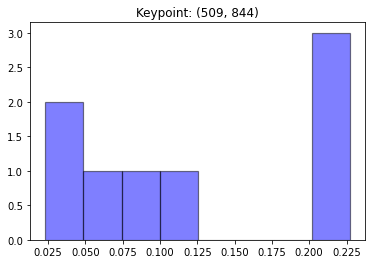

[0.22719343 0.22719343 0.02318894 0.06940872 0.04002471 0.1046107
 0.0944661  0.21391395]


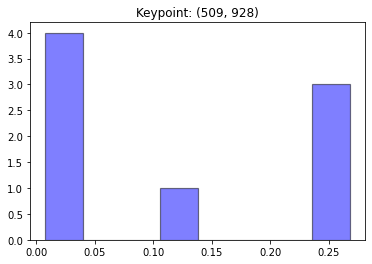

[0.26808212 0.01784703 0.00767072 0.0232543  0.03199036 0.11499122
 0.26808212 0.26808212]


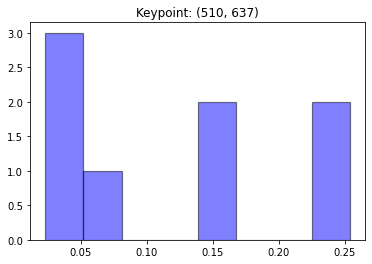

[0.25381941 0.16404734 0.16432577 0.03773167 0.04706749 0.02335634
 0.05583256 0.25381941]


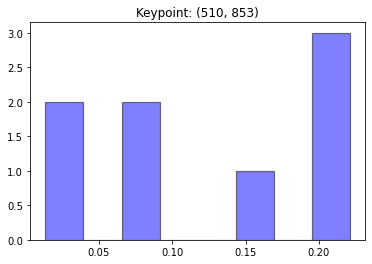

[0.22091593 0.07034065 0.01370734 0.03170431 0.06981651 0.15168341
 0.22091593 0.22091593]


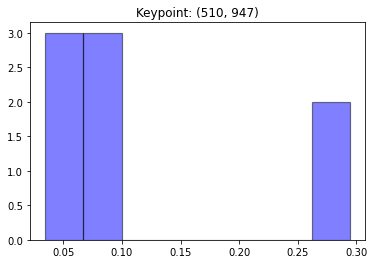

[0.09710479 0.04125296 0.0967081  0.03468488 0.08207657 0.0593537
 0.29440949 0.29440949]


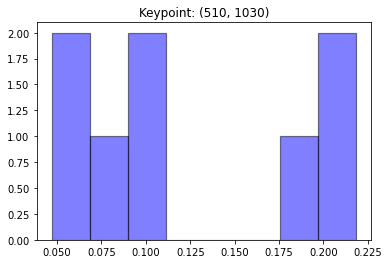

[0.21841835 0.09681096 0.08411161 0.18308978 0.20450069 0.10177725
 0.06428112 0.04701025]


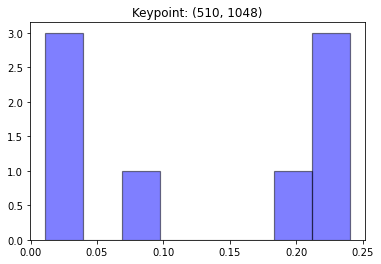

[0.2131234  0.19049438 0.01891979 0.01265835 0.01111795 0.07312822
 0.24027895 0.24027895]


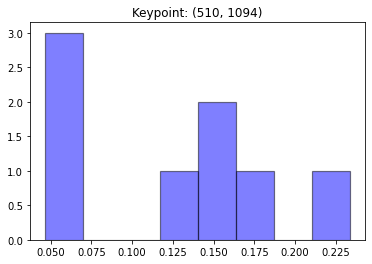

[0.06625128 0.17235896 0.15153121 0.23359169 0.12845665 0.14528674
 0.0467918  0.05573167]


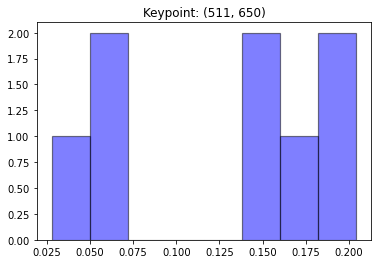

[0.16115489 0.19227447 0.14232699 0.06618291 0.04997449 0.02787777
 0.20417964 0.15602885]


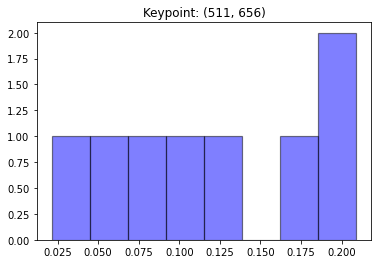

[0.17697019 0.2089387  0.2089387  0.10827029 0.05452238 0.02145999
 0.08271682 0.13818294]


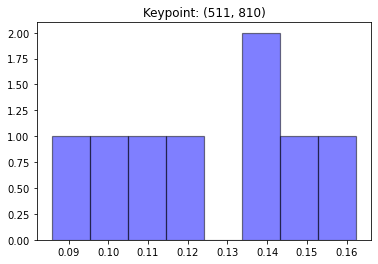

[0.13569994 0.15246703 0.10584433 0.11859512 0.13429535 0.08579078
 0.10492866 0.16237879]


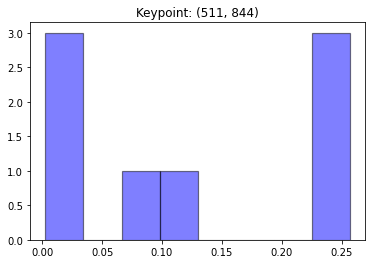

[0.25674763 0.25674763 0.02982833 0.06959266 0.00262387 0.02141482
 0.10629743 0.25674763]


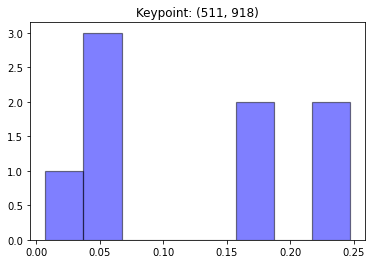

[0.18364043 0.04496008 0.00713493 0.05225857 0.06137733 0.1593476
 0.24434582 0.24693523]


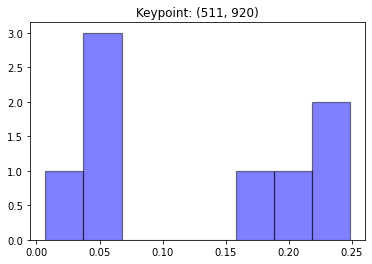

[0.22269517 0.0462188  0.00716116 0.04341588 0.05117427 0.17413054
 0.20699134 0.24821285]


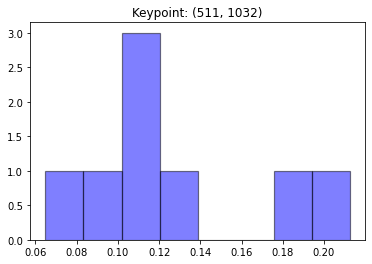

[0.21251125 0.12269557 0.11990396 0.1153505  0.17849731 0.06486247
 0.10209963 0.08407931]


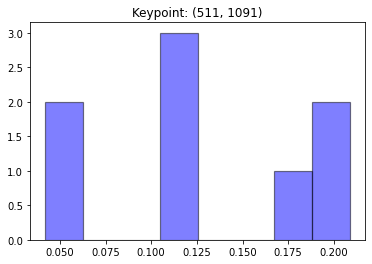

[0.04339951 0.11106708 0.10532303 0.20875269 0.18875824 0.17981297
 0.1208344  0.04205209]


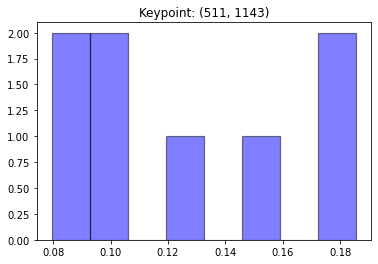

[0.09841688 0.09285346 0.17989602 0.08681486 0.12688425 0.1500484
 0.07953431 0.18555182]


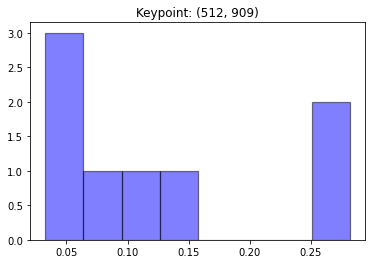

[0.1503093  0.10395449 0.03281561 0.03675863 0.04926278 0.07293575
 0.27215736 0.28180609]


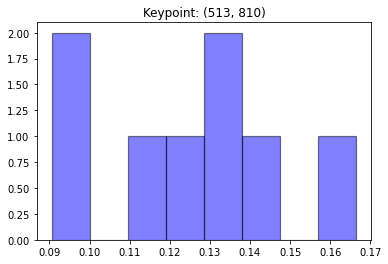

[0.11929614 0.16646496 0.1139425  0.12938347 0.14646856 0.09059588
 0.09625328 0.13759521]


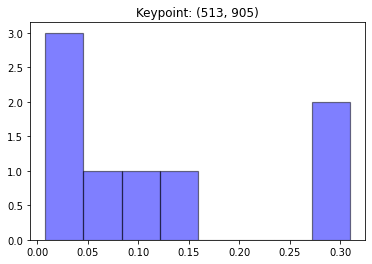

[0.1493167  0.0948895  0.0381165  0.04323646 0.0079274  0.04730278
 0.30960533 0.30960533]


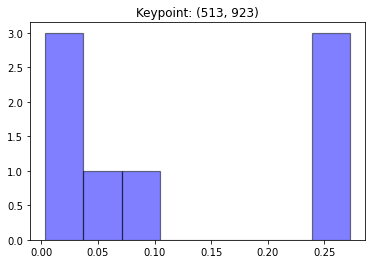

[0.27242116 0.08078396 0.00351651 0.02173196 0.03149686 0.04520723
 0.27242116 0.27242116]


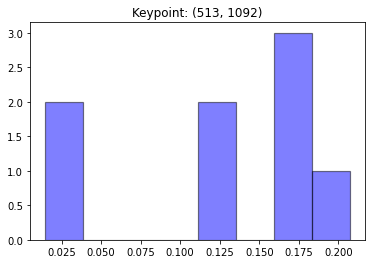

[0.01476084 0.11124712 0.16775944 0.2072028  0.16320295 0.18074308
 0.12708935 0.02799443]


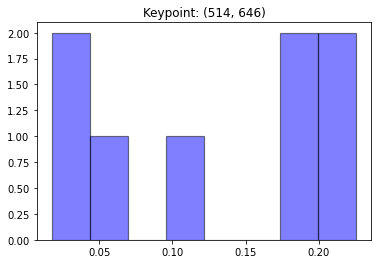

[0.22553733 0.17421786 0.11120099 0.05328106 0.01765637 0.01776752
 0.22553733 0.17480153]


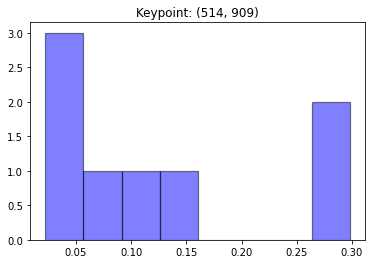

[0.15422295 0.09541622 0.0224743  0.03295063 0.03762615 0.0614243
 0.29794272 0.29794272]


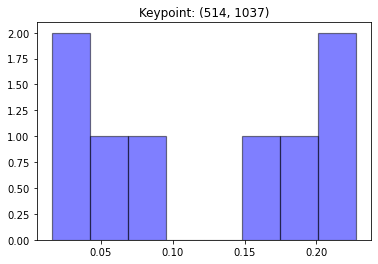

[0.15702206 0.20010913 0.08020329 0.01578799 0.04024922 0.05111078
 0.22775876 0.22775876]


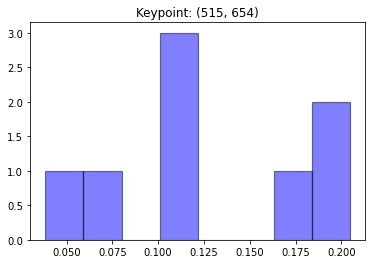

[0.10618952 0.16398001 0.20454562 0.12092329 0.06773341 0.0384728
 0.19524339 0.10291195]


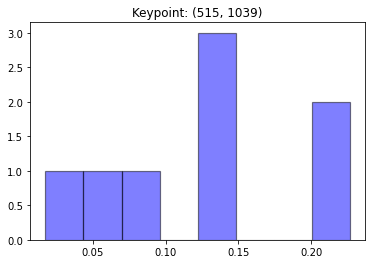

[0.12526521 0.14453934 0.07839537 0.01744515 0.04726518 0.13394723
 0.22657126 0.22657126]


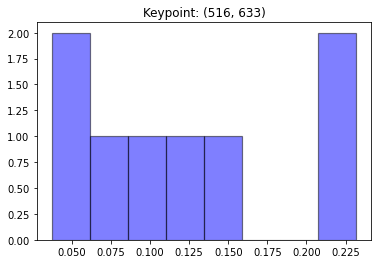

[0.14126523 0.1071167  0.23174122 0.11351344 0.07686611 0.03720745
 0.06054864 0.23174122]


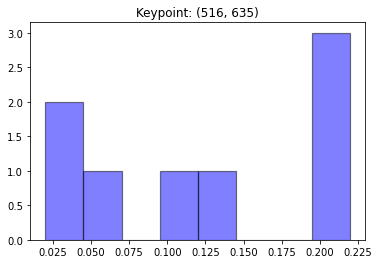

[0.19476106 0.14080807 0.21966315 0.11375542 0.0648068  0.0264377
 0.02010465 0.21966315]


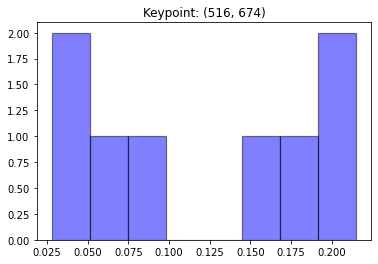

[0.21487679 0.21487679 0.09740822 0.02801418 0.18306887 0.1463944
 0.04542289 0.06993785]


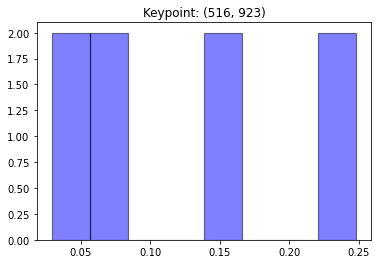

[0.24823583 0.15403703 0.0614806  0.06353616 0.02912246 0.03876403
 0.15658805 0.24823583]


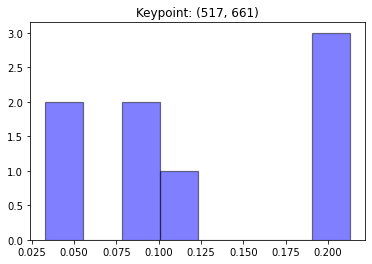

[0.03312839 0.11498141 0.21282629 0.19858139 0.097133   0.08892223
 0.20252715 0.05190015]


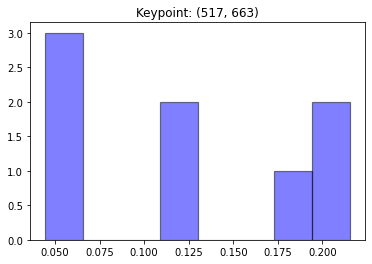

[0.05619468 0.04450459 0.21542103 0.17739683 0.11042185 0.11978772
 0.21542103 0.06085226]


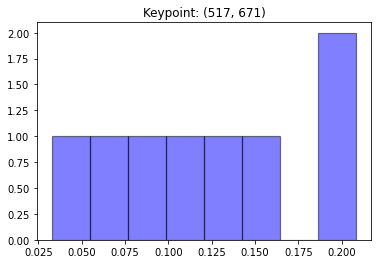

[0.20834877 0.20834877 0.09766467 0.03275055 0.14935568 0.14150417
 0.09881894 0.06320846]


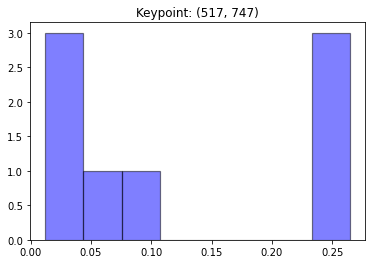

[0.07131355 0.09993079 0.24288261 0.26457442 0.26457442 0.02290665
 0.0216532  0.01216437]


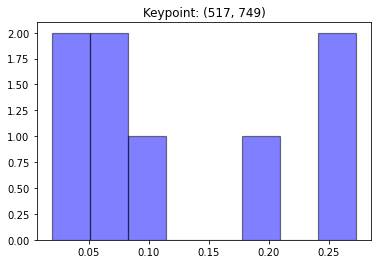

[0.07296303 0.08926052 0.19516373 0.2730651  0.2730651  0.05606129
 0.01915382 0.0212674 ]


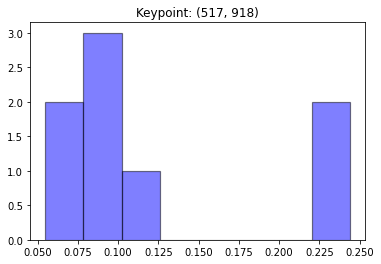

[0.24390825 0.11438207 0.08500279 0.09733134 0.06727174 0.05473169
 0.09346386 0.24390825]


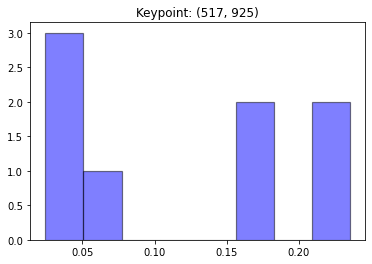

[0.235291   0.17623471 0.0444002  0.06818709 0.024377   0.04326829
 0.17295071 0.235291  ]


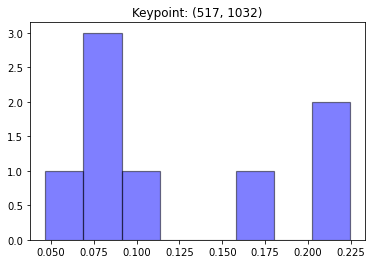

[0.09655616 0.0840298  0.07272379 0.04687242 0.16714989 0.08405219
 0.22430788 0.22430788]


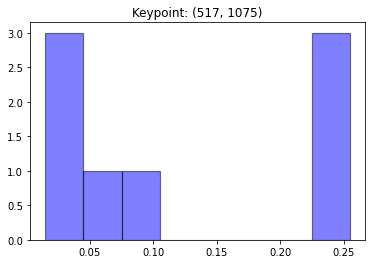

[0.10165507 0.25460717 0.25460717 0.25460717 0.05980907 0.03524688
 0.0153068  0.02416065]


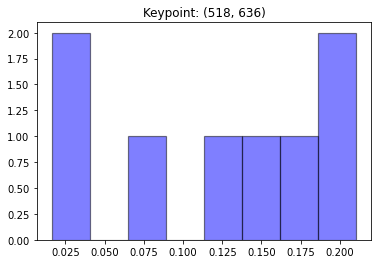

[0.20986629 0.17619087 0.21031124 0.16039273 0.12397882 0.01806663
 0.01638765 0.08480578]


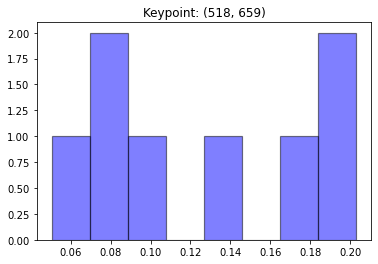

[0.07071221 0.13235863 0.20295075 0.19837489 0.09397962 0.08376771
 0.16729122 0.05056497]


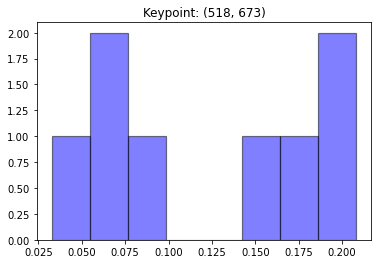

[0.20802124 0.20802124 0.08400525 0.03273928 0.18486826 0.15739316
 0.06648635 0.05846523]


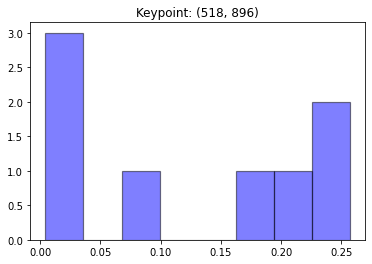

[0.22275736 0.02381443 0.01202888 0.00443099 0.06934375 0.16370162
 0.25702852 0.24689445]


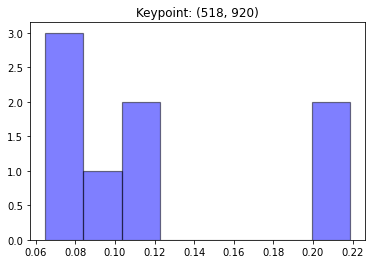

[0.2185567  0.12120925 0.11219594 0.08392319 0.06487645 0.07968661
 0.10099515 0.2185567 ]


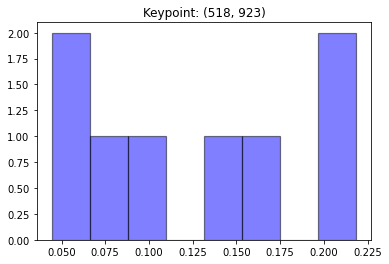

[0.21847707 0.16101496 0.0906583  0.06732091 0.04766142 0.04444488
 0.1519454  0.21847707]


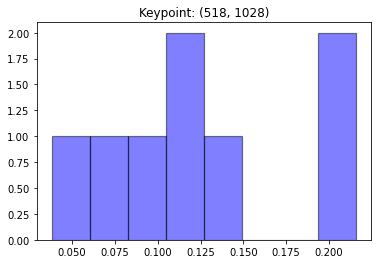

[0.12073667 0.1091108  0.10015432 0.07551743 0.19411448 0.14641146
 0.03813459 0.21582025]


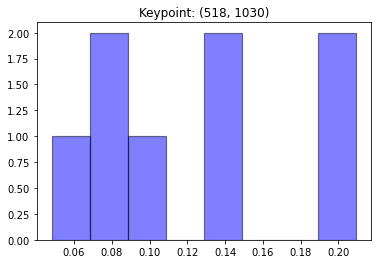

[0.10182803 0.08698617 0.07896872 0.04823718 0.1330462  0.13465383
 0.20688987 0.20939001]


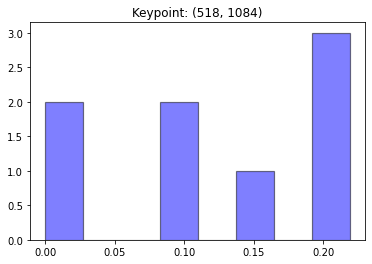

[0.09763121 0.21901326 0.         0.         0.21901326 0.20753219
 0.15677742 0.10003265]


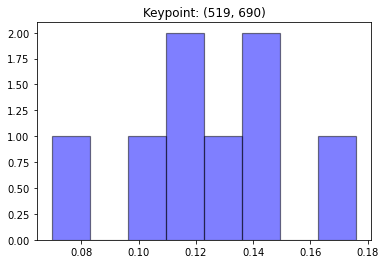

[0.06962409 0.14629049 0.11598039 0.17595314 0.1484236  0.11459067
 0.12537794 0.10375969]


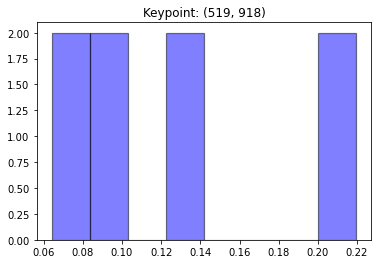

[0.21955551 0.08714876 0.12360387 0.13377864 0.08375009 0.06845949
 0.06414813 0.21955551]


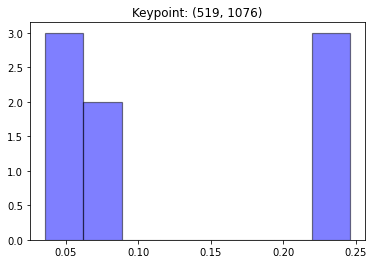

[0.08606141 0.24576892 0.2393093  0.24576892 0.06554938 0.03581905
 0.04360137 0.03812166]


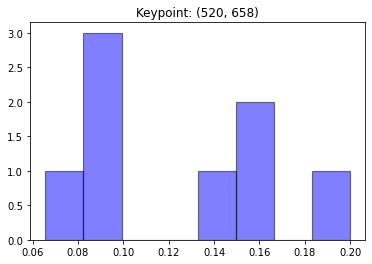

[0.08262876 0.13610345 0.16486807 0.1588763  0.09502435 0.0970209
 0.19979532 0.06568284]


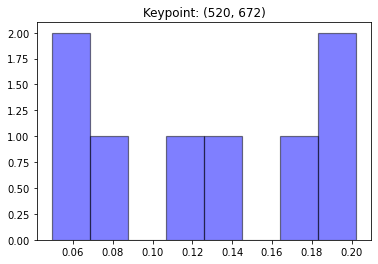

[0.20232572 0.13433914 0.10765504 0.0584073  0.18850034 0.18270203
 0.0766815  0.04938893]


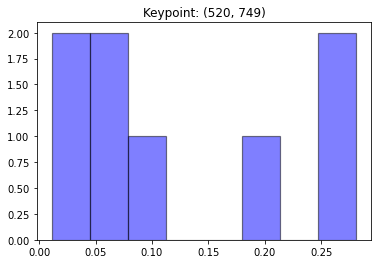

[0.07159886 0.08675353 0.19777887 0.28110988 0.28110988 0.05433183
 0.01109633 0.01622084]


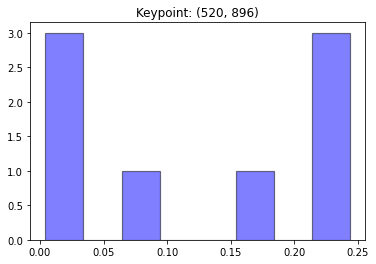

[0.24357271 0.02681902 0.01185448 0.00426596 0.06724355 0.168236
 0.24357271 0.23443557]


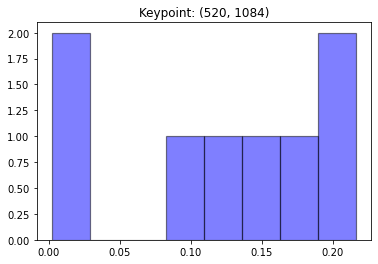

[0.11523194 0.21653519 0.00204791 0.00433831 0.21653519 0.18751908
 0.15206807 0.1057243 ]


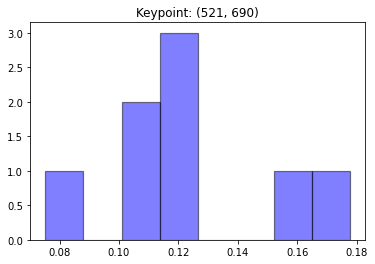

[0.07526161 0.12477634 0.10877106 0.1776153  0.16247105 0.11487688
 0.11200053 0.12422723]


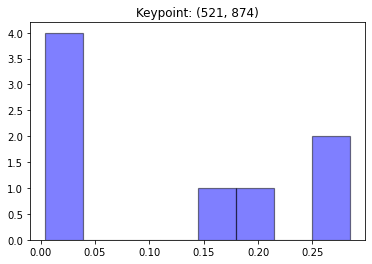

[0.28434672 0.16710065 0.03285078 0.0070284  0.00433261 0.03545285
 0.18454128 0.28434672]


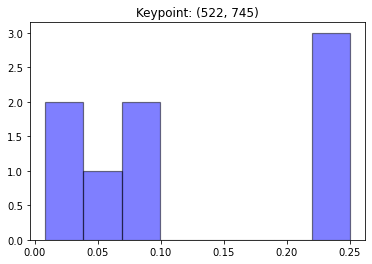

[0.05278984 0.0886494  0.25005337 0.25005337 0.25005337 0.07473958
 0.02525519 0.0084059 ]


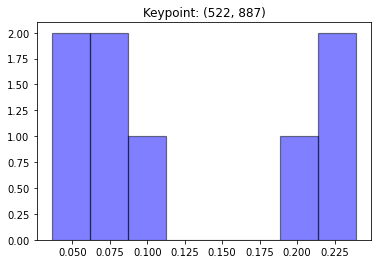

[0.20376512 0.03776733 0.08588462 0.10266725 0.06536388 0.03618283
 0.22893685 0.23943211]


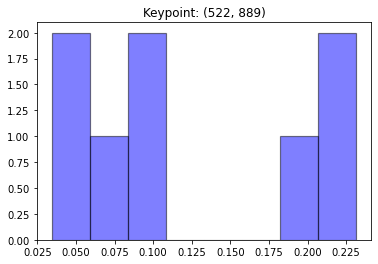

[0.23149173 0.054645   0.08690551 0.09754774 0.06210451 0.03437857
 0.20143521 0.23149173]


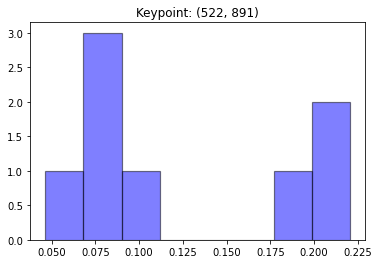

[0.22040062 0.07457977 0.08260445 0.09271998 0.06884951 0.04642706
 0.19401799 0.22040062]


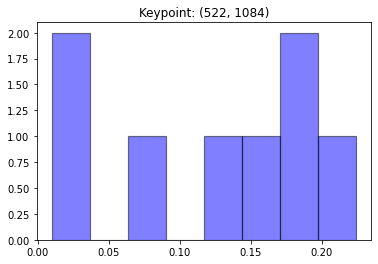

[0.12094745 0.22403646 0.01003535 0.02363108 0.18091995 0.19704925
 0.15480025 0.08858021]


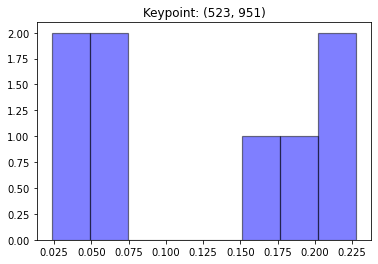

[0.06046179 0.04462163 0.02335336 0.07007996 0.22766841 0.22766841
 0.15543261 0.19071381]


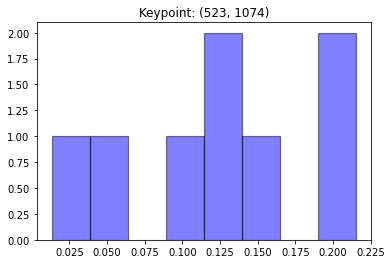

[0.01340425 0.11125236 0.21528419 0.21528419 0.14355792 0.12452364
 0.13727495 0.0394185 ]


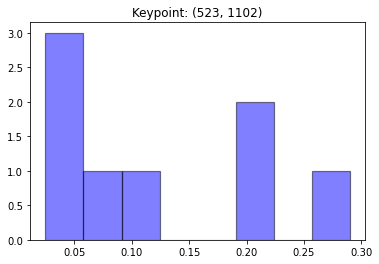

[0.02494515 0.05643389 0.09837565 0.2898863  0.19894802 0.19729803
 0.08078749 0.05332546]


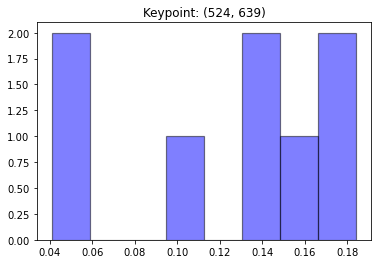

[0.04103699 0.1841752  0.14300704 0.05885409 0.15040143 0.14685143
 0.10397251 0.17170131]


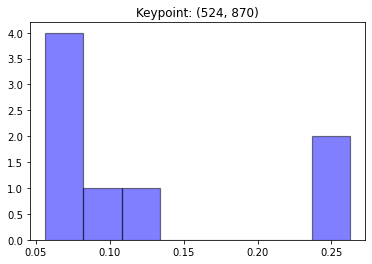

[0.12963309 0.08146567 0.05644731 0.07461593 0.06835411 0.08500334
 0.24205009 0.26243046]


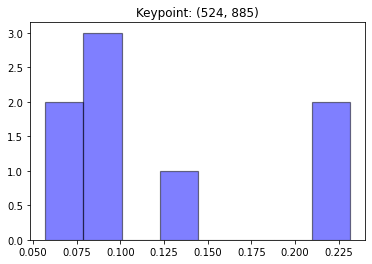

[0.23122277 0.09514415 0.07464055 0.08783334 0.05713547 0.08275533
 0.14004564 0.23122277]


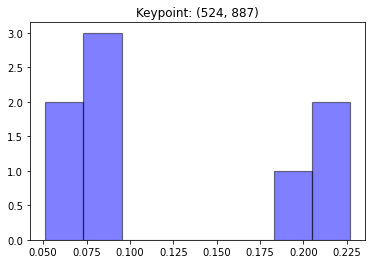

[0.22668204 0.05131792 0.07521133 0.0899083  0.0572408  0.08634679
 0.1866108  0.22668204]


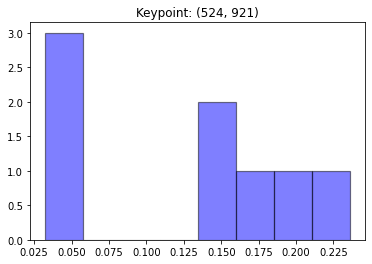

[0.23589178 0.13857048 0.180722   0.13835174 0.0416428  0.03247184
 0.03378994 0.19855941]


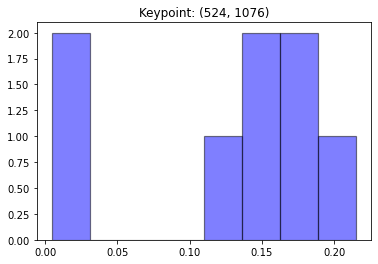

[0.00452772 0.16969529 0.21516397 0.18621577 0.12785098 0.13981598
 0.13874103 0.01798927]


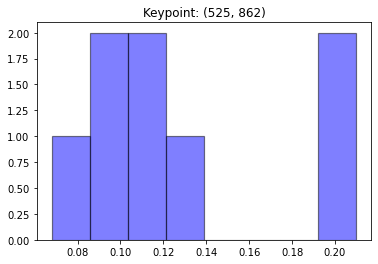

[0.19997331 0.11775256 0.0680056  0.08759926 0.08877319 0.12330504
 0.10472653 0.20986451]


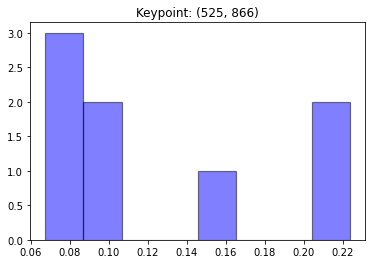

[0.06739753 0.08306818 0.07411899 0.09365904 0.09075219 0.14649367
 0.22087558 0.22363482]


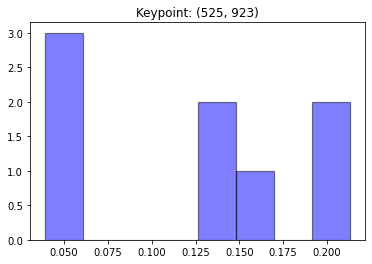

[0.21295698 0.21295698 0.14341354 0.14008174 0.04157397 0.03936257
 0.04142343 0.16823081]


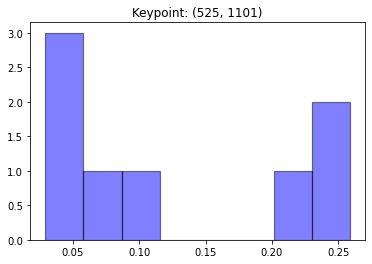

[0.02922872 0.05266497 0.08670032 0.2586442  0.21374046 0.23238166
 0.08054707 0.04609259]


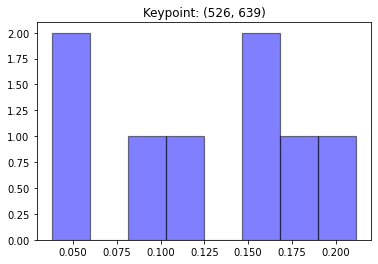

[0.04649719 0.1548679  0.08565663 0.03788649 0.16553277 0.21178763
 0.11372204 0.18404935]


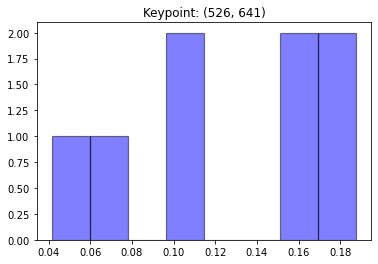

[0.0972061  0.1691901  0.06668658 0.04144841 0.17360314 0.18770612
 0.09658416 0.16757537]


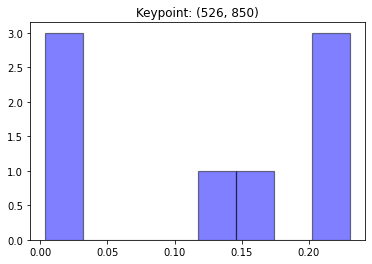

[0.17115507 0.0076296  0.00379043 0.00920972 0.12175605 0.22563233
 0.2304134  0.2304134 ]


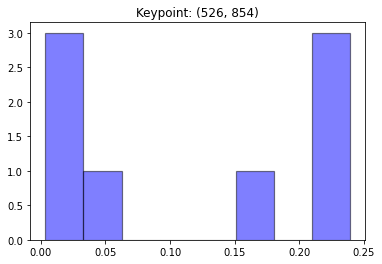

[0.23905195 0.02871718 0.00354764 0.01836931 0.05238102 0.17982899
 0.23905195 0.23905195]


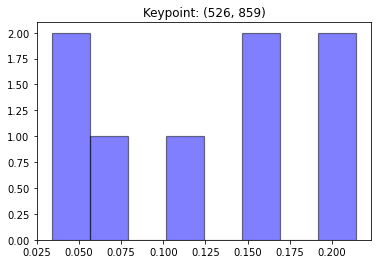

[0.21441775 0.15189267 0.05561283 0.0338642  0.06527619 0.11279277
 0.16322043 0.20292316]


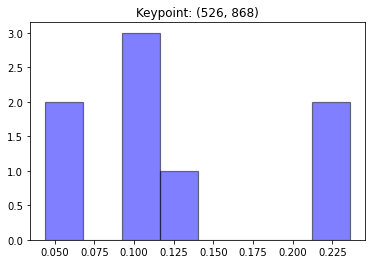

[0.09992771 0.05155205 0.04422063 0.09726458 0.09662494 0.13845801
 0.23597604 0.23597604]


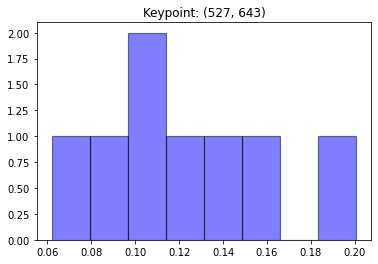

[0.14002396 0.16307626 0.06214251 0.08233938 0.1287129  0.11081871
 0.11238469 0.20050158]


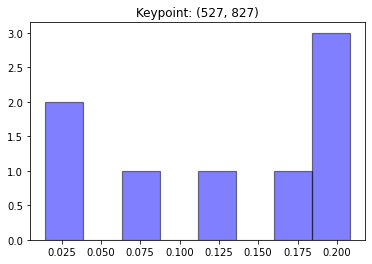

[0.20822357 0.01473718 0.01636852 0.16117806 0.13321143 0.19048842
 0.07369181 0.20210101]


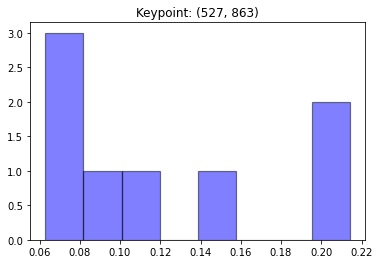

[0.21414649 0.15665882 0.06292641 0.07569421 0.07336415 0.09317848
 0.10988496 0.21414649]


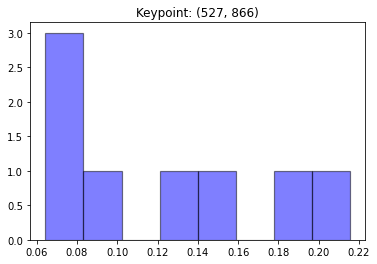

[0.18226668 0.12561405 0.06431136 0.08126581 0.0787436  0.10034415
 0.15201534 0.21543901]


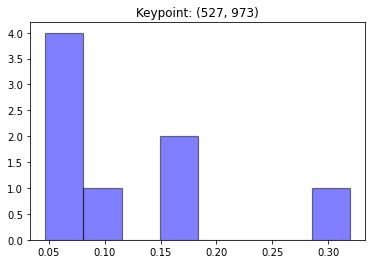

[0.17519253 0.16437314 0.09485165 0.07803253 0.06682307 0.05443246
 0.04688645 0.31940818]


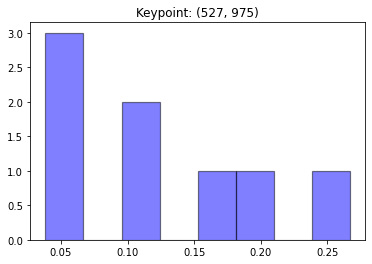

[0.17467404 0.18968123 0.10873384 0.10818516 0.05647933 0.05697827
 0.03826432 0.2670038 ]


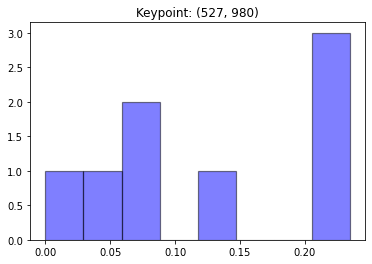

[0.12107877 0.2345877  0.2345877  0.0788243  0.04975606 0.06582545
 0.         0.21534003]


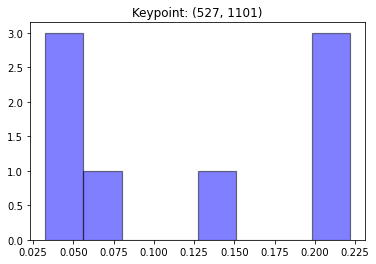

[0.03269442 0.0506785  0.05387978 0.22162089 0.20414947 0.22162089
 0.14768029 0.06767576]


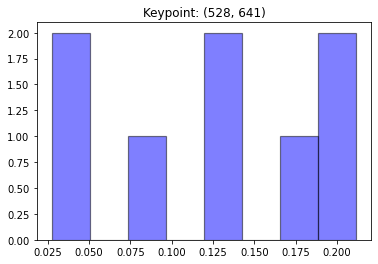

[0.08935994 0.12422239 0.04047463 0.02752898 0.21163789 0.21163789
 0.12652084 0.16861744]


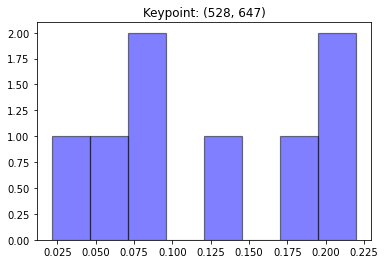

[0.21993011 0.21993011 0.13338142 0.09463156 0.05822369 0.0739686
 0.02140714 0.17852737]


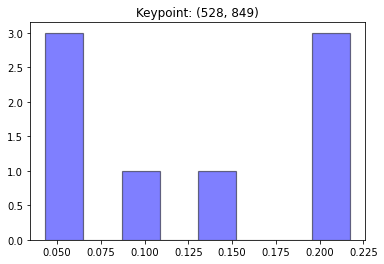

[0.13453274 0.04329583 0.05688162 0.0492907  0.09794385 0.2035359
 0.21726447 0.19725489]


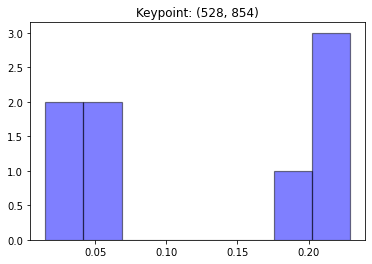

[0.2289215  0.04816191 0.017293   0.0150792  0.04299911 0.18970227
 0.2289215  0.2289215 ]


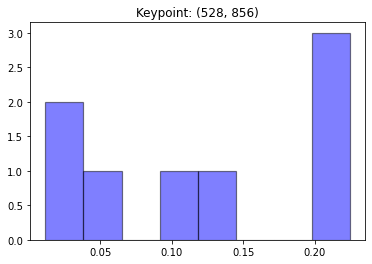

[0.22430653 0.12042901 0.0454518  0.01157375 0.03440982 0.11521603
 0.22430653 0.22430653]


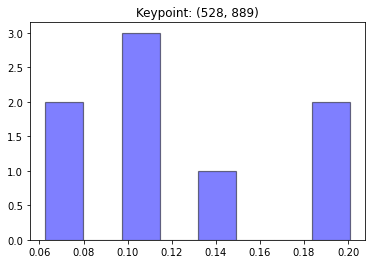

[0.20076873 0.10934246 0.10079314 0.14190086 0.06269015 0.1124163
 0.07131964 0.20076873]


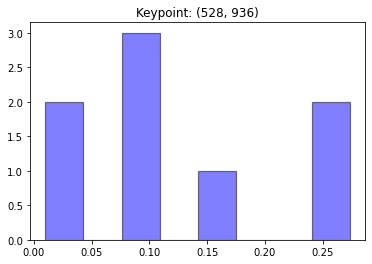

[0.27338461 0.27338461 0.08122481 0.09400657 0.08704395 0.00995206
 0.03247463 0.14852875]


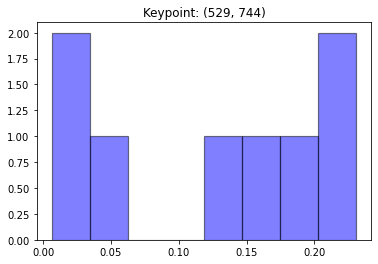

[0.02156029 0.00636073 0.03893586 0.11993905 0.23088771 0.23088771
 0.18249629 0.16893235]


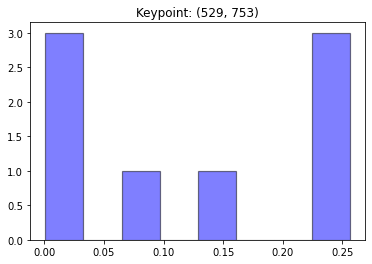

[0.13031695 0.25620921 0.25620921 0.25620921 0.08892491 0.00807368
 0.00079036 0.00326649]


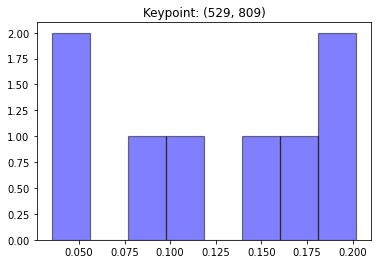

[0.20200284 0.17133195 0.15298136 0.03513938 0.05136957 0.08495042
 0.11393971 0.18828478]


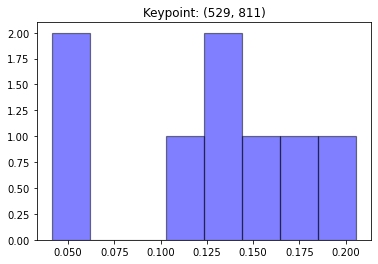

[0.20560807 0.16372598 0.13115282 0.04127658 0.04800183 0.10895586
 0.12484129 0.17643758]


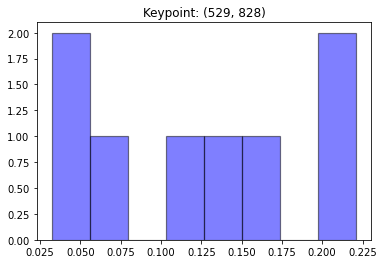

[0.22104444 0.03223533 0.04334235 0.13401083 0.1174692  0.16586693
 0.07359022 0.21244069]


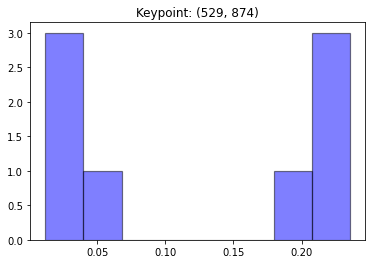

[0.23537773 0.22098288 0.05152525 0.01976216 0.01194166 0.02802986
 0.19700275 0.23537773]


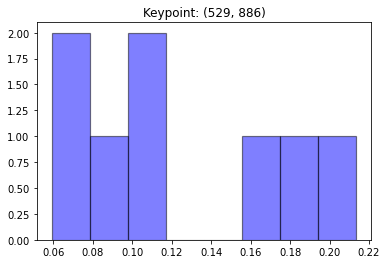

[0.21348438 0.16537758 0.08401837 0.11091823 0.05923627 0.10438186
 0.07052369 0.19205962]


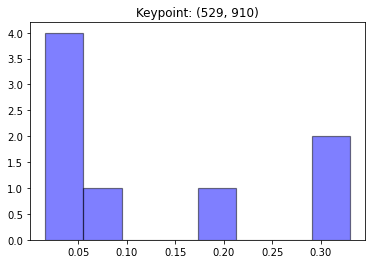

[0.33010135 0.19649942 0.01604457 0.01734353 0.0276124  0.02563396
 0.08613314 0.30063163]


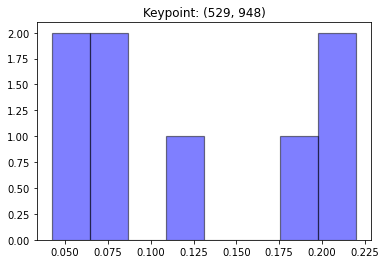

[0.21999356 0.06593759 0.06334867 0.04221386 0.13106606 0.20223577
 0.08064143 0.19456306]


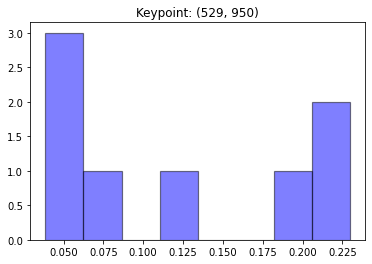

[0.22959923 0.0775996  0.03861612 0.04269976 0.12355827 0.19865703
 0.05967075 0.22959923]


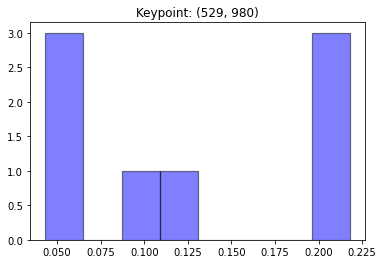

[0.10032896 0.21788977 0.21788977 0.05723933 0.0433006  0.05245081
 0.11297886 0.19792189]


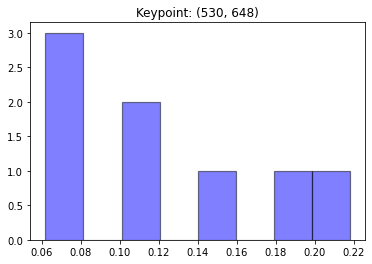

[0.21800086 0.19233464 0.15622901 0.11424569 0.07521399 0.06175646
 0.06326127 0.11895808]


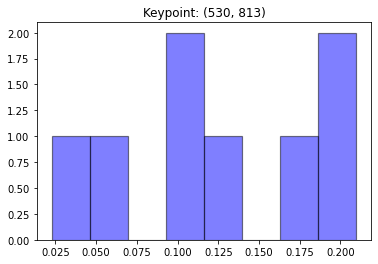

[0.20965558 0.13315242 0.16549044 0.02278272 0.06712082 0.11175538
 0.09486059 0.19518204]


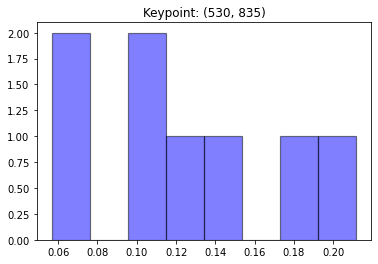

[0.18403511 0.13327853 0.0975347  0.05674882 0.06476621 0.1383347
 0.11368988 0.21161204]


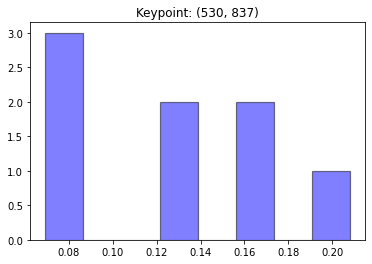

[0.07482377 0.16723111 0.12464319 0.0709183  0.06924118 0.15783072
 0.12730331 0.20800841]


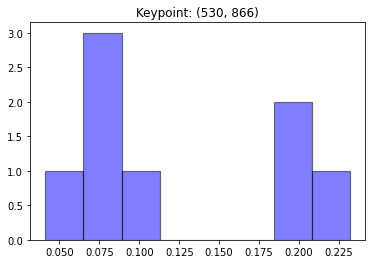

[0.23163173 0.20589976 0.0763976  0.09653836 0.08253406 0.07277354
 0.04129999 0.19292496]


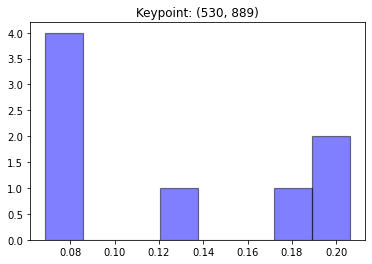

[0.20616364 0.17200174 0.06877466 0.07880631 0.07857429 0.12448687
 0.07387647 0.19731603]


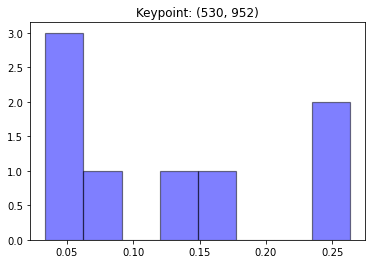

[0.26308699 0.12887208 0.03476255 0.03387477 0.06427546 0.17292558
 0.03911558 0.26308699]


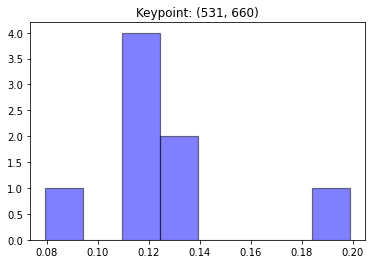

[0.19881956 0.13900302 0.11101849 0.13490366 0.07939765 0.10976039
 0.11539998 0.11169726]


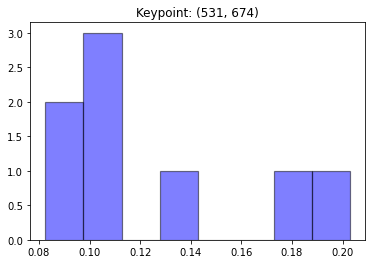

[0.18308806 0.13526218 0.10173105 0.09490459 0.20287523 0.10171082
 0.09788067 0.08254739]


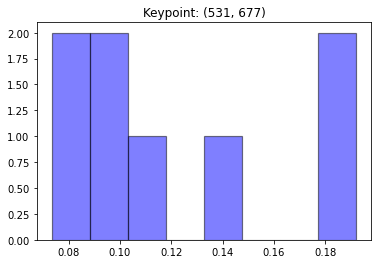

[0.18839607 0.1441798  0.11389239 0.07337446 0.19209492 0.10039719
 0.10112752 0.08653765]


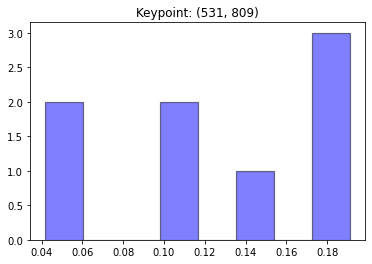

[0.17895528 0.19102776 0.17488937 0.041856   0.05934184 0.09843787
 0.10994668 0.14554519]


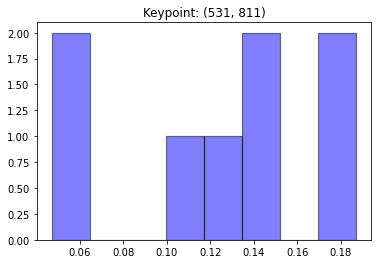

[0.18716619 0.17826666 0.14538908 0.04702577 0.05389431 0.12238819
 0.11550651 0.15036329]


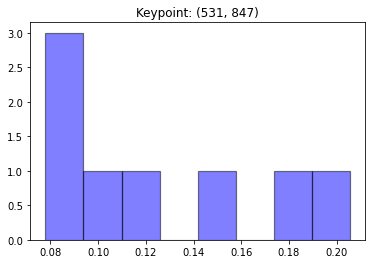

[0.1777886  0.09112743 0.10853993 0.08554814 0.07789675 0.14295048
 0.20549221 0.11065647]


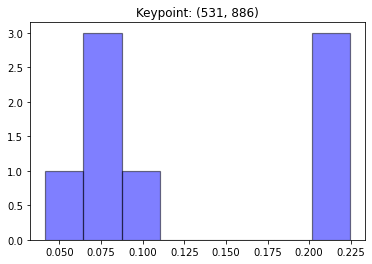

[0.224433   0.22132707 0.04154878 0.06519051 0.06525844 0.09386898
 0.07632295 0.21205026]


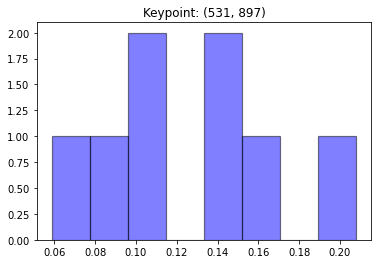

[0.10177076 0.20794852 0.10180403 0.05869901 0.09474554 0.15608442
 0.14156581 0.1373819 ]


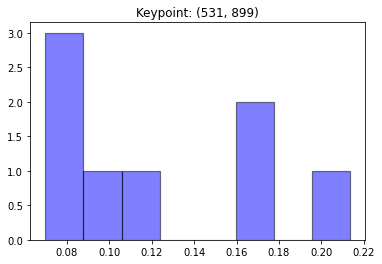

[0.0832181  0.2133998  0.1193315  0.06991245 0.10337958 0.16396878
 0.16085408 0.08593571]


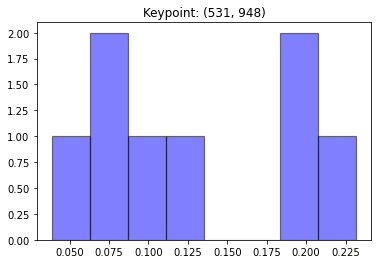

[0.23171482 0.18453203 0.07640048 0.03871145 0.08820809 0.12492589
 0.07147296 0.18403428]


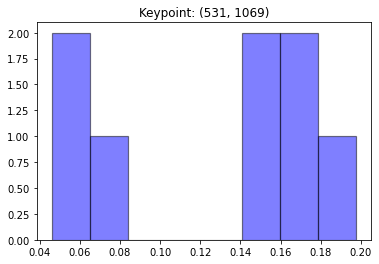

[0.0478631  0.0459782  0.14367889 0.17653213 0.15056489 0.1631717
 0.19768427 0.07452682]


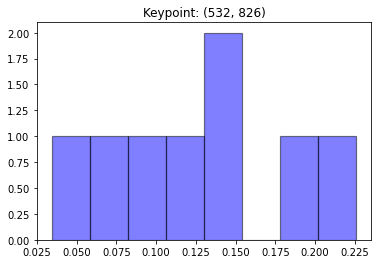

[0.2258411  0.08722726 0.06587877 0.19605188 0.13398886 0.11436433
 0.03433504 0.14231275]


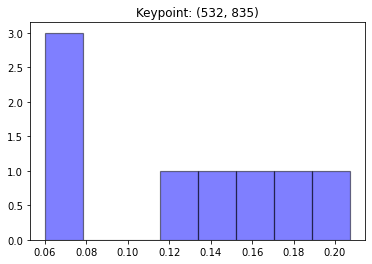

[0.17604618 0.1159415  0.07799721 0.06026333 0.07005645 0.15427222
 0.13830401 0.20711911]


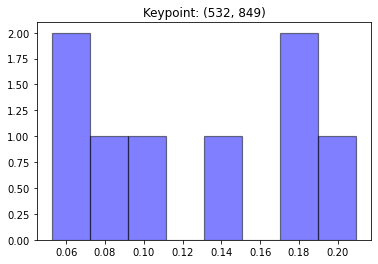

[0.17281083 0.09245731 0.09035659 0.05254239 0.06591621 0.13355074
 0.20946131 0.18290463]


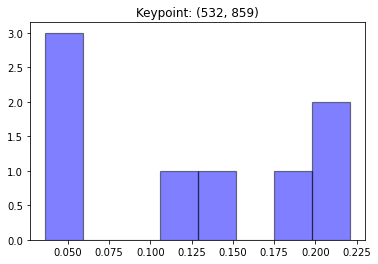

[0.13242304 0.22088341 0.03648624 0.04139082 0.04959986 0.11056188
 0.22088341 0.18777134]


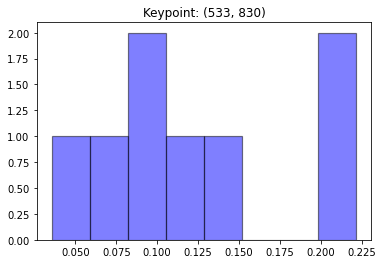

[0.2216456  0.08027047 0.03555599 0.10182328 0.10547495 0.13537305
 0.09821105 0.2216456 ]


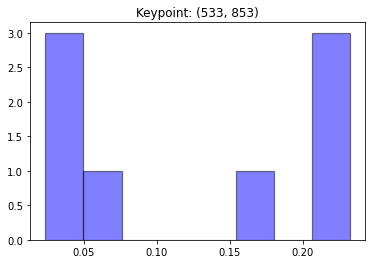

[0.21830439 0.03506256 0.023555   0.02614118 0.0738614  0.15871862
 0.23217842 0.23217842]


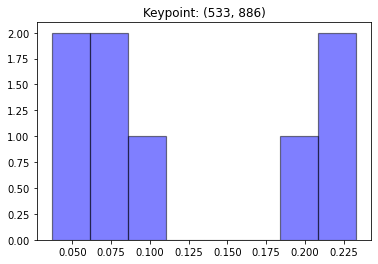

[0.23315267 0.20545572 0.04995359 0.07013031 0.03664843 0.09196851
 0.07953811 0.23315267]


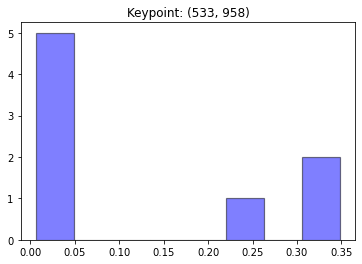

[0.34856697 0.24780988 0.01219576 0.00723673 0.00609321 0.01139612
 0.01813436 0.34856697]


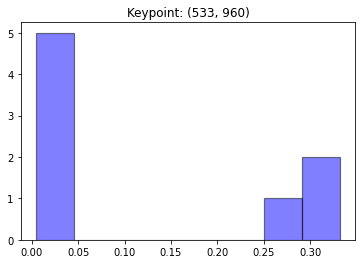

[0.33224573 0.28545434 0.01216824 0.00672736 0.00730267 0.00446247
 0.01939346 0.33224573]


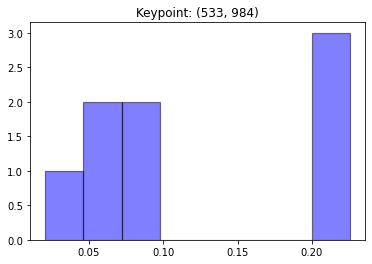

[0.02075556 0.09572216 0.22541314 0.09638783 0.04850638 0.06620169
 0.22541314 0.2216001 ]


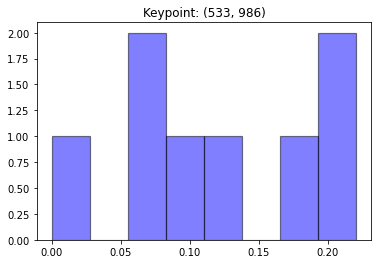

[0.         0.09422636 0.22040889 0.12726333 0.07760708 0.07828578
 0.22040889 0.18179967]


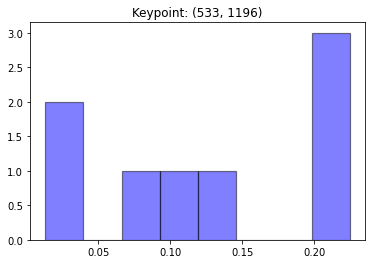

[0.0945322  0.01326051 0.01989253 0.06998319 0.22452845 0.22452845
 0.12874622 0.22452845]


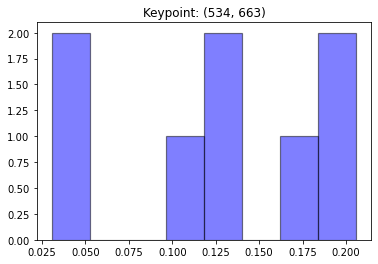

[0.11867636 0.1399368  0.17159803 0.18537412 0.20577947 0.11150629
 0.0306193  0.03650962]


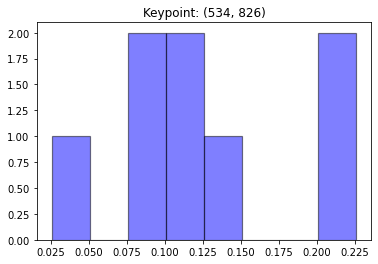

[0.22599617 0.11265543 0.0860921  0.22599617 0.10887963 0.07907672
 0.02574358 0.1355602 ]


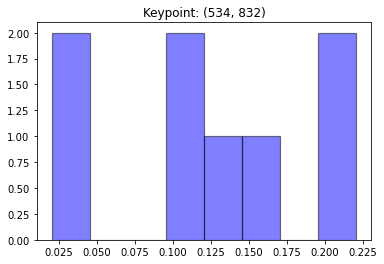

[0.22076594 0.02032432 0.03155727 0.09882696 0.10448751 0.16480116
 0.13847089 0.22076594]


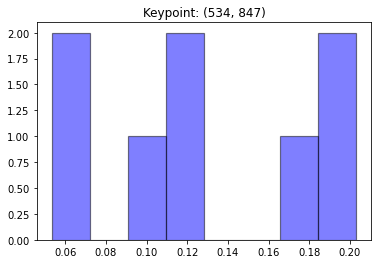

[0.20311085 0.1137952  0.16947072 0.11058375 0.05330545 0.10566351
 0.18439124 0.05967929]


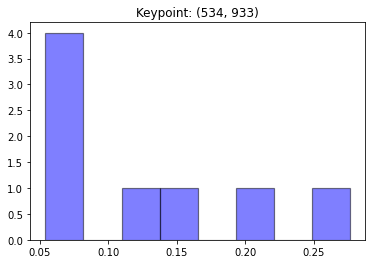

[0.27605755 0.1434707  0.05408914 0.0560565  0.12960131 0.06509682
 0.07031796 0.20531001]


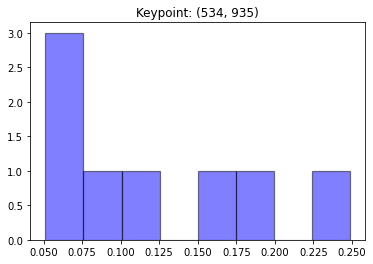

[0.24859708 0.1703069  0.06649639 0.05122376 0.12456307 0.06137411
 0.08582094 0.19161775]


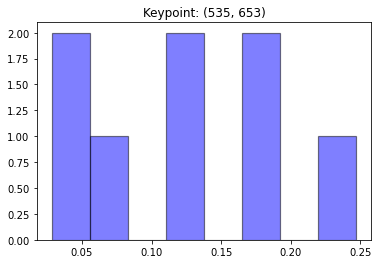

[0.18248239 0.06696627 0.11561547 0.03681842 0.02831203 0.13437055
 0.24699065 0.18844423]


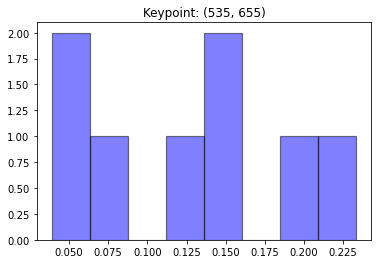

[0.1496501  0.06379965 0.12929527 0.05004355 0.03895759 0.14353374
 0.23330292 0.19141718]


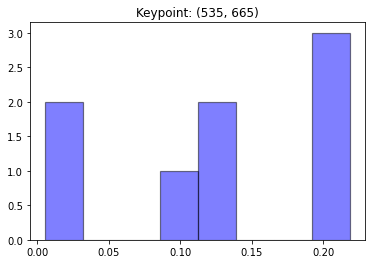

[0.10019512 0.12801428 0.19813634 0.21809107 0.21843953 0.12168481
 0.0096109  0.00582796]


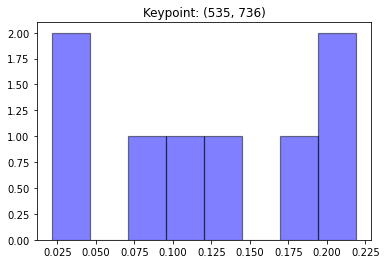

[0.11315061 0.09187789 0.03252668 0.02138126 0.12142511 0.21907533
 0.21907533 0.18148779]


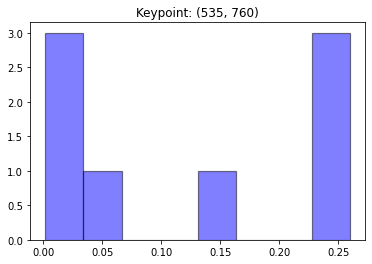

[0.2598314  0.2598314  0.2598314  0.02069032 0.0125391  0.00188384
 0.04783599 0.13755654]


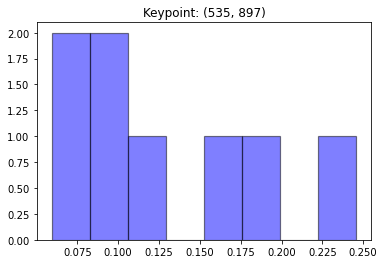

[0.06279685 0.24566616 0.08270608 0.05940015 0.11770048 0.17665077
 0.16480535 0.09027414]


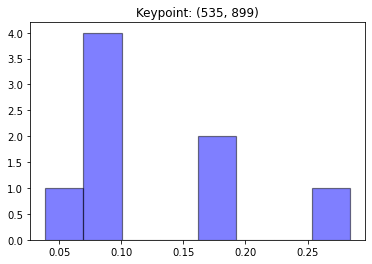

[0.07362465 0.28401562 0.09775788 0.03890439 0.08069765 0.18385261
 0.16375974 0.07738745]


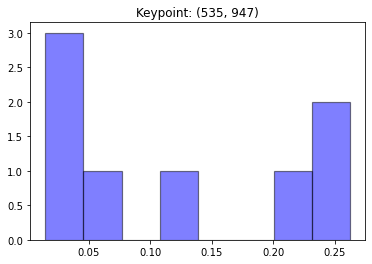

[0.26217657 0.26217657 0.1129142  0.01493592 0.02640913 0.02975667
 0.07503016 0.21660077]


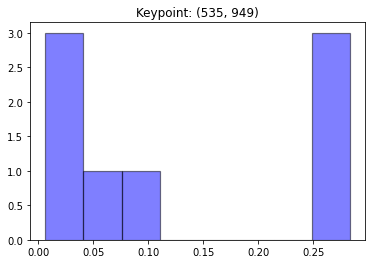

[0.28324596 0.28324596 0.08781564 0.01500907 0.00654654 0.01862993
 0.04845301 0.2570539 ]


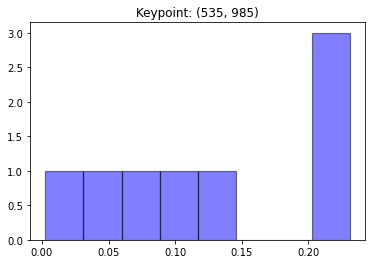

[0.00256137 0.0589063  0.20983859 0.13206009 0.06563925 0.09740785
 0.23101528 0.20257127]


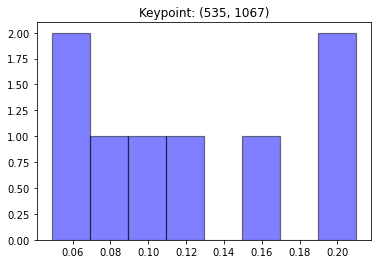

[0.0490051  0.09979769 0.20990942 0.16693154 0.06395546 0.12817027
 0.20990942 0.07232109]


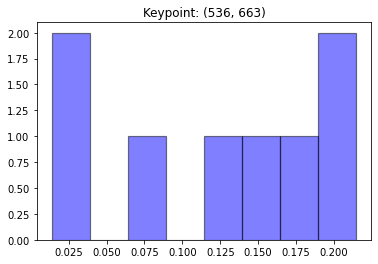

[0.08359653 0.12706927 0.14800103 0.17890547 0.21460994 0.21288874
 0.02101357 0.01391544]


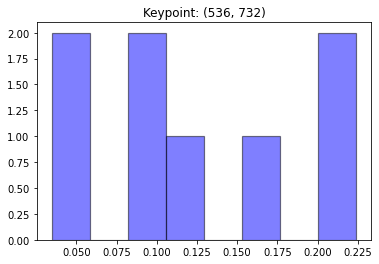

[0.09088687 0.09350581 0.03463378 0.04547969 0.12345693 0.22400554
 0.22400554 0.16402585]


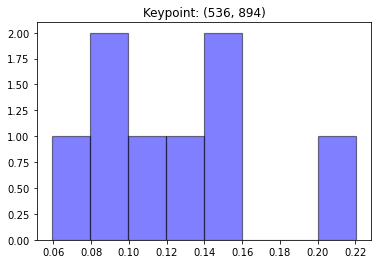

[0.11821058 0.22035684 0.05910084 0.08243946 0.09800652 0.12379795
 0.14317115 0.15491667]


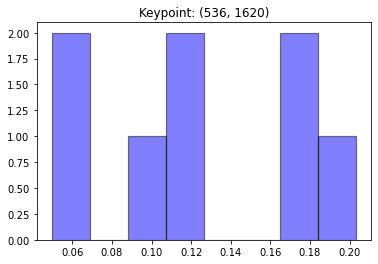

[0.09206875 0.11195998 0.18403356 0.17057868 0.0645257  0.04962405
 0.123854   0.20335527]


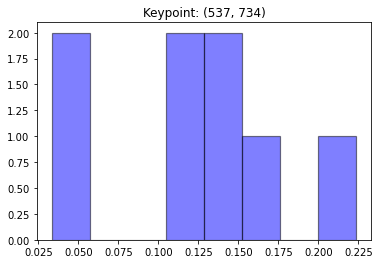

[0.14179218 0.12401018 0.03335187 0.04564148 0.12782061 0.1678305
 0.2236373  0.13591588]


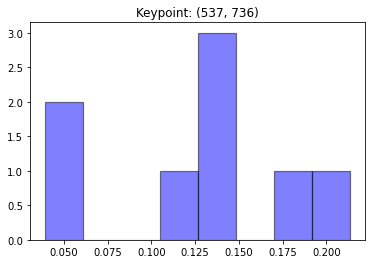

[0.13796161 0.13193938 0.03938593 0.04638075 0.12652225 0.18379631
 0.21341953 0.12059424]


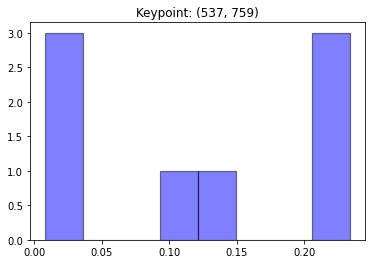

[0.23385624 0.22186214 0.2212075  0.01670266 0.00834673 0.03488172
 0.11456082 0.1485822 ]


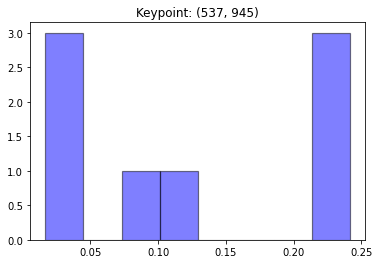

[0.2414576  0.2414576  0.1032913  0.01683373 0.03434165 0.0380756
 0.08308492 0.2414576 ]


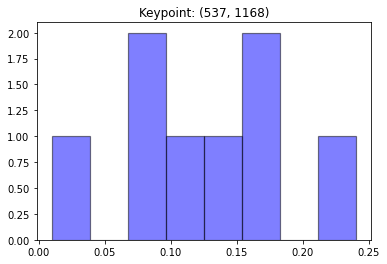

[0.09427289 0.2405558  0.13847188 0.07595666 0.15693912 0.16716847
 0.11675599 0.00987919]


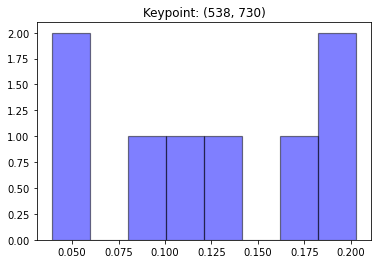

[0.18314792 0.13733738 0.05060774 0.03907517 0.09570458 0.17339795
 0.202927   0.11780227]


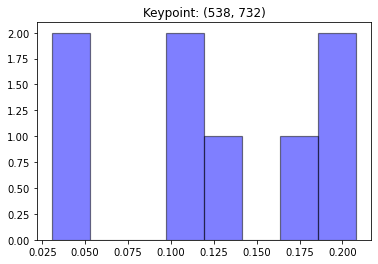

[0.16377678 0.11144239 0.03053062 0.04009159 0.10883066 0.20802434
 0.20803691 0.12926672]


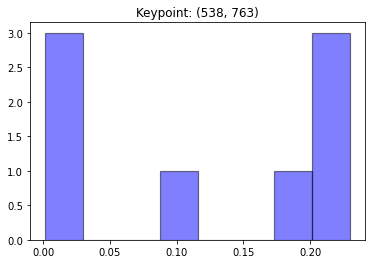

[0.22966531 0.22966531 0.19385818 0.01928721 0.0088773  0.00158586
 0.09155217 0.22550866]


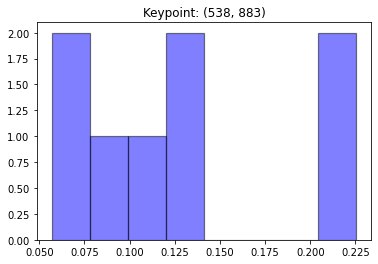

[0.22538126 0.12277574 0.05692387 0.1028411  0.06254197 0.08025352
 0.12390127 0.22538126]


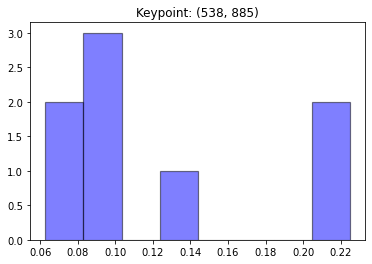

[0.22486695 0.13665339 0.06274043 0.10096841 0.08860388 0.07169324
 0.08960674 0.22486695]


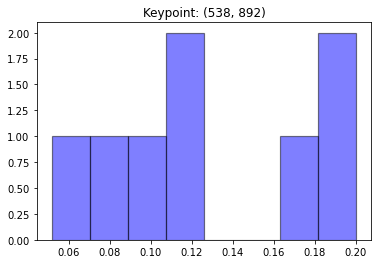

[0.19400689 0.16793598 0.05180601 0.10765458 0.0892225  0.07144987
 0.11765384 0.20027033]


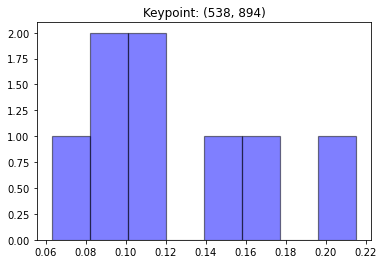

[0.10856161 0.21529322 0.06305164 0.11533722 0.09556625 0.09367657
 0.14713554 0.16137795]


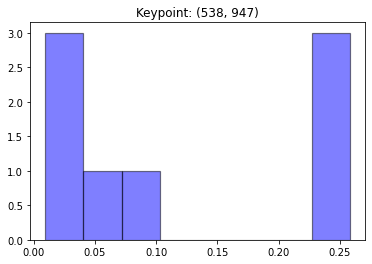

[0.25796053 0.25796053 0.09212629 0.00970999 0.02239071 0.03609736
 0.06579406 0.25796053]


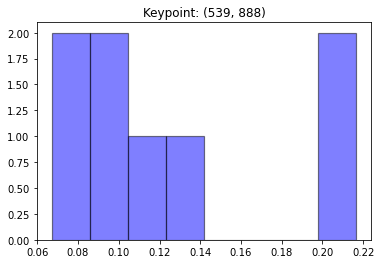

[0.21653851 0.12861551 0.06710822 0.11231605 0.09094503 0.07746087
 0.0904773  0.21653851]


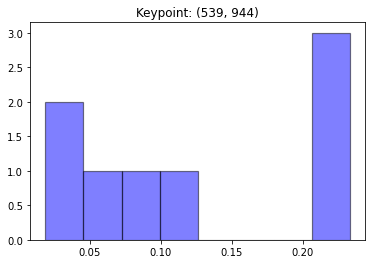

[0.23308417 0.23308417 0.10535982 0.01862663 0.03794491 0.05700771
 0.09481603 0.22007656]


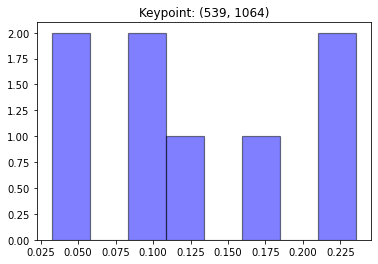

[0.10286422 0.23562152 0.16197633 0.08348314 0.03234059 0.04287241
 0.21655452 0.12428727]


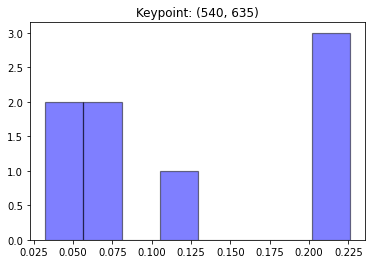

[0.12016121 0.0546527  0.06902155 0.07224268 0.21707078 0.20862274
 0.22582222 0.03240613]


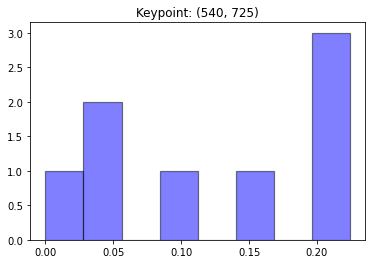

[0.22415625 0.05225972 0.03821213 0.         0.15255413 0.22415625
 0.20231708 0.10634445]


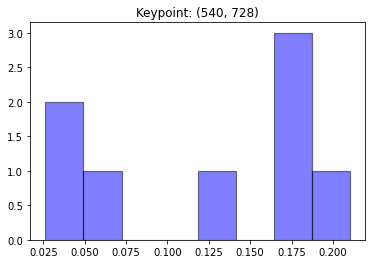

[0.17924072 0.1274292  0.04132006 0.02621822 0.1704454  0.21017224
 0.17830916 0.066865  ]


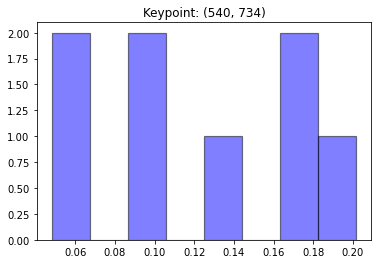

[0.18206836 0.17024073 0.0481993  0.06141935 0.13052621 0.10494213
 0.20161147 0.10099246]


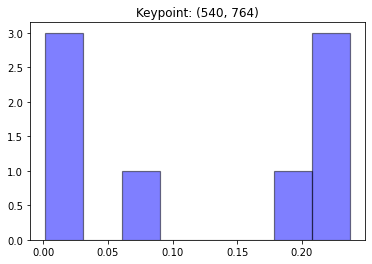

[0.23715884 0.23715884 0.18265794 0.01661138 0.00931612 0.00166425
 0.0782738  0.23715884]


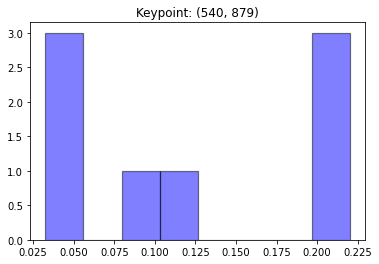

[0.21758599 0.03258055 0.05173708 0.09317979 0.04958048 0.11518338
 0.22007637 0.22007637]


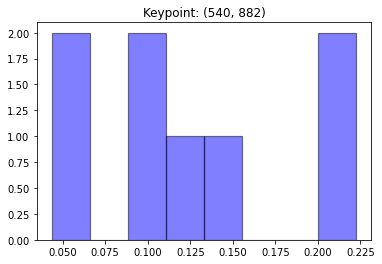

[0.22248294 0.11665024 0.0436009  0.10576665 0.0444604  0.09738454
 0.1471714  0.22248294]


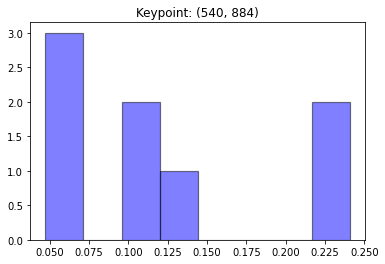

[0.2406931  0.1337797  0.05498925 0.11659608 0.04721296 0.06311399
 0.1029218  0.2406931 ]


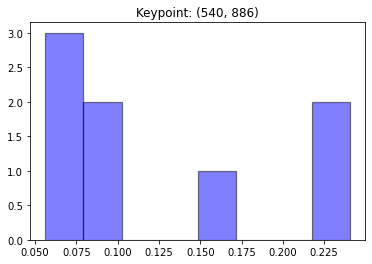

[0.24046895 0.1553135  0.05925942 0.09786604 0.05621773 0.06522329
 0.08518213 0.24046895]


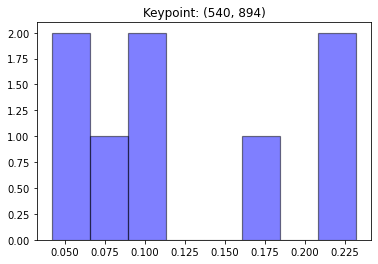

[0.1689148  0.23219294 0.10752923 0.10693349 0.07643976 0.04184671
 0.05621774 0.20992533]


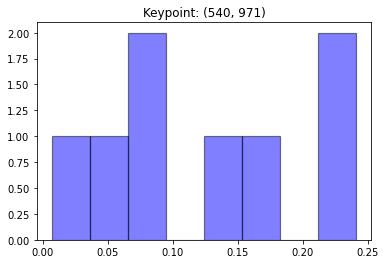

[0.24089828 0.13191305 0.06980749 0.05858387 0.00699078 0.08013236
 0.24089828 0.17077589]


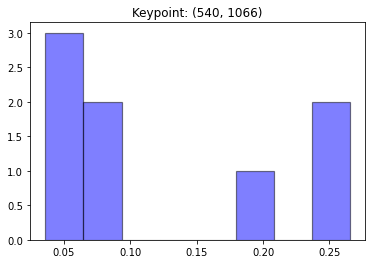

[0.08788837 0.26531406 0.26531406 0.0667606  0.03600057 0.03650314
 0.18690998 0.05530924]


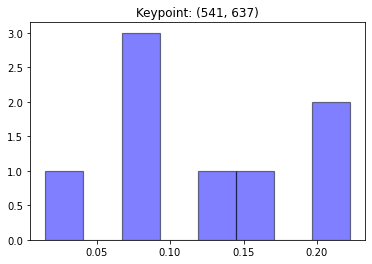

[0.13813829 0.07785626 0.08053812 0.07930448 0.16430871 0.22232999
 0.22232999 0.01519417]


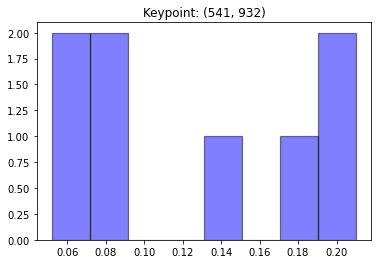

[0.21022242 0.13941817 0.05193012 0.07800575 0.21022242 0.06551984
 0.073006   0.17167526]


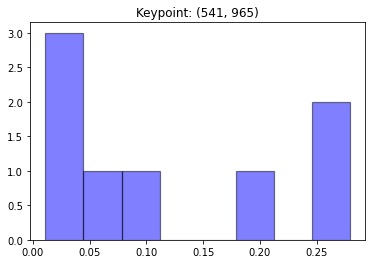

[0.27911792 0.27911792 0.03892648 0.02861903 0.01108844 0.04992645
 0.10722087 0.20598289]


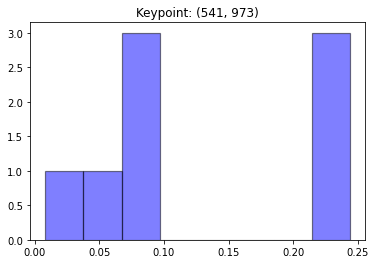

[0.22574538 0.03803913 0.09134032 0.07444364 0.00831066 0.0862249
 0.24368091 0.23221506]


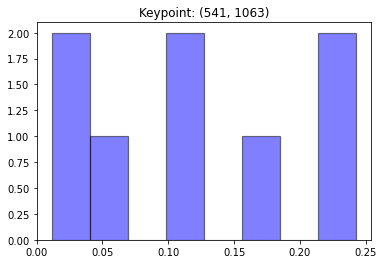

[0.10444836 0.24277289 0.18152186 0.06689688 0.01150215 0.0299692
 0.24128439 0.12160428]


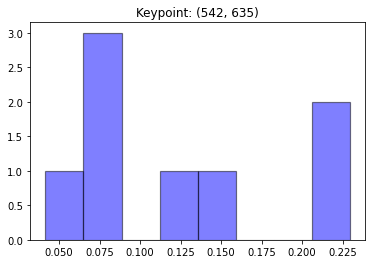

[0.13009249 0.08736401 0.08254361 0.07164446 0.14296395 0.2143437
 0.2294737  0.04157407]


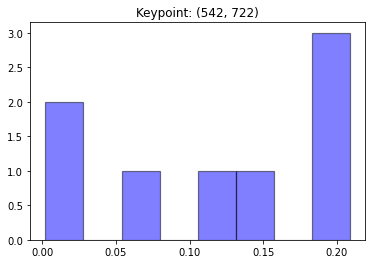

[0.20878898 0.07780768 0.02636881 0.00206631 0.14256125 0.20878898
 0.20878898 0.12482901]


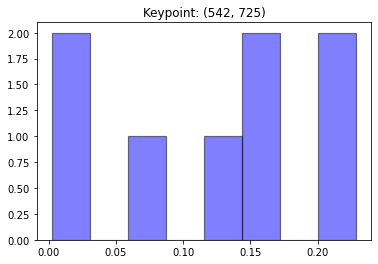

[0.22850869 0.06488863 0.02084115 0.00235063 0.15199493 0.22850869
 0.16681649 0.13609081]


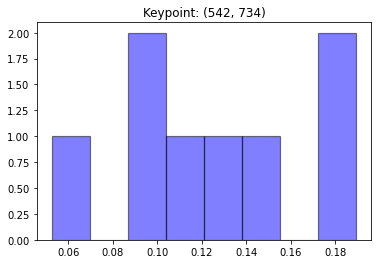

[0.18946965 0.1754265  0.09912116 0.09055036 0.05259517 0.13010861
 0.15509602 0.10763253]


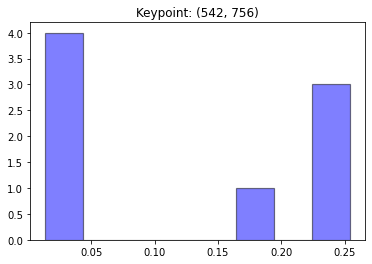

[0.25410155 0.03590661 0.02376448 0.01380892 0.02101848 0.22463667
 0.17266173 0.25410155]


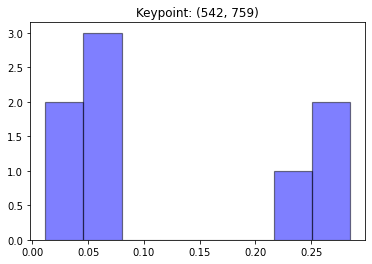

[0.28452694 0.05681807 0.06626578 0.01669036 0.01169057 0.05311062
 0.22637072 0.28452694]


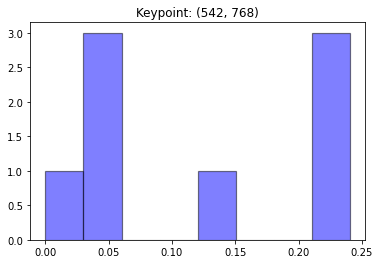

[0.1221215  0.24046555 0.24046555 0.05915073 0.04649132 0.
 0.05693846 0.2343669 ]


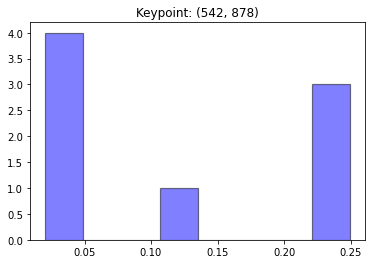

[0.23384767 0.0206032  0.04553152 0.03448218 0.0477363  0.11906755
 0.24936579 0.24936579]


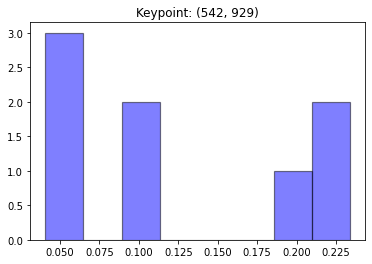

[0.23373327 0.10683405 0.06028819 0.08998471 0.21755066 0.04717684
 0.04075954 0.20367273]


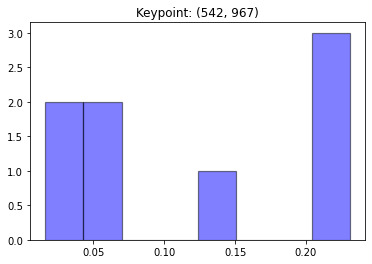

[0.2309349  0.2309349  0.0402579  0.05802713 0.01606901 0.05621271
 0.13662855 0.2309349 ]


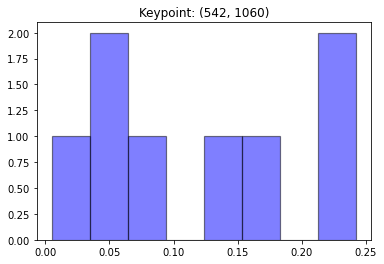

[0.08836189 0.24241673 0.16940419 0.05669913 0.00506841 0.04713366
 0.24241673 0.14849926]


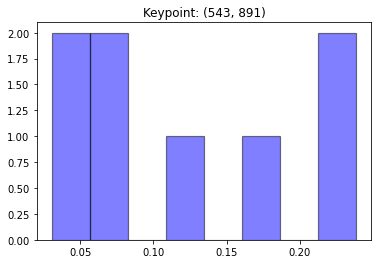

[0.2386932  0.2386932  0.08091376 0.1223646  0.07412725 0.03042634
 0.04246864 0.17231301]


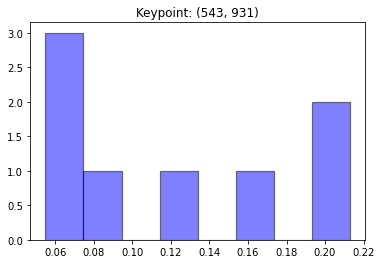

[0.21283633 0.1309309  0.05488997 0.07303289 0.21283633 0.0839398
 0.0621731  0.16936068]


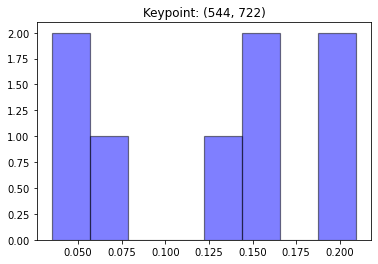

[0.20933652 0.06558742 0.0389449  0.03496987 0.15849811 0.14742674
 0.20933652 0.13589991]


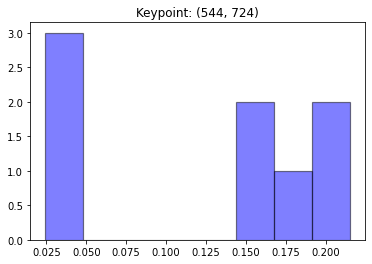

[0.2151573  0.04690449 0.03267253 0.0243387  0.18301481 0.19189387
 0.1536537  0.1523646 ]


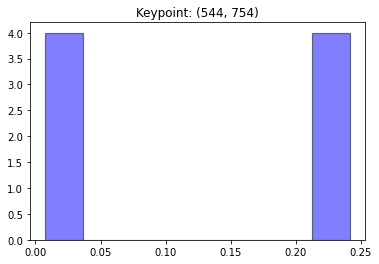

[0.21727866 0.01805787 0.01353531 0.00764953 0.01870444 0.2415914
 0.2415914  0.2415914 ]


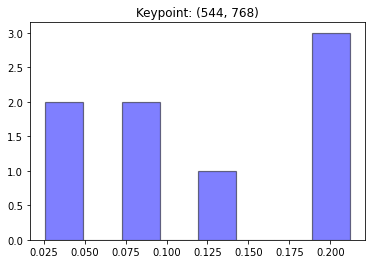

[0.12794739 0.2111035  0.21192795 0.04818232 0.08063183 0.02603401
 0.08224506 0.21192795]


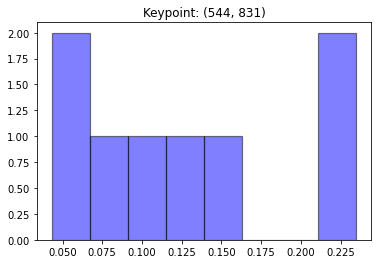

[0.23484899 0.14207398 0.04323898 0.07094382 0.12453489 0.0480838
 0.10142654 0.23484899]


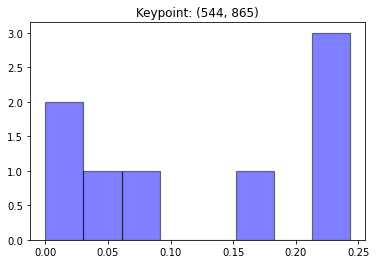

[0.24327708 0.03386974 0.06329721 0.01918246 0.         0.15648843
 0.24060801 0.24327708]


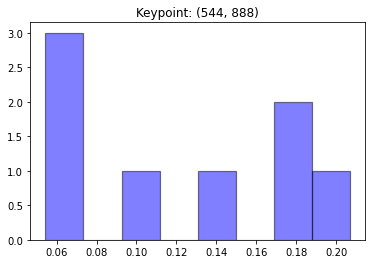

[0.1687073  0.2066964  0.07246551 0.14067977 0.10997393 0.05444207
 0.06676206 0.18027297]


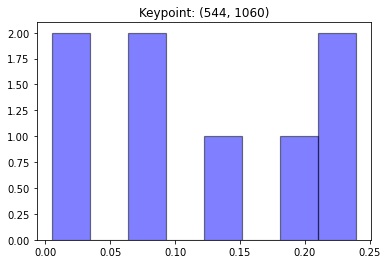

[0.0868113  0.23933849 0.19349618 0.022975   0.0051433  0.07043299
 0.23933849 0.14246425]


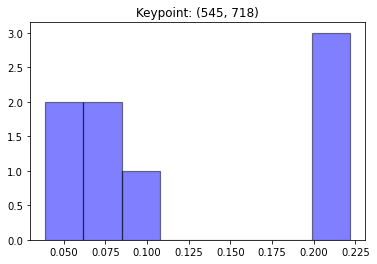

[0.22114415 0.07465613 0.03898679 0.05636199 0.08778214 0.07790605
 0.22158138 0.22158138]


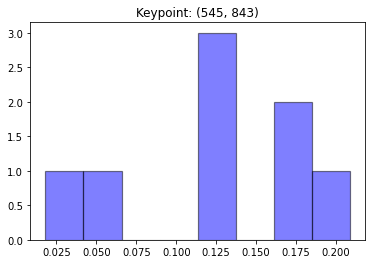

[0.20861162 0.01806405 0.06176823 0.12201904 0.17366831 0.1163242
 0.130881   0.16866355]


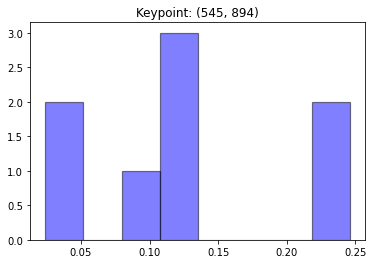

[0.24602805 0.24602805 0.08607014 0.13290833 0.12975827 0.02715577
 0.02404566 0.10800572]


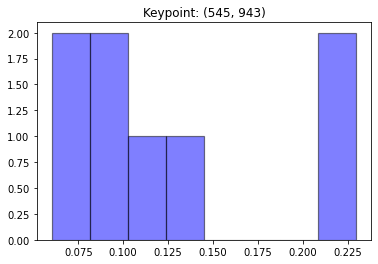

[0.22950718 0.06026928 0.06202036 0.09557647 0.09210472 0.10717156
 0.12384325 0.22950718]


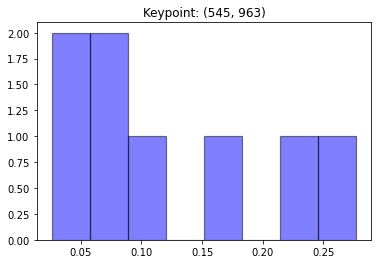

[0.23821827 0.27709695 0.07543705 0.03449006 0.02604233 0.06902526
 0.10551905 0.17417101]


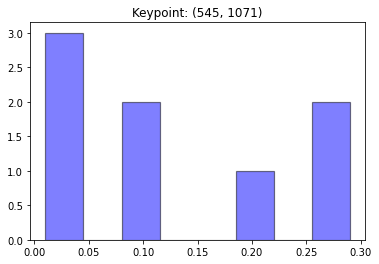

[0.08586752 0.28994408 0.28994408 0.18671434 0.09104645 0.03522641
 0.01106775 0.01018936]


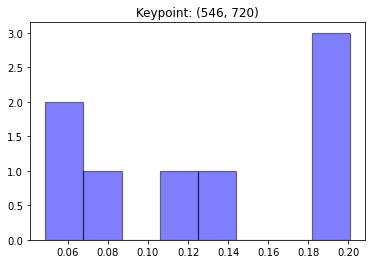

[0.18417247 0.06933529 0.0488103  0.06466145 0.11300336 0.12950282
 0.20066261 0.1898517 ]


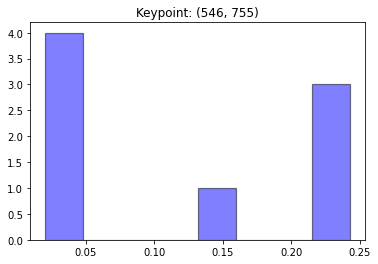

[0.1553516  0.02228534 0.0269797  0.02047839 0.04727143 0.24254451
 0.24254451 0.24254451]


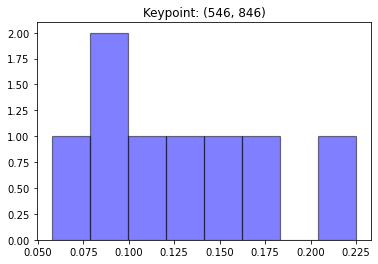

[0.22506374 0.10539846 0.14593882 0.05767571 0.13032927 0.08275062
 0.09018146 0.16266192]


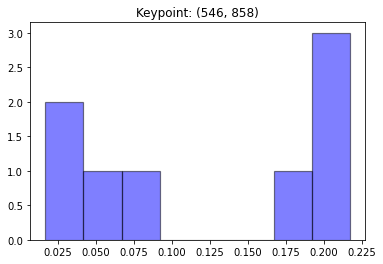

[0.18923668 0.07662935 0.0166037  0.01776106 0.05494274 0.21117049
 0.21682798 0.21682798]


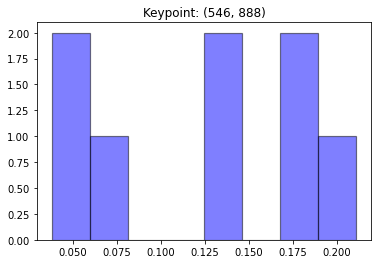

[0.16900325 0.21099315 0.06338295 0.14370661 0.18550893 0.03794276
 0.04568486 0.1437775 ]


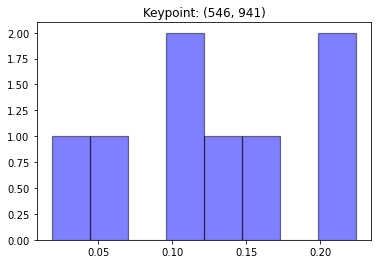

[0.16904861 0.05340187 0.01873615 0.1001659  0.0982701  0.13168873
 0.20437369 0.22431496]


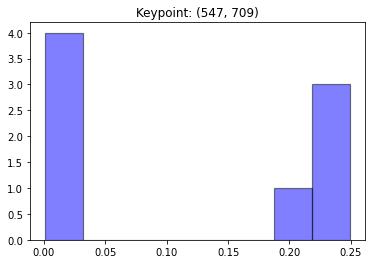

[0.21179636 0.0124449  0.02102697 0.00126531 0.00614095 0.2491085
 0.2491085  0.2491085 ]


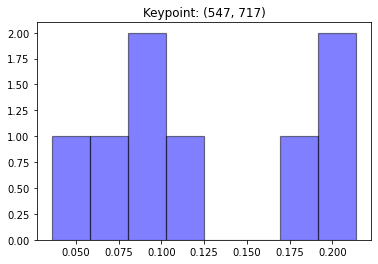

[0.1832976  0.08350704 0.06300975 0.08320486 0.03583728 0.12326806
 0.2139377  0.2139377 ]


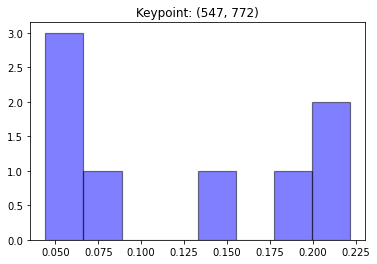

[0.19308588 0.2214105  0.20905955 0.07912657 0.13855619 0.05032566
 0.04420796 0.06422768]


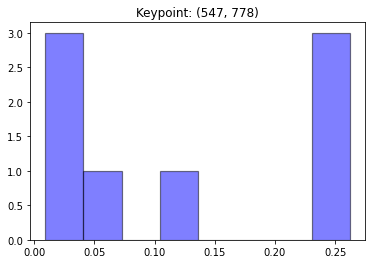

[0.26204475 0.26204475 0.26204475 0.12072275 0.02001949 0.01285317
 0.00933271 0.05093765]


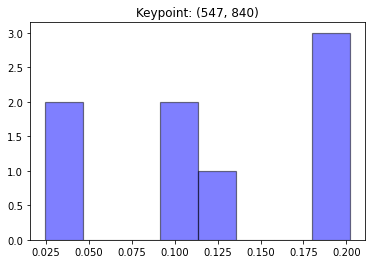

[0.20199517 0.03192249 0.02452073 0.18447541 0.20199517 0.1301838
 0.11230814 0.1125991 ]


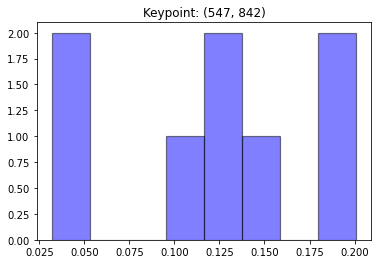

[0.20091099 0.0318622  0.0519871  0.15254919 0.19327362 0.11277988
 0.12768878 0.12894824]


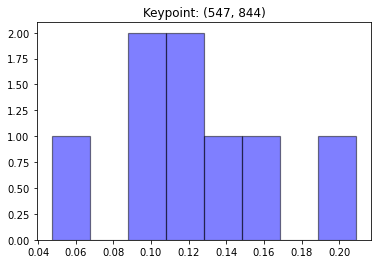

[0.20901242 0.04723605 0.10073284 0.12514108 0.14773197 0.09001602
 0.12485916 0.15527046]


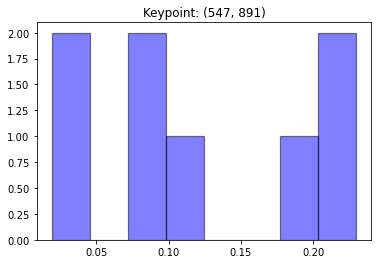

[0.22964129 0.22964129 0.0742834  0.09761414 0.20027382 0.02662244
 0.01922143 0.1227022 ]


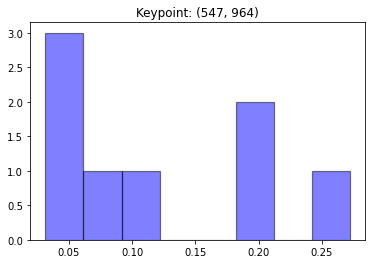

[0.21111681 0.27194243 0.11187482 0.04032487 0.03138718 0.05853021
 0.08240558 0.1924181 ]


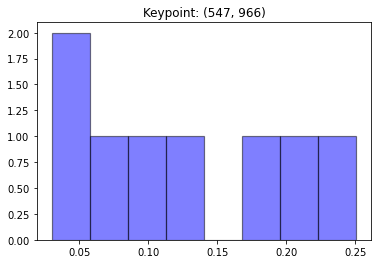

[0.18153799 0.25064989 0.12368491 0.05390753 0.0302387  0.0601945
 0.09095407 0.20883239]


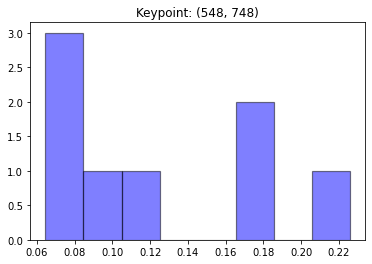

[0.09576452 0.1185212  0.06762214 0.06455708 0.08024284 0.22580856
 0.17617521 0.17130844]


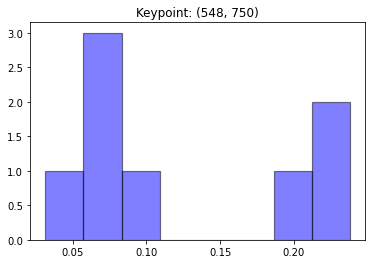

[0.09331962 0.06454784 0.03162055 0.06809978 0.07715007 0.23777654
 0.23777654 0.18970905]


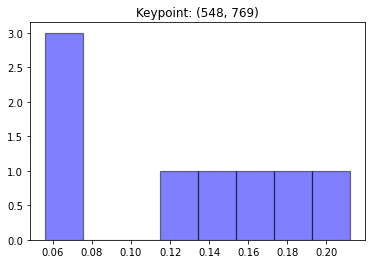

[0.13665921 0.21199122 0.11931543 0.05927987 0.17264405 0.06677714
 0.05616772 0.17716536]


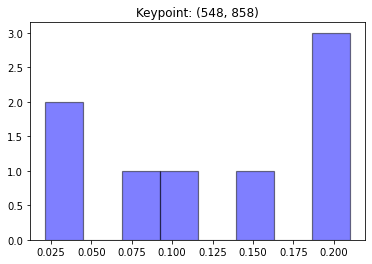

[0.15306699 0.0707393  0.09667272 0.0216684  0.02848566 0.20978898
 0.20978898 0.20978898]


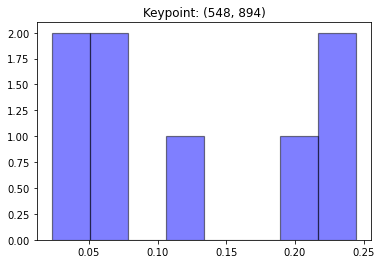

[0.24452468 0.24452468 0.07077022 0.06979011 0.20625838 0.02693025
 0.02300282 0.11419887]


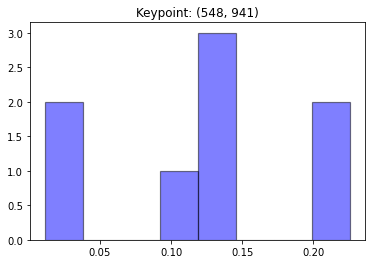

[0.13285746 0.01161362 0.01929243 0.13477562 0.1133998  0.13699548
 0.22553279 0.22553279]


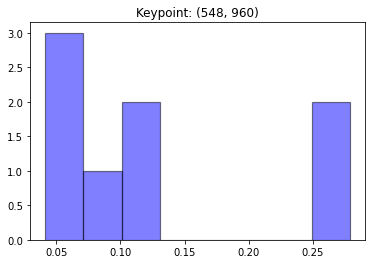

[0.27869771 0.27869771 0.11549452 0.04231009 0.05572972 0.0800052
 0.04159558 0.10746947]


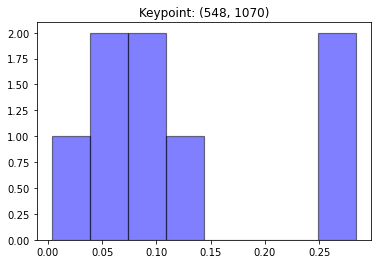

[0.06900516 0.28397866 0.28397866 0.10639815 0.10890969 0.09937632
 0.04483737 0.003516  ]


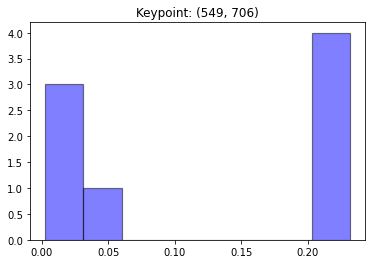

[0.23140219 0.05831465 0.01745121 0.00271057 0.02121729 0.23140219
 0.20609971 0.23140219]


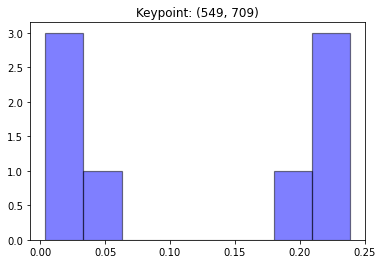

[0.20924275 0.02449639 0.0205383  0.0038922  0.03944668 0.23860233
 0.23860233 0.22517903]


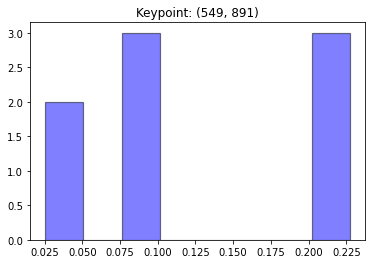

[0.22718112 0.22718112 0.0791417  0.08381145 0.22718112 0.03231449
 0.02560678 0.09758223]


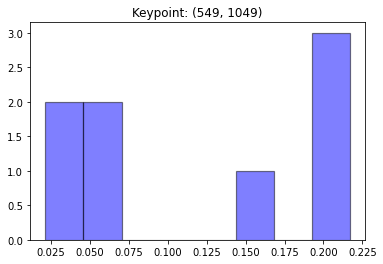

[0.05993615 0.02157274 0.04587459 0.06484158 0.21688739 0.16715925
 0.20684093 0.21688739]


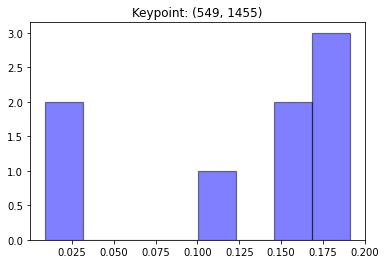

[0.1545582  0.15997479 0.10052613 0.00916101 0.02989203 0.18189062
 0.1729667  0.19103052]


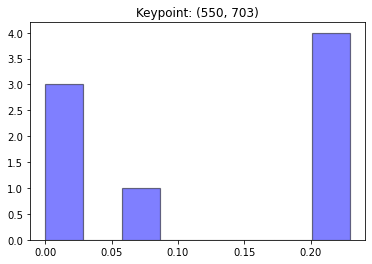

[0.22949622 0.06855334 0.015479   0.00266598 0.         0.22949622
 0.22949622 0.22481301]


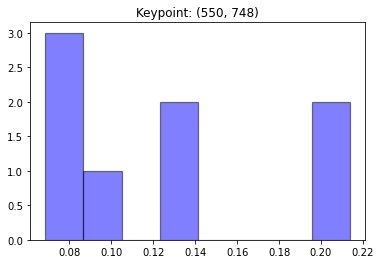

[0.09695495 0.12709697 0.08144663 0.07693367 0.06868043 0.21368991
 0.12934316 0.20585428]


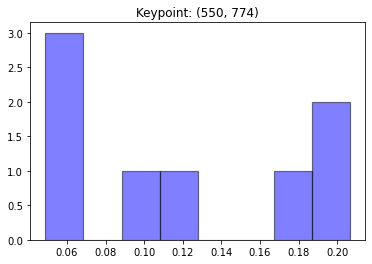

[0.20309948 0.20657592 0.12663833 0.10264069 0.18581938 0.06370934
 0.04881519 0.06270166]


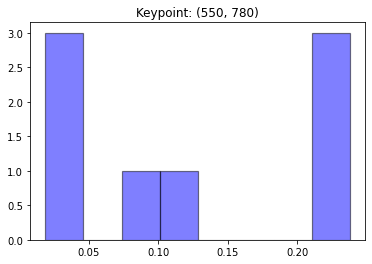

[0.23788627 0.23788627 0.23788627 0.09463304 0.0331904  0.02355023
 0.01858783 0.11637972]


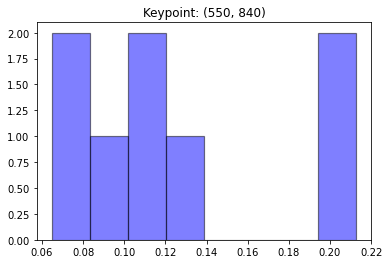

[0.06479377 0.11145624 0.09204395 0.21273953 0.21273953 0.12583517
 0.10584262 0.07454919]


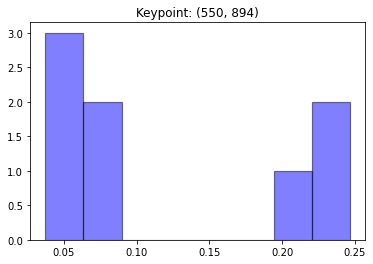

[0.24649329 0.24649329 0.04360173 0.08498085 0.21487328 0.05524891
 0.03736987 0.07093879]


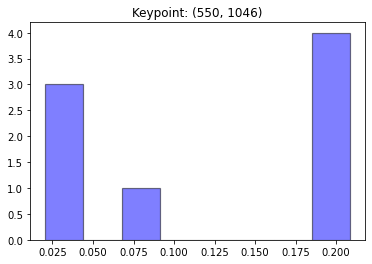

[0.03148323 0.02064474 0.04014499 0.08582882 0.20843614 0.19658979
 0.20843614 0.20843614]


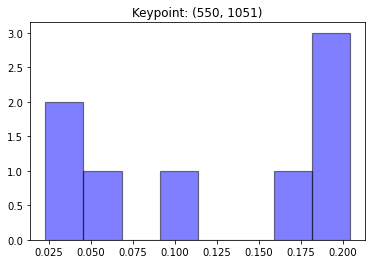

[0.04222913 0.02286689 0.05240864 0.10166568 0.16993865 0.20235038
 0.20427031 0.20427031]


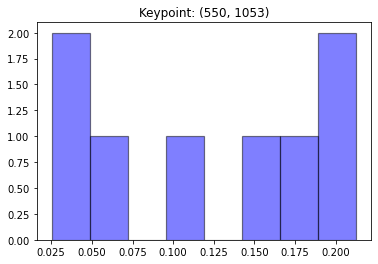

[0.04740187 0.02534383 0.05808552 0.10827076 0.18180365 0.20361705
 0.21256162 0.1629157 ]


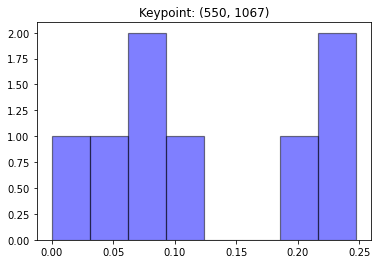

[0.05109695 0.24760799 0.24760799 0.08216805 0.06653205 0.20733013
 0.09765686 0.        ]


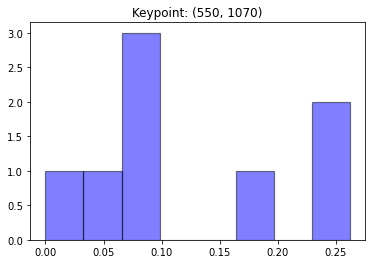

[0.06978786 0.26197615 0.26197615 0.09361175 0.09445445 0.17757919
 0.04061444 0.        ]


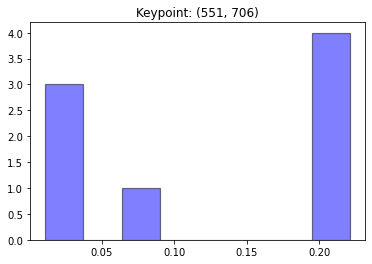

[0.22112433 0.06429843 0.01705109 0.01105382 0.0240175  0.22112433
 0.22020617 0.22112433]


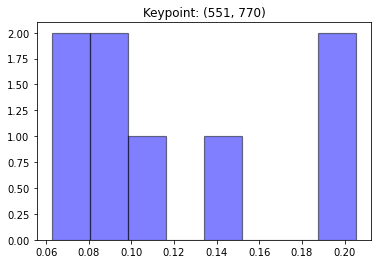

[0.14930203 0.20541878 0.06265746 0.09137461 0.20541878 0.11512564
 0.09623525 0.07446746]


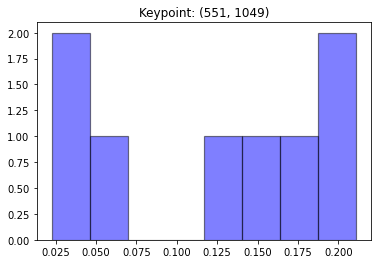

[0.04486386 0.02256855 0.05754735 0.12011758 0.21106617 0.15333347
 0.17943685 0.21106617]


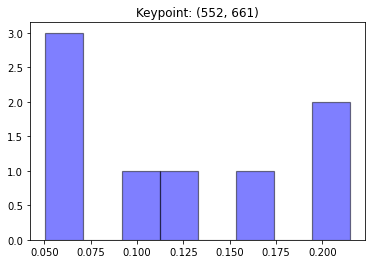

[0.05796077 0.11632129 0.10806395 0.17035876 0.2147653  0.2147653
 0.05062704 0.06713759]


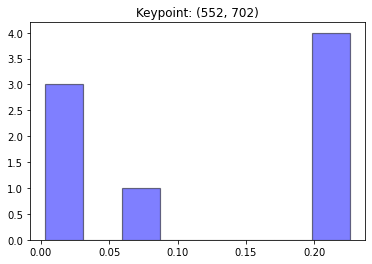

[0.2259414  0.07046216 0.01512403 0.00735897 0.00328923 0.2259414
 0.2259414  0.2259414 ]


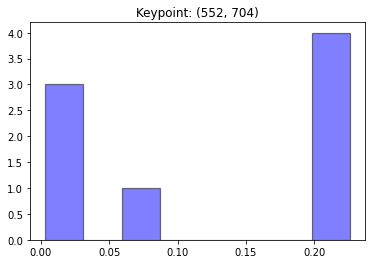

[0.22582031 0.06927173 0.01547461 0.00860693 0.00336548 0.22582031
 0.22582031 0.22582031]


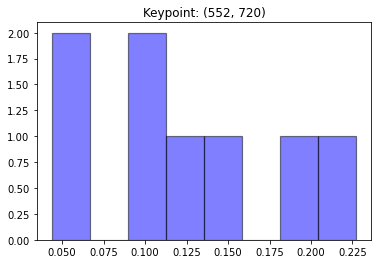

[0.22722176 0.12602093 0.09400072 0.15761861 0.04370071 0.09910594
 0.05585026 0.19648107]


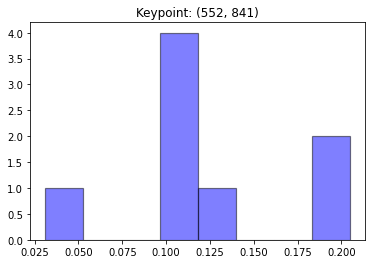

[0.03118044 0.10208076 0.11473329 0.20235468 0.20476172 0.13498954
 0.10834153 0.10155803]


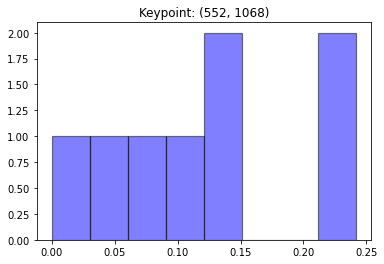

[0.04356548 0.14766598 0.24188409 0.09178428 0.088458   0.24188409
 0.14475809 0.        ]


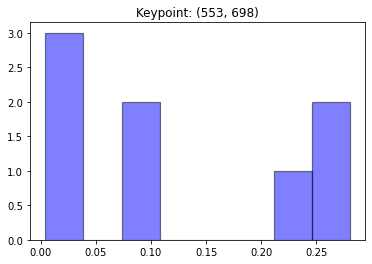

[0.230413   0.08160755 0.01955351 0.00421703 0.0045355  0.09885641
 0.2804085  0.2804085 ]


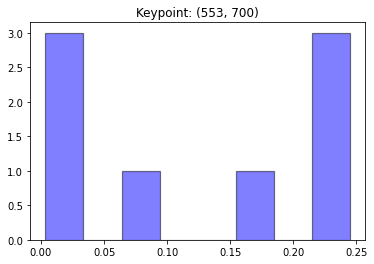

[0.16964798 0.06954914 0.01622861 0.00349996 0.00701089 0.24468781
 0.24468781 0.24468781]


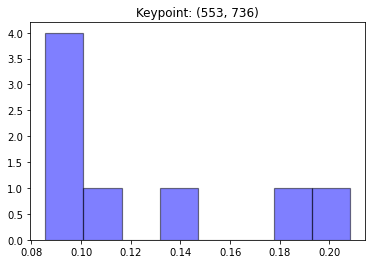

[0.08561759 0.10338807 0.09262845 0.13222628 0.19145328 0.09769488
 0.08876483 0.20822662]


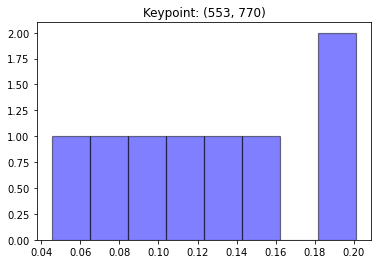

[0.1431693  0.20112415 0.07481299 0.04540746 0.18930023 0.13846944
 0.11863072 0.0890857 ]


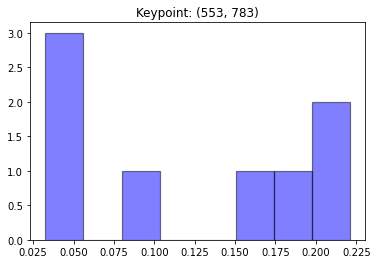

[0.16312693 0.22099561 0.21784171 0.09087537 0.05516229 0.04023564
 0.03257873 0.17918372]


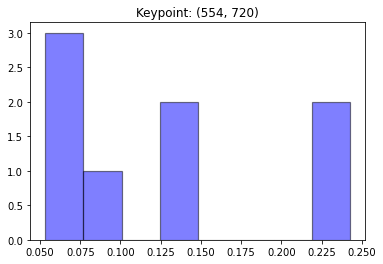

[0.24253674 0.06928279 0.05332776 0.13640738 0.05501319 0.13273495
 0.08842237 0.22227482]


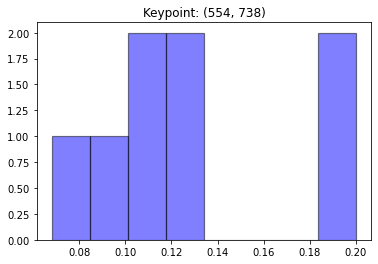

[0.06807954 0.11926451 0.10631543 0.10731295 0.18549623 0.12845717
 0.08498154 0.20009262]


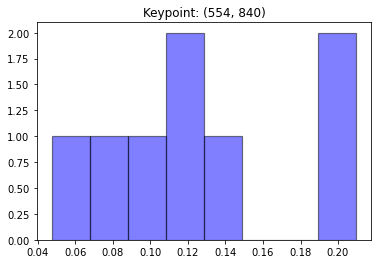

[0.04750756 0.11466299 0.09904132 0.20964557 0.20964557 0.13002043
 0.11695446 0.0725221 ]


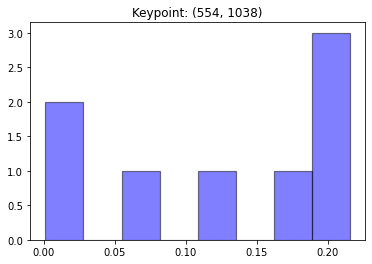

[0.21563039 0.00197609 0.00123142 0.06736233 0.18092625 0.19090877
 0.21563039 0.12633437]


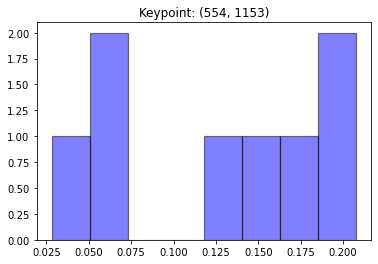

[0.05919644 0.13140355 0.18108938 0.20766666 0.19153138 0.05783148
 0.02819384 0.14308727]


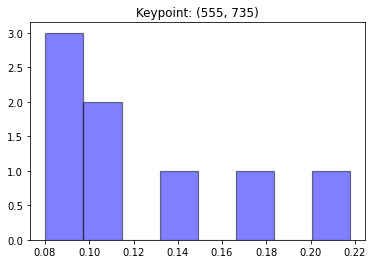

[0.08019031 0.13900207 0.10921341 0.08412312 0.18225888 0.1037929
 0.08368719 0.21773211]


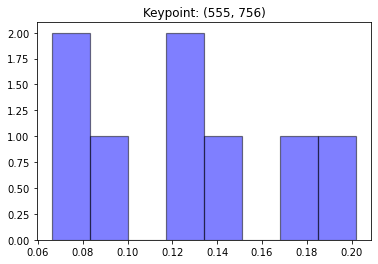

[0.06615468 0.18299935 0.09041936 0.20201278 0.13710879 0.12559829
 0.12123128 0.07447548]


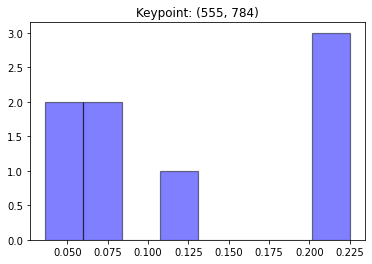

[0.11857982 0.22499324 0.22499324 0.06577413 0.04244708 0.03638362
 0.06183561 0.22499324]


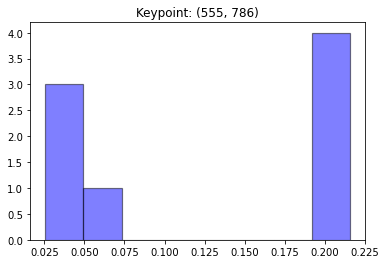

[0.19757377 0.21551399 0.20543181 0.05636807 0.02567795 0.04057222
 0.0433482  0.21551399]


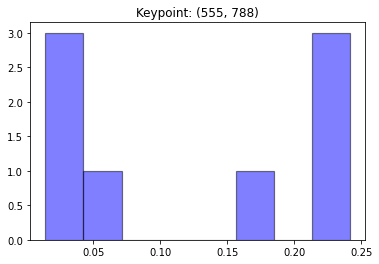

[0.24129871 0.24129871 0.16061697 0.02904237 0.01445589 0.0285871
 0.04340155 0.24129871]


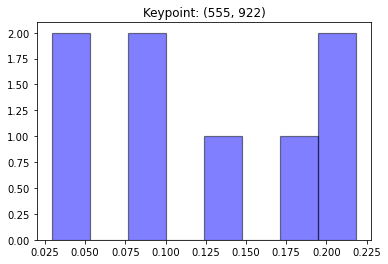

[0.13788874 0.1865235  0.21852228 0.04222025 0.08246989 0.21852228
 0.08462517 0.0292279 ]


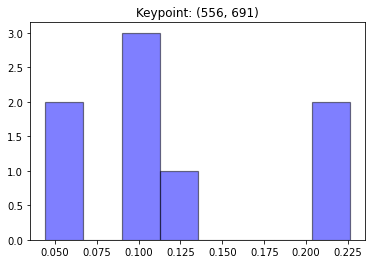

[0.11233749 0.12403913 0.10192725 0.04449898 0.10488992 0.06147863
 0.22486367 0.22596494]


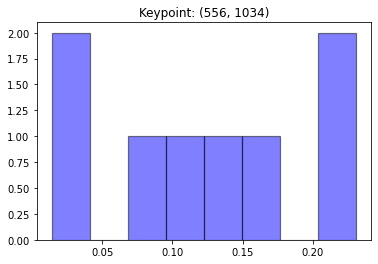

[0.23099834 0.0150812  0.01406165 0.17396695 0.22864284 0.07223842
 0.11564008 0.14937051]


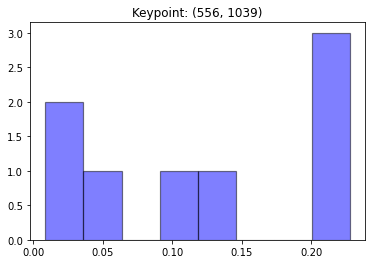

[0.22753895 0.00865821 0.02085388 0.05636654 0.14135184 0.20294643
 0.22753895 0.11474521]


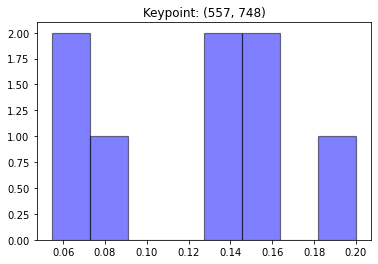

[0.16368265 0.0784406  0.05458677 0.16152182 0.139586   0.14420746
 0.05786049 0.20011422]


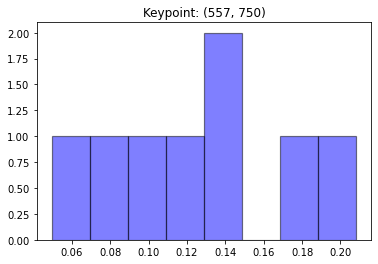

[0.17728894 0.07780208 0.04952903 0.2081837  0.13821399 0.13464816
 0.09005782 0.12427628]


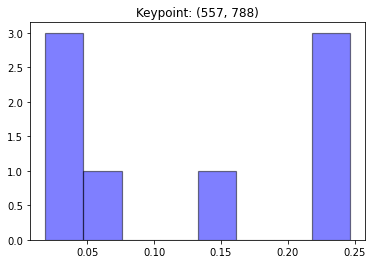

[0.2464383  0.2464383  0.14358595 0.02293072 0.02075704 0.01869136
 0.05472004 0.2464383 ]


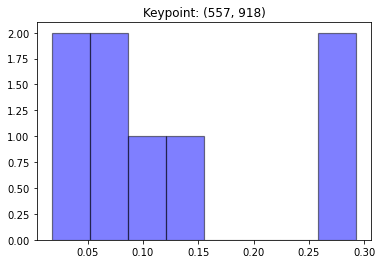

[0.12687621 0.29279093 0.29279093 0.07828137 0.07348645 0.09331617
 0.02481873 0.0176392 ]


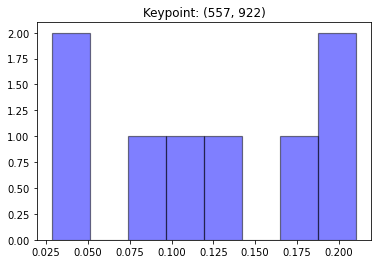

[0.13204585 0.21053144 0.21053144 0.11320324 0.08330624 0.18242814
 0.03961968 0.02833398]


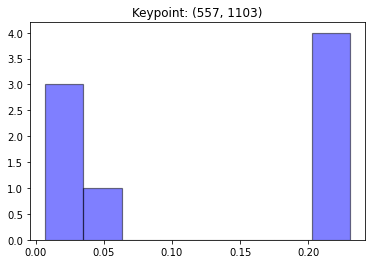

[0.04302308 0.00701046 0.01272383 0.01488659 0.23058901 0.23058901
 0.23058901 0.23058901]


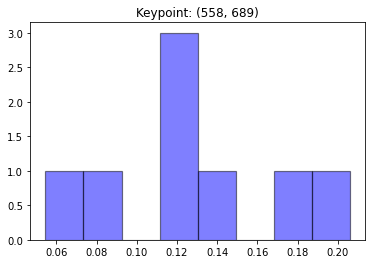

[0.14133356 0.11946617 0.11689179 0.05454192 0.11255844 0.0807226
 0.16857291 0.20591262]


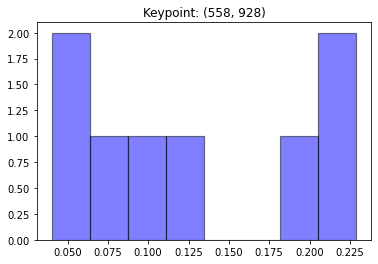

[0.07278508 0.04023022 0.0886963  0.1930964  0.21110316 0.22889497
 0.11230997 0.05288389]


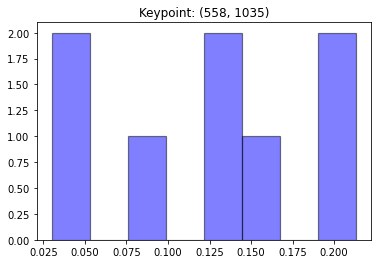

[0.21321678 0.03013608 0.05139858 0.15869072 0.21321678 0.08001094
 0.12404386 0.12928625]


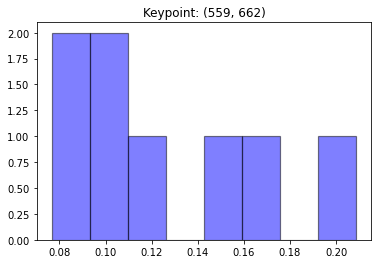

[0.10000894 0.20868044 0.09537585 0.14731774 0.17422121 0.07665823
 0.11401148 0.08372611]


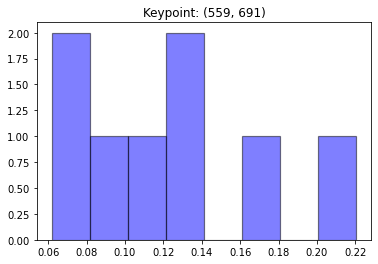

[0.08507472 0.13384149 0.12818956 0.06188517 0.11869754 0.07840864
 0.17351476 0.22038813]


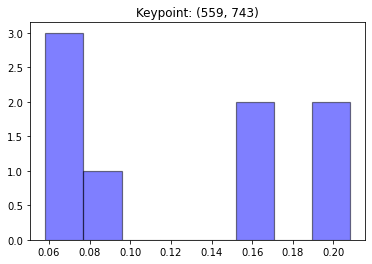

[0.06523056 0.0924782  0.05914501 0.05823056 0.15204276 0.20804368
 0.20804368 0.15678556]


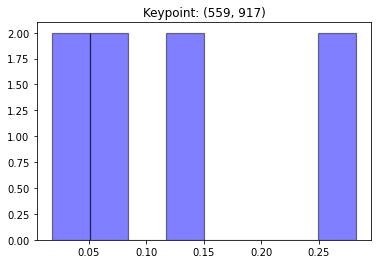

[0.14827057 0.28232142 0.28232142 0.05829428 0.0625834  0.126069
 0.02225817 0.01788175]


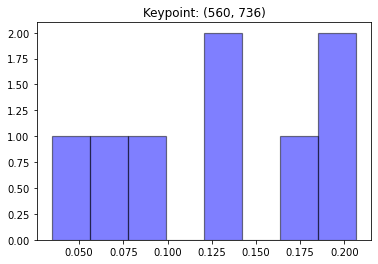

[0.08024575 0.12193665 0.07429065 0.03448156 0.12538595 0.1689472
 0.18803265 0.20667959]


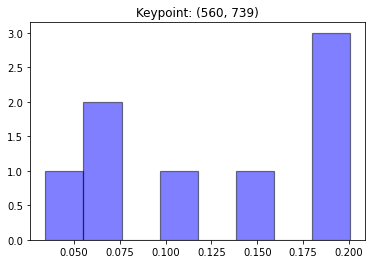

[0.06579032 0.10034994 0.06329984 0.03434684 0.1510893  0.19126751
 0.2004956  0.19336065]


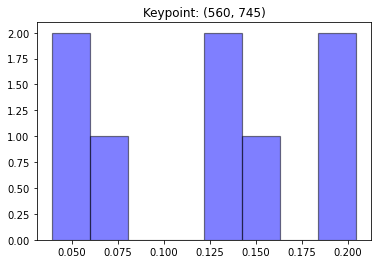

[0.04905702 0.07973254 0.03889354 0.13782623 0.1547007  0.19330784
 0.2045517  0.14193043]


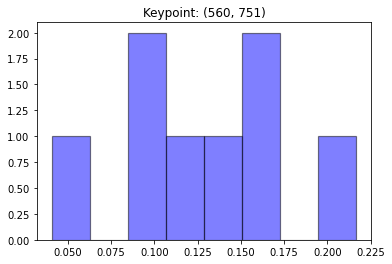

[0.15564572 0.04075537 0.13224701 0.21658622 0.15233396 0.08654374
 0.11422787 0.10166011]


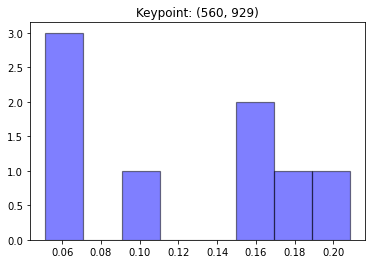

[0.06819743 0.11023079 0.15498988 0.17607933 0.16461393 0.20845697
 0.0660442  0.05138746]


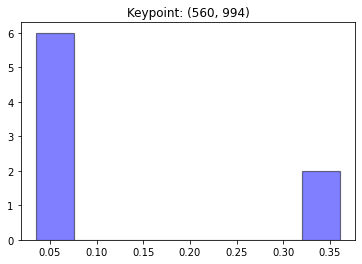

[0.36094215 0.36094215 0.05268937 0.04699677 0.05250508 0.03487502
 0.04642404 0.0446254 ]


[0.18806958 0.0405479  0.11069532 0.20788239 0.20788239 0.04597269
 0.06784897 0.13110076]


[0.0101121  0.         0.00252622 0.01298681 0.2111676  0.25440243
 0.25440243 0.25440243]


[0.17428826 0.13525021 0.07632746 0.0923902  0.13343726 0.22834377
 0.09606442 0.06389842]


[0.053338   0.19104125 0.16667102 0.17903348 0.17588879 0.19812642
 0.03436024 0.00154082]


[0.05522203 0.2083362  0.10179624 0.14394657 0.2083362  0.07538213
 0.13642778 0.07055286]


[0.13194335 0.14800549 0.12967046 0.06754516 0.12526663 0.06587985
 0.12904157 0.20264749]


[0.0927187  0.11867629 0.1029108  0.07884487 0.13479221 0.08707904
 0.1558195  0.2291586 ]


[0.09437044 0.11524716 0.05834152 0.04927777 0.14720109 0.20648465
 0.20648465 0.12259271]


[0.25199916 0.25199916 0.1723994  0.01035359 0.00164861 0.00555898
 0.08675248 0.21928862]


[0.14384314 0.26988572 0.1384275  0.06931545 0.09698243 0.18352687
 0.0389892  0.0590297 ]


[0.09654347 0.21925574 0.17695401 0.16649268 0.1171382  0.11089884
 0.04518799 0.06752906]


[0.34350008 0.34350008 0.11576196 0.05322435 0.04740545 0.02232552
 0.04402837 0.03025419]


[0.23769172 0.13330982 0.0453701  0.005236   0.0342198  0.06878912
 0.23769172 0.23769172]


[0.15113926 0.13281641 0.07383331 0.02504475 0.06405394 0.16438938
 0.17912063 0.20960232]


[0.11977531 0.11301086 0.0772964  0.03443525 0.08601909 0.18577564
 0.19847073 0.18521673]


[0.14671638 0.23046603 0.21295288 0.14168343 0.05209912 0.0441651
 0.02914111 0.14277593]


[0.1835316  0.14142962 0.16545885 0.14670113 0.07058813 0.04557217
 0.07669764 0.17002086]


[0.14613052 0.04598629 0.1024997  0.19465646 0.20775849 0.10091099
 0.12165769 0.08039986]


[0.20181253 0.14865306 0.127584   0.19775916 0.08590724 0.0674639
 0.0652559  0.10556421]


[0.26696969 0.26696969 0.16516281 0.00644285 0.00114515 0.00841474
 0.08134493 0.20355014]


[0.24790888 0.24790888 0.15914507 0.00748018 0.00383013 0.00811313
 0.08826384 0.23734989]


[0.10809053 0.23543738 0.23543738 0.13293537 0.06024969 0.0646286
 0.04819802 0.11502304]


[0.08616515 0.24147534 0.24147534 0.13140694 0.0910179  0.0894636
 0.04197808 0.07701766]


[0.18570894 0.12438725 0.17107802 0.08239282 0.0468125  0.08127407
 0.100774   0.2075724 ]


[0.22492893 0.22492893 0.18698165 0.03521464 0.00623769 0.02349539
 0.08781118 0.21040159]


[0.13697592 0.23345591 0.23345591 0.10593483 0.04450276 0.03306548
 0.04331841 0.16929078]


[0.25873369 0.17193851 0.08413757 0.00775003 0.         0.00722211
 0.21148439 0.25873369]


[0.09175348 0.09694303 0.09244363 0.03844195 0.20781106 0.20781106
 0.20275473 0.06204104]


[0.09297157 0.08563981 0.10482335 0.08560533 0.20155319 0.17807552
 0.19489044 0.05644079]


[0.22230913 0.19733302 0.05332295 0.0332188  0.08737115 0.05443478
 0.15008514 0.20192504]


[0.22652872 0.18320959 0.05945742 0.02357439 0.07937682 0.05442032
 0.16249426 0.21093849]


[0.24918329 0.24918329 0.13824752 0.00704458 0.00761267 0.01132884
 0.08821652 0.24918329]


[0.25561168 0.30932567 0.30932567 0.04256056 0.         0.01629524
 0.02912973 0.03775146]


[0.23946838 0.23946838 0.16793225 0.02782825 0.00613744 0.00791093
 0.07178598 0.23946838]


[0.12858654 0.06514016 0.08061732 0.02446507 0.19431068 0.2067621
 0.2067621  0.09335604]


[0.09859029 0.06241675 0.13913802 0.07539668 0.22037342 0.15659647
 0.16782025 0.07966812]


[0.15385225 0.07769633 0.17072015 0.10471316 0.21304677 0.09128757
 0.10830943 0.08037433]


[0.21858609 0.1811272  0.06119117 0.08289716 0.11048076 0.05150938
 0.09639374 0.19781452]


[0.23609518 0.1510157  0.04550132 0.05322222 0.09309019 0.05822376
 0.13694507 0.22590656]


[0.22445077 0.30693494 0.30693494 0.0776445  0.         0.03040388
 0.02196901 0.03166196]


[0.03671308 0.07328392 0.04021215 0.1044225  0.14918294 0.14112658
 0.22752942 0.22752942]


[0.0403152  0.09114312 0.05302118 0.12464473 0.12041275 0.14127223
 0.20799466 0.22119613]


[0.08627925 0.07168348 0.09675329 0.05547495 0.23204611 0.23204611
 0.17442164 0.05129517]


[0.1084811  0.06871991 0.12384016 0.07387529 0.2120784  0.19892114
 0.17784288 0.03624112]


[0.21363795 0.08823638 0.18035215 0.07739681 0.07018298 0.07296418
 0.0835916  0.21363795]


[0.21641075 0.1226809  0.20073904 0.06719468 0.04923292 0.06168871
 0.06564225 0.21641075]


[0.07092106 0.05895905 0.15636028 0.11495374 0.2124408  0.15349942
 0.1292951  0.10357054]


[0.20719478 0.15284954 0.08272816 0.10246521 0.11090273 0.07972833
 0.07421435 0.1899169 ]


[0.22696448 0.17260588 0.05461467 0.08019774 0.10012902 0.0762969
 0.09772441 0.19146691]


[0.22169368 0.19444858 0.17684414 0.05742304 0.04089317 0.03506311
 0.05194061 0.22169368]


[0.21914664 0.17842489 0.10095035 0.03940724 0.00594614 0.0088779
 0.21830189 0.22894495]


[0.01188574 0.14039254 0.22164108 0.19346487 0.1107035  0.1555039
 0.15648386 0.00992451]


[0.12835321 0.06185915 0.04309185 0.02538589 0.15618097 0.2119085
 0.20781701 0.16540342]


[0.13092053 0.08471129 0.05316237 0.0203357  0.16974496 0.22338217
 0.20037546 0.11736751]


[0.22543096 0.21689631 0.07086127 0.07562175 0.10066799 0.06674736
 0.06738701 0.17638735]


[0.23060984 0.17769321 0.10073963 0.04755512 0.01565482 0.02577344
 0.17136411 0.23060984]


[0.13924293 0.0614544  0.03849058 0.08378915 0.05859585 0.20673452
 0.21328422 0.19840835]


[0.11535312 0.04888131 0.05022754 0.0794885  0.13730092 0.20467816
 0.20467816 0.15939228]


[0.12755761 0.14002946 0.1704985  0.06421322 0.06201298 0.07356762
 0.18854895 0.17357165]


[0.20870373 0.17522167 0.13233387 0.10831698 0.10642912 0.08445808
 0.06250433 0.12203223]


[0.21692468 0.21074581 0.13326775 0.09186142 0.09851855 0.07182725
 0.04890046 0.12795407]


[0.25356863 0.17805584 0.09131573 0.04191538 0.00255893 0.01653841
 0.16247845 0.25356863]


[0.09081092 0.03809394 0.10409463 0.056561   0.13384041 0.20569882
 0.20924585 0.16165442]


[0.17440818 0.1454428  0.13876288 0.06676098 0.09188455 0.05079358
 0.17199558 0.15995146]


[0.12040537 0.20042897 0.13196701 0.06750748 0.12330074 0.05623757
 0.12346527 0.17668759]


[0.2185264  0.17464704 0.10515444 0.11161686 0.0646433  0.07584202
 0.06236321 0.18720673]


[0.17712183 0.17118741 0.147232   0.07777192 0.12580954 0.06277834
 0.08535476 0.1527442 ]


[0.16359589 0.08840765 0.11529142 0.18599075 0.08078765 0.04672915
 0.11267796 0.20651954]


[0.0506872  0.06899374 0.11349813 0.07518701 0.16189046 0.24467517
 0.19134429 0.093724  ]


[0.23443619 0.22672427 0.10005696 0.01627639 0.01982724 0.01269357
 0.15554918 0.23443619]


[0.05614991 0.05981467 0.10801486 0.11103522 0.16806966 0.24137071
 0.15308507 0.1024599 ]


[0.13732738 0.07547146 0.11605356 0.14277787 0.13856935 0.05589479
 0.12658238 0.20732323]


[0.13526939 0.08798249 0.12157851 0.16344567 0.14106378 0.05386297
 0.09579616 0.20100103]


[0.24303306 0.24303306 0.12594754 0.07497172 0.1273216  0.0328937
 0.0555121  0.09728722]


[0.10342693 0.25598178 0.25598178 0.04824312 0.04731744 0.
 0.13008337 0.15896557]


[0.04296316 0.09283372 0.30648223 0.1814622  0.01155894 0.10651615
 0.19893571 0.05924789]


[0.18509059 0.19619832 0.03917374 0.01675276 0.01680143 0.04300769
 0.25148773 0.25148773]


[0.20065901 0.12710088 0.03501436 0.01574053 0.00874819 0.05694876
 0.27789413 0.27789413]


[0.07391448 0.04953346 0.13798601 0.04261883 0.1287379  0.24514945
 0.24514945 0.07691043]


[0.22828903 0.16924858 0.1769185  0.05288569 0.03758095 0.03904997
 0.06773824 0.22828903]


[0.13845444 0.22625675 0.22625675 0.06212907 0.05159122 0.00785988
 0.12815067 0.15930122]


[0.03145435 0.07591651 0.26768946 0.22530452 0.03815045 0.0989056
 0.21544315 0.04713597]


[0.08009098 0.08022157 0.11329611 0.08637796 0.14250531 0.21633247
 0.16720312 0.11397248]


[0.09677912 0.0638497  0.09838386 0.21086359 0.21086359 0.16235923
 0.07989343 0.07700748]


[0.11597    0.0875276  0.14183623 0.20223909 0.14557466 0.07171824
 0.0914028  0.14373139]


[0.21499826 0.10339628 0.14783297 0.08929809 0.09915818 0.07319938
 0.06427463 0.20784222]


[0.22161394 0.1449357  0.22161394 0.04929589 0.03279364 0.04171651
 0.06641644 0.22161394]


[0.16907598 0.09658592 0.18016535 0.11334999 0.11702341 0.07951876
 0.08604627 0.15823432]


[0.24739617 0.11309977 0.06505144 0.07483563 0.04344079 0.04576104
 0.16301899 0.24739617]


[0.23379729 0.12501324 0.06645828 0.07932571 0.04195924 0.05061057
 0.16903838 0.23379729]


[0.07047795 0.08689973 0.08095294 0.15884183 0.17315069 0.20446837
 0.11428628 0.11092222]


[0.06288505 0.08932117 0.09163938 0.18144578 0.20458673 0.20458673
 0.09529039 0.07024475]


[0.20303171 0.08075118 0.18835393 0.1094488  0.10084869 0.08023225
 0.06609656 0.17123688]


[0.08823423 0.21215847 0.21215847 0.0799722  0.18323254 0.17677091
 0.04366239 0.00381077]


[0.10678214 0.07327691 0.28554223 0.20960392 0.07640789 0.09393732
 0.11476662 0.03968297]


[0.111157   0.07623194 0.12113546 0.18799228 0.20030877 0.12641312
 0.06906729 0.10769413]


[0.2167876  0.20292956 0.07529695 0.15964737 0.18677233 0.03814105
 0.05550452 0.06492063]


[0.20532762 0.14147983 0.07521617 0.21166717 0.21166717 0.01939908
 0.04581665 0.08942632]


[0.1493258  0.15995423 0.09796111 0.20446059 0.20446059 0.01768435
 0.046545   0.11960834]


[0.10258573 0.14950103 0.12494229 0.20761699 0.20761699 0.03854443
 0.05523099 0.11396156]


[0.20899738 0.19465368 0.11706811 0.17272965 0.12124999 0.03006945
 0.06879479 0.08643695]


[0.16471131 0.17732053 0.17695221 0.19759252 0.06361311 0.02396457
 0.0582649  0.13758085]


[0.21027398 0.21027398 0.21027398 0.19821208 0.1000025  0.03661253
 0.00205264 0.03229832]


[0.24332017 0.18259532 0.17567597 0.05622066 0.06453113 0.05128547
 0.10234654 0.12402473]


[0.13563366 0.14675966 0.1736064  0.19894491 0.09005042 0.04603127
 0.07753712 0.13143656]


[0.039078   0.08037068 0.22870655 0.21148074 0.22585387 0.13498151
 0.04703559 0.03249307]


[0.22087392 0.22087392 0.22087392 0.1629422  0.09824952 0.04006337
 0.00356406 0.03255909]


[0.20826695 0.20826695 0.17649421 0.09136549 0.09702812 0.04466431
 0.08387598 0.09003799]


[0.14171278 0.1769842  0.16798629 0.17790539 0.09349147 0.05528424
 0.06395026 0.12268538]


[0.17080761 0.13952173 0.16796741 0.20122307 0.09116634 0.05361945
 0.05411251 0.12158189]


[0.03645206 0.07575651 0.21666229 0.21666229 0.13539724 0.13947392
 0.08193921 0.09765647]


[0.08411995 0.07033904 0.20196634 0.20557731 0.10587538 0.04837441
 0.07817026 0.20557731]


[0.03927852 0.07921788 0.1692653  0.2114349  0.10687082 0.07758193
 0.10491577 0.2114349 ]


[0.03609489 0.08435055 0.16815178 0.22274331 0.14956923 0.10881258
 0.11667359 0.11360407]


[0.04835737 0.1005194  0.15133031 0.17801439 0.20857347 0.16192968
 0.04713826 0.10413713]


[0.04604244 0.07598272 0.11819617 0.21951479 0.13374472 0.06193643
 0.12506792 0.21951479]


[0.06406434 0.10621791 0.06289777 0.17193817 0.2041981  0.18467173
 0.12979721 0.07621476]


[0.15105518 0.17659251 0.1170589  0.02750935 0.0357641  0.09698258
 0.20139299 0.19364439]


[0.01585277 0.09996601 0.23327399 0.23327399 0.19629049 0.16536737
 0.05597538 0.        ]


[0.11145418 0.07033729 0.17357175 0.20365901 0.12711077 0.09599485
 0.10985546 0.10801669]


[0.10074981 0.20028507 0.0955086  0.03282932 0.10122552 0.14855956
 0.19944744 0.12139468]


[0.20621602 0.04066579 0.00167879 0.02076797 0.12574389 0.19297445
 0.21067187 0.2012812 ]


[0.14915259 0.14257425 0.19739128 0.12711182 0.11112046 0.04902422
 0.10870399 0.11492138]


[0.1057245  0.13902357 0.20160836 0.19499653 0.11035722 0.06846413
 0.08055898 0.09926671]


[0.08045546 0.20537502 0.18723267 0.12034442 0.12347955 0.13192627
 0.07894204 0.07224456]


[0.08328962 0.05112414 0.04096028 0.04639164 0.15856056 0.22936522
 0.24694106 0.14336748]


[0.24065735 0.03594236 0.0070902  0.00726971 0.00987686 0.22061278
 0.24065735 0.23789337]


[0.21698192 0.14739822 0.05256179 0.06381215 0.08192152 0.04631548
 0.15982292 0.23118599]


[0.04548733 0.21887898 0.21887898 0.08514659 0.13947881 0.12414914
 0.08493905 0.08304111]


[0.08473628 0.06041248 0.03807502 0.01666542 0.16538261 0.20234724
 0.25613922 0.17624174]


[0.06870118 0.18762429 0.21997293 0.07867894 0.         0.01575364
 0.21997293 0.2092961 ]


[0.00819939 0.00085182 0.0774078  0.21070959 0.22664238 0.22664238
 0.22664238 0.02290425]


[0.1090382  0.09566241 0.05276716 0.0352021  0.169843   0.19856287
 0.23814331 0.10078095]


[0.09965941 0.06218505 0.0404677  0.0176378  0.15901859 0.18777048
 0.25002361 0.18323737]


[0.05442483 0.21786478 0.21786478 0.0722883  0.         0.01447406
 0.21786478 0.20521846]


[0.00889178 0.00814806 0.03159253 0.17670164 0.24731386 0.24731386
 0.24731386 0.03272441]


[0.25111127 0.19671122 0.06178077 0.03387789 0.00769918 0.03080412
 0.16690428 0.25111127]


[0.21279039 0.18453059 0.06324895 0.03524332 0.06055409 0.01805187
 0.21279039 0.21279039]


[0.28936274 0.14526453 0.01502619 0.01102836 0.01411538 0.28936274
 0.12607292 0.10976715]


[0.         0.00756506 0.07370898 0.25873988 0.11377692 0.25873988
 0.25873988 0.02872941]


[0.22232931 0.13915054 0.02991786 0.02286316 0.01125451 0.129826
 0.22232931 0.22232931]


[0.13483834 0.01970547 0.00732881 0.00106383 0.09533515 0.28956836
 0.28956836 0.16259168]


[0.14383671 0.16205747 0.07925098 0.21001222 0.05692058 0.04612699
 0.17190461 0.12989043]


[0.20054546 0.2340182  0.1626797  0.15158845 0.08271803 0.05900155
 0.02488406 0.08456455]


[0.1993474  0.24773312 0.24773312 0.15788363 0.0499747  0.03981746
 0.00292306 0.05458751]


[0.12540962 0.11350778 0.20345898 0.13047807 0.06945887 0.08922148
 0.14073414 0.12773107]


[0.11028449 0.1709314  0.20028762 0.19589782 0.05073529 0.05679445
 0.10552125 0.10954768]


[0.15358435 0.21751366 0.21221127 0.20472487 0.05953273 0.05246444
 0.02491763 0.07505104]


[0.08444671 0.         0.         0.         0.0680192  0.28251136
 0.28251136 0.28251136]


[0.22661167 0.22661167 0.04856523 0.02943829 0.00420965 0.08119448
 0.15675736 0.22661167]


[0.15797306 0.24959394 0.06351897 0.03151667 0.06629378 0.24959394
 0.09505849 0.08645114]


[0.1089246  0.00638587 0.00779743 0.         0.02324511 0.28888712
 0.27587274 0.28888712]


[0.13849453 0.09294057 0.1578062  0.22547232 0.         0.05096743
 0.18503826 0.1492807 ]


[0.08099105 0.0965637  0.18553252 0.21292322 0.03428544 0.
 0.21163876 0.17806531]


[0.07874151 0.00927068 0.08393888 0.12239313 0.20554208 0.17465295
 0.20554208 0.11991868]


[0.08238633 0.03513981 0.18071621 0.10717764 0.1975071  0.12120228
 0.16493342 0.11093721]


[0.05023991 0.16595409 0.20415756 0.11779693 0.16882674 0.19652147
 0.08873883 0.00776447]


[0.05907313 0.03436359 0.08521277 0.22808063 0.19312563 0.22808063
 0.12296296 0.04910065]


[0.         0.08283827 0.13017884 0.22900868 0.09290853 0.22323642
 0.22900868 0.01282058]


[0.03975268 0.06397353 0.11260334 0.22210317 0.22210317 0.17229086
 0.11440463 0.05276862]


[0.11185308 0.20418515 0.21232098 0.21232098 0.11202411 0.08430986
 0.02445153 0.03853431]


[0.04149464 0.03416863 0.1432882  0.2469371  0.2469371  0.12766899
 0.11458207 0.04492326]


[0.1742137  0.21424691 0.21424691 0.09802567 0.01181927 0.01494817
 0.12913687 0.1433625 ]


[0.23752973 0.12124986 0.00404412 0.00152886 0.00182529 0.14042164
 0.24670025 0.24670025]


[0.23102598 0.20893748 0.01611976 0.00747751 0.         0.07438732
 0.23102598 0.23102598]


[0.00287206 0.0799709  0.12937253 0.19407442 0.09589449 0.16852999
 0.21322525 0.11606036]


[0.18517767 0.22140585 0.22140585 0.01639799 0.01056629 0.01292172
 0.15512288 0.17700176]


[0.02341781 0.10058969 0.15013522 0.17564572 0.09686958 0.16635878
 0.20916512 0.07781807]


[0.01515596 0.09378994 0.12678514 0.12934752 0.08701016 0.19623267
 0.21839171 0.1332869 ]


[0.06025672 0.05501294 0.07170202 0.19349114 0.19098417 0.12033083
 0.14836636 0.15985582]


[0.0557741  0.11524597 0.14065257 0.12323775 0.11932436 0.16696833
 0.19044821 0.08834872]


[0.05077266 0.07066641 0.13270518 0.20929044 0.10539485 0.08073609
 0.15005824 0.20037614]


[0.18168895 0.29294227 0.00624013 0.01702995 0.02795641 0.29294227
 0.10631761 0.07488241]


[0.12010805 0.06724299 0.20757477 0.11336886 0.10890329 0.06765
 0.20757477 0.10757726]


[0.16430101 0.08246465 0.21381764 0.11946878 0.04169373 0.037271
 0.21381764 0.12716554]


[0.18795883 0.02947185 0.         0.03679252 0.05972004 0.21761485
 0.23422095 0.23422095]


[0.03384682 0.12112767 0.2816422  0.2816422  0.27011527 0.00439895
 0.00300058 0.00422631]


[0.21571782 0.09552728 0.14853327 0.06428806 0.0786795  0.17542512
 0.17672266 0.04510629]


[0.0018875  0.         0.         0.15359529 0.24338491 0.28632357
 0.28632357 0.02848516]


[0.05897808 0.21521878 0.11989842 0.14730372 0.15836333 0.1413086
 0.15892907 0.        ]


[0.04704554 0.22577476 0.12469158 0.13088303 0.06172476 0.13352736
 0.22577476 0.0505782 ]


[0.00983068 0.05056443 0.15930642 0.22831507 0.15867695 0.22831507
 0.13248307 0.03250831]


[0.24133657 0.1156769  0.24133657 0.18591692 0.16416249 0.
 0.         0.05157054]


[0.0236483  0.07103769 0.16786618 0.21801224 0.1316986  0.21801224
 0.1459122  0.02381254]


[0.06671253 0.22335539 0.15035887 0.13534632 0.06382966 0.07356344
 0.21778834 0.06904546]


[0.18098824 0.21137565 0.22032561 0.21945538 0.01931143 0.00178503
 0.01096615 0.13579252]


[0.17780948 0.19166284 0.22851412 0.22851412 0.02683259 0.
 0.         0.14666685]


[0.06996385 0.00411629 0.00374492 0.009193   0.14230678 0.26807139
 0.26807139 0.23453237]


[0.2184664  0.20917904 0.07364911 0.0697941  0.05574645 0.2184664
 0.0941066  0.0605919 ]


[0.16154226 0.19259595 0.24440408 0.24440408 0.01623868 0.
 0.         0.14081495]


[0.08071444 0.14769143 0.14139924 0.1319058  0.09599039 0.16495255
 0.08644613 0.1509    ]


[0.24912963 0.27944104 0.         0.         0.         0.01368923
 0.17829905 0.27944104]


[0.05809341 0.15159722 0.16185769 0.1659051  0.10759384 0.19483298
 0.06375098 0.09636877]


[0.23842539 0.18355666 0.01572457 0.         0.         0.12365344
 0.20021456 0.23842539]


[0.27482432 0.09976819 0.10039156 0.00907391 0.00335357 0.
 0.27482432 0.23776413]


[0.2720821  0.1669747  0.01506587 0.         0.         0.09734137
 0.17645385 0.2720821 ]


[0.00754245 0.04085466 0.01581703 0.08581687 0.2160367  0.26506778
 0.26506778 0.10379673]


[0.095508   0.20595967 0.15804807 0.04787367 0.05544589 0.16210855
 0.20655652 0.06849963]


[0.05420754 0.04286482 0.01557668 0.08451283 0.23642781 0.23642781
 0.23642781 0.09355471]


[0.01563384 0.03265647 0.01647493 0.0840006  0.22120974 0.19180598
 0.22120974 0.2170087 ]


[0.1163561  0.15535703 0.15271338 0.08485136 0.130289   0.05449497
 0.20325288 0.10268529]


[0.04654309 0.02267063 0.01485851 0.09336248 0.23503165 0.23792426
 0.23792426 0.11168512]


[0.0790189  0.17386216 0.22513352 0.04713776 0.04398084 0.22785865
 0.14803249 0.05497568]


[0.08242122 0.20841221 0.11540735 0.06632721 0.11512594 0.20000955
 0.18410967 0.02818684]


[0.         0.21571323 0.13688937 0.1241087  0.13337525 0.21571323
 0.17139385 0.00280638]


[0.2302669  0.18987093 0.07169476 0.1402488  0.2302669  0.02730711
 0.04026946 0.07007514]


[0.05417148 0.01402207 0.0252334  0.08504405 0.13527848 0.25725865
 0.25725865 0.17173323]


[0.06898575 0.14469004 0.22857707 0.07425283 0.05720289 0.22857707
 0.16154915 0.03616521]


[0.06342687 0.03115653 0.02222558 0.09006662 0.16719453 0.25194721
 0.25194721 0.12203546]


[0.24627834 0.22068091 0.08712353 0.11725137 0.24627834 0.03956312
 0.02325511 0.01956929]


[0.19633909 0.02651413 0.16604251 0.2500668  0.01479551 0.02695614
 0.12307432 0.1962115 ]


[0.00511581 0.00330048 0.         0.00069624 0.29665171 0.29665171
 0.2467198  0.15086426]


[0.0041068  0.00694664 0.00560761 0.00683083 0.30886218 0.30886218
 0.1963756  0.16240816]


[0.05762629 0.04919233 0.2842215  0.25313356 0.28965605 0.03662507
 0.         0.02954521]


[0.06228221 0.04921751 0.21488384 0.28950829 0.30856496 0.04361088
 0.         0.03193231]


[0.25901951 0.16192936 0.00843483 0.         0.         0.
 0.28530815 0.28530815]


[0.06887508 0.20912656 0.11535553 0.13050347 0.16173576 0.07599605
 0.04081691 0.19759064]


[0.0493027  0.20474969 0.10669237 0.12500403 0.20216876 0.07922993
 0.0450378  0.18781473]


[0.05073664 0.13688706 0.02499303 0.05012259 0.22317573 0.17153875
 0.11937045 0.22317573]


[0.25364622 0.1282652  0.00714735 0.00535128 0.02325353 0.13620411
 0.24844409 0.19768821]


[0.084955   0.02033062 0.09597283 0.21500631 0.16769219 0.14512743
 0.05590931 0.21500631]


[0.08259288 0.05328762 0.08235377 0.18248407 0.2031465  0.1005912
 0.09239746 0.2031465 ]


[0.10873005 0.03812986 0.0138542  0.00848545 0.2217688  0.2217688
 0.16549405 0.2217688 ]


[0.00248063 0.00930746 0.09607254 0.2414985  0.2414985  0.17436859
 0.12718356 0.10759021]


[0.24467373 0.14791569 0.         0.         0.         0.15820729
 0.24467373 0.20452956]


[0.10747093 0.25521445 0.19924788 0.05473517 0.03728796 0.03749586
 0.25521445 0.05333332]


[0.03796277 0.09416757 0.10511653 0.13691838 0.1944915  0.13505325
 0.25403989 0.04225009]


[0.16039053 0.05667851 0.05824448 0.0837053  0.09870087 0.05476599
 0.24375717 0.24375717]


[0.20457531 0.06228621 0.05258122 0.06949207 0.09471438 0.03242349
 0.24196366 0.24196366]


[0.         0.10723073 0.22937959 0.09752051 0.10848571 0.11981033
 0.22937959 0.10819354]


[0.         0.1034904  0.17086738 0.1410759  0.11826258 0.12462765
 0.21685866 0.12481744]


[0.01149005 0.00563892 0.01009968 0.03399088 0.24702281 0.24702281
 0.24702281 0.19771205]


[0.13639058 0.20550957 0.15735286 0.15934457 0.17775184 0.15929023
 0.         0.00436035]


[0.06371629 0.16594085 0.16582629 0.09812683 0.20891433 0.16642734
 0.05216116 0.07888691]


[0.14353669 0.10034647 0.02172314 0.03787234 0.1875549  0.22512255
 0.09674679 0.18709711]


[0.15349549 0.25758127 0.25758127 0.25758127 0.05898855 0.
 0.         0.01477215]


[0.08624988 0.0086931  0.08702199 0.22618739 0.18916095 0.13729857
 0.19062818 0.07475995]


[0.07890344 0.00598543 0.08440576 0.20655899 0.1921166  0.17863912
 0.17331822 0.08007243]


[0.21936515 0.19185832 0.21936515 0.12737852 0.08471533 0.06740994
 0.02280614 0.06710146]


[0.04668022 0.03677084 0.09884911 0.17608913 0.2413092  0.2413092
 0.08551795 0.07347434]


[0.10921215 0.05011128 0.06789724 0.14227714 0.20620911 0.16810764
 0.13431441 0.12187103]


[0.07543472 0.02350559 0.07007737 0.21861964 0.21861964 0.16164708
 0.15974263 0.07235333]


[0.10069254 0.03011882 0.06104339 0.13217919 0.23459827 0.16775858
 0.12531326 0.14829595]


[0.11581638 0.04390373 0.07221104 0.15504032 0.24453442 0.20267398
 0.05920998 0.10661016]


[0.21727764 0.10498086 0.21727764 0.14712274 0.10344774 0.08951688
 0.01628328 0.10409321]


[0.0903619  0.07473199 0.19852127 0.06664449 0.10833259 0.19781161
 0.12139939 0.14219676]


[0.05741601 0.04080081 0.12174538 0.20948949 0.14332043 0.00824891
 0.20948949 0.20948949]


[0.19374736 0.07058046 0.20883914 0.18401832 0.15109773 0.08182297
 0.01536551 0.09452851]


[0.07402846 0.048771   0.14853895 0.2044895  0.06888379 0.01651912
 0.21938459 0.21938459]


[0.24734643 0.02900605 0.00170207 0.00303657 0.02715951 0.24734643
 0.19705652 0.24734643]


[0.08749265 0.21265236 0.13578312 0.18594787 0.21265236 0.05665251
 0.05733307 0.05148607]


[0.10580787 0.1268707  0.01257145 0.         0.02651364 0.24281426
 0.24260781 0.24281426]


[0.10692182 0.21284876 0.11709743 0.19133999 0.21284876 0.06622523
 0.04887522 0.0438428 ]


[0.10412396 0.11866387 0.0144187  0.         0.01404657 0.2495823
 0.2495823  0.2495823 ]


[0.00669107 0.00555031 0.03359884 0.11293348 0.34829258 0.34829258
 0.12059421 0.02404693]


[0.22129149 0.07869993 0.010493   0.00353825 0.03471528 0.22129149
 0.22129149 0.20867905]


[0.14460874 0.04601896 0.00451503 0.12847989 0.21271514 0.16133238
 0.17986858 0.12246129]


[0.12595003 0.15342027 0.15126998 0.20642661 0.20190017 0.04075536
 0.06881012 0.05146746]


[0.12177928 0.18945373 0.15811939 0.21248335 0.1887102  0.03888327
 0.0447     0.04587079]


[0.12338279 0.19493792 0.11687144 0.210376   0.20257505 0.03678039
 0.06680126 0.04827515]


[0.01619855 0.00967982 0.11721455 0.11468666 0.31063059 0.31063059
 0.10383688 0.01712237]


[0.10939608 0.21416799 0.18605536 0.21416799 0.14737111 0.03692142
 0.04382415 0.04809588]


[0.07525637 0.18975919 0.20583442 0.21167002 0.15930051 0.03505154
 0.06296875 0.06015921]


[0.11535959 0.19230877 0.16079534 0.22171715 0.15969265 0.04940026
 0.06478337 0.03594287]


[0.01086989 0.00387322 0.14221364 0.23531713 0.28126377 0.28126377
 0.04440714 0.00079143]


[0.1279717  0.18805554 0.14108576 0.21953306 0.13816815 0.07629094
 0.07213684 0.03675801]


[0.22807755 0.13864391 0.0116181  0.         0.02909008 0.24527812
 0.24527812 0.10201411]


[0.00957719 0.00240188 0.12489767 0.2309459  0.28894758 0.28894758
 0.04396669 0.01031551]


[0.         0.         0.00098184 0.11677968 0.33669895 0.32179805
 0.22122999 0.00251148]


[0.0889275  0.14236535 0.13019081 0.21280397 0.17294242 0.0990707
 0.11652137 0.03717787]


[0.0497858  0.08910627 0.04424164 0.22863221 0.22863221 0.18471003
 0.16601984 0.008872  ]


[0.00237674 0.01028943 0.03066998 0.25543328 0.32385913 0.32385913
 0.04320407 0.01030824]


[0.04987927 0.18292797 0.12072507 0.15657705 0.1373547  0.30118817
 0.02266946 0.02867831]


[0.12196991 0.         0.         0.         0.21163799 0.20622372
 0.22791794 0.23225045]


[0.         0.00856036 0.03361513 0.24031926 0.3184426  0.3184426
 0.07059076 0.0100293 ]


[0.03866546 0.17178966 0.15167206 0.20884761 0.12711449 0.24776969
 0.02278722 0.03135381]


[0.04947017 0.0383995  0.08421493 0.17660509 0.22837442 0.22837442
 0.12902322 0.06553824]


[0.12966528 0.         0.         0.         0.19366828 0.21677037
 0.22994803 0.22994803]


[0.00422673 0.01513816 0.01130413 0.26324731 0.26324731 0.23625499
 0.18802994 0.01855143]


[0.04464396 0.         0.         0.00641767 0.22397383 0.24165485
 0.24165485 0.24165485]


[0.0229701  0.04275774 0.01914784 0.18261715 0.26765574 0.26765574
 0.17719499 0.0200007 ]


[0.00538953 0.02353355 0.01369497 0.25750636 0.25750636 0.24657244
 0.17619746 0.01959934]


[0.         0.         0.         0.00207437 0.25232442 0.30289552
 0.30289552 0.13981018]


[0.008743   0.00119282 0.00355743 0.07415719 0.25992619 0.25992619
 0.25992619 0.13257098]


[0.05914664 0.17977225 0.05308514 0.13656108 0.14767182 0.22907427
 0.17061098 0.02407783]


[0.00964182 0.         0.         0.         0.25580328 0.2867675
 0.2867675  0.16101989]


[0.01823767 0.09528988 0.09924553 0.16031869 0.22742806 0.15234474
 0.19230697 0.05482845]


[0.01053439 0.         0.         0.00242792 0.28514031 0.28514031
 0.28514031 0.13161677]


[0.11677443 0.2060743  0.03247639 0.08573209 0.04879091 0.21936212
 0.19752338 0.09326638]


[0.03341306 0.10718352 0.12774922 0.19326587 0.20997984 0.09541522
 0.17078227 0.062211  ]


[0.21520114 0.18323805 0.17011659 0.1557604  0.14114741 0.
 0.         0.1345364 ]


[0.13286409 0.17329956 0.30353222 0.30353222 0.0867719  0.
 0.         0.        ]


[0.14709714 0.20449473 0.10196947 0.10031078 0.13873042 0.19117201
 0.09224829 0.02397716]


[0.01684054 0.00127727 0.         0.25143745 0.25143745 0.25143745
 0.11692163 0.11064821]


[0.19317711 0.18190724 0.2059255  0.17354619 0.13322869 0.
 0.         0.11221528]


[0.20346468 0.09796389 0.17483414 0.1606968  0.12140181 0.17300831
 0.02531094 0.04331943]


[0.22508509 0.22508509 0.17730645 0.22508509 0.12674884 0.
 0.         0.02068943]


[0.         0.00100125 0.         0.         0.16528081 0.27790598
 0.27790598 0.27790598]


[0.15152139 0.         0.         0.02314242 0.18381313 0.21192226
 0.23975578 0.18984503]


[0.18620322 0.01271431 0.         0.07023901 0.19723145 0.19278405
 0.20693253 0.13389544]


[0.06661744 0.03242013 0.07260467 0.11732195 0.23097512 0.05472336
 0.23097512 0.19436221]


[0.04294495 0.01394583 0.04328625 0.05464841 0.22337759 0.22337759
 0.22337759 0.17504178]


[0.19490515 0.01307621 0.         0.11004387 0.20645729 0.1855587
 0.15505084 0.13490793]


[0.21773174 0.01594703 0.00298825 0.04934939 0.21773174 0.16727991
 0.15047292 0.17849901]


[0.0067786  0.02782672 0.16583328 0.23330231 0.17430711 0.23330231
 0.15393508 0.0047146 ]


[0.07348997 0.03547685 0.07722064 0.12025403 0.22148267 0.02911051
 0.22148267 0.22148267]


[0.20749753 0.07219419 0.08135102 0.16903865 0.11439359 0.20749753
 0.04505148 0.10297601]


[0.20214272 0.06809778 0.04901888 0.11751921 0.08156933 0.19377464
 0.14782122 0.14005622]


[0.22284168 0.09595791 0.11260279 0.20550487 0.11794817 0.07183285
 0.03875986 0.13455188]


[0.02946687 0.04371311 0.08389371 0.14728438 0.24275951 0.24275951
 0.16681642 0.0433065 ]


[0.0334928  0.04727272 0.09334594 0.15395762 0.25554887 0.25554887
 0.10848757 0.05234562]


[0.00265833 0.00132502 0.00255387 0.26058968 0.26058968 0.12931811
 0.26058968 0.08237562]


[0.09331485 0.05442536 0.24604068 0.24604068 0.12539618 0.16708843
 0.03750742 0.03018641]


[0.09206733 0.         0.00101882 0.         0.05088521 0.28534288
 0.28534288 0.28534288]


[0.05752403 0.         0.         0.         0.05247143 0.29666818
 0.29666818 0.29666818]


[0.01944629 0.11267066 0.05442154 0.05612789 0.22730584 0.22730584
 0.21110307 0.09161887]


[0.05676838 0.04719146 0.24121865 0.24121865 0.15590135 0.17050298
 0.05733384 0.02986471]


[0.01873847 0.06357519 0.04051039 0.17019241 0.1983499  0.2073367
 0.2073367  0.09396024]


[0.01752325 0.11952784 0.05417736 0.04632585 0.24371066 0.24371066
 0.16718711 0.10783727]


[0.04367284 0.06618331 0.07254684 0.19227201 0.28069195 0.2915579
 0.02755886 0.02551629]


[0.04256955 0.09493856 0.08014748 0.22795827 0.17105882 0.2322325
 0.14132931 0.00976551]


[0.04056071 0.0785525  0.08654518 0.21623694 0.16985854 0.23004538
 0.13350677 0.04469397]


[0.01114067 0.00753235 0.02051441 0.21349839 0.21349839 0.21349839
 0.20803602 0.11228138]


[0.26004589 0.         0.         0.         0.04239359 0.17746874
 0.26004589 0.26004589]


[0.02606286 0.13106041 0.24248939 0.14008258 0.20119194 0.24248939
 0.01385089 0.00277253]


[0.22632064 0.         0.         0.         0.15282282 0.18304227
 0.21149363 0.22632064]


[0.01437055 0.07023006 0.06211837 0.14874752 0.22617628 0.28771801
 0.18933261 0.00130659]


[0.16501001 0.         0.         0.         0.15718705 0.2282362
 0.2282362  0.22133054]


[0.02136808 0.0814031  0.03819289 0.10828994 0.30053907 0.30053907
 0.14966785 0.        ]


[0.01560892 0.06909183 0.03965074 0.09864336 0.28788859 0.28788859
 0.1940984  0.00712956]


[0.16092101 0.         0.         0.         0.17764646 0.22893059
 0.22893059 0.20357134]


[0.05408363 0.04678624 0.11383934 0.14403192 0.10506836 0.27859322
 0.17228297 0.08531433]


[0.02146116 0.11641504 0.18831551 0.14042153 0.26515904 0.26515904
 0.         0.00306867]


[0.1548471  0.16343567 0.07630324 0.         0.03984798 0.20856716
 0.20856716 0.14843169]


[0.01783706 0.01951467 0.06663758 0.23478189 0.23478189 0.15126365
 0.23478189 0.04040137]


[0.04007492 0.08742935 0.17698219 0.2213114  0.21874591 0.2213114
 0.02817309 0.00597174]


[0.04274915 0.03973686 0.11878993 0.15538834 0.12396772 0.31363341
 0.13597291 0.06976168]


[0.11465714 0.17239124 0.07668103 0.         0.05421637 0.21614087
 0.21614087 0.14977248]


[0.12184899 0.18320446 0.08149084 0.         0.         0.22909509
 0.22909509 0.15526553]


[0.01478285 0.00970464 0.05265372 0.25039062 0.25039062 0.25039062
 0.1646044  0.00708254]


[0.02702974 0.11104673 0.14289437 0.13061158 0.28971829 0.28971829
 0.00562277 0.00335822]


[0.03001585 0.11338942 0.14389363 0.1079539  0.28561518 0.28561518
 0.02185958 0.01165725]


[0.08721061 0.1757581  0.095002   0.         0.00532934 0.23268982
 0.23268982 0.17132032]


[0.08714143 0.23767163 0.12916655 0.11875462 0.23767163 0.10397851
 0.03599954 0.04961608]


[0.02566231 0.01321301 0.04877187 0.26941322 0.26941322 0.1853235
 0.17767343 0.01052944]


[0.08947162 0.04059284 0.10117253 0.15658227 0.24253841 0.0836988
 0.04340512 0.24253841]


[0.02911879 0.02365012 0.04483407 0.28904407 0.28904407 0.16138789
 0.15600753 0.00691345]


[0.05103049 0.09120956 0.08794861 0.12073208 0.2814385  0.2814385
 0.07062104 0.01558121]


[0.0386331  0.01675163 0.01556534 0.0793727  0.19645239 0.31227951
 0.31227951 0.02866582]


[0.00569224 0.00731615 0.01245064 0.04023857 0.29167203 0.31948902
 0.31948902 0.00365232]


[0.17578971 0.23154347 0.16829158 0.23154347 0.05568218 0.01218719
 0.00045607 0.12450632]


[0.07360259 0.12913565 0.12499251 0.20416336 0.1618827  0.13011372
 0.11953041 0.05657906]


[0.05718386 0.12560078 0.11405454 0.17002507 0.20311215 0.20311215
 0.07725684 0.04965462]


[0.03554299 0.0434933  0.10201423 0.20183314 0.27860226 0.27860226
 0.05773202 0.0021798 ]


[0.02146202 0.02872995 0.07763084 0.14818331 0.21318183 0.21318183
 0.18934148 0.10828873]


[0.0159681  0.04308784 0.11353267 0.14736215 0.21090676 0.21090676
 0.1786541  0.07958162]


[0.07088292 0.16533096 0.16353845 0.10147615 0.20467491 0.13807725
 0.09446941 0.06154995]


[0.01876848 0.06343069 0.08247326 0.13664276 0.24678776 0.24678776
 0.2051093  0.        ]


[0.02257825 0.0557174  0.10885868 0.10801054 0.14992215 0.21385367
 0.21385367 0.12720564]


[0.01919111 0.07692248 0.16630001 0.06912447 0.12992752 0.21426615
 0.21426615 0.11000212]


[0.01086151 0.06486622 0.07097041 0.14569753 0.23586811 0.23586811
 0.23586811 0.        ]


[0.03374281 0.07124516 0.08022565 0.13824997 0.22500726 0.22500726
 0.22463359 0.0018883 ]


[0.00769498 0.05099336 0.09629078 0.11468588 0.17334351 0.22249171
 0.22249171 0.11200806]


[0.00763117 0.03323002 0.08760325 0.11108595 0.13469185 0.25116275
 0.25116275 0.12343225]


[0.00773221 0.02980512 0.07162948 0.13074982 0.20776098 0.22403203
 0.22403203 0.10425833]


[0.21912346 0.10886601 0.10624733 0.07337855 0.2158553  0.23875226
 0.0153178  0.02245929]


[0.22876429 0.11857733 0.11776174 0.04647623 0.18458436 0.22876429
 0.03005742 0.04501435]


[0.03343256 0.10213002 0.21572925 0.14498094 0.05591428 0.21572925
 0.19783101 0.03425267]


[0.00313833 0.00873662 0.0649825  0.15351617 0.22340783 0.22340783
 0.21643448 0.10637623]


[0.19195372 0.21096973 0.09265734 0.16395371 0.15871944 0.17384455
 0.00790151 0.        ]


[0.0735784  0.0701987  0.06580829 0.06020854 0.21615792 0.22115079
 0.20607171 0.08682566]


[0.16159802 0.22744651 0.22805489 0.02615584 0.02274236 0.01159679
 0.09205563 0.23034996]


[0.02059941 0.07024241 0.14150815 0.16997942 0.16422528 0.12873704
 0.2045862  0.10012209]


[0.11822186 0.07787513 0.06389676 0.22658787 0.18917589 0.01146532
 0.0861893  0.22658787]


[0.05918472 0.03091309 0.04884164 0.07255156 0.21681907 0.14633951
 0.21681907 0.20853134]


[0.30076883 0.02676226 0.         0.         0.         0.07881174
 0.30076883 0.29288833]


[0.02991567 0.07330008 0.12135735 0.16852838 0.15829256 0.10879782
 0.20077053 0.1390376 ]


[0.02325356 0.07400324 0.13242401 0.16879994 0.15245937 0.11261148
 0.20214265 0.13430576]


[0.03140081 0.06684418 0.13821056 0.22390537 0.24109538 0.24109538
 0.0416229  0.01582544]


[0.03512267 0.07575155 0.16393442 0.22939657 0.22939657 0.22939657
 0.01984289 0.01715875]


[0.02477656 0.0788501  0.13935564 0.17256113 0.20799348 0.15841083
 0.12559266 0.0924596 ]


[0.02713278 0.04367555 0.03402465 0.12383878 0.26412401 0.26412401
 0.13651021 0.10657002]


[0.01490025 0.01467282 0.02245043 0.08949294 0.26382942 0.26382942
 0.2163565  0.11446823]


[0.03557706 0.         0.         0.         0.24110573 0.24110573
 0.24110573 0.24110573]


[0.08182639 0.29171383 0.19310048 0.29171383 0.12340093 0.01824453
 0.         0.        ]


[0.22503327 0.14432769 0.22503327 0.22503327 0.13315287 0.
 0.         0.04741962]


[0.0733229  0.05276977 0.04668087 0.06292617 0.20283615 0.2166705
 0.22872942 0.11606423]


[0.07900011 0.06118766 0.01085787 0.06169149 0.13165286 0.24438312
 0.24438312 0.16684376]


[0.02506082 0.00849711 0.09290069 0.26842826 0.27484814 0.27484814
 0.04601551 0.00940135]


[0.10085586 0.         0.         0.         0.15769366 0.24715016
 0.24715016 0.24715016]


[0.02249192 0.02984899 0.12537076 0.2631896  0.2631896  0.2631896
 0.02511624 0.0076033 ]


[0.14351701 0.27229776 0.03958969 0.         0.         0.
 0.27229776 0.27229776]


[0.07098066 0.         0.         0.         0.15000465 0.25967156
 0.25967156 0.25967156]


[0.02384171 0.03807308 0.12040343 0.28252706 0.28252706 0.23520399
 0.0150693  0.00235437]


[0.26193617 0.05140321 0.09920168 0.12949372 0.26193617 0.07858749
 0.         0.11744156]


[0.11385234 0.2765138  0.05660627 0.         0.         0.
 0.2765138  0.2765138 ]


[0.         0.         0.24019224 0.28833309 0.28833309 0.13597758
 0.04716401 0.        ]


[0.24310315 0.04206834 0.08250897 0.09156747 0.24310315 0.2420742
 0.         0.05557471]


[0.04259896 0.         0.         0.         0.05292572 0.30149177
 0.30149177 0.30149177]


[0.00616578 0.         0.         0.         0.11400267 0.29327719
 0.29327719 0.29327719]


[0.04062064 0.         0.         0.         0.13289023 0.27549638
 0.27549638 0.27549638]


[0.04095252 0.         0.         0.         0.09481721 0.29869616
 0.29869616 0.26683795]


[0.1040154  0.11888099 0.2788194  0.01521549 0.         0.
 0.20424933 0.2788194 ]


[0.         0.         0.         0.         0.20001262 0.3093255
 0.3093255  0.18133637]


[0.         0.         0.08248575 0.2570271  0.2570271  0.2570271
 0.14643294 0.        ]


[0.         0.         0.01028127 0.1260559  0.27650054 0.10797289
 0.20268886 0.27650054]


[0.04831716 0.06853504 0.17284788 0.16590949 0.2087829  0.2087829
 0.06342655 0.06339807]


[0.07184541 0.09286498 0.14045265 0.14563918 0.191888   0.18861736
 0.09152116 0.07717126]


[0.03436534 0.03630951 0.21192879 0.21192879 0.13194252 0.1772862
 0.11148637 0.0847525 ]


[0.02515323 0.02562855 0.21234243 0.21234243 0.13240363 0.2079057
 0.10300577 0.08121826]


[0.03204472 0.03608046 0.20683908 0.16596677 0.11495078 0.20683908
 0.11329372 0.12398538]


[0.05976713 0.16160794 0.20725534 0.20765712 0.10216996 0.09029526
 0.06326706 0.10798019]


[0.03602827 0.14770768 0.22971032 0.22971032 0.22971032 0.04961056
 0.03169084 0.04583168]


[0.21768728 0.18267875 0.16921026 0.16633905 0.13867804 0.05280458
 0.         0.07260204]


[0.03261645 0.12442793 0.19300311 0.25449683 0.25449683 0.05161828
 0.03407526 0.05526532]


[0.03296144 0.20457026 0.18041785 0.21832293 0.21832293 0.05762292
 0.0389632  0.04881846]


[0.19925854 0.20284176 0.10330963 0.04587248 0.06111903 0.15235515
 0.08067082 0.15457259]


[0.22600681 0.22600681 0.09763113 0.21962177 0.22600681 0.00472666
 0.         0.        ]


[0.14257613 0.07861423 0.03253503 0.23028441 0.17713636 0.06573455
 0.09121693 0.18190237]


[0.14996793 0.14409144 0.14368863 0.21665851 0.16612861 0.08719043
 0.06227269 0.03000174]


[0.14790836 0.09107377 0.05480234 0.23714681 0.16657559 0.06172171
 0.06834977 0.17242165]


[0.17526333 0.00284385 0.0018325  0.23155682 0.14157886 0.10367208
 0.12622604 0.21702651]


[0.20901435 0.1392712  0.17116178 0.08307253 0.05263486 0.12707688
 0.10667108 0.11109731]


[0.1608827  0.14282085 0.18160665 0.11312595 0.08086415 0.11615865
 0.11234614 0.09219492]


[0.02892372 0.0007549  0.07394206 0.21110944 0.18650506 0.21110944
 0.17516648 0.1124889 ]


[0.25044281 0.01813322 0.25044281 0.14018584 0.02183324 0.02569107
 0.04282821 0.25044281]


[0.13935966 0.02556428 0.25738675 0.16596164 0.05094891 0.05546745
 0.04792457 0.25738675]


[0.14370977 0.25656623 0.04403293 0.25656623 0.08566233 0.07691005
 0.05324037 0.08331208]


[0.02050276 0.0058722  0.10959969 0.23302416 0.12085221 0.22711908
 0.23302416 0.05000574]


[0.00122278 0.13437758 0.22750852 0.22061161 0.22750852 0.18742211
 0.         0.00134889]


[0.2340645  0.11819551 0.09153332 0.21199778 0.08574811 0.2340645
 0.         0.02439629]


[0.04619876 0.0204289  0.01043249 0.03898096 0.2519502  0.14073363
 0.2519502  0.23932485]


[0.18225569 0.12123183 0.11171174 0.11850403 0.03335287 0.03155324
 0.19356448 0.20782613]


[0.15734263 0.04548755 0.0266854  0.04500707 0.07230787 0.26451515
 0.16957718 0.21907714]


[0.12084989 0.1424306  0.06557391 0.03962475 0.04358414 0.19715893
 0.21970811 0.17106967]


[0.07866481 0.15951749 0.07622156 0.04037309 0.06925449 0.21587658
 0.21621813 0.14387385]


[0.21113326 0.11011821 0.10567153 0.11995559 0.03581232 0.03674094
 0.1694349  0.21113326]


[0.06132553 0.24108322 0.08310155 0.04131333 0.07215106 0.07753722
 0.24108322 0.18240487]


[0.07627635 0.05605684 0.07894001 0.19066356 0.21194515 0.08157911
 0.13379337 0.17074561]


[0.1972991  0.22911397 0.04288771 0.01958352 0.03074997 0.06142935
 0.22911397 0.18982242]


[0.         0.         0.29707225 0.29707225 0.29707225 0.10878326
 0.         0.        ]


[0.03187    0.02223734 0.07994445 0.16268336 0.2222661  0.2222661
 0.15712452 0.10160812]


[0.10973995 0.06190934 0.06586381 0.12994388 0.17809877 0.14536531
 0.10874102 0.20033791]


[0.09666879 0.03495783 0.05087774 0.12510372 0.17021918 0.1665126
 0.15476224 0.2008979 ]


[0.08411341 0.27144863 0.0917193  0.         0.         0.27144863
 0.19617883 0.08509119]


[0.12089113 0.14968248 0.11879902 0.11838062 0.20099617 0.17344812
 0.06069073 0.05711172]


[0.08641686 0.10041502 0.26063274 0.26063274 0.09194586 0.10195658
 0.05496692 0.04303328]


[0.08530865 0.1005145  0.26870726 0.26870726 0.05402042 0.12214936
 0.06290966 0.0376829 ]


[0.00150836 0.07862728 0.26046046 0.26046046 0.26046046 0.10806127
 0.01884987 0.01157185]


[0.20203342 0.1287146  0.12223753 0.06831819 0.11571678 0.1619949
 0.19772865 0.00325593]


[0.03728203 0.0766876  0.25125877 0.21004305 0.22699157 0.09683886
 0.05480192 0.04609621]


[0.00120141 0.02935277 0.16322562 0.2376323  0.2376323  0.2376323
 0.08958574 0.00373755]


[0.01183653 0.0131886  0.17979441 0.23641976 0.19082634 0.23641976
 0.11906416 0.01245044]


[0.01263806 0.00123866 0.         0.09875856 0.29028105 0.2905826
 0.2905826  0.01591849]


[0.01480647 0.00261003 0.00225275 0.10736673 0.28485995 0.28485995
 0.28485995 0.01838416]


[0.32066748 0.06146671 0.11187232 0.06092854 0.02359302 0.049805
 0.05099945 0.32066748]


[0.22355123 0.22355123 0.09475484 0.03296212 0.02523861 0.06572653
 0.18941621 0.14479924]


[0.30402593 0.05859577 0.12424964 0.06697974 0.0265872  0.0564487
 0.05908709 0.30402593]


[0.27102998 0.17379335 0.16038111 0.01192159 0.01181416 0.04019523
 0.0598346  0.27102998]


[0.22997565 0.22997565 0.07974436 0.0391601  0.01077535 0.04685225
 0.18998842 0.17352821]


[0.22663044 0.22663044 0.07899482 0.04085408 0.01791015 0.05462041
 0.20156606 0.15279359]


[0.27186555 0.27186555 0.10451067 0.0212551  0.01836808 0.07123815
 0.16942149 0.0714754 ]


[0.02620742 0.05641655 0.11239585 0.11092159 0.23817162 0.23817162
 0.20143672 0.01627863]


[0.09108123 0.18869168 0.24955144 0.24955144 0.04243856 0.02702881
 0.02966018 0.12199666]


[0.28747877 0.28747877 0.09237615 0.01827271 0.01135124 0.05831201
 0.16182861 0.08290173]


[0.02114506 0.06780257 0.18379205 0.16419625 0.22990463 0.22990463
 0.08713006 0.01612474]


[0.24350303 0.24350303 0.05657975 0.0491506  0.00821469 0.0101259
 0.14986084 0.23906216]


[0.26142019 0.17881539 0.12534191 0.01154915 0.01338618 0.06352724
 0.08453974 0.26142019]


[0.25565176 0.20582858 0.12834067 0.00760388 0.01045119 0.06251136
 0.07396081 0.25565176]


[0.24141363 0.24141363 0.06031382 0.04769994 0.00554611 0.03545964
 0.12673961 0.24141363]


[0.31591196 0.31591196 0.0328781  0.01630243 0.03527793 0.06707223
 0.08604729 0.1305981 ]


[0.2506823  0.2506823  0.07056789 0.07792238 0.02225266 0.01099684
 0.08555077 0.23134486]


[0.24246082 0.18171827 0.04810616 0.05508602 0.02463258 0.05451145
 0.15397823 0.23950647]


[0.08845698 0.06250248 0.07463187 0.07453885 0.07779075 0.11454496
 0.25376706 0.25376706]


[0.30300619 0.30300619 0.07985943 0.02610413 0.03534136 0.05291807
 0.07704276 0.12272185]


[0.11951946 0.25830289 0.25830289 0.12654242 0.06151377 0.05743394
 0.05951426 0.05887036]


[0.10687397 0.28231713 0.28231713 0.16972257 0.04039409 0.02833587
 0.04006811 0.04997112]


[0.17172979 0.28021215 0.28021215 0.08770757 0.03649274 0.02694483
 0.05381905 0.06288173]


[0.12028805 0.06870731 0.14746548 0.21503264 0.09395148 0.01516827
 0.00295901 0.33642777]


[0.16089296 0.02481288 0.01893244 0.08514149 0.04797291 0.07470669
 0.29377032 0.29377032]


[0.24886932 0.03100299 0.03120479 0.02956351 0.02731683 0.04587165
 0.29308545 0.29308545]


[0.3012454  0.11259018 0.02423582 0.01178959 0.02193773 0.0432104
 0.18374549 0.3012454 ]


[0.2611644  0.23673139 0.03523391 0.05566612 0.01163269 0.03810637
 0.10030071 0.2611644 ]


[0.26199971 0.23918871 0.04260884 0.05412743 0.01171285 0.03836895
 0.09412942 0.25786409]


[0.34652205 0.34652205 0.06678949 0.01741047 0.02509183 0.03827326
 0.06293435 0.09645651]


[0.2013479  0.12967315 0.15696198 0.17372939 0.12487905 0.04150576
 0.03044851 0.14145426]


[0.13652926 0.11688194 0.0507046  0.05248    0.03127959 0.19816495
 0.20697983 0.20697983]


[0.14602443 0.11552659 0.02454149 0.03650184 0.01483653 0.17981052
 0.2413793  0.2413793 ]


[0.13895793 0.06776758 0.14353949 0.22945526 0.09316613 0.01059238
 0.         0.31652123]


[0.28294513 0.04708332 0.02404689 0.01411179 0.01951945 0.04640314
 0.28294513 0.28294513]


[0.27665573 0.05473555 0.0250477  0.01779458 0.02324563 0.06701399
 0.27665573 0.25885109]


[0.34494285 0.10588049 0.01590131 0.00322608 0.01144456 0.03458481
 0.13907705 0.34494285]


[0.1577205  0.22809292 0.22809292 0.08809228 0.0644814  0.03390038
 0.08585679 0.11376282]


[0.26664789 0.03990302 0.04521591 0.03120996 0.031945   0.05178244
 0.26664789 0.26664789]


[0.3063751  0.26650141 0.04109602 0.06098214 0.01988634 0.04332746
 0.09689027 0.16494127]


[0.20197562 0.16884657 0.20053839 0.15105494 0.07779679 0.04056647
 0.01790744 0.14131378]


[0.13535127 0.262317   0.262317   0.08642102 0.05303206 0.0327711
 0.06713044 0.10066011]


[0.33588845 0.10839522 0.06799224 0.00166445 0.00778927 0.01521611
 0.08469853 0.37835573]


[0.18483963 0.04741774 0.03146616 0.09445736 0.05587031 0.08574169
 0.25010355 0.25010355]


[0.28323915 0.2095093  0.0265401  0.0633909  0.01731763 0.03773086
 0.09079929 0.27147278]


[0.26515667 0.24015029 0.04289983 0.05765128 0.01627836 0.03546655
 0.09845797 0.24393905]


[0.19210853 0.21838124 0.13628718 0.10528779 0.18831028 0.01756213
 0.03732069 0.10474215]


[0.24016731 0.03263905 0.01439338 0.01315697 0.00489304 0.09135566
 0.3016973  0.3016973 ]


[0.17291304 0.05548906 0.04353334 0.10920208 0.05051478 0.08443994
 0.24195388 0.24195388]


[0.15717851 0.25029516 0.09136038 0.05512393 0.05449959 0.13774944
 0.12150457 0.13228843]


[0.29111359 0.0990149  0.05755752 0.00140901 0.00659385 0.0128809
 0.2053496  0.32608064]


[0.2681358  0.0400964  0.02835363 0.02375571 0.02758492 0.07580195
 0.2681358  0.2681358 ]


[0.14620843 0.05528024 0.03973701 0.13146886 0.07345961 0.08606161
 0.23173972 0.23604452]


[0.12495649 0.06063916 0.04199992 0.12290249 0.06494713 0.0933967
 0.24557905 0.24557905]


[0.11635564 0.21801928 0.07134685 0.06689424 0.08685084 0.1784981
 0.16166824 0.10036679]


[0.1743957  0.21855958 0.17101188 0.03069076 0.09412002 0.0963401
 0.1195708  0.09531117]


[0.10193919 0.21437206 0.19042115 0.14622043 0.19051864 0.07028786
 0.0489604  0.03728026]


[0.04905857 0.03710175 0.28558023 0.28558023 0.19860207 0.0548776
 0.05205889 0.03714065]


[0.12767017 0.05910294 0.04432914 0.00341214 0.00749357 0.05550192
 0.35124506 0.35124506]


[0.17722091 0.01421509 0.00945401 0.01344569 0.00428024 0.09026372
 0.34556017 0.34556017]


[0.24402816 0.02793193 0.02362559 0.01452614 0.00419565 0.10658041
 0.28955606 0.28955606]


[0.24263786 0.24263786 0.09592959 0.04797785 0.03237729 0.14255174
 0.09051484 0.10537296]


[0.15174012 0.22861737 0.08728148 0.05397333 0.05206639 0.16213167
 0.12913348 0.13505617]


[0.25781349 0.1006512  0.05850871 0.00143229 0.00670282 0.01309377
 0.26700418 0.29479354]


[0.28857278 0.28857278 0.08591537 0.03413797 0.00735113 0.12202853
 0.0611595  0.11226194]


[0.21291379 0.11931225 0.05429913 0.08382069 0.18244508 0.1507827
 0.05936173 0.13706463]


[0.02566935 0.16848834 0.21507131 0.04301859 0.05295644 0.06047032
 0.21716282 0.21716282]


[0.22655501 0.22655501 0.09383904 0.05778375 0.02868747 0.13974346
 0.1143766  0.11245966]


[0.07237558 0.24083199 0.24083199 0.0636604  0.06532666 0.17756062
 0.10240282 0.03700996]


[0.25671789 0.25671789 0.06019983 0.0379165  0.01353721 0.15319197
 0.09336216 0.12835655]


[0.07001316 0.13661081 0.23117647 0.06016156 0.06411434 0.07716038
 0.12958682 0.23117647]


[0.2150762  0.00492861 0.12456916 0.2150762  0.11528922 0.10544441
 0.06505949 0.15455671]


[0.04799131 0.21499636 0.21499636 0.02397018 0.08685022 0.16118133
 0.21499636 0.03501786]


[0.02179851 0.03584607 0.12314312 0.22228038 0.02422281 0.07408098
 0.24931407 0.24931407]


[0.20637683 0.24202525 0.24202525 0.07441453 0.05136873 0.02815047
 0.06800263 0.08763632]


[0.08615078 0.1142825  0.20954122 0.03888265 0.09031189 0.09599925
 0.15529048 0.20954122]


[0.21765432 0.23049923 0.23049923 0.07368266 0.05694035 0.03406168
 0.06771719 0.08894533]


[0.25315587 0.15477604 0.02325963 0.02804847 0.00245954 0.00893851
 0.26468097 0.26468097]


[0.06300577 0.24156266 0.24156266 0.03694352 0.02450628 0.07682704
 0.24156266 0.07402942]


[0.09484654 0.16349878 0.20728731 0.03525962 0.07477512 0.09766403
 0.20158232 0.12508627]


[0.22212269 0.06199714 0.01816347 0.06807657 0.05349302 0.13190172
 0.22212269 0.22212269]


[0.22449455 0.22449455 0.22449455 0.07392458 0.05117792 0.03293045
 0.06908473 0.09939867]


[0.10708694 0.1152746  0.06308387 0.05999005 0.08406976 0.15984336
 0.20532571 0.20532571]


[0.10611907 0.21474396 0.21474396 0.03460762 0.02922533 0.07432606
 0.21474396 0.11149004]


[0.25432353 0.0708169  0.02356573 0.06752628 0.06963808 0.0653472
 0.19445875 0.25432353]


[0.13311771 0.05714842 0.04262571 0.07415842 0.06515257 0.15776431
 0.23501643 0.23501643]


[0.1048407  0.0675653  0.06288502 0.06480479 0.04968229 0.1609307
 0.2446456  0.2446456 ]


[0.12587531 0.05952949 0.06128499 0.0299329  0.05908123 0.14724572
 0.25852518 0.25852518]


[0.09495411 0.11634432 0.07688324 0.08833826 0.11441869 0.20417899
 0.20417899 0.10070339]


[0.09635576 0.19332824 0.19104449 0.04116041 0.02555109 0.08411431
 0.2382016  0.1302441 ]


[0.27909071 0.21322234 0.05622771 0.04389356 0.01044048 0.0094722
 0.10856227 0.27909071]


[0.11793917 0.16615565 0.16458646 0.04062343 0.03617768 0.08151396
 0.21817375 0.1748299 ]


[0.23425067 0.06533452 0.01799649 0.07738118 0.09348397 0.07453515
 0.20276736 0.23425067]


[0.1046271  0.0489836  0.06450341 0.10222243 0.09252002 0.14571097
 0.22071623 0.22071623]


[0.03636488 0.02364944 0.00396796 0.02614148 0.25213851 0.15346073
 0.25213851 0.25213851]


[0.10014779 0.22303808 0.24672095 0.15230673 0.19555041 0.02402395
 0.01000119 0.0482109 ]


[0.23909902 0.15905414 0.05839194 0.04407142 0.07786396 0.08628818
 0.23909902 0.09613234]


[0.15010107 0.09344178 0.14637239 0.11938482 0.09221204 0.02536715
 0.15741577 0.215705  ]


[0.26370389 0.10690232 0.02321527 0.01805799 0.03131423 0.02939853
 0.26370389 0.26370389]


[0.28263811 0.0612224  0.00704272 0.00792133 0.03914706 0.03675217
 0.28263811 0.28263811]


[0.15339139 0.08562217 0.02358475 0.10140955 0.12251258 0.17154817
 0.21482266 0.12710872]


[0.06791368 0.12658972 0.06551942 0.13173841 0.10230771 0.16559633
 0.21713247 0.12320226]


[0.28539904 0.28539904 0.13903496 0.12674056 0.04138111 0.02854563
 0.04030512 0.05319453]


[0.19757641 0.094463   0.08602848 0.08401468 0.08751021 0.03928013
 0.20363326 0.20749383]


[0.08047846 0.18344058 0.27518447 0.16524162 0.22472938 0.01957549
 0.00940145 0.04194855]


[0.0475731  0.11755565 0.27581505 0.19506467 0.27581505 0.05519489
 0.         0.03298158]


[0.32438136 0.32438136 0.10121245 0.06503122 0.0340605  0.02883593
 0.03955971 0.08253746]


[0.02687743 0.01333861 0.00110414 0.02361921 0.23463725 0.23463725
 0.23114887 0.23463725]


[0.24381762 0.04714822 0.         0.         0.09165797 0.24381762
 0.12974095 0.24381762]


[0.22253792 0.05203706 0.02865881 0.04547811 0.12965398 0.13486829
 0.19464567 0.19212016]


[0.15082523 0.1247334  0.09407248 0.10590084 0.11335935 0.04803681
 0.20202055 0.16105134]


[0.29249605 0.08565359 0.01580757 0.04853572 0.07265634 0.08066142
 0.11169325 0.29249605]


[0.26045934 0.04472762 0.04346763 0.04395232 0.08765058 0.10690878
 0.26045934 0.15237439]


[0.25747981 0.06411703 0.05608156 0.05098872 0.08494419 0.12749379
 0.25747981 0.10141508]


[0.09894924 0.07944247 0.01446982 0.07441495 0.15642627 0.22585911
 0.22585911 0.12457904]


[0.11225042 0.07782135 0.02121025 0.09955641 0.14565951 0.22345672
 0.22345672 0.09658862]


[0.07392147 0.09229124 0.10196069 0.11594675 0.14800859 0.20126369
 0.14619449 0.12041308]


[0.26852596 0.08334358 0.05775911 0.05186747 0.03062447 0.04325286
 0.1961006  0.26852596]


[0.15072354 0.08425421 0.08607299 0.045141   0.0288925  0.21890768
 0.16710042 0.21890768]


[0.05386027 0.14805746 0.16120292 0.14387471 0.13672447 0.17660347
 0.08357317 0.09610353]


[0.10031566 0.15622476 0.13119287 0.14955061 0.13475162 0.04133485
 0.20858121 0.07804842]


[0.28916516 0.05628597 0.0733576  0.05755349 0.07891575 0.16014725
 0.13406717 0.1505076 ]


[0.16660469 0.1265025  0.00856698 0.01080932 0.08990579 0.23350083
 0.13060906 0.23350083]


[0.06307855 0.10743629 0.33748502 0.06379564 0.03633446 0.06763986
 0.09808822 0.22614197]


[0.23943164 0.04217734 0.05751623 0.05868564 0.12512443 0.15308803
 0.23943164 0.08454506]


[0.06450942 0.09948509 0.01103751 0.01847497 0.10447907 0.23400465
 0.23400465 0.23400465]


[0.04021787 0.06951714 0.06876995 0.06496155 0.19648529 0.2665342
 0.24143866 0.05207534]


[0.29891129 0.07022975 0.03318745 0.01728777 0.01047698 0.05502579
 0.21596968 0.29891129]


[0.31481536 0.03736657 0.03150018 0.01332066 0.00502872 0.05017522
 0.23297792 0.31481536]


[0.23304368 0.07715757 0.07009302 0.04663224 0.07081959 0.2028025
 0.125519   0.1739324 ]


[0.04424249 0.07849061 0.08441886 0.06474014 0.23630528 0.27331544
 0.1613945  0.05709268]


[0.10476428 0.11963403 0.31537254 0.01196428 0.03304956 0.0689385
 0.09997145 0.24630537]


[0.19313388 0.01281054 0.06219631 0.05867614 0.08393214 0.15101091
 0.26140269 0.1768374 ]


[0.02937043 0.0557506  0.05492181 0.1157835  0.25117945 0.25117945
 0.20058907 0.04122569]


[0.05181978 0.23828884 0.36019603 0.17523672 0.11279082 0.02668786
 0.02435494 0.010625  ]


[0.28080974 0.11838875 0.28080974 0.07928736 0.08601832 0.06450386
 0.04580164 0.04438059]


[0.04167583 0.06582801 0.03853161 0.13433985 0.25834361 0.25834361
 0.17460931 0.02832818]


[0.28698187 0.17201251 0.055554   0.00735976 0.00874416 0.09313391
 0.13576934 0.24044443]


[0.28546745 0.07643996 0.06645358 0.0227489  0.02894687 0.07798198
 0.15649381 0.28546745]


[0.10024305 0.07706714 0.06270037 0.049586   0.18468716 0.21061766
 0.21061766 0.10448096]


[0.12610478 0.24208699 0.30284116 0.13306733 0.11204299 0.03799683
 0.02490491 0.020955  ]


[0.1931904  0.04392206 0.03653986 0.09158852 0.1555868  0.11290069
 0.22718518 0.13908649]


[0.029969   0.00133855 0.05838991 0.194844   0.27413201 0.27413201
 0.16538273 0.00181179]


[0.29609182 0.02536419 0.03873998 0.02554983 0.041219   0.10097395
 0.1759694  0.29609182]


[0.26856668 0.14864982 0.09809184 0.07807389 0.08343308 0.01488749
 0.05960604 0.24869116]


[0.27865356 0.18025548 0.27865356 0.02944182 0.08714684 0.0355457
 0.05594797 0.05435509]


[0.03255606 0.00930609 0.04251493 0.22992931 0.25693555 0.25693555
 0.14789795 0.02392455]


[0.29535669 0.09405565 0.04477111 0.03609855 0.04054537 0.10105906
 0.12454832 0.26356525]


[0.29547087 0.16534197 0.03280568 0.0304117  0.02742046 0.09046147
 0.09957181 0.25851603]


[0.31122928 0.15857406 0.0369852  0.00553124 0.0188711  0.08738315
 0.09885796 0.28256802]


[0.2833762  0.16562409 0.04098957 0.00767397 0.01843695 0.10299619
 0.12563852 0.25526452]


[0.28406065 0.07740494 0.06559535 0.02251873 0.02807196 0.07821518
 0.16007254 0.28406065]


[0.1148428  0.08672014 0.08005173 0.05608768 0.12029724 0.21119453
 0.21119453 0.11961135]


[0.20976864 0.06403569 0.04690961 0.1142781  0.19844781 0.10492875
 0.15914786 0.10248354]


[0.02850994 0.01562824 0.05383292 0.21913871 0.25753847 0.25753847
 0.16604174 0.00177152]


[0.28173709 0.2078162  0.06725268 0.02396373 0.00737543 0.0718856
 0.15018693 0.18978234]


[0.03429605 0.10615764 0.23278872 0.14606987 0.07408242 0.04878274
 0.23278872 0.12503383]


[0.06471518 0.06921172 0.04641507 0.07346402 0.24618847 0.09207519
 0.06357918 0.34435117]


[0.14431078 0.09278298 0.03749799 0.07408036 0.21595811 0.09235214
 0.05736144 0.28565619]


[0.2473205  0.19380075 0.04429567 0.03944612 0.04012496 0.11075024
 0.12031501 0.20394674]


[0.25864881 0.18784826 0.04556766 0.01171126 0.03287185 0.11062973
 0.12415662 0.22856582]


[0.23438053 0.18523528 0.05771449 0.01228873 0.02681281 0.12243764
 0.12942853 0.231702  ]


[0.28768434 0.18848765 0.09908974 0.07820708 0.06257862 0.00882466
 0.06347351 0.2116544 ]


[0.21812833 0.2034429  0.07376424 0.04481296 0.05049895 0.07336525
 0.13116538 0.20482198]


[0.09969976 0.24790243 0.03548217 0.09660843 0.24790243 0.18578331
 0.07972255 0.00689892]


[0.04957221 0.05274094 0.09945835 0.24093063 0.24093063 0.24093063
 0.06942852 0.00600811]


[0.22008918 0.22008918 0.07581438 0.01756274 0.01663175 0.12632061
 0.17838158 0.14511058]


[0.21674778 0.21674778 0.0899672  0.0363261  0.05098898 0.06500519
 0.1340804  0.19013658]


[0.23478829 0.20389817 0.05195357 0.04812906 0.04978113 0.13730382
 0.11011082 0.16403514]


[0.232003   0.17074204 0.05114861 0.01510408 0.04025139 0.12070842
 0.14774023 0.22230223]


[0.22358825 0.22358825 0.0642728  0.03382241 0.05371276 0.06485901
 0.12992077 0.20623574]


[0.12101407 0.17218207 0.17735524 0.08809381 0.18992632 0.20612446
 0.04530403 0.        ]


[0.20440772 0.16871745 0.16475691 0.05366788 0.13664159 0.20440772
 0.06211859 0.00528213]


[0.08834325 0.2356659  0.07043332 0.11112997 0.21566656 0.19552472
 0.07907591 0.00416037]


[0.04618501 0.21887942 0.06435488 0.16610816 0.21887942 0.19405353
 0.0822291  0.00931048]


[0.25071214 0.13658795 0.04545628 0.06820244 0.20485836 0.13923401
 0.04975203 0.10519678]


[0.11017912 0.09550706 0.13913198 0.21343434 0.09834711 0.02699247
 0.11079603 0.20561188]


[0.01012863 0.00704264 0.06530884 0.03927554 0.03935351 0.3738931
 0.3738931  0.09110463]


[0.03507332 0.07308113 0.19141393 0.2130965  0.06874998 0.04034772
 0.22832446 0.14991296]


[0.04490186 0.08143098 0.23143355 0.23143355 0.06998192 0.0260598
 0.08332479 0.23143355]


[0.04997783 0.09627081 0.24923573 0.24923573 0.03903103 0.03013644
 0.0368767  0.24923573]


[0.2149112  0.09254404 0.05461798 0.0860527  0.21534255 0.21534255
 0.06079078 0.06039819]


[0.1561627  0.29658023 0.18516732 0.10030968 0.07367496 0.07572061
 0.04756458 0.06481992]


[0.08977908 0.07726293 0.15330552 0.20507418 0.1084671  0.20507418
 0.15039729 0.01063972]


[0.05018162 0.23499027 0.13313037 0.12586618 0.15675323 0.2075996
 0.08813505 0.00334367]


[0.05555266 0.21130804 0.10815271 0.15112933 0.16744804 0.20264817
 0.08998804 0.01377301]


[0.06022915 0.01591024 0.24059971 0.27276272 0.05015543 0.03898832
 0.04859169 0.27276272]


[0.04395273 0.06639231 0.105969   0.14052716 0.24636239 0.24636239
 0.06817086 0.08226316]


[0.22283778 0.07083174 0.10508784 0.12491567 0.0912995  0.08655
 0.0756397  0.22283778]


[0.22373583 0.08958314 0.0811363  0.03670658 0.12336816 0.23985551
 0.19941428 0.00620021]


[0.0570543  0.14363946 0.16410359 0.21094266 0.1631271  0.16089141
 0.08141267 0.0188288 ]


[0.15557381 0.07833471 0.12984156 0.16553853 0.03320436 0.0282578
 0.19908345 0.21016578]


[0.04055236 0.04790271 0.2140538  0.24100438 0.07500828 0.04859611
 0.24100438 0.09187799]


[0.03624888 0.0428192  0.22527568 0.22527568 0.06704828 0.03489452
 0.22527568 0.14316208]


[0.20724374 0.09695852 0.07509851 0.09276051 0.2288862  0.2288862
 0.05431268 0.01585364]


[0.12662379 0.08749918 0.13945362 0.13435115 0.10729334 0.10833037
 0.07584252 0.22060601]


[0.10587893 0.07971286 0.18732449 0.0966492  0.14002778 0.24593116
 0.13856225 0.00591332]


[0.17636128 0.26544686 0.14750641 0.11469099 0.08435294 0.08710451
 0.04291558 0.08162143]


[0.12840865 0.1080665  0.1707765  0.2128882  0.15405904 0.12480959
 0.07584716 0.02514437]


[0.01458476 0.02952798 0.08130073 0.12165548 0.25788285 0.25788285
 0.18704094 0.05012442]


[0.23347956 0.05343414 0.11602013 0.14801716 0.08476309 0.05519894
 0.07560743 0.23347956]


[0.03017403 0.0536976  0.25726738 0.25726738 0.04534286 0.02456874
 0.25726738 0.07441462]


[0.13322891 0.07524186 0.14505321 0.16714751 0.07146684 0.09495361
 0.08912372 0.22378436]


[0.14443872 0.14132116 0.08751144 0.05252559 0.0622487  0.1214508
 0.20187177 0.18863182]


[0.11761521 0.23331565 0.23331565 0.09583259 0.03125027 0.20305518
 0.07900866 0.00660678]


[0.28940936 0.11948989 0.06682096 0.08703705 0.28504554 0.11184044
 0.01385802 0.02649873]


[0.2043932  0.12053492 0.15878613 0.07371161 0.07238613 0.14905093
 0.11348673 0.10765034]


[0.00973512 0.12062617 0.29008105 0.23470194 0.14367624 0.15258786
 0.02459998 0.02399164]


[0.25887027 0.12061571 0.09883377 0.09915524 0.24315643 0.0589519
 0.03871148 0.08170521]


[0.15529229 0.22155435 0.22155435 0.10830573 0.02092167 0.19410582
 0.06847197 0.00979382]


[0.21779748 0.20042096 0.17552714 0.06349621 0.02603054 0.21779748
 0.09511323 0.00381697]


[0.02638923 0.02406463 0.05483888 0.07190686 0.24329548 0.24329548
 0.16988826 0.16632117]


[0.25044383 0.18926337 0.06989717 0.04451397 0.05382561 0.25044383
 0.11565372 0.0259585 ]


[0.24380762 0.11825678 0.06853282 0.06288894 0.02814737 0.07819511
 0.15636373 0.24380762]


[0.20854735 0.13131925 0.07848627 0.04852997 0.01175126 0.09557289
 0.1860611  0.2397319 ]


[0.07305776 0.03254041 0.06064473 0.08336076 0.23998333 0.23998333
 0.18013006 0.09029961]


[0.25094815 0.11720558 0.16286635 0.08363879 0.05150987 0.15739005
 0.11026161 0.0661796 ]


[0.09956183 0.05136159 0.1592764  0.16206277 0.14777144 0.0788013
 0.09051931 0.21064536]


[0.11460096 0.02056931 0.13489572 0.21901848 0.11976791 0.06159982
 0.11052931 0.21901848]


[0.1820315  0.15954225 0.10294467 0.09129438 0.02766986 0.05932391
 0.13900676 0.23818667]


[0.22215309 0.21505187 0.07239646 0.02343757 0.03901088 0.06094051
 0.14632058 0.22068903]


[0.24505861 0.17290858 0.1956134  0.10103488 0.04773739 0.07497096
 0.06101926 0.10165691]


[0.21387135 0.10508409 0.0970896  0.06682929 0.03008573 0.07546353
 0.17040992 0.24116649]


[0.30616693 0.30616693 0.10823622 0.01190381 0.02543016 0.03589087
 0.01666884 0.18953623]


[4.79346641e-01 4.79346641e-01 2.07014682e-02 6.56255268e-03
 4.51150775e-04 0.00000000e+00 3.49676338e-04 1.32418698e-02]


[0.10449263 0.25721139 0.07601209 0.04335716 0.10992679 0.25721139
 0.07179081 0.07999774]


[0.29361133 0.0040494  0.05044114 0.05360745 0.10920347 0.29361133
 0.11188603 0.08358985]


[0.21954733 0.06188799 0.23520404 0.20918961 0.02341002 0.0187161
 0.01011767 0.22192724]


[0.20451851 0.11566948 0.23241501 0.13424101 0.04353282 0.03788194
 0.02060855 0.21113268]


[0.2927195  0.2927195  0.11466274 0.01999854 0.01494362 0.03883317
 0.0161657  0.20995723]


[0.20197844 0.01102401 0.02926362 0.01280873 0.16159331 0.16137805
 0.19414138 0.22781245]


[0.15345653 0.11824439 0.10121624 0.15874616 0.21202521 0.00385489
 0.02585496 0.22660164]


[0.18237352 0.11054717 0.07490928 0.14559907 0.08707121 0.03015457
 0.16826057 0.2010846 ]


[0.31123069 0.31123069 0.11672652 0.00661279 0.01459426 0.03099919
 0.01797639 0.19062948]


[0.30608982 0.30608982 0.16371806 0.026479   0.02290285 0.00638365
 0.01779759 0.15053922]


[0.31347793 0.27835461 0.23156815 0.06018994 0.02497368 0.00742719
 0.03068988 0.05331862]


[0.17326057 0.23144497 0.08811892 0.03985544 0.09860091 0.23144497
 0.06035483 0.07691938]


[0.26612486 0.04293941 0.06708279 0.0498598  0.09922827 0.26612486
 0.06020439 0.14843562]


[0.24549038 0.09241029 0.24549038 0.10243448 0.02504574 0.02002384
 0.02361452 0.24549038]


[0.18809363 0.02594923 0.01506902 0.01071144 0.12270468 0.16595299
 0.22561602 0.245903  ]


[0.23484516 0.13144168 0.08317591 0.13145159 0.14739095 0.00365903
 0.03319051 0.23484516]


[0.29855951 0.24748446 0.06377819 0.01003884 0.         0.03210271
 0.04947679 0.29855951]


[0.29300255 0.29300255 0.12601362 0.         0.01831672 0.03923701
 0.0173247  0.21310287]


[0.19373689 0.19279386 0.13278907 0.07851389 0.20081034 0.09707032
 0.02785505 0.07643058]


[0.10629322 0.16180019 0.17412643 0.09022891 0.20605728 0.1126693
 0.04331209 0.10551258]


[0.23403543 0.07752392 0.06806194 0.04878185 0.09671437 0.22730307
 0.04945953 0.19811988]


[0.20548568 0.12316433 0.23004619 0.13120409 0.03887563 0.03252728
 0.0192413  0.2194555 ]


[0.2182248  0.12610327 0.22150482 0.11310688 0.03012045 0.04586443
 0.02357052 0.22150482]


[0.1536577  0.04819542 0.03307021 0.01998271 0.13216767 0.17440338
 0.18744685 0.25107607]


[0.17194852 0.14130264 0.11852775 0.1636822  0.12409513 0.00658681
 0.03884509 0.23501186]


[0.02160375 0.03163433 0.1571138  0.20470596 0.170322   0.19404041
 0.15315165 0.06742811]


[0.21538613 0.06213701 0.07517101 0.1880914  0.04971526 0.06996043
 0.12376621 0.21577255]


[0.19374155 0.1893238  0.13696543 0.09661624 0.03153669 0.04695678
 0.10090059 0.20395892]


[0.28062448 0.28062448 0.21514312 0.02953146 0.02461199 0.00992423
 0.0183659  0.14117435]


[0.25517297 0.24974231 0.25517297 0.10140262 0.04547401 0.00691091
 0.0269533  0.0591709 ]


[0.22281449 0.22281449 0.09750309 0.0545906  0.10862744 0.12663325
 0.06155767 0.10545897]


[0.1723402  0.10985806 0.20159308 0.09533354 0.08125758 0.08524705
 0.04067235 0.21369813]


[0.22304868 0.04114966 0.02716853 0.01079079 0.13791012 0.15409737
 0.14672805 0.25910682]


[0.07502591 0.12089921 0.28402802 0.28402802 0.1298124  0.03648823
 0.02302961 0.04668858]


[0.10227579 0.1545836  0.20053043 0.13998494 0.17772201 0.07781244
 0.07140026 0.07569053]


[0.175879   0.19958238 0.19299578 0.05608106 0.07104042 0.05127949
 0.08760604 0.16553583]


[0.18352875 0.20421918 0.20421918 0.05332696 0.08247724 0.05411125
 0.08801587 0.13010158]


[0.38129733 0.12798903 0.02692012 0.01581004 0.00585945 0.00255687
 0.08458291 0.35498426]


[0.24230132 0.17861864 0.08833114 0.06187695 0.08292282 0.05747943
 0.07043566 0.21803404]


[0.24330847 0.18920133 0.10262673 0.08402961 0.05024397 0.04462726
 0.04265416 0.24330847]


[0.08869285 0.20703414 0.23382326 0.21029805 0.13230874 0.04222295
 0.04735834 0.03826167]


[0.02353796 0.03171943 0.1568856  0.21393675 0.18473139 0.19865757
 0.09780868 0.09272263]


[0.11506334 0.08942282 0.18334878 0.17692197 0.00266287 0.05979001
 0.26183497 0.11095524]


[0.14688509 0.11149208 0.18051303 0.17993677 0.02808569 0.07534939
 0.2251961  0.05254185]


[0.1605274  0.09112032 0.16363083 0.18440297 0.05249719 0.08014312
 0.20708105 0.06059712]


[0.29024391 0.29024391 0.05099335 0.01691635 0.03390419 0.01672055
 0.06309693 0.23788081]


[0.30115965 0.30115965 0.03388184 0.0149842  0.01628368 0.002756
 0.02861535 0.30115965]


[0.17670494 0.21695603 0.19087926 0.1334138  0.03403486 0.0296538
 0.01561052 0.20274679]


[0.19026062 0.17394151 0.1965705  0.13537305 0.02934929 0.04870083
 0.02041271 0.20539147]


[0.12072353 0.17094873 0.07289056 0.08926776 0.06232613 0.0617658
 0.18505698 0.2370205 ]


[0.04826537 0.18034291 0.27053629 0.27053629 0.13107908 0.03684427
 0.02325433 0.03914145]


[0.08185872 0.17686294 0.17778204 0.10327545 0.1764129  0.11757369
 0.0773489  0.08888535]


[0.08162725 0.18703142 0.15282277 0.10301748 0.18093666 0.12248441
 0.08493573 0.08714427]


[0.21395418 0.09747678 0.08415185 0.19686975 0.05128721 0.0519346
 0.07586131 0.22846431]


[0.15808949 0.20001263 0.18227917 0.05736014 0.06943325 0.05414297
 0.10613023 0.17255212]


[0.19080643 0.20868347 0.16894254 0.04996571 0.06233326 0.05341546
 0.09658401 0.16926913]


[0.22013201 0.27593995 0.27593995 0.09005288 0.03995436 0.00657218
 0.01501617 0.07639251]


[0.25946286 0.25946286 0.25946286 0.12879521 0.0379769  0.00045572
 0.01151458 0.04286902]


[0.34411112 0.34411112 0.04364637 0.02577159 0.05862746 0.0446726
 0.03575565 0.10330409]


[0.3797022  0.14021054 0.03972353 0.01414854 0.00479616 0.00167088
 0.07854382 0.34120434]


[0.23937135 0.08533284 0.10487849 0.07869538 0.23681229 0.10245476
 0.04693979 0.10551509]


[0.29168955 0.29168955 0.04569924 0.01500485 0.01640991 0.0296483
 0.01816905 0.29168955]


[0.25199053 0.25539622 0.0949279  0.09239831 0.01352605 0.02245199
 0.01391278 0.25539622]


[0.18527377 0.22279579 0.17974067 0.12183827 0.03125396 0.03691776
 0.01558373 0.20659607]


[0.193253   0.17718014 0.11538627 0.12447941 0.06305869 0.03936182
 0.04393684 0.24334384]


[0.24561669 0.24561669 0.12309295 0.04081293 0.0508749  0.02951183
 0.07378958 0.19068444]


[0.3110865  0.3110865  0.05819013 0.03505325 0.05055061 0.07516656
 0.09753837 0.06132808]


[0.29781746 0.29781746 0.06191624 0.02185737 0.03246094 0.01553233
 0.05665759 0.21594061]


[0.22714919 0.11031018 0.07140418 0.0739543  0.22714919 0.09798281
 0.04757575 0.1444744 ]


[0.18377061 0.0981323  0.11424551 0.07799462 0.20465353 0.09581197
 0.05670077 0.16869069]


[0.29418443 0.29418443 0.049752   0.02179991 0.01068935 0.00382046
 0.031385   0.29418443]


[0.22257257 0.23813933 0.20106359 0.13077294 0.0179453  0.02735569
 0.01023296 0.15191763]


[0.20421355 0.1848992  0.19612361 0.14987181 0.02442675 0.04818694
 0.02196189 0.17031624]


[0.21028617 0.13042466 0.17295735 0.13957093 0.02422838 0.05595859
 0.05628775 0.21028617]


[0.25180612 0.15342795 0.04962321 0.04767951 0.03210797 0.0650661
 0.14848302 0.25180612]


[0.22757493 0.12842653 0.08125673 0.04106257 0.07453814 0.09511235
 0.12445381 0.22757493]


[0.07764608 0.11024685 0.21141456 0.10729654 0.21141456 0.13560047
 0.07413364 0.0722473 ]


[0.27159239 0.27159239 0.05557488 0.04016362 0.02558132 0.03239202
 0.07933026 0.22377312]


[0.21648837 0.26237005 0.26237005 0.10288311 0.03985321 0.00709832
 0.0302753  0.07866159]


[0.32164999 0.32164999 0.08089303 0.02705213 0.06075027 0.04887901
 0.04423818 0.09488741]


[0.27524294 0.27524294 0.06802492 0.02347308 0.0527129  0.04241223
 0.07375456 0.18913641]


[0.25759311 0.04759962 0.06528398 0.06408878 0.25492664 0.09611199
 0.06203231 0.15236357]


[0.12395669 0.14483615 0.13616442 0.06308555 0.21112371 0.08074538
 0.07805847 0.16202963]


[0.25044106 0.06992356 0.04868611 0.0369     0.04434755 0.0964991
 0.20276155 0.25044106]


[0.20946782 0.20946782 0.18541183 0.04163953 0.03433186 0.06209623
 0.08936312 0.16822179]


[0.06441989 0.03992629 0.13454308 0.2012799  0.19064459 0.14725882
 0.08680824 0.13511918]


[0.15639106 0.05458949 0.19784671 0.19220167 0.04803502 0.05037243
 0.05945415 0.24110946]


[0.23579964 0.23579964 0.08295304 0.03574265 0.04172468 0.0625267
 0.09967968 0.20577398]


[0.28008445 0.28008445 0.07290361 0.04089961 0.05758471 0.08063617
 0.11367867 0.07412832]


[0.22221942 0.13440454 0.07270985 0.04907031 0.19719733 0.09084804
 0.05595767 0.17759284]


[0.17444628 0.2026839  0.15864496 0.07351532 0.07937653 0.06222365
 0.06654571 0.18256363]


[0.23479759 0.13433824 0.10607862 0.05885695 0.03381979 0.0721247
 0.12518652 0.23479759]


[0.24547859 0.08564276 0.04547276 0.03160712 0.05820525 0.07714248
 0.21097246 0.24547859]


[0.22731145 0.22731145 0.09459725 0.06343085 0.02751715 0.13162814
 0.0596939  0.1685098 ]


[0.08286194 0.05425607 0.02190513 0.05283679 0.25068933 0.12410569
 0.16265571 0.25068933]


[0.14401215 0.0220052  0.21319573 0.22445915 0.0494011  0.04678171
 0.06162287 0.23852209]


[0.29820663 0.29820663 0.09164349 0.03426139 0.06882382 0.0553749
 0.05065153 0.1028316 ]


[0.17386763 0.1772445  0.14060409 0.06156091 0.15458254 0.07735124
 0.07314499 0.1416441 ]


[0.23649872 0.23649872 0.19320309 0.16961334 0.00774143 0.01200661
 0.04080374 0.10363435]


[0.2567429  0.09601274 0.04818063 0.0393784  0.04771704 0.09804229
 0.15718311 0.2567429 ]


[0.14940277 0.13242216 0.08763348 0.18670278 0.1510481  0.10789381
 0.09935143 0.08554547]


[0.07363469 0.04478605 0.10139201 0.18278275 0.1914812  0.0841749
 0.16500434 0.15674406]


[0.05577333 0.08383908 0.23691592 0.17813985 0.04906904 0.04531468
 0.18606648 0.16488162]


[0.21343148 0.21343148 0.21343148 0.10129506 0.02351579 0.051621
 0.09895904 0.08431467]


[0.22834606 0.22834606 0.11223914 0.0320561  0.05922176 0.09621147
 0.12802985 0.11554955]


[0.23495164 0.23495164 0.09456973 0.04991615 0.07191141 0.09471715
 0.13044933 0.08853294]


[0.21913533 0.19240979 0.16009671 0.18349505 0.01466555 0.05850059
 0.06132757 0.1103694 ]


[0.08934583 0.06176736 0.04148992 0.081355   0.21207295 0.13921933
 0.14324087 0.23150874]


[0.06441544 0.1031322  0.27477013 0.07539074 0.04148111 0.05611944
 0.27477013 0.10992081]


[0.22287788 0.14390221 0.16565062 0.13953643 0.01497544 0.07804832
 0.08048818 0.15452093]


[0.08634109 0.22770273 0.23135047 0.10040211 0.13373632 0.10636591
 0.06344457 0.05065679]


[0.21489223 0.1792653  0.21489223 0.06758743 0.02806072 0.06420175
 0.11808498 0.11301536]


[0.11108306 0.14662731 0.14519342 0.19318819 0.1413534  0.06908405
 0.10059849 0.09287208]


[0.07163222 0.12763514 0.27725208 0.03653151 0.02005433 0.01361573
 0.27725208 0.17602691]


[0.23452797 0.23452797 0.14647088 0.08726386 0.01181116 0.03887817
 0.10215912 0.14436087]


[0.23891693 0.19586443 0.16169348 0.08838248 0.01272618 0.04293503
 0.11256063 0.14692084]


[0.22055603 0.08468095 0.05631332 0.07761604 0.12338135 0.07130406
 0.22055603 0.14559221]


[0.09942085 0.22261645 0.16889009 0.10478353 0.14308924 0.10674834
 0.10273491 0.05171659]


[0.07673209 0.21795785 0.17629737 0.10818595 0.15955289 0.15626691
 0.08016806 0.02483889]


[0.08625733 0.16656831 0.21091015 0.09934469 0.21091015 0.12258068
 0.02945091 0.07397777]


[0.25342035 0.25342035 0.0452044  0.06180027 0.03463201 0.06901071
 0.05975781 0.2227541 ]


[0.13388348 0.2280932  0.17204115 0.03650376 0.09064691 0.12982932
 0.13582243 0.07317975]


[0.0173841  0.09153813 0.24493937 0.05629032 0.06586487 0.06742004
 0.21162381 0.24493937]


[0.07687717 0.21481123 0.15264956 0.11684796 0.15105969 0.11646329
 0.12805327 0.04323784]


[0.07310315 0.21257025 0.16858266 0.11267633 0.16770032 0.1127619
 0.11702734 0.03557803]


[0.00230693 0.09188428 0.24728176 0.0543338  0.05855597 0.05107374
 0.24728176 0.24728176]


[0.08966555 0.20964673 0.13958581 0.11471056 0.10325376 0.15956203
 0.10399219 0.07958337]


[0.00256263 0.1023798  0.2328869  0.07796281 0.07589626 0.0754052
 0.21303659 0.21986981]


[0.21567639 0.12531203 0.08278494 0.06647349 0.13306349 0.13367234
 0.12326085 0.11975647]


[0.23442507 0.11667424 0.10873378 0.06690708 0.12701642 0.12085745
 0.10478437 0.12060159]


[0.08524525 0.09021993 0.26292411 0.26292411 0.13207839 0.06188039
 0.05409253 0.05063529]


[0.25973342 0.13536651 0.06057443 0.00554222 0.11187901 0.16402685
 0.12147103 0.14140653]


[0.1355033  0.09084803 0.12039912 0.16394832 0.17932693 0.10458996
 0.08031189 0.12507243]


[0.27163993 0.20035276 0.11091406 0.01748991 0.07844381 0.10116594
 0.10906436 0.11092925]


[0.27662295 0.27662295 0.07842163 0.05970387 0.02293809 0.07812005
 0.06460003 0.14297043]


[0.21371141 0.14743078 0.07812284 0.14377958 0.07863685 0.06045458
 0.10290324 0.17496071]


[0.12479552 0.16601772 0.09154279 0.0465303  0.14108156 0.11943765
 0.17421622 0.13637823]


[0.15075971 0.18948455 0.09930975 0.04608763 0.11820235 0.10773458
 0.17476329 0.11365813]


[0.02367861 0.05896783 0.10509507 0.1859694  0.20954133 0.19126392
 0.17833731 0.04714654]


[0.08473358 0.11489889 0.28658242 0.11562465 0.01314344 0.03985416
 0.08421757 0.26094529]


[0.29083832 0.23196543 0.29083832 0.06417977 0.02210222 0.05511722
 0.0286024  0.01635632]


[0.1465588  0.18998151 0.27398507 0.0922328  0.01495469 0.03500867
 0.07637031 0.17090815]


[0.12202318 0.08795358 0.15163997 0.2226217  0.11871144 0.07169395
 0.13238564 0.09297055]


[0.24392783 0.09046507 0.11732259 0.04884713 0.01154325 0.04246308
 0.20150322 0.24392783]


[0.14205153 0.13685866 0.09263824 0.06849572 0.14133386 0.0960442
 0.1750959  0.14748189]


[0.         0.22274373 0.22274373 0.09462169 0.11697804 0.19284758
 0.13584589 0.01421935]


[0.         0.22170461 0.22170461 0.08495804 0.10691707 0.17816824
 0.13520983 0.05133759]


[0.15805942 0.15877555 0.23366949 0.08686952 0.01442144 0.0348519
 0.07968319 0.23366949]


[0.24054636 0.23540743 0.24054636 0.08166544 0.01873967 0.05313214
 0.07708076 0.05288184]


[0.25273914 0.25273914 0.25273914 0.10178687 0.031423   0.05372502
 0.03040427 0.02444342]


[0.2501766  0.10563941 0.11559108 0.05821251 0.0078911  0.03689623
 0.17557251 0.25002055]


[0.06648734 0.18735227 0.12707423 0.13553131 0.09752087 0.13043093
 0.16540381 0.09019925]


[0.05580069 0.02258282 0.14252098 0.225313   0.11981386 0.16042678
 0.225313   0.04822886]


[0.24017382 0.11541885 0.12699601 0.06559405 0.01126141 0.0414263
 0.20337581 0.19575374]


[0.15376806 0.12157763 0.09309861 0.07570924 0.15151845 0.13951826
 0.13440344 0.13040632]


[0.17416929 0.20641077 0.10817148 0.13286819 0.08936391 0.11731731
 0.13437093 0.03732813]


[0.07927845 0.02433876 0.12343189 0.21926085 0.11663999 0.20362826
 0.22852337 0.00489843]


[0.03353084 0.20551829 0.15810126 0.18186397 0.1250569  0.14670014
 0.12135951 0.0278691 ]


[0.20306189 0.12427035 0.13131567 0.16274299 0.11403914 0.11545565
 0.09995819 0.0491561 ]


[0.21690052 0.21690052 0.14638055 0.17944432 0.04734451 0.04807949
 0.06059714 0.08435293]


[0.12937516 0.24549066 0.04643006 0.06109574 0.05295709 0.15132482
 0.24549066 0.06783582]


[0.1052873  0.24653338 0.06023675 0.06896576 0.06022994 0.17081766
 0.24653338 0.04139583]


[0.19651684 0.19411919 0.1180202  0.15149821 0.10258066 0.11200878
 0.09946338 0.02579275]


[0.23520867 0.12235808 0.09897384 0.23520867 0.14427904 0.03386891
 0.02462326 0.10547952]


[0.20760744 0.08925549 0.10452607 0.20114983 0.14223864 0.11816946
 0.10026935 0.03678373]


[0.25180553 0.06565439 0.06337803 0.25180553 0.10916556 0.05107163
 0.03422446 0.17289487]


[0.30015903 0.17923972 0.30015903 0.08406092 0.03071831 0.0385713
 0.0132718  0.05381988]


[0.25604527 0.25604527 0.04357908 0.02139634 0.05334428 0.0176002
 0.0959443  0.25604527]


[0.00351587 0.00479494 0.20380924 0.17447848 0.13423087 0.07134151
 0.18522544 0.22260366]


[0.10443849 0.19884491 0.04198532 0.06251699 0.05810412 0.21695945
 0.23053186 0.08661886]


[0.23837732 0.16537878 0.01184771 0.23837732 0.15937371 0.03905948
 0.02594093 0.12164474]


[0.26915455 0.20442435 0.26915455 0.11831826 0.04415468 0.05120899
 0.01145869 0.03212592]


[0.00997648 0.00391253 0.12238681 0.21009321 0.16036352 0.07484152
 0.20833271 0.21009321]


[0.23613686 0.19461848 0.0483509  0.01322217 0.02574373 0.03436332
 0.21142769 0.23613686]


[0.12293    0.09086013 0.05912465 0.02900992 0.08789162 0.16383898
 0.28588299 0.16046171]


[0.23608628 0.23608628 0.10241784 0.02563501 0.02185074 0.04935081
 0.09248676 0.23608628]


[0.00845635 0.01007978 0.05205361 0.21035696 0.17847895 0.08535936
 0.2216203  0.23359469]


[0.09596203 0.11146973 0.09141188 0.1245141  0.11425617 0.2415657
 0.1599384  0.060882  ]


[0.15529315 0.11648854 0.0598668  0.02043478 0.0382255  0.07387458
 0.2888381  0.24697855]


[0.23367472 0.23974769 0.13145079 0.04071043 0.03016059 0.0682363
 0.09189492 0.16412456]


[0.12153174 0.13629944 0.10963351 0.08730414 0.09620985 0.24419958
 0.12142968 0.08339205]


[0.23794512 0.23794512 0.04300094 0.01295234 0.01484319 0.02205313
 0.19331503 0.23794512]


[0.2361072  0.2361072  0.1187347  0.02416445 0.0214527  0.04876191
 0.07856465 0.2361072 ]


[0.24189314 0.33647738 0.05978853 0.01243406 0.         0.00613099
 0.00679853 0.33647738]


[0.09429965 0.10826514 0.0844433  0.06033561 0.07543111 0.25696797
 0.22823616 0.09202107]


[0.21496768 0.21496768 0.20125865 0.05243652 0.0339744  0.13227858
 0.05143994 0.09867656]


[0.08518583 0.14502735 0.21503599 0.21170928 0.13609892 0.08704578
 0.05653582 0.06336104]


[0.27130189 0.18301427 0.04928559 0.03246666 0.07813314 0.15365573
 0.11276511 0.11937762]


[0.25529675 0.10107689 0.0380014  0.03569032 0.02081158 0.05513732
 0.23868898 0.25529675]


[0.26022173 0.19010555 0.08255988 0.03817422 0.02673318 0.05280942
 0.08917429 0.26022173]


[0.24814622 0.18339172 0.08431596 0.04296385 0.0273018  0.0539327
 0.11180153 0.24814622]


[0.20754936 0.08403768 0.09825085 0.12450925 0.14685122 0.05913763
 0.13750884 0.14215517]


[0.06403817 0.02680522 0.02152785 0.23095687 0.1835752  0.02407782
 0.23095687 0.21806201]


[0.27028729 0.09367354 0.05100834 0.04867958 0.06509631 0.21993101
 0.08207188 0.16925204]


[0.23546729 0.22139306 0.073608   0.04030183 0.02646299 0.05270227
 0.11459728 0.23546729]


[0.07392791 0.09245598 0.24489564 0.24489564 0.14826463 0.0809617
 0.07046536 0.04413313]


[0.27331065 0.17600529 0.04649029 0.03062527 0.07370173 0.18155888
 0.10046661 0.11784127]


[0.16519688 0.15912668 0.23204974 0.0624383  0.03852021 0.14416805
 0.07865552 0.11984462]


[0.20358477 0.14565295 0.20210632 0.05501653 0.03840015 0.15249952
 0.08468298 0.11805678]


[0.21216992 0.09328253 0.11948376 0.12581366 0.09375672 0.06074096
 0.1345613  0.16019114]


[0.24291535 0.17590123 0.04875496 0.03113182 0.07300284 0.23489277
 0.10034544 0.0930556 ]


[0.22791723 0.09443072 0.22791723 0.08049411 0.04810361 0.07365953
 0.06262796 0.18484961]


[0.08553538 0.04827674 0.04357047 0.2060237  0.14897774 0.02105275
 0.22328162 0.22328162]


[0.26406835 0.12867549 0.12869785 0.03824219 0.07995726 0.14627334
 0.08833859 0.12574694]


[0.2392822  0.21608534 0.07615603 0.037692   0.02489419 0.05393336
 0.11267468 0.2392822 ]


[0.15663757 0.04059231 0.21979741 0.10400844 0.04660712 0.09797369
 0.11458604 0.21979741]


[0.15099634 0.23154978 0.24186486 0.09202125 0.02252607 0.12544117
 0.06056501 0.07503552]


[0.27159468 0.16132051 0.0240056  0.04618806 0.03329281 0.06001094
 0.13199272 0.27159468]


[0.27823113 0.16183861 0.07664543 0.1431387  0.02027475 0.02027583
 0.02136441 0.27823113]


[0.15202692 0.15543635 0.16873689 0.11137293 0.07167083 0.05532348
 0.13978869 0.14564391]


[0.22083719 0.0318354  0.14037697 0.08481501 0.05073805 0.08686357
 0.16369661 0.22083719]


[0.04758085 0.0511365  0.2295277  0.09845238 0.16493758 0.2295277
 0.10249637 0.07634092]


[0.2031031  0.08021325 0.093564   0.13170512 0.10273541 0.08332115
 0.14575614 0.15960182]


[0.07596217 0.15003467 0.2478455  0.2478455  0.07831674 0.06267285
 0.07738842 0.05993414]


[0.23684065 0.08957647 0.0355563  0.0550429  0.12134741 0.17638
 0.16541271 0.11984355]


[0.26160482 0.06186266 0.04414223 0.05549504 0.02426434 0.07979226
 0.23253297 0.24030568]


[0.25939928 0.14897305 0.10223446 0.10638707 0.02469888 0.04455991
 0.05434807 0.25939928]


[0.25362015 0.17869867 0.09114035 0.15292714 0.01516271 0.02559343
 0.02923739 0.25362015]


[0.25552053 0.17731099 0.10414479 0.14554117 0.03029447 0.01484826
 0.01981003 0.25252976]


[0.09097526 0.10007929 0.10164366 0.09539482 0.14753011 0.24323514
 0.12606808 0.09507364]


[0.20079251 0.1010125  0.12006769 0.15430037 0.06434181 0.07929312
 0.17073169 0.1094603 ]


[0.30988186 0.05864707 0.00696416 0.01436777 0.01272216 0.04886697
 0.30988186 0.23866814]


[0.23415775 0.19342981 0.0965755  0.03578369 0.05990849 0.08930984
 0.11345059 0.17738434]


[0.20313575 0.26278178 0.26278178 0.10712199 0.02862586 0.03988497
 0.01717015 0.07849772]


[0.10544229 0.08307606 0.10455238 0.09970532 0.1691169  0.26715987
 0.0672848  0.10366237]


[0.15483811 0.15132252 0.22814058 0.22814058 0.0603912  0.05066477
 0.04154733 0.08495489]


[0.21037007 0.03142644 0.03996263 0.06867906 0.14147705 0.17183704
 0.12587764 0.21037007]


[0.30182539 0.05605304 0.00481493 0.00513106 0.01452506 0.0245328
 0.30182539 0.29129232]


[0.24454901 0.17330318 0.10679272 0.10992233 0.02551962 0.04687956
 0.04848455 0.24454901]


[0.25135039 0.18117507 0.09291835 0.15352454 0.0154585  0.02441499
 0.02980776 0.25135039]


[0.26655894 0.17004884 0.08221789 0.14409273 0.02786016 0.01285079
 0.02981172 0.26655894]


[0.1524038  0.09705059 0.12121678 0.03442777 0.11657231 0.23921452
 0.13120468 0.10790956]


[0.19265208 0.14743654 0.08559677 0.05649322 0.06362366 0.11208437
 0.20433275 0.13778062]


[0.23147916 0.1941084  0.11396896 0.04272549 0.06889967 0.06841721
 0.11624041 0.16416069]


[0.21413266 0.21413266 0.03681669 0.02384723 0.0478132  0.06982888
 0.17929603 0.21413266]


[0.03035515 0.23497114 0.0486912  0.03336776 0.06526841 0.11740405
 0.23497114 0.23497114]


[0.2562268  0.07987896 0.08034569 0.05818693 0.10157445 0.08369897
 0.1282174  0.21187081]


[0.23362239 0.06708157 0.09465276 0.05735303 0.10527497 0.08623417
 0.14479504 0.21098606]


[0.24833202 0.24757553 0.01932549 0.00991509 0.02818618 0.04980805
 0.14852562 0.24833202]


[0.20655612 0.15868055 0.07931092 0.04181    0.0584046  0.12115086
 0.18699684 0.14709011]


[0.17561321 0.04617204 0.05414975 0.1122045  0.04671966 0.0970062
 0.23406732 0.23406732]


[0.17826001 0.0491558  0.05624979 0.07741315 0.14343012 0.13907388
 0.12959553 0.22682173]


[0.2570991  0.07811197 0.09176239 0.05457553 0.08211795 0.08482338
 0.13361995 0.21788973]


[0.21502446 0.08760206 0.09978732 0.06822827 0.07975903 0.08899382
 0.17424359 0.18636144]


[0.22957155 0.05953789 0.06535771 0.08855399 0.06873192 0.07605256
 0.18262284 0.22957155]


[0.1655901  0.19123862 0.05976164 0.04363402 0.01469706 0.08481495
 0.2201318  0.2201318 ]


[0.26055559 0.09027057 0.08435285 0.00722462 0.01359231 0.14723257
 0.26055559 0.13621589]


[0.10653033 0.10655912 0.15880498 0.09329555 0.20478135 0.11117268
 0.13530591 0.08355008]


[0.20326496 0.07258912 0.10417073 0.08726183 0.09644857 0.0898244
 0.14317541 0.20326496]


[0.24337467 0.10074268 0.04310009 0.08889505 0.0718125  0.07153828
 0.13716206 0.24337467]


[0.21268618 0.13812231 0.04006269 0.11581868 0.06245885 0.08344243
 0.13472268 0.21268618]


[0.24493212 0.17627519 0.10727628 0.05444027 0.02374278 0.0332584
 0.11514285 0.24493212]


[0.29431021 0.29431021 0.02039531 0.06541422 0.06794259 0.06217136
 0.10126472 0.09419137]


[0.22887742 0.1275601  0.18570462 0.22887742 0.06478095 0.03141531
 0.0313699  0.10141428]


[0.13336852 0.08090206 0.10151293 0.12807819 0.25046224 0.03004302
 0.02316728 0.25246576]


[0.22122817 0.22122817 0.03601003 0.05077144 0.10688729 0.10946473
 0.12654766 0.12786252]


[0.15849667 0.07420215 0.10318461 0.07904327 0.10353097 0.0956915
 0.18536445 0.20048639]


[0.26452371 0.21495423 0.02787411 0.05005603 0.07896143 0.12338693
 0.11445093 0.12579265]


[0.16738322 0.1920894  0.05666126 0.04050064 0.01032447 0.09999231
 0.21652435 0.21652435]


[0.08227122 0.23135977 0.23135977 0.23135977 0.04753487 0.03623157
 0.0494901  0.09039294]


[0.0243789  0.2566591  0.27344759 0.27344759 0.10056638 0.02407927
 0.03267893 0.01474224]


[0.27521011 0.27521011 0.07527427 0.03210704 0.02912612 0.03031117
 0.05132377 0.23143743]


[0.14552878 0.07833348 0.11483273 0.08724832 0.09586835 0.07529959
 0.19328262 0.20960612]


[0.21615825 0.08982691 0.07301366 0.07675246 0.06825439 0.07370089
 0.20407573 0.19821771]


[0.1404108  0.16630233 0.04270142 0.14210933 0.08061439 0.10874376
 0.12245424 0.19666373]


[0.3052016  0.17755894 0.0155479  0.04089627 0.1125706  0.10990008
 0.10982187 0.12850274]


[0.09777322 0.09152652 0.0227559  0.0432207  0.20886612 0.20886612
 0.17243131 0.15456012]


[0.18242581 0.06360774 0.06159734 0.04738802 0.01507047 0.08016086
 0.27487488 0.27487488]


[0.23181377 0.11320559 0.15528864 0.0044328  0.04281199 0.10529311
 0.23181377 0.11534035]


[0.15686713 0.08399557 0.12272537 0.08933138 0.1035059  0.08297418
 0.18130384 0.17929663]


[0.12126685 0.16692038 0.08675546 0.09248863 0.06383628 0.20821802
 0.16618123 0.09433315]


[0.0459371  0.0140254  0.06313092 0.09104505 0.23210968 0.2220432
 0.25027011 0.08143853]


[0.26122293 0.21695111 0.02098197 0.07509569 0.12167178 0.10755835
 0.07649339 0.12002478]


[0.04457931 0.09263824 0.0981851  0.22306005 0.22306005 0.21790374
 0.0836992  0.01687432]


[0.20183302 0.12518577 0.01107566 0.00430851 0.14113365 0.16688889
 0.15043047 0.19914404]


[0.23164881 0.20463481 0.1045228  0.03029632 0.00322901 0.02610331
 0.20022941 0.19933552]


[0.21705343 0.08376117 0.14275103 0.05911213 0.16631933 0.04359999
 0.07034949 0.21705343]


[0.16494637 0.08534437 0.15977619 0.06652601 0.18365182 0.05384754
 0.06780473 0.21810298]


[0.03664618 0.22511413 0.24683662 0.24683662 0.12868112 0.06393315
 0.03803099 0.01392119]


[0.18039711 0.20182516 0.08712388 0.07401097 0.07587753 0.15514934
 0.09856676 0.12704926]


[0.20832081 0.20832081 0.08733943 0.05501713 0.05294405 0.13369432
 0.09859773 0.15576573]


[0.22194384 0.22194384 0.10482286 0.05295093 0.04689376 0.10491366
 0.06548785 0.18104324]


[0.20493378 0.11332524 0.02180158 0.0433433  0.07602268 0.13070586
 0.20493378 0.20493378]


[0.15903582 0.20215314 0.05120452 0.07254152 0.14776538 0.11403271
 0.1468359  0.106431  ]


[0.26541619 0.29225595 0.26105745 0.11102944 0.01257127 0.00581363
 0.01383001 0.03802607]


[0.27485425 0.27485425 0.25624461 0.10740817 0.01320486 0.00610664
 0.0174066  0.04992063]


[0.29769337 0.24966759 0.0515281  0.08492963 0.02785792 0.0613408
 0.09613183 0.13085075]


[0.04569267 0.01550108 0.04422558 0.0597814  0.227018   0.24090681
 0.25683684 0.11003762]


[0.12040451 0.10303105 0.01094054 0.01243733 0.20064845 0.21492235
 0.13034266 0.20727311]


[0.23348852 0.16604413 0.07072518 0.01873634 0.00315088 0.04280293
 0.23348852 0.2315635 ]


[0.23708237 0.15963012 0.05319128 0.02232834 0.00848452 0.04511862
 0.23708237 0.23708237]


[0.25855088 0.25855088 0.02296471 0.02761067 0.01228856 0.04659673
 0.11488669 0.25855088]


[0.25009455 0.25009455 0.02980708 0.03825852 0.0289536  0.05190403
 0.10079311 0.25009455]


[0.10027612 0.27530517 0.27530517 0.04688017 0.08182678 0.02474049
 0.01715818 0.17850793]


[0.18489159 0.20046186 0.06009452 0.06771485 0.1367585  0.14659386
 0.10093648 0.10254834]


[0.13766203 0.16454221 0.10712186 0.1179123  0.09081804 0.19324705
 0.11107042 0.07762608]


[0.15382807 0.13698203 0.09679928 0.12137591 0.07130744 0.16996496
 0.16126146 0.08848084]


[0.05750684 0.15504618 0.20003697 0.16147207 0.20936799 0.16385459
 0.0379754  0.01473996]


[0.36954358 0.36954358 0.02025601 0.03148653 0.00504994 0.01374151
 0.00142706 0.18895179]


[0.24199983 0.17395498 0.1580985  0.         0.01598072 0.0312718
 0.11331193 0.26538224]


[0.06883668 0.03078009 0.06141335 0.04562338 0.13097588 0.24869609
 0.24869609 0.16497845]


[0.26743775 0.25762485 0.11267365 0.12258327 0.07516417 0.0174783
 0.04510631 0.10193171]


[0.13525238 0.08910405 0.0834232  0.22672438 0.22672438 0.1649887
 0.0499424  0.02384052]


[0.35892289 0.35892289 0.04034153 0.02015065 0.00152548 0.0119215
 0.01213992 0.19607515]


[0.19122782 0.08281276 0.19105564 0.         0.02312303 0.0312531
 0.19249325 0.28803441]


[0.09922248 0.21576031 0.21707514 0.04478138 0.03283059 0.07419342
 0.15799873 0.15813795]


[0.30291661 0.22439335 0.11096942 0.10459451 0.0797154  0.01583809
 0.04887995 0.11269266]


[0.11688012 0.21561177 0.18701252 0.11682625 0.17340419 0.12713533
 0.03194142 0.03118839]


[0.11468773 0.22926194 0.19573012 0.14981501 0.16716292 0.11375753
 0.02017719 0.00940756]


[0.17253385 0.12465975 0.02138497 0.06111592 0.16331962 0.20882493
 0.06214261 0.18601835]


[0.33883654 0.23944663 0.0993617  0.05103777 0.00301792 0.02475201
 0.09800901 0.14553842]


[0.27401069 0.10945723 0.03145621 0.02298385 0.01291148 0.06959222
 0.27401069 0.20557761]


[0.26113795 0.11504155 0.04165793 0.01812428 0.0358563  0.07802621
 0.26113795 0.18901784]


[0.14438896 0.16370342 0.13130218 0.13787247 0.05702936 0.14671134
 0.15668093 0.06231135]


[0.14719671 0.20410477 0.23725818 0.07920562 0.05760438 0.06820272
 0.07483291 0.13159471]


[0.12339803 0.23147066 0.23147066 0.07135236 0.04340011 0.07349691
 0.09484684 0.13056443]


[0.12720688 0.25690787 0.16521928 0.1035186  0.07025951 0.01569643
 0.03938599 0.22180543]


[0.21568108 0.21568108 0.16328607 0.06544283 0.04247865 0.06913758
 0.1176466  0.11064612]


[0.06240063 0.03983159 0.05551687 0.05997747 0.14649527 0.24283406
 0.24283406 0.15011005]


[0.15585029 0.08462815 0.06650109 0.23014121 0.23014121 0.16968974
 0.0305301  0.0325182 ]


[0.28509388 0.2046697  0.06785262 0.0129704  0.00318558 0.0231691
 0.16681476 0.23624396]


[0.12470753 0.18378925 0.20538741 0.05359544 0.0463844  0.05878051
 0.17652429 0.15083117]


[0.12320335 0.24087541 0.17224932 0.06705215 0.10403097 0.01843513
 0.04244522 0.23170845]


[0.12927889 0.29255    0.14431698 0.11787071 0.051891   0.0042558
 0.04027536 0.21956127]


[0.11009077 0.16980535 0.05202393 0.0572122  0.03790455 0.21499103
 0.21499103 0.14298114]


[0.32661108 0.28486624 0.12198859 0.05333795 0.00345967 0.0283751
 0.06574048 0.11562089]


[0.22817271 0.13016304 0.10389936 0.02196632 0.04006501 0.02232731
 0.19617908 0.25722717]


[0.24727593 0.24727593 0.24727593 0.07003117 0.08693205 0.01478726
 0.05886325 0.02755848]


[0.02179063 0.20000526 0.21014625 0.21014625 0.07567125 0.0839764
 0.13680844 0.06145554]


[0.23932419 0.23757489 0.12822149 0.07631897 0.04546731 0.0090158
 0.02475315 0.23932419]


[0.10451859 0.07389603 0.06509868 0.10984296 0.20106385 0.09266135
 0.19209981 0.16081874]


[0.21278584 0.27222262 0.25837122 0.17612854 0.04177164 0.03032592
 0.00375271 0.00464151]


[0.16078662 0.20678459 0.07061983 0.08727458 0.05539069 0.07004404
 0.14231506 0.20678459]


[0.1853898  0.20320258 0.06266004 0.06960845 0.0129995  0.06495602
 0.19798104 0.20320258]


[0.12539527 0.03569381 0.01438754 0.15933293 0.22783543 0.2113002
 0.03099256 0.19506225]


[0.10754351 0.09573743 0.04209168 0.03159739 0.08296653 0.235305
 0.16945347 0.235305  ]


[0.11780686 0.11446915 0.05895042 0.03408378 0.08111582 0.22747794
 0.1386181  0.22747794]


[0.14543242 0.22011691 0.22011691 0.03105735 0.04312529 0.05707799
 0.13961512 0.14345801]


[0.20822055 0.21065949 0.09113863 0.00524262 0.03298167 0.03683164
 0.18902811 0.2258973 ]


[0.19325695 0.20109413 0.07791638 0.07710978 0.11992276 0.05775331
 0.06005424 0.21289246]


[0.17043209 0.18071665 0.18434515 0.06391756 0.17161524 0.0342974
 0.05598397 0.13869195]


[0.09325425 0.21285225 0.21285225 0.078828   0.12902132 0.01295528
 0.04738439 0.21285225]


[0.14603626 0.26286768 0.18192766 0.13314934 0.0609771  0.00104783
 0.03484298 0.17915114]


[0.05557635 0.15663671 0.16418577 0.21139791 0.17380901 0.08523713
 0.10709222 0.0460649 ]


[0.30514362 0.08463782 0.00071621 0.0038138  0.01178799 0.12318812
 0.16556881 0.30514362]


[0.12272328 0.16876251 0.02604603 0.06648535 0.18369174 0.08826703
 0.20192455 0.14209951]


[0.11332534 0.13205284 0.07247209 0.10131453 0.20152796 0.06754913
 0.16530959 0.14644851]


[0.28162329 0.1861191  0.         0.         0.07575373 0.10626885
 0.06861174 0.28162329]


[0.33603724 0.33603724 0.10564269 0.06653158 0.00260389 0.01260049
 0.020722   0.11982488]


[0.31025712 0.31025712 0.12358008 0.05965443 0.00233473 0.03413435
 0.06060878 0.09917339]


[0.11122068 0.04402574 0.2731683  0.2731683  0.01493894 0.03232019
 0.04746424 0.20369359]


[0.20843207 0.26745193 0.16758816 0.09502223 0.11572283 0.03279759
 0.04538608 0.0675991 ]


[0.24360846 0.25084521 0.25084521 0.04811513 0.033306   0.01885887
 0.09719214 0.05722897]


[0.20174479 0.11959137 0.09118677 0.20099945 0.13586461 0.03407285
 0.05122192 0.16531825]


[0.06187274 0.16188501 0.11762986 0.2143734  0.17725764 0.04588741
 0.08280633 0.13828761]


[0.42612663 0.27560508 0.10239376 0.06345844 0.0671215  0.02761428
 0.01581315 0.02186717]


[0.40333794 0.27197126 0.10681946 0.05823942 0.08039028 0.02770611
 0.01586573 0.03566982]


[0.25294999 0.25294999 0.09762509 0.0645693  0.04672414 0.01053155
 0.02169996 0.25294999]


[0.27067413 0.04317303 0.02884424 0.06886418 0.         0.04709616
 0.27067413 0.27067413]


[0.16857114 0.05947494 0.03267042 0.09038242 0.         0.04909985
 0.29990061 0.29990061]


[0.10653988 0.09720314 0.0687905  0.11910694 0.20507424 0.08198464
 0.18482155 0.1364791 ]


[0.30671827 0.41712006 0.09270664 0.18238989 0.         0.00106514
 0.         0.        ]


[0.23576266 0.06617732 0.06123744 0.0678543  0.03505316 0.01986795
 0.25702359 0.25702359]


[0.25151322 0.09133809 0.0702765  0.11783387 0.04957494 0.03122337
 0.13672678 0.25151322]


[0.24272482 0.10559521 0.08397752 0.12876909 0.0871885  0.04516005
 0.06386001 0.24272482]


In [18]:
imgn = imread('./PartA-Input-Img/leopard2.jpg')
newimg,keypoints_dict,PX,PY,RScore,Ix,Iy = extract_keypoints(imgn)
keypoint_hist = compute_features(keypoints_dict,PX,PY,RScore,Ix,Iy)
for kp in keypoint_hist:
    hist = keypoint_hist[kp]
    plt.hist(hist, 8, facecolor='blue', alpha=0.5, edgecolor='black', linewidth=1.2)
    plt.title("Keypoint: "+"("+str(kp[0])+", "+str(kp[1])+")")
    plt.show()
    print(hist)

###  PART F: Image Description with SIFT Bag-of-Words

In this part, you will compute a bag-of-words histogram representation of an image. Conceptually, the histogram for image Ij is a k-dimensional vector: F(Ij) = [ freq1, j    freq2, j    ...    freqk, j ], where each entry freqi, j counts the number of occurrences of the i-th visual word in image j, and k is the number of total words in the vocabulary. (Acknowledgement: Notation from Kristen Grauman's assignment.) <br/>

Write a function computeBOWRepr with inputs features, means where features is the nx8 set of descriptors computed for the image and means is the kx8 set of cluster means. A set of files with cluster means are provided for you on Canvas (for k={5, 10, 50, 100, 200}). The output should be a normalized bag-of-words histogram bow_repr.<br/>
1. [2 pt] A bag-of-words histogram has as many dimensions as the number of clusters k, so initialize the bow variable accordingly.
2. [4 pts] Next, for each feature (i.e. each row in features), compute its distance to each of the cluster means, and find the closest mean. A feature is thus conceptually "mapped" to the closest cluster.
3. [4 pts] To compute the bag-of-words histogram, count how many features are mapped to each cluster.
4. [2 pts] Finally, normalize the histogram by dividing each entry by the sum of the entries.

In [19]:
def computeBOWRepr(featureDictforBOW,means): 
    bowHist = np.zeros((means.shape[0]))
    bowHistNormalzied = np.zeros_like(bowHist)
    cluster = {}
    for i, (keyPt,valVec) in enumerate(featureDictforBOW.items()):
        minIndex = np.nan
        minVal = float("inf")
        sim = float("inf")
        
        for j in range(means.shape[0]):
            sim = distance.euclidean(means[j],valVec)
            if sim < minVal:
                minIndex = j
                minVal = sim

        if np.isnan(sim):
            print('feature is nan at index',i,keyPt)
            continue

        if not np.isnan(minIndex):
            if minIndex in cluster:
                cluster[minIndex] += 1
            else:
                cluster[minIndex] = 1
            bowHist[minIndex] = bowHist[minIndex] + 1
    bowHistNormalzied = bowHist.copy()/np.sum(bowHist)
    print("Total no. of features: ", len(featureDictforBOW))
    print("No. of features per cluster:")
    for clus in cluster:
        print("Cluster", clus, ":", cluster[clus])
    return bowHistNormalzied

k = 5, 10 , 50, 100, 200

In [20]:
meanFilterBank =  loadmat('means_k5.mat')
meanfilter = meanFilterBank["means"]
featureDictforBOW = keypoint_hist.copy()

bow_repr = computeBOWRepr(featureDictforBOW,meanfilter)

plt.hist(bow_repr, len(bow_repr), facecolor='blue', alpha=0.5, edgecolor='black', linewidth=1.2)
plt.show()


Total no. of features:  3041
No. of features per cluster:
Cluster 3 : 847
Cluster 0 : 495
Cluster 1 : 651
Cluster 4 : 742
Cluster 2 : 306


In [21]:
meanFilterBank =  loadmat('means_k10.mat')
meanfilter = meanFilterBank["means"]
featureDictforBOW = keypoint_hist.copy()

bow_repr = computeBOWRepr(featureDictforBOW,meanfilter)

plt.hist(bow_repr, len(bow_repr), facecolor='blue', alpha=0.5, edgecolor='black', linewidth=1.2)
plt.show()

Total no. of features:  3041
No. of features per cluster:
Cluster 4 : 428
Cluster 6 : 454
Cluster 5 : 410
Cluster 3 : 440
Cluster 0 : 278
Cluster 7 : 367
Cluster 8 : 282
Cluster 9 : 123
Cluster 1 : 130
Cluster 2 : 129


In [22]:
meanFilterBank =  loadmat('means_k50.mat')
meanfilter = meanFilterBank["means"]
featureDictforBOW = keypoint_hist.copy()

bow_repr = computeBOWRepr(featureDictforBOW,meanfilter)

plt.hist(bow_repr, len(bow_repr), facecolor='blue', alpha=0.5, edgecolor='black', linewidth=1.2)
plt.show()

Total no. of features:  3041
No. of features per cluster:
Cluster 49 : 173
Cluster 26 : 166
Cluster 45 : 46
Cluster 11 : 112
Cluster 15 : 56
Cluster 24 : 60
Cluster 42 : 99
Cluster 25 : 97
Cluster 7 : 133
Cluster 28 : 86
Cluster 29 : 30
Cluster 33 : 55
Cluster 36 : 107
Cluster 8 : 82
Cluster 35 : 139
Cluster 6 : 54
Cluster 37 : 36
Cluster 30 : 68
Cluster 48 : 9
Cluster 20 : 50
Cluster 10 : 111
Cluster 23 : 64
Cluster 27 : 65
Cluster 16 : 37
Cluster 32 : 9
Cluster 43 : 45
Cluster 0 : 43
Cluster 31 : 82
Cluster 38 : 36
Cluster 14 : 98
Cluster 19 : 68
Cluster 47 : 45
Cluster 2 : 40
Cluster 41 : 56
Cluster 34 : 55
Cluster 3 : 46
Cluster 9 : 38
Cluster 5 : 92
Cluster 1 : 28
Cluster 40 : 42
Cluster 46 : 33
Cluster 21 : 19
Cluster 17 : 21
Cluster 22 : 11
Cluster 4 : 26
Cluster 39 : 66
Cluster 12 : 52
Cluster 44 : 29
Cluster 13 : 22
Cluster 18 : 4


In [23]:
meanFilterBank =  loadmat('means_k100.mat')
meanfilter = meanFilterBank["means"]
featureDictforBOW = keypoint_hist.copy()

bow_repr = computeBOWRepr(featureDictforBOW,meanfilter)

plt.hist(bow_repr, len(bow_repr), facecolor='blue', alpha=0.5, edgecolor='black', linewidth=1.2)
plt.show()

Total no. of features:  3041
No. of features per cluster:
Cluster 56 : 74
Cluster 16 : 143
Cluster 31 : 25
Cluster 35 : 26
Cluster 75 : 94
Cluster 22 : 30
Cluster 71 : 70
Cluster 51 : 39
Cluster 55 : 90
Cluster 44 : 29
Cluster 58 : 47
Cluster 17 : 67
Cluster 80 : 51
Cluster 73 : 73
Cluster 10 : 97
Cluster 61 : 58
Cluster 68 : 31
Cluster 97 : 45
Cluster 81 : 69
Cluster 24 : 34
Cluster 11 : 60
Cluster 62 : 66
Cluster 67 : 30
Cluster 19 : 25
Cluster 85 : 20
Cluster 26 : 16
Cluster 57 : 2
Cluster 30 : 47
Cluster 99 : 81
Cluster 53 : 76
Cluster 18 : 41
Cluster 88 : 38
Cluster 52 : 13
Cluster 98 : 6
Cluster 70 : 32
Cluster 93 : 17
Cluster 39 : 27
Cluster 77 : 42
Cluster 23 : 10
Cluster 90 : 16
Cluster 92 : 24
Cluster 78 : 42
Cluster 79 : 50
Cluster 37 : 38
Cluster 42 : 57
Cluster 76 : 21
Cluster 12 : 15
Cluster 3 : 20
Cluster 6 : 22
Cluster 48 : 23
Cluster 83 : 31
Cluster 1 : 39
Cluster 94 : 35
Cluster 95 : 43
Cluster 33 : 41
Cluster 15 : 34
Cluster 63 : 30
Cluster 38 : 15
Cluster 82 : 25
Cl

In [24]:
meanFilterBank =  loadmat('means_k200.mat')
meanfilter = meanFilterBank["means"]
featureDictforBOW = keypoint_hist.copy()

bow_repr = computeBOWRepr(featureDictforBOW,meanfilter)

plt.hist(bow_repr, len(bow_repr), facecolor='blue', alpha=0.5, edgecolor='black', linewidth=1.2)
plt.show()

Total no. of features:  3041
No. of features per cluster:
Cluster 90 : 38
Cluster 45 : 51
Cluster 107 : 15
Cluster 139 : 11
Cluster 174 : 64
Cluster 160 : 22
Cluster 72 : 26
Cluster 34 : 15
Cluster 179 : 47
Cluster 132 : 12
Cluster 186 : 43
Cluster 187 : 23
Cluster 14 : 55
Cluster 153 : 18
Cluster 62 : 70
Cluster 126 : 14
Cluster 168 : 40
Cluster 1 : 10
Cluster 117 : 35
Cluster 69 : 11
Cluster 93 : 25
Cluster 58 : 42
Cluster 158 : 12
Cluster 196 : 27
Cluster 181 : 17
Cluster 112 : 35
Cluster 16 : 5
Cluster 27 : 26
Cluster 87 : 9
Cluster 170 : 17
Cluster 89 : 5
Cluster 61 : 10
Cluster 123 : 15
Cluster 9 : 8
Cluster 165 : 13
Cluster 163 : 26
Cluster 21 : 9
Cluster 116 : 37
Cluster 148 : 20
Cluster 50 : 41
Cluster 41 : 53
Cluster 110 : 52
Cluster 169 : 36
Cluster 191 : 25
Cluster 99 : 8
Cluster 115 : 26
Cluster 29 : 19
Cluster 147 : 14
Cluster 109 : 23
Cluster 86 : 26
Cluster 119 : 8
Cluster 53 : 9
Cluster 67 : 8
Cluster 28 : 25
Cluster 38 : 27
Cluster 105 : 2
Cluster 128 : 7
Cluster 184 

### PART G : Comparison of Image Descriptors 

In this part, we will test the quality of the different representations. A good representation is one that retains some of the semantics of the image; oftentimes by "semantics" we mean object class label. In other words, a good representation should be one such that two images of the same object have similar representations, and images of different objects have different representations. We will test to what extent this is true, using our images of cardinals, leopards and pandas.<br/>

To test the quality of the representations, we will compare two averages: the average within-class distance and the average between-class distance. A representation is a vector, and "distance" is the Euclidean distance between two vectors (i.e. the representations of two images). "Within-class distances" are distances computed between the vectors for images of the same class (i.e. leopard-leopard, panda-panda). "Between-class distances" are those computed between images of different classes, e.g. leopard-panda. If you have a good image representation, should the average within-class or the average between-class distance be smaller?<br/>
1. [1 pts] Read in the cardinal, leopard, and panda images again, and resize them to 100x100.
2. [1 pts] Use the code you wrote above to compute three image representations (bow_repr, texture_repr_concat, and texture_repr_mean) for each image.
3. [6 pts] Compute and print the ratio average_within_class_distance / average_between_class_distance for each representation. To do so, use one vector to store within-category distances (distances between images that are of the same animal category), and another to store between-category distances (distance between images showing different animal categories). Compute the mean of each of the two vectors, then compute the ratio of the means.
4. [2 pts] Then, in a file answers.txt, answer the following questions.
   *  For which of the three representations is the within-between ratio smallest?
   *  Does the answer to this question depend on the value of k that you use?
   * Does it depend on the number of keypoints you extract? (Try 500, 1000, 2000, 3000.)
   *  Which of the three types of descriptors that you used is the best one? How can you tell?
   * Is this what you expected? Why or why not?

In [25]:
cardinal1 = imread('PartA-Input-Img/cardinal1.jpg')
cardinal2 = imread('PartA-Input-Img/cardinal2.jpg')
leopard1 = imread('PartA-Input-Img/leopard1.jpg')
leopard2 = imread('PartA-Input-Img/leopard2.jpg')
panda1 = imread('PartA-Input-Img/panda1.jpg')
panda2 = imread('PartA-Input-Img/panda2.jpg')

cardinal1 = cv2.resize(cardinal1, (100, 100))
cardinal2 = cv2.resize(cardinal2, (100, 100))
leopard1 = cv2.resize(leopard1, (100, 100))
leopard2 = cv2.resize(leopard2, (100, 100))
panda1 = cv2.resize(panda1, (100, 100))
panda2 = cv2.resize(panda2, (100, 100))

In [26]:
def getAllRepresentation(image):    
    lmFilterBank =  loadmat('filters.mat')
    lmFilter = lmFilterBank["F"]
    meanFilterBank =  loadmat('means_k10.mat')
    meanfilter = meanFilterBank["means"]
    
    texture_repr_concat,texture_repr_mean = computeTextureReprs(image,lmFilter)
    newimg,keypoints_dict,PX,PY,RScore,Ix,Iy = extract_keypoints(image)
    feature_dict = compute_features(keypoints_dict,PX,PY,RScore,Ix,Iy)
    bow_repr = computeBOWRepr(feature_dict,meanfilter)
    
    return bow_repr,texture_repr_concat,texture_repr_mean

In [27]:
cardinal1_BowHist,cardinal1_reprCon,cardinal1_reprMean=getAllRepresentation(cardinal1)
cardinal2_BowHist,cardinal2_reprCon,cardinal2_reprMean=getAllRepresentation(cardinal2)
leopard1_BowHist,leopard1_reprCon,leopard1_reprMean=getAllRepresentation(leopard1)
leopard2_BowHist,leopard2_reprCon,leopard2_reprMean=getAllRepresentation(leopard2)
panda1_BowHist,panda1_reprCon,panda1_reprMean=getAllRepresentation(panda1)
panda2_BowHist,panda2_reprCon,panda2_reprMean=getAllRepresentation(panda2)

<ipython-input-17-1db5625ff2bc>:17: RuntimeWarning: divide by zero encountered in true_divide
  tanInv = np.arctan(b/a)


Total no. of features:  17
No. of features per cluster:
Cluster 6 : 2
Cluster 4 : 10
Cluster 3 : 2
Cluster 5 : 2
Cluster 1 : 1
Total no. of features:  15
No. of features per cluster:
Cluster 4 : 1
Cluster 0 : 2
Cluster 3 : 9
Cluster 7 : 2
Cluster 6 : 1


<ipython-input-17-1db5625ff2bc>:17: RuntimeWarning: invalid value encountered in true_divide
  tanInv = np.arctan(b/a)


Total no. of features:  19
No. of features per cluster:
Cluster 6 : 7
Cluster 2 : 1
Cluster 0 : 6
Cluster 8 : 3
Cluster 1 : 1
Cluster 5 : 1
Total no. of features:  23
No. of features per cluster:
Cluster 0 : 7
Cluster 9 : 4
Cluster 6 : 8
Cluster 7 : 3
Cluster 8 : 1
Total no. of features:  17
No. of features per cluster:
Cluster 9 : 1
Cluster 2 : 5
Cluster 1 : 2
Cluster 7 : 2
Cluster 0 : 1
Cluster 4 : 1
Cluster 6 : 3
Cluster 3 : 2
Total no. of features:  15
No. of features per cluster:
Cluster 3 : 2
Cluster 8 : 5
Cluster 4 : 1
Cluster 0 : 1
Cluster 7 : 3
Cluster 1 : 2
Cluster 2 : 1


In [28]:
similarDist = np.zeros(3)
AwayDist = np.zeros(12)
#0 cardinal
#1 leopard
#2 panda

In [29]:
print('Within class distance histogram representation of  Features and descriptor comparision using SIFT and Harris corner detector')
similarDist[0] = np.linalg.norm(cardinal1_BowHist-cardinal2_BowHist)
similarDist[1] = np.linalg.norm(leopard1_BowHist-leopard2_BowHist)
similarDist[2] = np.linalg.norm(panda1_BowHist-panda2_BowHist)
print('similarDist',similarDist)
print(np.mean(similarDist))

Within class distance histogram representation of  Features and descriptor comparision using SIFT and Harris corner detector
similarDist [0.74843422 0.26308824 0.45259727]
0.488039912104204


In [30]:
# similarDist[0] = np.linalg.norm(cardinal1_BowHist-cardinal2_BowHist)
print('Within class distance histogram representation of  Features and descriptor comparision using SIFT and Harris corner detector')
similarDist[0] = distance.euclidean(cardinal1_BowHist,cardinal2_BowHist)
similarDist[1] = distance.euclidean(leopard1_BowHist,leopard2_BowHist)
similarDist[2] = distance.euclidean(panda1_BowHist,panda2_BowHist)
print('similarDist',similarDist)
print(np.mean(similarDist))

Within class distance histogram representation of  Features and descriptor comparision using SIFT and Harris corner detector
similarDist [0.74843422 0.26308824 0.45259727]
0.488039912104204


In [31]:
print('similarDist vector is ',similarDist)
print('mean of similar classes',np.mean(similarDist))

similarDist vector is  [0.74843422 0.26308824 0.45259727]
mean of similar classes 0.488039912104204


In [32]:
print('Between class distance histogram representation of  Features and descriptor comparision using SIFT and Harris corner detector')
AwayDist[0] = np.linalg.norm(cardinal1_BowHist-leopard1_BowHist)
AwayDist[1] = np.linalg.norm(cardinal1_BowHist-panda1_BowHist)
AwayDist[2] = np.linalg.norm(leopard1_BowHist-cardinal1_BowHist)
AwayDist[3] = np.linalg.norm(leopard1_BowHist-panda1_BowHist)
AwayDist[4] = np.linalg.norm(panda1_BowHist-cardinal1_BowHist)
AwayDist[5] = np.linalg.norm(panda1_BowHist-leopard1_BowHist)
AwayDist[6] = np.linalg.norm(cardinal2_BowHist-leopard2_BowHist)
AwayDist[7] = np.linalg.norm(cardinal2_BowHist-panda2_BowHist)
AwayDist[8] = np.linalg.norm(leopard2_BowHist-cardinal2_BowHist)
AwayDist[9] = np.linalg.norm(leopard2_BowHist-panda2_BowHist)
AwayDist[10] = np.linalg.norm(panda2_BowHist-cardinal2_BowHist)
AwayDist[11] = np.linalg.norm(panda2_BowHist-leopard2_BowHist)

print('AwayDist',AwayDist)
print(np.mean(AwayDist))

Between class distance histogram representation of  Features and descriptor comparision using SIFT and Harris corner detector
AwayDist [0.74460618 0.63898709 0.74460618 0.47720218 0.63898709 0.47720218
 0.71055297 0.60369234 0.71055297 0.58396986 0.60369234 0.58396986]
0.6265017697184843


In [33]:
print('The Ratio of Bag of words representation = ',np.mean(similarDist)/np.mean(AwayDist))

The Ratio of Bag of words representation =  0.7789920726377239


In [34]:
cardinal1_reprMean = np.asarray(cardinal1_reprMean)
cardinal2_reprMean = np.asarray(cardinal2_reprMean)
leopard1_reprMean = np.asarray(leopard1_reprMean)
leopard2_reprMean = np.asarray(leopard2_reprMean)
panda1_reprMean = np.asarray(panda1_reprMean)
panda2_reprMean = np.asarray(panda2_reprMean)
meanSimilarDist = np.zeros(3)
meanSimilarDist[0] = np.linalg.norm(cardinal1_reprMean-cardinal2_reprMean)
meanSimilarDist[1] = np.linalg.norm(leopard1_reprMean-leopard2_reprMean)
meanSimilarDist[2] = np.linalg.norm(panda1_reprMean-panda2_reprMean)

print(meanSimilarDist)
print(np.mean(meanSimilarDist))

[139.61063952  65.74853821  82.06286502]
95.80734758026307


In [35]:
meanAwayDist = np.zeros(12)
meanAwayDist[0] = np.linalg.norm(cardinal1_reprMean-leopard1_reprMean)
meanAwayDist[1] = np.linalg.norm(cardinal2_reprMean-panda1_reprMean)
meanAwayDist[2] = np.linalg.norm(leopard1_reprMean-cardinal1_reprMean)
meanAwayDist[3] = np.linalg.norm(leopard2_reprMean-panda1_reprMean)
meanAwayDist[4] = np.linalg.norm(panda1_reprMean-cardinal1_reprMean)
meanAwayDist[5] = np.linalg.norm(panda2_reprMean-leopard1_reprMean)
meanAwayDist[6] = np.linalg.norm(cardinal1_BowHist-leopard2_BowHist)
meanAwayDist[7] = np.linalg.norm(cardinal2_BowHist-panda2_BowHist)
meanAwayDist[8] = np.linalg.norm(leopard1_BowHist-cardinal2_BowHist)
meanAwayDist[9] = np.linalg.norm(leopard2_BowHist-panda2_BowHist)
meanAwayDist[10] = np.linalg.norm(panda1_BowHist-cardinal2_BowHist)
meanAwayDist[11] = np.linalg.norm(panda2_BowHist-leopard2_BowHist)

print(meanAwayDist)
print(np.mean(meanAwayDist))

[151.23236288 193.56878341 151.23236288 114.40900377 112.22006492
 103.62167228   0.75625522   0.60369234   0.73471707   0.58396986
   0.59530393   0.58396986]
69.17851320134707


In [36]:
print('The Ratio of Texture represenatation Mean = ',(np.mean(meanSimilarDist)/np.mean(meanAwayDist)))

The Ratio of Texture represenatation Mean =  1.384929267002481


In [37]:
ConSimilarDist = np.zeros(3)
ConSimilarDist[0] = np.linalg.norm(cardinal1_reprCon-cardinal2_reprCon)
ConSimilarDist[1] = np.linalg.norm(leopard1_reprCon-leopard2_reprCon)
ConSimilarDist[2] = np.linalg.norm(panda1_reprCon-panda2_reprCon)

print(ConSimilarDist)
print(np.mean(ConSimilarDist))

[113895.5056137  117123.29290965 116636.85076767]
115885.21643034033


In [38]:
ConAwayDist = np.zeros(12)
ConAwayDist[0] = np.linalg.norm(cardinal1_reprCon-leopard1_reprCon)
ConAwayDist[1] = np.linalg.norm(cardinal2_reprCon-panda1_reprCon)
ConAwayDist[2] = np.linalg.norm(leopard1_reprCon-cardinal1_reprCon)
ConAwayDist[3] = np.linalg.norm(leopard2_reprCon-panda1_reprCon)
ConAwayDist[4] = np.linalg.norm(panda1_reprCon-cardinal1_reprCon)
ConAwayDist[5] = np.linalg.norm(panda2_reprCon-leopard1_reprCon)


ConAwayDist[6] = np.linalg.norm(cardinal1_reprCon-leopard2_reprCon)
ConAwayDist[7] = np.linalg.norm(cardinal2_reprCon-panda2_reprCon)
ConAwayDist[8] = np.linalg.norm(leopard1_reprCon-cardinal2_reprCon)
ConAwayDist[9] = np.linalg.norm(leopard2_reprCon-panda2_reprCon)
ConAwayDist[10] = np.linalg.norm(panda1_reprCon-cardinal2_reprCon)
ConAwayDist[11] = np.linalg.norm(panda2_reprCon-leopard2_reprCon)


print(ConAwayDist)
print(np.mean(ConAwayDist))

[114641.06325833 116536.7004853  119076.3377712  118842.59806147
 116413.976124   115685.63945884 116020.52602449 115316.64307029
 118301.65444321 117956.55715135 115073.84425663 116109.11226514]
116664.5543641874


In [39]:
print('The Ratio of Texture represenatation Concat = ',(np.mean(ConSimilarDist)/np.mean(ConAwayDist)))

The Ratio of Texture represenatation Concat =  0.9933198396197166
